In [14]:
!pip install keras

In [53]:
import os
import fnmatch
import cv2
import numpy as np
import string
import time
import keras
from keras.preprocessing.sequence import pad_sequences

from keras.layers import Dense, LSTM, Reshape, BatchNormalization, Input, Conv2D, MaxPool2D, Lambda, Bidirectional
from keras.models import Model
from keras.activations import relu, sigmoid, softmax
import keras.backend as K
from keras.utils import to_categorical
from keras.callbacks import ModelCheckpoint

Using TensorFlow backend.


In [54]:
import tensorflow as tf
from tensorflow.python.client import device_lib

# Check all available devices if GPU is available
print(device_lib.list_local_devices())
sess = tf.Session(config=tf.ConfigProto(log_device_placement=True))

[name: "/device:CPU:0"
device_type: "CPU"
memory_limit: 268435456
locality {
}
incarnation: 6782050722831743314
, name: "/device:GPU:0"
device_type: "GPU"
memory_limit: 6586089472
locality {
  bus_id: 1
  links {
  }
}
incarnation: 16627323462388332413
physical_device_desc: "device: 0, name: GeForce RTX 2080, pci bus id: 0000:01:00.0, compute capability: 7.5"
]


# Code to build vocabulary/classes

In [55]:
# char_list:   'abcdefghijklmnopqrstuvwxyzABCDEFGHIJKLMNOPQRSTUVWXYZ0123456789'
# total number of our output classes: len(char_list)
char_list = string.ascii_letters+string.digits + '!@#$%^&*(){}[]_+=~`:;",./\|-' 
x= 0 
def encode_to_labels(txt):
    # encoding each output word into digits
    dig_lst = []
    #spcl_char = set()
    for index, char in enumerate(txt):
        try:
            dig_lst.append(char_list.index(char))
        except:
            print('###############')
            dig_lst.append(91)
            continue
            #dig_lst.append(char_list.index(char))
            #print(txt,index,char)
            
            #spcl_char.add(char)
        
    return dig_lst


In [126]:
len(char_list)

62

In [6]:
import matplotlib.pyplot as plt
%matplotlib inline

# Code to pre-process the training data.
I obtained around 800 labelled receipt images with a text file corresponding to every image along with the bounding box coordinates of the text. I cropped the corresponding text from the original image given the bounding box coordinates. Doing this, gave me aroun 37000 labelled text boxes as shown in the output of this cell.

...... processing for X00016469612.jpg
reading corresponding text
reading line : 1
72,25,326,25,326,64,72,64,TAN WOON YANN



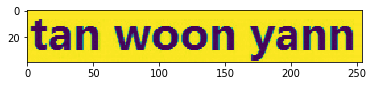

reading line : 2
50,82,440,82,440,121,50,121,BOOK TA .K(TAMAN DAYA) SDN BND



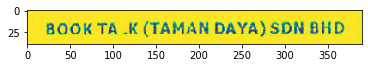

reading line : 3
205,121,285,121,285,139,205,139,789417-W



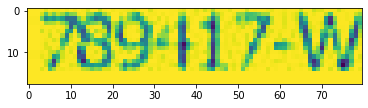

reading line : 4
110,144,383,144,383,163,110,163,NO.53 55,57 & 59, JALAN SAGU 18,



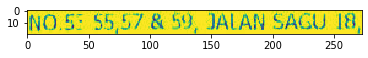

reading line : 5
192,169,299,169,299,187,192,187,TAMAN DAYA,



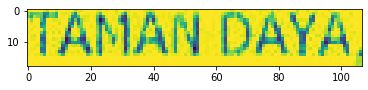

reading line : 6
162,193,334,193,334,211,162,211,81100 JOHOR BAHRU,



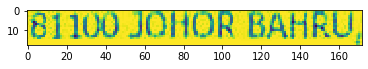

reading line : 7
217,216,275,216,275,233,217,233,JOHOR.



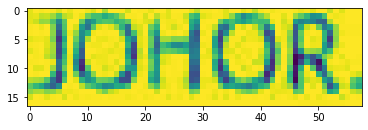

reading line : 8
50,342,279,342,279,359,50,359,DOCUMENT NO : TD01167104



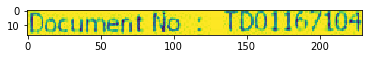

reading line : 9
50,372,96,372,96,390,50,390,DATE:



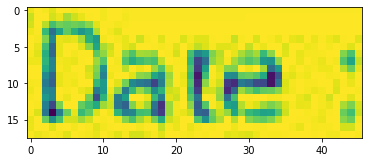

reading line : 10
165,372,342,372,342,389,165,389,25/12/2018 8:13:39 PM



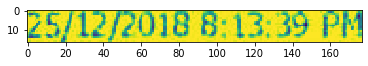

reading line : 11
48,396,117,396,117,415,48,415,CASHIER:



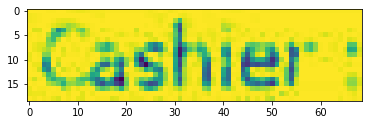

reading line : 12
164,397,215,397,215,413,164,413,MANIS



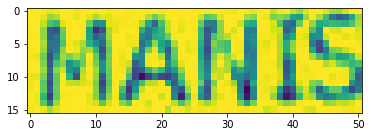

reading line : 13
49,423,122,423,122,440,49,440,MEMBER:



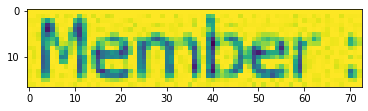

reading line : 14
191,460,298,460,298,476,191,476,CASH BILL



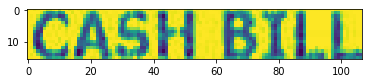

reading line : 15
30,508,121,508,121,523,30,523,CODE/DESC



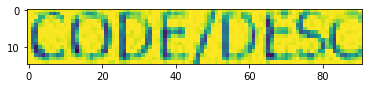

reading line : 16
200,507,247,507,247,521,200,521,PRICE



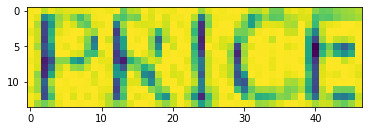

reading line : 17
276,506,306,506,306,522,276,522,DISC



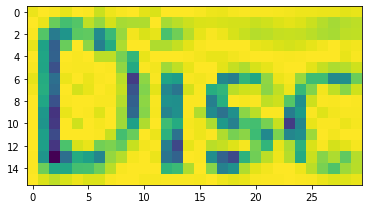

reading line : 18
374,507,441,507,441,521,374,521,AMOUNT



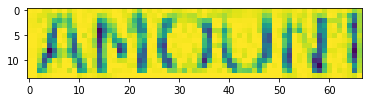

reading line : 19
69,531,102,531,102,550,69,550,QTY



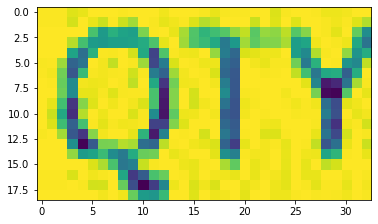

reading line : 20
221,531,247,531,247,545,221,545,RM



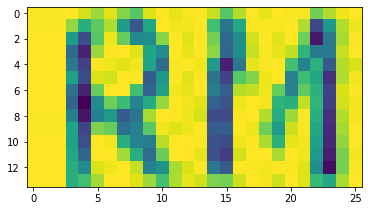

reading line : 21
420,529,443,529,443,547,420,547,RM



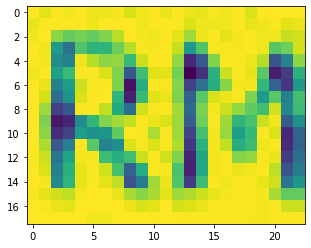

reading line : 22
27,570,137,570,137,583,27,583,9556939040116



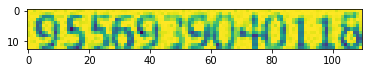

reading line : 23
159,570,396,570,396,584,159,584,KF MODELLING CLAY KIDDY FISH



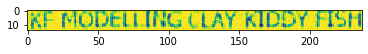

reading line : 24
77,598,113,598,113,613,77,613,1 PC



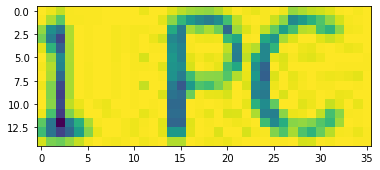

reading line : 25
138,597,148,597,148,607,138,607,*



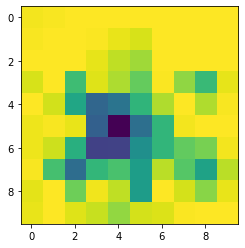

reading line : 26
202,597,245,597,245,612,202,612,9.000



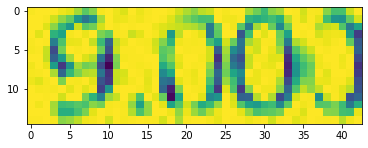

reading line : 27
275,598,309,598,309,612,275,612,0.00



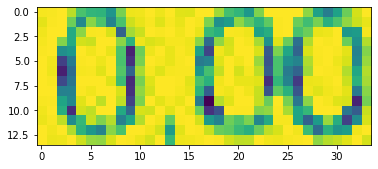

reading line : 28
411,596,443,596,443,613,411,613,9.00



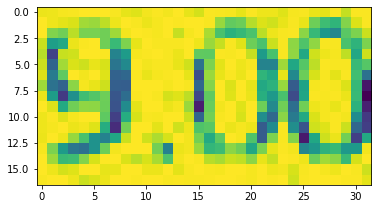

reading line : 29
245,639,293,639,293,658,245,658,TOTAL:



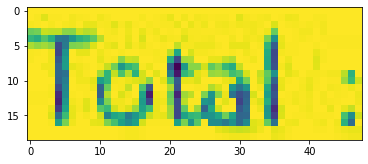

reading line : 30
118,671,291,671,291,687,118,687,ROUR DING ADJUSTMENT:



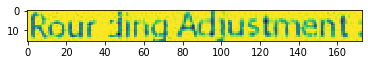

reading line : 31
408,669,443,669,443,684,408,684,0.00



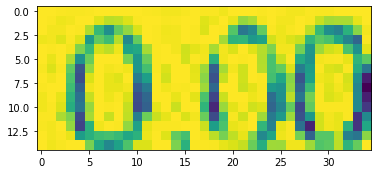

reading line : 32
86,704,292,704,292,723,86,723,ROUND D TOTAL (RM):



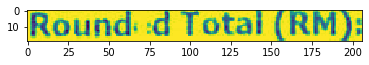

reading line : 33
401,703,443,703,443,719,401,719,9.00



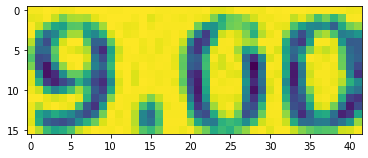

reading line : 34
205,744,243,744,243,765,205,765,CASH



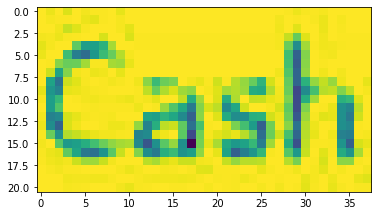

reading line : 35
402,748,441,748,441,763,402,763,10.00



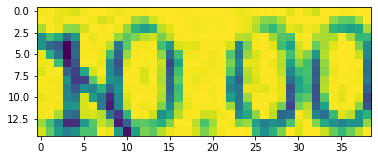

reading line : 36
205,770,271,770,271,788,205,788,CHANGE



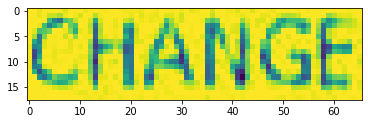

reading line : 37
412,772,443,772,443,786,412,786,1.00



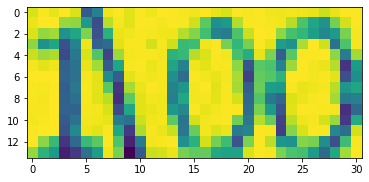

reading line : 38
97,845,401,845,401,860,97,860,GOODS SOLD ARE NOT RETURNABLE OR



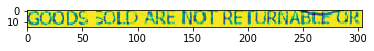

reading line : 39
190,864,309,864,309,880,190,880,EXCHANGEABLE



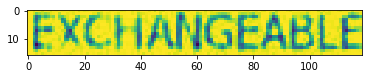

reading line : 40
142,883,353,883,353,901,142,901,***



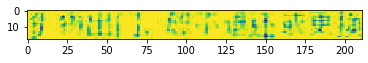

reading line : 41
137,903,351,903,351,920,137,920,***



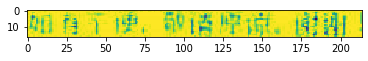

reading line : 42
202,942,292,942,292,959,202,959,THANK YOU



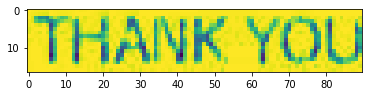

reading line : 43
163,962,330,962,330,977,163,977,PLEASE COME AGAIN !



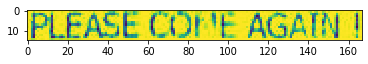

reading line : 44
412,639,442,639,442,654,412,654,9.00



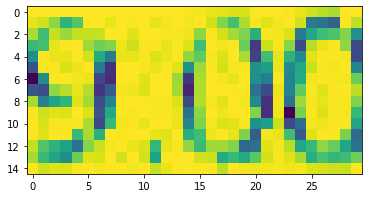

...... processing for X00016469619.jpg
reading corresponding text
reading line : 45
76,50,323,50,323,84,76,84,TAN WOON YANN



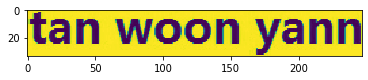

reading line : 46
110,165,315,165,315,188,110,188,INDAH GIFT & HOME DECO



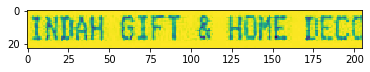

reading line : 47
126,191,297,191,297,214,126,214,27,JALAN DEDAP 13,



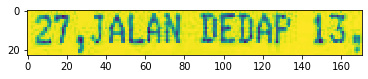

reading line : 48
129,218,287,218,287,236,129,236,TAMAN JOHOR JAYA,



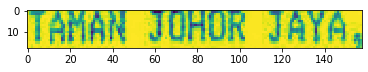

reading line : 49
100,243,324,243,324,261,100,261,81100 JOHOR BAHRU,JOHOR.



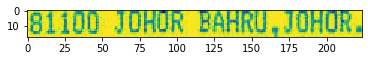

reading line : 50
70,268,201,268,201,285,70,285,TEL:07-3507405



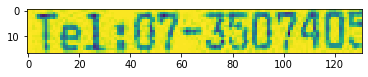

reading line : 51
221,267,356,267,356,286,221,286,FAX:07-3558160



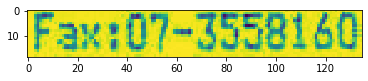

reading line : 52
177,317,241,317,241,336,177,336,RECEIPT



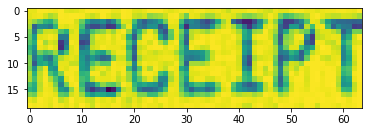

reading line : 53
16,364,257,364,257,392,16,392,19/10/2018 20:49:59 #01



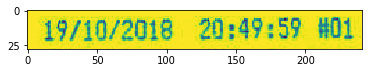

reading line : 54
25,395,132,395,132,412,25,412,CASHIER: CN



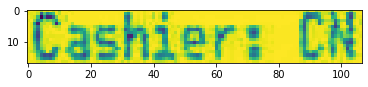

reading line : 55
181,393,390,393,390,410,181,410,LOCATION/SP: 05 /0531



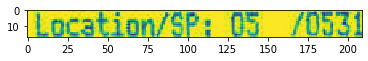

reading line : 56
26,445,129,445,129,463,26,463,MB: MO26588



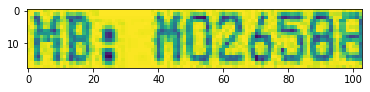

reading line : 57
25,468,127,468,127,489,25,489,ROOM NO: 01



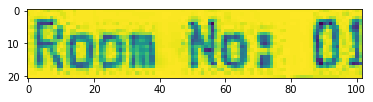

reading line : 58
286,466,400,466,400,488,286,488,050100035279



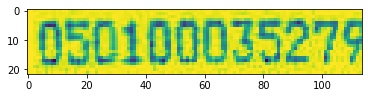

reading line : 59
24,518,114,518,114,538,24,538,DESC/ITEM



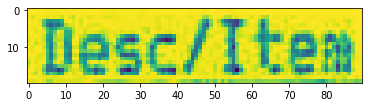

reading line : 60
182,519,213,519,213,538,182,538,QTY



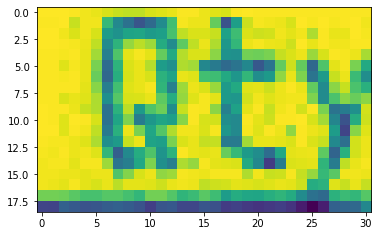

reading line : 61
239,518,288,518,288,534,239,534,PRICE



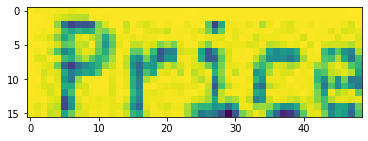

reading line : 62
308,517,371,517,371,534,308,534,AMT(RM)



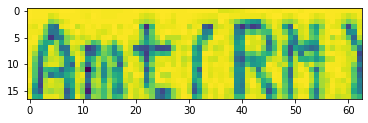

reading line : 63
25,543,273,543,273,559,25,559,ST-PRIVILEGE CARD/GD INDAH



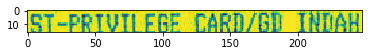

reading line : 64
26,570,73,570,73,586,26,586,88888



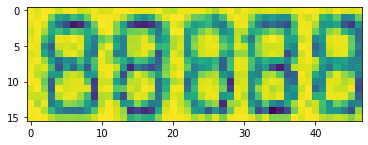

reading line : 65
201,565,218,565,218,588,201,588,1



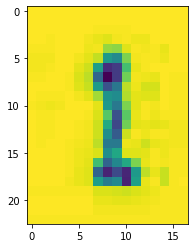

reading line : 66
238,566,294,566,294,589,238,589,10.00



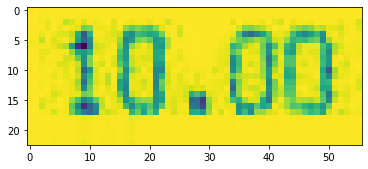

reading line : 67
319,561,382,561,382,586,319,586,10.00



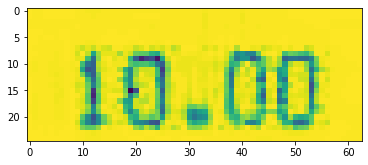

reading line : 68
22,591,257,591,257,613,22,613,GF-TABLE LAMP/STITCH <I>



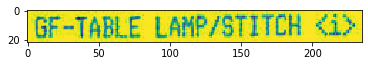

reading line : 69
24,616,78,616,78,636,24,636,62483



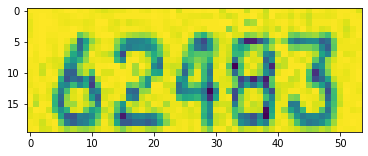

reading line : 70
196,615,222,615,222,636,196,636,1



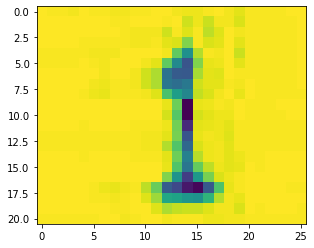

reading line : 71
233,610,292,610,292,634,233,634,55.90



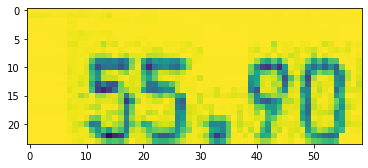

reading line : 72
312,612,376,612,376,635,312,635,55.90



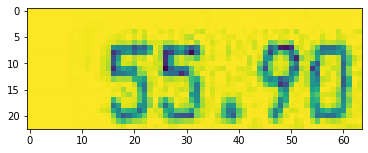

reading line : 73
147,641,194,641,194,660,147,660,@DISC



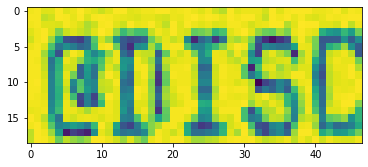

reading line : 74
216,642,270,642,270,661,216,661,10.00%



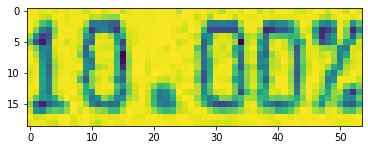

reading line : 75
318,641,378,641,378,662,318,662,-5.59



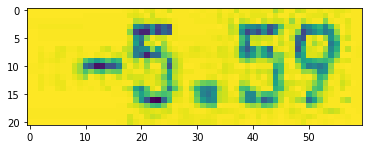

reading line : 76
25,668,122,668,122,691,25,691,#TOTAL QTY



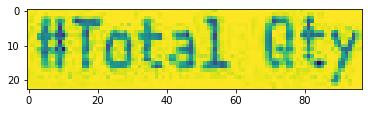

reading line : 77
157,663,185,663,185,687,157,687,2



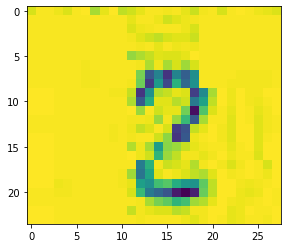

reading line : 78
26,693,280,693,280,712,26,712,TOTAL AMT................. RM



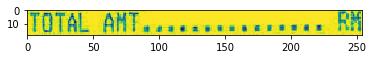

reading line : 79
325,691,375,691,375,711,325,711,60.31



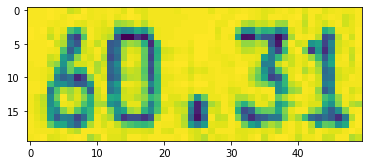

reading line : 80
27,719,252,719,252,737,27,737,ROUNDING ADJ............



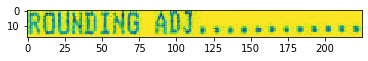

reading line : 81
319,714,379,714,379,736,319,736,-0.01



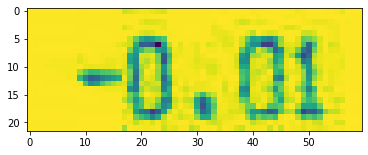

reading line : 82
261,768,280,768,280,787,261,787,RM



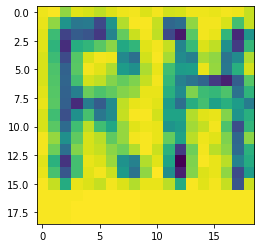

reading line : 83
325,767,374,767,374,786,325,786,60.30



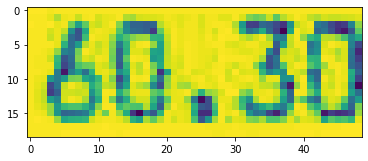

reading line : 84
26,793,280,793,280,809,26,809,CASH.................... RM



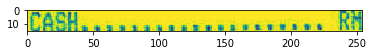

reading line : 85
326,792,373,792,373,809,326,809,70.30



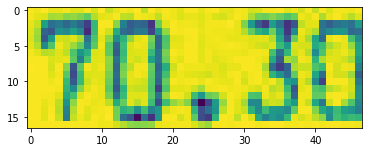

reading line : 86
25,815,280,815,280,835,25,835,CHANGE.................. RM



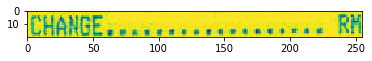

reading line : 87
328,816,375,816,375,832,328,832,10.00



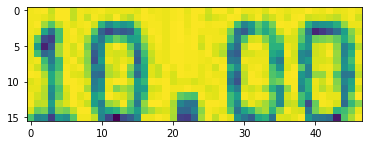

reading line : 88
63,889,355,889,355,909,63,909,THANK YOU ! PLEASE COME AGAIN !



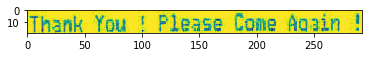

reading line : 89
74,916,348,916,348,932,74,932,GOODS SOLD ARE NOT RETURNABLE



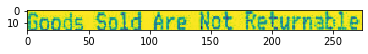

reading line : 90
60,887,359,887,359,911,60,911,THANK YOU ! FLEASE COME AOSIN !



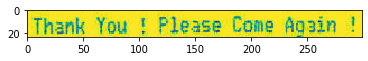

reading line : 91
67,913,348,913,348,938,67,938,GOODS SOLD ARE NOT RETURNABLE



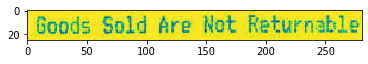

reading line : 92
62,940,363,940,363,958,62,958,DEALING IN WHOLESALE AND RETAIL.



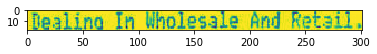

...... processing for X00016469620.jpg
reading corresponding text
reading line : 93
119,47,367,47,367,80,119,80,TAN WOON YANN



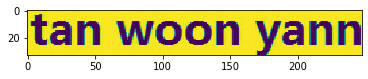

reading line : 94
93,161,352,161,352,183,93,183,MR D.T.Y. (JOHOR) SDN BHD



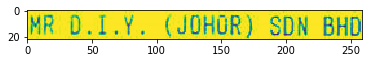

reading line : 95
137,185,320,185,320,204,137,204,(CO.REG : 933109-X)



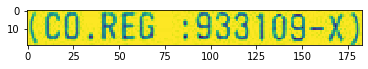

reading line : 96
49,201,391,201,391,227,49,227,LOT 1851-A & 1851-B, JALAN KPB 6,



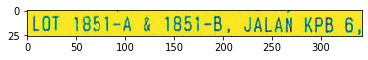

reading line : 97
60,228,382,228,382,246,60,246,KAWASAN PERINDUSTRIAN BALAKONG,



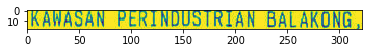

reading line : 98
70,249,384,249,384,267,70,267,43300 SERI KEMBANGAN, SELANGOR



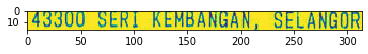

reading line : 99
116,268,331,268,331,289,116,289,(MR DIY TESCO TERBAU)



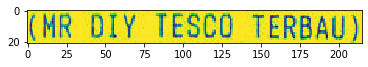

reading line : 100
176,290,268,290,268,308,176,308,-INVOICE-



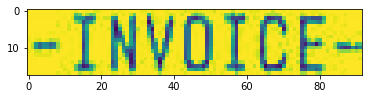

reading line : 101
14,328,358,328,358,351,14,351,CHOPPING BOARD 35.5X25.5CM 803M#



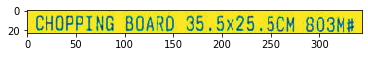

reading line : 102
16,349,158,349,158,372,16,372,EZ10HD05 - 24



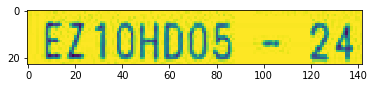

reading line : 103
20,371,95,371,95,393,20,393,8970669



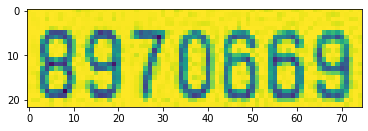

reading line : 104
249,373,259,373,259,393,249,393,1



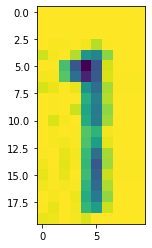

reading line : 105
266,376,282,376,282,393,266,393,X



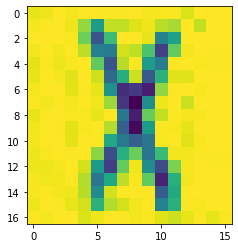

reading line : 106
290,374,343,374,343,395,290,395,19.00



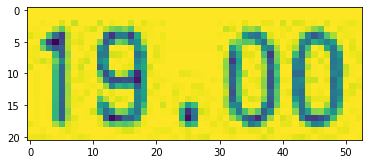

reading line : 107
358,375,412,375,412,396,358,396,19.00



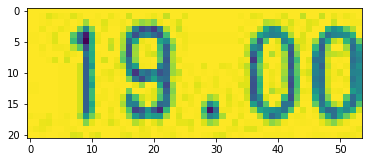

reading line : 108
15,394,371,394,371,417,15,417,AIR PRESSURE SPRAYER SX-575-1 1.5L



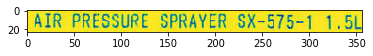

reading line : 109
17,413,136,413,136,436,17,436,HC03-7 - 15



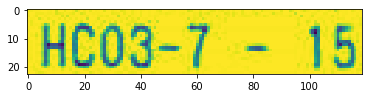

reading line : 110
14,436,93,436,93,456,14,456,9066468



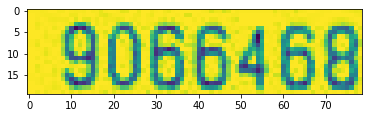

reading line : 111
245,438,258,438,258,458,245,458,1



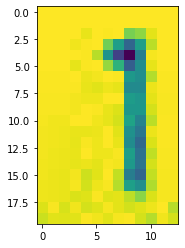

reading line : 112
265,437,282,437,282,460,265,460,X



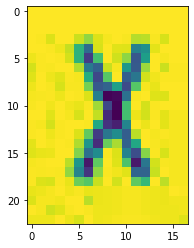

reading line : 113
296,439,343,439,343,459,296,459,8.02



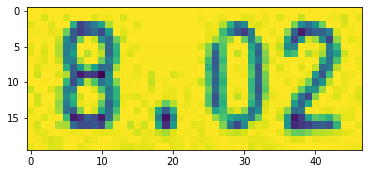

reading line : 114
364,436,413,436,413,460,364,460,8.02



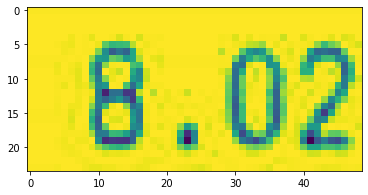

reading line : 115
17,457,332,457,332,479,17,479,WAXCO WINDSHILED CLEANER 120ML



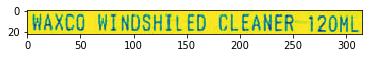

reading line : 116
15,477,146,477,146,497,15,497,WA14-3A - 48



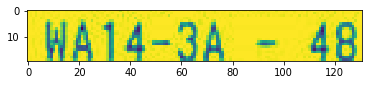

reading line : 117
18,501,159,501,159,521,18,521,9557031100236



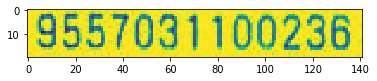

reading line : 118
245,498,259,498,259,522,245,522,1



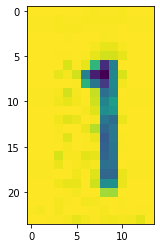

reading line : 119
267,502,283,502,283,518,267,518,X



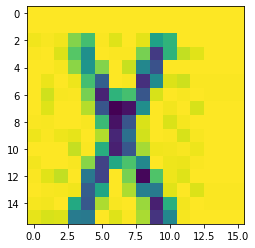

reading line : 120
294,502,344,502,344,523,294,523,3.02



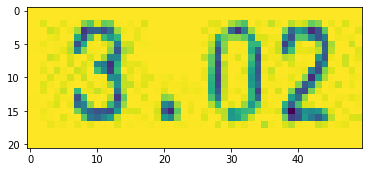

reading line : 121
368,502,412,502,412,523,368,523,3.02



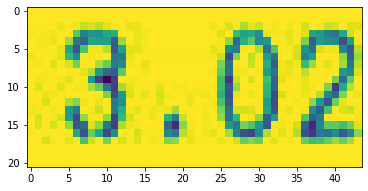

reading line : 122
16,521,278,521,278,539,16,539,BOPP TAPE 48MM*100M CLEAR



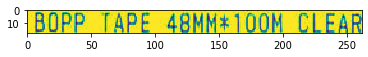

reading line : 123
21,542,124,542,124,559,21,559,FZ-04 - 36



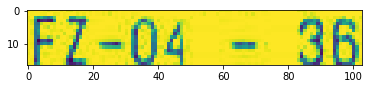

reading line : 124
19,563,155,563,155,583,19,583,6935818350846



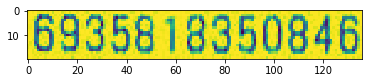

reading line : 125
245,561,256,561,256,583,245,583,1



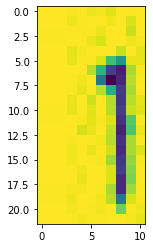

reading line : 126
265,562,282,562,282,586,265,586,X



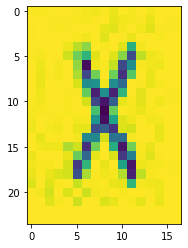

reading line : 127
296,561,340,561,340,589,296,589,3.88



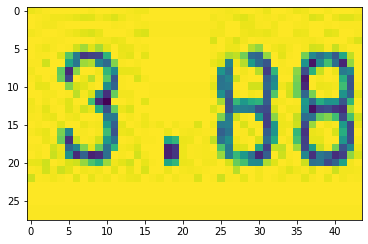

reading line : 128
367,563,424,563,424,586,367,586,3.88



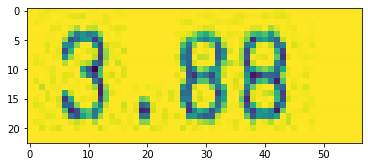

reading line : 129
21,604,132,604,132,624,21,624,ITEM(S) : 4



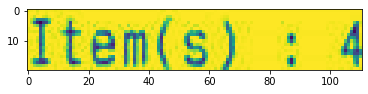

reading line : 130
329,607,431,607,431,628,329,628,QTY(S) : 4



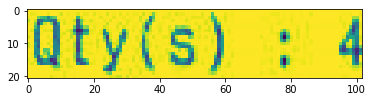

reading line : 131
17,643,79,643,79,665,17,665,TOTAL



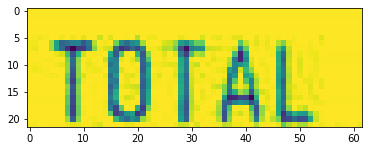

reading line : 132
347,650,432,650,432,668,347,668,RM 33.92



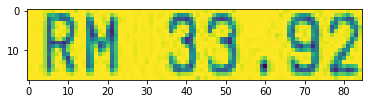

reading line : 133
16,667,216,667,216,688,16,688,ROUNDING ADJUSTMENT



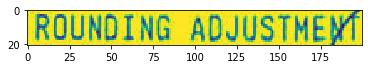

reading line : 134
345,667,436,667,436,689,345,689,-RM 0.02



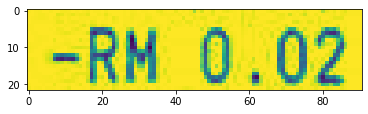

reading line : 135
16,688,155,688,155,711,16,711,TOTAL ROUNDED



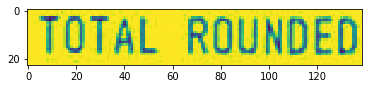

reading line : 136
347,688,431,688,431,712,347,712,RM 33.90



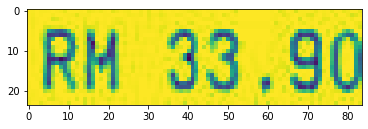

reading line : 137
16,710,62,710,62,728,16,728,CASH



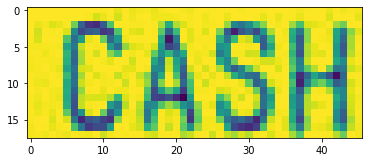

reading line : 138
343,711,435,711,435,729,343,729,RM 50.00



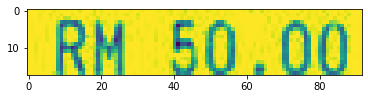

reading line : 139
15,730,85,730,85,754,15,754,CHANGE



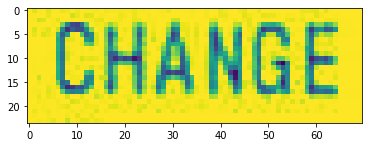

reading line : 140
349,733,432,733,432,753,349,753,RM 16.10



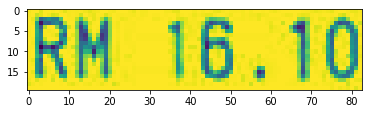

reading line : 141
22,773,269,773,269,791,22,791,12-01-19 21:13 SH01 ZK09



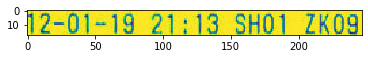

reading line : 142
297,772,431,772,431,794,297,794,T4 R000027830



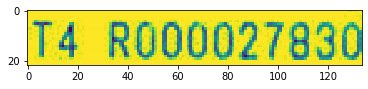

reading line : 143
18,794,269,794,269,812,18,812,OPERATOR TRAINEE CASHIER



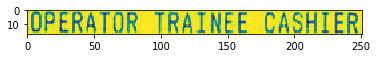

reading line : 144
82,835,361,835,361,855,82,855,EXCHANGE ARE ALLOWED WITHIN



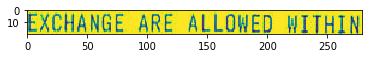

reading line : 145
122,858,325,858,325,876,122,876,7 DAYS WITH RECEIPT.



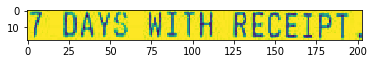

reading line : 146
101,877,347,877,347,899,101,899,STRICTLY NO CASH REFUND.



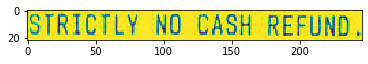

...... processing for X00016469622.jpg
reading corresponding text
reading line : 147
96,41,353,41,353,79,96,79,TAN WOON YANN



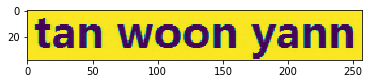

reading line : 148
88,107,366,107,366,133,88,133,YONGFATT ENTERPRISE



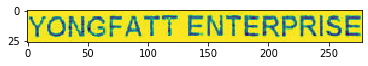

reading line : 149
171,137,280,137,280,155,171,155,(JM0517726)



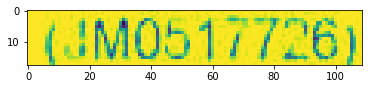

reading line : 150
104,162,347,162,347,179,104,179,NO 122.124 JALAN DEDAP 13



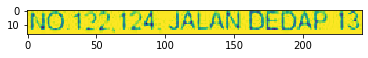

reading line : 151
136,184,316,184,316,198,136,198,81100 JOHOR BAHRU



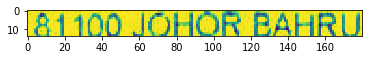

reading line : 152
157,220,295,220,295,238,157,238,TEL 07-3523888



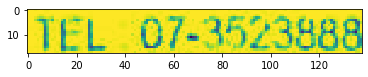

reading line : 153
135,252,320,252,320,269,135,269,GST ID: 000849813504



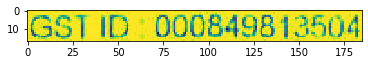

reading line : 154
112,277,349,277,349,296,112,296,SIMPLIFIED TAX INVOICE



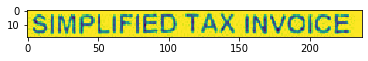

reading line : 155
18,316,66,316,66,333,18,333,CASH



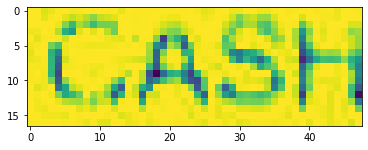

reading line : 156
19,343,78,343,78,360,19,360,DOC NO



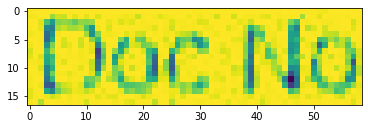

reading line : 157
141,337,251,337,251,358,141,358,CS00031663



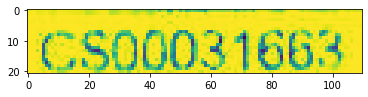

reading line : 158
276,341,312,341,312,359,276,359,DATE



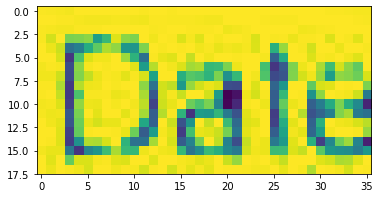

reading line : 159
329,341,415,341,415,358,329,358,25/12/2018



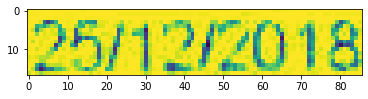

reading line : 160
18,369,79,369,79,386,18,386,CASHIER



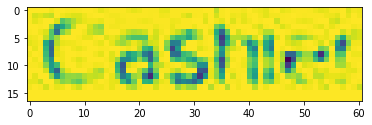

reading line : 161
143,368,191,368,191,383,143,383,USER



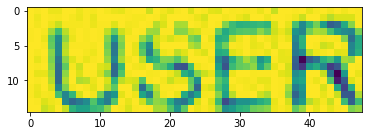

reading line : 162
276,365,313,365,313,382,276,382,TIME



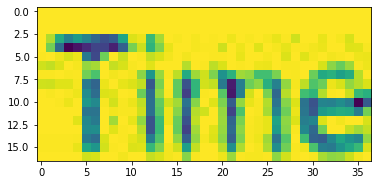

reading line : 163
334,367,395,367,395,383,334,383,12 31 00



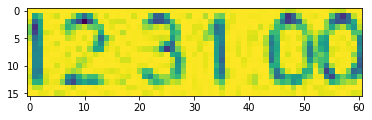

reading line : 164
19,393,114,393,114,412,19,412,SALESPERSON



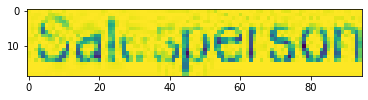

reading line : 165
275,392,306,392,306,410,275,410,REF.



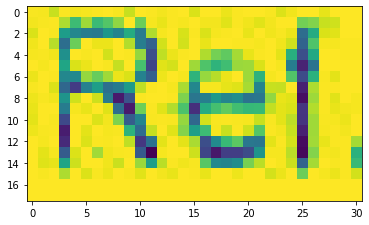

reading line : 166
20,439,53,439,53,454,20,454,ITEM



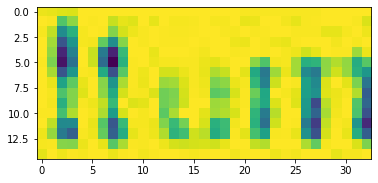

reading line : 167
170,437,197,437,197,457,170,457,QTY



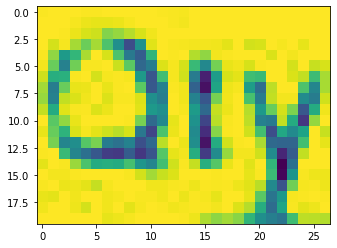

reading line : 168
232,435,287,435,287,454,232,454,S/PRICE



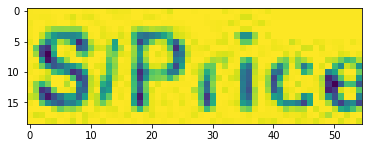

reading line : 169
313,438,378,438,378,453,313,453,AMOUNT



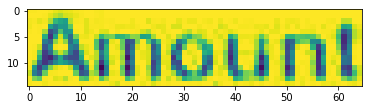

reading line : 170
398,438,426,438,426,454,398,454,TAX



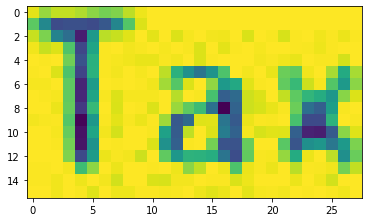

reading line : 171
21,462,69,462,69,478,21,478,E8318



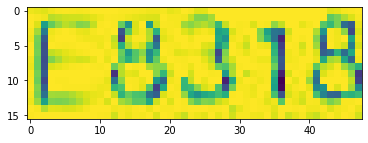

reading line : 172
172,457,194,457,194,475,172,475,1



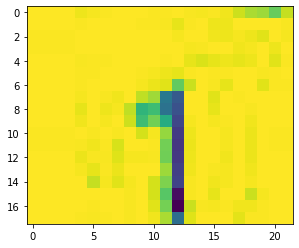

reading line : 173
234,459,286,459,286,477,234,477,80.91



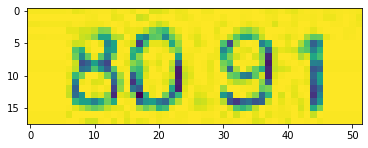

reading line : 174
328,457,380,457,380,480,328,480,80.91



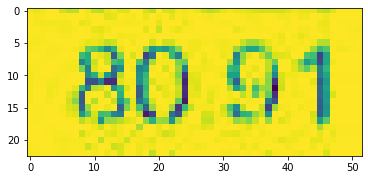

reading line : 175
395,459,428,459,428,478,395,478,SR



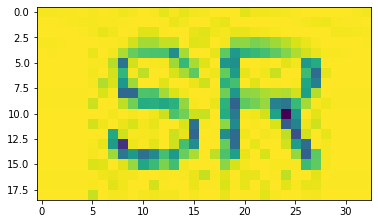

reading line : 176
21,486,231,486,231,502,21,502,ELEGANT SCHTR BAG 15



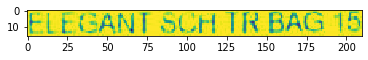

reading line : 177
65,509,133,509,133,528,65,528,TOTAL QTY



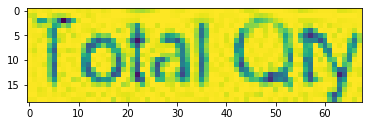

reading line : 178
175,509,192,509,192,524,175,524,1



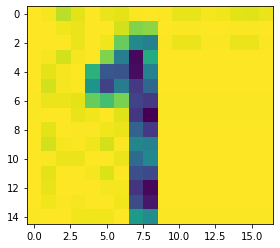

reading line : 179
329,509,380,509,380,528,329,528,80.91



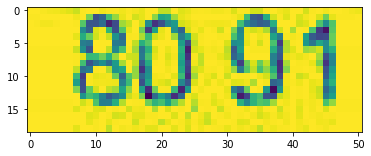

reading line : 180
66,546,289,546,289,562,66,562,TOTAL SALES (EXCLUDING GST) :



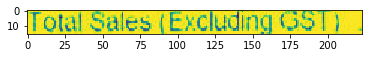

reading line : 181
334,546,375,546,375,562,334,562,80.91



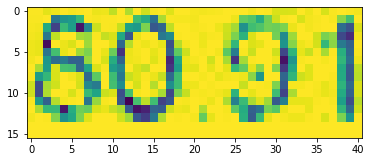

reading line : 182
207,572,290,572,290,588,207,588,DISCOUNT :



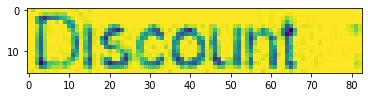

reading line : 183
342,572,377,572,377,588,342,588,0.00



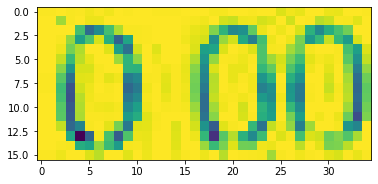

reading line : 184
198,599,290,599,290,616,198,616,TOTAL GST :



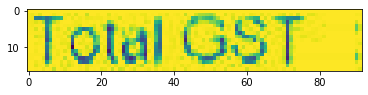

reading line : 185
336,597,385,597,385,619,336,619,0.00



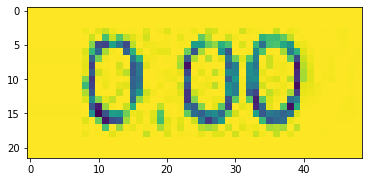

reading line : 186
202,628,273,628,273,646,202,646,ROUNDING



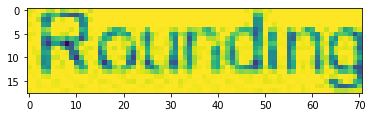

reading line : 187
333,626,386,626,386,646,333,646,-0.01



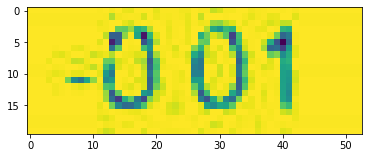

reading line : 188
33,658,290,658,290,676,33,676,TOTAL SALES (INCLUSIVE OF GST) :



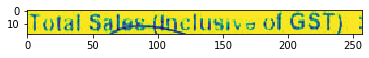

reading line : 189
331,653,383,653,383,674,331,674,80.90



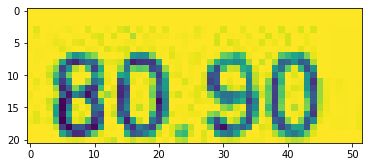

reading line : 190
227,687,292,687,292,705,227,705,CASH :



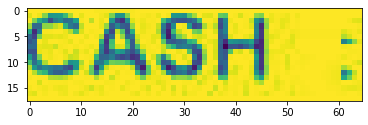

reading line : 191
326,689,377,689,377,703,326,703,100.00



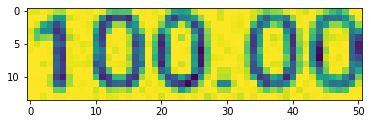

reading line : 192
211,712,290,712,290,731,211,731,CHANGE :



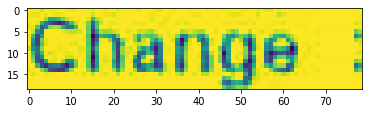

reading line : 193
335,713,378,713,378,729,335,729,19.10



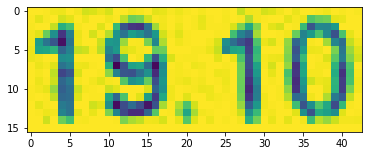

reading line : 194
50,762,187,762,187,778,50,778,GST SUMMARY



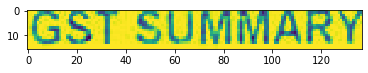

reading line : 195
55,793,132,793,132,809,55,809,TAX CODE



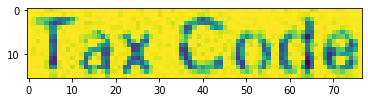

reading line : 196
174,794,188,794,188,810,174,810,%



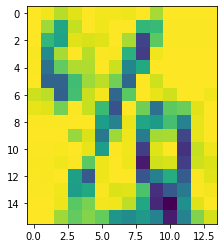

reading line : 197
228,793,303,793,303,811,228,811,AMT (RM)



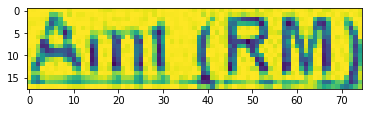

reading line : 198
334,792,405,792,405,810,334,810,TAX (RM)



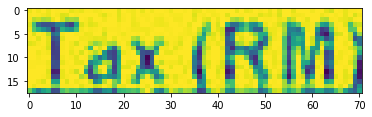

reading line : 199
55,815,80,815,80,832,55,832,SR



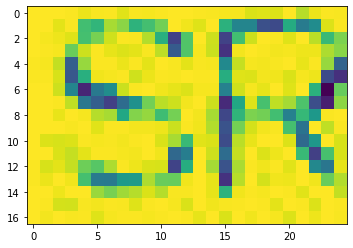

reading line : 200
168,813,191,813,191,831,168,831,0



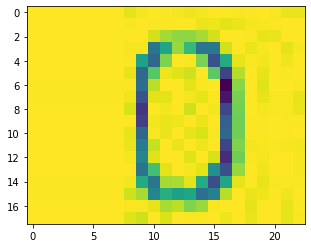

reading line : 201
258,814,301,814,301,831,258,831,80.91



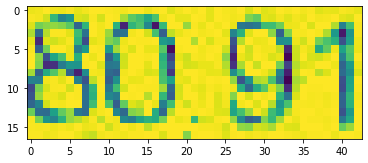

reading line : 202
371,815,406,815,406,829,371,829,0.00



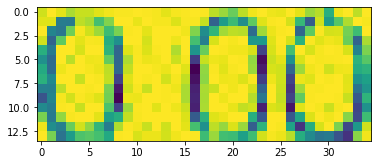

reading line : 203
140,841,206,841,206,867,140,867,TOTAL :



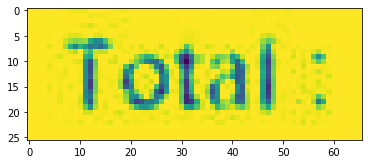

reading line : 204
256,844,301,844,301,862,256,862,80.91



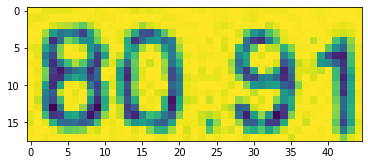

reading line : 205
371,847,405,847,405,863,371,863,0.00



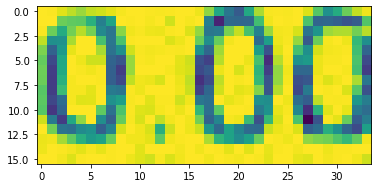

reading line : 206
71,895,385,895,385,909,71,909,GOODS SOLD ARE NOT REFUNDABLE ONLY



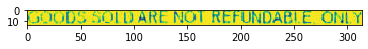

...... processing for X00016469623.jpg
reading corresponding text
reading line : 207
83,41,331,41,331,78,83,78,TAN WOON YANN



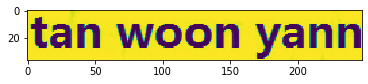

reading line : 208
109,171,330,171,330,191,109,191,MR D.I.Y. (M) SDN BHD



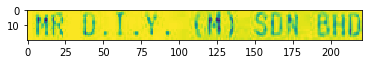

reading line : 209
122,190,325,190,325,213,122,213,(CO. RFG : 860671-D)



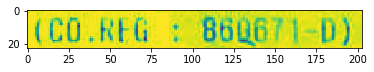

reading line : 210
47,208,391,208,391,233,47,233,LOT 1851-A & 1851-B, JALAN KPB 6,



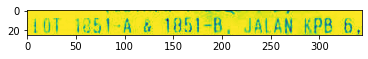

reading line : 211
62,235,381,235,381,254,62,254,KAWASAN PERINDUSTRIAN BALAKONG,



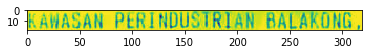

reading line : 212
70,256,384,256,384,275,70,275,43300 SERI KEMBANGAN, SELANGOR



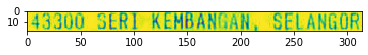

reading line : 213
125,275,318,275,318,297,125,297,(TESCO PUTRA NILAI)



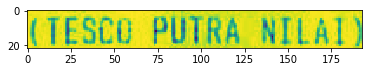

reading line : 214
177,295,266,295,266,317,177,317,-INVOICE-



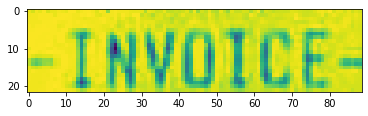

reading line : 215
12,337,402,337,402,362,12,362,KILAT AUTO ECO WASH & SHINE ES1000 1L



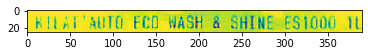

reading line : 216
20,360,160,360,160,383,20,383,WA45 /2A - 12



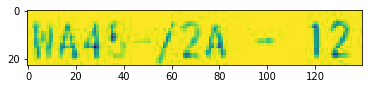

reading line : 217
16,382,156,382,156,402,16,402,9555916500133



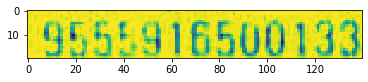

reading line : 218
245,380,260,380,260,402,245,402,1



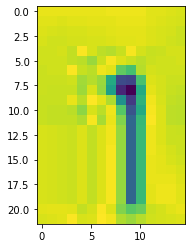

reading line : 219
265,385,288,385,288,400,265,400,X



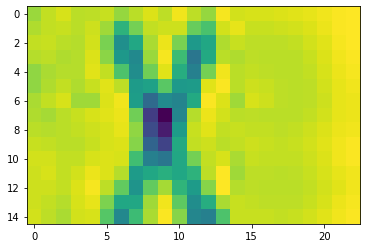

reading line : 220
300,382,347,382,347,404,300,404,3.11



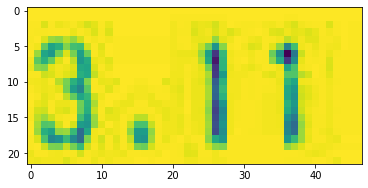

reading line : 221
371,385,419,385,419,404,371,404,3.11



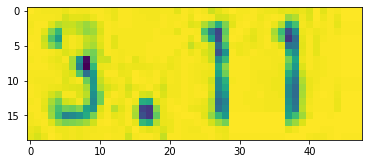

reading line : 222
15,402,394,402,394,424,15,424,KILAT' ECO AUTO WASH &WAX EW-1000-1L



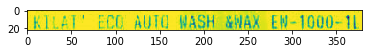

reading line : 223
16,424,134,424,134,446,16,446,WA44-A - 12



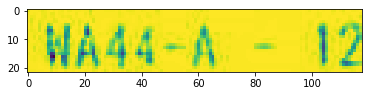

reading line : 224
18,447,165,447,165,468,18,468,9555916500126



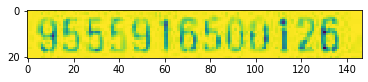

reading line : 225
244,444,259,444,259,467,244,467,1



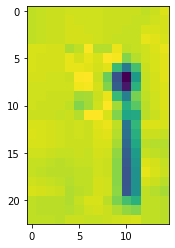

reading line : 226
267,446,282,446,282,468,267,468,X



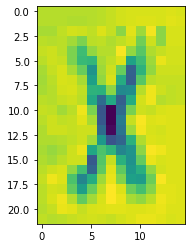

reading line : 227
297,447,350,447,350,472,297,472,4.62



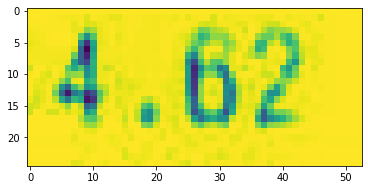

reading line : 228
369,444,417,444,417,470,369,470,4.62



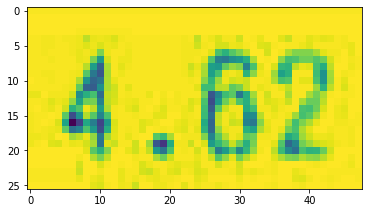

reading line : 229
19,467,217,467,217,489,19,489,WD40 27ML MOO 2572



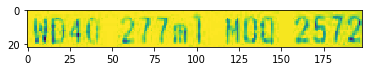

reading line : 230
18,489,140,489,140,508,18,508,WA43-A - 24



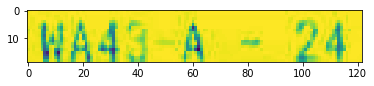

reading line : 231
19,510,152,510,152,531,19,531,079567600084



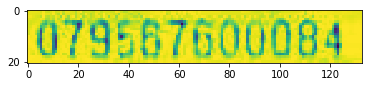

reading line : 232
245,509,259,509,259,528,245,528,1



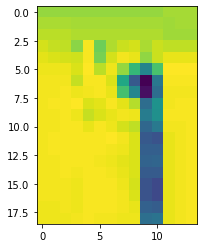

reading line : 233
265,511,285,511,285,530,265,530,X



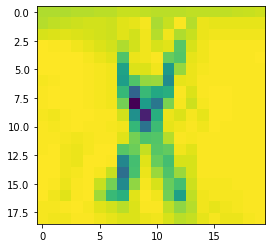

reading line : 234
285,509,347,509,347,532,285,532,11.23



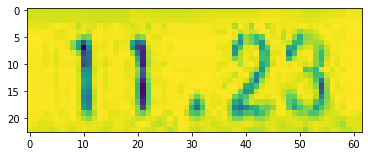

reading line : 235
359,509,419,509,419,531,359,531,11.23



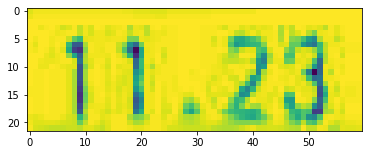

reading line : 236
14,531,367,531,367,553,14,553,KLEENSO AJAIB 99 SERAI WANYI 900G



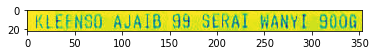

reading line : 237
18,552,120,552,120,573,18,573,WDOO - 15



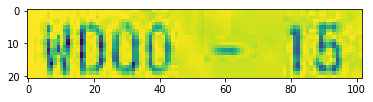

reading line : 238
16,575,157,575,157,595,16,595,9555651400385



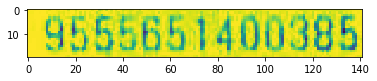

reading line : 239
247,575,260,575,260,591,247,591,1



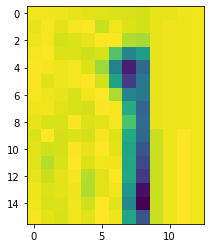

reading line : 240
265,576,284,576,284,595,265,595,X



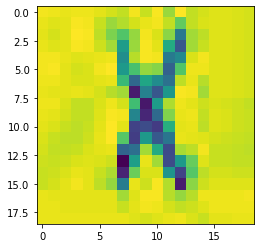

reading line : 241
298,572,343,572,343,594,298,594,7.45



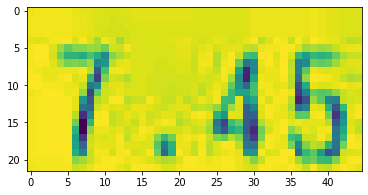

reading line : 242
371,572,420,572,420,601,371,601,7.45



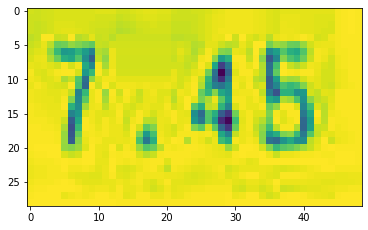

reading line : 243
16,594,265,594,265,614,16,614,HANDKERCHIEF 71386#2PCS



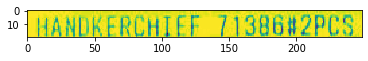

reading line : 244
15,618,213,618,213,636,15,636,PI12PJ11-4 - 6/300



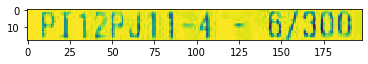

reading line : 245
15,638,101,638,101,661,15,661,9090822



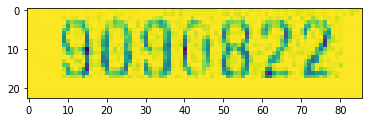

reading line : 246
245,636,260,636,260,659,245,659,1



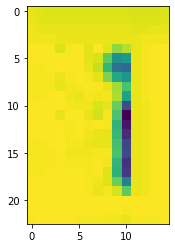

reading line : 247
263,637,284,637,284,657,263,657,X



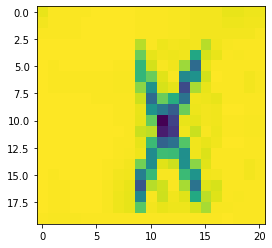

reading line : 248
295,636,344,636,344,661,295,661,4.50



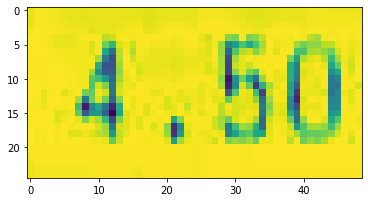

reading line : 249
371,637,420,637,420,659,371,659,4.50



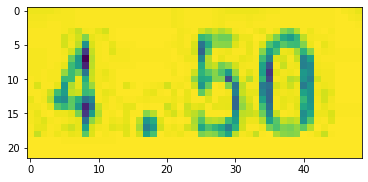

reading line : 250
13,678,140,678,140,705,13,705,ITEM (S) : 5



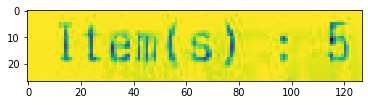

reading line : 251
324,678,445,678,445,708,324,708,QTY(S) : 5



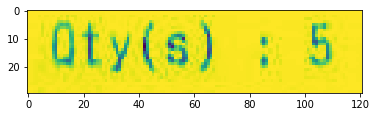

reading line : 252
14,718,77,718,77,741,14,741,TOTAL



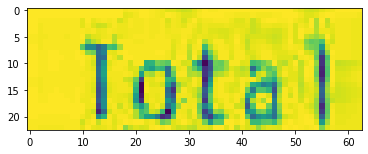

reading line : 253
346,718,439,718,439,741,346,741,RM 30.91



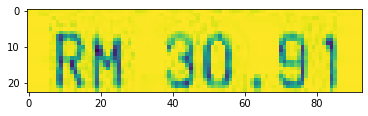

reading line : 254
15,742,218,742,218,761,15,761,ROUNDING ADJUSTMENT



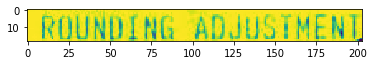

reading line : 255
355,740,435,740,435,762,355,762,RM 0.01



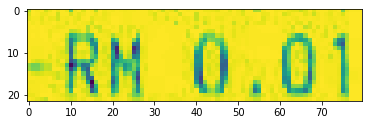

reading line : 256
15,763,162,763,162,784,15,784,TOTAL ROUNDED



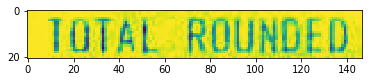

reading line : 257
346,762,434,762,434,784,346,784,RM 30.90



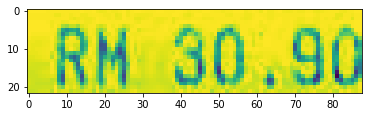

reading line : 258
18,783,72,783,72,804,18,804,CASH



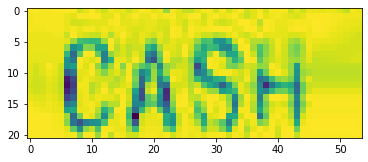

reading line : 259
347,783,437,783,437,806,347,806,RM 51.00



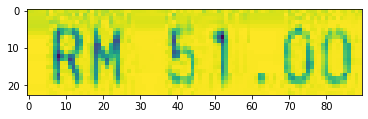

reading line : 260
14,804,84,804,84,825,14,825,CHANGE



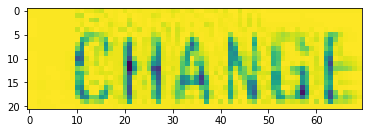

reading line : 261
349,804,440,804,440,829,349,829,RM 20.10



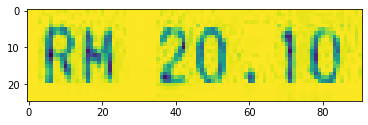

reading line : 262
18,848,271,848,271,870,18,870,18-11-18 13 : 58 SH01 ZI53



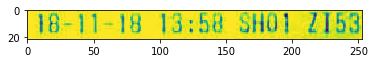

reading line : 263
297,847,438,847,438,874,297,874,T2 R000002902



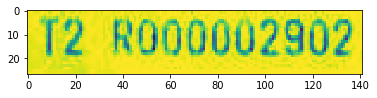

reading line : 264
19,869,278,869,278,894,19,894,UPERATOR TRAINEE CASHIER



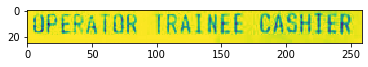

reading line : 265
79,910,369,910,369,932,79,932,EXCHANGE ARE ALLOWED WITHIN



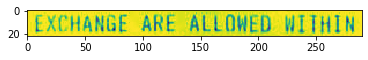

reading line : 266
120,930,329,930,329,953,120,953,7 DAYS WITH RECEIPT.



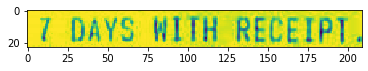

reading line : 267
98,949,352,949,352,974,98,974,STRICTLY NO CASH REFUND.



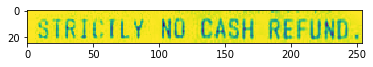

...... processing for X00016469669.jpg
reading corresponding text
reading line : 268
143,43,362,43,362,80,143,80,TAN CHAY YEE



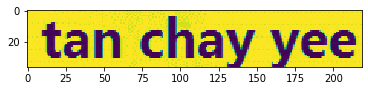

reading line : 269
129,86,309,86,309,111,129,111,ABC HO TRADING



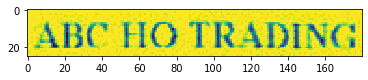

reading line : 270
107,112,328,112,328,134,107,134,NO.2&4,JALAN HARMONI 3/2,



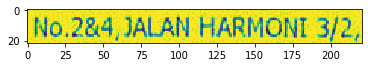

reading line : 271
125,135,309,135,309,158,125,158,TAMAN DESA HARMONI.



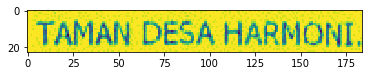

reading line : 272
104,158,330,158,330,177,104,177,81100 JOHOR BAHRU JOHOR



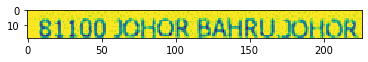

reading line : 273
167,182,279,182,279,203,167,203,07-355 2616



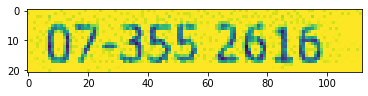

reading line : 274
27,243,105,243,105,260,27,260,CASH BILL :



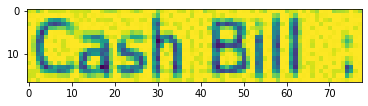

reading line : 275
118,242,202,242,202,260,118,260,01-143008



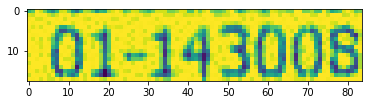

reading line : 276
23,263,67,263,67,286,23,286,DATE



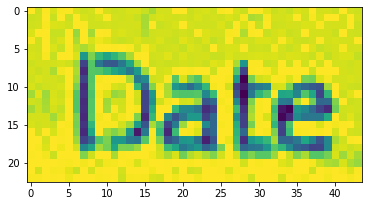

reading line : 277
93,268,111,268,111,284,93,284,:



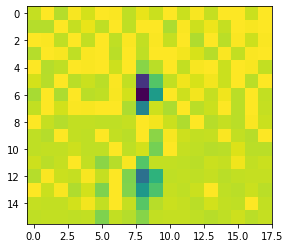

reading line : 278
118,263,301,263,301,290,118,290,09/01/2019 8:01:11 PM



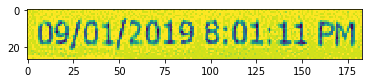

reading line : 279
21,290,87,290,87,307,21,307,CASHIER



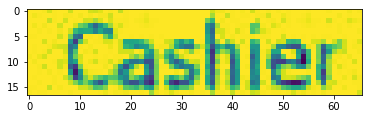

reading line : 280
93,294,112,294,112,310,93,310,:



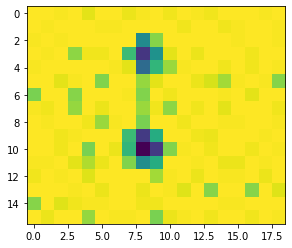

reading line : 281
117,288,144,288,144,306,117,306,01



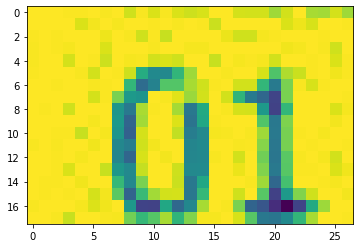

reading line : 282
37,314,136,314,136,332,37,332,DESCRIPTION



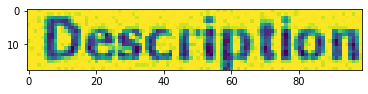

reading line : 283
211,312,249,312,249,334,211,334,QTY



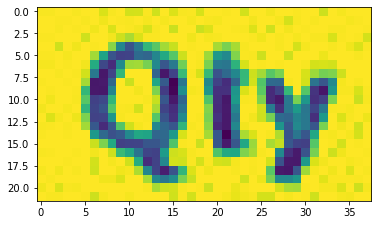

reading line : 284
266,311,317,311,317,332,266,332,PRICE



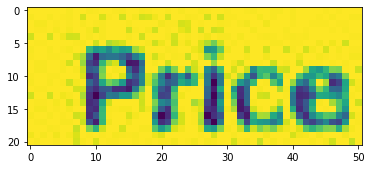

reading line : 285
330,312,406,312,406,335,330,335,AMOUNT



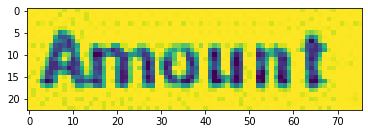

reading line : 286
277,337,315,337,315,357,277,357,RM



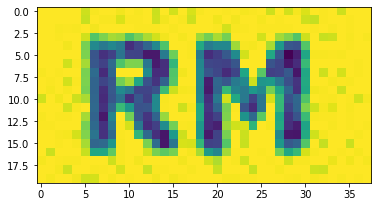

reading line : 287
347,337,387,337,387,354,347,354,RM



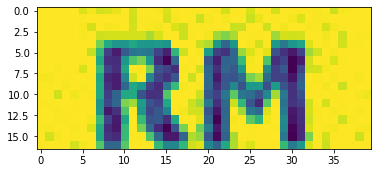

reading line : 288
22,362,79,362,79,378,22,378,PLASTIC



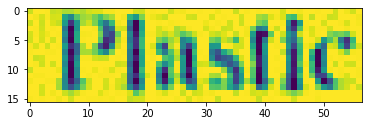

reading line : 289
228,361,248,361,248,382,228,382,2



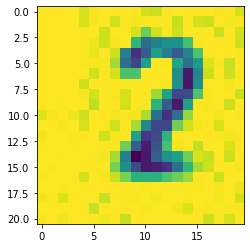

reading line : 290
263,360,309,360,309,377,263,377,15.50



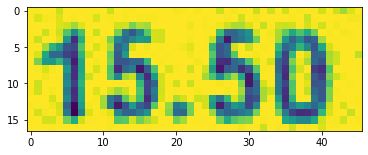

reading line : 291
327,359,383,359,383,384,327,384,31.00



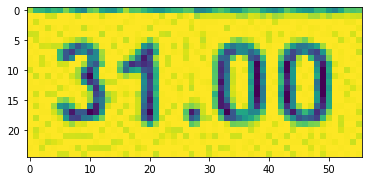

reading line : 292
208,394,260,394,260,413,208,413,TOTAL :



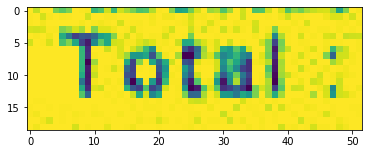

reading line : 293
356,395,419,395,419,416,356,416,31.00



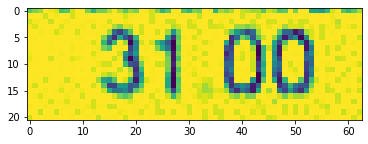

reading line : 294
142,418,262,418,262,439,142,439,TOTAL AMOUNT:



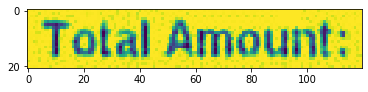

reading line : 295
345,420,411,420,411,442,345,442,31.00



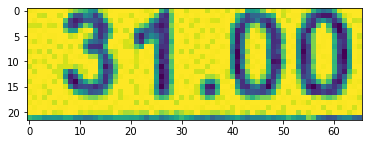

reading line : 296
133,439,260,439,260,463,133,463,CASH RECEIVED :



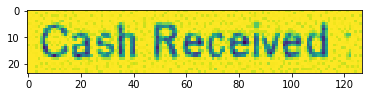

reading line : 297
353,442,412,442,412,459,353,459,101.00



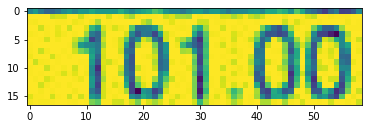

reading line : 298
181,461,262,461,262,487,181,487,CHANGE :



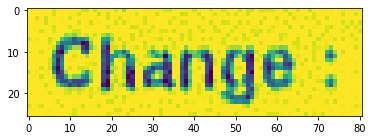

reading line : 299
364,464,414,464,414,488,364,488,70.00



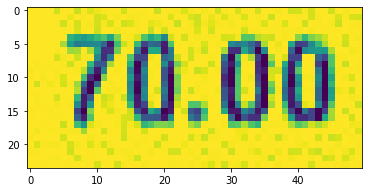

reading line : 300
86,502,362,502,362,523,86,523,*GOODS SOLD ARE NON-REFUNDABLE*



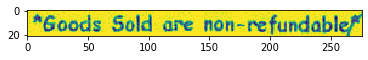

reading line : 301
149,524,306,524,306,544,149,544,***THANK YOU***



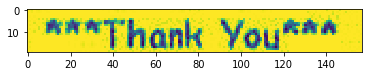

reading line : 302
121,547,331,547,331,570,121,570,***PLEASE COME AGAIN***



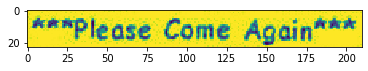

...... processing for X00016469672.jpg
reading corresponding text
reading line : 303
94,40,316,40,316,79,94,79,TAN CHAY YEE



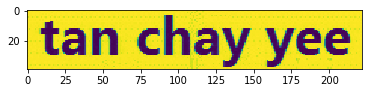

reading line : 304
23,103,431,103,431,130,23,130,SOON HUAT MACHINERY ENTERPRISE



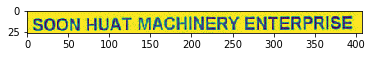

reading line : 305
159,128,291,128,291,149,159,149,(JM0352019-K)



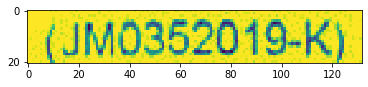

reading line : 306
127,154,321,154,321,177,127,177,NO.53 JALAN PUTRA 1,



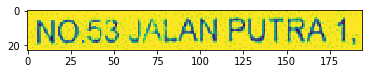

reading line : 307
143,178,305,178,305,199,143,199,TAMAN SRIPUTRA,



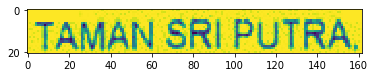

reading line : 308
131,201,316,201,316,225,131,225,81200 JOHOR BAHRU



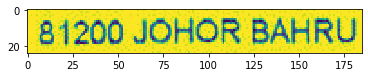

reading line : 309
185,225,269,225,269,248,185,248,JOHOR



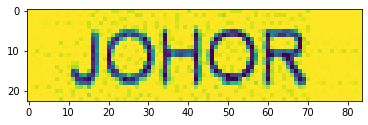

reading line : 310
17,250,271,250,271,270,17,270,TEL : 07-5547360 / 016-7993391



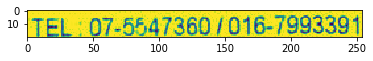

reading line : 311
293,251,432,251,432,267,293,267,FAX : 07-5624059



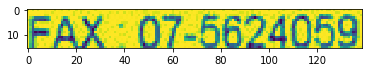

reading line : 312
90,276,362,276,362,293,90,293,SOONHUAT2000@HOTMAIL.COM



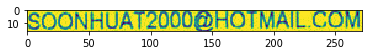

reading line : 313
128,297,322,297,322,317,128,317,GST ID : 002116837376



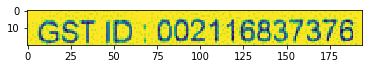

reading line : 314
163,329,283,329,283,346,163,346,CASH SALES



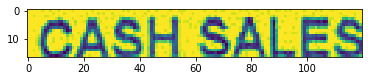

reading line : 315
12,356,80,356,80,380,12,380,DOC NO.



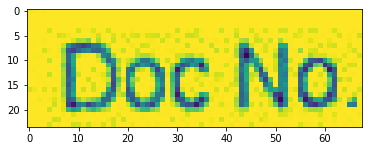

reading line : 316
122,359,239,359,239,377,122,377,: CS00004040



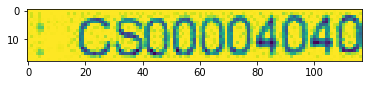

reading line : 317
294,356,433,356,433,375,294,375,DATE: 11/01/2019



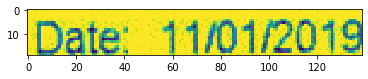

reading line : 318
14,385,78,385,78,401,14,401,CASHIER



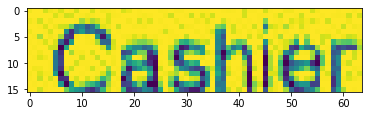

reading line : 319
123,386,189,386,189,402,123,402,: USER



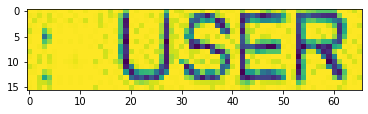

reading line : 320
296,383,414,383,414,402,296,402,TIME: 09:44:00



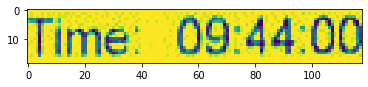

reading line : 321
15,413,129,413,129,429,15,429,SALESPERSON :



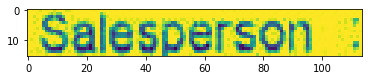

reading line : 322
300,410,340,410,340,429,300,429,REF.:



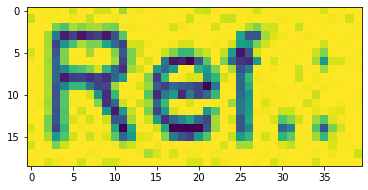

reading line : 323
45,1136,410,1136,410,1160,45,1160,GOODS SOLD ARE NOT RETURNABLE, THANK YOU.



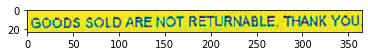

reading line : 324
11,455,54,455,54,472,11,472,ITEM



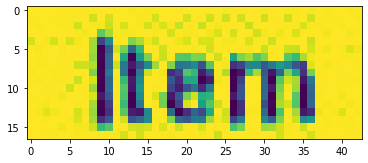

reading line : 325
131,451,170,451,170,475,131,475,QTY



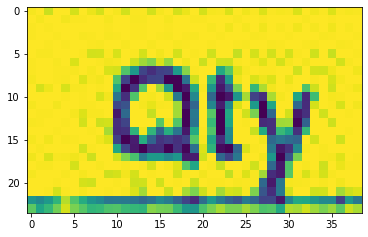

reading line : 326
187,448,240,448,240,476,187,476,S/PRICE



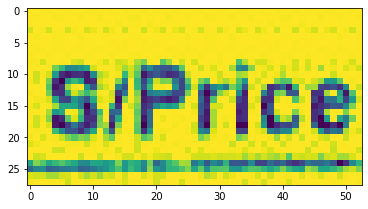

reading line : 327
250,451,307,451,307,474,250,474,S/PRICE



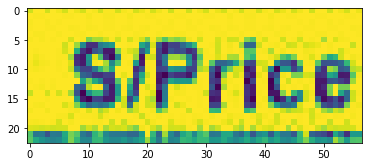

reading line : 328
328,451,390,451,390,472,328,472,AMOUNT



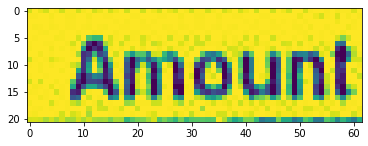

reading line : 329
400,448,437,448,437,471,400,471,TAX



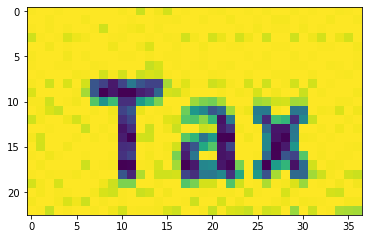

reading line : 330
11,475,60,475,60,498,11,498,1072



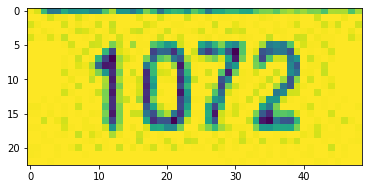

reading line : 331
142,476,161,476,161,493,142,493,1



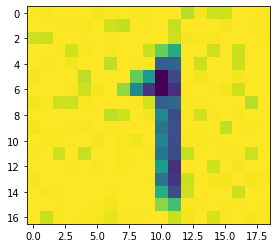

reading line : 332
185,475,236,475,236,495,185,495,80.00



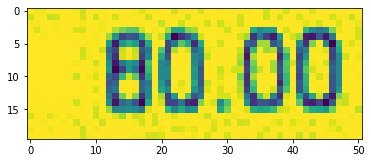

reading line : 333
253,472,300,472,300,496,253,496,80.00



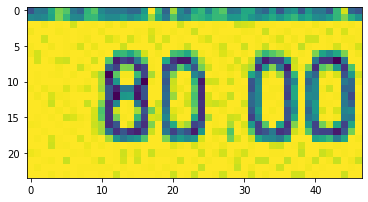

reading line : 334
345,473,397,473,397,493,345,493,80.00



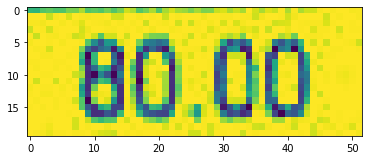

reading line : 335
16,502,321,502,321,516,16,516,REPAIR ENGINE POWER SPRAYER (1UNIT)



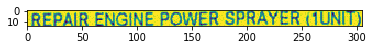

reading line : 336
13,527,167,527,167,543,13,543,WORKMANSHIP & SERVICE



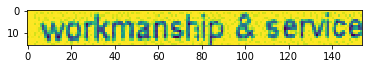

reading line : 337
15,546,66,546,66,570,15,570,70549



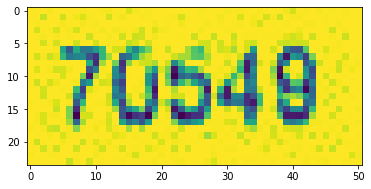

reading line : 338
140,547,161,547,161,568,140,568,1



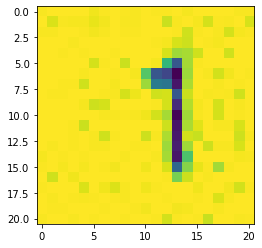

reading line : 339
186,544,243,544,243,565,186,565,160.00



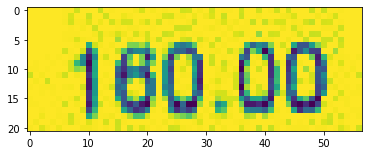

reading line : 340
255,546,308,546,308,567,255,567,160.00



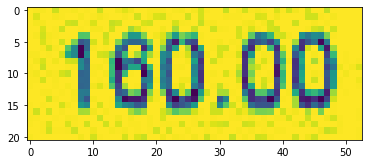

reading line : 341
341,540,398,540,398,564,341,564,160.00



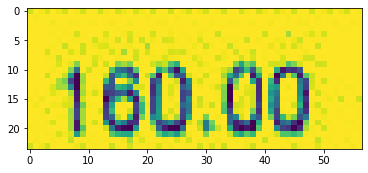

reading line : 342
15,568,228,568,228,588,15,588,GIANT 606 OVERFLOW ASSY



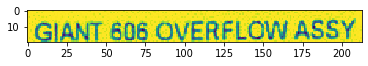

reading line : 343
13,598,57,598,57,618,13,618,1071



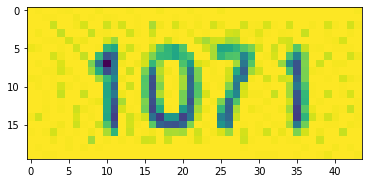

reading line : 344
142,596,161,596,161,613,142,613,1



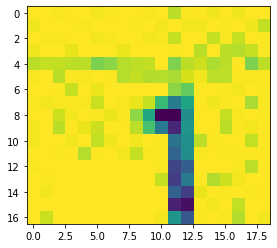

reading line : 345
195,596,239,596,239,617,195,617,17.00



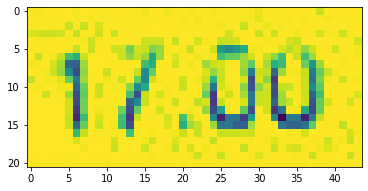

reading line : 346
259,595,304,595,304,622,259,622,17.00



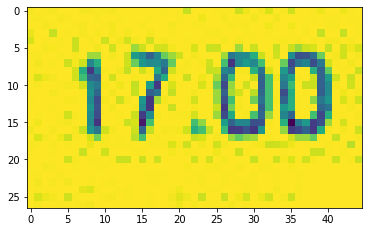

reading line : 347
344,591,403,591,403,618,344,618,17.00



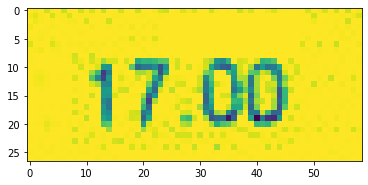

reading line : 348
13,622,108,622,108,642,13,642,ENGINE OIL



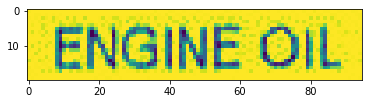

reading line : 349
11,647,63,647,63,668,11,668,70791



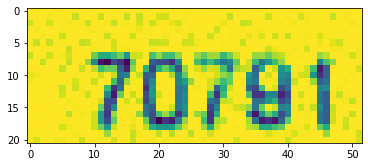

reading line : 350
140,649,163,649,163,669,140,669,1



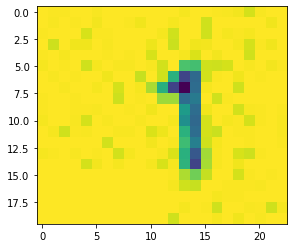

reading line : 351
194,647,239,647,239,667,194,667,10.00



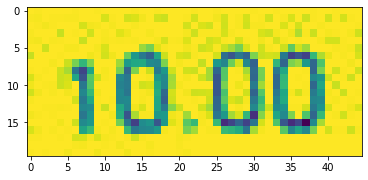

reading line : 352
258,649,306,649,306,669,258,669,10.00



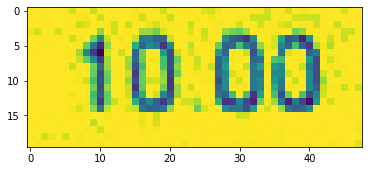

reading line : 353
346,645,393,645,393,666,346,666,10.00



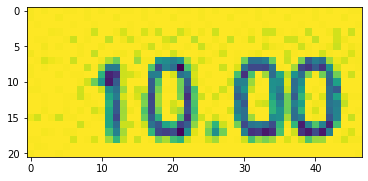

reading line : 354
13,675,283,675,283,694,13,694,GREASE FOR TOOLS 40ML (AKODA)



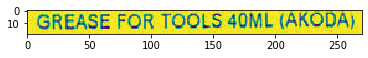

reading line : 355
15,699,66,699,66,720,15,720,70637



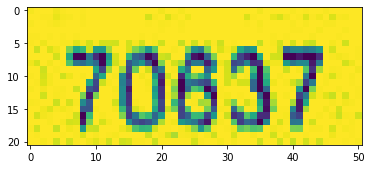

reading line : 356
142,701,169,701,169,718,142,718,1



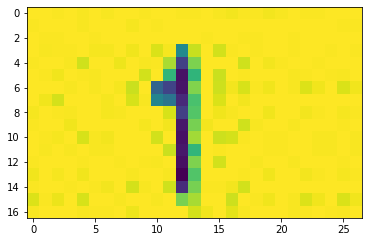

reading line : 357
197,698,234,698,234,718,197,718,6.00



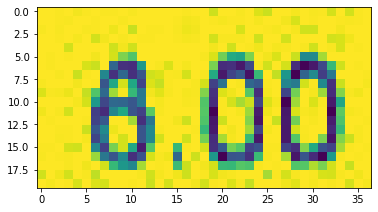

reading line : 358
261,698,302,698,302,715,261,715,6.00



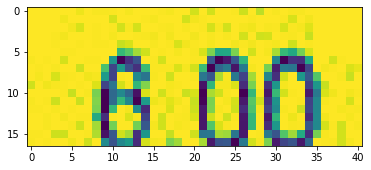

reading line : 359
356,695,397,695,397,716,356,716,6.00



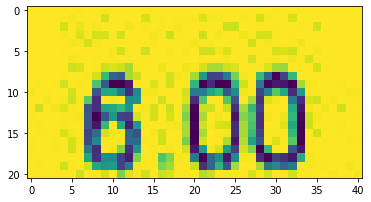

reading line : 360
11,723,183,723,183,743,11,743,EY20 PLUG CHAMPION



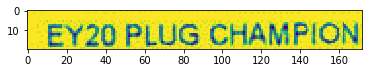

reading line : 361
15,750,60,750,60,771,15,771,1643



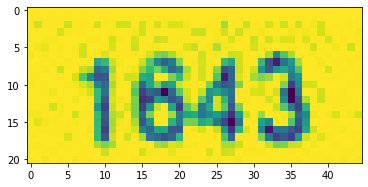

reading line : 362
146,753,163,753,163,770,146,770,1



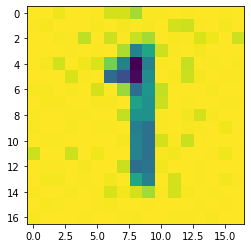

reading line : 363
193,749,234,749,234,772,193,772,8.00



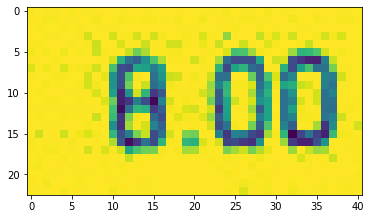

reading line : 364
261,750,302,750,302,769,261,769,8.00



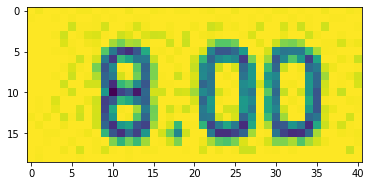

reading line : 365
354,742,397,742,397,769,354,769,8.00



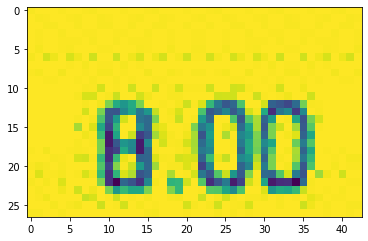

reading line : 366
22,778,128,778,128,796,22,796,STARTER TALI



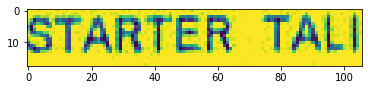

reading line : 367
22,802,60,802,60,822,22,822,70197



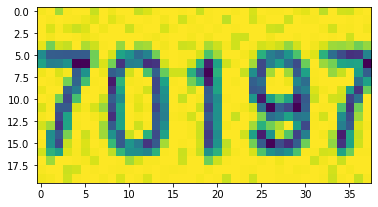

reading line : 368
143,801,166,801,166,820,143,820,1



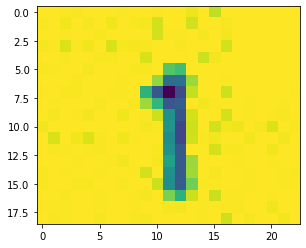

reading line : 369
198,802,236,802,236,817,198,817,10.00



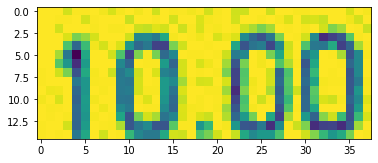

reading line : 370
263,802,303,802,303,816,263,816,10.00



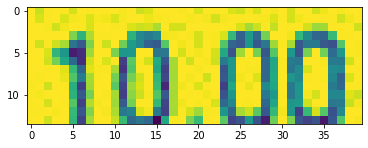

reading line : 371
354,802,392,802,392,817,354,817,10.00



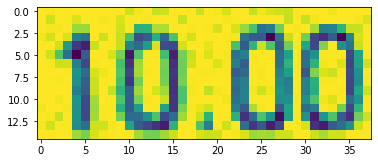

reading line : 372
19,828,191,828,191,844,19,844,EY20 STARTER HANDLE



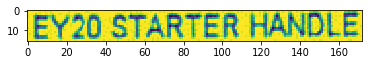

reading line : 373
20,853,62,853,62,874,20,874,70561



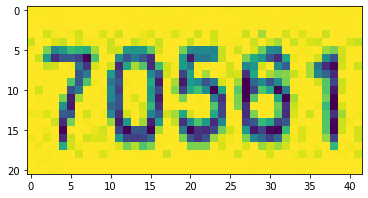

reading line : 374
142,853,169,853,169,873,142,873,2



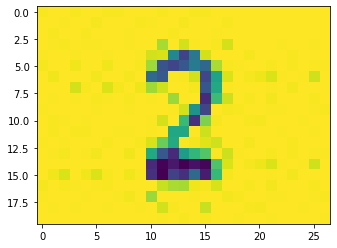

reading line : 375
198,854,232,854,232,868,198,868,18.00



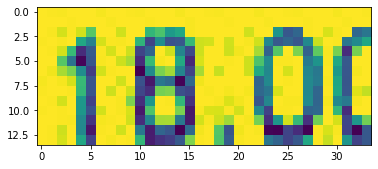

reading line : 376
267,852,301,852,301,869,267,869,18.00



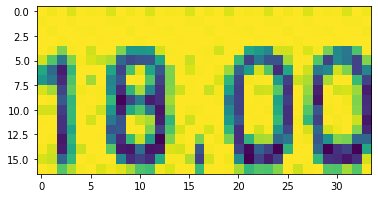

reading line : 377
351,854,390,854,390,870,351,870,36.00



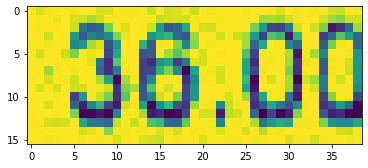

reading line : 378
19,878,128,878,128,896,19,896,HD40 1L COTIN



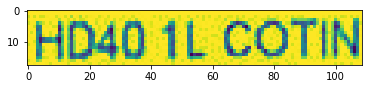

reading line : 379
42,903,111,903,111,924,42,924,TOTAL QTY:



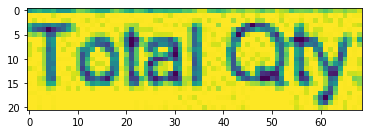

reading line : 380
142,900,163,900,163,920,142,920,9



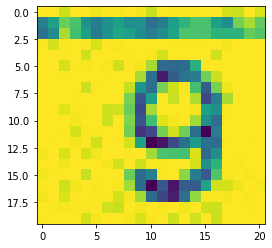

reading line : 381
339,903,392,903,392,918,339,918,327.00



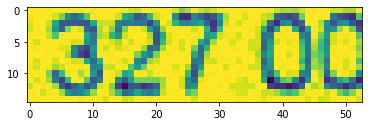

reading line : 382
208,940,306,940,306,960,208,960,TOTAL SALES :



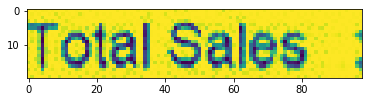

reading line : 383
338,940,395,940,395,958,338,958,327.00



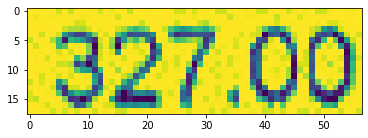

reading line : 384
222,972,307,972,307,990,222,990,DISCOUNT :



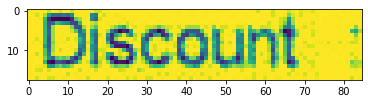

reading line : 385
358,972,396,972,396,987,358,987,0.00



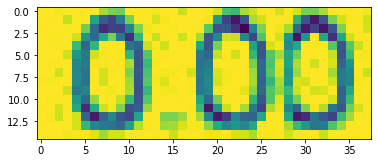

reading line : 386
254,1000,307,1000,307,1018,254,1018,TOTAL :



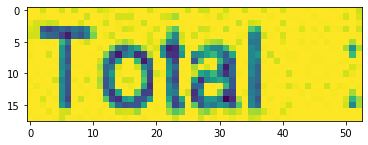

reading line : 387
360,1001,394,1001,394,1016,360,1016,0.00



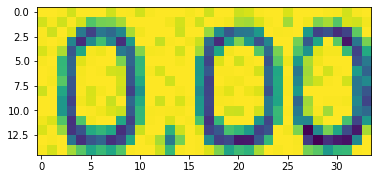

reading line : 388
220,1032,306,1032,306,1049,220,1049,ROUNDING :



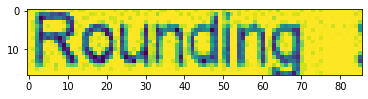

reading line : 389
361,1032,394,1032,394,1046,361,1046,0.00



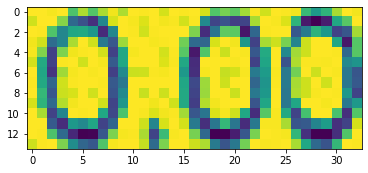

reading line : 390
200,1060,309,1060,309,1081,200,1081,TOTAL SALES :



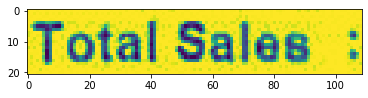

reading line : 391
343,1062,392,1062,392,1076,343,1076,327.00



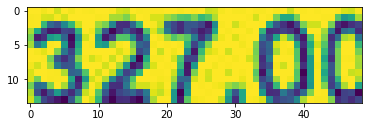

reading line : 392
241,1091,308,1091,308,1107,241,1107,CASH :



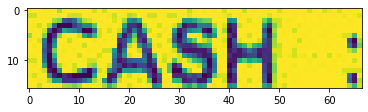

reading line : 393
343,1091,394,1091,394,1108,343,1108,327.00



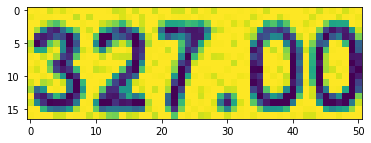

reading line : 394
227,1114,308,1114,308,1132,227,1132,CHANGE :



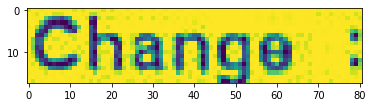

reading line : 395
359,1114,394,1114,394,1128,359,1128,0.00



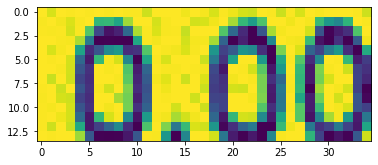

...... processing for X00016469676.jpg
reading corresponding text
reading line : 396
127,55,347,55,347,89,127,89,TAN CHAY YEE



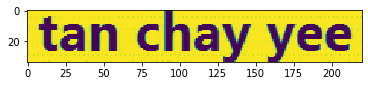

reading line : 397
53,88,415,88,415,127,53,127,S.H.H. MOTOR (SUNGAI RENGIT) SDN. BHD.



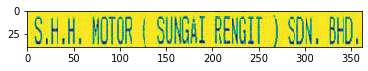

reading line : 398
157,126,266,126,266,147,157,147,(801580-T)



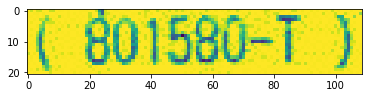

reading line : 399
77,150,392,150,392,170,77,170,NO. 343, JALAN KURAU, SUNGAI RENGIT,



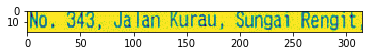

reading line : 400
124,167,334,167,334,191,124,191,81620 PENGERANG, JOHOR.



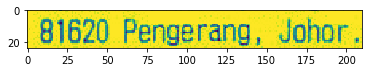

reading line : 401
95,191,374,191,374,215,95,215,TEL: 07-8263254 FAX: 07-8266888



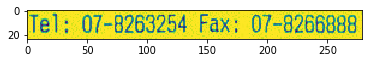

reading line : 402
201,234,266,234,266,259,201,259,INVOICE



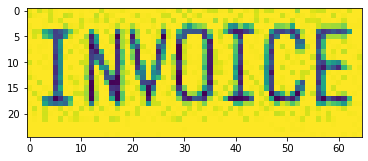

reading line : 403
17,300,103,300,103,323,17,323,ITEM/DESC.



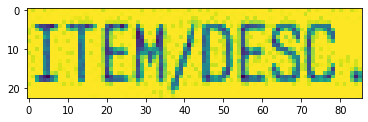

reading line : 404
253,300,440,300,440,323,253,323,QTY U.PRICE RM(TOTAL)



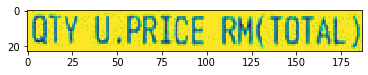

reading line : 405
14,343,56,343,56,364,14,364,4132



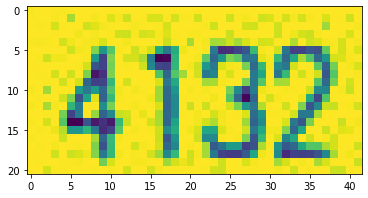

reading line : 406
272,343,290,343,290,369,272,369,1



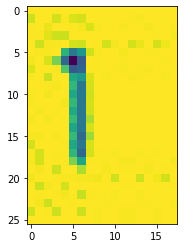

reading line : 407
307,343,353,343,353,367,307,367,20.00



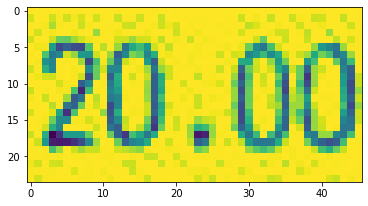

reading line : 408
392,344,443,344,443,367,392,367,20.00



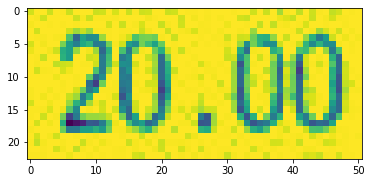

reading line : 409
19,364,186,364,186,389,19,389,CROCS 300X17 TUBES



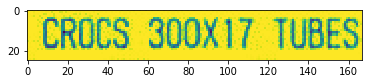

reading line : 410
264,408,360,408,360,428,264,428,SUB TOTAL :



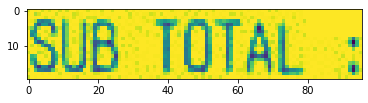

reading line : 411
396,410,441,410,441,427,396,427,20.00



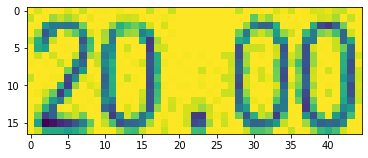

reading line : 412
175,432,360,432,360,449,175,449,ROUNDING ADJUSTMENT :



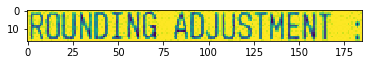

reading line : 413
405,433,441,433,441,451,405,451,0.00



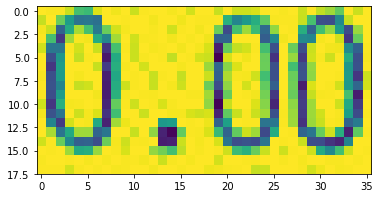

reading line : 414
241,450,361,450,361,473,241,473,GRAND TOTAL :



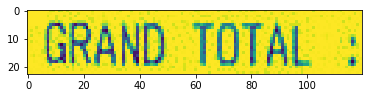

reading line : 415
397,454,439,454,439,472,397,472,20.00



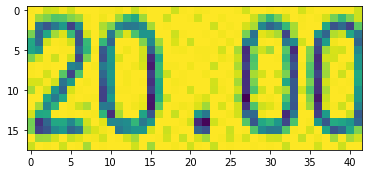

reading line : 416
306,475,361,475,361,497,306,497,CASH :



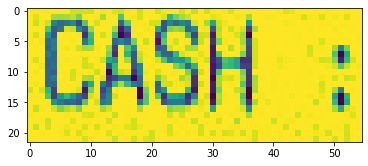

reading line : 417
396,473,442,473,442,494,396,494,20.00



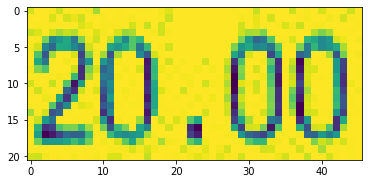

reading line : 418
289,497,361,497,361,516,289,516,CHANGE :



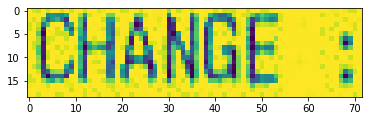

reading line : 419
405,497,443,497,443,516,405,516,0.00



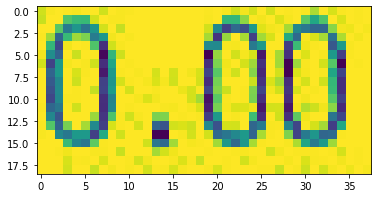

reading line : 420
15,538,351,538,351,561,15,561,23-01-2019 13:14:15 PM, PRINT BY: ROOT



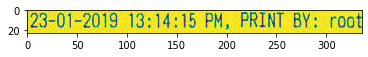

reading line : 421
18,560,345,560,345,581,18,581,TOKEN NO: 0, STATION ID: A1, PID: POS



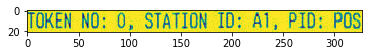

reading line : 422
14,582,167,582,167,602,14,602,INVOICE NO: 22497



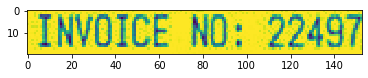

reading line : 423
15,622,186,622,186,645,15,645,THANKS YOUR SUPPORT



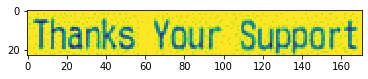

...... processing for X51005200938.jpg
reading corresponding text
reading line : 424
366,241,597,241,597,259,366,259,PERNIAGAAN ZHENG HUI



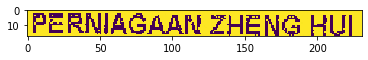

reading line : 425
435,263,526,263,526,283,435,283,JM0325955-V



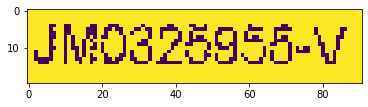

reading line : 426
391,282,562,282,562,302,391,302,NO.59 JALAN PERMAS 9/5



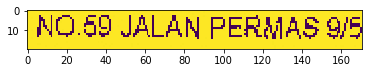

reading line : 427
377,299,578,299,578,315,377,315,BANDAR BARU PERMAS JAYA



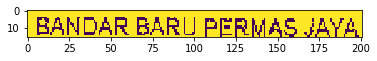

reading line : 428
407,319,549,319,549,336,407,336,81760 JOHOR BAHRU



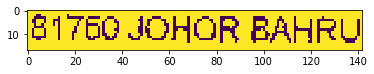

reading line : 429
367,337,614,337,614,353,367,353,TEL : 07-386 7524 FAX : 07-386 3793



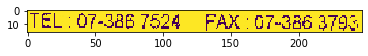

reading line : 430
409,357,570,357,570,374,409,374,GST NO: 000800589824



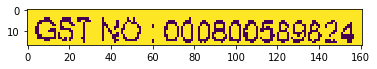

reading line : 431
399,387,579,387,579,402,399,402,SIMPLIFIED TAX INVOICE



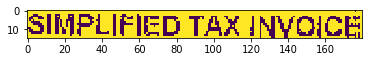

reading line : 432
311,411,561,411,561,428,311,428,GOGIANT ENGINEERING (M) SDN BHD



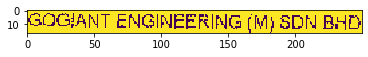

reading line : 433
309,437,462,437,462,452,309,452,RECEIPT#: CS00082662



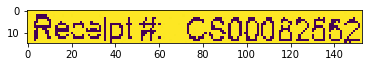

reading line : 434
309,457,392,457,392,474,309,474,SALESPERSON:



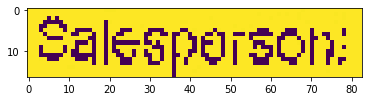

reading line : 435
532,463,637,463,637,479,532,479,DATE: 12/02/2018



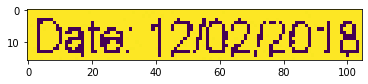

reading line : 436
308,475,410,475,410,492,308,492,CASHIER: USER



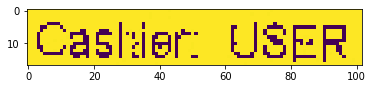

reading line : 437
530,483,624,483,624,498,530,498,TIME:08:30:00



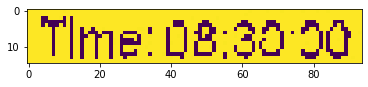

reading line : 438
540,513,574,513,574,527,540,527,(RM)



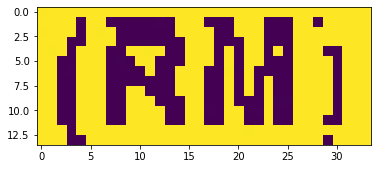

reading line : 439
612,512,647,512,647,528,612,528,(RM)



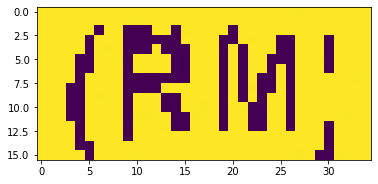

reading line : 440
308,525,340,525,340,541,308,541,ITEM



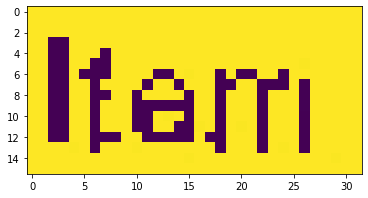

reading line : 441
489,530,516,530,516,545,489,545,QTY



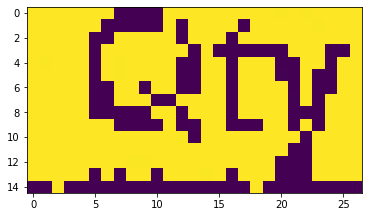

reading line : 442
543,527,569,527,569,544,543,544,RSP



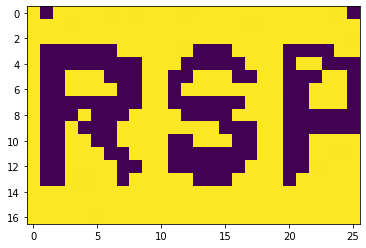

reading line : 443
592,529,645,529,645,543,592,543,AMOUNT



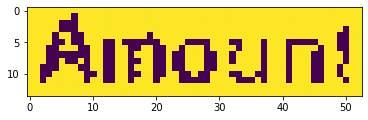

reading line : 444
307,543,343,543,343,558,307,558,8239



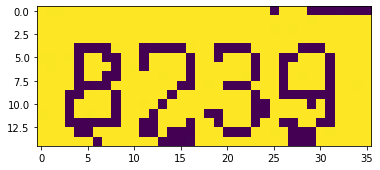

reading line : 445
495,548,509,548,509,561,495,561,1



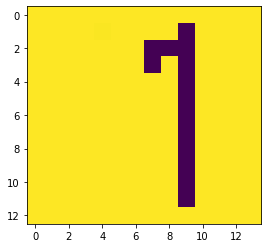

reading line : 446
540,547,575,547,575,563,540,563,15.00



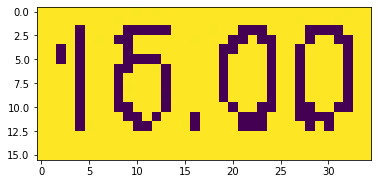

reading line : 447
610,544,644,544,644,562,610,562,15.00



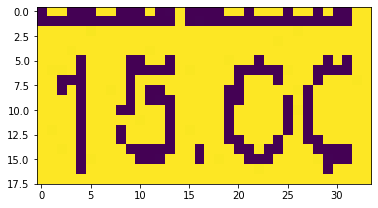

reading line : 448
309,563,619,563,619,580,309,580,SR: 11" PROWESS H/DUTY SILICONE GUN G-D2



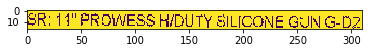

reading line : 449
301,585,410,585,410,603,301,603,9555075109147



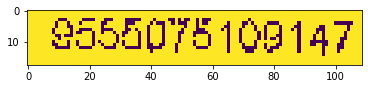

reading line : 450
492,588,515,588,515,602,492,602,3



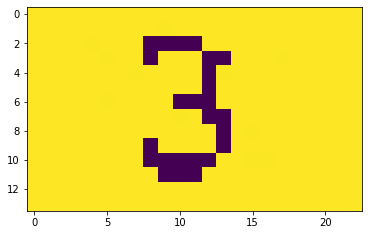

reading line : 451
540,588,576,588,576,602,540,602,7.00



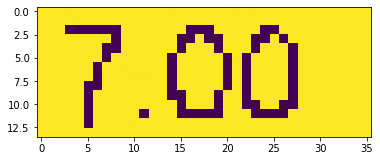

reading line : 452
606,587,648,587,648,602,606,602,21.00



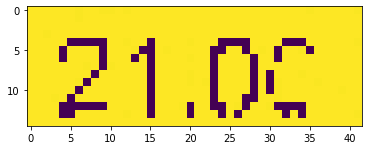

reading line : 453
304,605,608,605,608,622,304,622,SR: XTRASEAL RTV ACETIC SILICONE SA-107



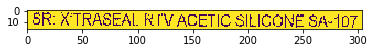

reading line : 454
305,627,342,627,342,641,305,641,9744



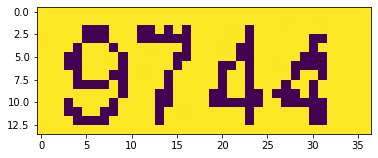

reading line : 455
495,631,506,631,506,643,495,643,1



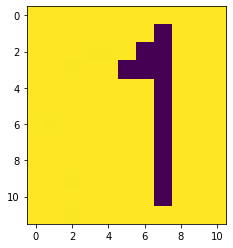

reading line : 456
537,629,575,629,575,645,537,645,18.00



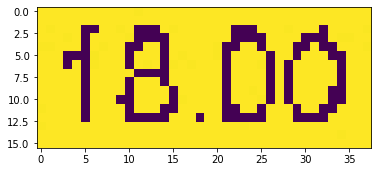

reading line : 457
608,629,642,629,642,644,608,644,18.00



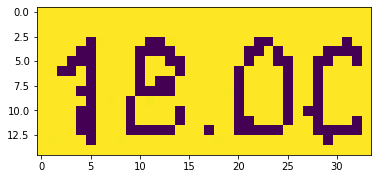

reading line : 458
307,646,616,646,616,665,307,665,SR: CENTRAL PUNCH SET 3PCS - 1/4",5/32".1/4"



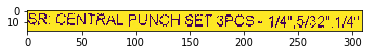

reading line : 459
305,667,348,667,348,681,305,681,12525



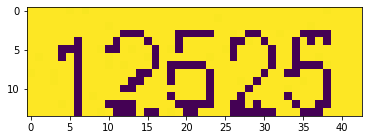

reading line : 460
496,672,509,672,509,685,496,685,1



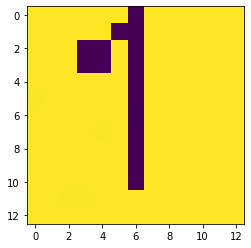

reading line : 461
537,669,576,669,576,685,537,685,50.00



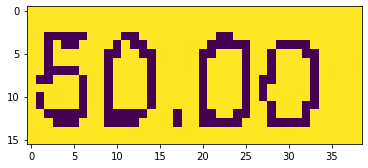

reading line : 462
606,670,642,670,642,686,606,686,50.00



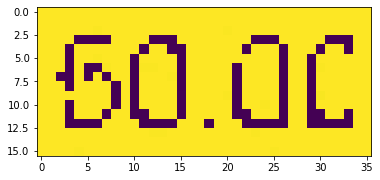

reading line : 463
304,688,535,688,535,705,304,705,SR. 24" MARKSMAN PIPE WRENCH



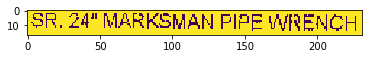

reading line : 464
304,709,340,709,340,723,304,723,2016



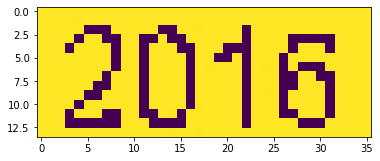

reading line : 465
495,711,508,711,508,725,495,725,3



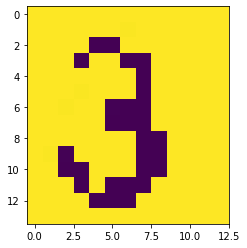

reading line : 466
538,709,569,709,569,725,538,725,0.70



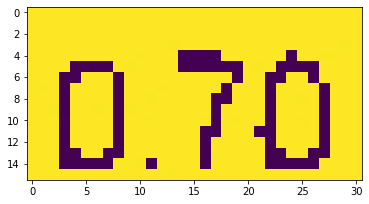

reading line : 467
614,712,643,712,643,726,614,726,2.10



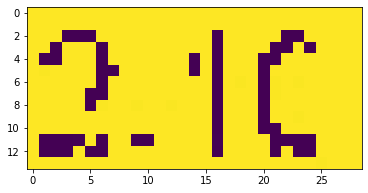

reading line : 468
305,727,512,727,512,746,305,746,SR: PVC WIRE TAPE 1PC X 7YD



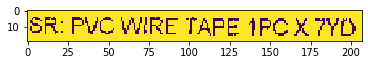

reading line : 469
337,746,402,746,402,764,337,764,TOT QTY:



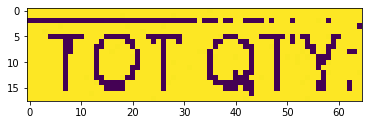

reading line : 470
422,750,435,750,435,765,422,765,9



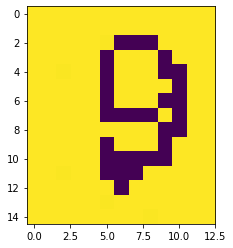

reading line : 471
598,750,642,750,642,769,598,769,106.10



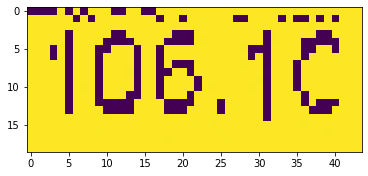

reading line : 472
354,790,556,790,556,808,354,808,(EXCLUDED GST) SUB TOTAL (RM) :



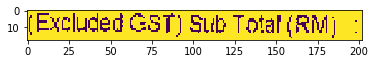

reading line : 473
593,792,636,792,636,808,593,808,106.10



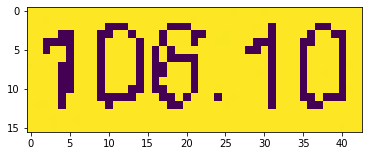

reading line : 474
452,814,556,814,556,831,452,831,DISCOUNT (RM) :



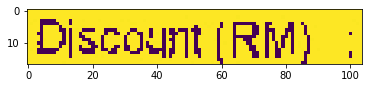

reading line : 475
604,816,638,816,638,830,604,830,0.00



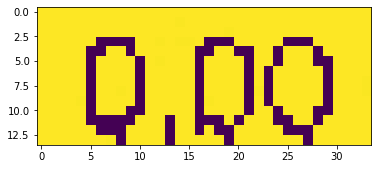

reading line : 476
446,838,554,838,554,855,446,855,TOTAL GST (RM) :



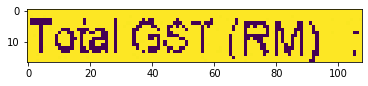

reading line : 477
605,840,634,840,634,854,605,854,6.37



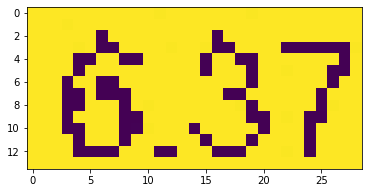

reading line : 478
420,863,558,863,558,883,420,883,ROUNDING (RM) :



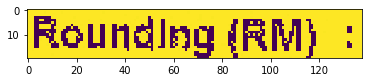

reading line : 479
590,866,635,866,635,881,590,881,-0.02



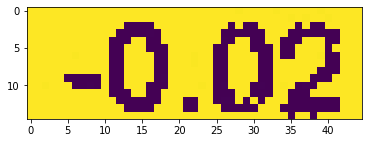

reading line : 480
456,888,557,888,557,907,456,907,TOTAL (RM) :



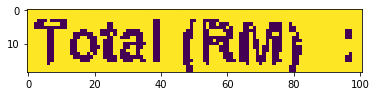

reading line : 481
582,890,635,890,635,908,582,908,112.45



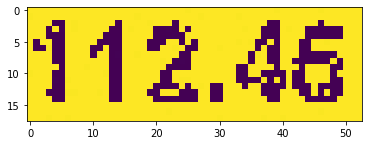

reading line : 482
493,914,553,914,553,931,493,931,CASH :



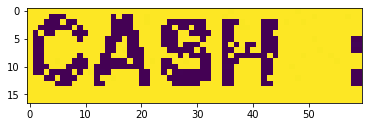

reading line : 483
578,916,639,916,639,931,578,931,112.45



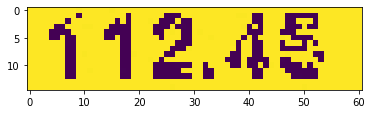

reading line : 484
435,934,558,934,558,957,435,957,CHANGE (RM) :



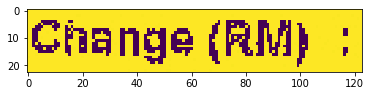

reading line : 485
598,936,633,936,633,952,598,952,0.00



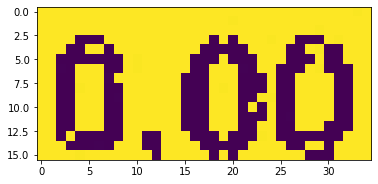

reading line : 486
300,987,441,987,441,1004,300,1004,GST SUMMARY



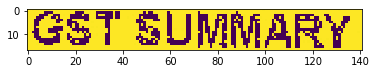

reading line : 487
306,1017,376,1017,376,1036,306,1036,TAX CODE



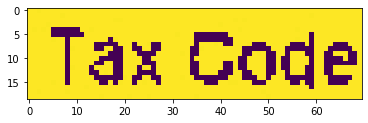

reading line : 488
429,1019,443,1019,443,1038,429,1038,%



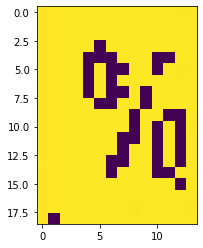

reading line : 489
493,1020,549,1020,549,1040,493,1040,AMOUNT



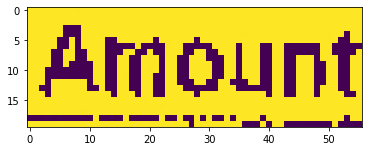

reading line : 490
597,1021,633,1021,633,1037,597,1037,GST



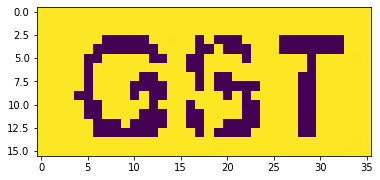

reading line : 491
313,1038,334,1038,334,1053,313,1053,SR



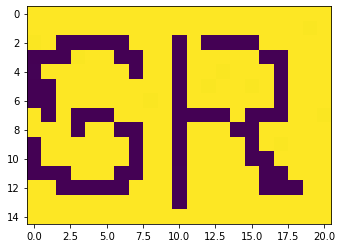

reading line : 492
434,1039,445,1039,445,1053,434,1053,6



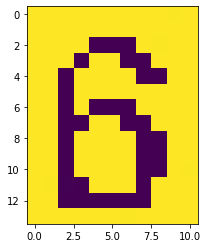

reading line : 493
502,1039,551,1039,551,1057,502,1057,106.10



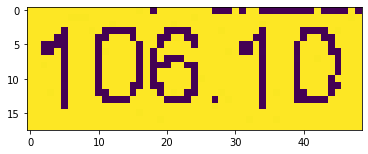

reading line : 494
598,1040,635,1040,635,1058,598,1058,6.37



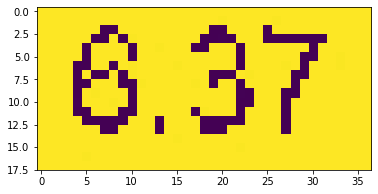

reading line : 495
397,1064,441,1064,441,1081,397,1081,TOTAL :



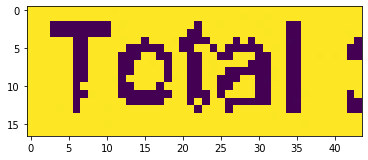

reading line : 496
503,1063,547,1063,547,1081,503,1081,106.10



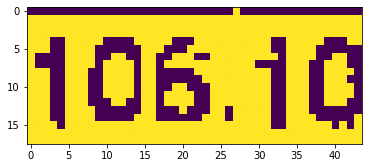

reading line : 497
600,1066,628,1066,628,1081,600,1081,6.37



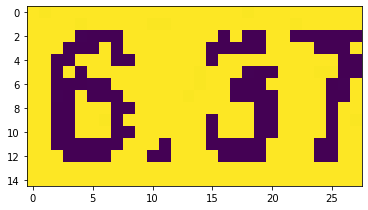

reading line : 498
335,1103,589,1103,589,1120,335,1120,GOODS SOLD ARE NOT RETURNABLE.



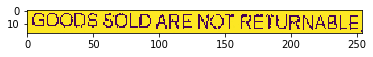

reading line : 499
420,1122,506,1122,506,1138,420,1138,THANK YOU.



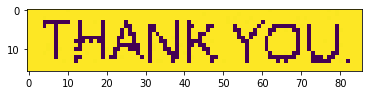

...... processing for X51005230617.jpg
reading corresponding text
reading line : 500
223,112,331,112,331,165,223,165,1950



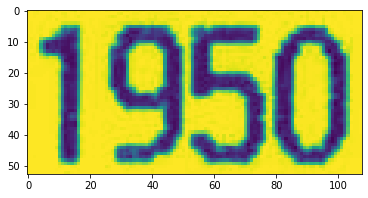

reading line : 501
45,197,477,197,477,224,45,224,GERBANG ALAF RESTAURANTS SDN BHD



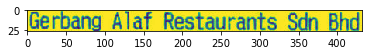

reading line : 502
192,229,316,229,316,258,192,258,(65351-M)



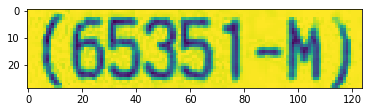

reading line : 503
140,261,369,261,369,288,140,288,FORMERLY KNOWN AS



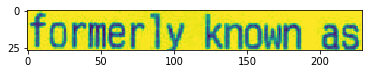

reading line : 504
31,293,478,293,478,320,31,320,GOLDEN ARCHES RESTAURANTS SDN BHD



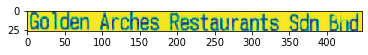

reading line : 505
111,326,409,326,409,354,111,354,LICENSEE OF MCDONALD'S



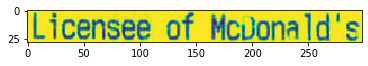

reading line : 506
6,358,530,358,530,389,6,389,LEVEL 6, BANGUNAN TH, DAMANSARA UPTOWN3



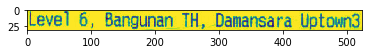

reading line : 507
6,390,529,390,529,422,6,422,NO.3, JALAN SS21/39,47400 PETALING JAYA



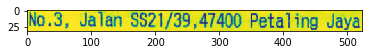

reading line : 508
204,423,316,423,316,452,204,452,SELANGOR



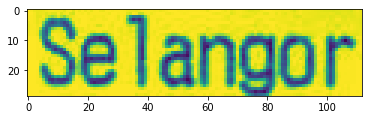

reading line : 509
99,454,436,454,436,487,99,487,(GST ID NO: 000504664064)



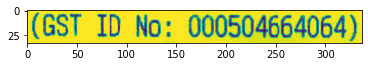

reading line : 510
31,487,500,487,500,517,31,517,MCDONALD'S BHP TAMAN MELAWATI(#328)



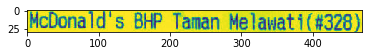

reading line : 511
126,519,409,519,409,548,126,548,TEL NO. 03-4162-2318



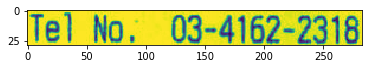

reading line : 512
192,552,341,552,341,581,192,581,TAX INVOICE



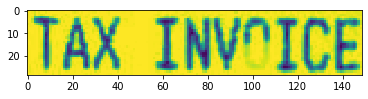

reading line : 513
205,618,341,618,341,645,205,645,MFY SIDE 1



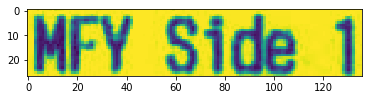

reading line : 514
6,681,275,681,275,710,6,710,INV# 003281900229170



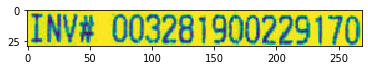

reading line : 515
4,715,501,715,501,744,4,744,ORD #50 -REG #19- 18/01/2018 10:27:03



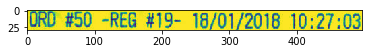

reading line : 516
5,746,116,746,116,773,5,773,QTY ITEM



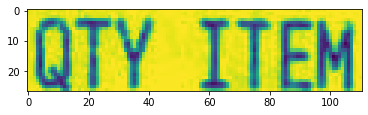

reading line : 517
30,779,224,779,224,808,30,808,2 CHICMCMUFFIN



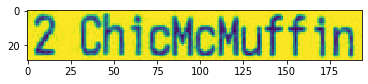

reading line : 518
32,813,196,813,196,844,32,844,1 M PORRIDGE



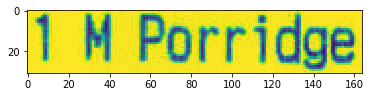

reading line : 519
33,846,222,846,222,873,33,873,1 BM 2HOTCAKES



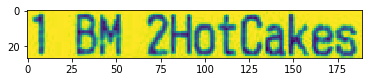

reading line : 520
59,878,169,878,169,907,59,907,1 L COKE



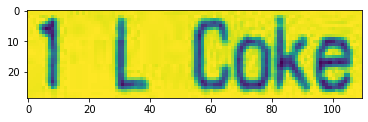

reading line : 521
3,941,327,941,327,973,3,973,TAKEOUT TOTAL (INCL GST)



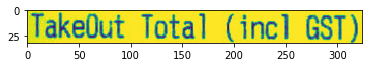

reading line : 522
3,974,183,974,183,1003,3,1003,TOTAL ROUNDED



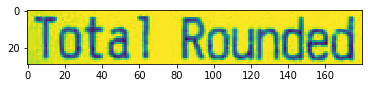

reading line : 523
4,1007,180,1007,180,1036,4,1036,CASH TENDERED



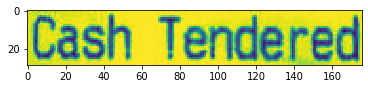

reading line : 524
3,1040,88,1040,88,1071,3,1071,CHANGE



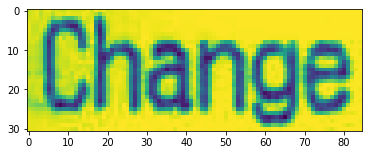

reading line : 525
5,1104,288,1104,288,1135,5,1135,TOTAL INCLUDES 6% GST



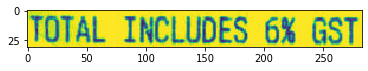

reading line : 526
456,748,528,748,528,777,456,777,TOTAL



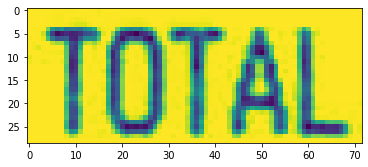

reading line : 527
459,784,529,784,529,810,459,810,11.00



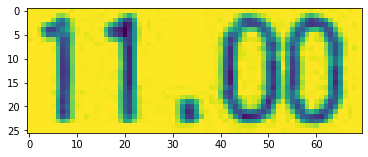

reading line : 528
469,816,528,816,528,842,469,842,5.60



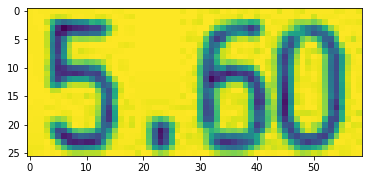

reading line : 529
457,847,530,847,530,874,457,874,10.00



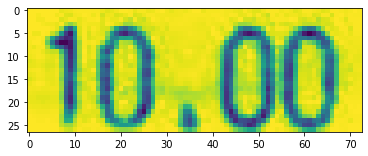

reading line : 530
457,945,527,945,527,972,457,972,26.60



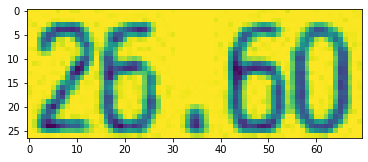

reading line : 531
456,977,528,977,528,1004,456,1004,26.60



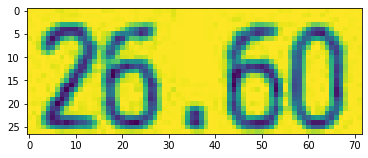

reading line : 532
444,1012,527,1012,527,1038,444,1038,100.00



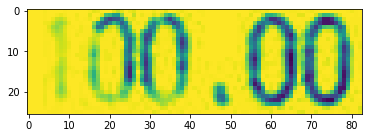

reading line : 533
458,1043,526,1043,526,1070,458,1070,73.40



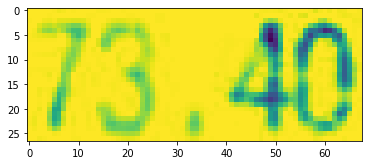

reading line : 534
471,1110,524,1110,524,1137,471,1137,1.51



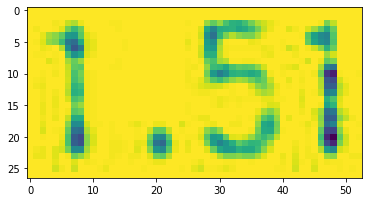

reading line : 535
42,1202,457,1202,457,1233,42,1233,WE'D LOVE TO HEAR YOUR FEEDBACK



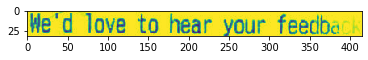

reading line : 536
101,1271,446,1271,446,1301,101,1301,SIT WWW.MCDFEEDBACK.COM.MY



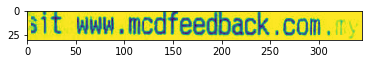

reading line : 537
243,1304,274,1304,274,1330,243,1330,OR



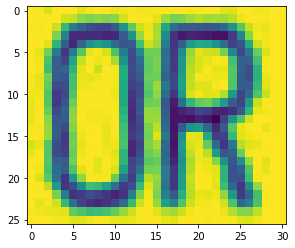

reading line : 538
69,1334,459,1334,459,1365,69,1365,DOWNLOAD MY MCD FEEDBACK FROM



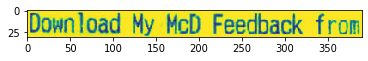

reading line : 539
122,1366,405,1366,405,1399,122,1399,GOOGLE PLAY/APP STORE



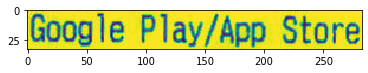

reading line : 540
95,1434,419,1434,419,1465,95,1465,TO SHARE YOUR EXPERIENCE



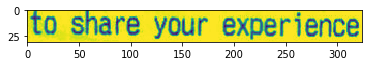

reading line : 541
27,1497,456,1497,456,1530,27,1530,THANK YOU AND PLEASE COME AGAIN.



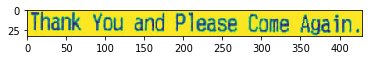

reading line : 542
2,1530,525,1530,525,1562,2,1562,CUSTOMER SERVICE HOTLINE : 03-2726-5600



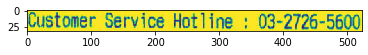

...... processing for X51005255805.jpg
reading corresponding text
reading line : 543
130,68,676,68,676,105,130,105,SAM SAM TRADING CO



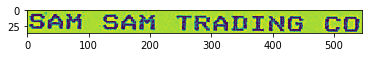

reading line : 544
325,111,476,111,476,147,325,147,(742016-W)



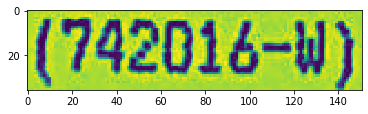

reading line : 545
158,150,641,150,641,189,158,189,67,JLN MEWAH 25/63 TMN SRI MUDA,



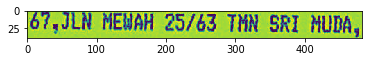

reading line : 546
277,190,520,190,520,223,277,223,40400 SHAH ALAM.



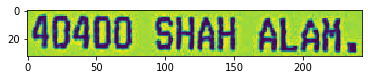

reading line : 547
233,228,550,228,550,261,233,261,TEL/FAX : 03-51213881



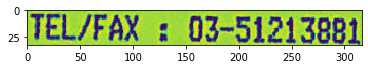

reading line : 548
246,268,553,268,553,302,246,302,GST NO: 001006288896



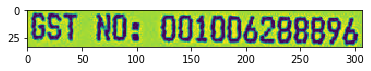

reading line : 549
305,349,476,349,476,381,305,381,TAX INVOICE



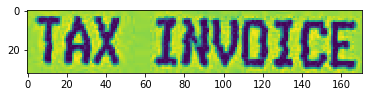

reading line : 550
93,423,674,423,674,462,93,462,HE EOG UNICORN TWIN SUPER GLUE USG-99-



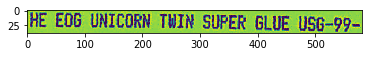

reading line : 551
94,463,293,463,293,495,94,495,9557368063013



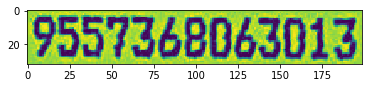

reading line : 552
94,503,671,503,671,544,94,544,SS EZL A4 CYBER MIX COLOR PAPER 100'S8



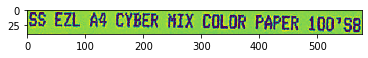

reading line : 553
92,542,110,542,110,574,92,574,2



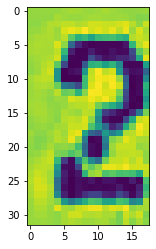

reading line : 554
154,544,203,544,203,574,154,574,008



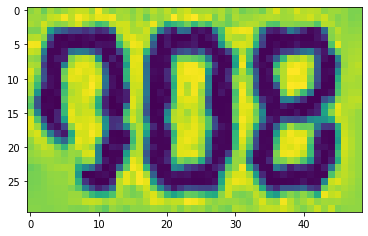

reading line : 555
379,466,429,466,429,496,379,496,1 X



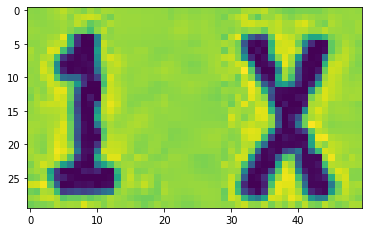

reading line : 556
468,468,534,468,534,500,468,500,5.20



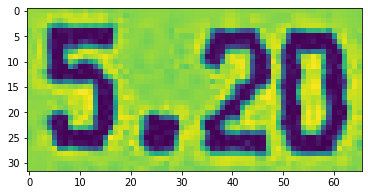

reading line : 557
605,471,704,471,704,505,605,505,5.20 S



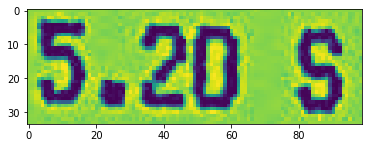

reading line : 558
378,546,429,546,429,576,378,576,1 X



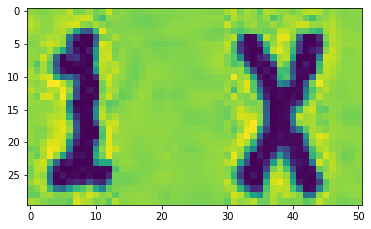

reading line : 559
467,547,533,547,533,580,467,580,8.90



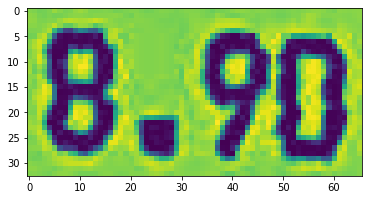

reading line : 560
603,552,700,552,700,585,603,585,8.90 S



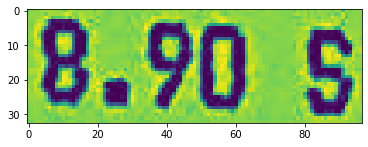

reading line : 561
289,1370,507,1370,507,1412,289,1412,INV:R000721136



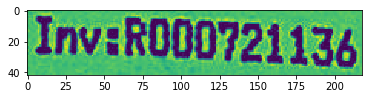

reading line : 562
229,1371,262,1371,262,1402,229,1402,01



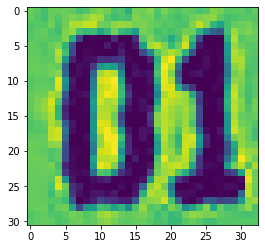

reading line : 563
154,1370,207,1370,207,1403,154,1403,SWH



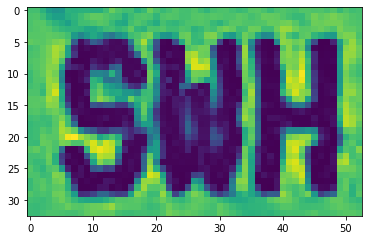

reading line : 564
82,1371,130,1371,130,1403,82,1403,WC5



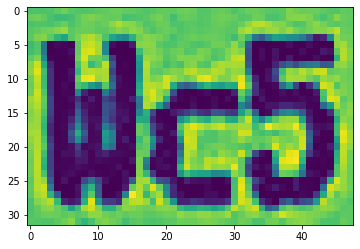

reading line : 565
89,619,230,619,230,657,89,657,NO. QTY:



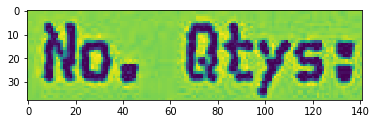

reading line : 566
206,1330,344,1330,344,1364,206,1364,: SAM SAM



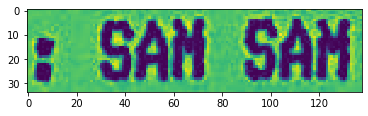

reading line : 567
389,623,578,623,578,659,389,659,2 NO. ITEMS:



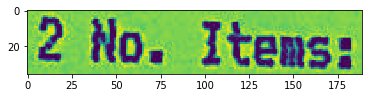

reading line : 568
81,1333,129,1333,129,1363,81,1363,CAS



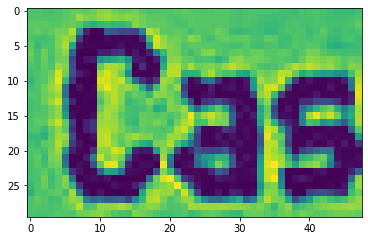

reading line : 569
379,1293,568,1293,568,1335,379,1335,TIME : 20:17



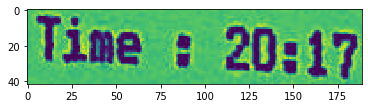

reading line : 570
649,631,671,631,671,663,649,663,2



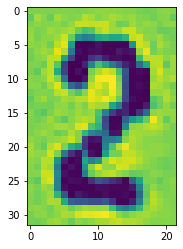

reading line : 571
91,699,306,699,306,738,91,738,TAX AMT (S) 6%



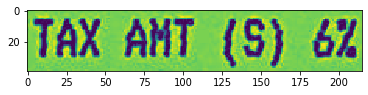

reading line : 572
88,739,188,739,188,773,88,773,GST 6%



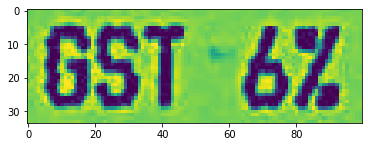

reading line : 573
90,779,258,779,258,816,90,816,TAX AMT (Z)



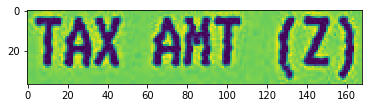

reading line : 574
88,818,184,818,184,851,88,851,GST 0%



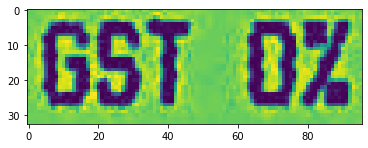

reading line : 575
88,857,303,857,303,895,88,895,TAX AMT (E) 6%



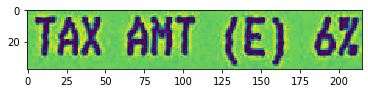

reading line : 576
88,897,243,897,243,930,88,930,EXC GST 6%



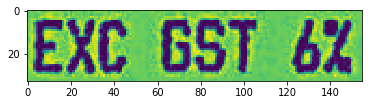

reading line : 577
542,707,668,707,668,742,542,742,RM 13.30



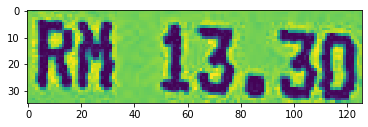

reading line : 578
555,748,666,748,666,783,555,783,RM 0.80



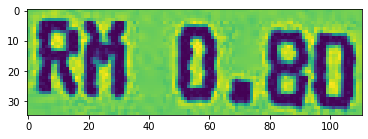

reading line : 579
556,788,666,788,666,821,556,821,RM 0.00



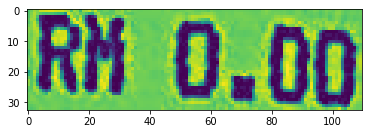

reading line : 580
553,826,664,826,664,862,553,862,RM 0.00



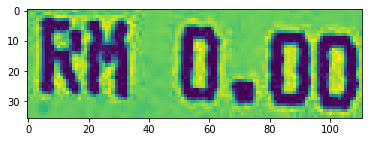

reading line : 581
555,867,665,867,665,903,555,903,RM 0.00



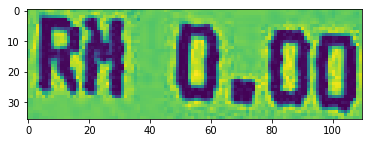

reading line : 582
553,906,664,906,664,942,553,942,RM 0.00



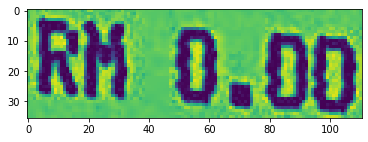

reading line : 583
86,976,236,976,236,1009,86,1009,TOTAL



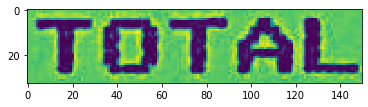

reading line : 584
444,980,690,980,690,1023,444,1023,RM 14.10



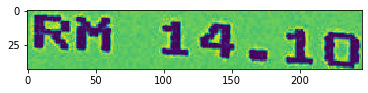

reading line : 585
85,1016,152,1016,152,1046,85,1046,CASH



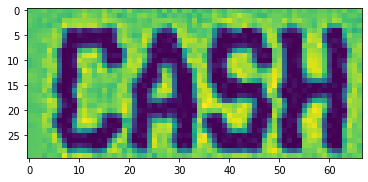

reading line : 586
537,1024,663,1024,663,1063,537,1063,RM 20.00



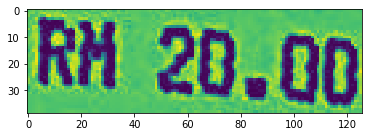

reading line : 587
85,1097,267,1097,267,1126,85,1126,CHANGE



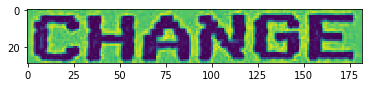

reading line : 588
474,1101,690,1101,690,1146,474,1146,RM 5.90



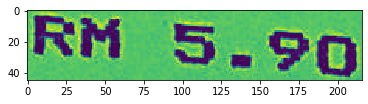

reading line : 589
218,1173,554,1173,554,1213,218,1213,THANK YOU FOR SHOPPING



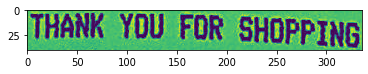

reading line : 590
158,1212,611,1212,611,1257,158,1257,GOODS SOLD ARE NOT RETURNABLE.



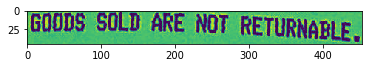

reading line : 591
82,1291,190,1291,190,1327,82,1327,FRIDAY,



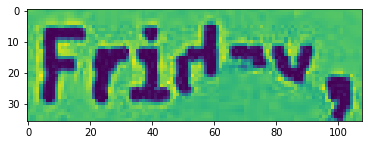

reading line : 592
201,1292,356,1292,356,1324,201,1324,29-12-2017



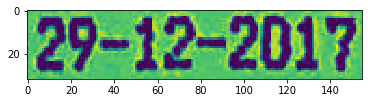

reading line : 593
286,779,320,779,320,812,286,812,0%



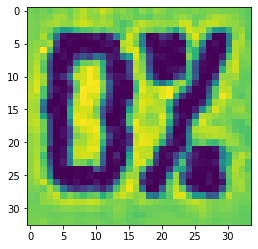

...... processing for X51005268200.jpg
reading corresponding text
reading line : 594
112,298,628,298,628,358,112,358,AIK HUAT HARDWARE



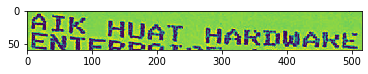

reading line : 595
114,329,628,329,628,387,114,387,ENTERPRISE (SETIA



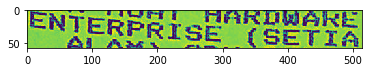

reading line : 596
171,366,567,366,567,415,171,415,ALAM) SDN BHD



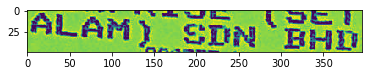

reading line : 597
306,407,432,407,432,439,306,439,822737-X



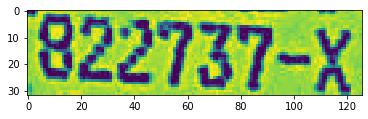

reading line : 598
160,425,574,425,574,473,160,473,NO. 17-G, JALAN SETIA INDAH



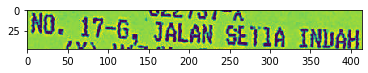

reading line : 599
203,459,535,459,535,509,203,509,(X) U13/X, SETIA ALAM,



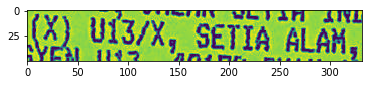

reading line : 600
147,485,586,485,586,539,147,539,SEKSYEN U13, 40170 SHAH ALAM,



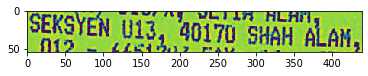

reading line : 601
86,512,646,512,646,567,86,567,TEL: 012 - 6651783 FAX: 03 - 33623608



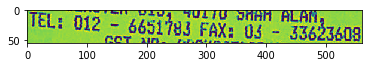

reading line : 602
212,553,518,553,518,592,212,592,GST NO: 000394528768



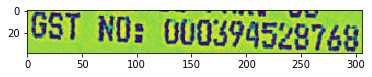

reading line : 603
196,611,533,611,533,677,196,677,SIMPLIFIED TAX INVOICE



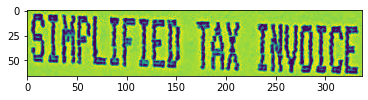

reading line : 604
54,728,123,728,123,760,54,760,CASH



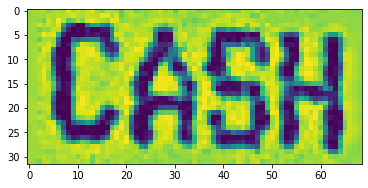

reading line : 605
56,790,632,790,632,834,56,834,RECEIPT #: CSP0393921 DATE: 15/06/2017



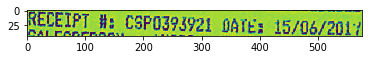

reading line : 606
340,979,644,979,644,1014,340,1014,BIG STRETCH FILM ???



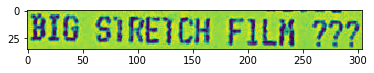

reading line : 607
54,820,346,820,346,858,54,858,SALESPERSON : AH002



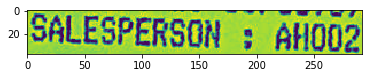

reading line : 608
387,832,602,832,602,864,387,864,TIME: 15:28:00



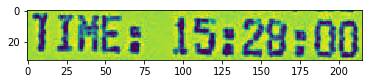

reading line : 609
55,881,121,881,121,912,55,912,ITEM



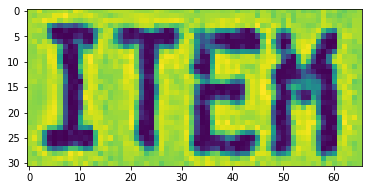

reading line : 610
326,891,374,891,374,918,326,918,QTY



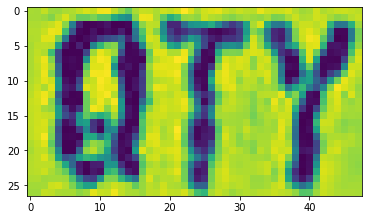

reading line : 611
445,892,497,892,497,921,445,921,U/P



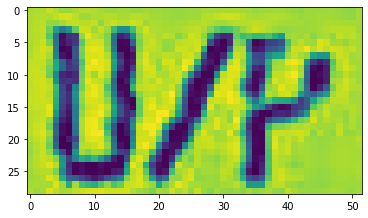

reading line : 612
433,920,493,920,493,954,433,954,(RM)



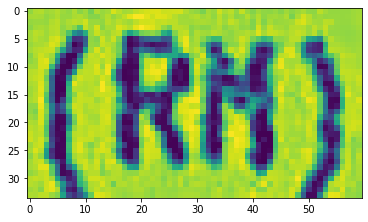

reading line : 613
533,894,632,894,632,924,533,924,AMOUNT



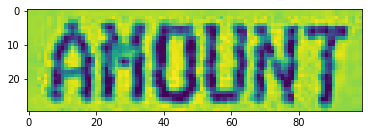

reading line : 614
570,925,628,925,628,958,570,958,(RM)



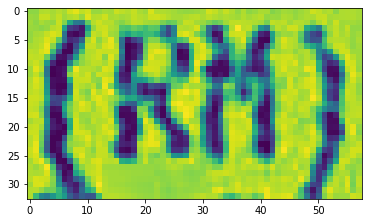

reading line : 615
52,940,256,940,256,974,52,974,2000160000024



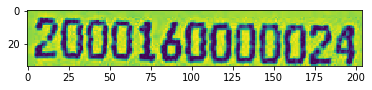

reading line : 616
326,948,347,948,347,978,326,978,1



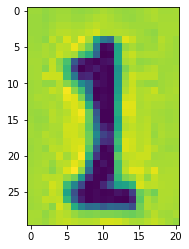

reading line : 617
417,952,493,952,493,981,417,981,15.00



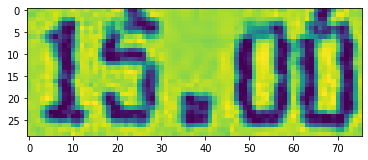

reading line : 618
552,953,663,953,663,983,552,983,15.00 S



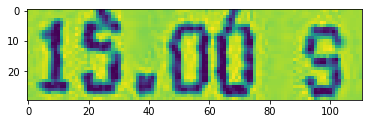

reading line : 619
52,972,315,972,315,1008,52,1008,20" 1.6KG X 500MM



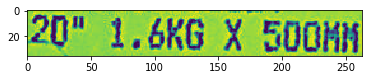

reading line : 620
84,1034,269,1034,269,1066,84,1066,TAL QUANTITY



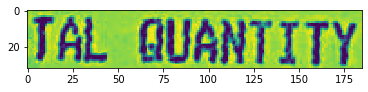

reading line : 621
430,1043,449,1043,449,1070,430,1070,1



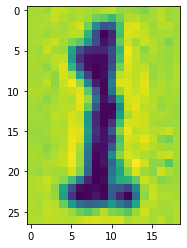

reading line : 622
283,1128,510,1128,510,1165,283,1165,SUB-TOTAL (GST)



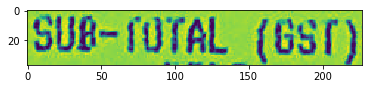

reading line : 623
584,1134,662,1134,662,1162,584,1162,15.00



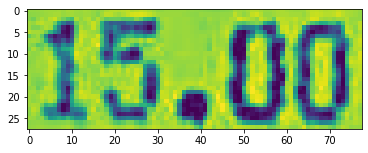

reading line : 624
372,1160,437,1160,437,1189,372,1189,DISC



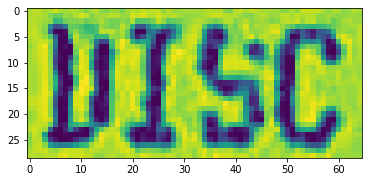

reading line : 625
597,1163,662,1163,662,1192,597,1192,0.00



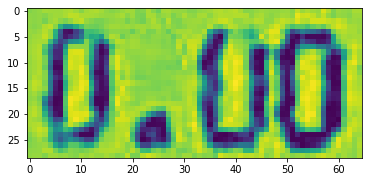

reading line : 626
372,1190,496,1190,496,1221,372,1221,ROUNDING



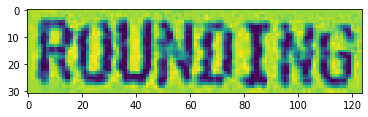

reading line : 627
597,1194,662,1194,662,1222,597,1222,0.00



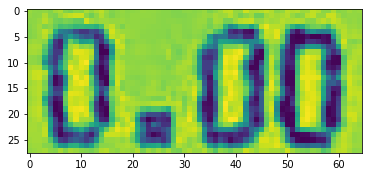

reading line : 628
86,1216,239,1216,239,1248,86,1248,TOTAL



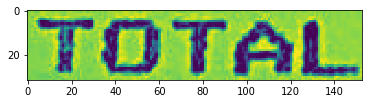

reading line : 629
511,1221,659,1221,659,1251,511,1251,15.00



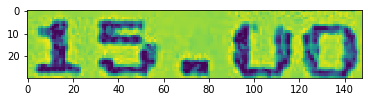

reading line : 630
88,1247,212,1247,212,1278,88,1278,CASH



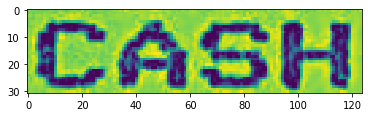

reading line : 631
511,1253,661,1253,661,1283,511,1283,15.00



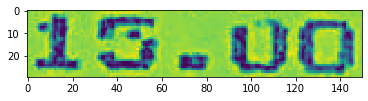

reading line : 632
85,1278,274,1278,274,1309,85,1309,CHANGE



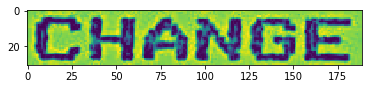

reading line : 633
538,1281,659,1281,659,1311,538,1311,0.00



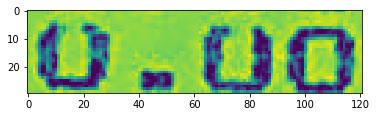

reading line : 634
150,1339,559,1339,559,1372,150,1372,*GST @ 6% INCLUDED IN TOTAL



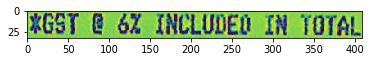

reading line : 635
272,1400,439,1400,439,1428,272,1428,GST SUMMARY



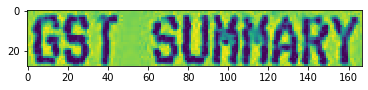

reading line : 636
55,1459,124,1459,124,1490,55,1490,CODE



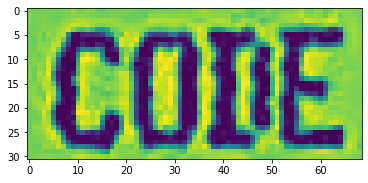

reading line : 637
300,1459,395,1459,395,1489,300,1489,AMOUNT



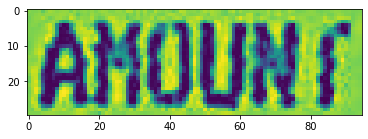

reading line : 638
463,1459,484,1459,484,1489,463,1489,%



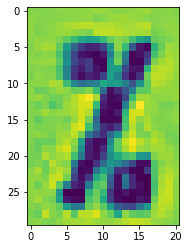

reading line : 639
541,1461,649,1461,649,1490,541,1490,TAX/AMT



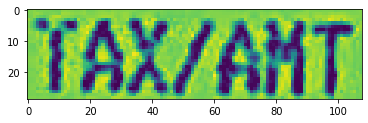

reading line : 640
56,1521,92,1521,92,1551,56,1551,SR



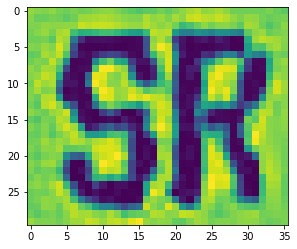

reading line : 641
315,1519,396,1519,396,1549,315,1549,14.15



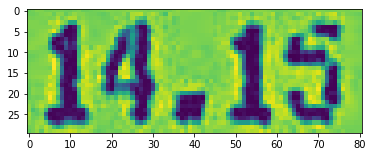

reading line : 642
462,1520,483,1520,483,1549,462,1549,6



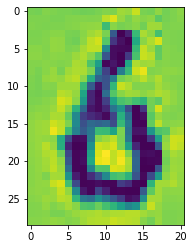

reading line : 643
583,1520,648,1520,648,1550,583,1550,0.85



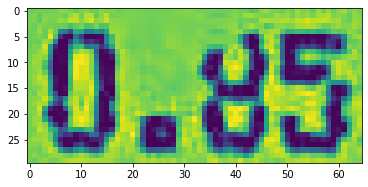

reading line : 644
342,1608,496,1608,496,1639,342,1639,TAX TOTAL:



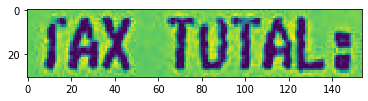

reading line : 645
582,1611,648,1611,648,1639,582,1639,0.85



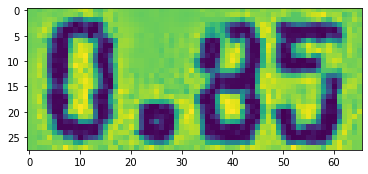

reading line : 646
126,1735,577,1735,577,1765,126,1765,GOODS SOLD ARE NOT REFONDABLE,



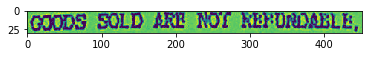

reading line : 647
159,1765,544,1765,544,1796,159,1796,THANK YOU FOR CHOOSING US.



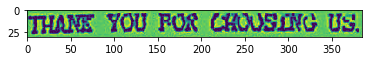

reading line : 648
144,1796,615,1796,615,1824,144,1824,PROVIDE ORIGINAL BILL FOR GOODS



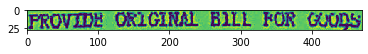

reading line : 649
52,1828,646,1828,646,1858,52,1858,EXCHANGE WITHIN 1 WEEK FROM TRANSACTION



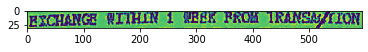

reading line : 650
71,1854,636,1854,636,1881,71,1881,GOODS MUST BE IN ORIGINAL STATE TO BE



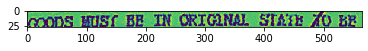

reading line : 651
185,1884,513,1884,513,1913,185,1913,ENTITLED FOR EXCHANGE.



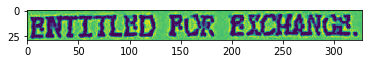

...... processing for X51005268262.jpg
reading corresponding text
reading line : 652
146,47,565,47,565,84,146,84,HOME MASTER HARDWARE &



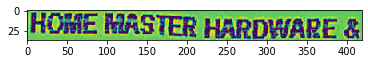

reading line : 653
266,89,444,89,444,125,266,125,ELECTRICAL



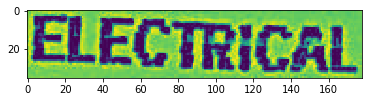

reading line : 654
85,120,625,120,625,156,85,156,NO.113G & 115G, JALAN SETIA GEMBILANG



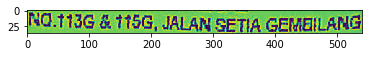

reading line : 655
166,161,542,161,542,193,166,193,U13/BG BANDAR SETIA ALAM,



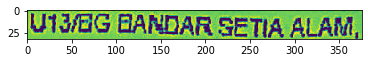

reading line : 656
174,201,529,201,529,235,174,235,40170 BANDAR SETIA ALAM,



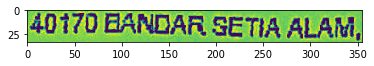

reading line : 657
275,240,428,240,428,269,275,269,SELANGOR.



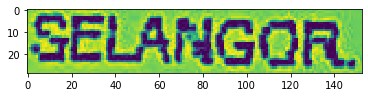

reading line : 658
150,281,553,281,553,315,150,315,COMPANY REG NO. :SA03711551-P



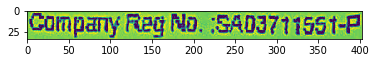

reading line : 659
178,326,522,326,522,359,178,359,GST REG NO. :001637511168



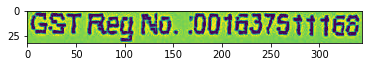

reading line : 660
263,383,433,383,433,409,263,409,TAX INVOICE



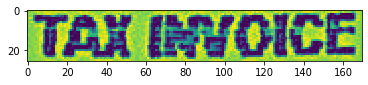

reading line : 661
62,427,203,427,203,460,62,460,INVOLCE NO.:



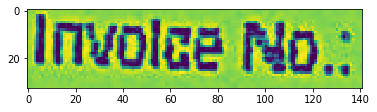

reading line : 662
62,469,135,469,135,497,62,497,DATE :



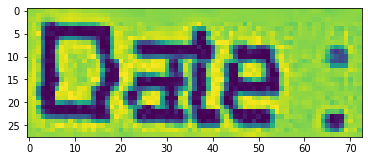

reading line : 663
247,475,451,475,451,500,247,500,22/12/2017 14:03



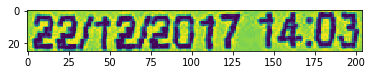

reading line : 664
61,514,188,514,188,542,61,542,CASHLER # :



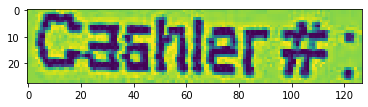

reading line : 665
247,518,368,518,368,546,247,546,CASHIER



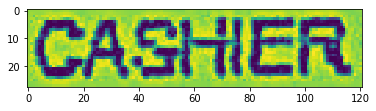

reading line : 666
466,565,515,565,515,594,466,594,RM



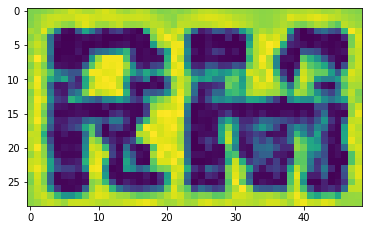

reading line : 667
561,563,635,563,635,593,561,593,CODE



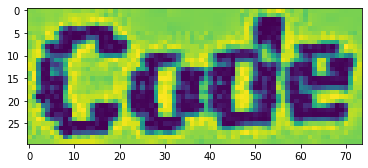

reading line : 668
58,607,340,607,340,638,58,638,24MMX7Y M.ONE TAPE



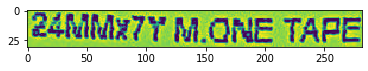

reading line : 669
90,646,140,646,140,673,90,673,1.00



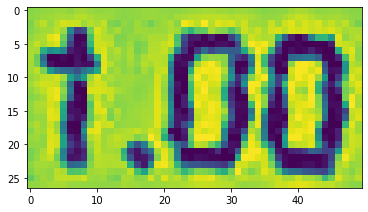

reading line : 670
253,653,270,653,270,675,253,675,X



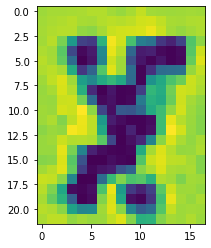

reading line : 671
304,650,369,650,369,676,304,676,15.90



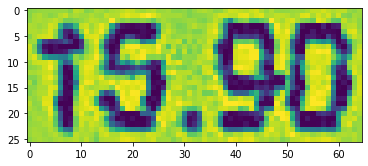

reading line : 672
449,650,513,650,513,677,449,677,15.90



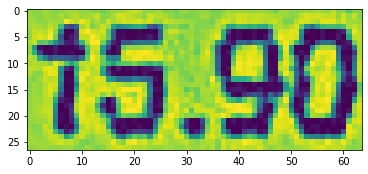

reading line : 673
594,647,636,647,636,674,594,674,SR



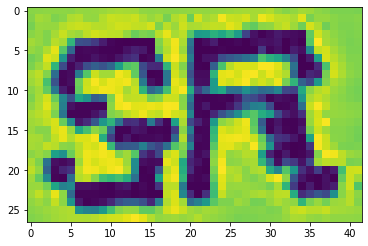

reading line : 674
181,697,295,697,295,721,181,721,SUBTOTAL :



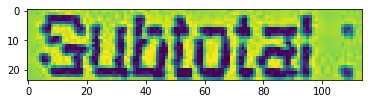

reading line : 675
447,696,513,696,513,723,447,723,15.90



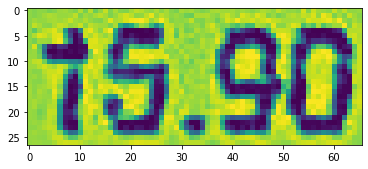

reading line : 676
85,743,294,743,294,772,85,772,TOTAL EXCL. OF GST



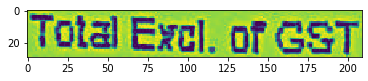

reading line : 677
447,749,512,749,512,771,447,771,15.00



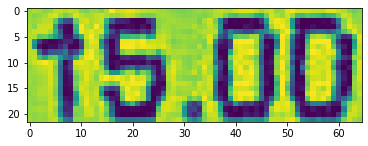

reading line : 678
92,785,293,785,293,815,92,815,TOTAL INCL. OF GST



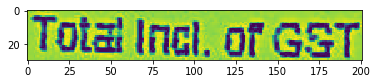

reading line : 679
446,791,512,791,512,816,446,816,15.90



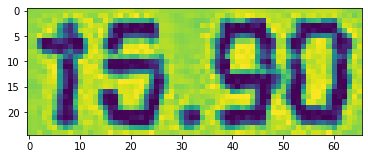

reading line : 680
70,833,293,833,293,860,70,860,TOTAL AMT ROUNDED



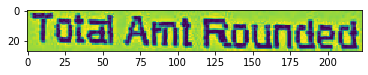

reading line : 681
445,837,510,837,510,861,445,861,15.90



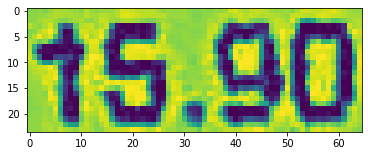

reading line : 682
172,874,292,874,292,906,172,906,PAYMENT :



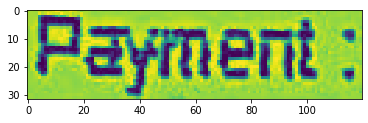

reading line : 683
441,876,511,876,511,901,441,901,50.00



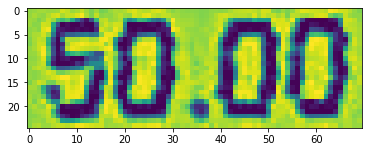

reading line : 684
131,912,293,912,293,946,131,946,CHANGE DUE :



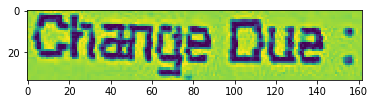

reading line : 685
441,913,512,913,512,941,441,941,34.10



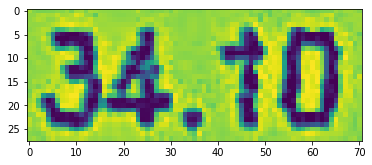

reading line : 686
59,959,238,959,238,994,59,994,TOTAL ITEM(S) : 1



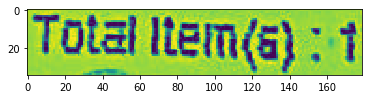

reading line : 687
62,1009,84,1009,84,1034,62,1034,G



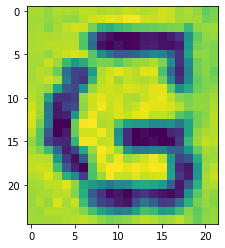

reading line : 688
267,1011,420,1011,420,1043,267,1043,AMOUNT(RM)



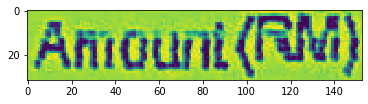

reading line : 689
479,1010,590,1010,590,1041,479,1041,TAX(RM)



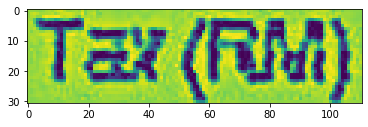

reading line : 690
64,1058,103,1058,103,1081,64,1081,SR



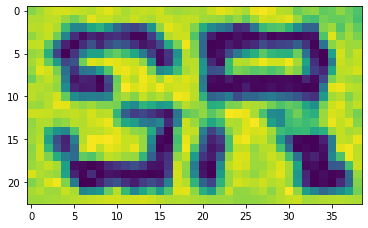

reading line : 691
156,1059,228,1059,228,1089,156,1089,@ 6%



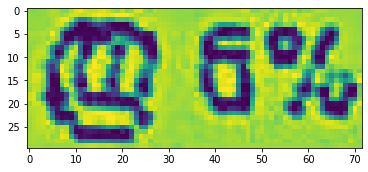

reading line : 692
354,1062,420,1062,420,1086,354,1086,15.00



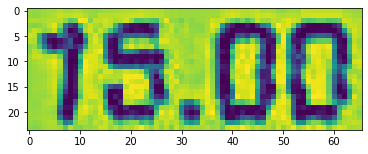

reading line : 693
533,1062,588,1062,588,1086,533,1086,0.90



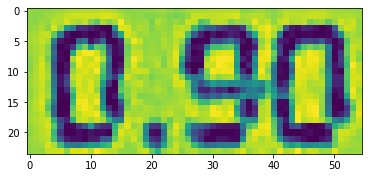

reading line : 694
254,1221,408,1221,408,1248,254,1248,THANK YOU



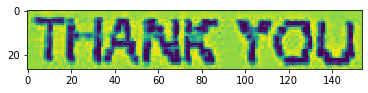

reading line : 695
68,1254,596,1254,596,1286,68,1286,ANY GOODS RETURN PLEASE DO WITHIN



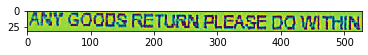

reading line : 696
91,1295,573,1295,573,1326,91,1326,7 DAYS WITH ORIGINAL RECEIPT TQ^^



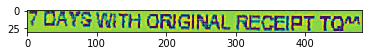

reading line : 697
250,433,366,433,366,458,250,458,CS 67832



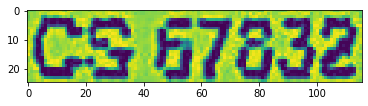

reading line : 698
139,1014,232,1014,232,1043,139,1043,UMMARY



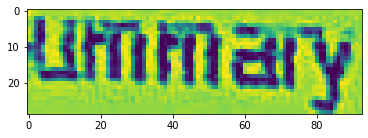

...... processing for X51005268400.jpg
reading corresponding text
reading line : 699
72,27,680,27,680,81,72,81,RESTORAN HASSANBISTRO



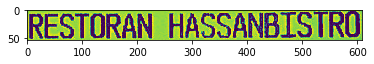

reading line : 700
165,82,572,82,572,111,165,111,NO.2-1-1 JALAN SETIA PRIMA Q



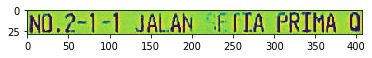

reading line : 701
203,119,539,119,539,147,203,147,U 13/Q SETIA ALAM 40170



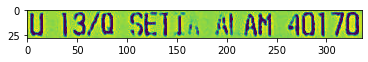

reading line : 702
309,154,442,154,442,182,309,182,SHAM ALAM



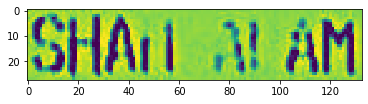

reading line : 703
308,189,427,189,427,216,308,216,SELANGOR



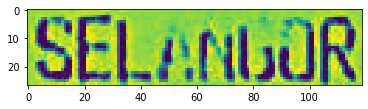

reading line : 704
292,260,466,260,466,288,292,288,TAX INVOICE



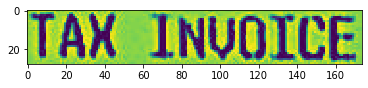

reading line : 705
75,330,273,330,273,358,75,358,TERMINAL : C1



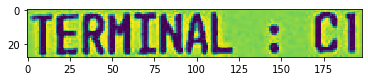

reading line : 706
253,1289,518,1289,518,1331,253,1331,2017-12-28 22:17PM



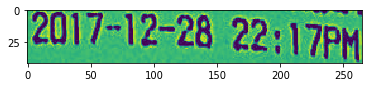

reading line : 707
225,1252,542,1252,542,1297,225,1297,THANK YOU.COME AGAIN



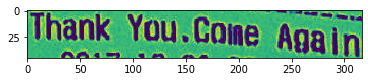

reading line : 708
75,367,184,367,184,394,75,394,CASHIER



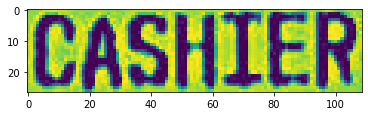

reading line : 709
216,365,339,365,339,394,216,394,: HASSAN



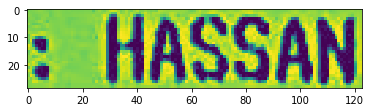

reading line : 710
628,1208,694,1208,694,1247,628,1247,0.00



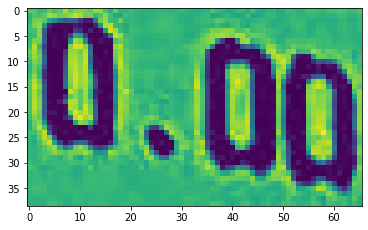

reading line : 711
74,401,184,401,184,429,74,429,BILL NO



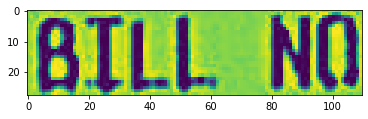

reading line : 712
215,399,401,399,401,430,215,430,: C1-0170778



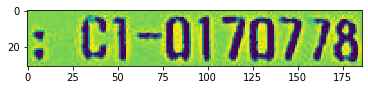

reading line : 713
501,1194,537,1194,537,1226,501,1226,RM



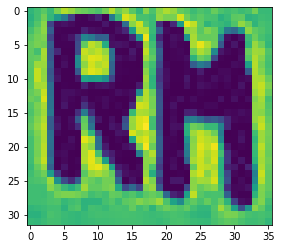

reading line : 714
75,437,140,437,140,464,75,464,DATE



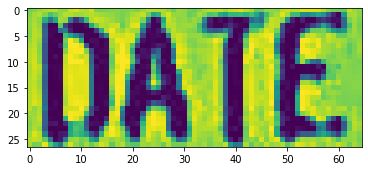

reading line : 715
216,437,592,437,592,471,216,471,: 12/28/2017 10:17:32 PM



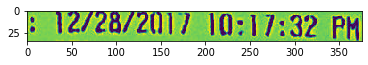

reading line : 716
204,1179,301,1179,301,1210,204,1210,CHANGE



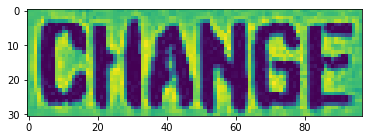

reading line : 717
76,471,155,471,155,500,76,500,TOKEN



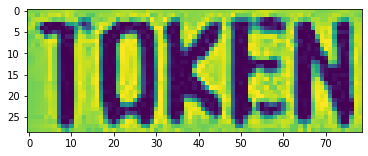

reading line : 718
215,471,289,471,289,499,215,499,: CT1



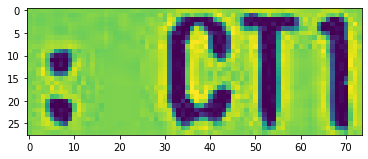

reading line : 719
614,1168,694,1168,694,1208,614,1208,15.00



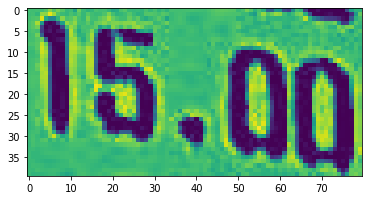

reading line : 720
76,505,154,505,154,535,76,535,TABLE



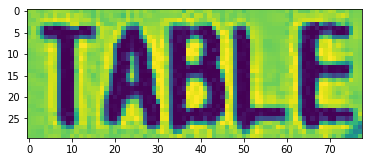

reading line : 721
216,506,289,506,289,535,216,535,: CT1



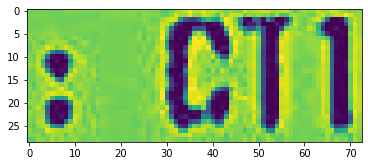

reading line : 722
500,1156,535,1156,535,1188,500,1188,RM



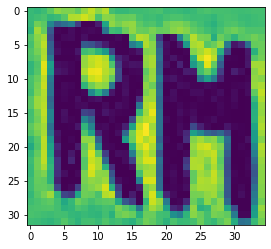

reading line : 723
76,576,107,576,107,604,76,604,PR



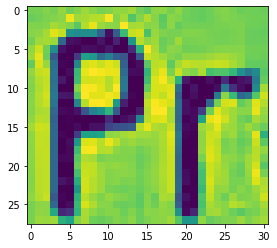

reading line : 724
245,575,293,575,293,606,245,606,QTY



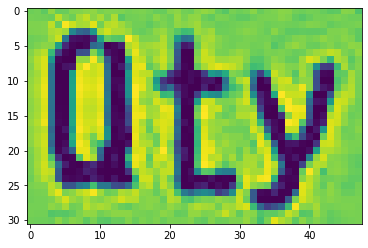

reading line : 725
317,577,421,577,421,608,317,608,U.PRICE



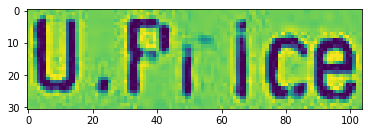

reading line : 726
461,581,507,581,507,610,461,610,GST



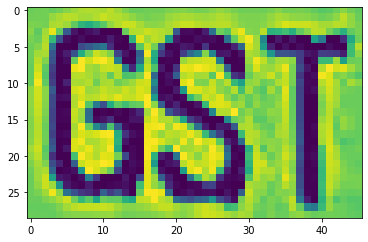

reading line : 727
578,586,652,586,652,621,578,621,TOTAL



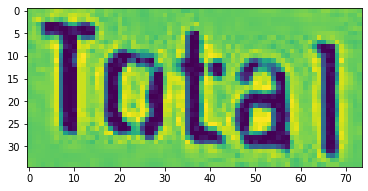

reading line : 728
76,648,178,648,178,675,76,675,MAKANAN



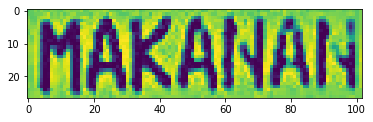

reading line : 729
263,683,276,683,276,710,263,710,1



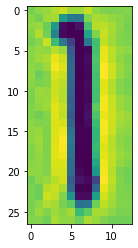

reading line : 730
335,683,408,683,408,712,335,712,15.00



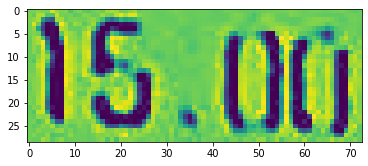

reading line : 731
491,690,510,690,510,717,491,717,0



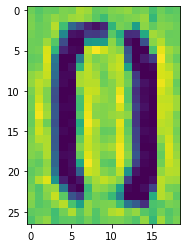

reading line : 732
566,693,684,693,684,734,566,734,15.00 ZR



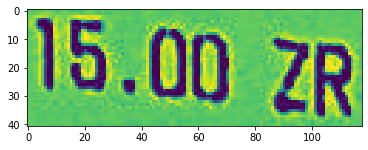

reading line : 733
78,751,235,751,235,781,78,781,TOTAL ITEMS



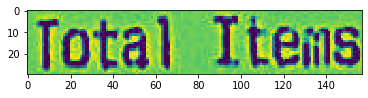

reading line : 734
262,757,280,757,280,773,262,773,=



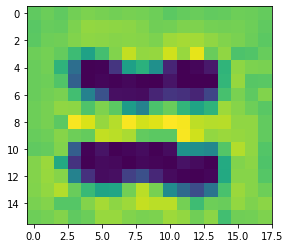

reading line : 735
321,753,380,753,380,782,321,782,1.00



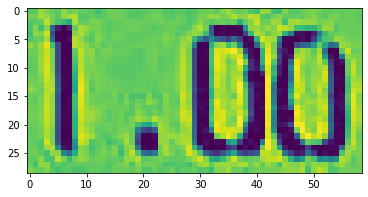

reading line : 736
80,787,210,787,210,818,80,818,TOTAL QTY



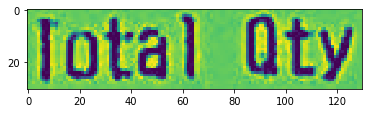

reading line : 737
262,794,282,794,282,807,262,807,=



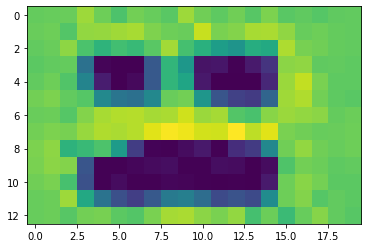

reading line : 738
320,788,379,788,379,818,320,818,1.00



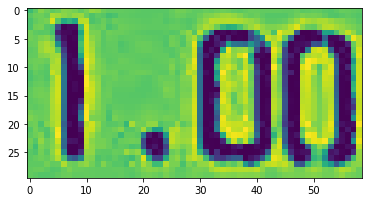

reading line : 739
210,858,339,858,339,886,210,886,SUB TOTAL



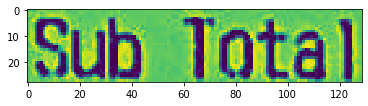

reading line : 740
513,870,546,870,546,898,513,898,RM



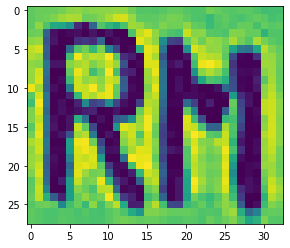

reading line : 741
618,878,689,878,689,914,618,914,15.00



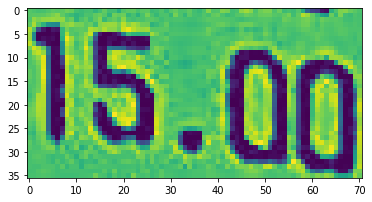

reading line : 742
210,895,329,895,329,923,210,923,DISCOUNT



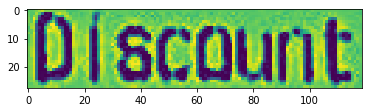

reading line : 743
512,905,546,905,546,934,512,934,RM



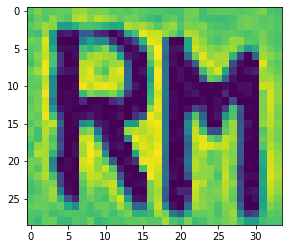

reading line : 744
628,916,690,916,690,952,628,952,0.00



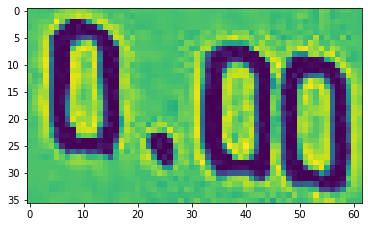

reading line : 745
202,966,469,966,469,1001,202,1001,TOTAL EXCL .6% GST



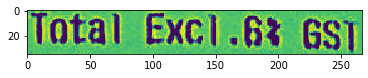

reading line : 746
498,976,533,976,533,1008,498,1008,RM



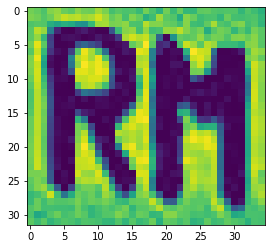

reading line : 747
612,986,691,986,691,1026,612,1026,15.00



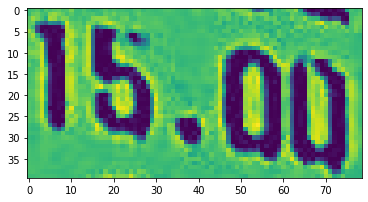

reading line : 748
202,1001,298,1001,298,1030,202,1030,GST 6%



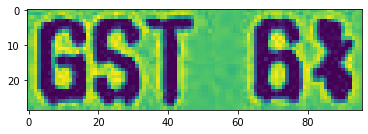

reading line : 749
499,1012,534,1012,534,1044,499,1044,RM



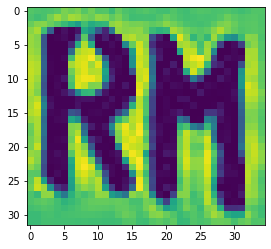

reading line : 750
625,1024,690,1024,690,1061,625,1061,0.00



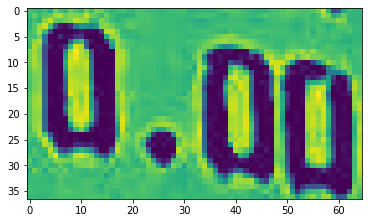

reading line : 751
203,1037,470,1037,470,1074,203,1074,TOTAL INCL .6% GST



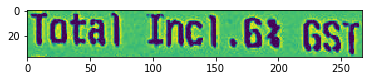

reading line : 752
499,1049,534,1049,534,1080,499,1080,RM



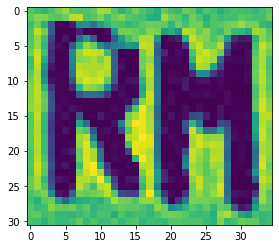

reading line : 753
612,1059,692,1059,692,1099,612,1099,15.00



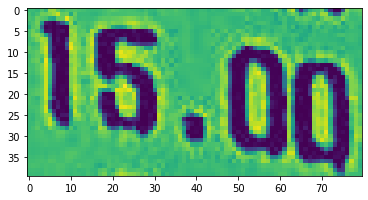

reading line : 754
203,1073,331,1073,331,1105,203,1105,ROUNDING



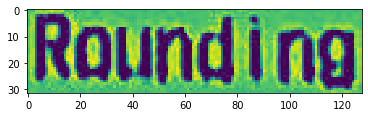

reading line : 755
499,1084,534,1084,534,1116,499,1116,RM



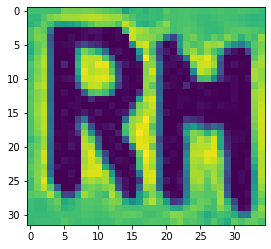

reading line : 756
626,1098,693,1098,693,1136,626,1136,0.00



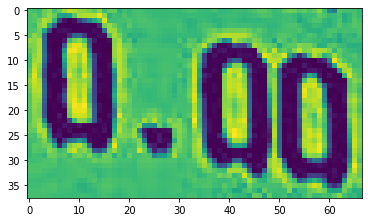

reading line : 757
205,1144,270,1144,270,1174,205,1174,CASH



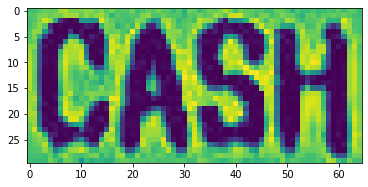

reading line : 758
163,579,177,579,177,604,163,604,T



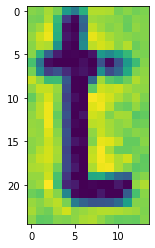

...... processing for X51005268472.jpg
reading corresponding text
reading line : 759
319,78,526,78,526,118,319,118,ASIA MART



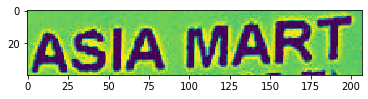

reading line : 760
320,113,516,113,516,150,320,150,(SA0264195-T)



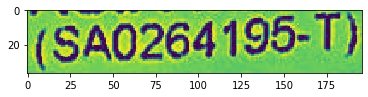

reading line : 761
190,137,643,137,643,187,190,187,NO.23 BATU 10, TAMAN SENTOSA,



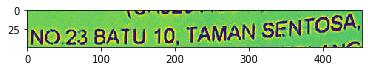

reading line : 762
141,169,688,169,688,225,141,225,JALAN KAPAR, 42200 KLANG, SELANGOR.



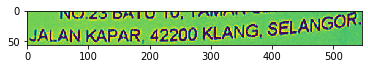

reading line : 763
264,247,566,247,566,286,264,286,GST ID : 001609584640



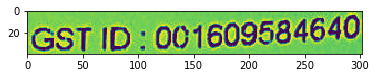

reading line : 764
317,299,511,299,511,329,317,329,TAX INVOICE



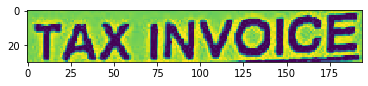

reading line : 765
78,344,172,344,172,371,78,371,DOC NO



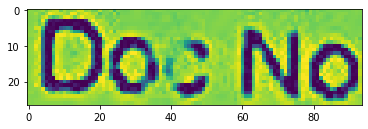

reading line : 766
246,346,437,346,437,374,246,374,: CS02070163



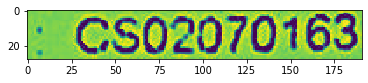

reading line : 767
525,315,737,315,737,367,525,367,DATE: 22/12/2017



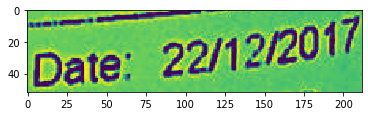

reading line : 768
75,384,174,384,174,409,75,409,CASHIER



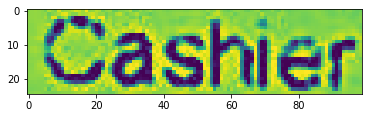

reading line : 769
246,385,340,385,340,412,246,412,: EIRA



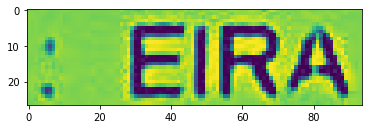

reading line : 770
522,362,711,362,711,405,522,405,TIME: 00:06:00



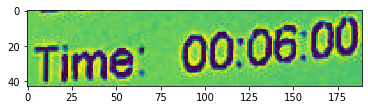

reading line : 771
75,423,340,423,340,454,75,454,SALESPERSON : EIRA



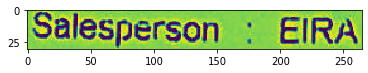

reading line : 772
166,728,298,728,298,755,166,755,S LIME 50G



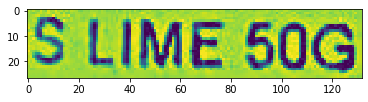

reading line : 773
530,416,594,416,594,446,530,446,REF.:



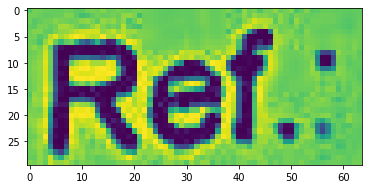

reading line : 774
72,504,124,504,124,526,72,526,ITEM



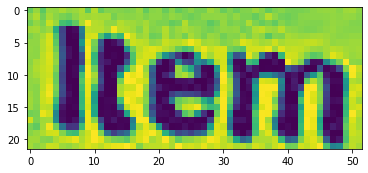

reading line : 775
266,506,312,506,312,533,266,533,QTY



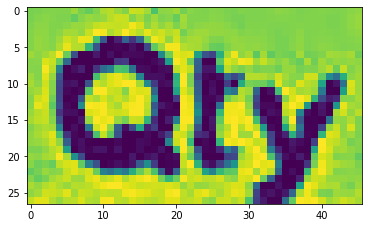

reading line : 776
346,509,431,509,431,530,346,530,S/PRICE



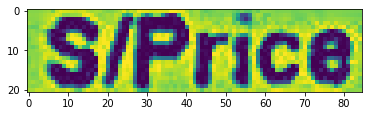

reading line : 777
463,477,533,477,533,505,463,505,(GST)



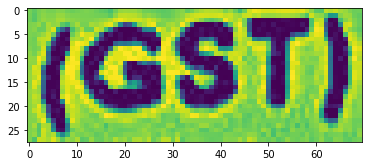

reading line : 778
602,466,669,466,669,498,602,498,(GST)



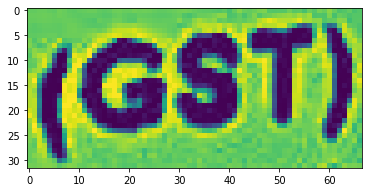

reading line : 779
455,504,539,504,539,527,455,527,S/PRICE



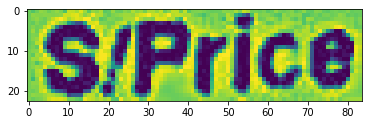

reading line : 780
579,496,670,496,670,522,579,522,AMOUNT



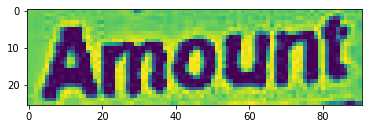

reading line : 781
691,489,732,489,732,514,691,514,TAX



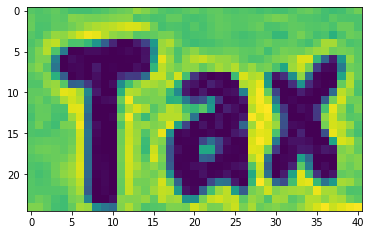

reading line : 782
72,534,241,534,241,562,72,562,9556641320027



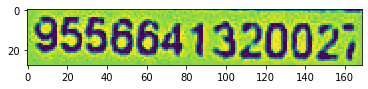

reading line : 783
274,539,303,539,303,562,274,562,17



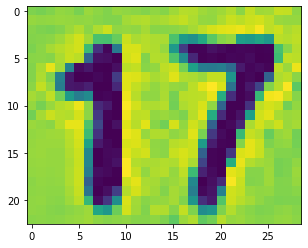

reading line : 784
364,539,414,539,414,563,364,563,0.85



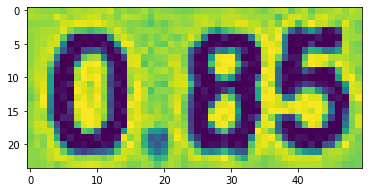

reading line : 785
472,536,522,536,522,560,472,560,0.90



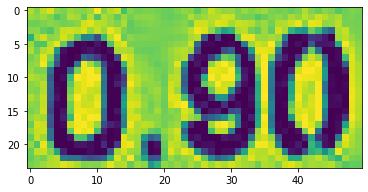

reading line : 786
609,527,668,527,668,555,609,555,15.25



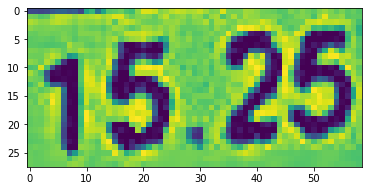

reading line : 787
699,523,730,523,730,547,699,547,SR



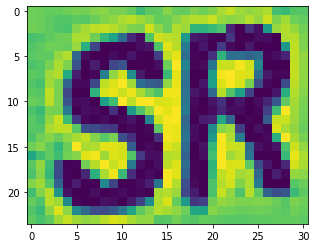

reading line : 788
73,571,385,571,385,605,73,605,DELICIA CHOCOLATE [50G]



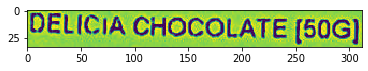

reading line : 789
70,611,240,611,240,640,70,640,9556231110045



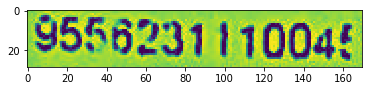

reading line : 790
278,620,293,620,293,637,278,637,1



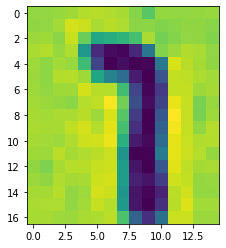

reading line : 791
361,617,413,617,413,640,361,640,3.55



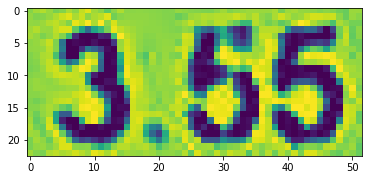

reading line : 792
470,614,520,614,520,638,470,638,3.55



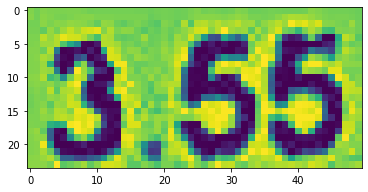

reading line : 793
618,609,666,609,666,634,618,634,3.55



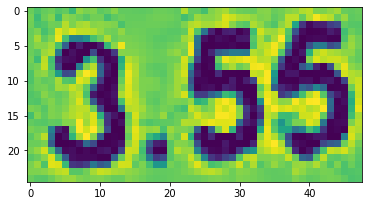

reading line : 794
684,605,727,605,727,630,684,630,ZRL



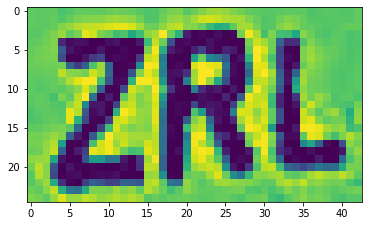

reading line : 795
69,649,589,649,589,679,69,679,GARDENIA ORIGINAL CLASSIC JUMBO [600G]



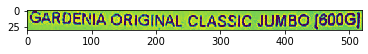

reading line : 796
69,690,240,690,240,716,69,716,9556127101331



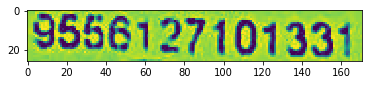

reading line : 797
277,696,292,696,292,717,277,717,1



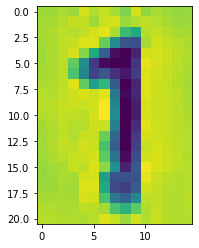

reading line : 798
362,697,408,697,408,720,362,720,1.41



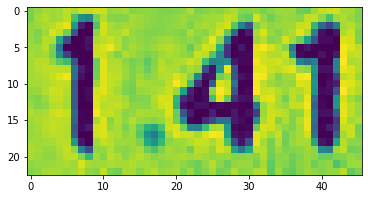

reading line : 799
469,694,518,694,518,719,469,719,1.50



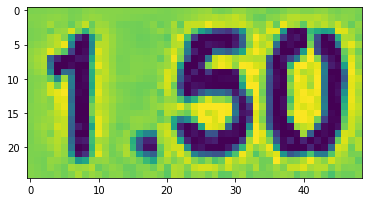

reading line : 800
618,691,665,691,665,714,618,714,1.50



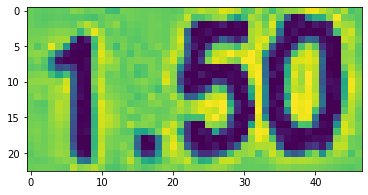

reading line : 801
694,687,727,687,727,711,694,711,SR



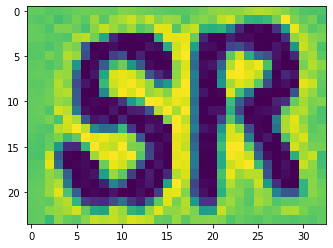

reading line : 802
67,726,102,726,102,748,67,748,HU



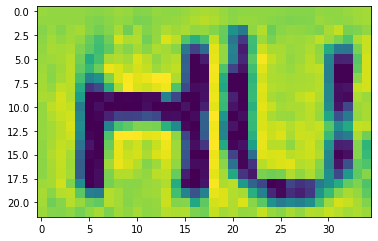

reading line : 803
67,766,236,766,236,794,67,794,8850199320722



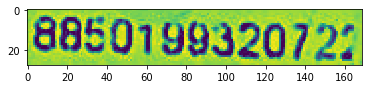

reading line : 804
274,774,289,774,289,795,274,795,1



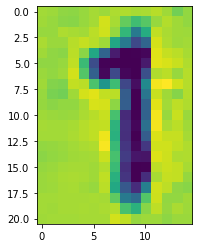

reading line : 805
359,775,410,775,410,796,359,796,1.42



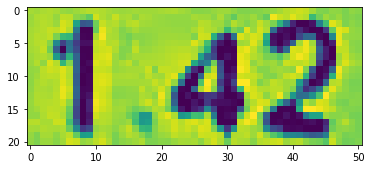

reading line : 806
467,774,514,774,514,797,467,797,1.51



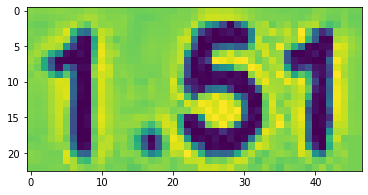

reading line : 807
616,770,660,770,660,795,616,795,1.51



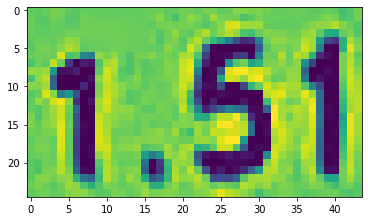

reading line : 808
693,768,725,768,725,793,693,793,SR



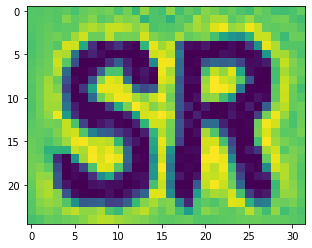

reading line : 809
66,803,397,803,397,833,66,833,DOREMON CATCAT JOY 15G



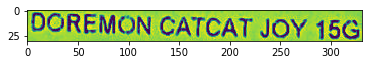

reading line : 810
63,845,235,845,235,871,63,871,8850199320722



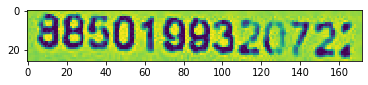

reading line : 811
272,850,287,850,287,871,272,871,1



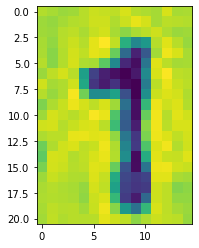

reading line : 812
358,850,406,850,406,875,358,875,1.42



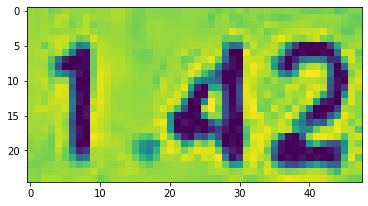

reading line : 813
464,852,511,852,511,876,464,876,1.51



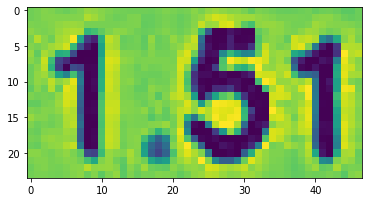

reading line : 814
612,852,659,852,659,876,612,876,1.51



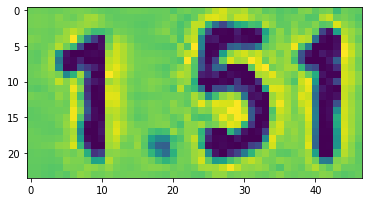

reading line : 815
691,850,720,850,720,875,691,875,SR



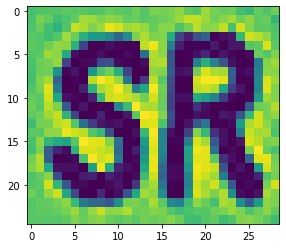

reading line : 816
65,881,395,881,395,911,65,911,DOREMON CATCAT JOY 15G



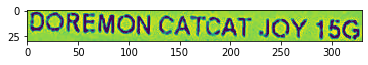

reading line : 817
63,921,234,921,234,948,63,948,8888002188511



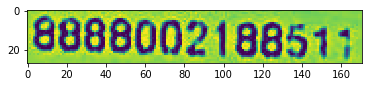

reading line : 818
269,929,285,929,285,949,269,949,1



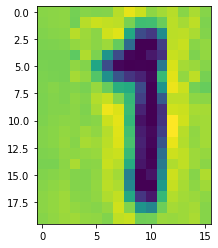

reading line : 819
353,931,404,931,404,952,353,952,2.30



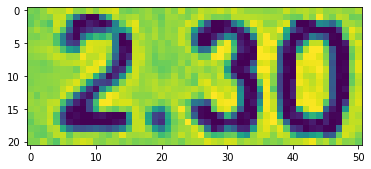

reading line : 820
460,931,511,931,511,956,460,956,2.44



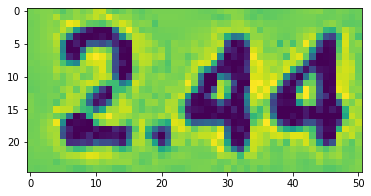

reading line : 821
611,931,659,931,659,956,611,956,2.44



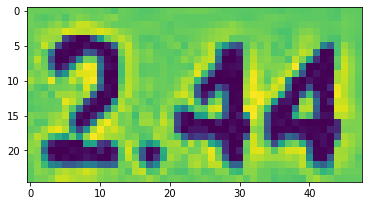

reading line : 822
688,932,720,932,720,957,688,957,SR



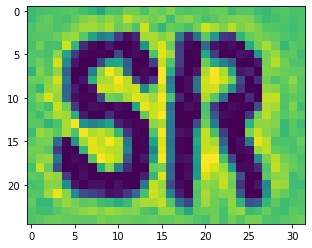

reading line : 823
62,958,485,958,485,995,62,995,MINUTE MAID PULPY [OREN] [350ML]



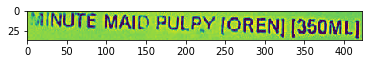

reading line : 824
62,999,230,999,230,1029,62,1029,8888002188511



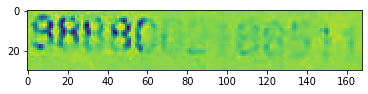

reading line : 825
270,1007,283,1007,283,1027,270,1027,1



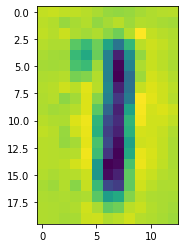

reading line : 826
353,1006,403,1006,403,1030,353,1030,2.30



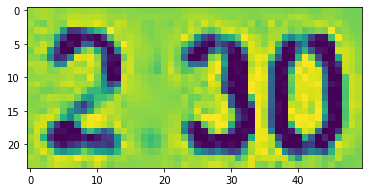

reading line : 827
461,1010,509,1010,509,1032,461,1032,2.44



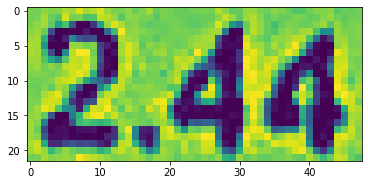

reading line : 828
608,1012,657,1012,657,1036,608,1036,2.44



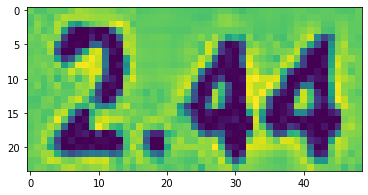

reading line : 829
687,1013,716,1013,716,1037,687,1037,SR



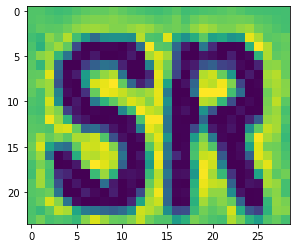

reading line : 830
62,1036,482,1036,482,1074,62,1074,MINUTE MAID PULPY [OREN] [350ML]



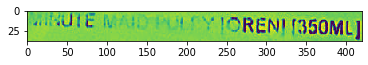

reading line : 831
59,1076,191,1076,191,1103,59,1103,9556145026



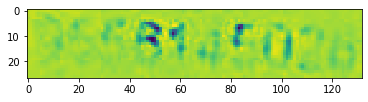

reading line : 832
269,1081,280,1081,280,1104,269,1104,1



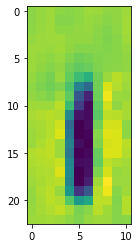

reading line : 833
353,1087,400,1087,400,1109,353,1109,1.51



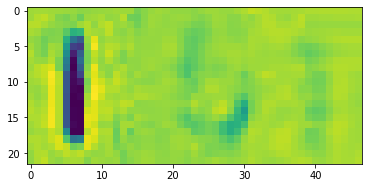

reading line : 834
460,1088,508,1088,508,1112,460,1112,1.60



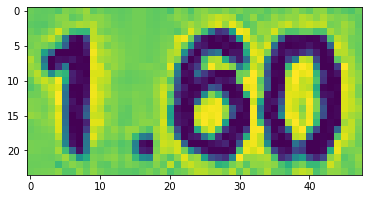

reading line : 835
609,1094,656,1094,656,1117,609,1117,1.60



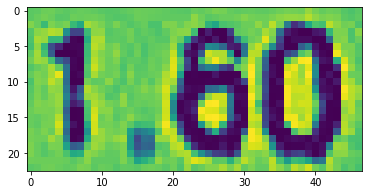

reading line : 836
684,1096,714,1096,714,1120,684,1120,SR



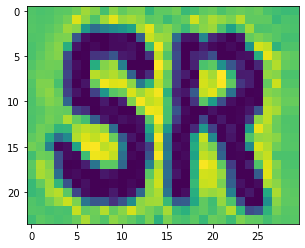

reading line : 837
59,1113,379,1113,379,1144,59,1144,TINGE LEMON DRINK 500ML



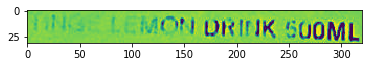

reading line : 838
56,1153,215,1153,215,1179,56,1179,955657031213



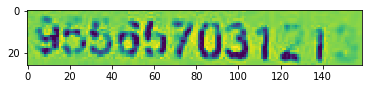

reading line : 839
349,1161,399,1161,399,1185,349,1185,2.74



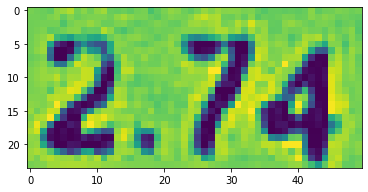

reading line : 840
456,1166,506,1166,506,1190,456,1190,2.90



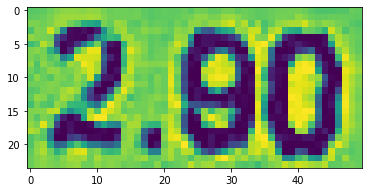

reading line : 841
606,1172,654,1172,654,1196,606,1196,2.90



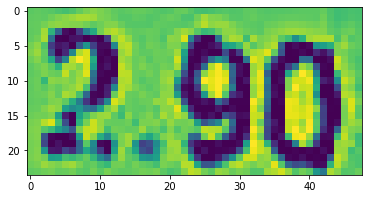

reading line : 842
682,1177,710,1177,710,1201,682,1201,SR



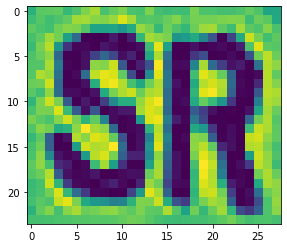

reading line : 843
58,1191,232,1191,232,1220,58,1220,100 PLUS [1.50]



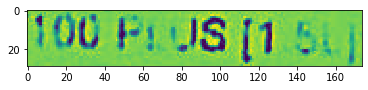

reading line : 844
88,1227,204,1227,204,1258,88,1258,TOTAL QTY:



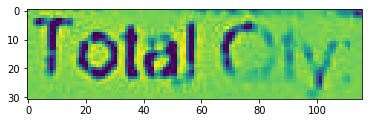

reading line : 845
251,1232,287,1232,287,1257,251,1257,25



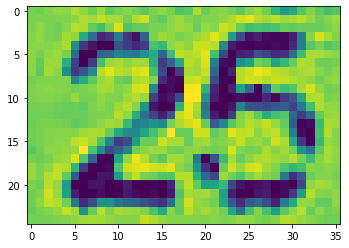

reading line : 846
584,1246,655,1246,655,1275,584,1275,32.69



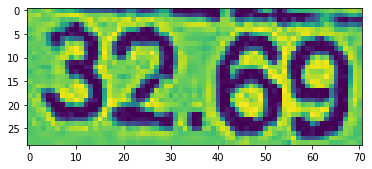

reading line : 847
150,1273,516,1273,516,1315,150,1315,TOTAL SALES (EXCLUDING GST) :



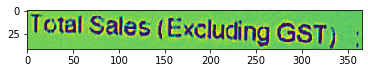

reading line : 848
583,1293,651,1293,651,1321,583,1321,31.03



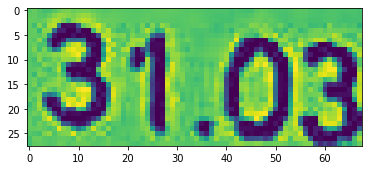

reading line : 849
379,1328,516,1328,516,1359,379,1359,DISCOUNT :



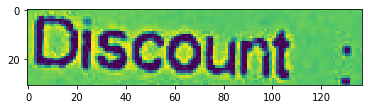

reading line : 850
596,1341,652,1341,652,1370,596,1370,0.00



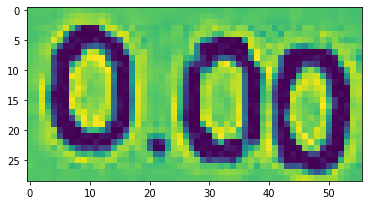

reading line : 851
362,1372,514,1372,514,1408,362,1408,TOTAL GST :



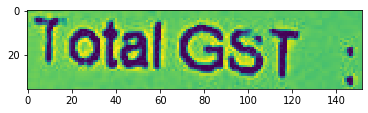

reading line : 852
598,1390,651,1390,651,1417,598,1417,1.65



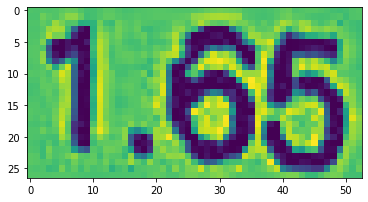

reading line : 853
369,1416,511,1416,511,1453,369,1453,ROUNDING :



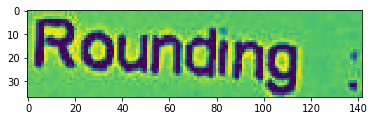

reading line : 854
594,1433,650,1433,650,1462,594,1462,0.02



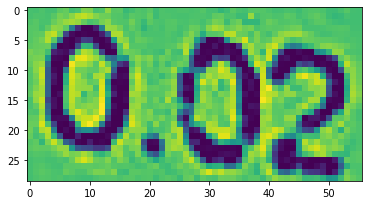

reading line : 855
93,1454,512,1454,512,1501,93,1501,TOTAL SALES (INCLUSIVE OF GST) :



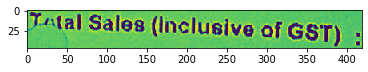

reading line : 856
579,1479,648,1479,648,1511,579,1511,32.70



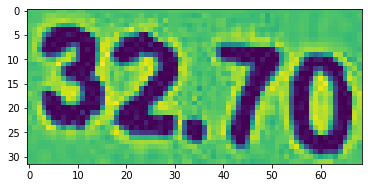

reading line : 857
402,1512,512,1512,512,1544,402,1544,CASH :



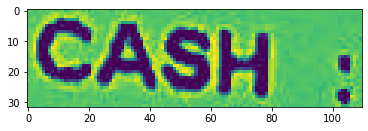

reading line : 858
576,1524,649,1524,649,1558,576,1558,40.00



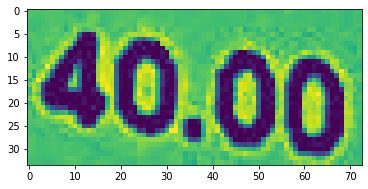

reading line : 859
375,1543,510,1543,510,1579,375,1579,CHANGE :



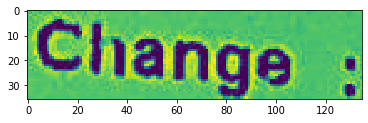

reading line : 860
590,1562,646,1562,646,1593,590,1593,7.30



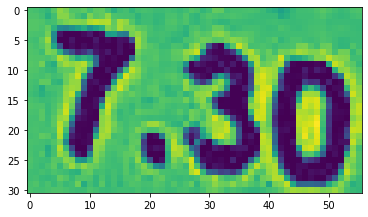

reading line : 861
91,1617,299,1617,299,1648,91,1648,GST SUMMARY



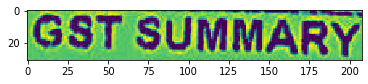

reading line : 862
96,1661,219,1661,219,1684,96,1684,TAX CODE



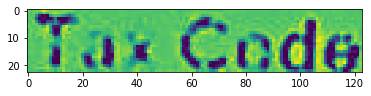

reading line : 863
293,1667,318,1667,318,1691,293,1691,%



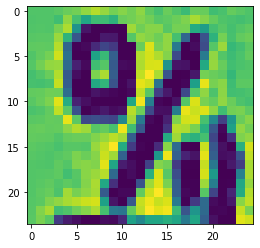

reading line : 864
387,1671,513,1671,513,1706,387,1706,AMT (RM)



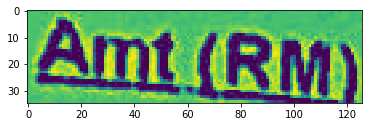

reading line : 865
570,1688,681,1688,681,1732,570,1732,TAX (RM)



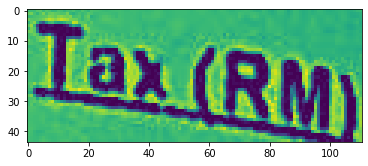

reading line : 866
96,1693,136,1693,136,1717,96,1717,SR



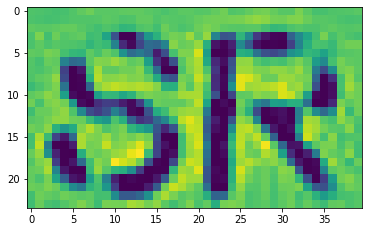

reading line : 867
94,1729,150,1729,150,1755,94,1755,ZRL



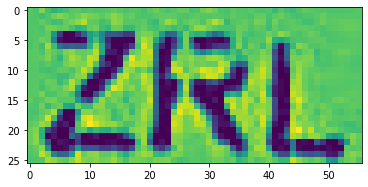

reading line : 868
295,1699,314,1699,314,1723,295,1723,6



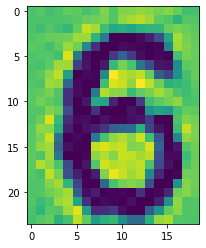

reading line : 869
295,1737,315,1737,315,1761,295,1761,0



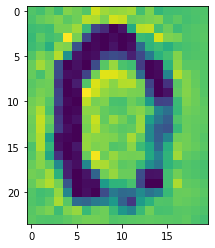

reading line : 870
440,1709,513,1709,513,1740,440,1740,27.48



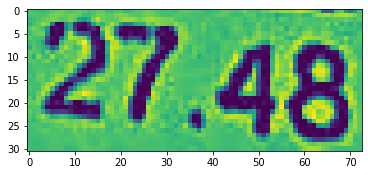

reading line : 871
453,1747,512,1747,512,1778,453,1778,3.55



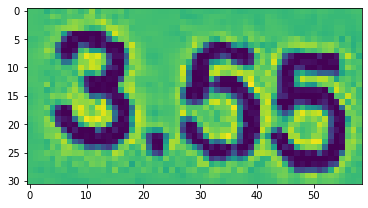

reading line : 872
631,1733,681,1733,681,1765,631,1765,1.65



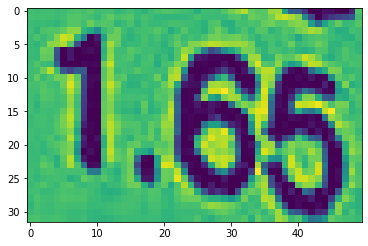

reading line : 873
629,1770,681,1770,681,1805,629,1805,0.00



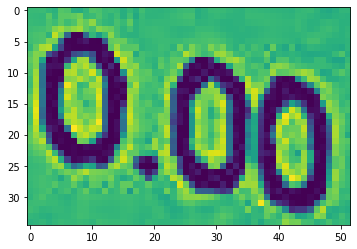

reading line : 874
629,1808,678,1808,678,1844,629,1844,1.65



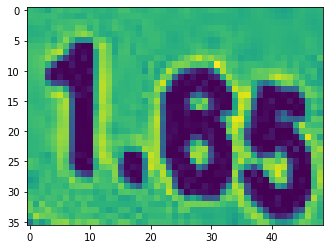

reading line : 875
246,1772,332,1772,332,1802,246,1802,TOTAL :



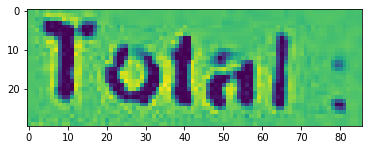

reading line : 876
435,1785,508,1785,508,1816,435,1816,31.03



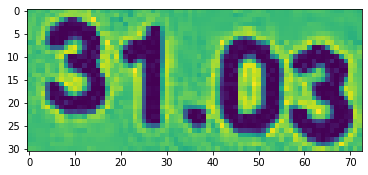

reading line : 877
79,1831,661,1831,661,1909,79,1909,GOODS SOLD ARE NOT RETURNABLE, THANK YOU.



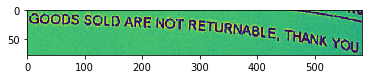

...... processing for X51005301659.jpg
reading corresponding text
reading line : 878
148,48,564,48,564,86,148,86,HOME MASTER HARDWARE &



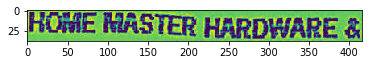

reading line : 879
266,89,444,89,444,125,266,125,ELECTRICAL



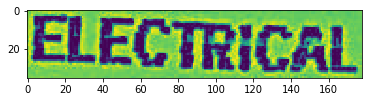

reading line : 880
85,121,625,121,625,156,85,156,NO.113G & 115G, JALAN SETIA GEMBILANG



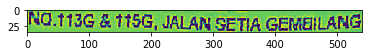

reading line : 881
166,161,540,161,540,194,166,194,U13/BG BANDAR SETIA ALAM,



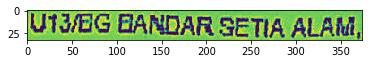

reading line : 882
175,204,530,204,530,235,175,235,40170 BANDAR SETIA ALAM,



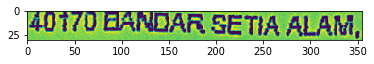

reading line : 883
275,240,428,240,428,267,275,267,SELANGOR.



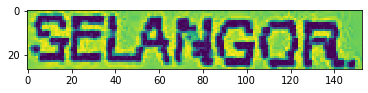

reading line : 884
151,282,553,282,553,315,151,315,COMPANY REG NO.:SA03711551-P



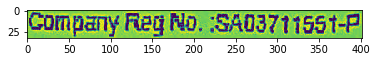

reading line : 885
179,326,521,326,521,360,179,360,GST REG NO.:001637511168



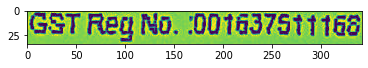

reading line : 886
263,382,433,382,433,409,263,409,TAX INVOICE



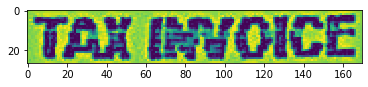

reading line : 887
62,427,201,427,201,456,62,456,INVOICE NO.:



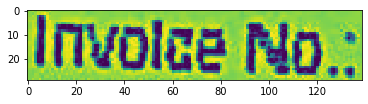

reading line : 888
250,433,367,433,367,458,250,458,CS 67832



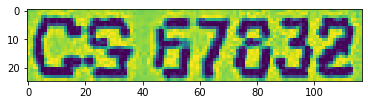

reading line : 889
62,470,135,470,135,498,62,498,DATE :



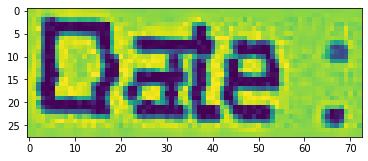

reading line : 890
248,475,453,475,453,500,248,500,22/12/2017 14:03



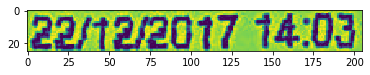

reading line : 891
61,513,187,513,187,542,61,542,CASHIER#:



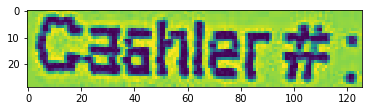

reading line : 892
248,520,367,520,367,545,248,545,CASHIER



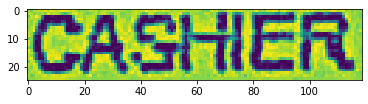

reading line : 893
465,565,517,565,517,594,465,594,RM



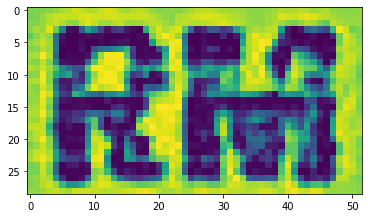

reading line : 894
562,563,636,563,636,593,562,593,CODE



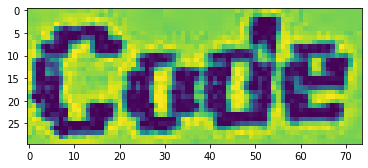

reading line : 895
58,606,341,606,341,636,58,636,24MMX7Y M.ONE TAPE



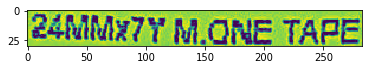

reading line : 896
91,648,139,648,139,672,91,672,1.00



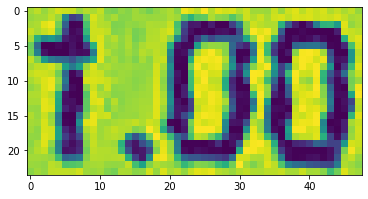

reading line : 897
253,653,271,653,271,675,253,675,X



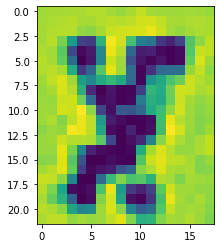

reading line : 898
304,651,370,651,370,675,304,675,15.90



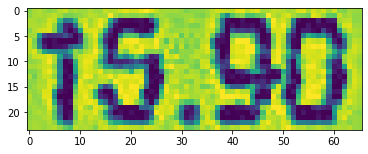

reading line : 899
448,651,514,651,514,676,448,676,15.90



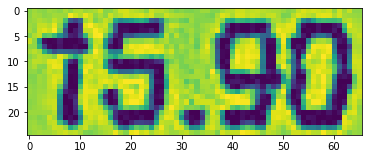

reading line : 900
594,648,635,648,635,674,594,674,SR



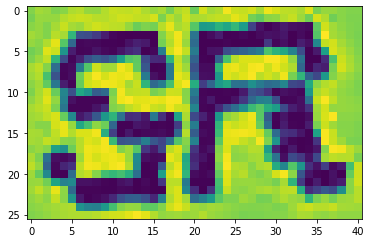

reading line : 901
181,696,295,696,295,722,181,722,SUBTOTAL :



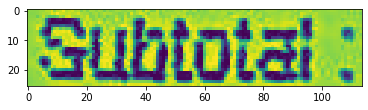

reading line : 902
448,698,512,698,512,722,448,722,15.90



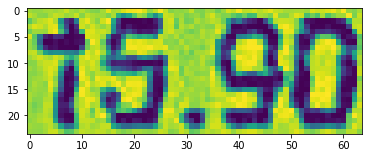

reading line : 903
85,743,294,743,294,772,85,772,TOTAL EXCL. OF GST



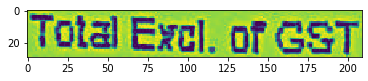

reading line : 904
446,749,513,749,513,773,446,773,15.00



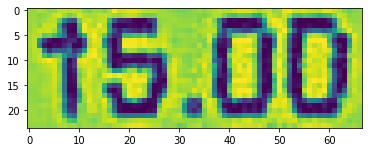

reading line : 905
92,785,293,785,293,816,92,816,TOTAL INCL. OF GST



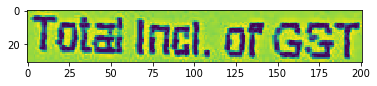

reading line : 906
446,791,513,791,513,817,446,817,15.90



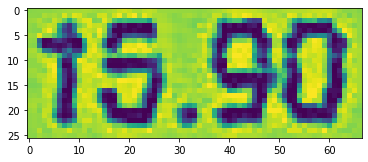

reading line : 907
70,832,293,832,293,861,70,861,TOTAL AMT ROUNDED



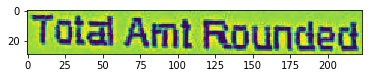

reading line : 908
444,838,509,838,509,860,444,860,15.90



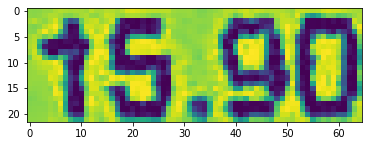

reading line : 909
173,874,293,874,293,906,173,906,PAYMENT :



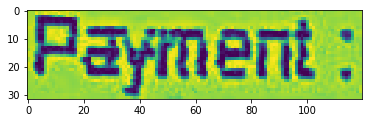

reading line : 910
443,876,511,876,511,901,443,901,50.00



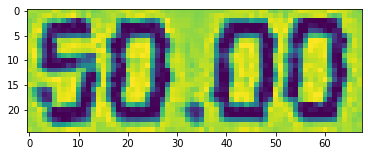

reading line : 911
132,911,291,911,291,945,132,945,CHANGE DUE :



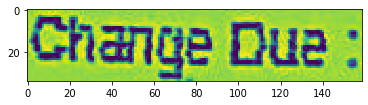

reading line : 912
442,915,510,915,510,940,442,940,34.10



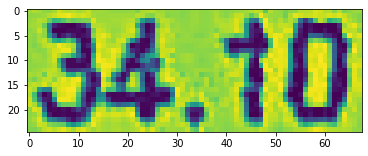

reading line : 913
60,959,237,959,237,995,60,995,TOTAL ITEM(S) : 1



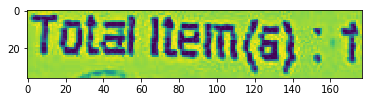

reading line : 914
61,1009,83,1009,83,1034,61,1034,G



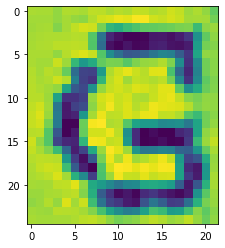

reading line : 915
140,1014,234,1014,234,1044,140,1044,UMMARY



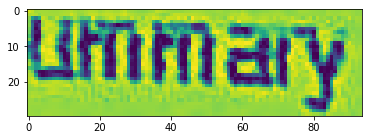

reading line : 916
268,1012,421,1012,421,1042,268,1042,AMOUNT(RM)



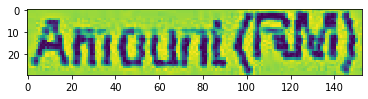

reading line : 917
479,1010,589,1010,589,1043,479,1043,TAX (RM)



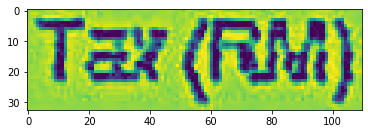

reading line : 918
64,1057,103,1057,103,1081,64,1081,SR



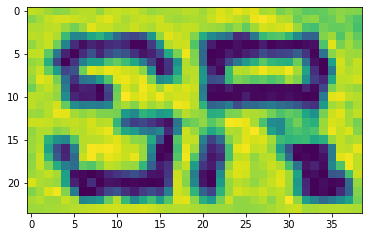

reading line : 919
155,1058,231,1058,231,1090,155,1090,@ 6%



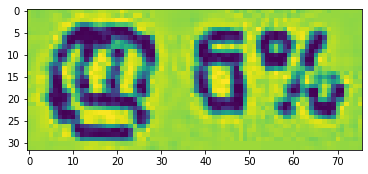

reading line : 920
355,1063,419,1063,419,1086,355,1086,15.00



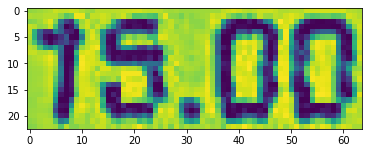

reading line : 921
534,1062,588,1062,588,1086,534,1086,0.90



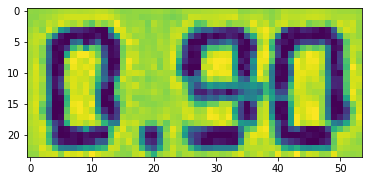

...... processing for X51005301661.jpg
reading corresponding text
reading line : 922
174,86,679,86,679,143,174,143,LIGHTROOM GALLERY SDN BHD



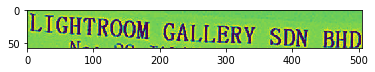

reading line : 923
236,130,609,130,609,180,236,180,NO: 28, JALAN ASTANA 1C,



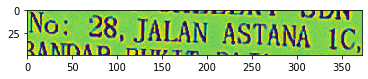

reading line : 924
225,161,625,161,625,208,225,208,BANDAR BUKIT RAJA, 41050



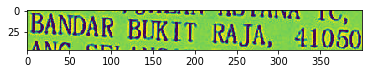

reading line : 925
192,192,658,192,658,242,192,242,KLANG SELANGOR D.E, MALAYSIA



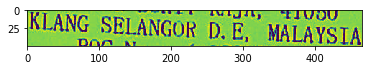

reading line : 926
259,229,588,229,588,271,259,271,ROC NO. : (1072825-A)



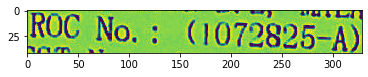

reading line : 927
250,261,598,261,598,303,250,303,GST NO. : 000584089600



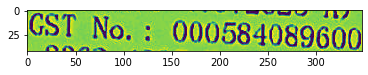

reading line : 928
152,288,699,288,699,338,152,338,TEL:03-3362 4395 FAX:03-3362 4395



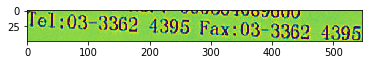

reading line : 929
311,362,535,362,535,403,311,403,TAX INVOICE



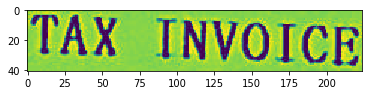

reading line : 930
79,403,351,403,351,443,79,443,STATION: CASHIER



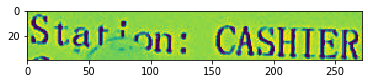

reading line : 931
463,419,744,419,744,456,463,456,BILL NO: LCS03908



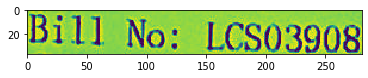

reading line : 932
77,436,131,436,131,466,77,466,CAS



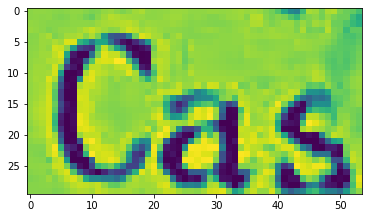

reading line : 933
461,453,547,453,547,483,461,483,COVER



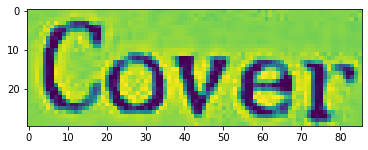

reading line : 934
78,471,448,471,448,513,78,513,BILL DATE : 20/12/2017



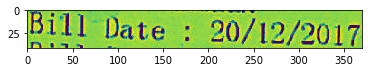

reading line : 935
77,504,646,504,646,552,77,552,BILL START: 20/12/2017 07:10:35 PM



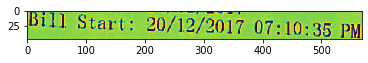

reading line : 936
75,569,148,569,148,599,75,599,CODE



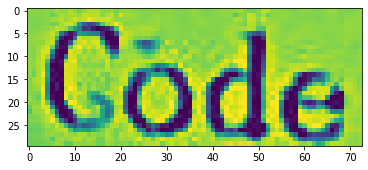

reading line : 937
247,577,430,577,430,609,247,609,: 300-C0001



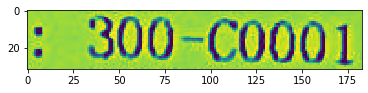

reading line : 938
75,601,146,601,146,632,75,632,NAME



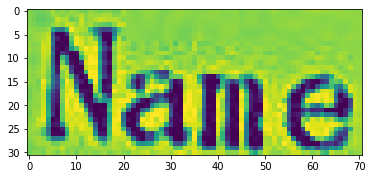

reading line : 939
246,610,348,610,348,640,246,640,: CASH



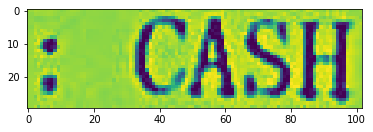

reading line : 940
75,635,196,635,196,668,75,668,ADDRESS



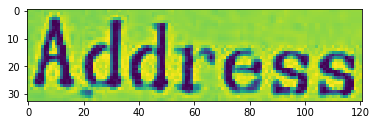

reading line : 941
72,734,185,734,185,768,72,768,GST NO.



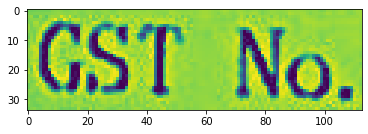

reading line : 942
70,833,192,833,192,866,70,866,CH50514



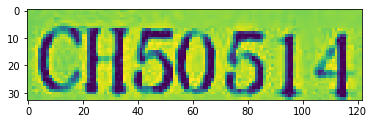

reading line : 943
697,849,736,849,736,879,697,879,SR



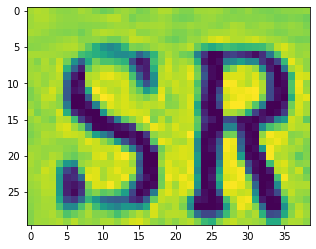

reading line : 944
70,869,374,869,374,901,70,901,T5 JOINT 2PIN 2PCS



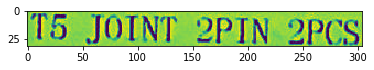

reading line : 945
71,900,89,900,89,930,71,930,1



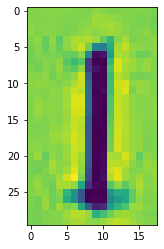

reading line : 946
138,902,209,902,209,931,138,931,* RM



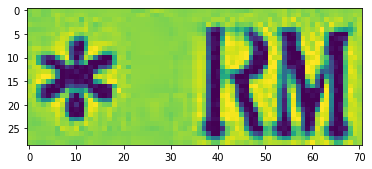

reading line : 947
468,906,606,906,606,940,468,940,0.17)=RM



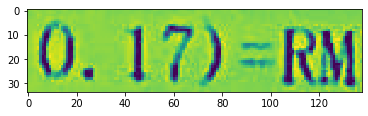

reading line : 948
253,904,426,904,426,937,253,937,2.83 UNI (



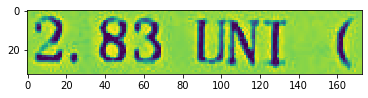

reading line : 949
664,912,735,912,735,942,664,942,2.83



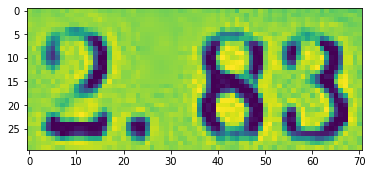

reading line : 950
69,933,190,933,190,965,69,965,YT51874



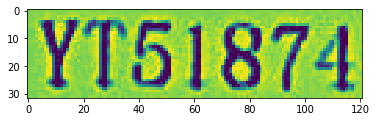

reading line : 951
697,946,734,946,734,975,697,975,SR



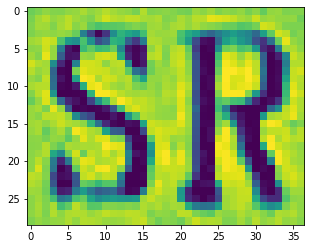

reading line : 952
70,967,555,967,555,1002,70,1002,YE30 BK 7W WW LED TRACK LIGHT



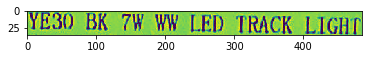

reading line : 953
67,1001,89,1001,89,1031,67,1031,2



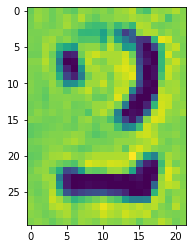

reading line : 954
132,1000,207,1000,207,1030,132,1030,* RM



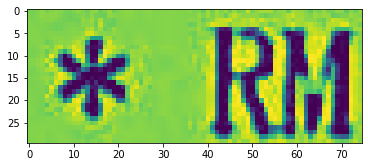

reading line : 955
647,1010,734,1010,734,1040,647,1040,66.04



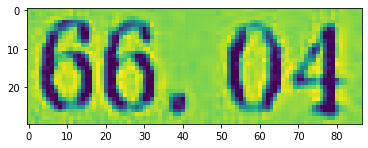

reading line : 956
65,1064,225,1064,225,1097,65,1097,SUB TOTAL



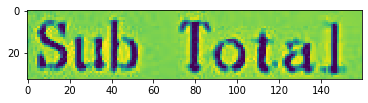

reading line : 957
564,1071,603,1071,603,1101,564,1101,RM



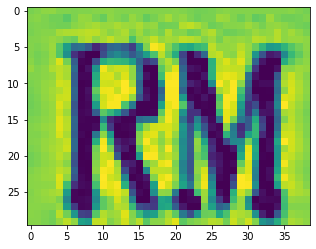

reading line : 958
65,1098,307,1098,307,1134,65,1134,SERVICE CHARGE



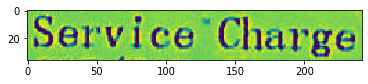

reading line : 959
564,1105,602,1105,602,1135,564,1135,RM



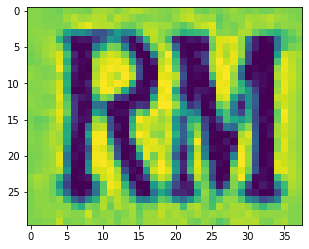

reading line : 960
66,1130,238,1130,238,1162,66,1162,GST/TAX 6%



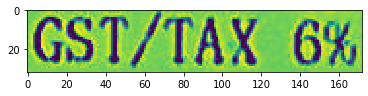

reading line : 961
565,1135,601,1135,601,1166,565,1166,RM



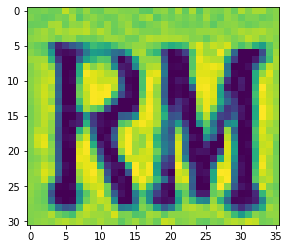

reading line : 962
64,1180,108,1180,108,1214,64,1214,TO



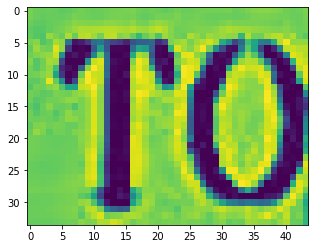

reading line : 963
411,1187,452,1187,452,1219,411,1219,RM



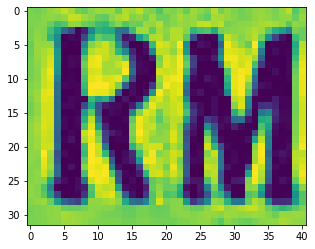

reading line : 964
63,1216,108,1216,108,1249,63,1249,CA



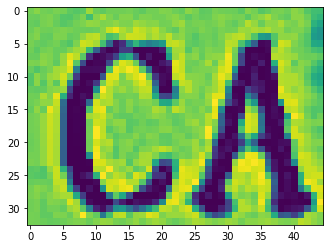

reading line : 965
409,1222,453,1222,453,1253,409,1253,RM



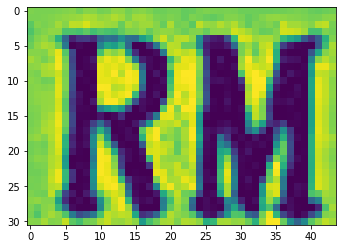

reading line : 966
64,1252,204,1252,204,1288,64,1288,CHANGE:



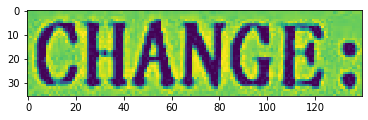

reading line : 967
409,1257,453,1257,453,1291,409,1291,RM



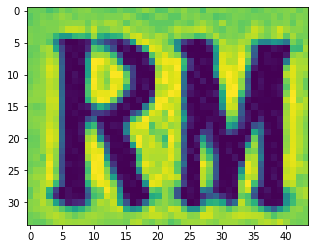

reading line : 968
64,1337,285,1337,285,1371,64,1371,ITEM COUNT: 2



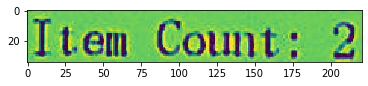

reading line : 969
61,1373,315,1373,315,1406,61,1406,QTY COUNT : 3.0



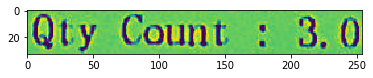

reading line : 970
57,1436,651,1436,651,1470,57,1470,CLOSED BILL: 20/12/2017 07:10:51 PM



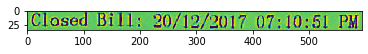

reading line : 971
63,1484,538,1484,538,1522,63,1522,THANK YOU, PLEASE COME AGAIN.



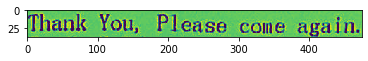

reading line : 972
58,1520,729,1520,729,1552,58,1552,GOODS SOLD ARE NOT REFUNDABLE, RETURNABLE



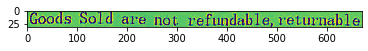

reading line : 973
62,1552,512,1552,512,1582,62,1582,BANK ACC MBB 5128 4851 2118



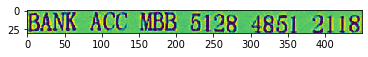

reading line : 974
60,1584,512,1584,512,1616,60,1616,BANK ACC MBB 5626 4732 1744



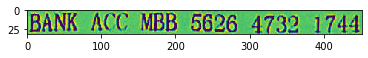

reading line : 975
59,1618,592,1618,592,1647,59,1647,BANK ACC AMBANK 888 100 123 3706



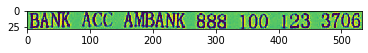

reading line : 976
60,1667,247,1667,247,1700,60,1700,GST SUMMARY



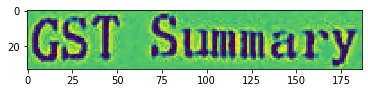

reading line : 977
289,1666,457,1666,457,1699,289,1699,AMOUNT (RM)



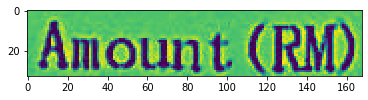

reading line : 978
504,1666,621,1666,621,1698,504,1698,TAX (RM)



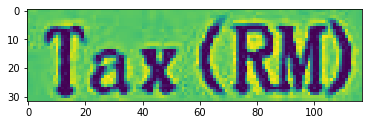

reading line : 979
57,1729,179,1729,179,1763,57,1763,SR @ 6%



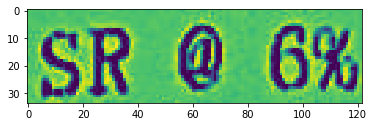

reading line : 980
374,1734,461,1734,461,1763,374,1763,68.87



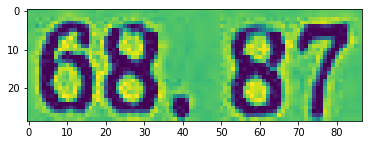

reading line : 981
552,1732,625,1732,625,1761,552,1761,4.13



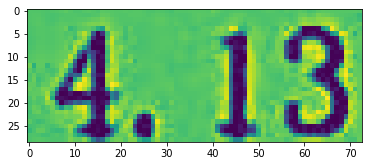

reading line : 982
57,1763,203,1763,203,1797,57,1797,ZR/OS/EZ



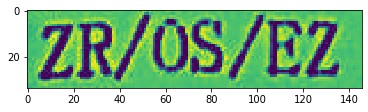

reading line : 983
388,1767,462,1767,462,1796,388,1796,0.00



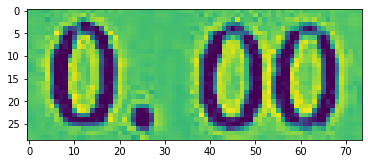

reading line : 984
552,1766,623,1766,623,1793,552,1793,0.00



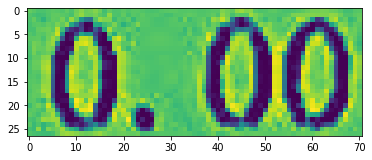

reading line : 985
182,446,331,446,331,476,182,476,R: ANGELA



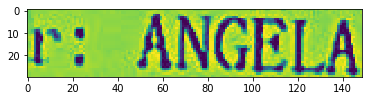

reading line : 986
581,460,625,460,625,488,581,488,: 1



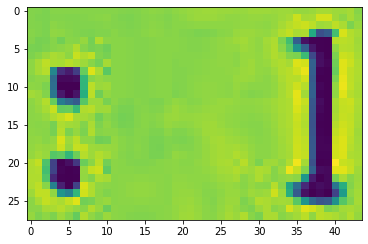

reading line : 987
244,647,261,647,261,671,244,671,:



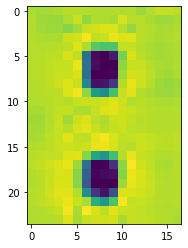

reading line : 988
243,682,258,682,258,704,243,704,:



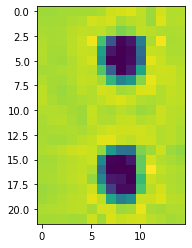

reading line : 989
241,712,256,712,256,736,241,736,:



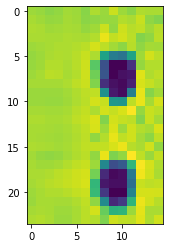

reading line : 990
241,744,255,744,255,769,241,769,:



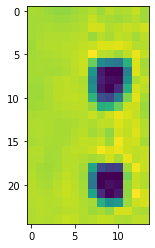

reading line : 991
237,1002,423,1002,423,1036,237,1036,33.02 UNI (



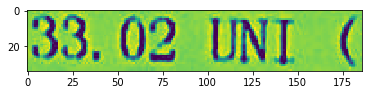

reading line : 992
469,1006,605,1006,605,1036,469,1036,3.96)=RM



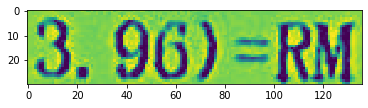

reading line : 993
354,1074,368,1074,368,1100,354,1100,:



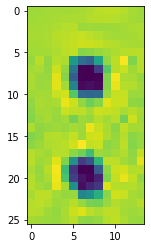

reading line : 994
354,1108,367,1108,367,1132,354,1132,:



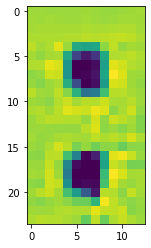

reading line : 995
353,1141,365,1141,365,1163,353,1163,:



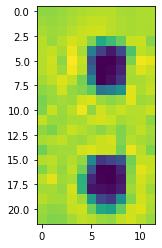

reading line : 996
643,1074,732,1074,732,1103,643,1103,68.87



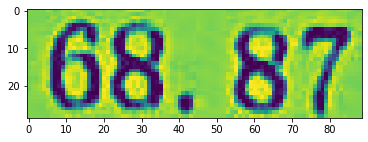

reading line : 997
660,1107,731,1107,731,1135,660,1135,0.00



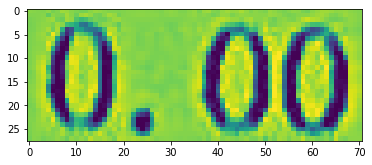

reading line : 998
661,1139,732,1139,732,1169,661,1169,4.13



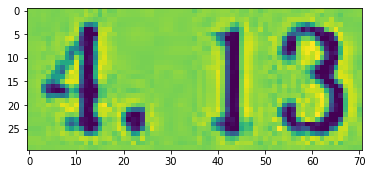

reading line : 999
192,1188,208,1188,208,1214,192,1214,:



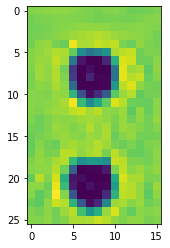

reading line : 1000
189,1224,206,1224,206,1250,189,1250,:



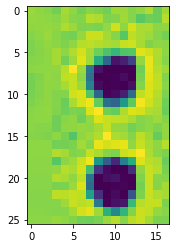

reading line : 1001
511,1186,610,1186,610,1219,511,1219,73.00



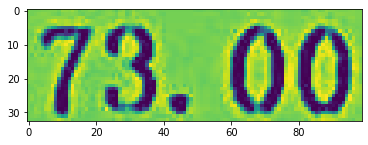

reading line : 1002
510,1224,610,1224,610,1254,510,1254,73.00



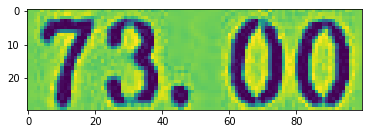

reading line : 1003
528,1260,609,1260,609,1291,528,1291,0.00



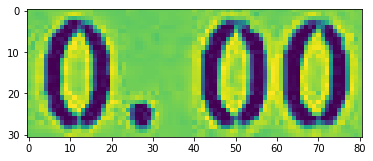

...... processing for X51005301667.jpg
reading corresponding text
reading line : 1004
155,293,667,293,667,361,155,361,LIGHTROOM GALLERY SDN BHD



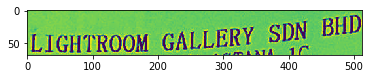

reading line : 1005
214,343,593,343,593,391,214,391,NO: 28, JALAN ASTANA 1C,



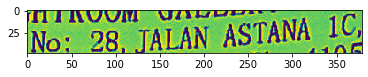

reading line : 1006
208,376,609,376,609,425,208,425,BANDAR BUKIT RAJA, 41050



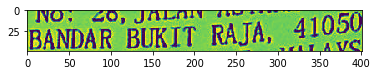

reading line : 1007
171,406,643,406,643,458,171,458,KLANG SELANGOR D. E, MALAYSIA



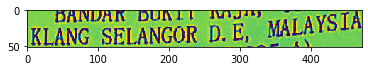

reading line : 1008
240,445,571,445,571,490,240,490,ROC NO. : (1072825-A)



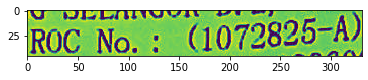

reading line : 1009
231,481,583,481,583,521,231,521,GST NO. : 000584089600



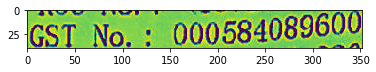

reading line : 1010
131,504,690,504,690,555,131,555,TEL:03-3362 4395 FAX:03-3362 4395



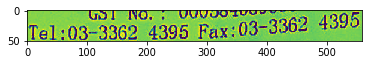

reading line : 1011
292,586,523,586,523,626,292,626,CREDIT NOTE



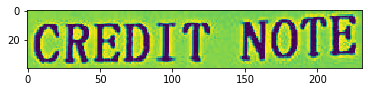

reading line : 1012
63,644,334,644,334,677,63,677,STATION: CASHIER



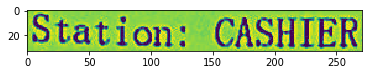

reading line : 1013
446,628,716,628,716,673,446,673,C/N NO: LCN00211



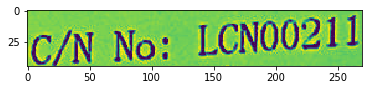

reading line : 1014
64,676,313,676,313,708,64,708,CASHIER: ANGELA



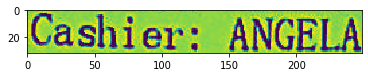

reading line : 1015
446,672,615,672,615,709,446,709,COVER : 1



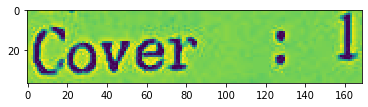

reading line : 1016
63,706,430,706,430,741,63,741,BILL DATE : 20/11/2017



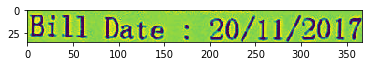

reading line : 1017
62,736,635,736,635,773,62,773,BILL START: 20/11/2017 03:55:07 PM



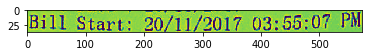

reading line : 1018
163,1649,295,1649,295,1677,163,1677,NT : 2.0



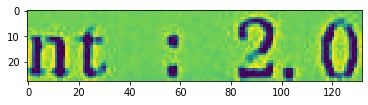

reading line : 1019
62,804,131,804,131,836,62,836,CODE



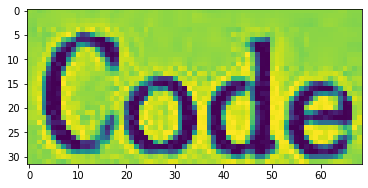

reading line : 1020
229,810,412,810,412,839,229,839,: 300-E0009



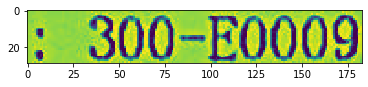

reading line : 1021
61,840,131,840,131,870,61,870,NAME



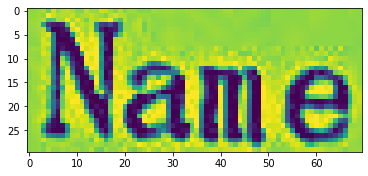

reading line : 1022
231,843,580,843,580,872,231,872,: ESWARAN 012-6369400



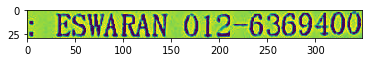

reading line : 1023
61,874,180,874,180,904,61,904,ADDRESS



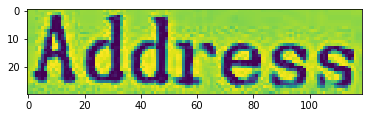

reading line : 1024
227,883,241,883,241,905,227,905,:



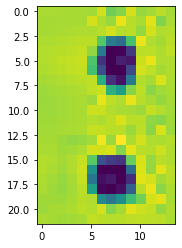

reading line : 1025
227,916,241,916,241,937,227,937,:



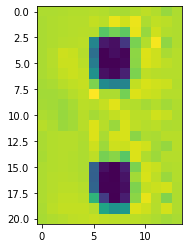

reading line : 1026
227,949,240,949,240,968,227,968,:



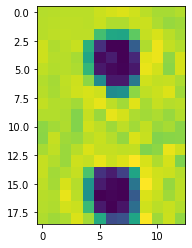

reading line : 1027
58,971,168,971,168,1002,58,1002,GST NO.



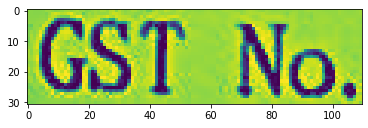

reading line : 1028
227,981,239,981,239,1002,227,1002,:



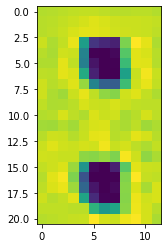

reading line : 1029
58,1083,79,1083,79,1095,58,1095,-



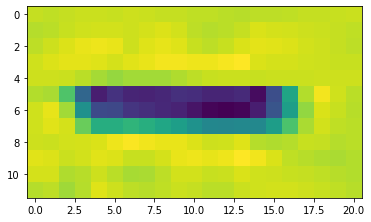

reading line : 1030
688,1077,723,1077,723,1109,688,1109,SR



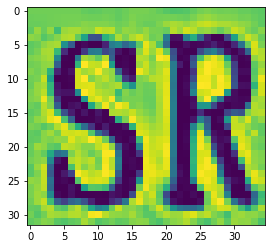

reading line : 1031
56,1107,291,1107,291,1139,56,1139,REFER LCS03158



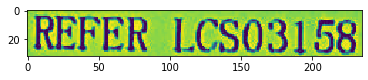

reading line : 1032
57,1140,74,1140,74,1167,57,1167,0



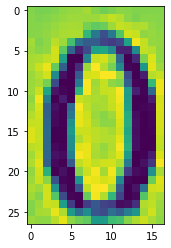

reading line : 1033
186,1146,210,1146,210,1169,186,1169,*



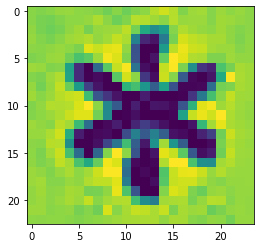

reading line : 1034
386,1144,460,1144,460,1176,386,1176,UNIT



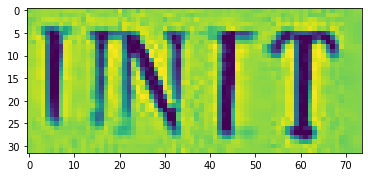

reading line : 1035
54,1172,175,1172,175,1202,54,1202,YT51775



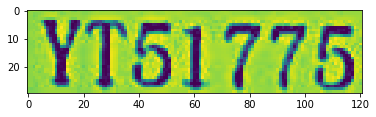

reading line : 1036
686,1180,725,1180,725,1210,686,1210,SR



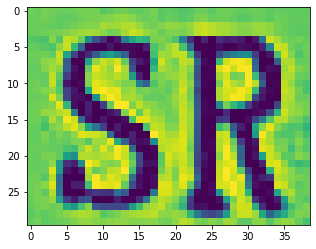

reading line : 1037
57,1206,576,1206,576,1243,57,1243,1059 18W SQ WW BK SUR LED LIGHT



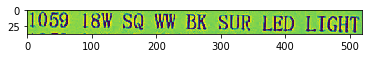

reading line : 1038
58,1238,437,1238,437,1273,58,1273,1059 SQUARE BLACK FRAME



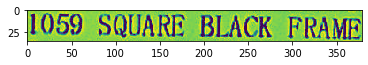

reading line : 1039
53,1272,74,1272,74,1301,53,1301,2



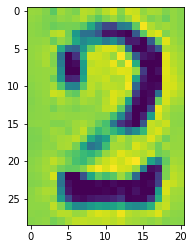

reading line : 1040
119,1273,726,1273,726,1313,119,1313,* RM 18.77 UNI ( 2.25)=RM 37.55



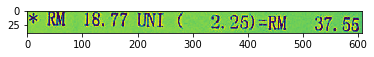

reading line : 1041
160,1700,634,1700,634,1746,160,1746,BILL: 20/11/2017 03:55:56 PM



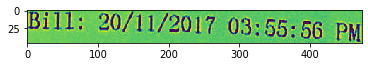

reading line : 1042
39,2045,172,2045,172,2075,39,2075,ZR/OS/EZ



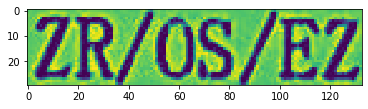

reading line : 1043
368,2054,438,2054,438,2084,368,2084,0.00



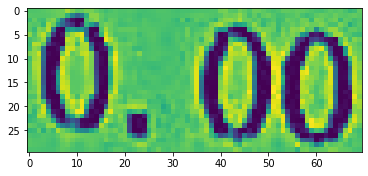

reading line : 1044
537,2063,609,2063,609,2093,537,2093,0.00



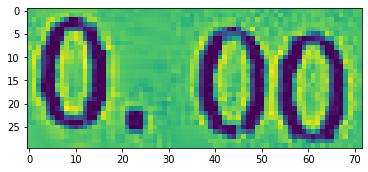

reading line : 1045
52,1337,202,1337,202,1369,52,1369,SUB TOTAL



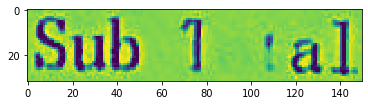

reading line : 1046
336,1346,349,1346,349,1369,336,1369,:



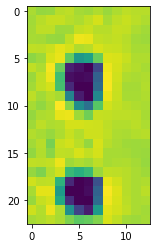

reading line : 1047
553,1346,591,1346,591,1375,553,1375,RM



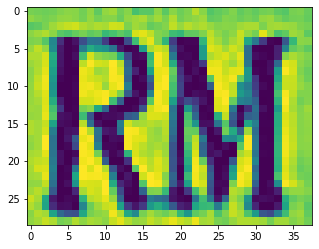

reading line : 1048
636,1349,721,1349,721,1381,636,1381,37.55



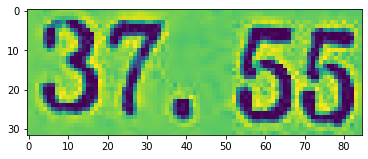

reading line : 1049
51,1370,287,1370,287,1405,51,1405,SERVICE CHARGE



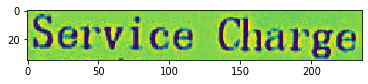

reading line : 1050
335,1381,347,1381,347,1402,335,1402,:



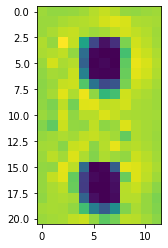

reading line : 1051
551,1380,592,1380,592,1407,551,1407,RM



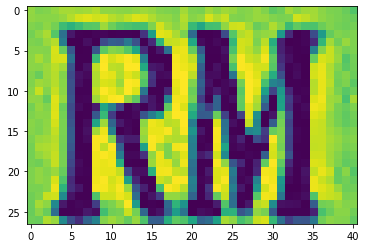

reading line : 1052
652,1383,720,1383,720,1413,652,1413,0.00



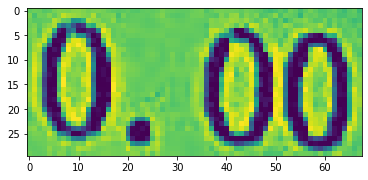

reading line : 1053
51,1403,219,1403,219,1433,51,1433,GST/TAX 6%



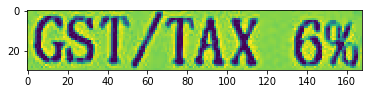

reading line : 1054
334,1414,346,1414,346,1435,334,1435,:



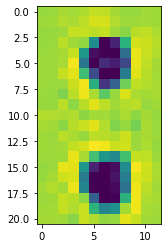

reading line : 1055
550,1412,590,1412,590,1441,550,1441,RM



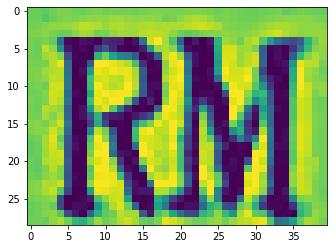

reading line : 1056
650,1418,722,1418,722,1448,650,1448,2.25



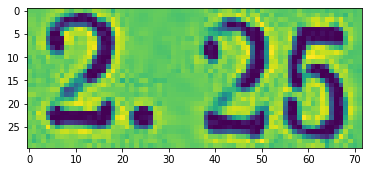

reading line : 1057
50,1455,187,1455,187,1489,50,1489,TOTAL :



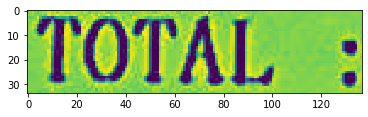

reading line : 1058
392,1462,434,1462,434,1493,392,1493,RM



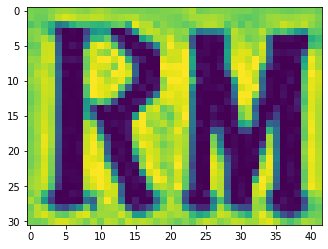

reading line : 1059
492,1465,597,1465,597,1497,492,1497,39.80



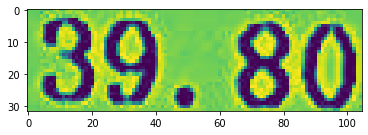

reading line : 1060
50,1490,188,1490,188,1524,50,1524,CASH :



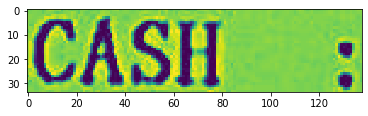

reading line : 1061
391,1498,436,1498,436,1529,391,1529,RM



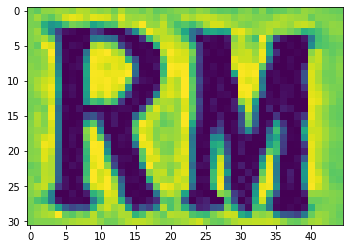

reading line : 1062
492,1503,597,1503,597,1534,492,1534,39.80



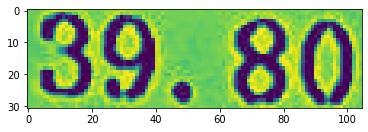

reading line : 1063
49,1528,188,1528,188,1560,49,1560,CHANGE:



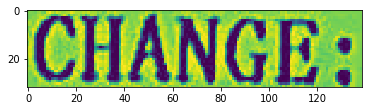

reading line : 1064
389,1532,434,1532,434,1565,389,1565,RM



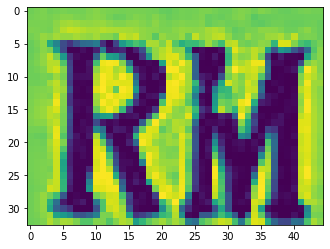

reading line : 1065
512,1540,596,1540,596,1571,512,1571,0.00



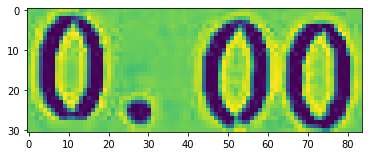

reading line : 1066
49,1614,265,1614,265,1645,49,1645,ITEM COUNT: 2



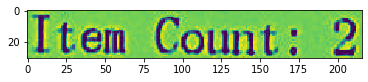

reading line : 1067
45,1648,99,1648,99,1680,45,1680,QTY



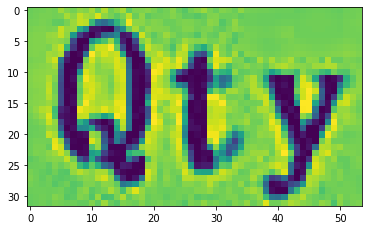

reading line : 1068
44,1699,114,1699,114,1729,44,1729,CLOS



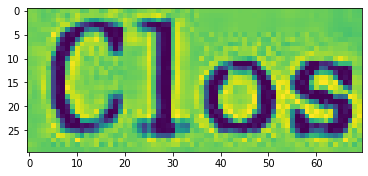

reading line : 1069
43,1764,521,1764,521,1806,43,1806,THANK YOU, PLEASE COME AGAIN.



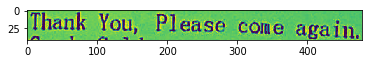

reading line : 1070
44,1798,717,1798,717,1853,44,1853,GOODS SOLD ARE NOT REFUNDABLE, RETURNABLE



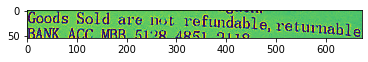

reading line : 1071
43,1831,493,1831,493,1869,43,1869,BANK ACC MBB 5128 4851 2118



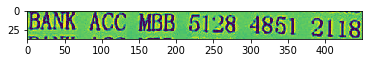

reading line : 1072
42,1862,493,1862,493,1903,42,1903,BANK ACC MBB 5626 4732 1744



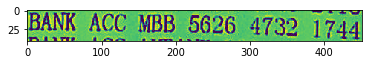

reading line : 1073
40,1895,578,1895,578,1941,40,1941,BANK ACC AMBANK 888 100 123 3706



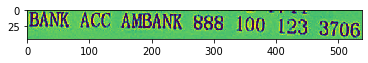

reading line : 1074
40,1947,223,1947,223,1982,40,1982,GST SUMMARY



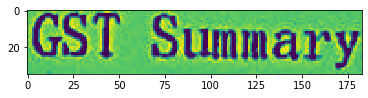

reading line : 1075
270,1950,435,1950,435,1984,270,1984,AMOUNT (RM)



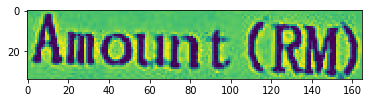

reading line : 1076
488,1960,604,1960,604,1994,488,1994,TAX (RM)



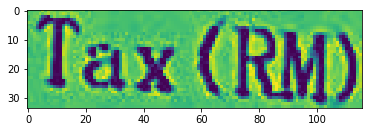

reading line : 1077
37,2011,158,2011,158,2041,37,2041,SR @ 6%



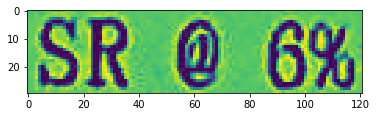

reading line : 1078
353,2018,439,2018,439,2051,353,2051,37.55



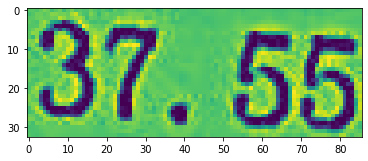

reading line : 1079
535,2029,611,2029,611,2061,535,2061,2.25



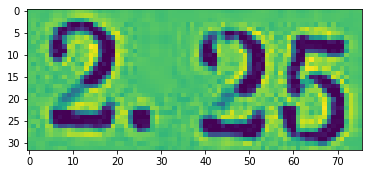

...... processing for X51005303661.jpg
reading corresponding text
reading line : 1080
173,86,680,86,680,144,173,144,LIGHTROOM GALLERY SDN BHD



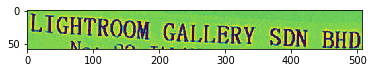

reading line : 1081
236,130,610,130,610,179,236,179,NO: 28, JALAN ASTANA 1C,



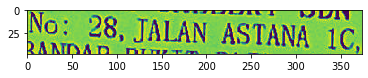

reading line : 1082
226,161,626,161,626,206,226,206,BANDAR BUKIT RAJA, 41050



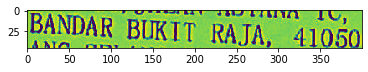

reading line : 1083
192,192,657,192,657,241,192,241,KLANG SELANGOR D.E, MALAYSIA



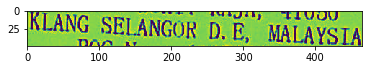

reading line : 1084
261,229,588,229,588,272,261,272,ROC NO. : (1072825-A)



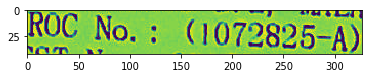

reading line : 1085
249,262,600,262,600,302,249,302,GST NO. : 000584089600



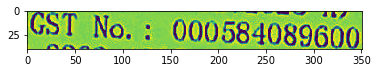

reading line : 1086
148,287,700,287,700,338,148,338,TEL:03-3362 4395 FAX:03-3362 4395



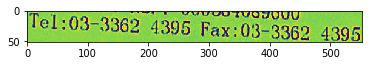

reading line : 1087
310,363,536,363,536,401,310,401,TAX INVOICE



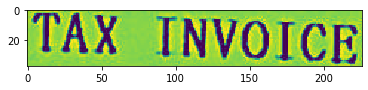

reading line : 1088
79,404,354,404,354,444,79,444,STATION: CASHIER



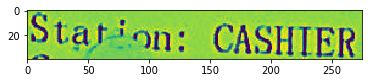

reading line : 1089
462,421,745,421,745,456,462,456,BILL NO: LCS03908



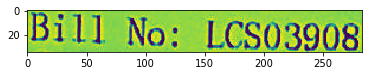

reading line : 1090
78,438,130,438,130,467,78,467,CAS



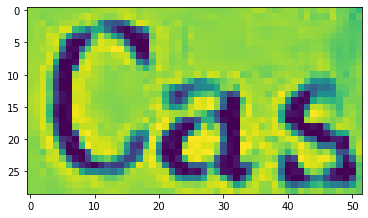

reading line : 1091
180,446,332,446,332,476,180,476,R: ANGELA



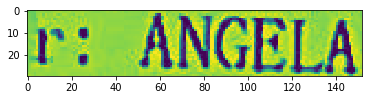

reading line : 1092
461,455,625,455,625,489,461,489,COVER : 1



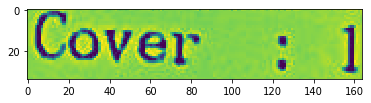

reading line : 1093
78,470,448,470,448,513,78,513,BILL DATE : 20/12/2017



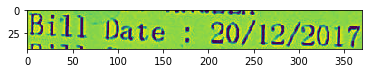

reading line : 1094
78,504,648,504,648,553,78,553,BILL START: 20/12/2017 07:10:35 PM



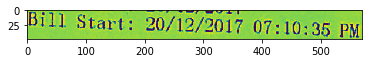

reading line : 1095
76,569,149,569,149,601,76,601,CODE



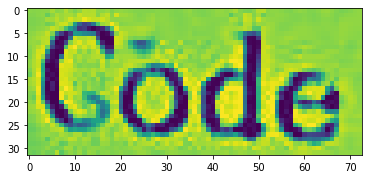

reading line : 1096
245,579,428,579,428,609,245,609,: 300-C0001



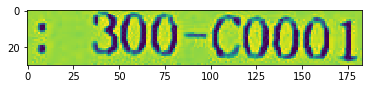

reading line : 1097
75,601,146,601,146,633,75,633,NAME



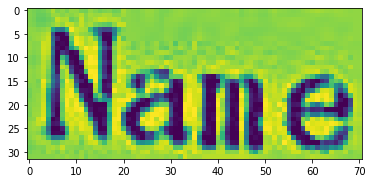

reading line : 1098
244,610,349,610,349,641,244,641,: CASH



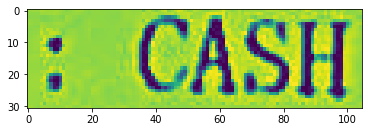

reading line : 1099
73,636,197,636,197,668,73,668,ADDRESS



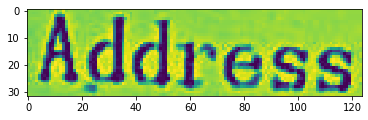

reading line : 1100
246,647,257,647,257,670,246,670,:



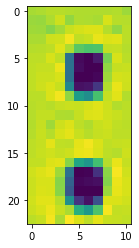

reading line : 1101
244,682,258,682,258,703,244,703,:



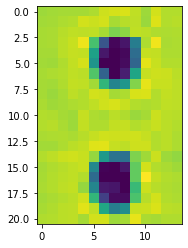

reading line : 1102
245,715,255,715,255,736,245,736,:



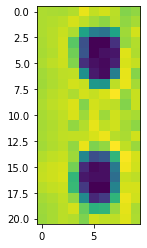

reading line : 1103
72,736,186,736,186,767,72,767,GST NO.



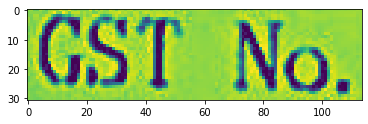

reading line : 1104
243,747,257,747,257,769,243,769,:



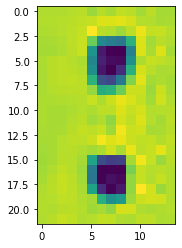

reading line : 1105
70,836,192,836,192,868,70,868,CH50514



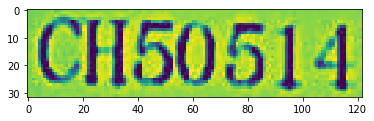

reading line : 1106
696,850,738,850,738,880,696,880,SR



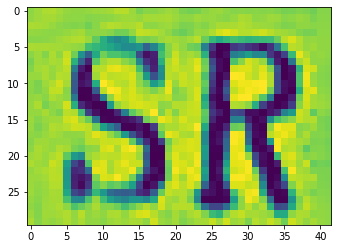

reading line : 1107
70,869,375,869,375,903,70,903,T5 JOINT 2PIN 2PCS



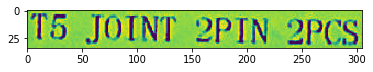

reading line : 1108
139,904,737,904,737,942,139,942,* RM 2.83 UNI ( 0.17)=RM 2.83



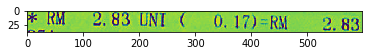

reading line : 1109
73,903,89,903,89,930,73,930,1



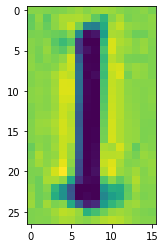

reading line : 1110
71,933,189,933,189,965,71,965,YT51874



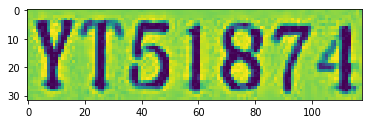

reading line : 1111
695,946,735,946,735,975,695,975,SR



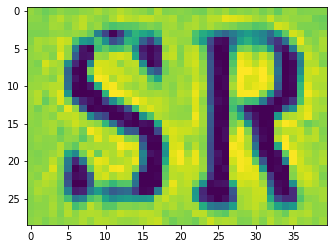

reading line : 1112
70,967,554,967,554,1004,70,1004,YE30 BK 7W WW LED TRACK LIGHT



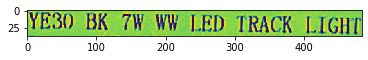

reading line : 1113
66,1002,90,1002,90,1030,66,1030,2



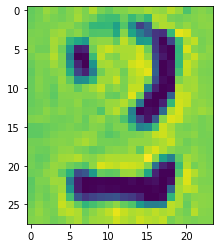

reading line : 1114
135,1001,732,1001,732,1039,135,1039,* RM 33.02 UNI ( 3.96)=RM 66.04



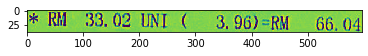

reading line : 1115
66,1067,219,1067,219,1096,66,1096,SUB TOTAL



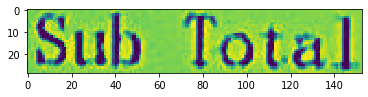

reading line : 1116
353,1076,367,1076,367,1099,353,1099,:



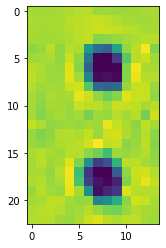

reading line : 1117
566,1073,603,1073,603,1102,566,1102,RM



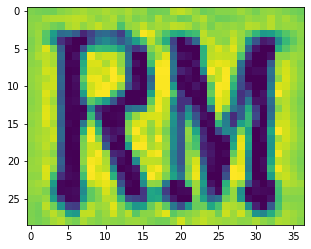

reading line : 1118
645,1076,730,1076,730,1103,645,1103,68.87



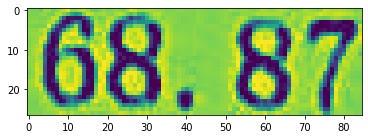

reading line : 1119
66,1099,303,1099,303,1134,66,1134,SERVICE CHARGE



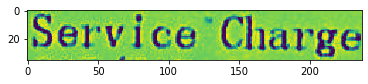

reading line : 1120
353,1111,367,1111,367,1130,353,1130,:



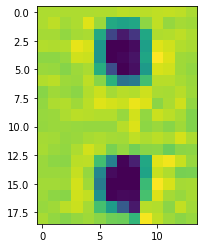

reading line : 1121
566,1106,600,1106,600,1133,566,1133,RM



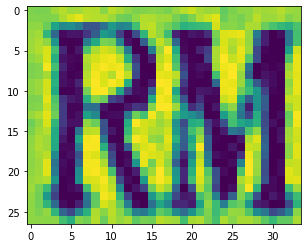

reading line : 1122
661,1108,730,1108,730,1133,661,1133,0.00



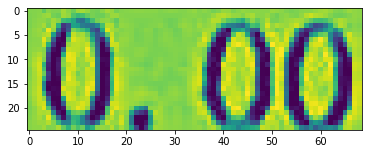

reading line : 1123
68,1131,238,1131,238,1159,68,1159,GST/TAX 6%



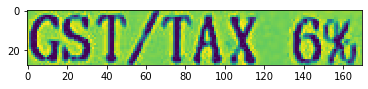

reading line : 1124
353,1142,367,1142,367,1164,353,1164,:



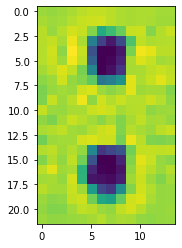

reading line : 1125
564,1137,601,1137,601,1166,564,1166,RM



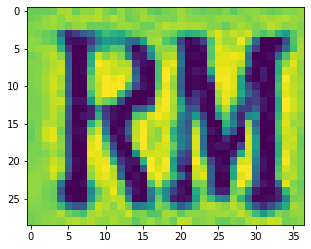

reading line : 1126
663,1141,733,1141,733,1167,663,1167,4.13



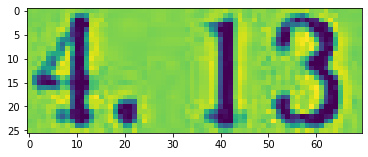

reading line : 1127
65,1182,109,1182,109,1213,65,1213,TO



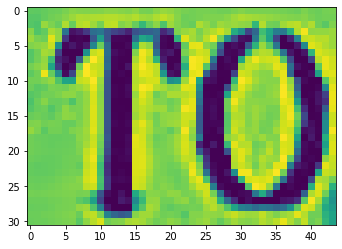

reading line : 1128
192,1191,207,1191,207,1213,192,1213,:



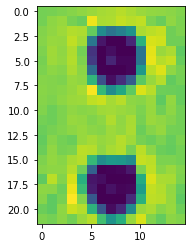

reading line : 1129
412,1187,453,1187,453,1217,412,1217,RM



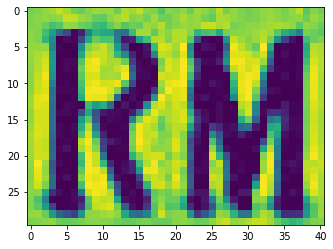

reading line : 1130
511,1188,609,1188,609,1219,511,1219,73.00



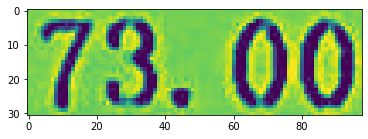

reading line : 1131
65,1218,108,1218,108,1249,65,1249,CA



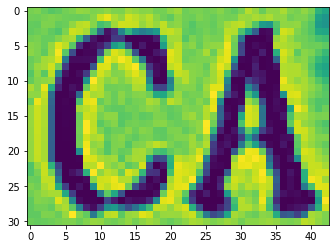

reading line : 1132
192,1227,206,1227,206,1249,192,1249,:



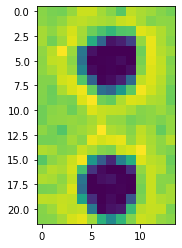

reading line : 1133
411,1223,452,1223,452,1253,411,1253,RM



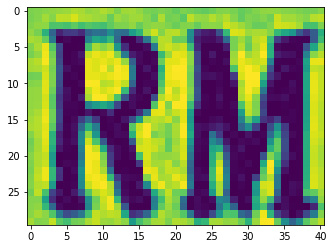

reading line : 1134
510,1223,607,1223,607,1255,510,1255,73.00



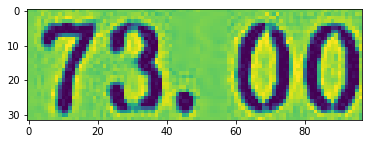

reading line : 1135
65,1256,204,1256,204,1286,65,1286,CHANGE:



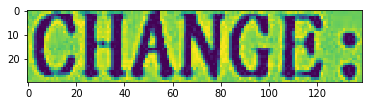

reading line : 1136
409,1260,453,1260,453,1289,409,1289,RM



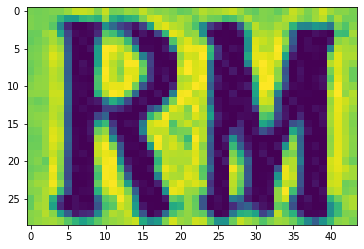

reading line : 1137
529,1261,607,1261,607,1289,529,1289,0.00



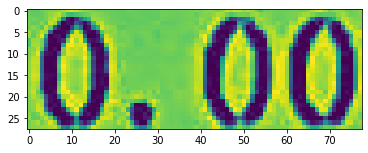

reading line : 1138
64,1341,283,1341,283,1370,64,1370,ITEM COUNT: 2



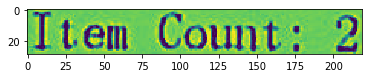

reading line : 1139
62,1373,315,1373,315,1406,62,1406,QTY COUNT : 3.0



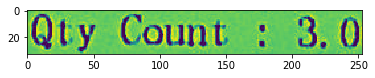

reading line : 1140
61,1437,645,1437,645,1470,61,1470,CLOSED BILL: 20/12/2017 07:10:51 PM



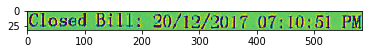

reading line : 1141
60,1485,537,1485,537,1522,60,1522,THANK YOU, PLEASE COME AGAIN.



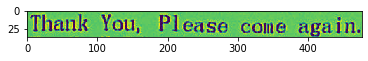

reading line : 1142
61,1518,727,1518,727,1552,61,1552,GOODS SOLD ARE NOT REFUNDABLE, RETURNABLE



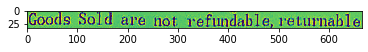

reading line : 1143
62,1553,512,1553,512,1584,62,1584,BANK ACC MBB 5128 4851 2118



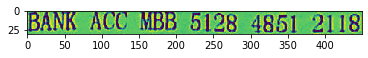

reading line : 1144
62,1586,512,1586,512,1617,62,1617,BANK ACC MBB 5626 4732 1744



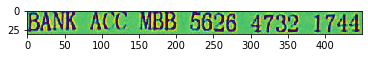

reading line : 1145
60,1618,590,1618,590,1649,60,1649,BANK ACC AMBANK 888 100 123 3706



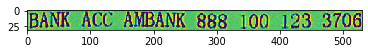

reading line : 1146
61,1668,247,1668,247,1700,61,1700,GST SUMMARY



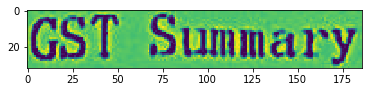

reading line : 1147
292,1668,455,1668,455,1699,292,1699,AMOUNT (RM)



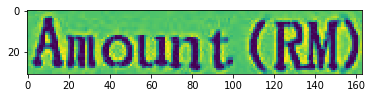

reading line : 1148
505,1667,619,1667,619,1698,505,1698,TAX (RM)



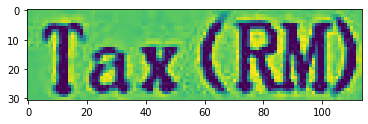

reading line : 1149
58,1732,182,1732,182,1763,58,1763,SR @ 6%



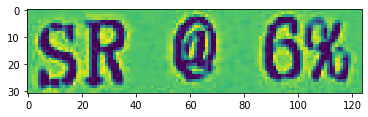

reading line : 1150
374,1734,459,1734,459,1763,374,1763,68.87



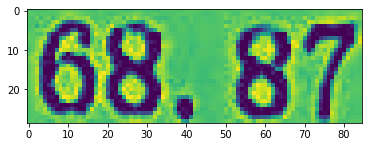

reading line : 1151
556,1733,624,1733,624,1762,556,1762,4.13



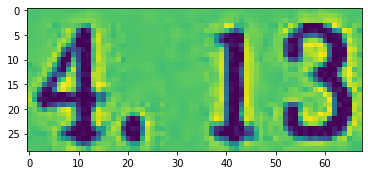

reading line : 1152
60,1765,195,1765,195,1795,60,1795,ZR/OS/EZ



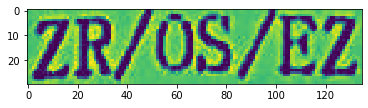

reading line : 1153
391,1768,459,1768,459,1795,391,1795,0.00



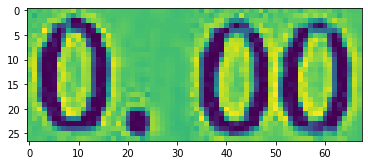

reading line : 1154
554,1766,624,1766,624,1793,554,1793,0.00



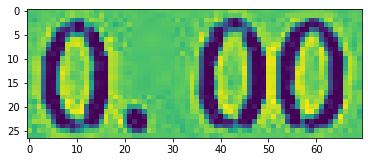

...... processing for X51005306399.jpg
reading corresponding text
reading line : 1155
68,13,95,13,95,51,68,51,3



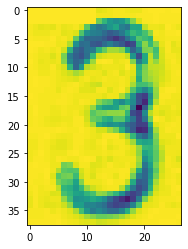

reading line : 1156
43,87,350,87,350,111,43,111,SHELL ISNI PETRO TRADING



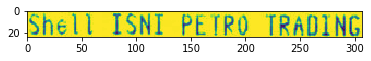

reading line : 1157
42,114,324,114,324,138,42,138,COMPANY NO: 002643278-A



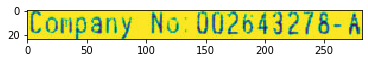

reading line : 1158
41,138,375,138,375,160,41,160,LOT 2685 JLN GENTING KLANG



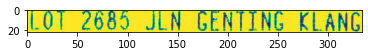

reading line : 1159
42,161,142,161,142,185,42,185,53300 KL



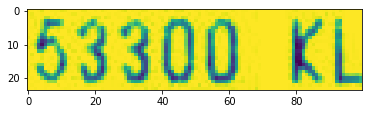

reading line : 1160
221,164,338,164,338,184,221,184,SITE 1066



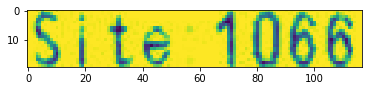

reading line : 1161
43,187,157,187,157,211,43,211,TELEPHONE



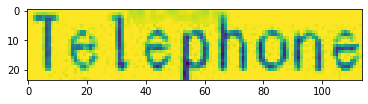

reading line : 1162
43,211,324,211,324,236,43,236,GST NO: 0010 9010 5344



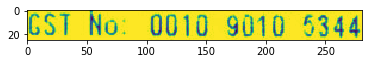

reading line : 1163
143,260,234,260,234,286,143,286,RECEIPT



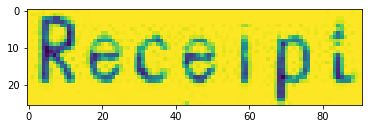

reading line : 1164
42,282,388,282,388,306,42,306,INVOICE NUMBER 60000053668



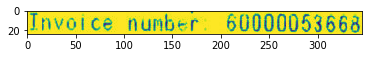

reading line : 1165
93,331,363,331,363,357,93,357,35.10 LITRE PUMP # 02



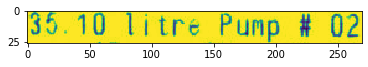

reading line : 1166
43,354,169,354,169,376,43,376,V-POWER 97



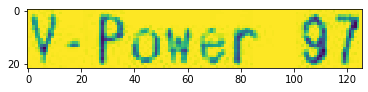

reading line : 1167
234,355,260,355,260,376,234,376,RM



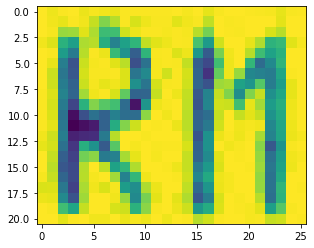

reading line : 1168
298,355,389,355,389,378,298,378,86.00 A



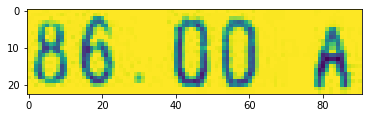

reading line : 1169
93,377,159,377,159,400,93,400,2.450



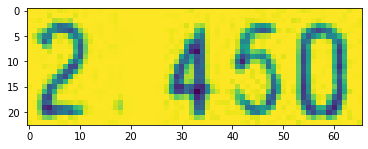

reading line : 1170
42,401,106,401,106,424,42,424,TOTAL



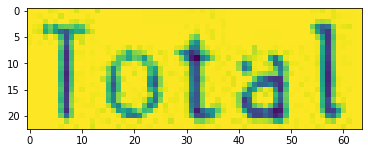

reading line : 1171
233,402,261,402,261,424,233,424,RM



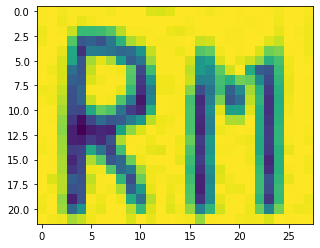

reading line : 1172
299,404,363,404,363,425,299,425,86.00



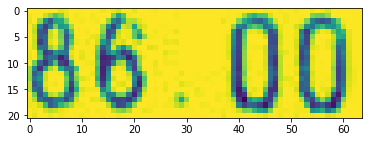

reading line : 1173
41,426,93,426,93,448,41,448,VISA



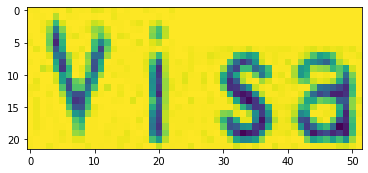

reading line : 1174
233,427,261,427,261,448,233,448,RM



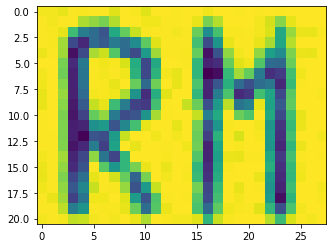

reading line : 1175
298,426,363,426,363,449,298,449,86.00



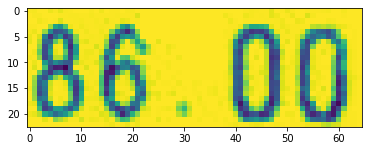

reading line : 1176
42,450,157,450,157,472,42,472,6.00% GST



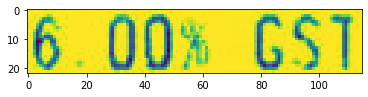

reading line : 1177
207,452,260,452,260,473,207,473,A RM



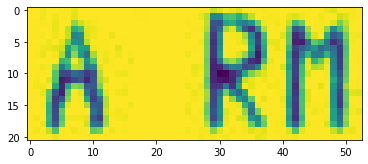

reading line : 1178
310,452,361,452,361,474,310,474,4.87



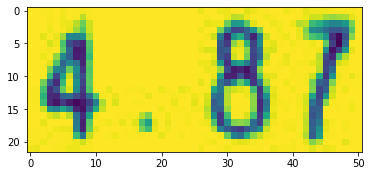

reading line : 1179
43,474,182,474,182,498,43,498,TOTAL GROSS



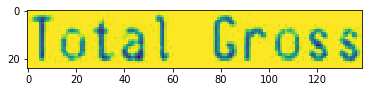

reading line : 1180
208,477,260,477,260,496,208,496,A RM



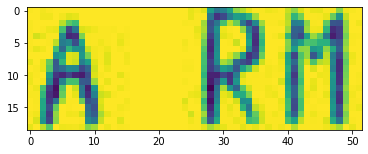

reading line : 1181
298,476,363,476,363,497,298,497,86.00



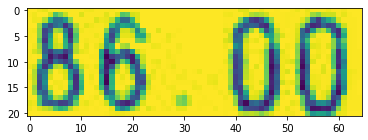

reading line : 1182
41,522,272,522,272,549,41,549,SHELL LOYALTY CARD



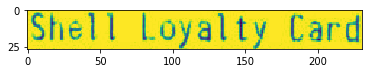

reading line : 1183
42,547,247,547,247,569,42,569,6018840126306675



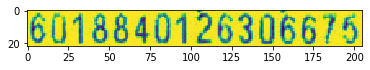

reading line : 1184
41,571,221,571,221,591,41,591,POINTS AWARDED



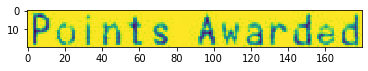

reading line : 1185
245,571,271,571,271,593,245,593,35



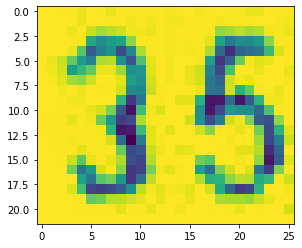

reading line : 1186
41,663,92,663,92,682,41,682,DATE



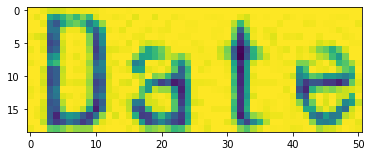

reading line : 1187
157,660,209,660,209,683,157,683,TIME



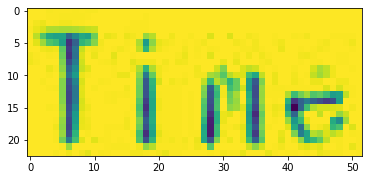

reading line : 1188
42,684,337,684,337,707,42,707,18/03/18 15:17 06051 02



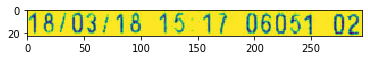

reading line : 1189
41,730,322,730,322,754,41,754,DIESEL & PETROL RON 95



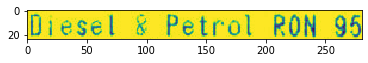

reading line : 1190
41,757,376,757,376,781,41,781,GIVEN RELIEF UNDER SECTION



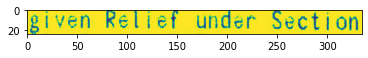

reading line : 1191
43,779,337,779,337,803,43,803,56 (3) (B) GST ACT 2014



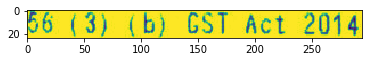

reading line : 1192
41,826,158,826,158,848,41,848,THANK YOU



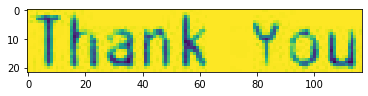

reading line : 1193
41,848,271,848,271,876,41,876,PLEASAE COME AGAIN



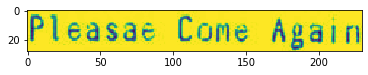

reading line : 1194
142,14,325,14,325,59,142,59,180048



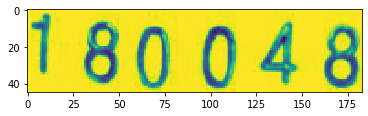

reading line : 1195
183,188,218,188,218,209,183,209,03-



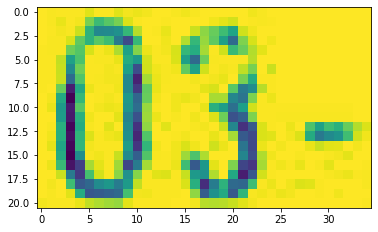

reading line : 1196
235,189,336,189,336,211,235,211,40212008



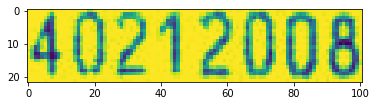

reading line : 1197
182,378,209,378,209,399,182,399,RM



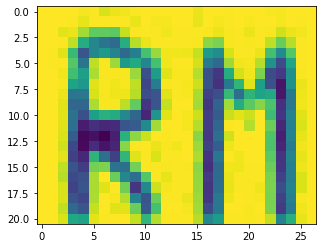

reading line : 1198
235,379,325,379,325,401,235,401,/LITRE



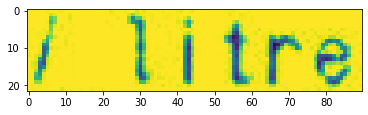

reading line : 1199
233,663,273,663,273,683,233,683,NUM



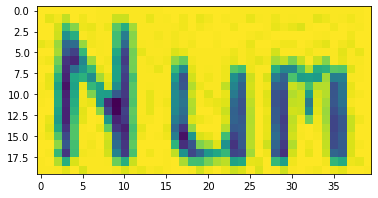

reading line : 1200
309,662,349,662,349,683,309,683,OPT



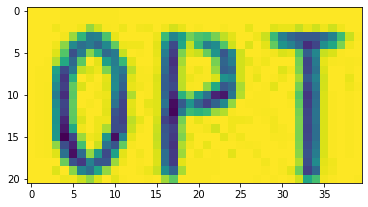

...... processing for X51005337872.jpg
reading corresponding text
reading line : 1201
63,340,553,340,553,369,63,369,SYL ROASTED DELIGHTS SDN. BHD.



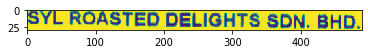

reading line : 1202
246,379,345,379,345,402,246,402,1227039



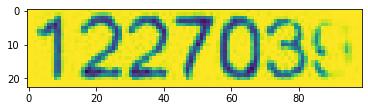

reading line : 1203
74,406,541,406,541,432,74,432,75, JALAN SS 22/19, DAMANSARA JAYA, 47400 PJ,



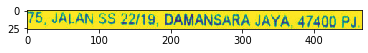

reading line : 1204
196,435,417,435,417,459,196,459,TEL : 03-7731 8169



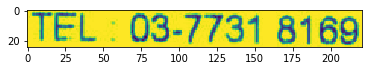

reading line : 1205
183,474,432,474,432,497,183,497,GST ID : 002046390272



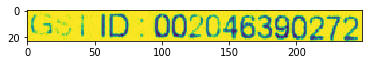

reading line : 1206
30,520,135,520,135,543,30,543,DOC NO. :



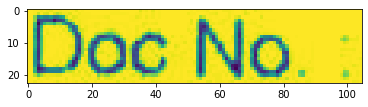

reading line : 1207
157,522,303,522,303,544,157,544,SO00022185



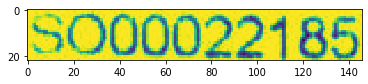

reading line : 1208
362,525,444,525,444,547,362,547,TABLE



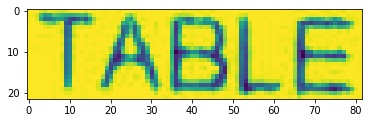

reading line : 1209
472,527,518,527,518,550,472,550,A10



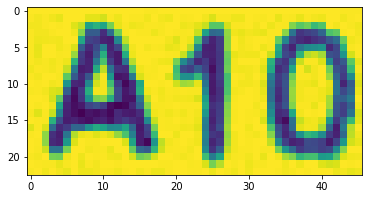

reading line : 1210
29,554,116,554,116,577,29,577,CASHIER



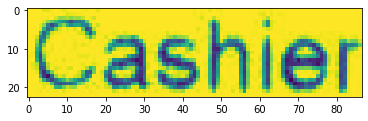

reading line : 1211
157,556,227,556,227,577,157,577,USER



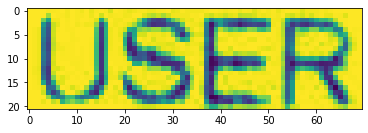

reading line : 1212
364,558,423,558,423,581,364,581,DATE:



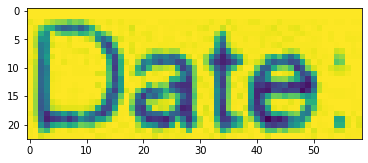

reading line : 1213
460,561,587,561,587,582,460,582,06/03/2018



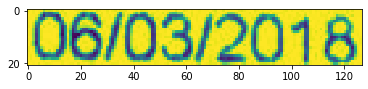

reading line : 1214
30,586,175,586,175,613,30,613,SALESPERSON:



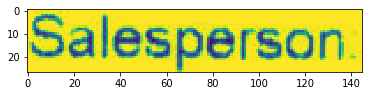

reading line : 1215
363,589,424,589,424,612,363,612,TIME:



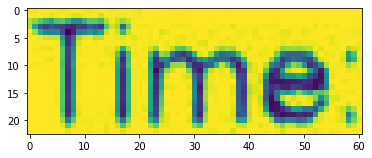

reading line : 1216
461,591,559,591,559,614,461,614,12:06:00



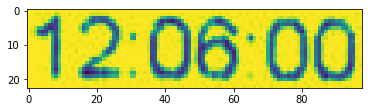

reading line : 1217
29,639,157,639,157,665,29,665,DESCRIPTION



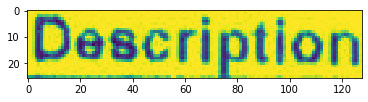

reading line : 1218
336,643,374,643,374,667,336,667,QTY



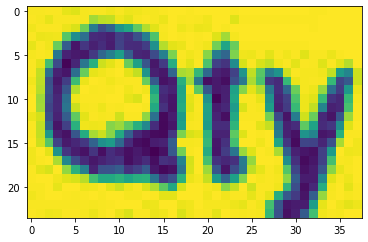

reading line : 1219
418,644,475,644,475,666,418,666,PRICE



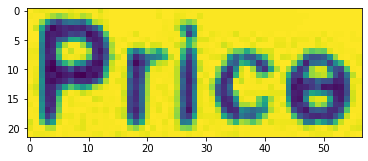

reading line : 1220
492,644,581,644,581,669,492,669,AMOUNT



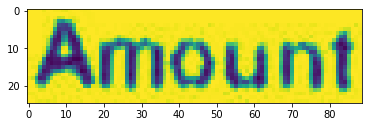

reading line : 1221
27,669,259,669,259,693,27,693,(T02) BRAISED PORK



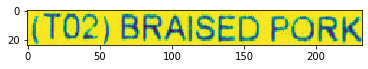

reading line : 1222
337,674,371,674,371,695,337,695,2.0



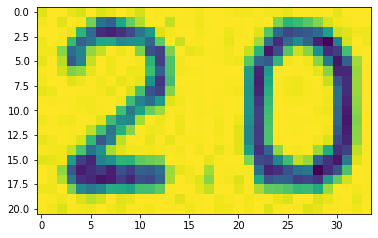

reading line : 1223
428,674,475,674,475,695,428,695,7.00



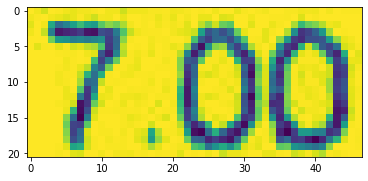

reading line : 1224
523,676,580,676,580,697,523,697,14.00



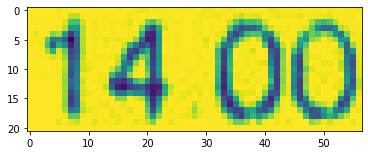

reading line : 1225
29,694,246,694,246,718,29,718,RICE WITH PEANUT



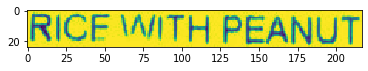

reading line : 1226
154,729,254,729,254,752,154,752,T PORK -



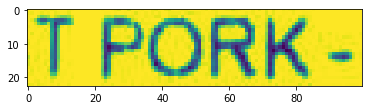

reading line : 1227
337,732,371,732,371,753,337,753,1.0



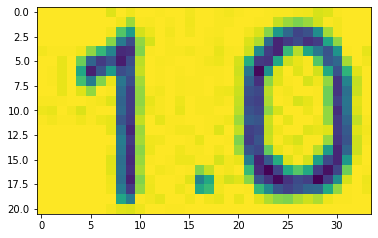

reading line : 1228
418,734,476,734,476,754,418,754,12.00



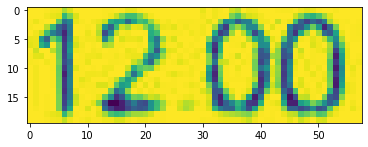

reading line : 1229
525,735,580,735,580,756,525,756,12.00



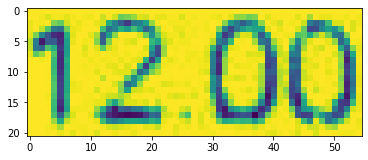

reading line : 1230
29,754,102,754,102,775,29,775,SMALL



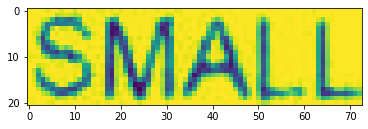

reading line : 1231
27,788,249,788,249,811,27,811,(V02) SOUR & SPICY



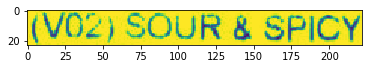

reading line : 1232
339,792,372,792,372,813,339,813,1.0



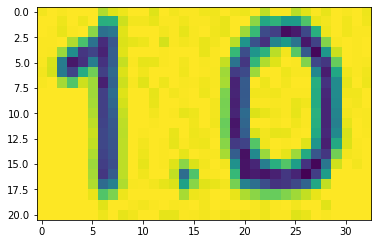

reading line : 1233
416,792,474,792,474,813,416,813,12.00



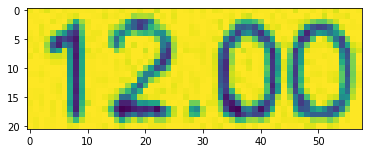

reading line : 1234
522,795,580,795,580,814,522,814,12.00



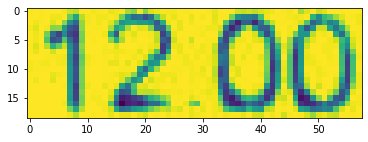

reading line : 1235
28,813,143,813,143,834,28,834,MUSTARD



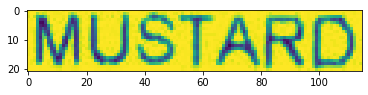

reading line : 1236
27,846,277,846,277,869,27,869,(B03) JASMINE GREEN



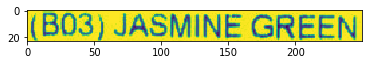

reading line : 1237
337,848,369,848,369,870,337,870,2.0



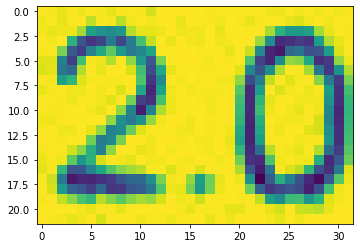

reading line : 1238
426,850,474,850,474,870,426,870,2.30



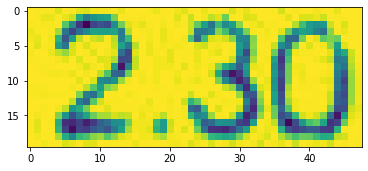

reading line : 1239
534,850,580,850,580,871,534,871,4.60



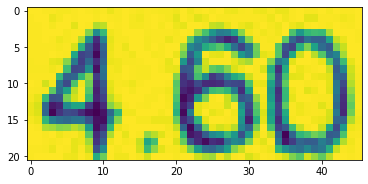

reading line : 1240
28,870,138,870,138,896,28,896,TEA(HOT)



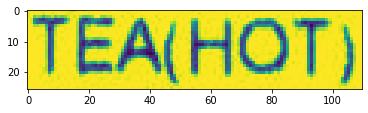

reading line : 1241
27,905,261,905,261,926,27,926,(R05) ROAST PORK +



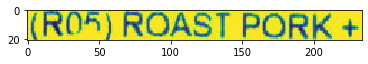

reading line : 1242
338,907,371,907,371,927,338,927,1.0



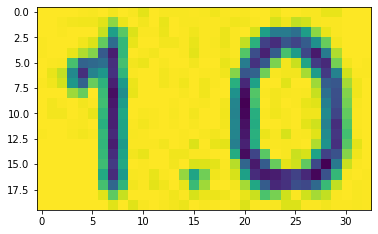

reading line : 1243
417,909,474,909,474,928,417,928,11.90



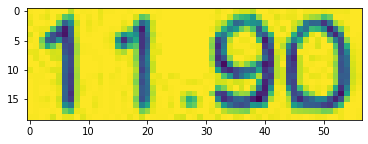

reading line : 1244
524,909,580,909,580,929,524,929,11.90



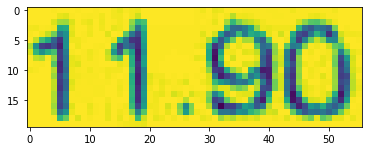

reading line : 1245
27,928,275,928,275,949,27,949,ROAST CHICKEN RICE



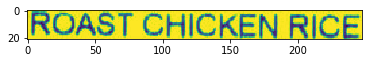

reading line : 1246
164,965,272,965,272,992,164,992,TOTAL QTY:



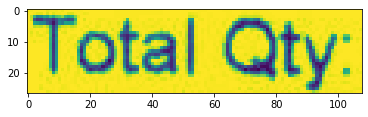

reading line : 1247
345,968,362,968,362,988,345,988,7



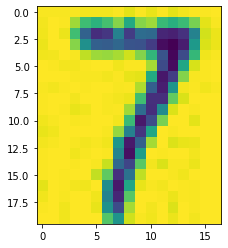

reading line : 1248
516,962,578,962,578,984,516,984,51.42



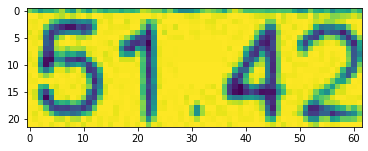

reading line : 1249
165,1029,466,1029,466,1055,165,1055,TOTAL SALES (EXCLUDING GST) :



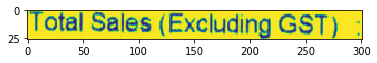

reading line : 1250
523,1033,581,1033,581,1053,523,1053,51.42



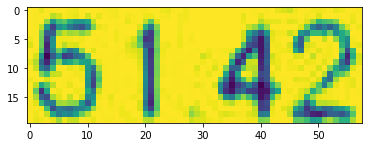

reading line : 1251
342,1070,464,1070,464,1093,342,1093,DISCOUNT :



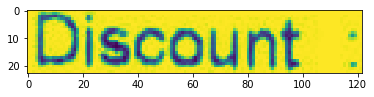

reading line : 1252
529,1072,579,1072,579,1095,529,1095,0.00



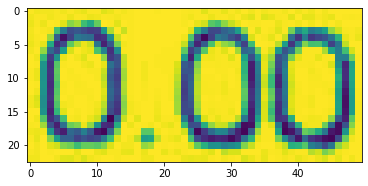

reading line : 1253
342,1107,466,1107,466,1131,342,1131,TOTAL GST :



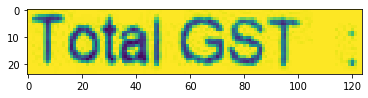

reading line : 1254
535,1110,579,1110,579,1132,535,1132,3.08



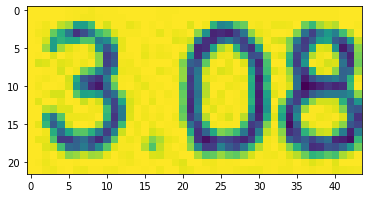

reading line : 1255
333,1147,466,1147,466,1174,333,1174,ROUNDING :



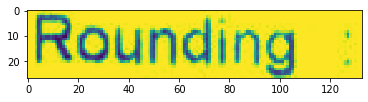

reading line : 1256
528,1151,580,1151,580,1172,528,1172,0.00



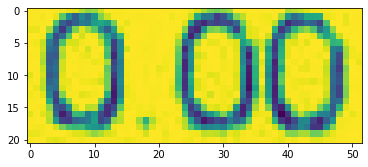

reading line : 1257
116,1184,461,1184,461,1215,116,1215,TOTAL SALES (INCLUSIVE OF GST)



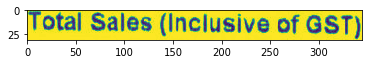

reading line : 1258
505,1189,580,1189,580,1214,505,1214,54.50



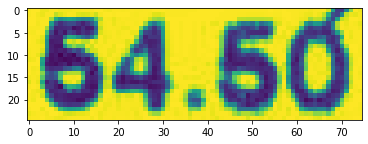

reading line : 1259
27,729,37,729,37,754,27,754,(



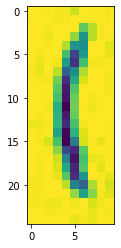

...... processing for X51005361883.jpg
reading corresponding text
reading line : 1260
127,195,857,195,857,253,127,253,TEO HENG STATIONERY & BOOKS



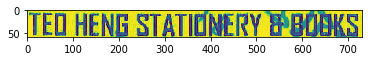

reading line : 1261
397,261,585,261,585,288,397,288,(001451637-M)



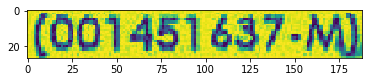

reading line : 1262
194,297,790,297,790,322,194,322,NO. 53, JALAN BESAR, 45600 BATANG BERJUNTAI



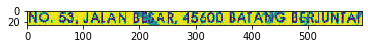

reading line : 1263
336,332,645,332,645,357,336,357,SELANGOR DARUL EHSAN



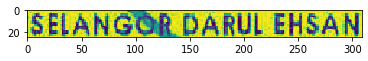

reading line : 1264
241,367,468,367,468,392,241,392,TEL : 03-3271 9872



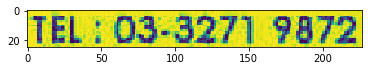

reading line : 1265
502,369,737,369,737,391,502,391,FAX : 03-3271 9481



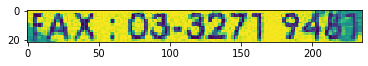

reading line : 1266
301,399,684,399,684,431,301,431,GST NO. : 000689913856



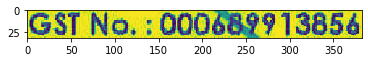

reading line : 1267
199,487,804,487,804,525,199,525,SIMPLIFIED TAX INVOICE



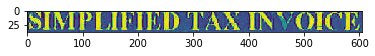

reading line : 1268
88,577,261,577,261,634,88,634,CASH



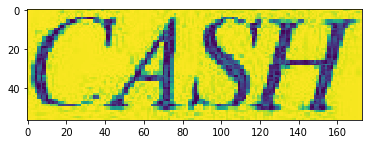

reading line : 1269
85,683,558,683,558,724,85,724,RECEIPT NO. : CS1801/26874



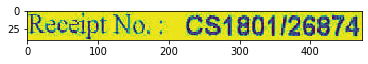

reading line : 1270
168,2355,808,2355,808,2392,168,2392,GOODS SOLD ARE NOT RETURNABLE,



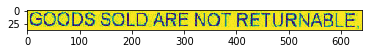

reading line : 1271
600,687,913,687,913,721,600,721,DATE : 18/01/2018



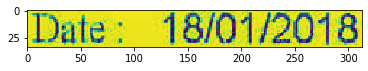

reading line : 1272
384,2402,590,2402,590,2435,384,2435,THANK YOU.



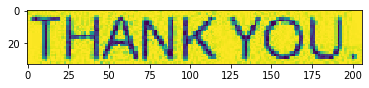

reading line : 1273
128,784,241,784,241,820,128,820,ITEM



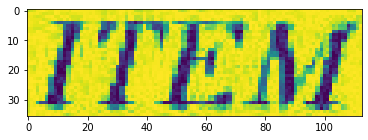

reading line : 1274
327,785,413,785,413,828,327,828,QTY



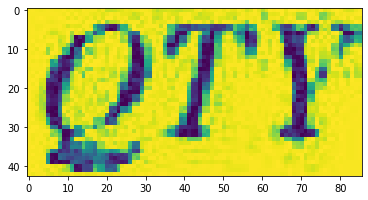

reading line : 1275
450,786,523,786,523,820,450,820,U/P



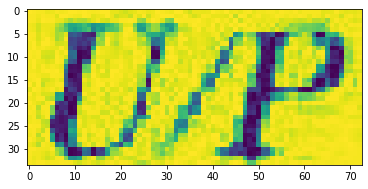

reading line : 1276
559,787,695,787,695,822,559,822,DISC%



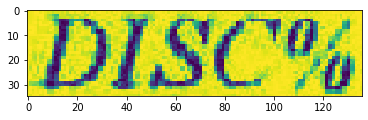

reading line : 1277
748,771,918,771,918,801,748,801,AMOUNT



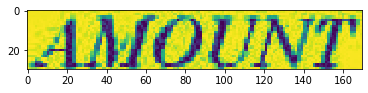

reading line : 1278
788,806,876,806,876,845,788,845,(RM)



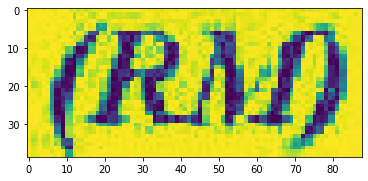

reading line : 1279
65,878,282,878,282,909,65,909,9557068000035



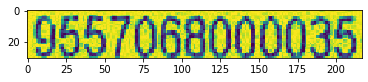

reading line : 1280
353,881,373,881,373,912,353,912,1



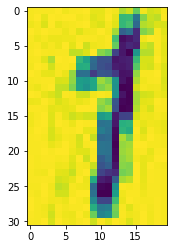

reading line : 1281
447,878,524,878,524,912,447,912,3.50



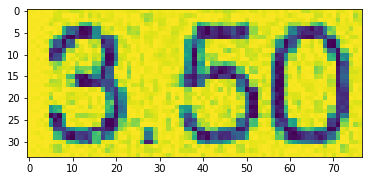

reading line : 1282
581,879,658,879,658,911,581,911,5.69



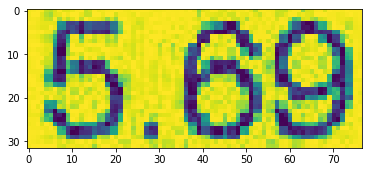

reading line : 1283
807,880,910,880,910,912,807,912,3.30 *



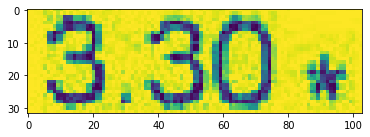

reading line : 1284
84,935,747,935,747,969,84,969,- JIANYU STELL RULER 30CM THICK



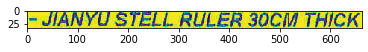

reading line : 1285
66,1015,86,1015,86,1048,66,1048,1



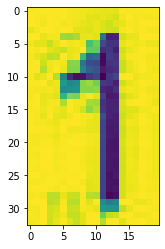

reading line : 1286
353,1016,372,1016,372,1050,353,1050,1



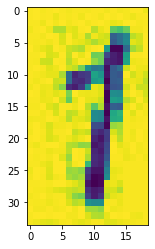

reading line : 1287
449,1015,525,1015,525,1047,449,1047,1.30



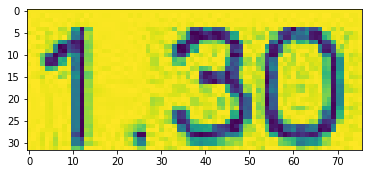

reading line : 1288
580,1015,657,1015,657,1049,580,1049,0.00



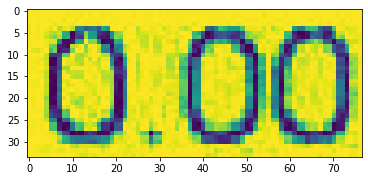

reading line : 1289
809,1014,908,1014,908,1050,809,1050,1.30 *



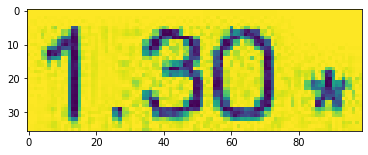

reading line : 1290
80,1074,401,1074,401,1106,80,1106,- LAMINATE FILM



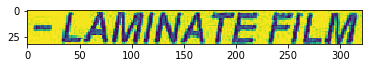

reading line : 1291
70,1189,264,1189,264,1231,70,1231,TOTAL QTY. :



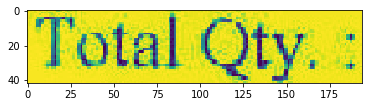

reading line : 1292
392,1191,412,1191,412,1223,392,1223,2



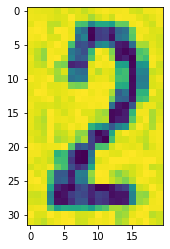

reading line : 1293
809,1190,887,1190,887,1223,809,1223,4.60



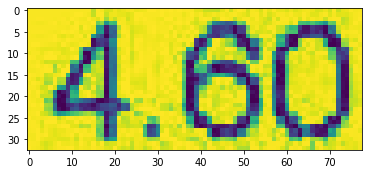

reading line : 1294
74,1287,396,1287,396,1326,74,1326,SUB-TOTAL (EX)



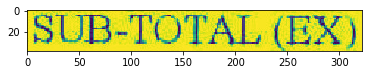

reading line : 1295
544,1291,564,1291,564,1321,544,1321,:



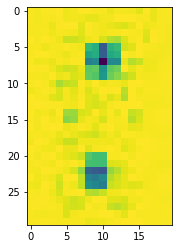

reading line : 1296
812,1287,887,1287,887,1319,812,1319,4.60



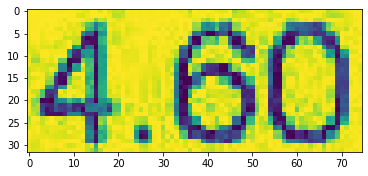

reading line : 1297
73,1346,303,1346,303,1382,73,1382,TOTAL TAX



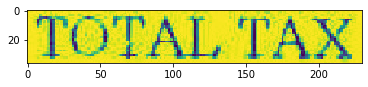

reading line : 1298
544,1352,562,1352,562,1377,544,1377,:



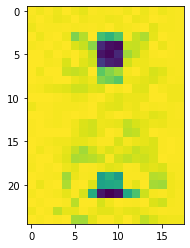

reading line : 1299
810,1346,886,1346,886,1379,810,1379,0.28



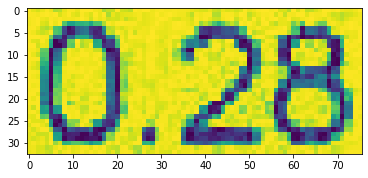

reading line : 1300
72,1406,294,1406,294,1441,72,1441,ROUNDING



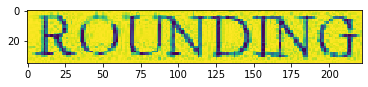

reading line : 1301
545,1410,562,1410,562,1438,545,1438,:



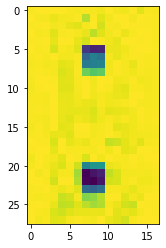

reading line : 1302
809,1405,888,1405,888,1438,809,1438,0.02



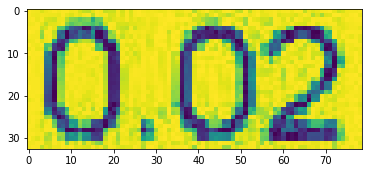

reading line : 1303
73,1462,252,1462,252,1506,73,1506,TOTAL



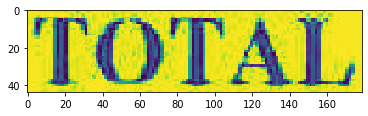

reading line : 1304
544,1472,562,1472,562,1501,544,1501,:



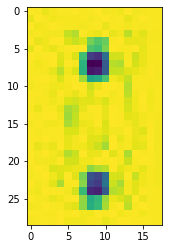

reading line : 1305
780,1467,883,1467,883,1511,780,1511,4.90



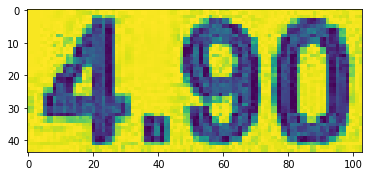

reading line : 1306
71,1524,214,1524,214,1567,71,1567,CASH



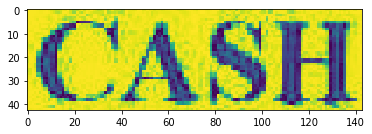

reading line : 1307
544,1530,561,1530,561,1561,544,1561,:



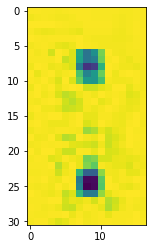

reading line : 1308
780,1526,883,1526,883,1569,780,1569,4.90



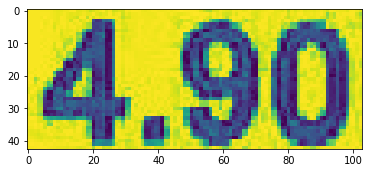

reading line : 1309
72,1594,294,1594,294,1635,72,1635,CHANGE



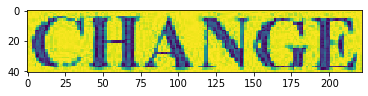

reading line : 1310
544,1605,559,1605,559,1632,544,1632,:



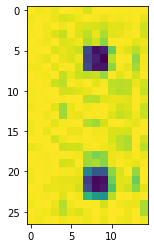

reading line : 1311
780,1595,881,1595,881,1637,780,1637,0.00



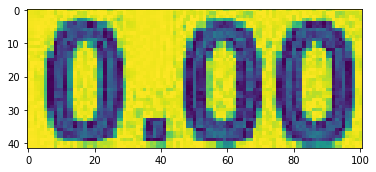

reading line : 1312
344,1810,675,1810,675,1853,344,1853,GST SUMMARY



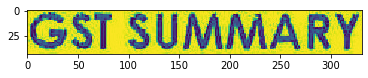

reading line : 1313
82,1908,270,1908,270,1939,82,1939,TAX CODE



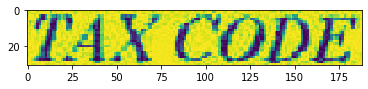

reading line : 1314
365,1908,401,1908,401,1945,365,1945,%



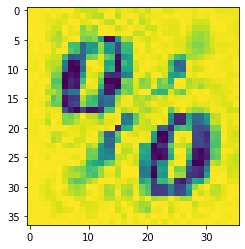

reading line : 1315
532,1891,702,1891,702,1924,532,1924,AMOUNT



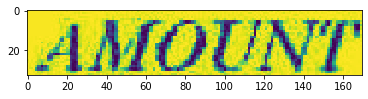

reading line : 1316
814,1893,890,1893,890,1925,814,1925,TAX



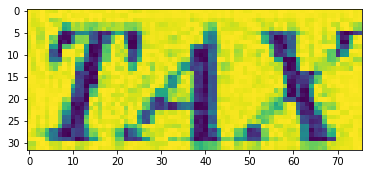

reading line : 1317
574,1928,656,1928,656,1966,574,1966,(RM)



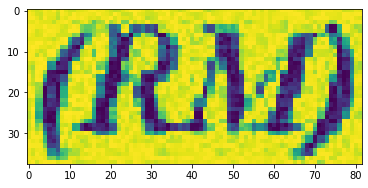

reading line : 1318
802,1929,887,1929,887,1968,802,1968,(RM)



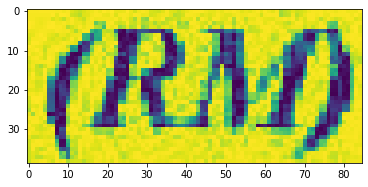

reading line : 1319
97,2012,150,2012,150,2044,97,2044,SR



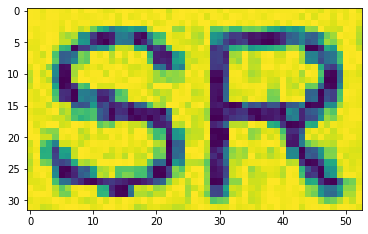

reading line : 1320
353,2013,429,2013,429,2046,353,2046,6.00



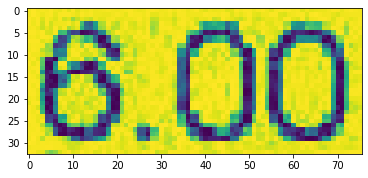

reading line : 1321
589,2015,666,2015,666,2047,589,2047,4.60



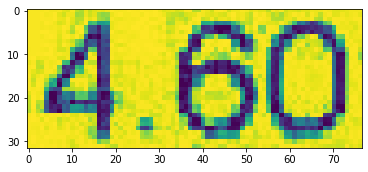

reading line : 1322
801,2016,878,2016,878,2049,801,2049,0.28



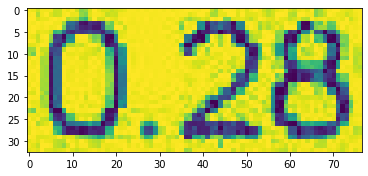

reading line : 1323
63,2114,218,2114,218,2151,63,2151,TOTAL :



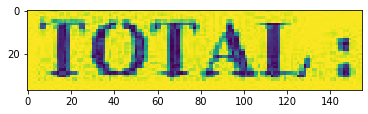

reading line : 1324
585,2116,663,2116,663,2150,585,2150,4.60



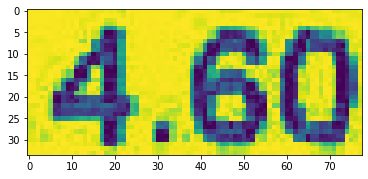

reading line : 1325
802,2117,882,2117,882,2153,802,2153,0.28



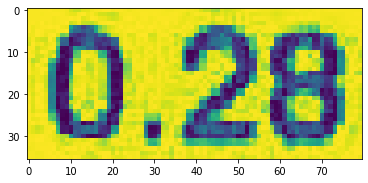

reading line : 1326
71,2213,886,2213,886,2250,71,2250,NOTE: (*) INDICATED THE ITEM SOLD HAS BEEN RELATED



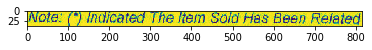

reading line : 1327
73,2253,592,2253,592,2294,73,2294,TO GST (GOODS & SERVICES TAX).



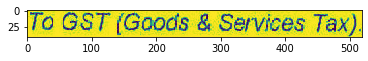

...... processing for X51005361895.jpg
reading corresponding text
reading line : 1328
254,100,721,100,721,144,254,144,FUYI MINI MARKET



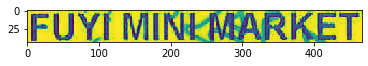

reading line : 1329
330,149,659,149,659,185,330,185,BR NO.: 0195932-X



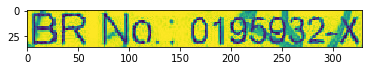

reading line : 1330
368,191,609,191,609,226,368,226,NO 43-45-47G,



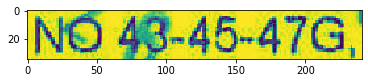

reading line : 1331
363,230,612,230,612,269,363,269,TAMAN SEJATI,



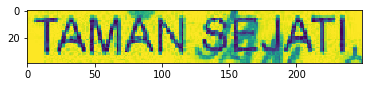

reading line : 1332
268,269,707,269,707,303,268,303,IJOK, 45600 BESTARI JAYA,



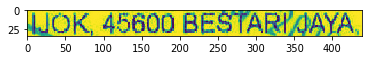

reading line : 1333
326,308,648,308,648,342,326,342,KUALA SELANGOR.



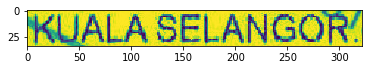

reading line : 1334
373,361,601,361,601,398,373,398,03-3279 1851,



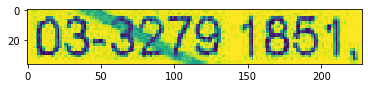

reading line : 1335
292,421,685,421,685,453,292,453,GST NO.:001601310720



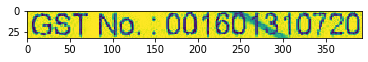

reading line : 1336
292,501,686,501,686,537,292,537,25/01/2018 1:22:56PM



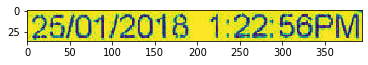

reading line : 1337
358,566,624,566,624,604,358,604,TAX INVOICE



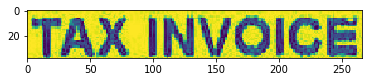

reading line : 1338
105,645,537,645,537,690,105,690,TRN: 1CR0576494



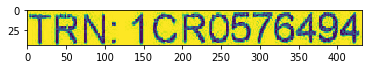

reading line : 1339
100,719,339,719,339,757,100,757,COUNTER 1



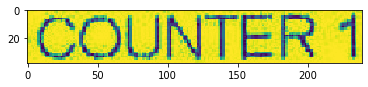

reading line : 1340
547,718,876,718,876,754,547,754,CASHIER: HOCK



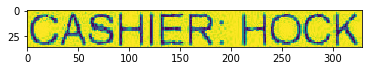

reading line : 1341
101,797,865,797,865,842,101,842,QTY UOM U.PRICE AMT AMT INC. TAX CODE



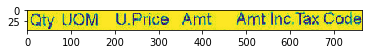

reading line : 1342
103,857,627,857,627,892,103,892,013 SUMMER CUP 48X230ML



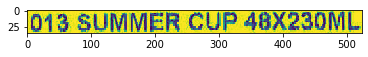

reading line : 1343
117,909,139,909,139,941,117,941,1



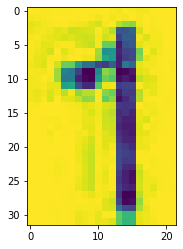

reading line : 1344
101,963,386,963,386,994,101,994,GST 6% + 0.51



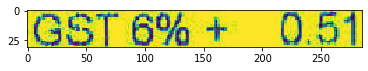

reading line : 1345
105,1043,388,1043,388,1086,105,1086,*TOTAL QTY: 1.00



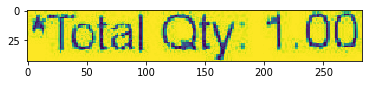

reading line : 1346
104,1106,558,1106,558,1150,104,1150,TOTAL INCLUDES GST 6%



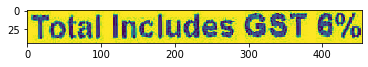

reading line : 1347
103,1172,488,1172,488,1210,103,1210,CUSTOMER'S PAYMENT



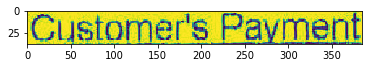

reading line : 1348
106,1234,207,1234,207,1272,106,1272,CASH



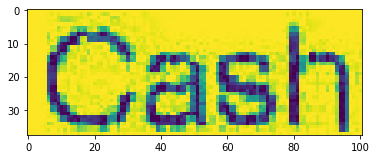

reading line : 1349
108,1292,257,1292,257,1334,108,1334,CHANGE



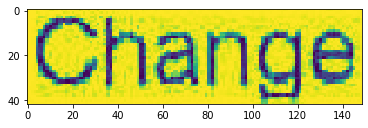

reading line : 1350
109,1361,363,1361,363,1401,109,1401,GST SUMMARY



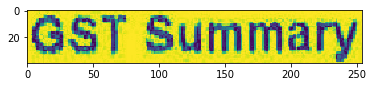

reading line : 1351
793,1042,878,1042,878,1074,793,1074,9.00



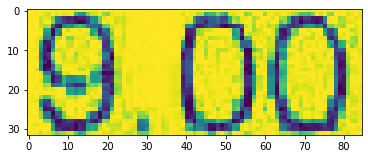

reading line : 1352
793,1105,879,1105,879,1143,793,1143,9.00



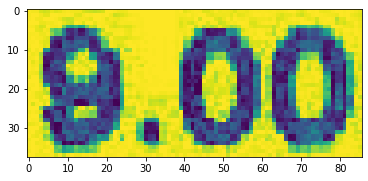

reading line : 1353
770,1231,880,1231,880,1266,770,1266,50.00



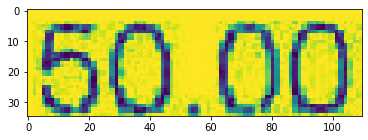

reading line : 1354
769,1286,880,1286,880,1325,769,1325,41.00



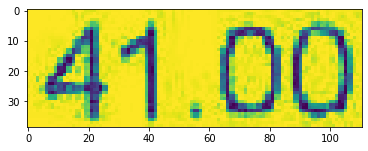

reading line : 1355
108,1360,363,1360,363,1402,108,1402,GST SUMMARY



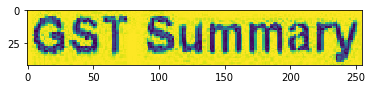

reading line : 1356
109,1424,160,1424,160,1457,109,1457,SR



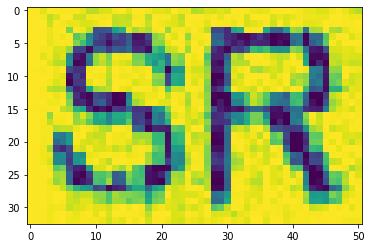

reading line : 1357
208,1478,788,1478,788,1517,208,1517,*GOODS SOLD ARE NOT RETURNABLE



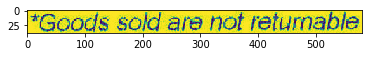

reading line : 1358
148,1529,849,1529,849,1573,148,1573,THANK YOU FOR SHOPPING AT FUYI MINI



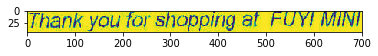

reading line : 1359
408,1575,588,1575,588,1612,408,1612,MARKET



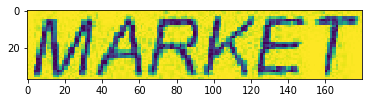

reading line : 1360
201,907,294,907,294,938,201,938,KOTA



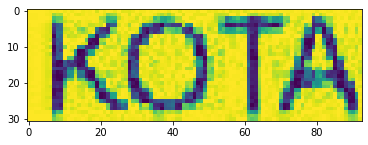

reading line : 1361
313,908,389,908,389,939,313,939,8.49



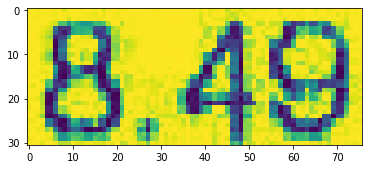

reading line : 1362
437,907,515,907,515,939,437,939,8.49



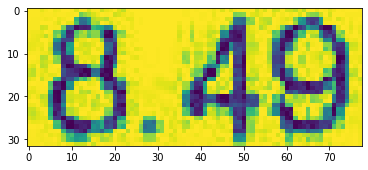

reading line : 1363
632,906,708,906,708,937,632,937,9.00



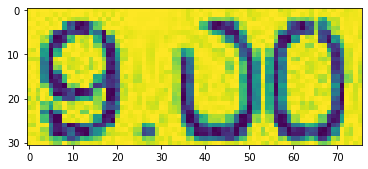

reading line : 1364
819,906,873,906,873,937,819,937,SR



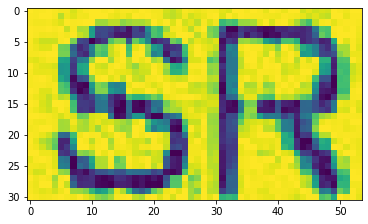

reading line : 1365
531,1358,672,1358,672,1394,531,1394,AMOUNT



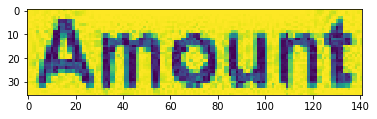

reading line : 1366
808,1356,873,1356,873,1392,808,1392,TAX



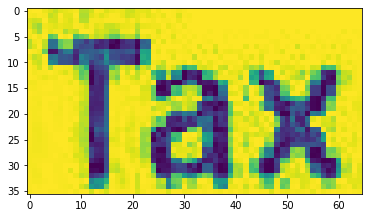

reading line : 1367
601,1419,672,1419,672,1452,601,1452,8.49



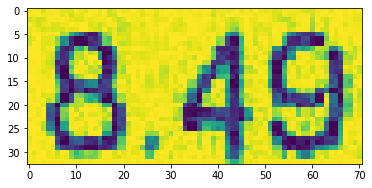

reading line : 1368
801,1418,870,1418,870,1452,801,1452,0.51



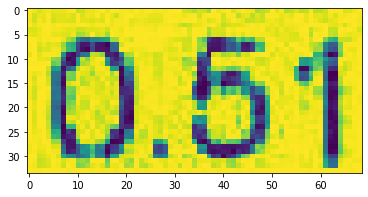

...... processing for X51005361897.jpg
reading corresponding text
reading line : 1369
313,44,1044,44,1044,102,313,102,TEO HENG STATIONERY & BOOKS



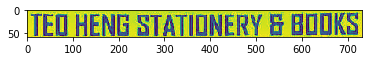

reading line : 1370
583,104,776,104,776,133,583,133,(001451637-M)



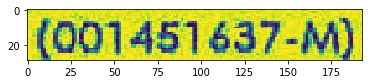

reading line : 1371
381,141,977,141,977,169,381,169,NO. 53, JALAN BESAR, 45600 BATANG BERJUNTAI



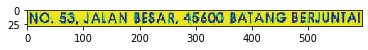

reading line : 1372
525,178,832,178,832,205,525,205,SELANGOR DARUL EHSAN



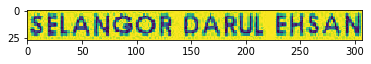

reading line : 1373
428,212,655,212,655,235,428,235,TEL : 03-3271 9872



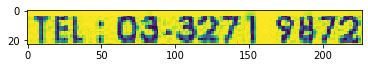

reading line : 1374
481,246,876,246,876,276,481,276,GST NO. : 000689913856



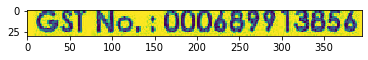

reading line : 1375
387,329,993,329,993,367,387,367,SIMPLIFIED TAX INVOICE



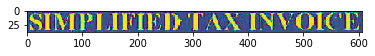

reading line : 1376
275,423,450,423,450,477,275,477,CASH



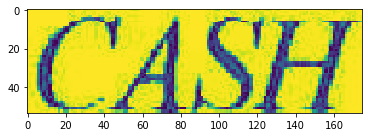

reading line : 1377
275,531,743,531,743,572,275,572,RECEIPT NO. : CS1801/26821



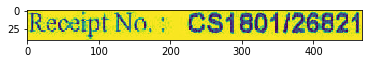

reading line : 1378
793,528,1101,528,1101,563,793,563,DATE : 17/01/2018



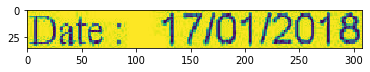

reading line : 1379
320,630,432,630,432,665,320,665,ITEM



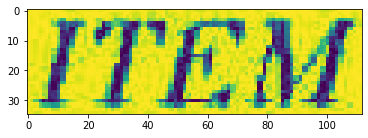

reading line : 1380
518,629,607,629,607,675,518,675,QTY



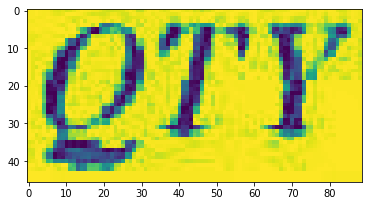

reading line : 1381
642,629,713,629,713,665,642,665,U/P



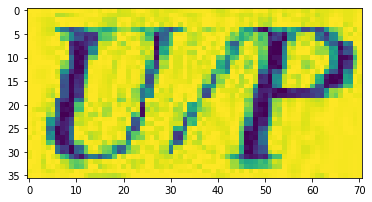

reading line : 1382
751,629,886,629,886,665,751,665,DISC%



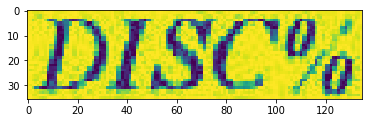

reading line : 1383
936,613,1111,613,1111,644,936,644,AMOUNT



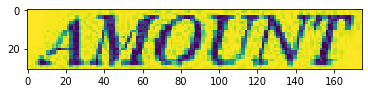

reading line : 1384
257,722,473,722,473,755,257,755,9555017370017



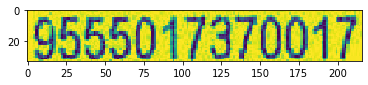

reading line : 1385
546,725,568,725,568,754,546,754,1



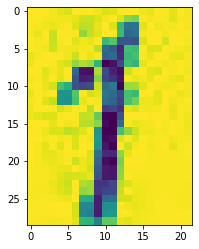

reading line : 1386
616,722,715,722,715,755,616,755,28.00



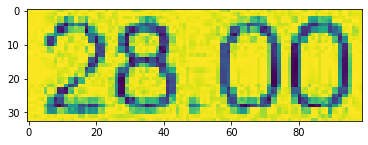

reading line : 1387
773,720,850,720,850,754,773,754,7.14



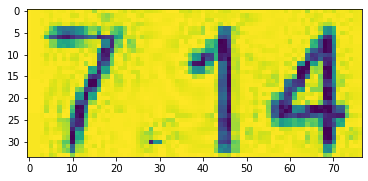

reading line : 1388
978,721,1101,721,1101,756,978,756,26.00 *



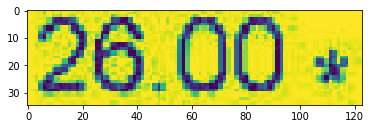

reading line : 1389
274,781,970,781,970,813,274,813,- LION FILE 220*307 LAMINATING FILM



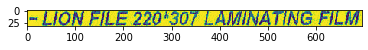

reading line : 1390
265,898,459,898,459,942,265,942,TOTAL QTY. :



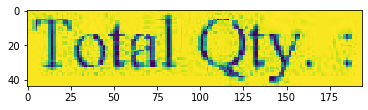

reading line : 1391
584,895,607,895,607,931,584,931,1



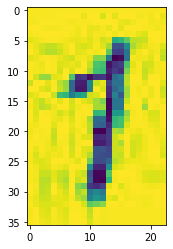

reading line : 1392
981,892,1080,892,1080,927,981,927,26.00



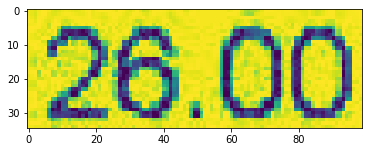

reading line : 1393
270,995,587,995,587,1031,270,1031,SUB-TOTAL (EX)



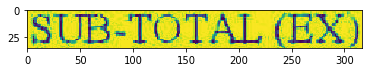

reading line : 1394
742,1001,756,1001,756,1024,742,1024,:



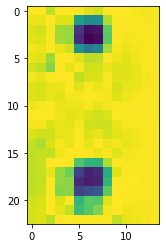

reading line : 1395
981,989,1079,989,1079,1024,981,1024,26.00



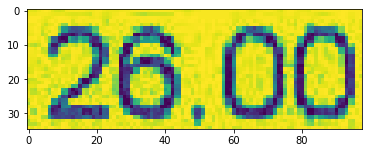

reading line : 1396
268,1055,495,1055,495,1090,268,1090,TOTAL TAX



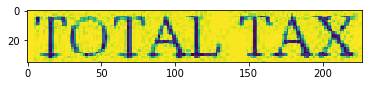

reading line : 1397
739,1057,757,1057,757,1086,739,1086,:



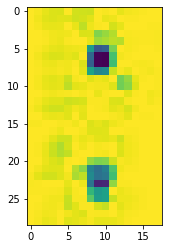

reading line : 1398
1004,1051,1081,1051,1081,1083,1004,1083,1.56



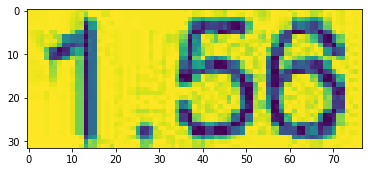

reading line : 1399
271,1114,489,1114,489,1148,271,1148,ROUNDING



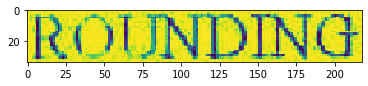

reading line : 1400
742,1115,757,1115,757,1144,742,1144,:



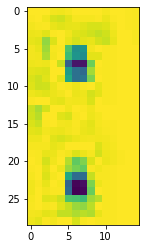

reading line : 1401
992,1110,1078,1110,1078,1144,992,1144,-0.01



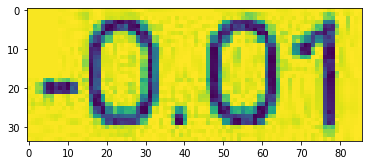

reading line : 1402
268,1173,447,1173,447,1215,268,1215,TOTAL



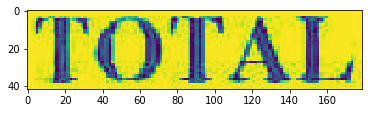

reading line : 1403
742,1178,757,1178,757,1211,742,1211,:



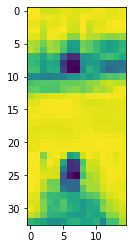

reading line : 1404
945,1171,1077,1171,1077,1214,945,1214,27.55



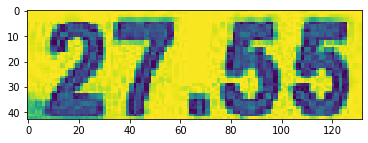

reading line : 1405
266,1234,410,1234,410,1275,266,1275,CASH



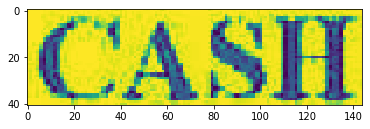

reading line : 1406
742,1239,755,1239,755,1267,742,1267,:



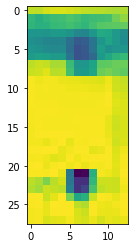

reading line : 1407
947,1229,1076,1229,1076,1274,947,1274,27.55



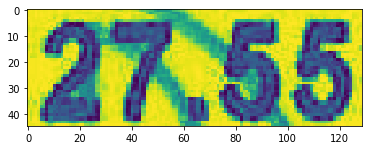

reading line : 1408
268,1303,492,1303,492,1343,268,1343,CHANGE



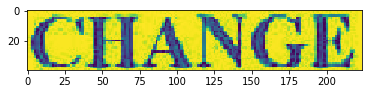

reading line : 1409
739,1311,757,1311,757,1340,739,1340,:



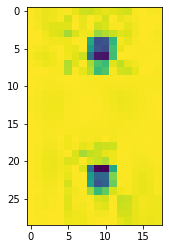

reading line : 1410
976,1300,1078,1300,1078,1343,976,1343,0.00



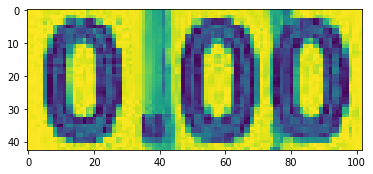

reading line : 1411
541,1514,870,1514,870,1557,541,1557,GST SUMMARY



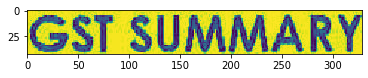

reading line : 1412
278,1618,467,1618,467,1647,278,1647,TAX CODE



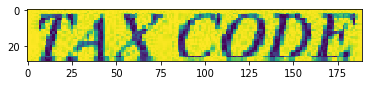

reading line : 1413
564,1618,598,1618,598,1649,564,1649,%



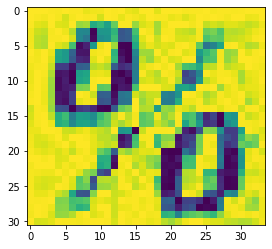

reading line : 1414
732,1598,900,1598,900,1634,732,1634,AMOUNT



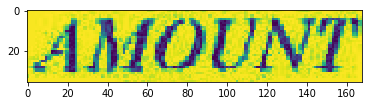

reading line : 1415
1011,1595,1088,1595,1088,1631,1011,1631,TAX



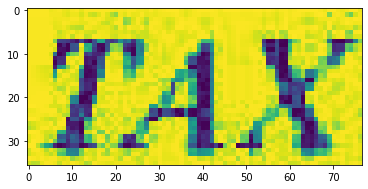

reading line : 1416
295,1722,348,1722,348,1752,295,1752,SR



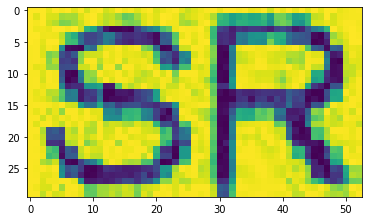

reading line : 1417
551,1721,628,1721,628,1751,551,1751,6.00



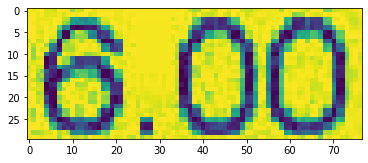

reading line : 1418
767,1720,863,1720,863,1752,767,1752,26.00



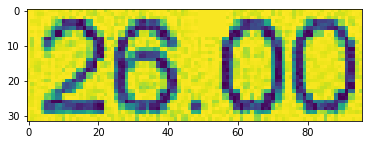

reading line : 1419
1000,1717,1078,1717,1078,1752,1000,1752,1.56



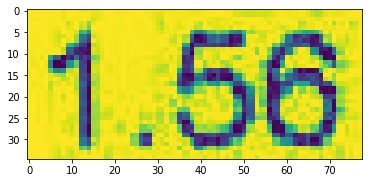

reading line : 1420
263,1825,415,1825,415,1859,263,1859,TOTAL:



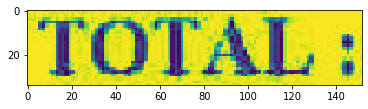

reading line : 1421
767,1823,865,1823,865,1859,767,1859,26.00



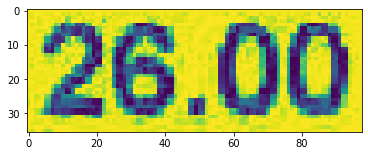

reading line : 1422
1003,1821,1081,1821,1081,1856,1003,1856,1.56



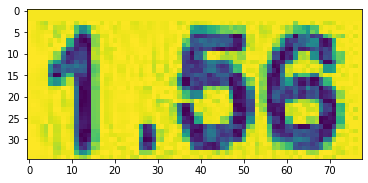

reading line : 1423
267,1921,1084,1921,1084,1959,267,1959,NOTE: (*) INDICATED THE ITEM SOLD HAS BEEN RELATED



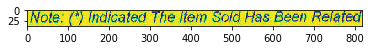

reading line : 1424
273,1961,787,1961,787,2000,273,2000,TO GST (GOODS & SERVICES TAX)



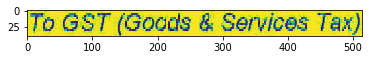

reading line : 1425
372,2061,1009,2061,1009,2099,372,2099,GOODS SOLD ARE NOT RETURNABLE,



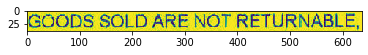

reading line : 1426
585,2109,794,2109,794,2143,585,2143,THANK YOU.



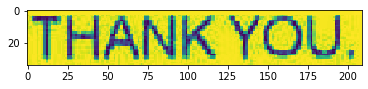

reading line : 1427
690,213,924,213,924,237,690,237,FAX : 03-3271 9481



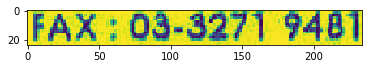

reading line : 1428
977,650,1066,650,1066,687,977,687,(RM)



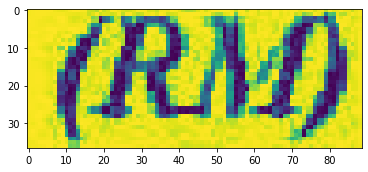

reading line : 1429
773,1634,856,1634,856,1673,773,1673,(RM)



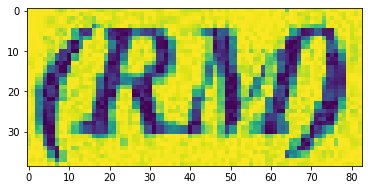

reading line : 1430
1000,1635,1084,1635,1084,1674,1000,1674,(RM)



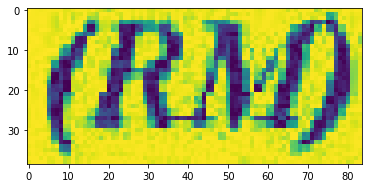

...... processing for X51005361898.jpg
reading corresponding text
reading line : 1431
141,445,861,445,861,505,141,505,TEO HENG STATIONERY & BOOKS



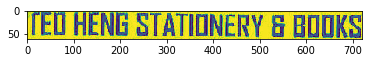

reading line : 1432
407,508,599,508,599,538,407,538,(001451637-M)



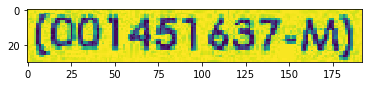

reading line : 1433
204,542,802,542,802,571,204,571,NO. 53, JALAN BESAR, 45600 BATANG BERJUNTAI



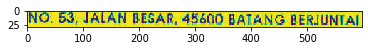

reading line : 1434
344,581,655,581,655,607,344,607,SELANGOR DARUL EHSAN



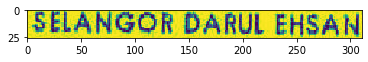

reading line : 1435
251,613,477,613,477,637,251,637,TEL : 03-3271 9872



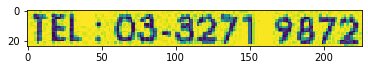

reading line : 1436
310,644,696,644,696,678,310,678,GST NO. : 000689913856



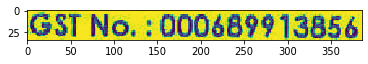

reading line : 1437
208,732,812,732,812,775,208,775,SIMPLIFIED TAX INVOICE



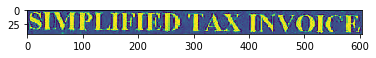

reading line : 1438
96,826,269,826,269,879,96,879,CASH



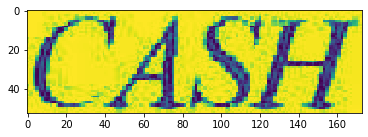

reading line : 1439
93,930,568,930,568,967,93,967,RECEIPT NO. : CS1801/26717



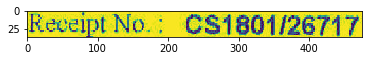

reading line : 1440
138,1034,249,1034,249,1067,138,1067,ITEM



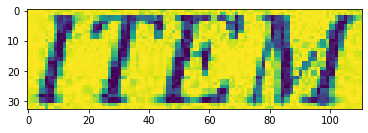

reading line : 1441
335,1033,423,1033,423,1076,335,1076,QTY



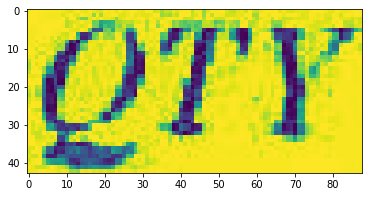

reading line : 1442
459,1035,530,1035,530,1068,459,1068,U/P



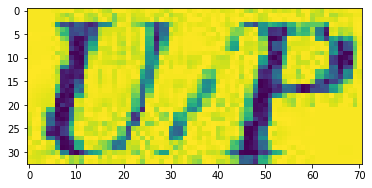

reading line : 1443
570,1036,704,1036,704,1074,570,1074,DISC%



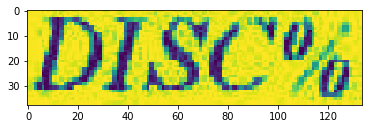

reading line : 1444
753,1020,927,1020,927,1054,753,1054,AMOUNT



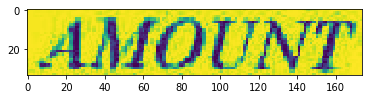

reading line : 1445
73,1128,288,1128,288,1161,73,1161,9556655864036



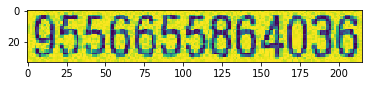

reading line : 1446
360,1129,380,1129,380,1162,360,1162,1



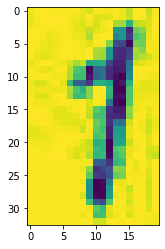

reading line : 1447
431,1128,531,1128,531,1161,431,1161,26.42



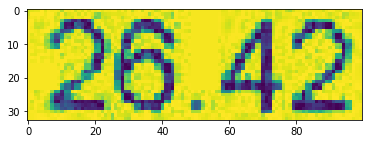

reading line : 1448
589,1127,667,1127,667,1163,589,1163,9.14



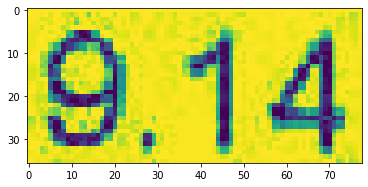

reading line : 1449
794,1132,918,1132,918,1164,794,1164,24.00 *



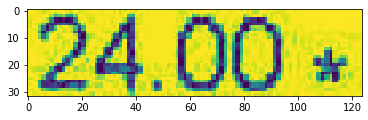

reading line : 1450
91,1184,586,1184,586,1219,91,1219,- CBE BADGE CLIP 100PCS



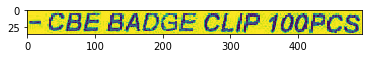

reading line : 1451
73,1265,289,1265,289,1299,73,1299,9555535000663



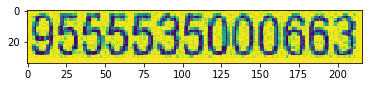

reading line : 1452
361,1267,380,1267,380,1297,361,1297,1



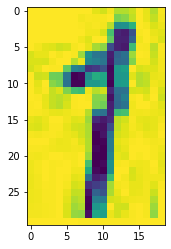

reading line : 1453
431,1263,528,1263,528,1297,431,1297,28.00



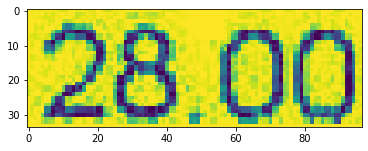

reading line : 1454
589,1269,665,1269,665,1298,589,1298,0.00



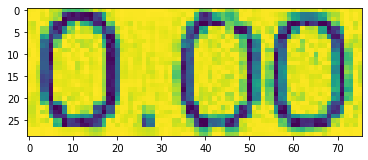

reading line : 1455
793,1268,916,1268,916,1302,793,1302,28.00 *



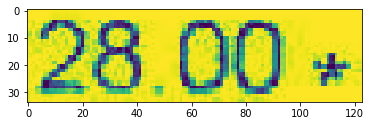

reading line : 1456
89,1321,604,1321,604,1359,89,1359,- NISO A4 LAMINATING FILM



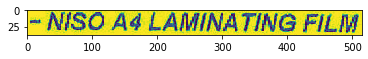

reading line : 1457
76,1438,272,1438,272,1481,76,1481,TOTAL QTY. :



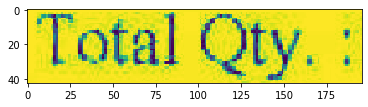

reading line : 1458
396,1437,417,1437,417,1470,396,1470,2



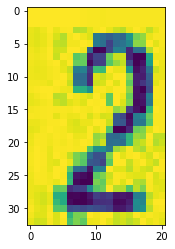

reading line : 1459
795,1440,895,1440,895,1473,795,1473,52.00



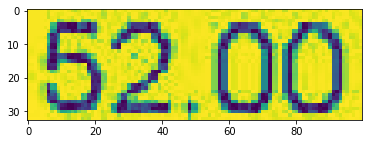

reading line : 1460
81,1537,398,1537,398,1574,81,1574,SUB-TOTAL (EX)



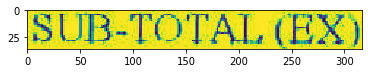

reading line : 1461
552,1542,569,1542,569,1573,552,1573,:



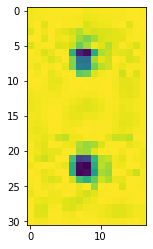

reading line : 1462
793,1540,896,1540,896,1577,793,1577,52.00



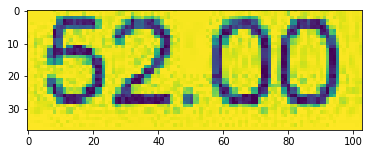

reading line : 1463
73,1591,303,1591,303,1636,73,1636,TOTAL TAX



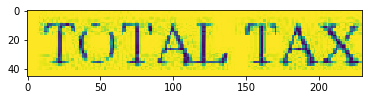

reading line : 1464
549,1602,573,1602,573,1633,549,1633,:



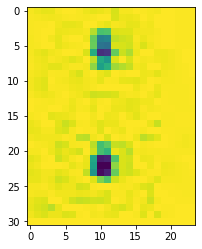

reading line : 1465
807,1598,889,1598,889,1633,807,1633,3.12



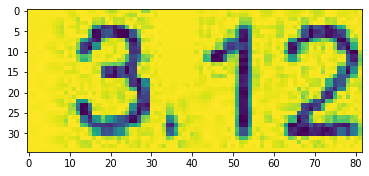

reading line : 1466
78,1654,304,1654,304,1695,78,1695,ROUNDING



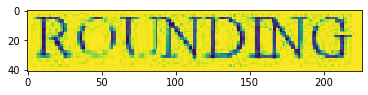

reading line : 1467
546,1663,578,1663,578,1684,546,1684,:



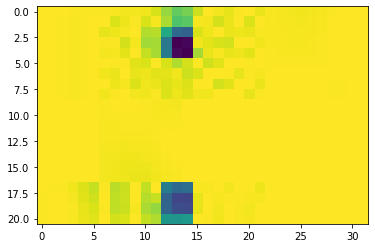

reading line : 1468
800,1656,896,1656,896,1691,800,1691,-0.02



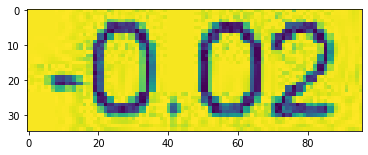

reading line : 1469
76,1707,267,1707,267,1758,76,1758,TOTAL



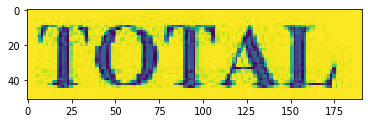

reading line : 1470
538,1722,572,1722,572,1759,538,1759,:



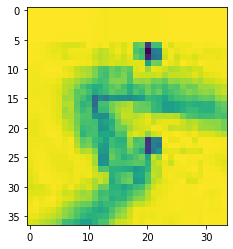

reading line : 1471
744,1717,887,1717,887,1765,744,1765,55.10



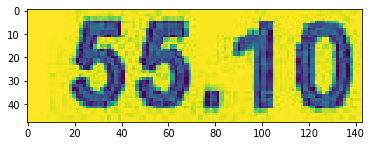

reading line : 1472
72,1773,222,1773,222,1825,72,1825,CASH



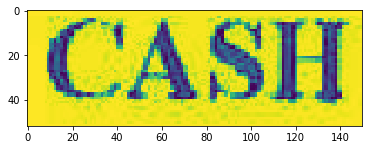

reading line : 1473
539,1783,573,1783,573,1808,539,1808,:



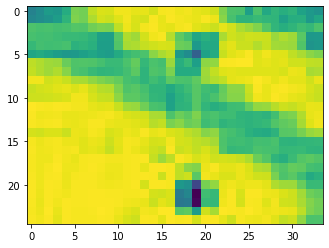

reading line : 1474
748,1779,886,1779,886,1834,748,1834,55.10



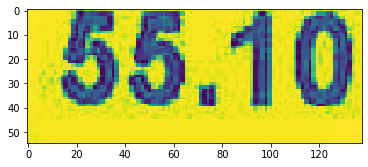

reading line : 1475
76,1835,295,1835,295,1890,76,1890,CHANGE



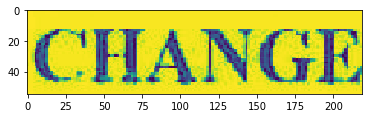

reading line : 1476
543,1849,566,1849,566,1881,543,1881,:



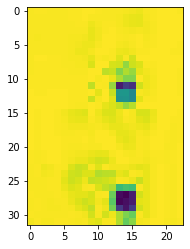

reading line : 1477
785,1838,887,1838,887,1900,785,1900,0.00



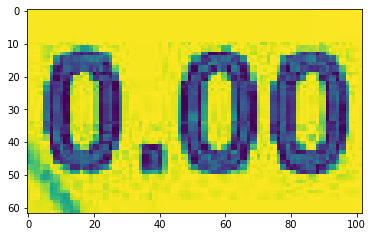

reading line : 1478
346,2050,679,2050,679,2104,346,2104,GST SUMMARY



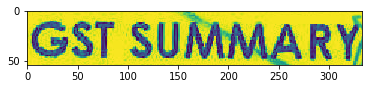

reading line : 1479
79,2146,274,2146,274,2197,79,2197,TAX CODE



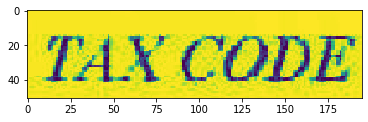

reading line : 1480
367,2157,402,2157,402,2199,367,2199,%



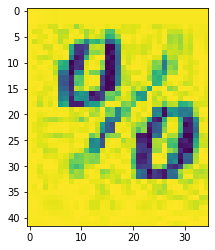

reading line : 1481
534,2141,713,2141,713,2226,534,2226,AMOUNT(RM)



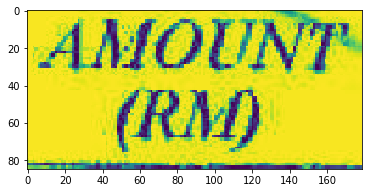

reading line : 1482
805,2144,900,2144,900,2217,805,2217,TAX(RM)



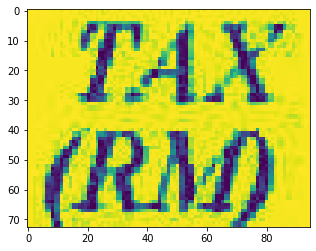

reading line : 1483
96,2263,157,2263,157,2297,96,2297,SR



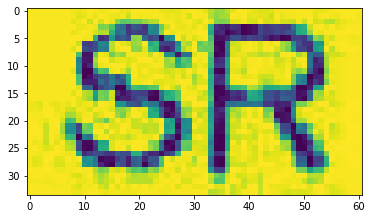

reading line : 1484
356,2261,432,2261,432,2301,356,2301,6.00



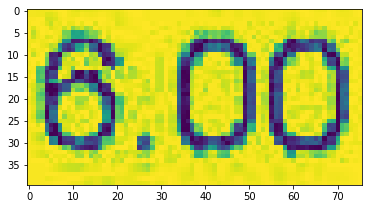

reading line : 1485
563,2261,683,2261,683,2310,563,2310,52.00



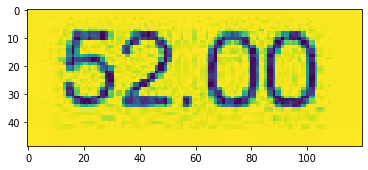

reading line : 1486
806,2264,894,2264,894,2308,806,2308,3.12S



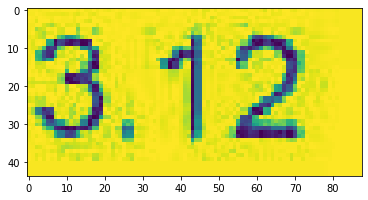

reading line : 1487
52,2367,220,2367,220,2401,52,2401,TOTAL :



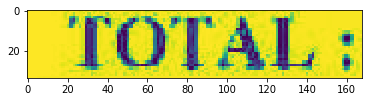

reading line : 1488
567,2359,686,2359,686,2407,567,2407,52.00



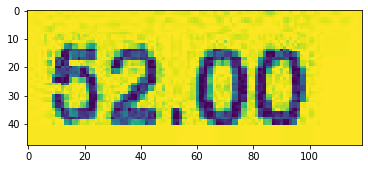

reading line : 1489
812,2367,888,2367,888,2404,812,2404,3.12



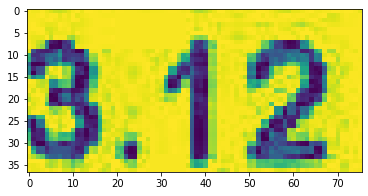

reading line : 1490
71,2459,890,2459,890,2499,71,2499,NOTE:(*) INDICATED THE ITEM SOLD HAS BEEN RELATED



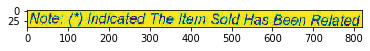

reading line : 1491
72,2494,600,2494,600,2542,72,2542,TO GST (GOODS & SERVICES TAX)



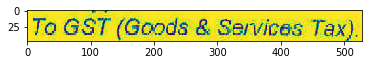

reading line : 1492
169,2603,811,2603,811,2643,169,2643,GOODS SOLD ARE NOT RETURNABLE,



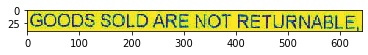

reading line : 1493
385,2647,600,2647,600,2698,385,2698,THANK YOU.



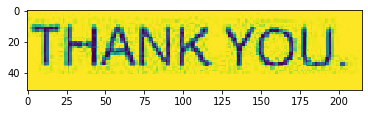

reading line : 1494
512,615,747,615,747,639,512,639,FAX : 03-3271 9481



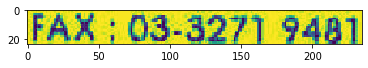

reading line : 1495
609,935,921,935,921,968,609,968,DATE : 15/01/2018



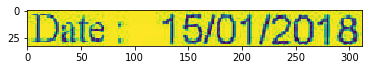

reading line : 1496
798,1059,882,1059,882,1097,798,1097,(RM)



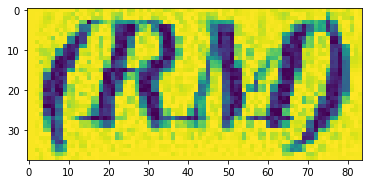

...... processing for X51005361900(1).jpg
reading corresponding text
reading line : 1497
723,557,1451,557,1451,618,723,618,TEO HENG STATIONERY & BOOKS



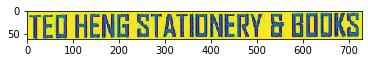

reading line : 1498
995,623,1185,623,1185,651,995,651,(001451637-M)



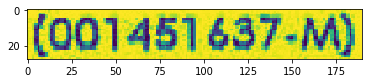

reading line : 1499
789,657,1390,657,1390,685,789,685,NO. 53, JALAN BESAR, 45600 BATANG BERJUNTAI



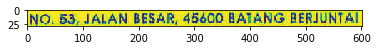

reading line : 1500
936,697,1243,697,1243,720,936,720,SELANGOR DARUL EHSAN



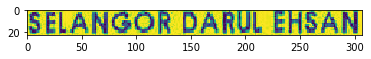

reading line : 1501
839,731,1065,731,1065,756,839,756,TEL : 03-3271 9872



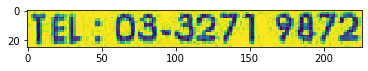

reading line : 1502
898,762,1281,762,1281,794,898,794,GST NO. : 000689913856



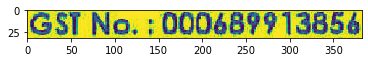

reading line : 1503
794,849,1402,849,1402,887,794,887,SIMPLIFIED TAX INVOICE



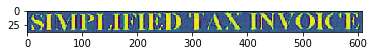

reading line : 1504
685,943,859,943,859,999,685,999,CASH



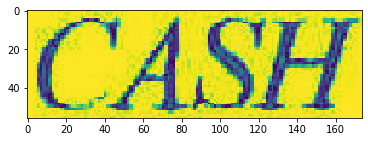

reading line : 1505
683,1049,1158,1049,1158,1090,683,1090,RECEIPT NO. : CS1801/27037



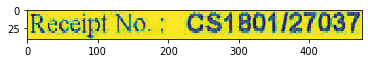

reading line : 1506
1201,1046,1513,1046,1513,1081,1201,1081,DATE : 23/01/2018



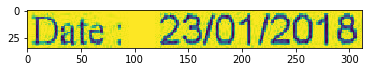

reading line : 1507
730,1151,845,1151,845,1186,730,1186,ITEM



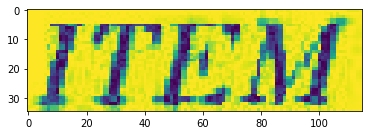

reading line : 1508
929,1147,1018,1147,1018,1194,929,1194,QTY



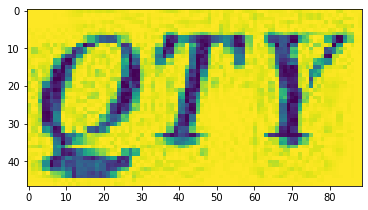

reading line : 1509
1052,1150,1126,1150,1126,1188,1052,1188,U/P



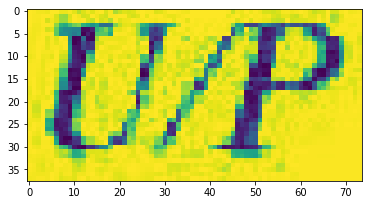

reading line : 1510
1160,1148,1298,1148,1298,1186,1160,1186,DISC%



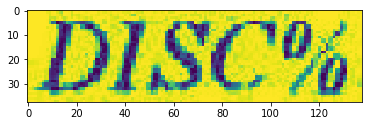

reading line : 1511
1347,1131,1516,1131,1516,1164,1347,1164,AMOUNT



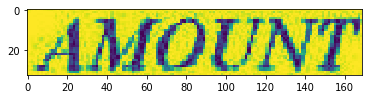

reading line : 1512
665,1245,756,1245,756,1282,665,1282,TP-24



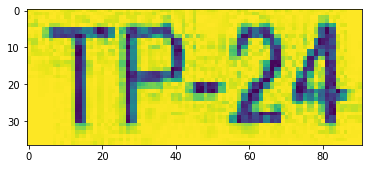

reading line : 1513
953,1242,981,1242,981,1276,953,1276,5



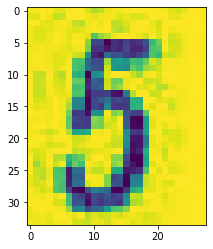

reading line : 1514
1048,1242,1130,1242,1130,1276,1048,1276,1.32



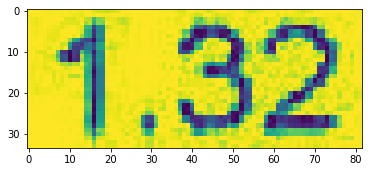

reading line : 1515
1183,1240,1262,1240,1262,1273,1183,1273,0.00



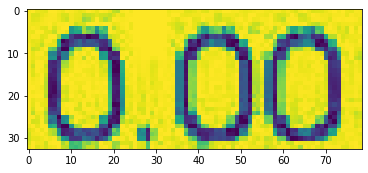

reading line : 1516
1409,1238,1510,1238,1510,1272,1409,1272,6.60 *



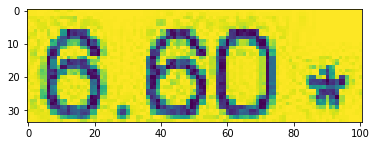

reading line : 1517
682,1298,1363,1298,1363,1338,682,1338,- DOUBLE SIDED TISSUE TAPE 18MM



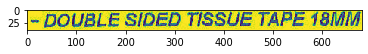

reading line : 1518
668,1381,883,1381,883,1415,668,1415,9557546631393



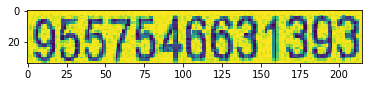

reading line : 1519
955,1379,975,1379,975,1414,955,1414,5



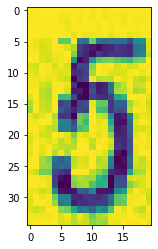

reading line : 1520
1051,1379,1130,1379,1130,1413,1051,1413,2.08



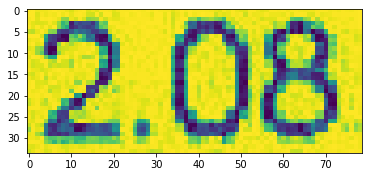

reading line : 1521
1184,1378,1261,1378,1261,1411,1184,1411,0.00



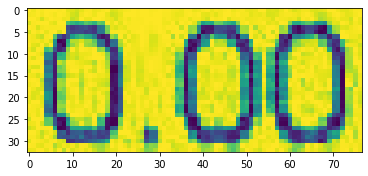

reading line : 1522
1391,1378,1510,1378,1510,1411,1391,1411,10.38 *



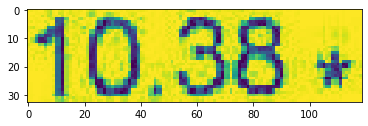

reading line : 1523
684,1434,1500,1434,1500,1477,684,1477,- G SOFT 6ML QUICK DRY CORRECTION PEN



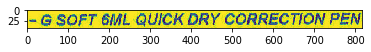

reading line : 1524
675,1554,872,1554,872,1599,675,1599,TOTAL QTY. :



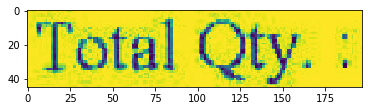

reading line : 1525
981,1554,1018,1554,1018,1588,981,1588,10



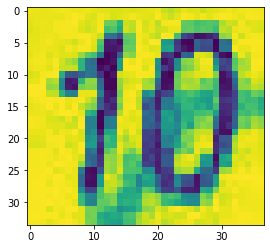

reading line : 1526
1395,1548,1492,1548,1492,1587,1395,1587,16.98



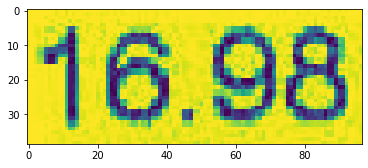

reading line : 1527
682,1655,999,1655,999,1693,682,1693,SUB-TOTAL (EX)



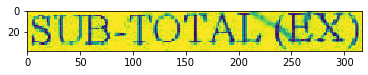

reading line : 1528
681,1714,908,1714,908,1748,681,1748,TOTAL TAX



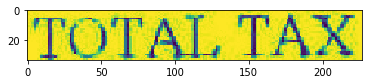

reading line : 1529
681,1773,901,1773,901,1807,681,1807,ROUNDING



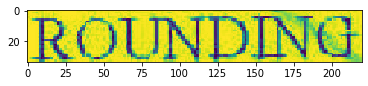

reading line : 1530
677,1831,862,1831,862,1875,677,1875,TOTAL



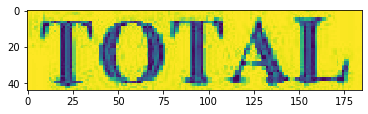

reading line : 1531
678,1895,824,1895,824,1938,678,1938,CASH



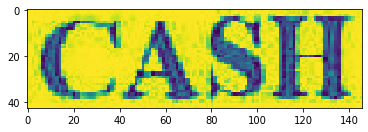

reading line : 1532
679,1961,902,1961,902,2006,679,2006,CHANGE



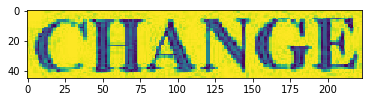

reading line : 1533
1396,1647,1492,1647,1492,1684,1396,1684,16.98



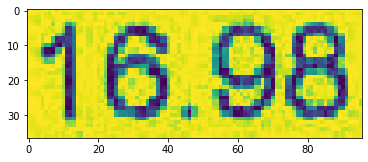

reading line : 1534
1416,1707,1492,1707,1492,1743,1416,1743,1.02



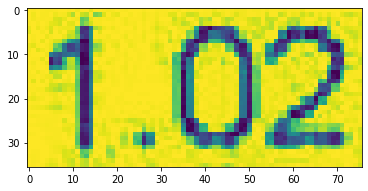

reading line : 1535
1414,1765,1493,1765,1493,1801,1414,1801,0.00



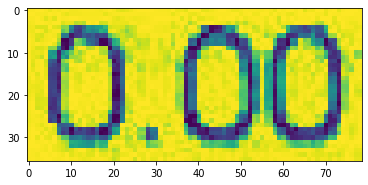

reading line : 1536
1361,1829,1488,1829,1488,1873,1361,1873,18.00



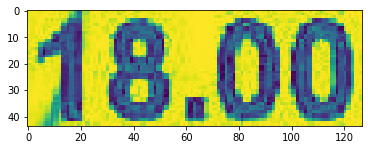

reading line : 1537
1361,1889,1491,1889,1491,1933,1361,1933,18.00



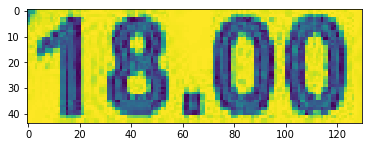

reading line : 1538
1388,1957,1491,1957,1491,2001,1388,2001,0.00



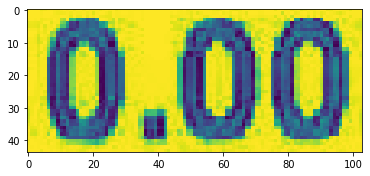

reading line : 1539
952,2174,1285,2174,1285,2214,952,2214,GST SUMMARY



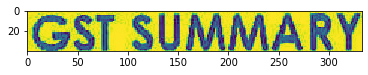

reading line : 1540
695,2275,881,2275,881,2312,695,2312,TAX CODE



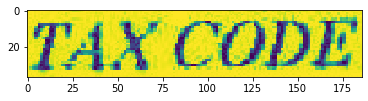

reading line : 1541
976,2274,1013,2274,1013,2309,976,2309,%



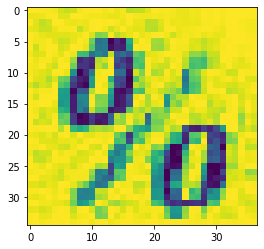

reading line : 1542
1145,2256,1317,2256,1317,2290,1145,2290,AMOUNT



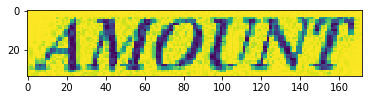

reading line : 1543
1423,2258,1503,2258,1503,2289,1423,2289,TAX



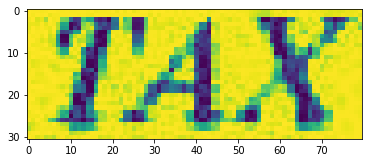

reading line : 1544
709,2384,765,2384,765,2417,709,2417,SR



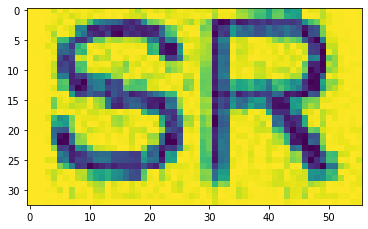

reading line : 1545
963,2380,1040,2380,1040,2411,963,2411,6.00



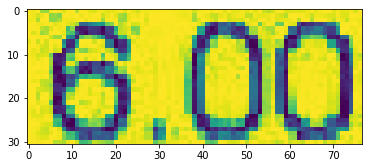

reading line : 1546
1182,2379,1281,2379,1281,2410,1182,2410,16.98



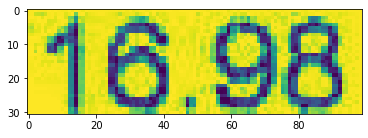

reading line : 1547
1414,2376,1493,2376,1493,2413,1414,2413,1.02



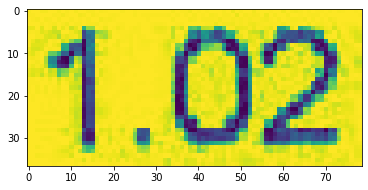

reading line : 1548
680,2487,830,2487,830,2520,680,2520,TOTAL :



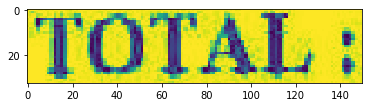

reading line : 1549
1184,2482,1281,2482,1281,2516,1184,2516,16.98



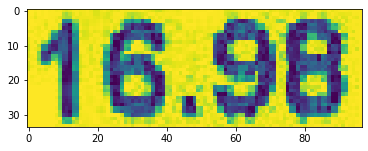

reading line : 1550
1419,2481,1496,2481,1496,2515,1419,2515,1.02



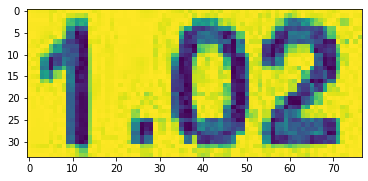

reading line : 1551
685,2579,1501,2579,1501,2622,685,2622,NOTE: (*) INDICATED THE ITEM SOLD HAS BEEN RELATED



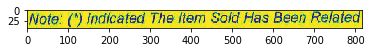

reading line : 1552
687,2623,1210,2623,1210,2662,687,2662,TO GST (GOODS & SERVICES TAX).



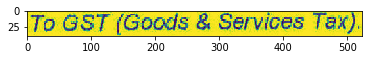

reading line : 1553
783,2720,1422,2720,1422,2757,783,2757,GOODS SOLD ARE NOT RETURNABLE,



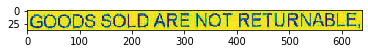

reading line : 1554
999,2768,1206,2768,1206,2802,999,2802,THANK YOU.



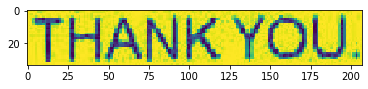

reading line : 1555
1382,1169,1497,1169,1497,1203,1382,1203,(RM)



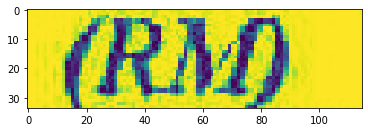

reading line : 1556
1178,2285,1267,2285,1267,2331,1178,2331,(RM)



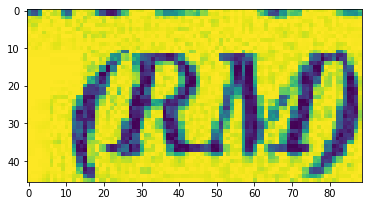

reading line : 1557
1415,2288,1502,2288,1502,2329,1415,2329,(RM)



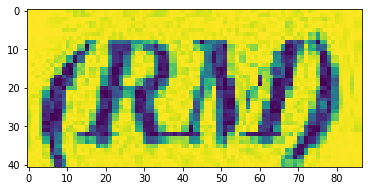

reading line : 1558
1182,2292,1268,2292,1268,2332,1182,2332,(RM)



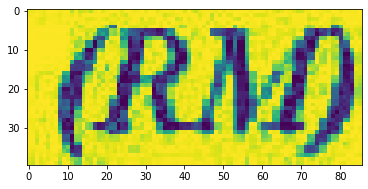

reading line : 1559
1411,2292,1497,2292,1497,2329,1411,2329,(RM)



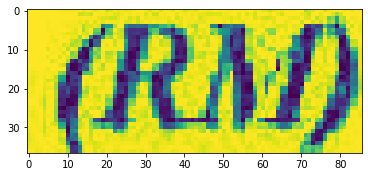

reading line : 1560
1101,731,1335,731,1335,754,1101,754,FAX : 03-3271 9481



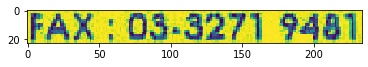

reading line : 1561
1391,1170,1477,1170,1477,1207,1391,1207,(RM)



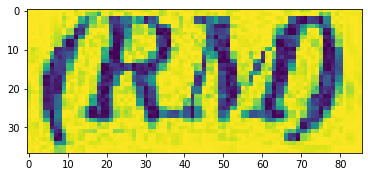

reading line : 1562
1152,1654,1169,1654,1169,1682,1152,1682,:



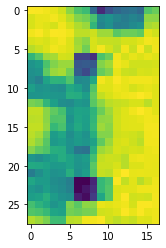

reading line : 1563
1151,1714,1172,1714,1172,1742,1151,1742,:



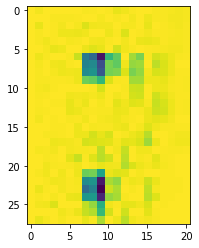

reading line : 1564
1151,1775,1169,1775,1169,1802,1151,1802,:



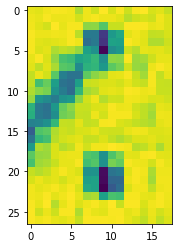

reading line : 1565
1151,1836,1171,1836,1171,1869,1151,1869,:



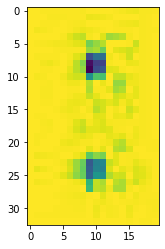

reading line : 1566
1152,1896,1169,1896,1169,1927,1152,1927,:



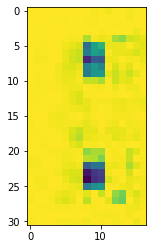

reading line : 1567
1152,1968,1171,1968,1171,1995,1152,1995,:



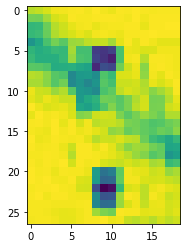

...... processing for X51005361900.jpg
reading corresponding text
reading line : 1568
723,557,1451,557,1451,618,723,618,TEO HENG STATIONERY & BOOKS



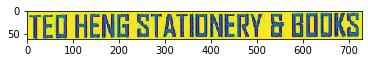

reading line : 1569
995,623,1185,623,1185,651,995,651,(001451637-M)



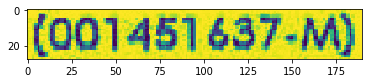

reading line : 1570
789,657,1390,657,1390,685,789,685,NO. 53, JALAN BESAR, 45600 BATANG BERJUNTAI



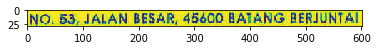

reading line : 1571
936,697,1243,697,1243,720,936,720,SELANGOR DARUL EHSAN



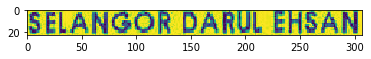

reading line : 1572
839,731,1065,731,1065,756,839,756,TEL : 03-3271 9872



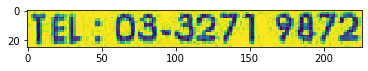

reading line : 1573
898,762,1281,762,1281,794,898,794,GST NO. : 000689913856



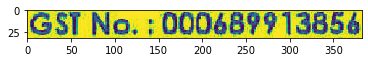

reading line : 1574
794,849,1402,849,1402,887,794,887,SIMPLIFIED TAX INVOICE



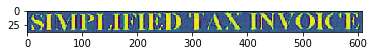

reading line : 1575
685,943,859,943,859,999,685,999,CASH



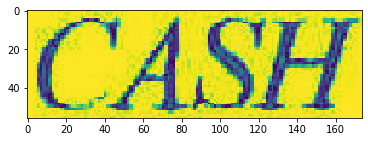

reading line : 1576
683,1049,1158,1049,1158,1090,683,1090,RECEIPT NO. : CS1801/27037



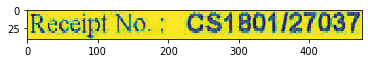

reading line : 1577
1201,1046,1513,1046,1513,1081,1201,1081,DATE : 23/01/2018



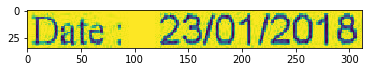

reading line : 1578
730,1151,845,1151,845,1186,730,1186,ITEM



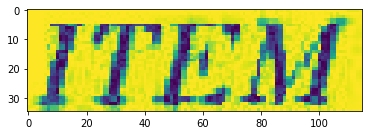

reading line : 1579
929,1147,1018,1147,1018,1194,929,1194,QTY



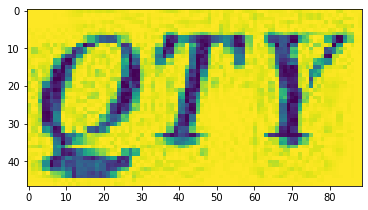

reading line : 1580
1052,1150,1126,1150,1126,1188,1052,1188,U/P



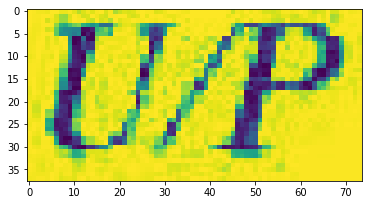

reading line : 1581
1160,1148,1298,1148,1298,1186,1160,1186,DISC%



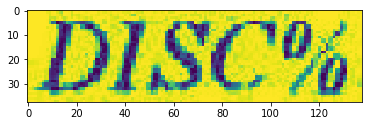

reading line : 1582
1347,1131,1516,1131,1516,1164,1347,1164,AMOUNT



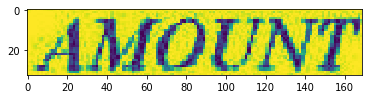

reading line : 1583
665,1245,756,1245,756,1282,665,1282,TP-24



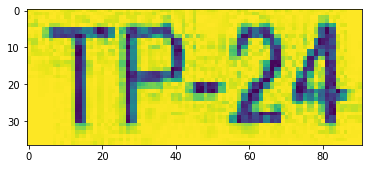

reading line : 1584
953,1242,981,1242,981,1276,953,1276,5



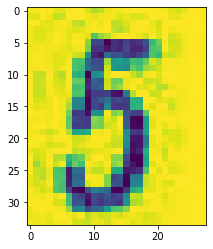

reading line : 1585
1048,1242,1130,1242,1130,1276,1048,1276,1.32



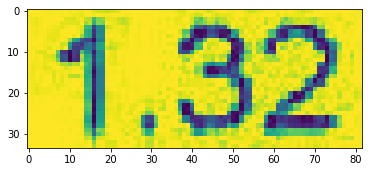

reading line : 1586
1183,1240,1262,1240,1262,1273,1183,1273,0.00



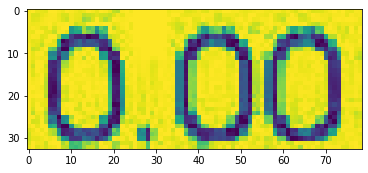

reading line : 1587
1409,1238,1510,1238,1510,1272,1409,1272,6.60 *



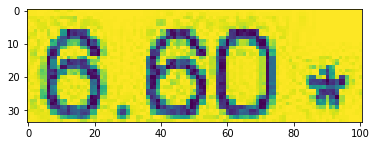

reading line : 1588
682,1298,1363,1298,1363,1338,682,1338,- DOUBLE SIDED TISSUE TAPE 18MM



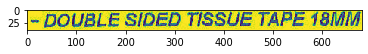

reading line : 1589
668,1381,883,1381,883,1415,668,1415,9557546631393



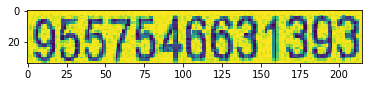

reading line : 1590
955,1379,975,1379,975,1414,955,1414,5



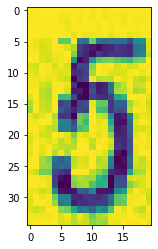

reading line : 1591
1051,1379,1130,1379,1130,1413,1051,1413,2.08



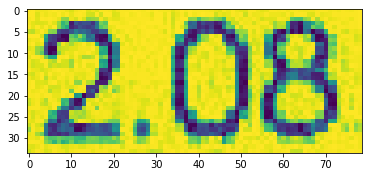

reading line : 1592
1184,1378,1261,1378,1261,1411,1184,1411,0.00



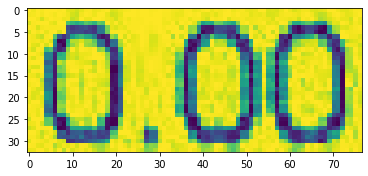

reading line : 1593
1391,1378,1510,1378,1510,1411,1391,1411,10.38 *



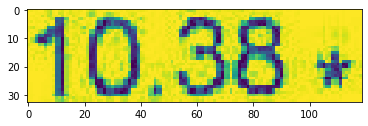

reading line : 1594
684,1434,1500,1434,1500,1477,684,1477,- G SOFT 6ML QUICK DRY CORRECTION PEN



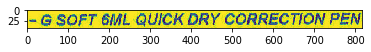

reading line : 1595
675,1554,872,1554,872,1599,675,1599,TOTAL QTY. :



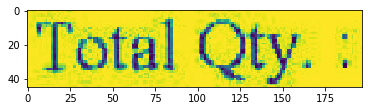

reading line : 1596
981,1554,1018,1554,1018,1588,981,1588,10



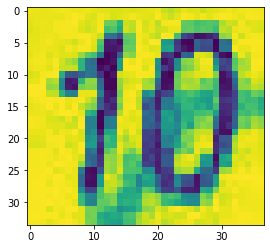

reading line : 1597
1395,1548,1492,1548,1492,1587,1395,1587,16.98



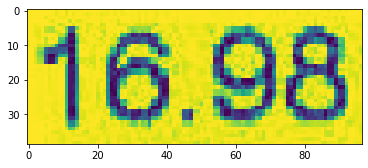

reading line : 1598
682,1655,999,1655,999,1693,682,1693,SUB-TOTAL (EX)



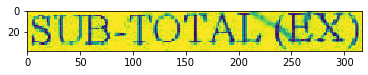

reading line : 1599
681,1714,908,1714,908,1748,681,1748,TOTAL TAX



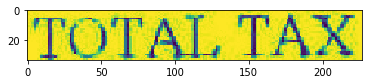

reading line : 1600
681,1773,901,1773,901,1807,681,1807,ROUNDING



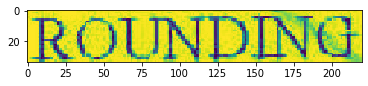

reading line : 1601
677,1831,862,1831,862,1875,677,1875,TOTAL



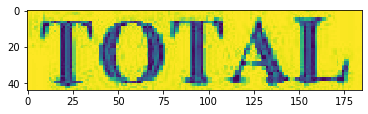

reading line : 1602
678,1895,824,1895,824,1938,678,1938,CASH



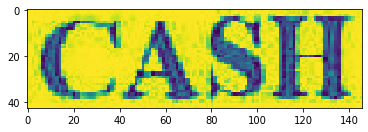

reading line : 1603
679,1961,902,1961,902,2006,679,2006,CHANGE



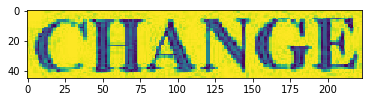

reading line : 1604
1396,1647,1492,1647,1492,1684,1396,1684,16.98



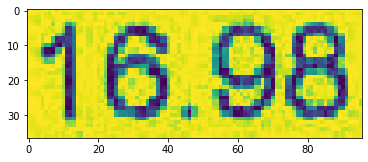

reading line : 1605
1416,1707,1492,1707,1492,1743,1416,1743,1.02



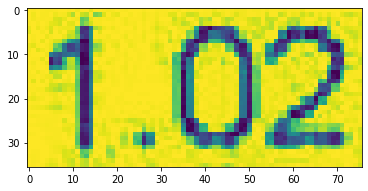

reading line : 1606
1414,1765,1493,1765,1493,1801,1414,1801,0.00



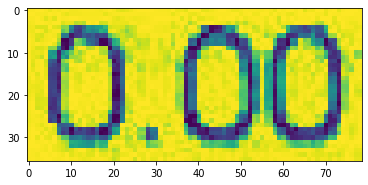

reading line : 1607
1361,1829,1488,1829,1488,1873,1361,1873,18.00



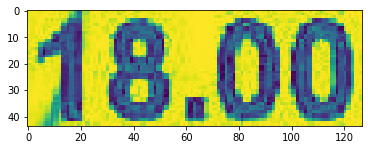

reading line : 1608
1361,1889,1491,1889,1491,1933,1361,1933,18.00



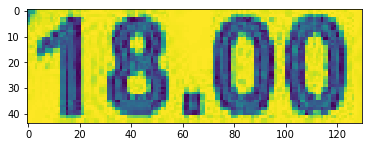

reading line : 1609
1388,1957,1491,1957,1491,2001,1388,2001,0.00



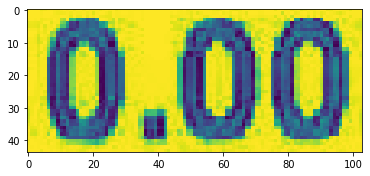

reading line : 1610
952,2174,1285,2174,1285,2214,952,2214,GST SUMMARY



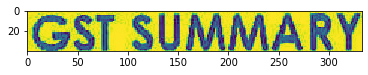

reading line : 1611
695,2275,881,2275,881,2312,695,2312,TAX CODE



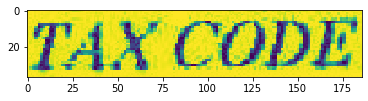

reading line : 1612
976,2274,1013,2274,1013,2309,976,2309,%



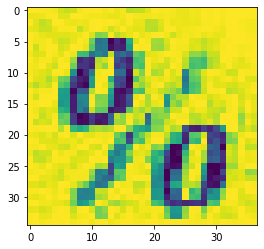

reading line : 1613
1145,2256,1317,2256,1317,2290,1145,2290,AMOUNT



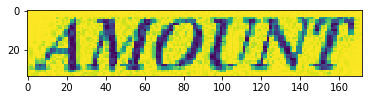

reading line : 1614
1423,2258,1503,2258,1503,2289,1423,2289,TAX



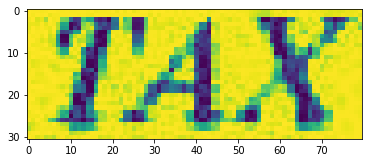

reading line : 1615
709,2384,765,2384,765,2417,709,2417,SR



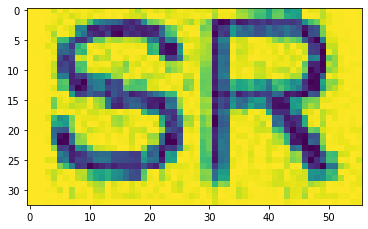

reading line : 1616
963,2380,1040,2380,1040,2411,963,2411,6.00



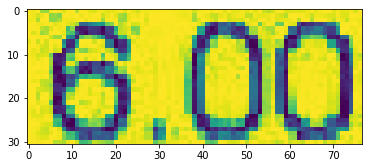

reading line : 1617
1182,2379,1281,2379,1281,2410,1182,2410,16.98



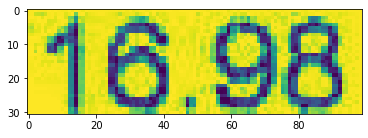

reading line : 1618
1414,2376,1493,2376,1493,2413,1414,2413,1.02



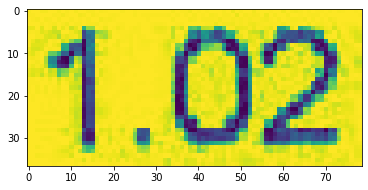

reading line : 1619
680,2487,830,2487,830,2520,680,2520,TOTAL :



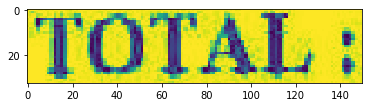

reading line : 1620
1184,2482,1281,2482,1281,2516,1184,2516,16.98



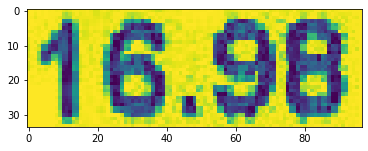

reading line : 1621
1419,2481,1496,2481,1496,2515,1419,2515,1.02



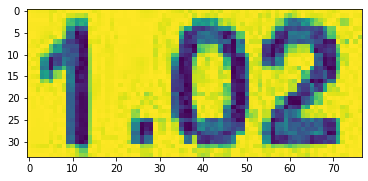

reading line : 1622
685,2579,1501,2579,1501,2622,685,2622,NOTE: (*) INDICATED THE ITEM SOLD HAS BEEN RELATED



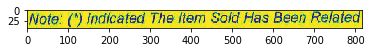

reading line : 1623
687,2623,1210,2623,1210,2662,687,2662,TO GST (GOODS & SERVICES TAX).



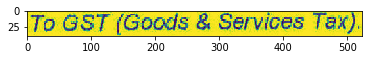

reading line : 1624
783,2720,1422,2720,1422,2757,783,2757,GOODS SOLD ARE NOT RETURNABLE,



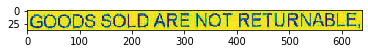

reading line : 1625
999,2768,1206,2768,1206,2802,999,2802,THANK YOU.



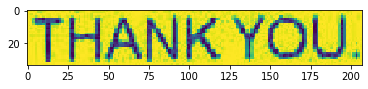

reading line : 1626
1382,1169,1497,1169,1497,1203,1382,1203,(RM)



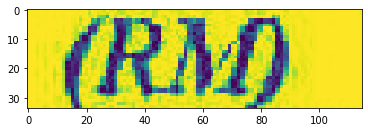

reading line : 1627
1178,2285,1267,2285,1267,2331,1178,2331,(RM)



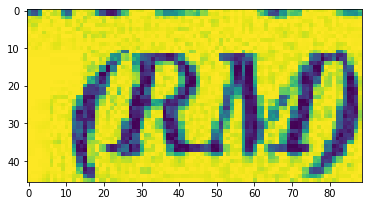

reading line : 1628
1415,2288,1502,2288,1502,2329,1415,2329,(RM)



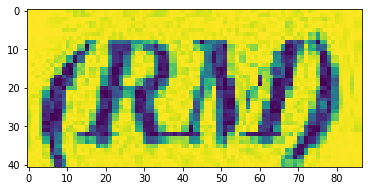

reading line : 1629
1182,2292,1268,2292,1268,2332,1182,2332,(RM)



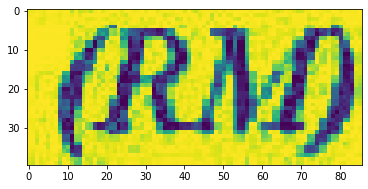

reading line : 1630
1411,2292,1497,2292,1497,2329,1411,2329,(RM)



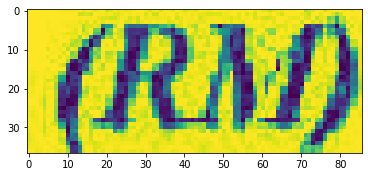

reading line : 1631
1101,731,1335,731,1335,754,1101,754,FAX : 03-3271 9481



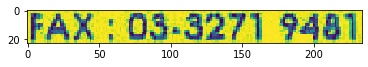

reading line : 1632
1391,1170,1477,1170,1477,1207,1391,1207,(RM)



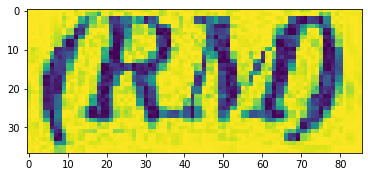

reading line : 1633
1152,1654,1169,1654,1169,1682,1152,1682,:



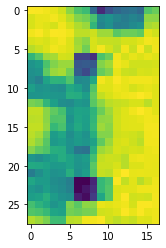

reading line : 1634
1151,1714,1172,1714,1172,1742,1151,1742,:



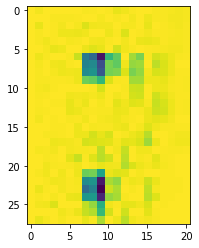

reading line : 1635
1151,1775,1169,1775,1169,1802,1151,1802,:



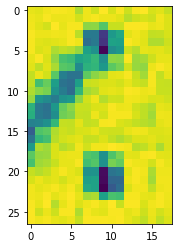

reading line : 1636
1151,1836,1171,1836,1171,1869,1151,1869,:



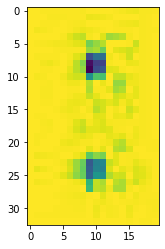

reading line : 1637
1152,1896,1169,1896,1169,1927,1152,1927,:



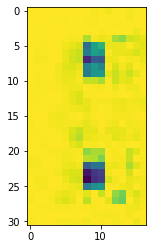

reading line : 1638
1152,1968,1171,1968,1171,1995,1152,1995,:



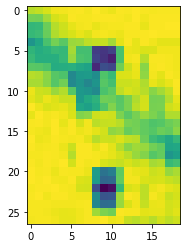

...... processing for X51005361907(1).jpg
reading corresponding text
reading line : 1639
951,247,1436,247,1436,304,951,304,TEO HENG STATIONERY & BOOKS



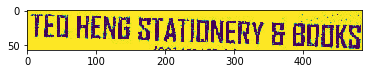

reading line : 1640
1131,297,1258,297,1258,319,1131,319,(001451637-M)



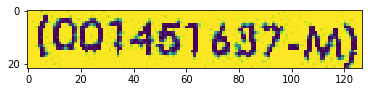

reading line : 1641
992,314,1398,314,1398,345,992,345,NO. 53, JALAN BESAR, 45600 BATANG BERJUNTAI



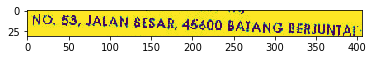

reading line : 1642
1091,343,1296,343,1296,368,1091,368,SELANGOR DARUL EHSAN



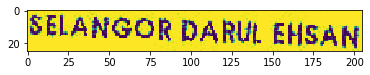

reading line : 1643
1026,364,1177,364,1177,385,1026,385,TEL : 03-3271 9872



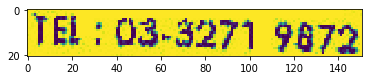

reading line : 1644
1198,370,1357,370,1357,393,1198,393,FAX : 03-3271 9481



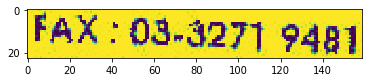

reading line : 1645
1064,385,1321,385,1321,416,1064,416,GST NO. : 000689913856



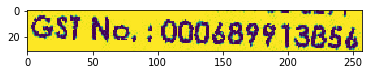

reading line : 1646
995,444,1398,444,1398,483,995,483,SIMPLIFIED TAX INVOICE



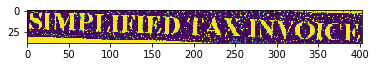

reading line : 1647
918,503,1036,503,1036,542,918,542,CASH



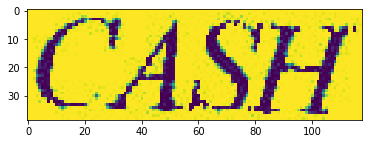

reading line : 1648
914,574,1232,574,1232,609,914,609,RECEIPT NO. : CS1802/27714



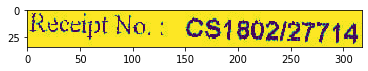

reading line : 1649
1259,585,1468,585,1468,614,1259,614,DATE : 12/02/2018



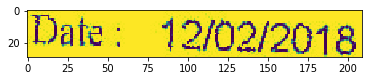

reading line : 1650
922,2141,1346,2141,1346,2177,922,2177,GOODS SOLD ARE NOT RETURNABLE,



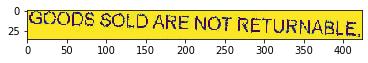

reading line : 1651
1063,2174,1201,2174,1201,2203,1063,2203,THANK YOU.



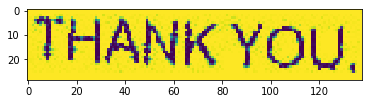

reading line : 1652
941,641,1019,641,1019,670,941,670,ITEM



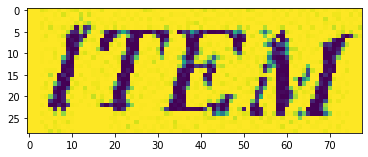

reading line : 1653
1073,647,1135,647,1135,675,1073,675,QTY



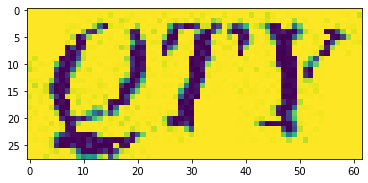

reading line : 1654
1156,647,1205,647,1205,673,1156,673,U/P



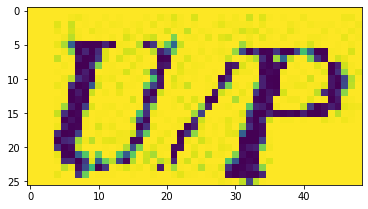

reading line : 1655
1231,651,1319,651,1319,679,1231,679,DISC%



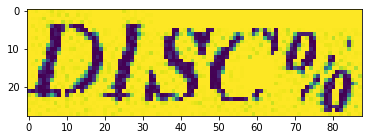

reading line : 1656
1353,646,1471,646,1471,671,1353,671,AMOUNT



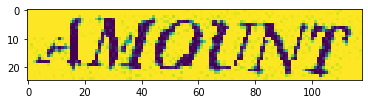

reading line : 1657
1381,671,1438,671,1438,697,1381,697,(RM)



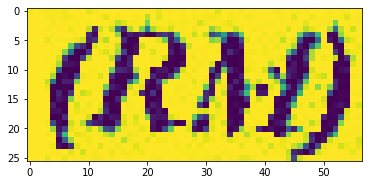

reading line : 1658
899,704,1042,704,1042,731,899,731,9555067700208



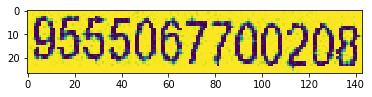

reading line : 1659
896,795,1040,795,1040,822,896,822,9557583450025



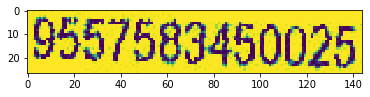

reading line : 1660
891,887,1036,887,1036,914,891,914,4974052801334



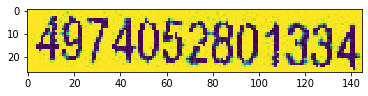

reading line : 1661
889,979,1032,979,1032,1004,889,1004,9557546953990



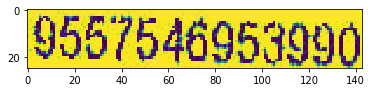

reading line : 1662
886,1072,1029,1072,1029,1096,886,1096,6924238702311



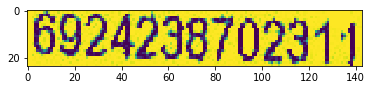

reading line : 1663
883,1165,1028,1165,1028,1190,883,1190,9556655112694



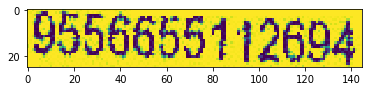

reading line : 1664
878,1268,1023,1268,1023,1291,878,1291,9557369305006



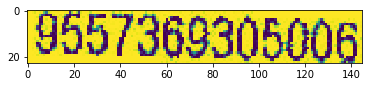

reading line : 1665
1086,709,1109,709,1109,732,1086,732,10



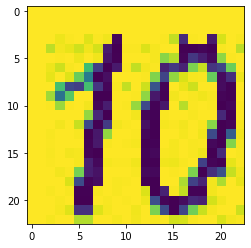

reading line : 1666
1087,803,1100,803,1100,823,1087,823,1



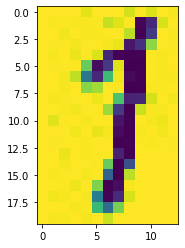

reading line : 1667
1083,892,1098,892,1098,917,1083,917,1



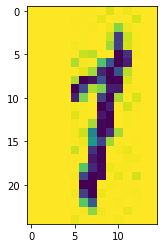

reading line : 1668
1081,985,1093,985,1093,1005,1081,1005,1



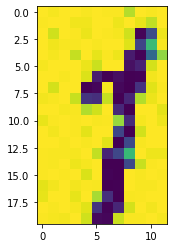

reading line : 1669
1076,1077,1091,1077,1091,1100,1076,1100,2



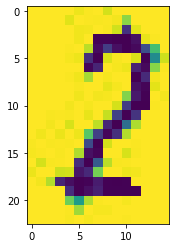

reading line : 1670
1074,1170,1087,1170,1087,1192,1074,1192,1



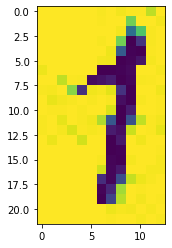

reading line : 1671
1070,1273,1084,1273,1084,1295,1070,1295,2



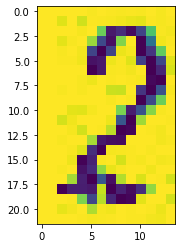

reading line : 1672
1139,710,1203,710,1203,734,1139,734,10.57



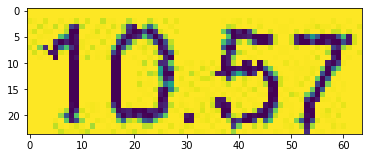

reading line : 1673
1135,801,1200,801,1200,824,1135,824,17.45



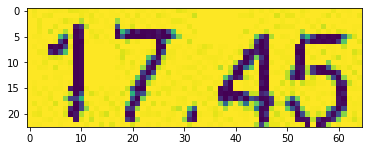

reading line : 1674
1145,894,1198,894,1198,919,1145,919,2.70



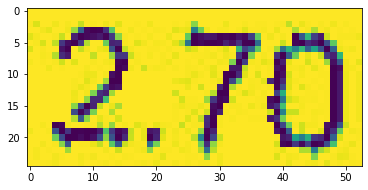

reading line : 1675
1143,987,1194,987,1194,1009,1143,1009,0.85



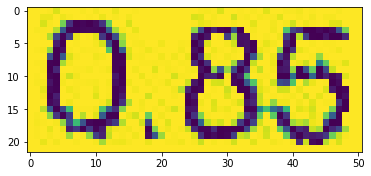

reading line : 1676
1138,1077,1193,1077,1193,1101,1138,1101,0.85



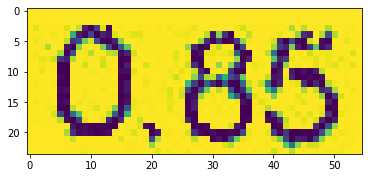

reading line : 1677
1136,1170,1187,1170,1187,1195,1136,1195,8.40



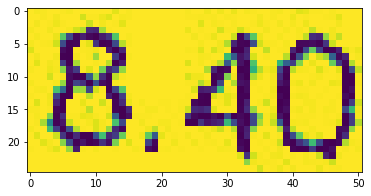

reading line : 1678
1132,1273,1185,1273,1185,1296,1132,1296,3.96



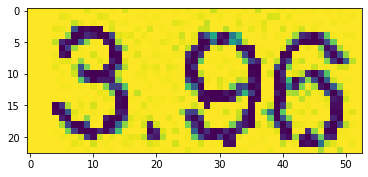

reading line : 1679
1241,714,1294,714,1294,738,1241,738,0.00



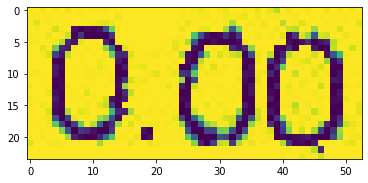

reading line : 1680
1238,806,1291,806,1291,829,1238,829,0.00



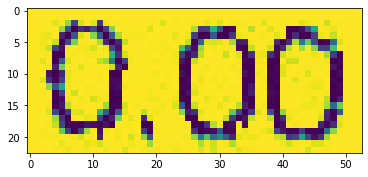

reading line : 1681
1233,899,1288,899,1288,922,1233,922,0.00



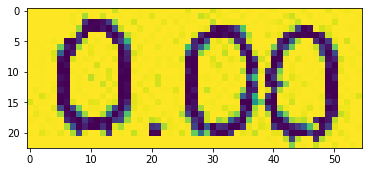

reading line : 1682
1233,989,1284,989,1284,1014,1233,1014,0.00



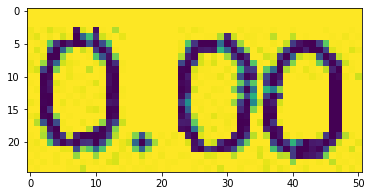

reading line : 1683
1227,1082,1281,1082,1281,1105,1227,1105,0.00



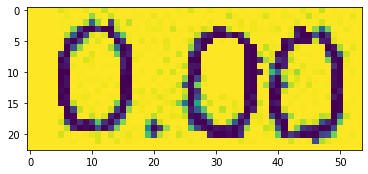

reading line : 1684
1225,1175,1277,1175,1277,1197,1225,1197,0.00



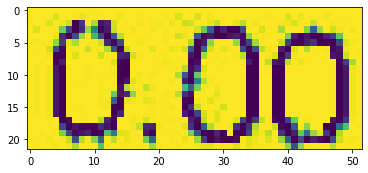

reading line : 1685
1221,1277,1274,1277,1274,1300,1221,1300,0.00



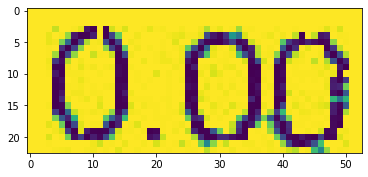

reading line : 1686
1367,718,1459,718,1459,743,1367,743,105.66 *



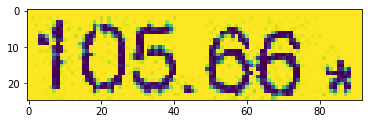

reading line : 1687
1375,811,1456,811,1456,834,1375,834,17.45 *



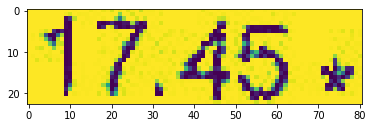

reading line : 1688
1386,903,1454,903,1454,927,1386,927,2.70 *



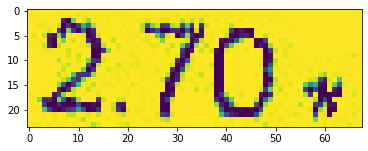

reading line : 1689
1382,995,1450,995,1450,1017,1382,1017,0.85 *



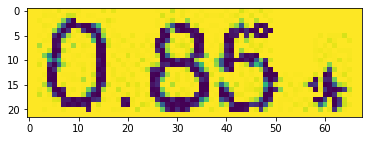

reading line : 1690
1381,1086,1448,1086,1448,1110,1381,1110,1.70 *



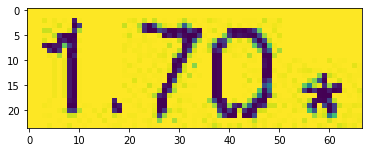

reading line : 1691
1377,1178,1444,1178,1444,1203,1377,1203,8.40 *



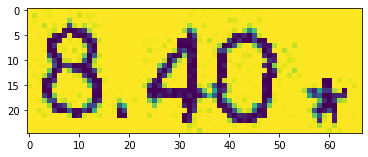

reading line : 1692
1373,1280,1440,1280,1440,1307,1373,1307,7.92 *



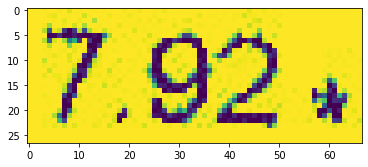

reading line : 1693
909,743,1190,743,1190,772,909,772,- IK YELLOW 70GRAMS



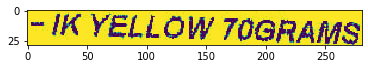

reading line : 1694
906,836,1325,836,1325,869,906,869,- PAPYRUS DARK COLOUR PAPER



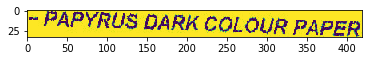

reading line : 1695
901,928,1064,928,1064,953,901,953,- ARTLINE 70



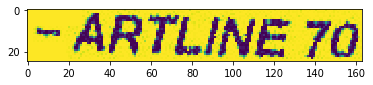

reading line : 1696
899,1018,1225,1018,1225,1050,899,1050,- FASTER CX5N BALL PEN



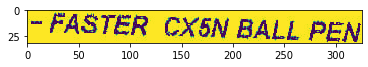

reading line : 1697
898,1113,1162,1113,1162,1140,898,1140,- CBE HANDYCUTTER



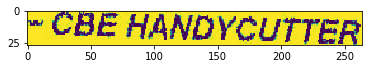

reading line : 1698
893,1203,1449,1203,1449,1242,893,1242,- CBE A4 SIZE 20 POCKETS REFILLABLE NEW



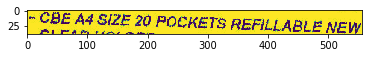

reading line : 1699
910,1232,1107,1232,1107,1260,910,1260,CLEAR HOLDER



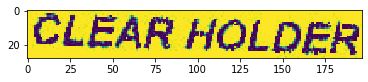

reading line : 1700
890,1306,1377,1306,1377,1342,890,1342,- EAGLE F4 120 NUMBERING FOOLSCAP



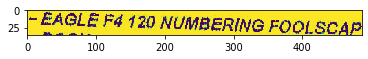

reading line : 1701
906,1337,983,1337,983,1360,906,1360,BOOK



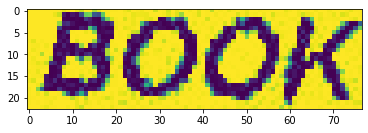

reading line : 1702
878,1394,1007,1394,1007,1426,878,1426,TOTAL QTY. :



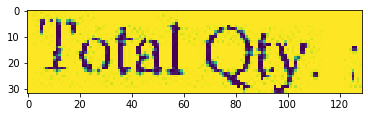

reading line : 1703
1083,1401,1108,1401,1108,1423,1083,1423,18



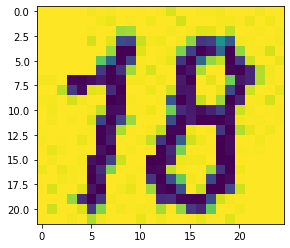

reading line : 1704
880,1461,1090,1461,1090,1490,880,1490,SUB-TOTAL (EX)



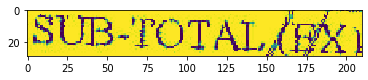

reading line : 1705
878,1501,1026,1501,1026,1529,878,1529,TOTAL TAX



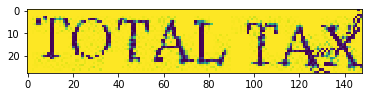

reading line : 1706
877,1540,1023,1540,1023,1567,877,1567,ROUNDING



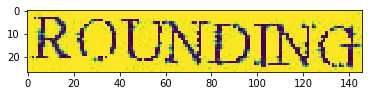

reading line : 1707
874,1578,994,1578,994,1609,874,1609,TOTAL



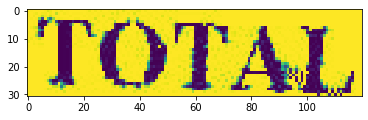

reading line : 1708
874,1620,968,1620,968,1651,874,1651,CASH



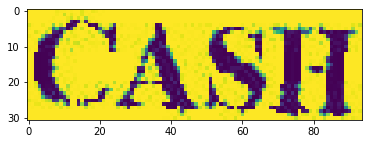

reading line : 1709
869,1666,1019,1666,1019,1697,869,1697,CHANGE



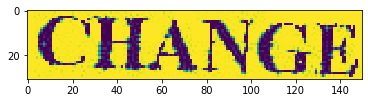

reading line : 1710
1345,1408,1422,1408,1422,1433,1345,1433,144.68



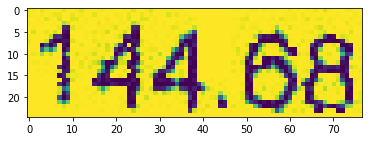

reading line : 1711
1341,1475,1420,1475,1420,1499,1341,1499,144.68



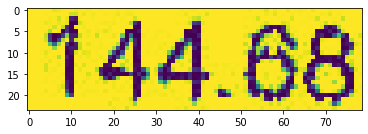

reading line : 1712
1368,1515,1419,1515,1419,1539,1368,1539,8.68



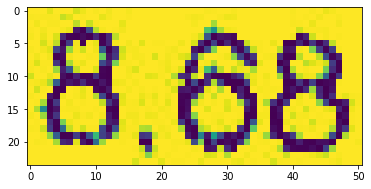

reading line : 1713
1359,1554,1414,1554,1414,1579,1359,1579,-0.01



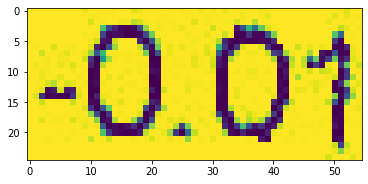

reading line : 1714
1309,1592,1414,1592,1414,1625,1309,1625,153.35



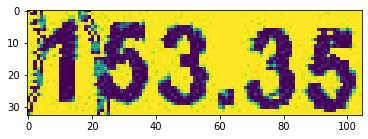

reading line : 1715
1308,1633,1412,1633,1412,1665,1308,1665,153.35



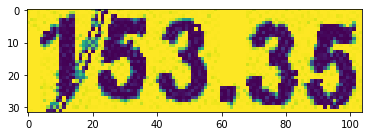

reading line : 1716
1344,1682,1411,1682,1411,1710,1344,1710,0.00



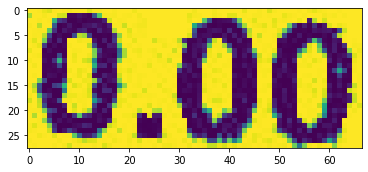

reading line : 1717
1048,1815,1268,1815,1268,1849,1048,1849,GST SUMMARY



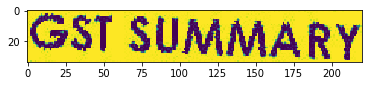

reading line : 1718
869,1875,997,1875,997,1900,869,1900,TAX CODE



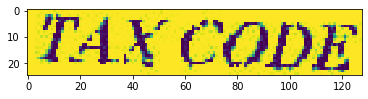

reading line : 1719
1061,1881,1084,1881,1084,1903,1061,1903,%



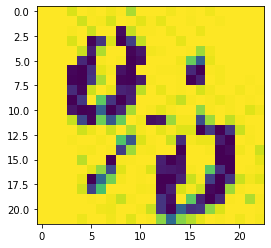

reading line : 1720
1173,1874,1286,1874,1286,1899,1173,1899,AMOUNT



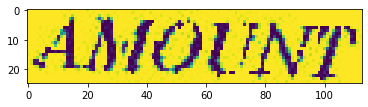

reading line : 1721
1197,1899,1254,1899,1254,1925,1197,1925,(RM)



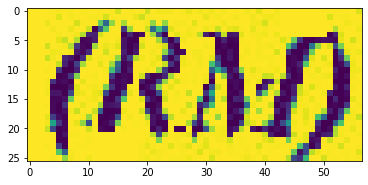

reading line : 1722
1358,1881,1412,1881,1412,1903,1358,1903,TAX



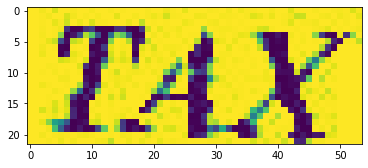

reading line : 1723
1350,1905,1410,1905,1410,1930,1350,1930,(RM)



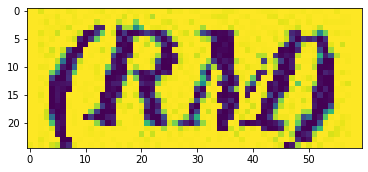

reading line : 1724
878,1934,916,1934,916,1955,878,1955,SR



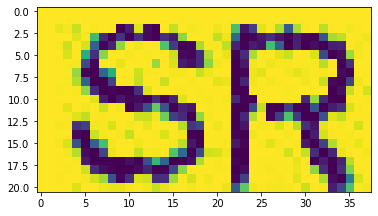

reading line : 1725
1050,1938,1101,1938,1101,1961,1050,1961,6.00



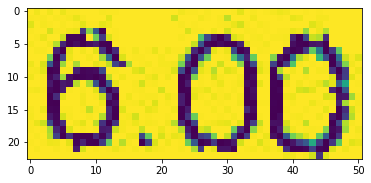

reading line : 1726
1181,1944,1258,1944,1258,1967,1181,1967,144.68



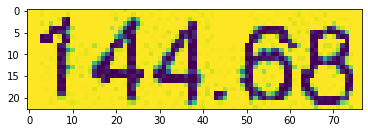

reading line : 1727
1349,1950,1401,1950,1401,1973,1349,1973,8.68



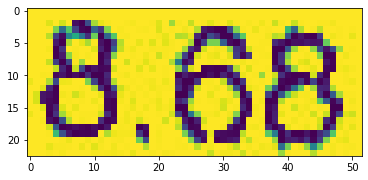

reading line : 1728
858,1988,959,1988,959,2014,858,2014,TOTAL :



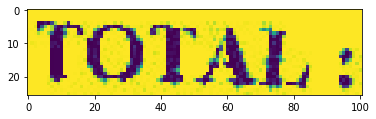

reading line : 1729
1177,1999,1256,1999,1256,2024,1177,2024,144.68



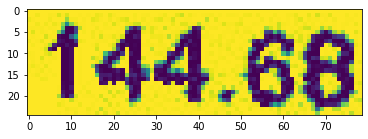

reading line : 1730
1348,2006,1400,2006,1400,2029,1348,2029,8.68



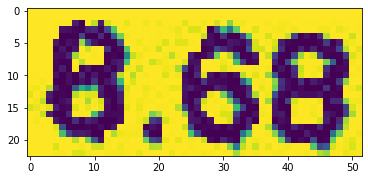

reading line : 1731
858,2039,1401,2039,1401,2080,858,2080,NOTE: (*) INDICATED THE ITEM SOLD HAS BEEN RELATED



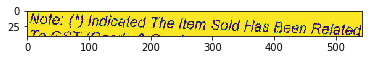

reading line : 1732
861,2068,1206,2068,1206,2105,861,2105,TO GST (GOODS & SERVICES TAX)



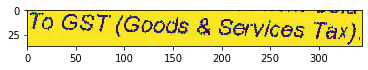

...... processing for X51005361907.jpg
reading corresponding text
reading line : 1733
951,247,1436,247,1436,304,951,304,TEO HENG STATIONERY & BOOKS



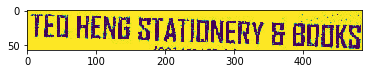

reading line : 1734
1131,297,1258,297,1258,319,1131,319,(001451637-M)



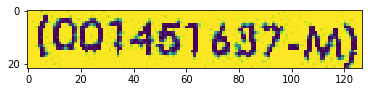

reading line : 1735
992,314,1398,314,1398,345,992,345,NO. 53, JALAN BESAR, 45600 BATANG BERJUNTAI



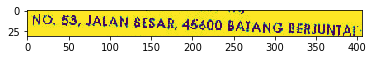

reading line : 1736
1091,343,1296,343,1296,368,1091,368,SELANGOR DARUL EHSAN



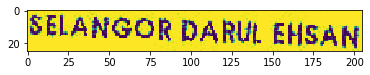

reading line : 1737
1026,364,1177,364,1177,385,1026,385,TEL : 03-3271 9872



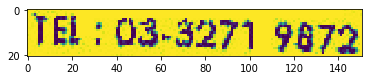

reading line : 1738
1198,370,1357,370,1357,393,1198,393,FAX : 03-3271 9481



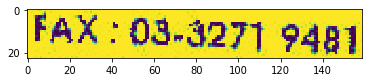

reading line : 1739
1064,385,1321,385,1321,416,1064,416,GST NO. : 000689913856



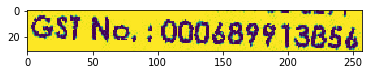

reading line : 1740
995,444,1398,444,1398,483,995,483,SIMPLIFIED TAX INVOICE



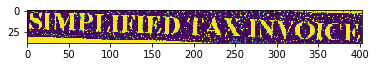

reading line : 1741
918,503,1036,503,1036,542,918,542,CASH



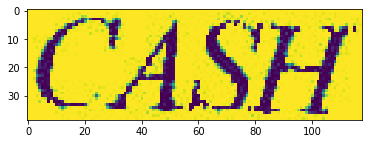

reading line : 1742
914,574,1232,574,1232,609,914,609,RECEIPT NO. : CS1802/27714



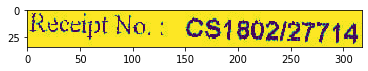

reading line : 1743
1259,585,1468,585,1468,614,1259,614,DATE : 12/02/2018



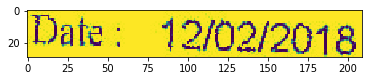

reading line : 1744
922,2141,1346,2141,1346,2177,922,2177,GOODS SOLD ARE NOT RETURNABLE,



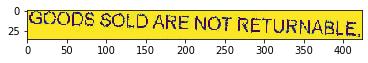

reading line : 1745
1063,2174,1201,2174,1201,2203,1063,2203,THANK YOU.



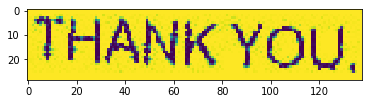

reading line : 1746
941,641,1019,641,1019,670,941,670,ITEM



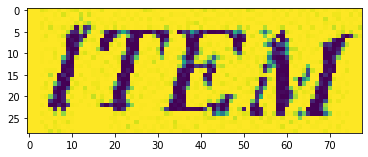

reading line : 1747
1073,647,1135,647,1135,675,1073,675,QTY



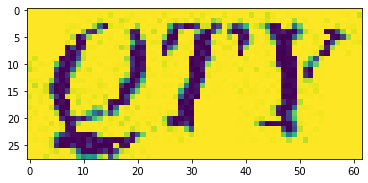

reading line : 1748
1156,647,1205,647,1205,673,1156,673,U/P



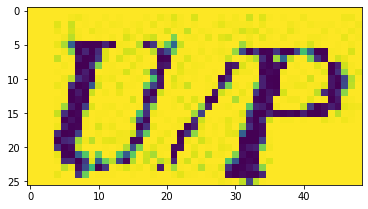

reading line : 1749
1231,651,1319,651,1319,679,1231,679,DISC%



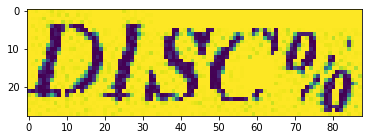

reading line : 1750
1353,646,1471,646,1471,671,1353,671,AMOUNT



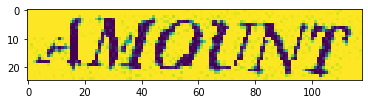

reading line : 1751
1381,671,1438,671,1438,697,1381,697,(RM)



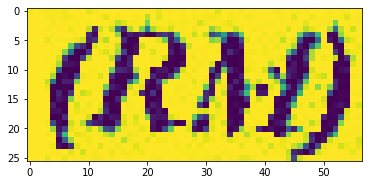

reading line : 1752
899,704,1042,704,1042,731,899,731,9555067700208



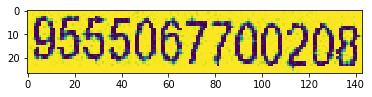

reading line : 1753
896,795,1040,795,1040,822,896,822,9557583450025



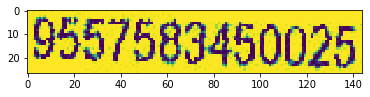

reading line : 1754
891,887,1036,887,1036,914,891,914,4974052801334



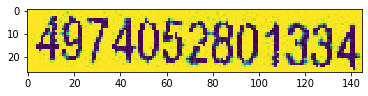

reading line : 1755
889,979,1032,979,1032,1004,889,1004,9557546953990



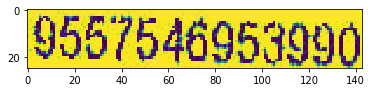

reading line : 1756
886,1072,1029,1072,1029,1096,886,1096,6924238702311



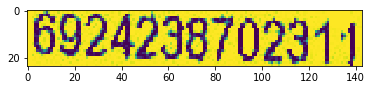

reading line : 1757
883,1165,1028,1165,1028,1190,883,1190,9556655112694



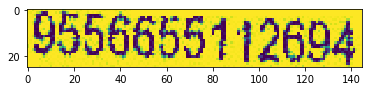

reading line : 1758
878,1268,1023,1268,1023,1291,878,1291,9557369305006



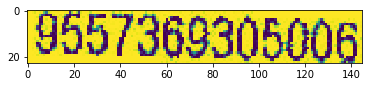

reading line : 1759
1086,709,1109,709,1109,732,1086,732,10



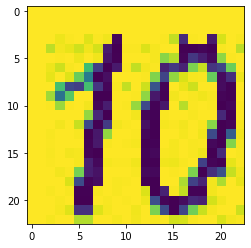

reading line : 1760
1087,803,1100,803,1100,823,1087,823,1



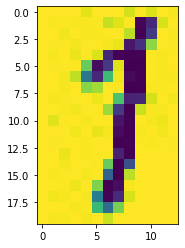

reading line : 1761
1083,892,1098,892,1098,917,1083,917,1



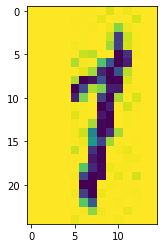

reading line : 1762
1081,985,1093,985,1093,1005,1081,1005,1



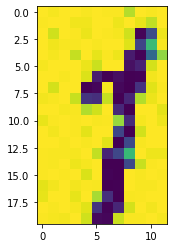

reading line : 1763
1076,1077,1091,1077,1091,1100,1076,1100,2



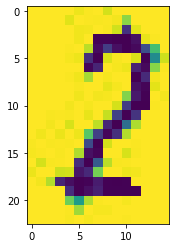

reading line : 1764
1074,1170,1087,1170,1087,1192,1074,1192,1



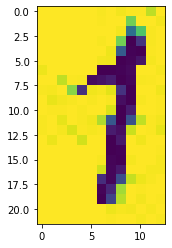

reading line : 1765
1070,1273,1084,1273,1084,1295,1070,1295,2



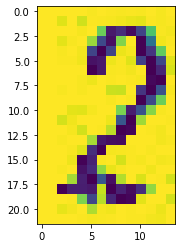

reading line : 1766
1139,710,1203,710,1203,734,1139,734,10.57



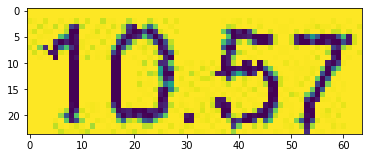

reading line : 1767
1135,801,1200,801,1200,824,1135,824,17.45



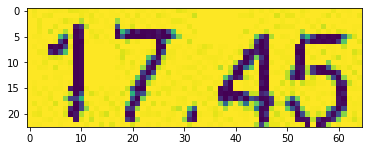

reading line : 1768
1145,894,1198,894,1198,919,1145,919,2.70



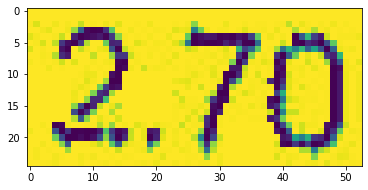

reading line : 1769
1143,987,1194,987,1194,1009,1143,1009,0.85



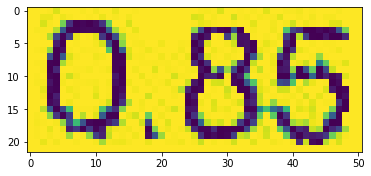

reading line : 1770
1138,1077,1193,1077,1193,1101,1138,1101,0.85



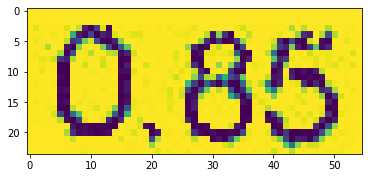

reading line : 1771
1136,1170,1187,1170,1187,1195,1136,1195,8.40



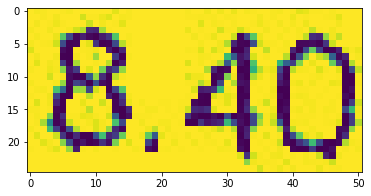

reading line : 1772
1132,1273,1185,1273,1185,1296,1132,1296,3.96



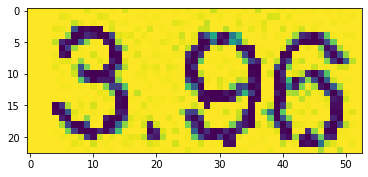

reading line : 1773
1241,714,1294,714,1294,738,1241,738,0.00



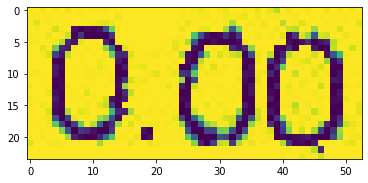

reading line : 1774
1238,806,1291,806,1291,829,1238,829,0.00



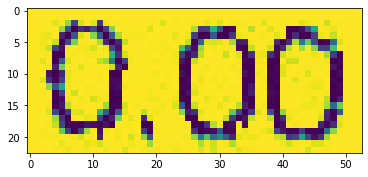

reading line : 1775
1233,899,1288,899,1288,922,1233,922,0.00



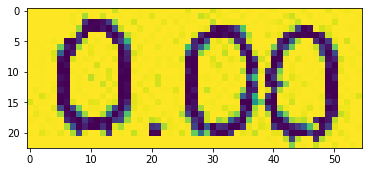

reading line : 1776
1233,989,1284,989,1284,1014,1233,1014,0.00



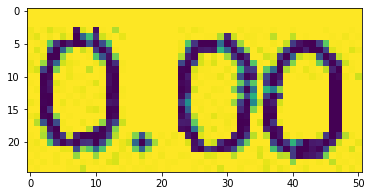

reading line : 1777
1227,1082,1281,1082,1281,1105,1227,1105,0.00



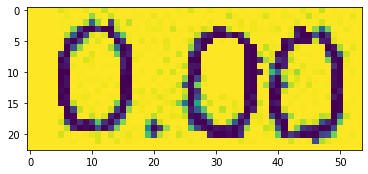

reading line : 1778
1225,1175,1277,1175,1277,1197,1225,1197,0.00



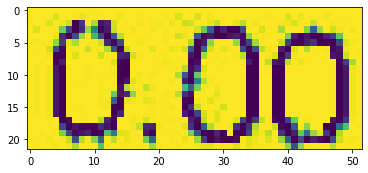

reading line : 1779
1221,1277,1274,1277,1274,1300,1221,1300,0.00



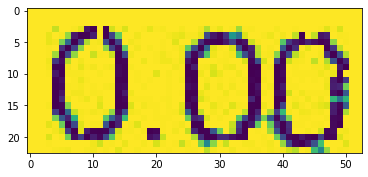

reading line : 1780
1367,718,1459,718,1459,743,1367,743,105.66 *



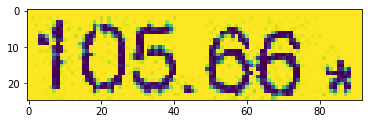

reading line : 1781
1375,811,1456,811,1456,834,1375,834,17.45 *



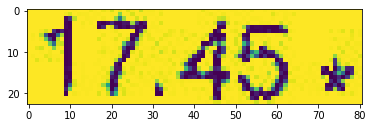

reading line : 1782
1386,903,1454,903,1454,927,1386,927,2.70 *



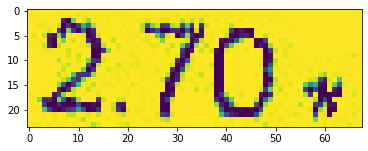

reading line : 1783
1382,995,1450,995,1450,1017,1382,1017,0.85 *



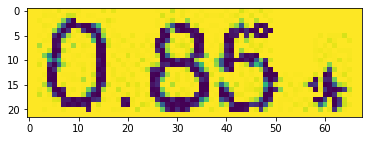

reading line : 1784
1381,1086,1448,1086,1448,1110,1381,1110,1.70 *



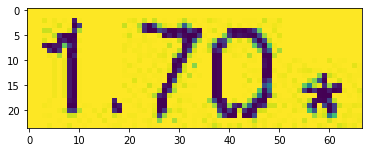

reading line : 1785
1377,1178,1444,1178,1444,1203,1377,1203,8.40 *



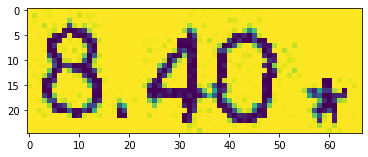

reading line : 1786
1373,1280,1440,1280,1440,1307,1373,1307,7.92 *



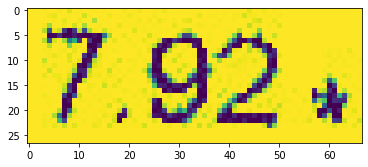

reading line : 1787
909,743,1190,743,1190,772,909,772,- IK YELLOW 70GRAMS



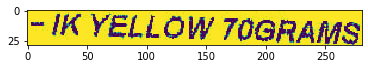

reading line : 1788
906,836,1325,836,1325,869,906,869,- PAPYRUS DARK COLOUR PAPER



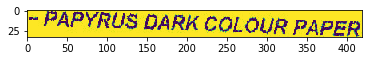

reading line : 1789
901,928,1064,928,1064,953,901,953,- ARTLINE 70



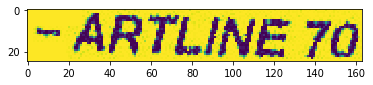

reading line : 1790
899,1018,1225,1018,1225,1050,899,1050,- FASTER CX5N BALL PEN



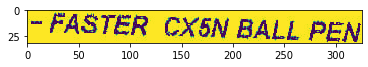

reading line : 1791
898,1113,1162,1113,1162,1140,898,1140,- CBE HANDYCUTTER



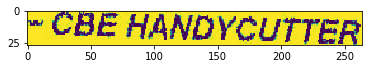

reading line : 1792
893,1203,1449,1203,1449,1242,893,1242,- CBE A4 SIZE 20 POCKETS REFILLABLE NEW



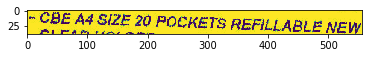

reading line : 1793
910,1232,1107,1232,1107,1260,910,1260,CLEAR HOLDER



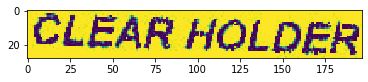

reading line : 1794
890,1306,1377,1306,1377,1342,890,1342,- EAGLE F4 120 NUMBERING FOOLSCAP



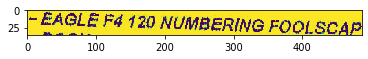

reading line : 1795
906,1337,983,1337,983,1360,906,1360,BOOK



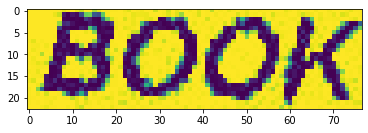

reading line : 1796
878,1394,1007,1394,1007,1426,878,1426,TOTAL QTY. :



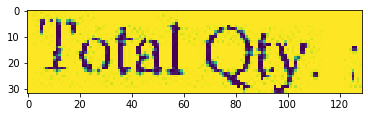

reading line : 1797
1083,1401,1108,1401,1108,1423,1083,1423,18



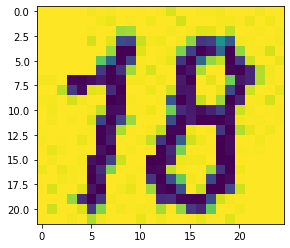

reading line : 1798
880,1461,1090,1461,1090,1490,880,1490,SUB-TOTAL (EX)



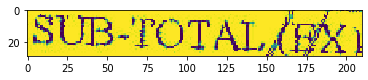

reading line : 1799
878,1501,1026,1501,1026,1529,878,1529,TOTAL TAX



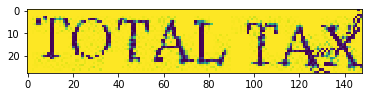

reading line : 1800
877,1540,1023,1540,1023,1567,877,1567,ROUNDING



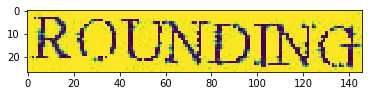

reading line : 1801
874,1578,994,1578,994,1609,874,1609,TOTAL



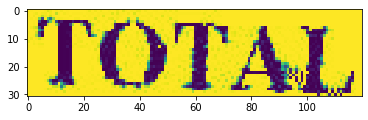

reading line : 1802
874,1620,968,1620,968,1651,874,1651,CASH



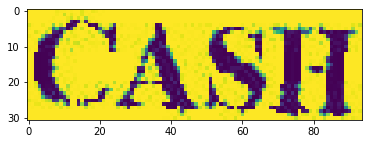

reading line : 1803
869,1666,1019,1666,1019,1697,869,1697,CHANGE



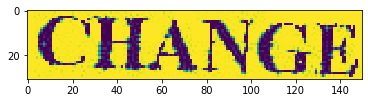

reading line : 1804
1345,1408,1422,1408,1422,1433,1345,1433,144.68



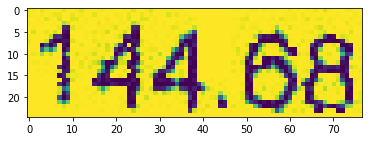

reading line : 1805
1341,1475,1420,1475,1420,1499,1341,1499,144.68



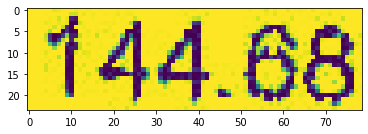

reading line : 1806
1368,1515,1419,1515,1419,1539,1368,1539,8.68



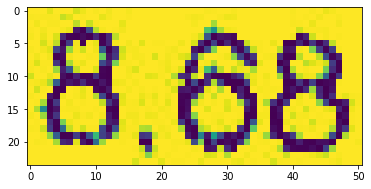

reading line : 1807
1359,1554,1414,1554,1414,1579,1359,1579,-0.01



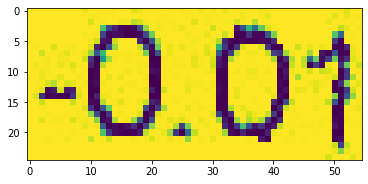

reading line : 1808
1309,1592,1414,1592,1414,1625,1309,1625,153.35



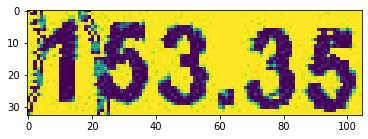

reading line : 1809
1308,1633,1412,1633,1412,1665,1308,1665,153.35



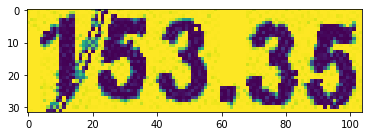

reading line : 1810
1344,1682,1411,1682,1411,1710,1344,1710,0.00



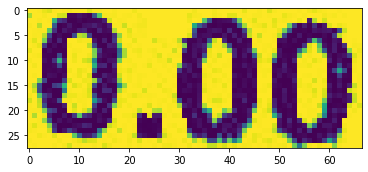

reading line : 1811
1048,1815,1268,1815,1268,1849,1048,1849,GST SUMMARY



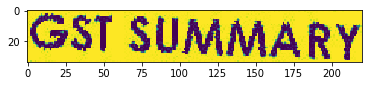

reading line : 1812
869,1875,997,1875,997,1900,869,1900,TAX CODE



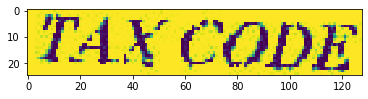

reading line : 1813
1061,1881,1084,1881,1084,1903,1061,1903,%



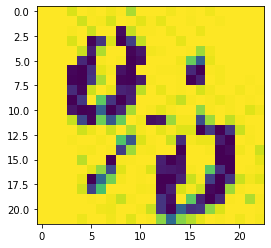

reading line : 1814
1173,1874,1286,1874,1286,1899,1173,1899,AMOUNT



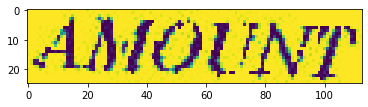

reading line : 1815
1197,1899,1254,1899,1254,1925,1197,1925,(RM)



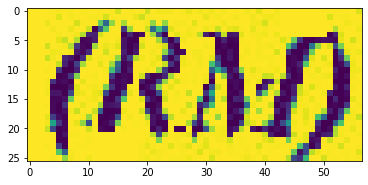

reading line : 1816
1358,1881,1412,1881,1412,1903,1358,1903,TAX



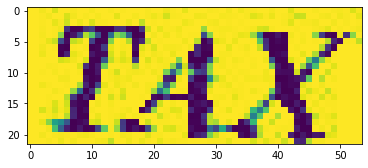

reading line : 1817
1350,1905,1410,1905,1410,1930,1350,1930,(RM)



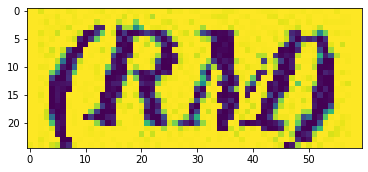

reading line : 1818
878,1934,916,1934,916,1955,878,1955,SR



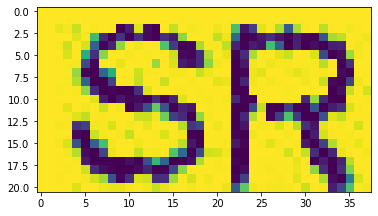

reading line : 1819
1050,1938,1101,1938,1101,1961,1050,1961,6.00



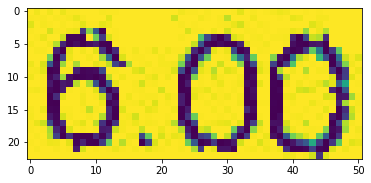

reading line : 1820
1181,1944,1258,1944,1258,1967,1181,1967,144.68



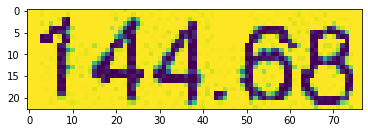

reading line : 1821
1349,1950,1401,1950,1401,1973,1349,1973,8.68



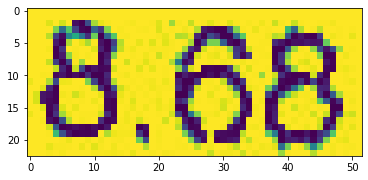

reading line : 1822
858,1988,959,1988,959,2014,858,2014,TOTAL :



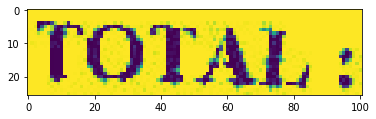

reading line : 1823
1177,1999,1256,1999,1256,2024,1177,2024,144.68



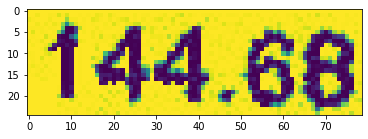

reading line : 1824
1348,2006,1400,2006,1400,2029,1348,2029,8.68



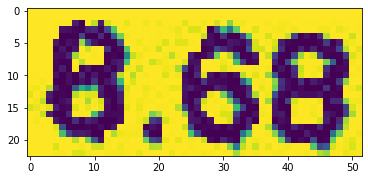

reading line : 1825
858,2039,1401,2039,1401,2080,858,2080,NOTE: (*) INDICATED THE ITEM SOLD HAS BEEN RELATED



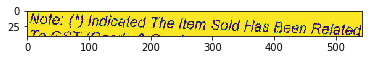

reading line : 1826
861,2068,1206,2068,1206,2105,861,2105,TO GST (GOODS & SERVICES TAX)



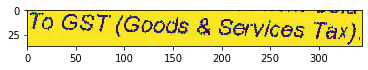

...... processing for X51005361946.jpg
reading corresponding text
reading line : 1827
912,372,1216,372,1216,400,912,400,MR. D.I.Y. (M) SDN BHD



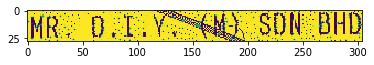

reading line : 1828
943,398,1187,398,1187,429,943,429,(CO REG :860671-D)



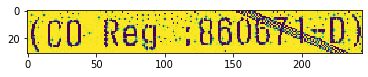

reading line : 1829
830,427,1283,427,1283,457,830,457,LOT 1851-A & 1851-B, JALAN KPB 6,



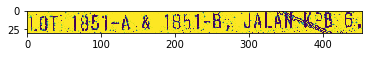

reading line : 1830
846,456,1268,456,1268,484,846,484,KAWASAN PERINDUSTRIAN BALAKONG,



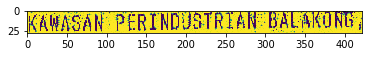

reading line : 1831
860,483,1272,483,1272,511,860,511,43300 SERI KEMBANGAN, SELANGOR



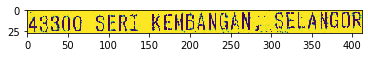

reading line : 1832
888,512,1228,512,1228,540,888,540,(GST ID NO :000306020352)



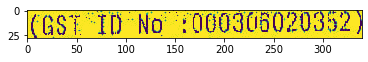

reading line : 1833
889,537,1231,537,1231,568,889,568,(TESCO MUTIARA DAMANSARA)



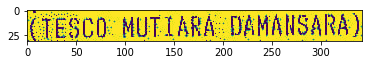

reading line : 1834
984,569,1137,569,1137,594,984,594,TAX INVOICE



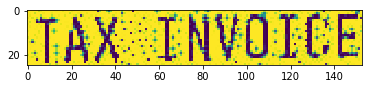

reading line : 1835
793,626,1084,626,1084,652,793,652,SOURING PAD 1018-4 4S



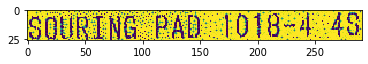

reading line : 1836
1314,624,1343,624,1343,645,1314,645,*S



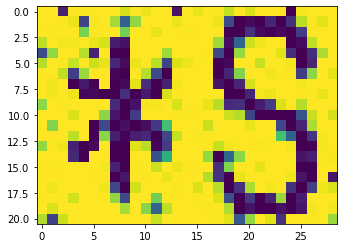

reading line : 1837
792,656,972,656,972,681,792,681,WA03 - 24/240



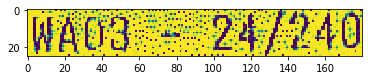

reading line : 1838
793,685,974,685,974,707,793,707,9555221301081



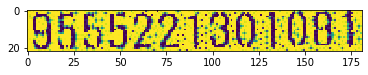

reading line : 1839
1096,682,1140,682,1140,703,1096,703,4 X



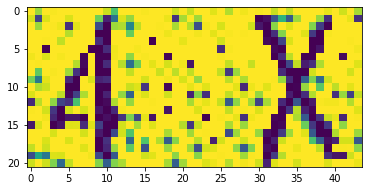

reading line : 1840
884,1263,1256,1263,1256,1291,884,1291,EXCHANGE ARE ALLOWED WITHIN



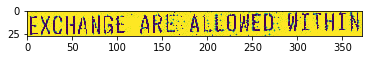

reading line : 1841
1164,680,1221,680,1221,704,1164,704,2.80



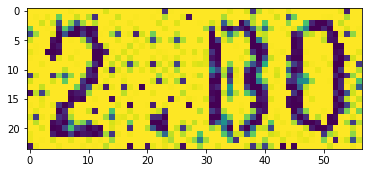

reading line : 1842
1247,678,1316,678,1316,704,1247,704,11.20



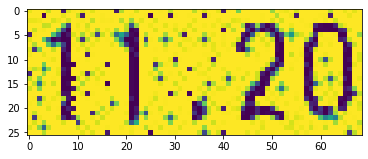

reading line : 1843
792,710,988,710,988,736,792,736,SCISSOR G/FISH



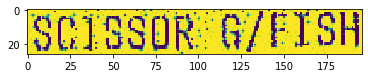

reading line : 1844
1315,706,1344,706,1344,728,1315,728,*S



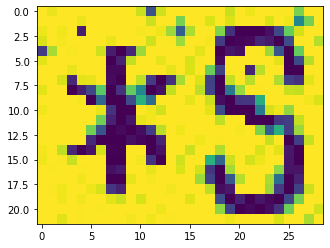

reading line : 1845
794,736,973,736,973,763,794,763,AD51 - 24/360



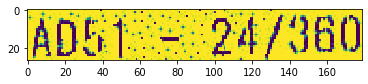

reading line : 1846
792,768,891,768,891,791,792,791,9064422



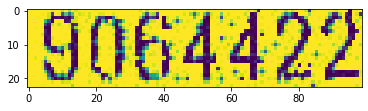

reading line : 1847
1097,763,1141,763,1141,786,1097,786,2 X



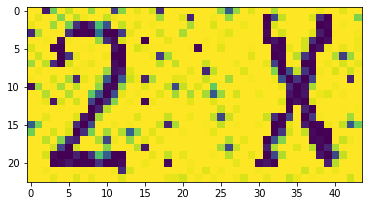

reading line : 1848
800,1209,1228,1209,1228,1235,800,1235,OPERATOR TMDC - SAH BIJAY KUMAR



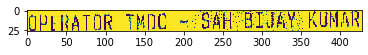

reading line : 1849
1167,762,1221,762,1221,784,1167,784,1.50



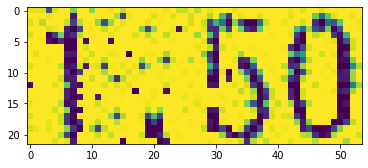

reading line : 1850
1260,761,1317,761,1317,782,1260,782,3.00



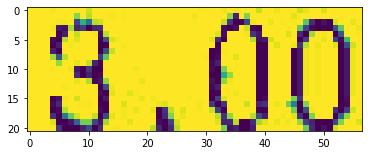

reading line : 1851
795,789,1289,789,1289,818,795,818,TRAILING SKT 5GN+SP 3X1.25MM CABLE 2



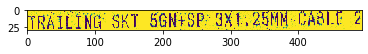

reading line : 1852
1316,788,1346,788,1346,812,1316,812,*S



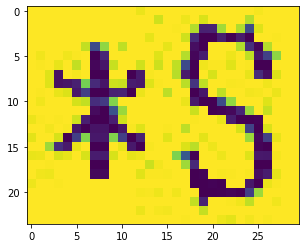

reading line : 1853
795,822,920,822,920,844,795,844,WA27 - 20



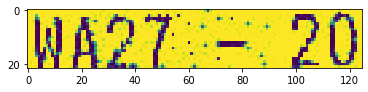

reading line : 1854
794,847,976,847,976,875,794,875,9553114461966



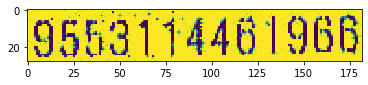

reading line : 1855
1099,845,1223,845,1223,869,1099,869,1 X 22.90



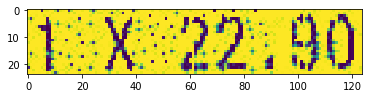

reading line : 1856
910,1320,1239,1320,1239,1346,910,1346,STRICTLY NO CASH REFUND .



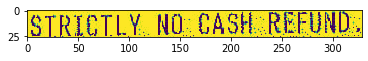

reading line : 1857
938,1292,1212,1292,1212,1316,938,1316,7 DAYS WITH RECEIPT .



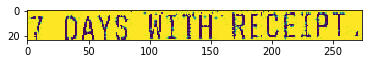

reading line : 1858
1248,845,1317,845,1317,867,1248,867,22.90



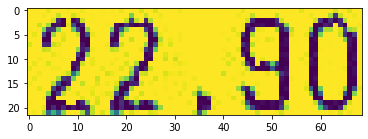

reading line : 1859
798,903,948,903,948,932,798,932,ITEM(S) : 3



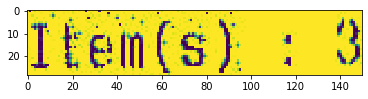

reading line : 1860
1209,900,1346,900,1346,926,1209,926,QTY(S) : 7



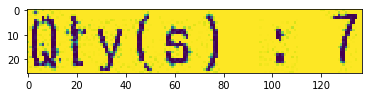

reading line : 1861
796,958,1046,958,1046,986,796,986,TOTAL INCL. GST@6%



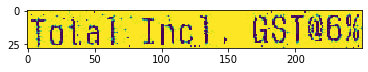

reading line : 1862
1235,957,1347,957,1347,980,1235,980,RM 37.10



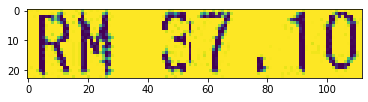

reading line : 1863
797,989,854,989,854,1013,797,1013,CASH



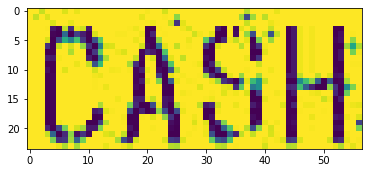

reading line : 1864
1237,983,1348,983,1348,1007,1237,1007,RM 50.00



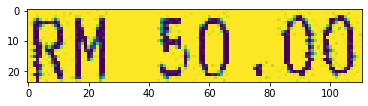

reading line : 1865
798,1016,881,1016,881,1041,798,1041,CHANGE



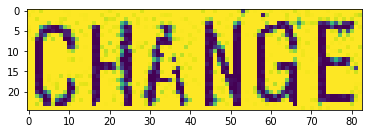

reading line : 1866
1237,1012,1347,1012,1347,1034,1237,1034,RM 12.90



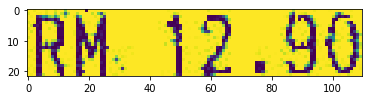

reading line : 1867
798,1073,950,1073,950,1098,798,1098,GST SUMMARY



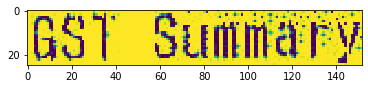

reading line : 1868
1047,1069,1141,1069,1141,1095,1047,1095,AMT(RM)



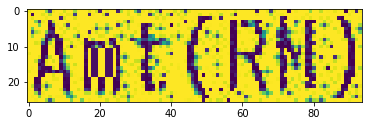

reading line : 1869
1181,1067,1278,1067,1278,1093,1181,1093,TAX(RM)



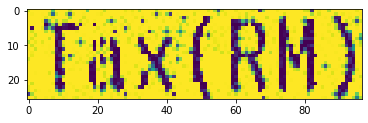

reading line : 1870
798,1100,908,1100,908,1125,798,1125,GST S@6%



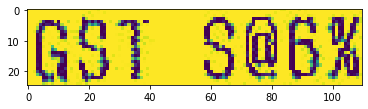

reading line : 1871
1101,1098,1172,1098,1172,1120,1101,1120,35.00



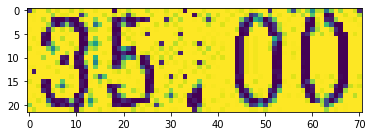

reading line : 1872
1250,1096,1308,1096,1308,1119,1250,1119,2.10



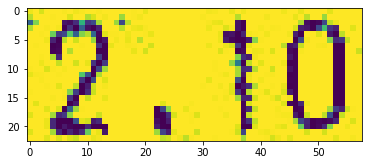

reading line : 1873
801,1181,1132,1181,1132,1208,801,1208,14-03-18 21:49 SH03 ZJ20



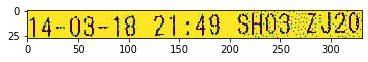

reading line : 1874
1168,1179,1351,1179,1351,1204,1168,1204,T1 R000418193



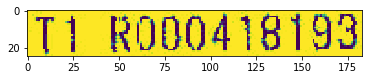

...... processing for X51005361950(1).jpg
reading corresponding text
reading line : 1875
200,196,696,196,696,243,200,243,99 SPEED MART S/B (519537-X)



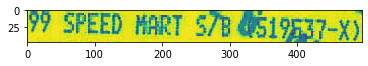

reading line : 1876
219,243,694,243,694,299,219,299,LOT P.T. 2811, JALAN ANGSA,



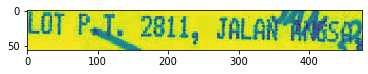

reading line : 1877
321,297,571,297,571,336,321,336,TAMAN BERKELEY



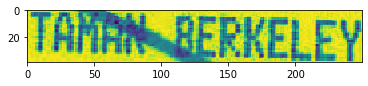

reading line : 1878
269,345,647,345,647,393,269,393,41150 KLANG, SELANGOR



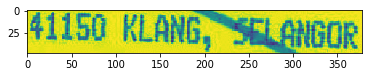

reading line : 1879
371,397,533,397,533,434,371,434,1076-IJOK



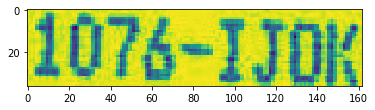

reading line : 1880
230,442,676,442,676,491,230,491,GST ID. NO : 000181747712



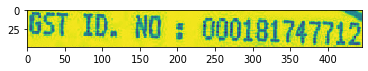

reading line : 1881
211,491,706,491,706,542,211,542,INVOICE NO : 18287/102/T0049



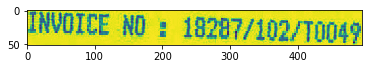

reading line : 1882
105,588,230,588,230,626,105,626,10:43AM



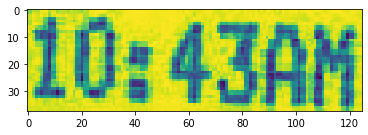

reading line : 1883
402,600,513,600,513,637,402,637,568582



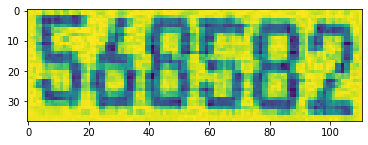

reading line : 1884
669,607,812,607,812,646,669,646,24-01-18



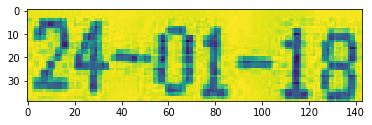

reading line : 1885
101,689,581,689,581,739,101,739,1973 GARBAGE BAG (BLUE) 74C



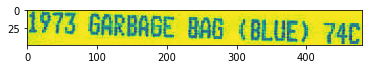

reading line : 1886
665,708,810,708,810,748,665,748,RM1.25 S



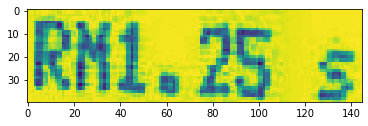

reading line : 1887
164,1240,663,1240,663,1300,164,1300,THANK YOU. PLEASE COME AGAIN



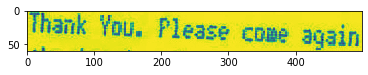

reading line : 1888
95,737,573,737,573,789,95,789,1974 GARBAGE BAG (GREEN) 74



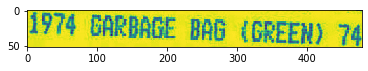

reading line : 1889
659,758,802,758,802,797,659,797,RM1.25 S



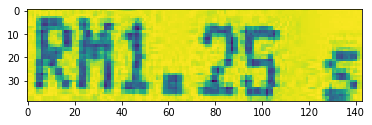

reading line : 1890
76,1288,771,1288,771,1346,76,1346,KEEP THE INVOICE FOR APPLICABLE RETURNS



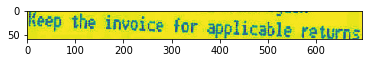

reading line : 1891
93,836,626,836,626,890,93,890,TOTAL SALES (INCLUSIVE GST) RM



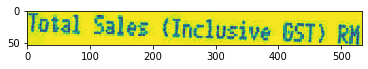

reading line : 1892
691,859,765,859,765,894,691,894,2.50



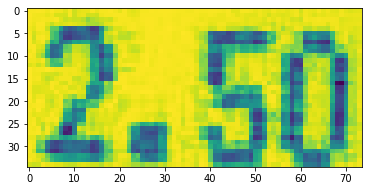

reading line : 1893
498,902,626,902,626,941,498,941,CASH RM



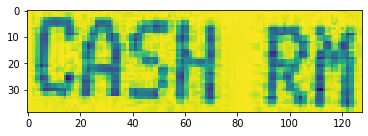

reading line : 1894
693,910,769,910,769,945,693,945,5.00



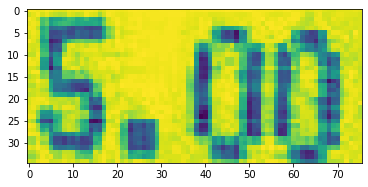

reading line : 1895
459,952,622,952,622,991,459,991,CHANGE RM



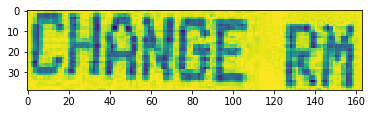

reading line : 1896
690,961,760,961,760,996,690,996,2.50



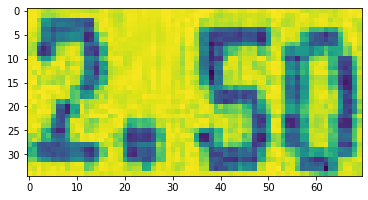

reading line : 1897
83,1038,282,1038,282,1085,83,1085,GST SUMMARY



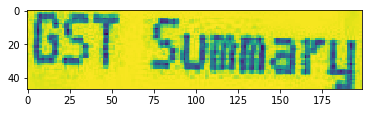

reading line : 1898
365,1050,543,1050,543,1089,365,1089,AMOUNT(RM)



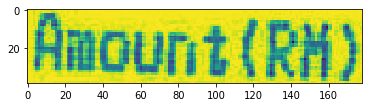

reading line : 1899
649,1060,771,1060,771,1098,649,1098,TAX(RM)



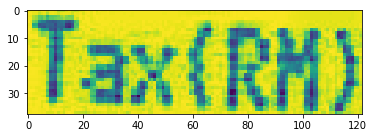

reading line : 1900
83,1092,194,1092,194,1123,83,1123,S = 6%



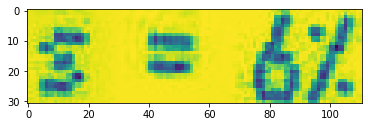

reading line : 1901
474,1104,547,1104,547,1139,474,1139,2.36



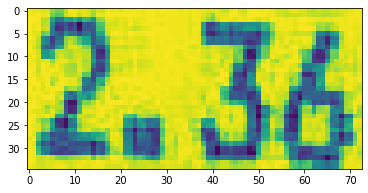

reading line : 1902
723,1115,776,1115,776,1149,723,1149,.14



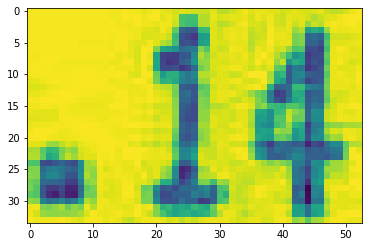

...... processing for X51005361950.jpg
reading corresponding text
reading line : 1903
200,196,696,196,696,243,200,243,99 SPEED MART S/B (519537-X)



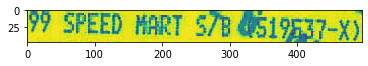

reading line : 1904
219,243,694,243,694,299,219,299,LOT P.T. 2811, JALAN ANGSA,



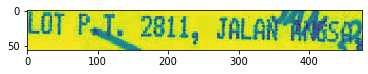

reading line : 1905
321,297,571,297,571,336,321,336,TAMAN BERKELEY



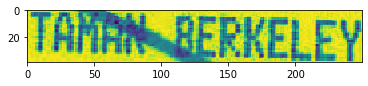

reading line : 1906
269,345,647,345,647,393,269,393,41150 KLANG, SELANGOR



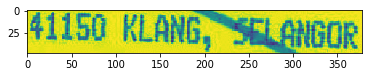

reading line : 1907
371,397,533,397,533,434,371,434,1076-IJOK



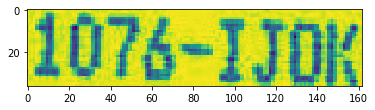

reading line : 1908
230,442,676,442,676,491,230,491,GST ID. NO : 000181747712



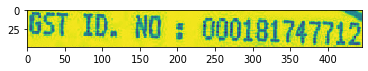

reading line : 1909
211,491,706,491,706,542,211,542,INVOICE NO : 18287/102/T0049



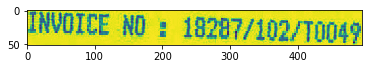

reading line : 1910
105,588,230,588,230,626,105,626,10:43AM



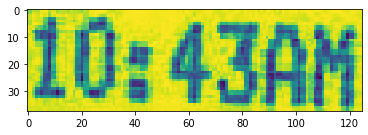

reading line : 1911
402,600,513,600,513,637,402,637,568582



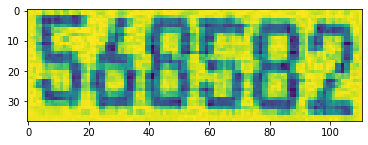

reading line : 1912
669,607,812,607,812,646,669,646,24-01-18



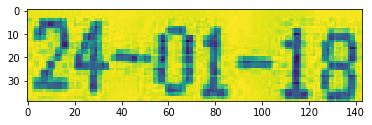

reading line : 1913
101,689,581,689,581,739,101,739,1973 GARBAGE BAG (BLUE) 74C



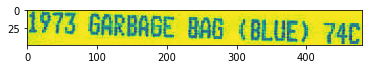

reading line : 1914
665,708,810,708,810,748,665,748,RM1.25 S



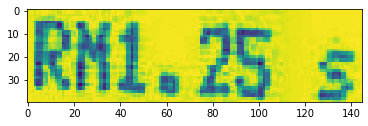

reading line : 1915
164,1240,663,1240,663,1300,164,1300,THANK YOU. PLEASE COME AGAIN



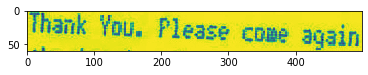

reading line : 1916
95,737,573,737,573,789,95,789,1974 GARBAGE BAG (GREEN) 74



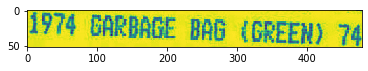

reading line : 1917
659,758,802,758,802,797,659,797,RM1.25 S



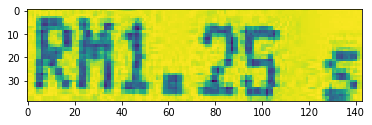

reading line : 1918
76,1288,771,1288,771,1346,76,1346,KEEP THE INVOICE FOR APPLICABLE RETURNS



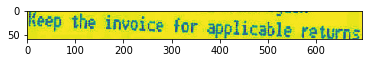

reading line : 1919
93,836,626,836,626,890,93,890,TOTAL SALES (INCLUSIVE GST) RM



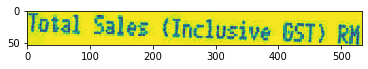

reading line : 1920
691,859,765,859,765,894,691,894,2.50



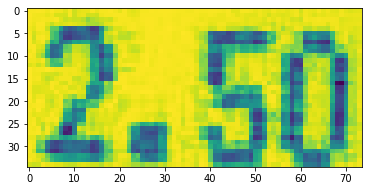

reading line : 1921
498,902,626,902,626,941,498,941,CASH RM



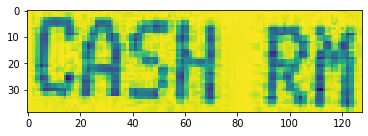

reading line : 1922
693,910,769,910,769,945,693,945,5.00



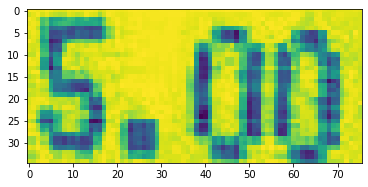

reading line : 1923
459,952,622,952,622,991,459,991,CHANGE RM



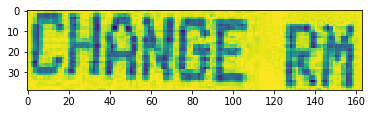

reading line : 1924
690,961,760,961,760,996,690,996,2.50



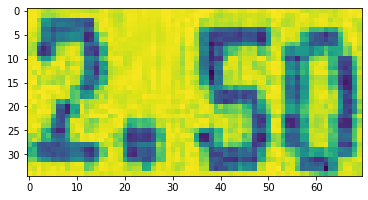

reading line : 1925
83,1038,282,1038,282,1085,83,1085,GST SUMMARY



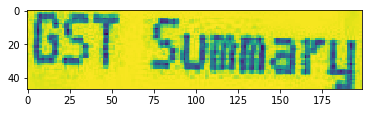

reading line : 1926
365,1050,543,1050,543,1089,365,1089,AMOUNT(RM)



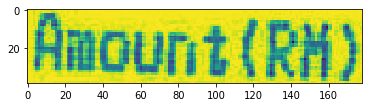

reading line : 1927
649,1060,771,1060,771,1098,649,1098,TAX(RM)



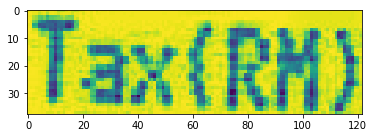

reading line : 1928
83,1092,194,1092,194,1123,83,1123,S = 6%



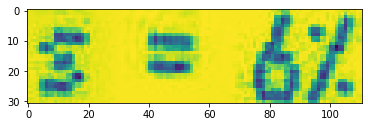

reading line : 1929
474,1104,547,1104,547,1139,474,1139,2.36



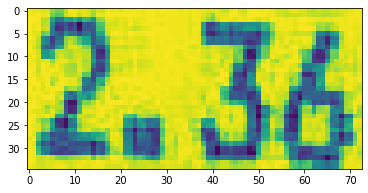

reading line : 1930
723,1115,776,1115,776,1149,723,1149,.14



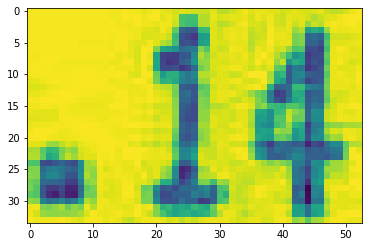

...... processing for X51005365179(1).jpg
reading corresponding text
reading line : 1931
11,28,366,28,366,85,11,85,3-1707067



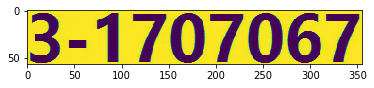

reading line : 1932
448,163,616,163,616,193,448,193,(481500-M)



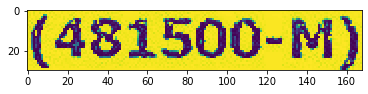

reading line : 1933
113,203,660,203,660,229,113,229,C W KHOO HARDWARE SDN BHD



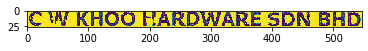

reading line : 1934
224,233,552,233,552,261,224,261,NO.50 , JALAN PBS 14/11 ,



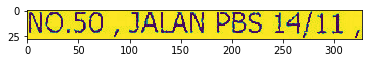

reading line : 1935
109,266,666,266,666,294,109,294,KAWASAN PERINDUSTRIAN BUKIT SERDANG,



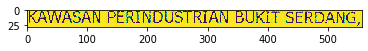

reading line : 1936
133,298,360,298,360,322,133,322,TEL : 03-89410243



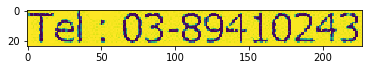

reading line : 1937
409,298,639,298,639,323,409,323,FAX : 03-89410243



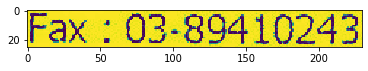

reading line : 1938
206,329,568,329,568,358,206,358,GST REG NO. : 000549584896



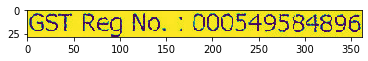

reading line : 1939
279,383,452,383,452,408,279,408,TAX INVOICE



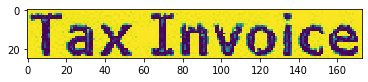

reading line : 1940
50,435,189,435,189,458,50,458,INVOICE NO.



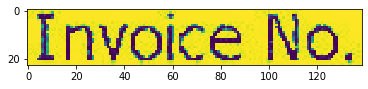

reading line : 1941
230,434,426,434,426,463,230,463,: CR 1803/0064



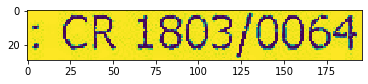

reading line : 1942
52,468,112,468,112,491,52,491,DATE



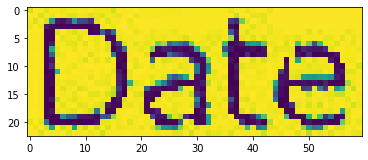

reading line : 1943
231,468,509,468,509,491,231,491,: 01-03-18 5:23:26 PM



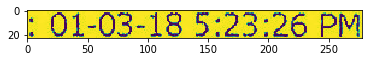

reading line : 1944
52,502,188,502,188,524,52,524,CASHIER NO.



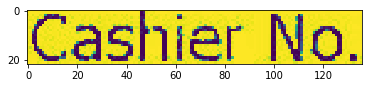

reading line : 1945
230,501,308,501,308,525,230,525,: KHOO



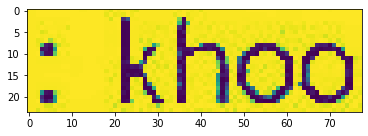

reading line : 1946
52,535,195,535,195,558,52,558,COUNTER NO.



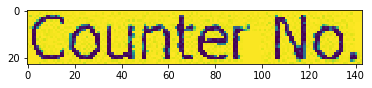

reading line : 1947
231,536,277,536,277,559,231,559,: C1



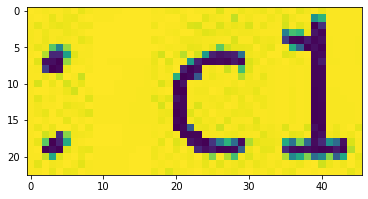

reading line : 1948
53,572,204,572,204,594,53,594,PRINTED DATE



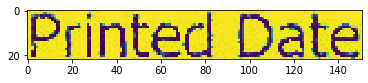

reading line : 1949
230,572,509,572,509,595,230,595,: 01-03-18 5:23:30 PM



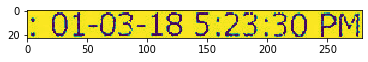

reading line : 1950
51,610,188,610,188,632,51,632,ITEM NAME



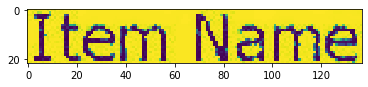

reading line : 1951
249,611,293,611,293,637,249,637,QTY



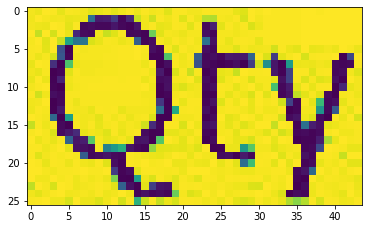

reading line : 1952
338,611,454,611,454,633,338,633,UNIT PRICE



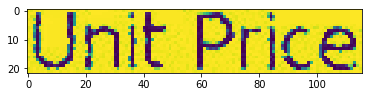

reading line : 1953
526,612,623,612,623,632,526,632,AMOUNT



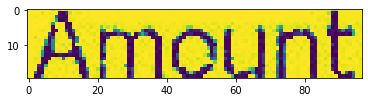

reading line : 1954
50,648,278,648,278,674,50,674,AIR ADAPTOR @ 1



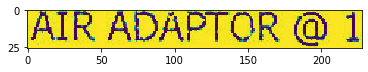

reading line : 1955
275,690,292,690,292,714,275,714,5



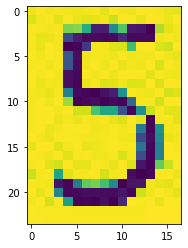

reading line : 1956
397,691,452,691,452,713,397,713,4.00



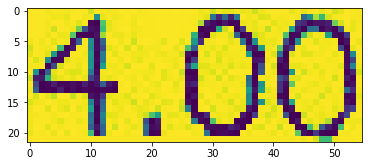

reading line : 1957
548,690,660,690,660,716,548,716,20.00 SR



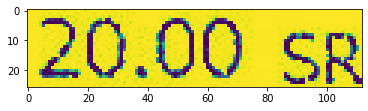

reading line : 1958
51,743,175,743,175,771,51,771,5 ITEM(S)



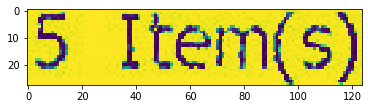

reading line : 1959
282,743,447,743,447,772,282,772,TOTAL (MYR) :



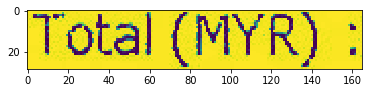

reading line : 1960
550,743,622,743,622,767,550,767,20.00



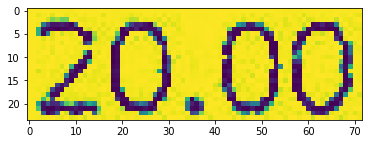

reading line : 1961
294,788,447,788,447,813,294,813,GST @ 6% :



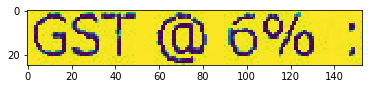

reading line : 1962
568,789,622,789,622,811,568,811,1.20



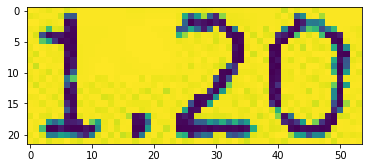

reading line : 1963
235,837,447,837,447,865,235,865,NET TOTAL (MYR) :



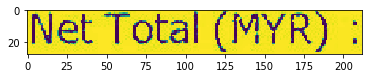

reading line : 1964
551,839,623,839,623,861,551,861,21.20



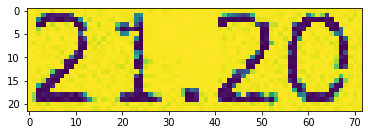

reading line : 1965
259,880,447,880,447,908,259,908,ROUNDING ADJ. :



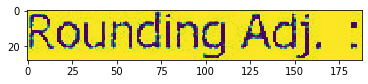

reading line : 1966
566,882,621,882,621,904,566,904,0.00



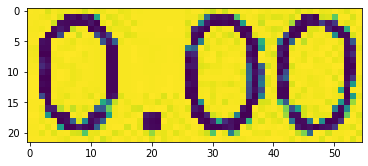

reading line : 1967
121,930,446,930,446,959,121,959,NET TOTAL ROUNDED (MYR) :



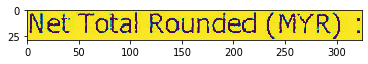

reading line : 1968
551,933,623,933,623,954,551,954,21.20



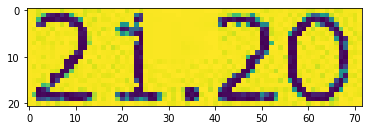

reading line : 1969
51,969,112,969,112,992,51,992,CASH



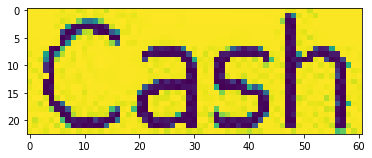

reading line : 1970
439,975,446,975,446,993,439,993,:



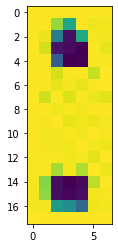

reading line : 1971
551,970,623,970,623,994,551,994,21.20



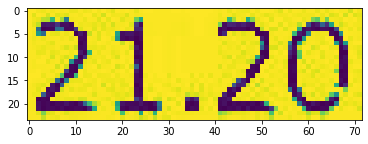

reading line : 1972
51,1018,146,1018,146,1046,51,1046,CHANGE



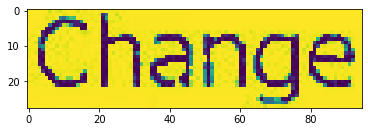

reading line : 1973
438,1022,447,1022,447,1042,438,1042,:



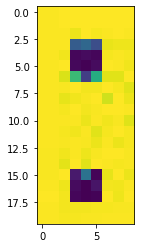

reading line : 1974
567,1020,622,1020,622,1042,567,1042,0.00



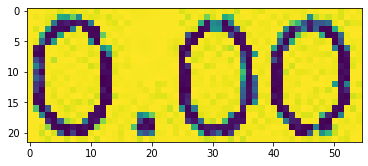

reading line : 1975
52,1103,201,1103,201,1127,52,1127,GST SUMMARY



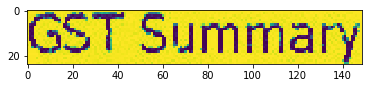

reading line : 1976
328,1103,379,1103,379,1124,328,1124,ITEM



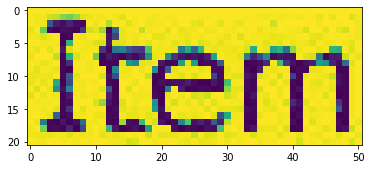

reading line : 1977
567,1103,682,1103,682,1128,567,1128,GST (MYR)



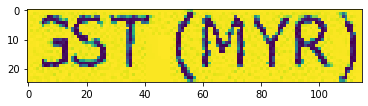

reading line : 1978
51,1149,154,1149,154,1173,51,1173,SR @ 6%



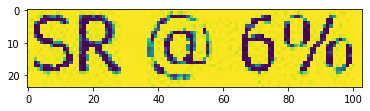

reading line : 1979
367,1150,380,1150,380,1171,367,1171,1



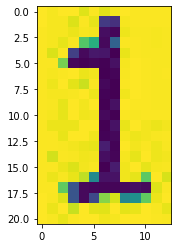

reading line : 1980
491,1150,551,1150,551,1170,491,1170,20.00



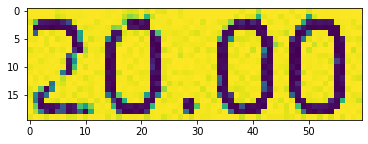

reading line : 1981
636,1149,683,1149,683,1170,636,1170,1.20



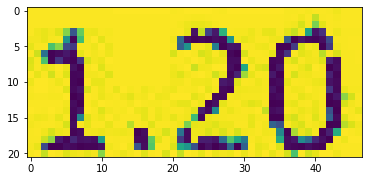

reading line : 1982
156,1259,547,1259,547,1288,156,1288,THANK YOU. PLEASE COME AGAIN !



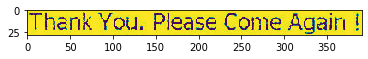

reading line : 1983
394,1103,549,1103,549,1128,394,1128,AMOUNT (MYR)



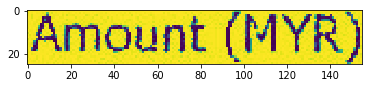

...... processing for X51005365179.jpg
reading corresponding text
reading line : 1984
11,28,366,28,366,85,11,85,3-1707067



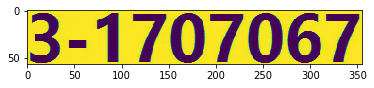

reading line : 1985
448,163,616,163,616,193,448,193,(481500-M)



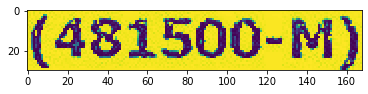

reading line : 1986
113,203,660,203,660,229,113,229,C W KHOO HARDWARE SDN BHD



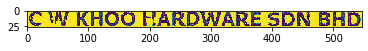

reading line : 1987
224,233,552,233,552,261,224,261,NO.50 , JALAN PBS 14/11 ,



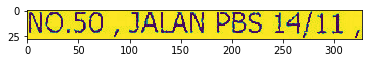

reading line : 1988
109,266,666,266,666,294,109,294,KAWASAN PERINDUSTRIAN BUKIT SERDANG,



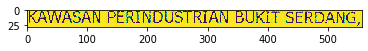

reading line : 1989
133,298,360,298,360,322,133,322,TEL : 03-89410243



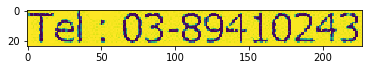

reading line : 1990
409,298,639,298,639,323,409,323,FAX : 03-89410243



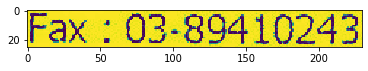

reading line : 1991
206,329,568,329,568,358,206,358,GST REG NO. : 000549584896



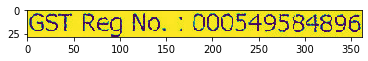

reading line : 1992
279,383,452,383,452,408,279,408,TAX INVOICE



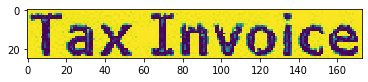

reading line : 1993
50,435,189,435,189,458,50,458,INVOICE NO.



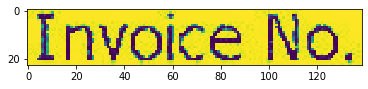

reading line : 1994
230,434,426,434,426,463,230,463,: CR 1803/0064



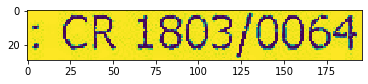

reading line : 1995
52,468,112,468,112,491,52,491,DATE



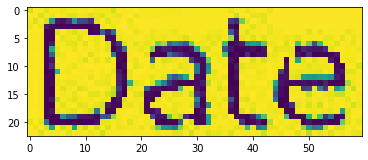

reading line : 1996
231,468,509,468,509,491,231,491,: 01-03-18 5:23:26 PM



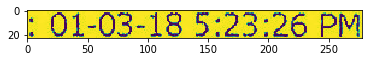

reading line : 1997
52,502,188,502,188,524,52,524,CASHIER NO.



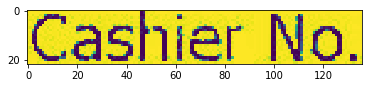

reading line : 1998
230,501,308,501,308,525,230,525,: KHOO



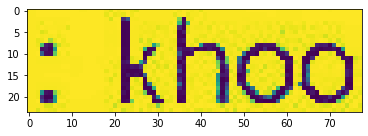

reading line : 1999
52,535,195,535,195,558,52,558,COUNTER NO.



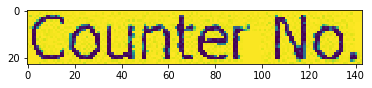

reading line : 2000
231,536,277,536,277,559,231,559,: C1



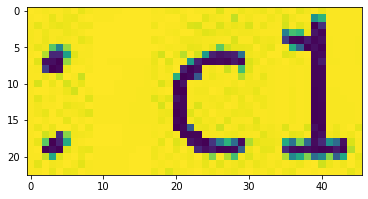

reading line : 2001
53,572,204,572,204,594,53,594,PRINTED DATE



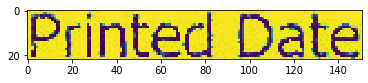

reading line : 2002
230,572,509,572,509,595,230,595,: 01-03-18 5:23:30 PM



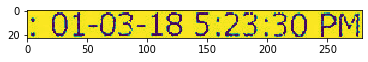

reading line : 2003
51,610,188,610,188,632,51,632,ITEM NAME



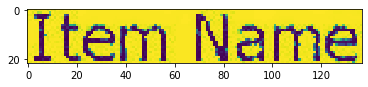

reading line : 2004
249,611,293,611,293,637,249,637,QTY



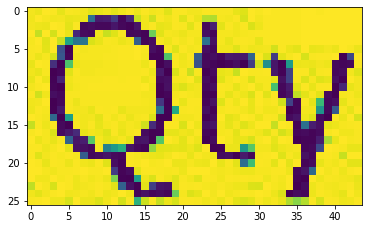

reading line : 2005
338,611,454,611,454,633,338,633,UNIT PRICE



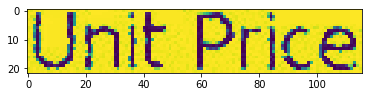

reading line : 2006
526,612,623,612,623,632,526,632,AMOUNT



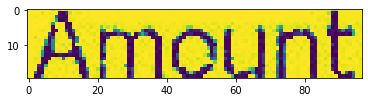

reading line : 2007
50,648,278,648,278,674,50,674,AIR ADAPTOR @ 1



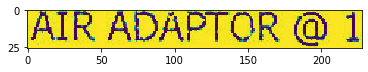

reading line : 2008
275,690,292,690,292,714,275,714,5



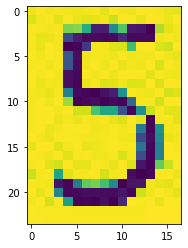

reading line : 2009
397,691,452,691,452,713,397,713,4.00



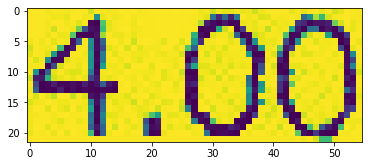

reading line : 2010
548,690,660,690,660,716,548,716,20.00 SR



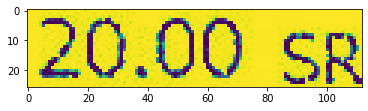

reading line : 2011
51,743,175,743,175,771,51,771,5 ITEM(S)



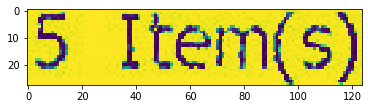

reading line : 2012
282,743,447,743,447,772,282,772,TOTAL (MYR) :



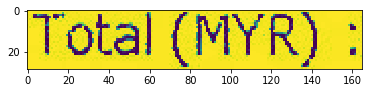

reading line : 2013
550,743,622,743,622,767,550,767,20.00



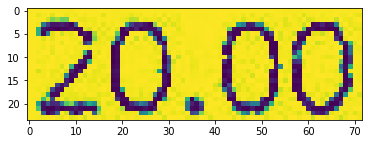

reading line : 2014
294,788,447,788,447,813,294,813,GST @ 6% :



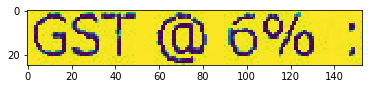

reading line : 2015
568,789,622,789,622,811,568,811,1.20



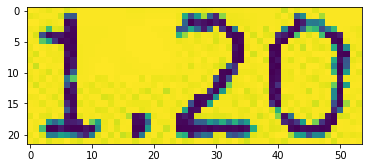

reading line : 2016
235,837,447,837,447,865,235,865,NET TOTAL (MYR) :



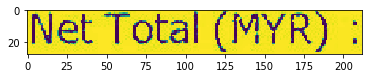

reading line : 2017
551,839,623,839,623,861,551,861,21.20



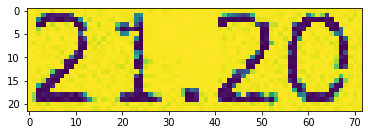

reading line : 2018
259,880,447,880,447,908,259,908,ROUNDING ADJ. :



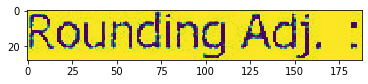

reading line : 2019
566,882,621,882,621,904,566,904,0.00



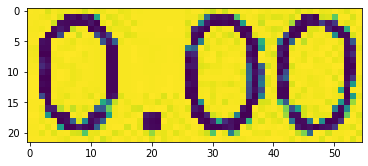

reading line : 2020
121,930,446,930,446,959,121,959,NET TOTAL ROUNDED (MYR) :



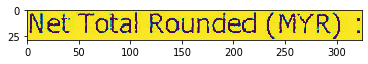

reading line : 2021
551,933,623,933,623,954,551,954,21.20



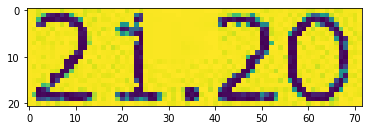

reading line : 2022
51,969,112,969,112,992,51,992,CASH



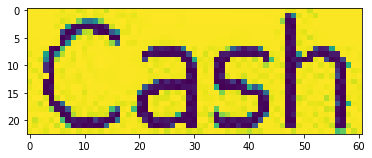

reading line : 2023
439,975,446,975,446,993,439,993,:



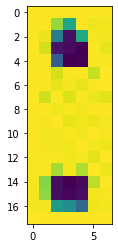

reading line : 2024
551,970,623,970,623,994,551,994,21.20



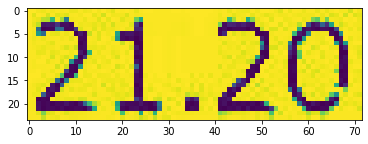

reading line : 2025
51,1018,146,1018,146,1046,51,1046,CHANGE



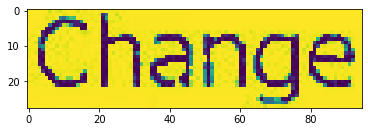

reading line : 2026
438,1022,447,1022,447,1042,438,1042,:



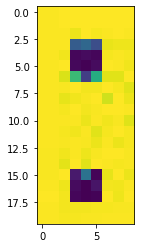

reading line : 2027
567,1020,622,1020,622,1042,567,1042,0.00



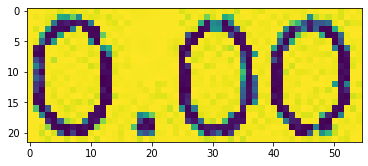

reading line : 2028
52,1103,201,1103,201,1127,52,1127,GST SUMMARY



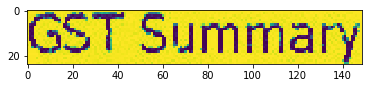

reading line : 2029
328,1103,379,1103,379,1124,328,1124,ITEM



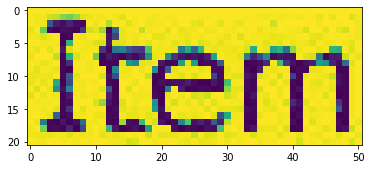

reading line : 2030
567,1103,682,1103,682,1128,567,1128,GST (MYR)



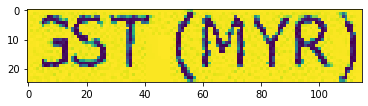

reading line : 2031
51,1149,154,1149,154,1173,51,1173,SR @ 6%



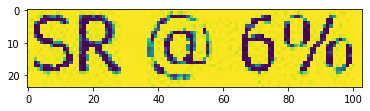

reading line : 2032
367,1150,380,1150,380,1171,367,1171,1



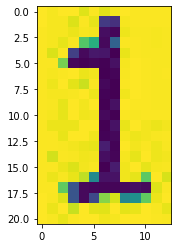

reading line : 2033
491,1150,551,1150,551,1170,491,1170,20.00



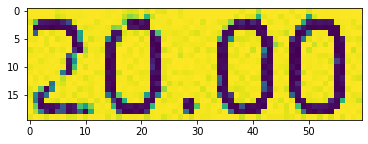

reading line : 2034
636,1149,683,1149,683,1170,636,1170,1.20



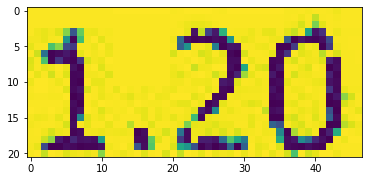

reading line : 2035
156,1259,547,1259,547,1288,156,1288,THANK YOU. PLEASE COME AGAIN !



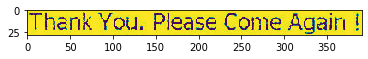

reading line : 2036
394,1103,549,1103,549,1128,394,1128,AMOUNT (MYR)



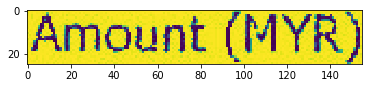

...... processing for X51005433492(1).jpg
file not found


In [16]:
path = 'DATA/train'
import os
import fnmatch
d = 'train' 
count=0
max_label_len = 0
for root, dirnames, filenames in os.walk(path):
    #print(filenames)
    

    try:
        
        count = 0
        count_text = 0
        error=[]
        for f_name in fnmatch.filter(filenames,'*.jpg'):
            print('...... processing for {}'.format(f_name))
            name, ext = os.path.splitext(f_name)
            img = cv2.cvtColor(cv2.imread(os.path.join(root,f_name)), cv2.COLOR_BGR2GRAY)
            
            with open(os.path.join(root,name+'.txt'),'r') as fh:
                print('reading corresponding text')
                all_lines = fh.readlines()
                try:
                    for line in all_lines:
                        print('reading line :',count+1)
                        print(line)
                        l = [int(i) for i in line.split(',')[0:8]]
                        y1 = l[1]
                        y2 = l[5]
                        x1= l[0]
                        x2 = l[4]
    #                     img+'count' = img[y1:y2, x1:x2]
                        plt.imshow(img[y1:y2, x1:x2])
                        plt.show()
                        cv2.imwrite("ocr-{:03d}.jpg".format(count+1), img[y1:y2, x1:x2])
                        label = line.split(',')[8:]
                        file = open("ocr-{:03d}.txt".format(count+1),"w")  

                        # \n is placed to indicate EOL (End of Line) 
                        file.write(label[0]) 
                        file.close()
                        count+=1
    #                     if len(txt) > max_label_len:
    #                         max_label_len = len(txt)
    #                     plt.imshow(img1)
    #                     plt.show()
                except Exception as e:
                    print('following has an error :',name)
                    print('Exception:',e)
                    error.append(name)
                    pass
            count_text+=1
                    
                    
    except FileNotFoundError:
        print('file not found')
        error.append(name)
        continue;

     

# Code to build the training and validation set out of the ~37k images in 'Data/train_final'
10% validation, 90% training

In [260]:
path = 'DATA/train_final'
 
# lists for training dataset
training_img = []
training_txt = []
train_input_length = []
train_label_length = []
orig_txt = []
 
#lists for validation dataset
valid_img = []
valid_txt = []
valid_input_length = []
valid_label_length = []
valid_orig_txt = []
 
max_label_len = 0
 
i =1 
flag = 0
 
for root, dirnames, filenames in os.walk(path):
    cunt,cont=0,0
    for f_name in fnmatch.filter(filenames, '*.jpg'):
        print(f_name)
        # read input image and convert into gray scale image
        img = cv2.cvtColor(cv2.imread(os.path.join(root, f_name)), cv2.COLOR_BGR2GRAY)   
        img = cv2.resize(img, (290, 32))
        # convert each image of shape (32, 128, 1)
        w, h = img.shape
        
#         if h > 128 or w > 32:
#             pass
#         if w < 32:
#             add_zeros = np.ones((32-w, h))*255
#             img = np.concatenate((img, add_zeros))
 
#         if h < 128:
#             add_zeros = np.ones((32, 128-h))*255
#             img = np.concatenate((img, add_zeros), axis=1)
        img = np.expand_dims(img , axis = 2)
        
        # Normalize each image
        img = img/255.
        name, ext = os.path.splitext(f_name)
        with open(os.path.join(root,name+'.txt'),'r') as fh:
                all_lines = fh.readlines()
                for line in all_lines:
                    txt = line
        print(img.shape)
        print(txt)
        
        # get the text from the image
        
        
        # compute maximum length of the text
        if len(txt) > max_label_len:
            max_label_len = len(txt)
            
           
        # split the 150000 data into validation and training dataset as 10% and 90% respectively
        if i%10 == 0:
            valid_orig_txt.append(txt)   
            valid_label_length.append(len(txt))
            valid_input_length.append(71)
            valid_img.append(img)
            valid_txt.append(encode_to_labels(txt))
            print('valid image shape :',len(valid_img),i)
        else:
            cont+=1
            orig_txt.append(txt)   
            train_label_length.append(len(txt))
            train_input_length.append(71)
            training_img.append(img)
            training_txt.append(encode_to_labels(txt))
            print('train image shape :',len(training_img),i)
        i+=1
    print(i)
        
        # break the loop if total data is 150000
#         if i == 150000:
#             flag = 1
#             break
#         i+=1
#     if flag == 1:
#         break

ocr-001.jpg
(32, 290, 1)
TAN WOON YANN

 
 


train image shape : 1 1
ocr-002.jpg
(32, 290, 1)
BOOK TA .K(TAMAN DAYA) SDN BND

 
 
.
(
 
)
 
 


train image shape : 2 2
ocr-003.jpg
(32, 290, 1)
789417-W

-


train image shape : 3 3
ocr-004.jpg
(32, 290, 1)
NO.53 55
.
 
train image shape : 4 4
ocr-005.jpg
(32, 290, 1)
TAMAN DAYA
 
train image shape : 5 5
ocr-006.jpg
(32, 290, 1)
81100 JOHOR BAHRU
 
 
train image shape : 6 6
ocr-007.jpg
(32, 290, 1)
JOHOR.

.


train image shape : 7 7
ocr-008.jpg
(32, 290, 1)
DOCUMENT NO : TD01167104

 
 
:
 


train image shape : 8 8
ocr-009.jpg
(32, 290, 1)
DATE:

:


train image shape : 9 9
ocr-010.jpg
(32, 290, 1)
25/12/2018 8:13:39 PM

/
/
 
:
:
 


valid image shape : 1 10
ocr-011.jpg
(32, 290, 1)
CASHIER:

:


train image shape : 10 11
ocr-012.jpg
(32, 290, 1)
MANIS



train image shape : 11 12
ocr-013.jpg
(32, 290, 1)
MEMBER:

:


train image shape : 12 13
ocr-014.jpg
(32, 290, 1)
CASH BILL

 


train image shape : 13 14
ocr-015.jpg
(32, 290, 1)


(32, 290, 1)
TBL35 / 1

 
/
 


train image shape : 114 126
ocr-10023.jpg
(32, 290, 1)
1 D28 MILO DINO (I) E

 
 
 
 
(
)
 


train image shape : 115 127
ocr-10024.jpg
(32, 290, 1)
7.45 S

.
 


train image shape : 116 128
ocr-10025.jpg
(32, 290, 1)
2 R03 N'LEMAK+FC E @17.83

 
 
'
+
 
 
@
.


train image shape : 117 129
ocr-10026.jpg
(32, 290, 1)
35.66 S

.
 


valid image shape : 13 130
ocr-10027.jpg
(32, 290, 1)
1 N22 SPRG NDL+SU+CR E

 
 
 
+
+
 


train image shape : 118 131
ocr-10028.jpg
(32, 290, 1)
9.34 S

.
 


train image shape : 119 132
ocr-10029.jpg
(32, 290, 1)
1 B02 HALF BL EGG E

 
 
 
 
 


train image shape : 120 133
ocr-1003.jpg
(32, 290, 1)
0.00

.


train image shape : 121 134
ocr-10030.jpg
(32, 290, 1)
4.53 S

.
 


train image shape : 122 135
ocr-10031.jpg
(32, 290, 1)
1 D19 CHAM (I) E

 
 
 
(
)
 


train image shape : 123 136
ocr-10032.jpg
(32, 290, 1)
5.57 S

.
 


train image shape : 124 137
ocr-10033.jpg
(32, 290, 1)
CASH



train image shape : 125 138
ocr-10

(32, 290, 1)
LEVEL 6
 
train image shape : 237 263
ocr-10147.jpg
(32, 290, 1)
NO.3
.
train image shape : 238 264
ocr-10148.jpg
(32, 290, 1)
SELANGOR



train image shape : 239 265
ocr-10149.jpg
(32, 290, 1)
(GST ID NO: 00504664064)

(
 
 
:
 
)


train image shape : 240 266
ocr-1015.jpg
(32, 290, 1)
COVER : 1

 
:
 


train image shape : 241 267
ocr-10150.jpg
(32, 290, 1)
MCDONALD'S RAWANG DT (#188)

'
 
 
 
(
#
)


train image shape : 242 268
ocr-10151.jpg
(32, 290, 1)
TEL NO. 03-6092-1968

 
.
 
-
-


train image shape : 243 269
ocr-10152.jpg
(32, 290, 1)
TAX INVOICE

 


valid image shape : 27 270
ocr-10153.jpg
(32, 290, 1)
MFY SIDE 1

 
 


train image shape : 244 271
ocr-10154.jpg
(32, 290, 1)
INV# 001881904580783

#
 


train image shape : 245 272
ocr-10155.jpg
(32, 290, 1)
ORD #70 -REG #19- 18/03/2018

 
#
 
-
 
#
-
 
/
/


train image shape : 246 273
ocr-10156.jpg
(32, 290, 1)
23:02:16

:
:


train image shape : 247 274
ocr-10157.jpg
(32, 290, 1)
QTY ITEM

 


train image shape

(32, 290, 1)
CHANGE



train image shape : 371 412
ocr-10281.jpg
(32, 290, 1)
20.00

.


train image shape : 372 413
ocr-10282.jpg
(32, 290, 1)
GST SUMMARY

 


train image shape : 373 414
ocr-10283.jpg
(32, 290, 1)
AMOUNT(RM)

(
)


train image shape : 374 415
ocr-10284.jpg
(32, 290, 1)
TAX(RM)

(
)


train image shape : 375 416
ocr-10285.jpg
(32, 290, 1)
S(6%)

(
%
)


train image shape : 376 417
ocr-10286.jpg
(32, 290, 1)
28.30

.


train image shape : 377 418
ocr-10287.jpg
(32, 290, 1)
1.70

.


train image shape : 378 419
ocr-10288.jpg
(32, 290, 1)
28/03/2018

/
/


valid image shape : 42 420
ocr-10289.jpg
(32, 290, 1)
10:36:13

:
:


train image shape : 379 421
ocr-1029.jpg
(32, 290, 1)
-

-


train image shape : 380 422
ocr-10290.jpg
(32, 290, 1)
GOODS SOLD ONLY EXCHANGEABLE WITHIN 3 DAYS

 
 
 
 
 
 


train image shape : 381 423
ocr-10291.jpg
(32, 290, 1)
GOODS SOLD ARE NOT REFUNDABLE

 
 
 
 


train image shape : 382 424
ocr-10292.jpg
(32, 290, 1)
THANK YOU FOR KIND SUPPORT


:
 
/
/
 
:
:
 


train image shape : 501 556
ocr-10410.jpg
(32, 290, 1)
SLIP NO.: 0010291725

 
.
:
 


train image shape : 502 557
ocr-10411.jpg
(32, 290, 1)
CHEAH PEI NI

 
 


train image shape : 503 558
ocr-10412.jpg
(32, 290, 1)
TRANS: 246761

:
 


train image shape : 504 559
ocr-10413.jpg
(32, 290, 1)
DESCRIPTION



valid image shape : 56 560
ocr-10414.jpg
(32, 290, 1)
AMOUNT



train image shape : 505 561
ocr-10415.jpg
(32, 290, 1)
CORR. PEN ZLI-W

.
 
 
-


train image shape : 506 562
ocr-10416.jpg
(32, 290, 1)
7.65 T

.
 


train image shape : 507 563
ocr-10417.jpg
(32, 290, 1)
PB F/ RING FILE W/CLI

 
/
 
 
 
/


train image shape : 508 564
ocr-10418.jpg
(32, 290, 1)
6.99 T

.
 


train image shape : 509 565
ocr-10419.jpg
(32, 290, 1)
TOTAL RM INCL. OF GST

 
 
.
 
 


train image shape : 510 566
ocr-1042.jpg
(32, 290, 1)
ZR/OS/EZ

/
/


train image shape : 511 567
ocr-10420.jpg
(32, 290, 1)
14.64

.


train image shape : 512 568
ocr-10421.jpg
(32, 290, 1)
ROUNDING ADJ

 



train image shape : 627 696
ocr-10537.jpg
(32, 290, 1)
1 AYAMGORENG(TA)

 
(
)


train image shape : 628 697
ocr-10538.jpg
(32, 290, 1)
9.90

.


train image shape : 629 698
ocr-10539.jpg
(32, 290, 1)
TAKEOUT TOTAL (INCL GST)

 
 
(
 
)


train image shape : 630 699
ocr-1054.jpg
(32, 290, 1)
:

:


valid image shape : 70 700
ocr-10540.jpg
(32, 290, 1)
28.50

.


train image shape : 631 701
ocr-10541.jpg
(32, 290, 1)
TOTAL ROUNDED

 


train image shape : 632 702
ocr-10542.jpg
(32, 290, 1)
28.50

.


train image shape : 633 703
ocr-10543.jpg
(32, 290, 1)
CASH TENDERED

 


train image shape : 634 704
ocr-10544.jpg
(32, 290, 1)
50.00

.


train image shape : 635 705
ocr-10545.jpg
(32, 290, 1)
CHANGE



train image shape : 636 706
ocr-10546.jpg
(32, 290, 1)
21.50

.


train image shape : 637 707
ocr-10547.jpg
(32, 290, 1)
TOTAL INCLUDES 6% GST

 
 
%
 


train image shape : 638 708
ocr-10548.jpg
(32, 290, 1)
1.61

.


train image shape : 639 709
ocr-10549.jpg
(32, 290, 1)
THANK YOU AND PL


train image shape : 753 836
ocr-10663.jpg
(32, 290, 1)
S



train image shape : 754 837
ocr-10664.jpg
(32, 290, 1)
7094 NEOBUN PLASTER 10PCS

 
 
 


train image shape : 755 838
ocr-10665.jpg
(32, 290, 1)
RM3.20

.


train image shape : 756 839
ocr-10666.jpg
(32, 290, 1)
S



valid image shape : 84 840
ocr-10667.jpg
(32, 290, 1)
TOTAL SALES (INCLUSIVE GST)

 
 
(
 
)


train image shape : 757 841
ocr-10668.jpg
(32, 290, 1)
CASH



train image shape : 758 842
ocr-10669.jpg
(32, 290, 1)
CHANGE



train image shape : 759 843
ocr-1067.jpg
(32, 290, 1)
QTY



train image shape : 760 844
ocr-10670.jpg
(32, 290, 1)
RM



train image shape : 761 845
ocr-10671.jpg
(32, 290, 1)
RM



train image shape : 762 846
ocr-10672.jpg
(32, 290, 1)
RM



train image shape : 763 847
ocr-10673.jpg
(32, 290, 1)
3.70

.


train image shape : 764 848
ocr-10674.jpg
(32, 290, 1)
10.00

.


train image shape : 765 849
ocr-10675.jpg
(32, 290, 1)
6.30

.


valid image shape : 85 850
ocr-10676.jpg
(32, 290, 1)
GST S

(32, 290, 1)
NADEJE PRESTIGE SDN BHD

 
 
 


train image shape : 872 968
ocr-10782.jpg
(32, 290, 1)
LOT NO . : G1 . 116A 
 
 
.
 
:
 
 
.
 
 
train image shape : 873 969
ocr-10783.jpg
(32, 290, 1)
SUNWAY PYRAMID 
 
 
valid image shape : 97 970
ocr-10784.jpg
(32, 290, 1)
BANDAR SUNWAY 
 
 
train image shape : 874 971
ocr-10785.jpg
(32, 290, 1)
(1198447-X)

(
-
)


train image shape : 875 972
ocr-10786.jpg
(32, 290, 1)
GST ID : 000182431744

 
 
:
 


train image shape : 876 973
ocr-10787.jpg
(32, 290, 1)
TAX INVOICE

 


train image shape : 877 974
ocr-10788.jpg
(32, 290, 1)
INVOICE : 000-074020

 
:
 
-


train image shape : 878 975
ocr-10789.jpg
(32, 290, 1)
DATE : 2018/02/22 13 : 34 : 14

 
:
 
/
/
 
 
:
 
 
:
 


train image shape : 879 976
ocr-1079.jpg
(32, 290, 1)
2.25

.


train image shape : 880 977
ocr-10790.jpg
(32, 290, 1)
TAKE OUT

 


train image shape : 881 978
ocr-10791.jpg
(32, 290, 1)
ORIGINAL SLICE

 


train image shape : 882 979
ocr-10792.jpg
(32, 290, 1)
DOUBLECHOC

(32, 290, 1)
INC 6% GST

 
%
 


train image shape : 985 1094
ocr-10896.jpg
(32, 290, 1)
1.62

.


train image shape : 986 1095
ocr-10897.jpg
(32, 290, 1)
TAX INVOICE

 


train image shape : 987 1096
ocr-10898.jpg
(32, 290, 1)
#001-001-0934-0001 05/01/2018 13:30-R

#
-
-
-
 
/
/
 
:
-


train image shape : 988 1097
ocr-10899.jpg
(32, 290, 1)
GST : 002008047616

 
:
 


train image shape : 989 1098
ocr-109.jpg
(32, 290, 1)
HC03-7 - 15

-
 
-
 


train image shape : 990 1099
ocr-1090.jpg
(32, 290, 1)
CAS



valid image shape : 110 1100
ocr-10900.jpg
(32, 290, 1)
THANK YOU

 


train image shape : 991 1101
ocr-10901.jpg
(32, 290, 1)
MR . DAKGALBI SOLARIS

 
.
 
 


train image shape : 992 1102
ocr-10902.jpg
(32, 290, 1)
BRN GST NO . 000417619968

 
 
 
.
 


train image shape : 993 1103
ocr-10903.jpg
(32, 290, 1)
PRESIDENT : KANG

 
:
 


train image shape : 994 1104
ocr-10904.jpg
(32, 290, 1)
NO . J-G-02
 
.
 
-
-
train image shape : 995 1105
ocr-10905.jpg
(32, 290, 1)
480 KL

 


train


train image shape : 1097 1218
ocr-11007.jpg
(32, 290, 1)
CHEE CHEONG FUN (SOS)

 
 
 
(
)


train image shape : 1098 1219
ocr-11008.jpg
(32, 290, 1)
RM2.70

.


valid image shape : 122 1220
ocr-11009.jpg
(32, 290, 1)
RM2.95

.


train image shape : 1099 1221
ocr-1101.jpg
(32, 290, 1)
:

:


train image shape : 1100 1222
ocr-11010.jpg
(32, 290, 1)
RM11.60

.


train image shape : 1101 1223
ocr-11011.jpg
(32, 290, 1)
RM11.60

.


train image shape : 1102 1224
ocr-11012.jpg
(32, 290, 1)
RM11.60

.


train image shape : 1103 1225
ocr-11013.jpg
(32, 290, 1)
RM0.65

.


train image shape : 1104 1226
ocr-11014.jpg
(32, 290, 1)
RM5.30

.


train image shape : 1105 1227
ocr-11015.jpg
(32, 290, 1)
RM7.20

.


train image shape : 1106 1228
ocr-11016.jpg
(32, 290, 1)
S



train image shape : 1107 1229
ocr-11017.jpg
(32, 290, 1)
S



valid image shape : 123 1230
ocr-11018.jpg
(32, 290, 1)
S



train image shape : 1108 1231
ocr-11019.jpg
(32, 290, 1)
S



train image shape : 1109 1232
ocr-1102.jpg


 
 
%
 
 
:
 
.
)


train image shape : 1219 1354
ocr-1113.jpg
(32, 290, 1)
2



train image shape : 1220 1355
ocr-11130.jpg
(32, 290, 1)
CASH



train image shape : 1221 1356
ocr-11131.jpg
(32, 290, 1)
CHANGE



train image shape : 1222 1357
ocr-11132.jpg
(32, 290, 1)
RM30.30

.


train image shape : 1223 1358
ocr-11133.jpg
(32, 290, 1)
RM1.00

.


train image shape : 1224 1359
ocr-11134.jpg
(32, 290, 1)
THANK YOU.

 
.


valid image shape : 136 1360
ocr-11135.jpg
(32, 290, 1)
PLEASE VISIT US AT : -

 
 
 
 
:
 
-


train image shape : 1225 1361
ocr-11136.jpg
(32, 290, 1)
FACEBOOK : -YAM FRESH

 
:
 
-
 


train image shape : 1226 1362
ocr-11137.jpg
(32, 290, 1)
S



train image shape : 1227 1363
ocr-11138.jpg
(32, 290, 1)
WIFI SSID : YAMFRESH

 
 
:
 


train image shape : 1228 1364
ocr-11139.jpg
(32, 290, 1)
WIFI PASWORD : BUYADRINKFIRST

 
 
:
 


train image shape : 1229 1365
ocr-1114.jpg
(32, 290, 1)
* RM 33.02 UNI ( 3.96)=RM 66.04

*
 
 
.
 
 
(
 
.
)
=
 
.


train image shape :

(32, 290, 1)
MR. D. I. Y. (KUCHAI) SDN BHD

.
 
.
 
.
 
.
 
(
)
 
 


train image shape : 1332 1479
ocr-11242.jpg
(32, 290, 1)
(CO REG : 750441-W)

(
 
 
:
 
-
)


valid image shape : 148 1480
ocr-11243.jpg
(32, 290, 1)
LOT 1851-A & 1851-B
 
-
 
&
 
-
train image shape : 1333 1481
ocr-11244.jpg
(32, 290, 1)
KAWASAN PERINDUSTRIAN BALAKONG 
 
 
 
train image shape : 1334 1482
ocr-11245.jpg
(32, 290, 1)
43300 SERI KEMBANGAN 
 
 
 
train image shape : 1335 1483
ocr-11246.jpg
(32, 290, 1)
(GST ID NO : 000473792512)

(
 
 
 
:
 
)


train image shape : 1336 1484
ocr-11247.jpg
(32, 290, 1)
(TESCO MENJALARA KEPONG 
(
 
 
 
train image shape : 1337 1485
ocr-11248.jpg
(32, 290, 1)
TAX INVOICE

 


train image shape : 1338 1486
ocr-11249.jpg
(32, 290, 1)
EPOXY PUTTY+ (2 X 50GM)

 
+
 
(
 
 
)


train image shape : 1339 1487
ocr-1125.jpg
(32, 290, 1)
RM



train image shape : 1340 1488
ocr-11250.jpg
(32, 290, 1)
WA17 - 12/144

 
-
 
/


train image shape : 1341 1489
ocr-11251.jpg
(32, 290, 1)
9555


 


train image shape : 1449 1609
ocr-1136.jpg
(32, 290, 1)
RM



valid image shape : 161 1610
ocr-11360.jpg
(32, 290, 1)
GRAND TOTAL

 


train image shape : 1450 1611
ocr-11361.jpg
(32, 290, 1)
PAYMENT



train image shape : 1451 1612
ocr-11362.jpg
(32, 290, 1)
CHANGE DUE

 


train image shape : 1452 1613
ocr-11363.jpg
(32, 290, 1)
*6% GST INCLUDED

*
%
 
 


train image shape : 1453 1614
ocr-11364.jpg
(32, 290, 1)
:

:


train image shape : 1454 1615
ocr-11365.jpg
(32, 290, 1)
:

:


train image shape : 1455 1616
ocr-11366.jpg
(32, 290, 1)
:

:


train image shape : 1456 1617
ocr-11367.jpg
(32, 290, 1)
:

:


train image shape : 1457 1618
ocr-11368.jpg
(32, 290, 1)
:

:


train image shape : 1458 1619
ocr-11369.jpg
(32, 290, 1)
:

:


valid image shape : 162 1620
ocr-1137.jpg
(32, 290, 1)
0.00

.


train image shape : 1459 1621
ocr-11370.jpg
(32, 290, 1)
:

:


train image shape : 1460 1622
ocr-11371.jpg
(32, 290, 1)
60.60

.


train image shape : 1461 1623
ocr-11372.jpg
(32, 290,

train image shape : 1560 1733
ocr-11471.jpg
(32, 290, 1)
1.90 T

.
 


train image shape : 1561 1734
ocr-11472.jpg
(32, 290, 1)
H/C A4 400'S

/
 
 
'


train image shape : 1562 1735
ocr-11473.jpg
(32, 290, 1)
9.90 T

.
 


train image shape : 1563 1736
ocr-11474.jpg
(32, 290, 1)
TOTAL RM INCL. OF GST

 
 
.
 
 


train image shape : 1564 1737
ocr-11475.jpg
(32, 290, 1)
11.80

.


train image shape : 1565 1738
ocr-11476.jpg
(32, 290, 1)
CASH



train image shape : 1566 1739
ocr-11477.jpg
(32, 290, 1)
-11.80

-
.


valid image shape : 174 1740
ocr-11478.jpg
(32, 290, 1)
ITEM COUNT

 


train image shape : 1567 1741
ocr-11479.jpg
(32, 290, 1)
2



train image shape : 1568 1742
ocr-1148.jpg
(32, 290, 1)
TAX (RM)

 
(
)


train image shape : 1569 1743
ocr-11480.jpg
(32, 290, 1)
GST SUMMARY

 


train image shape : 1570 1744
ocr-11481.jpg
(32, 290, 1)
AMOUNT (RM)

 
(
)


train image shape : 1571 1745
ocr-11482.jpg
(32, 290, 1)
TAX (RM)

 
(
)


train image shape : 1572 1746
ocr-11483.jpg
(3

train image shape : 1671 1856
ocr-11582.jpg
(32, 290, 1)
TIME: 08:58:00

:
 
:
:


train image shape : 1672 1857
ocr-11583.jpg
(32, 290, 1)
SALESPERSON :

 
:


train image shape : 1673 1858
ocr-11584.jpg
(32, 290, 1)
REF. :

.
 
:


train image shape : 1674 1859
ocr-11585.jpg
(32, 290, 1)
ITEM



valid image shape : 186 1860
ocr-11586.jpg
(32, 290, 1)
QTY



train image shape : 1675 1861
ocr-11587.jpg
(32, 290, 1)
S/PRICE

/


train image shape : 1676 1862
ocr-11588.jpg
(32, 290, 1)
(GST)

(
)


train image shape : 1677 1863
ocr-11589.jpg
(32, 290, 1)
(GST)

(
)


train image shape : 1678 1864
ocr-1159.jpg
(32, 290, 1)
53300 KL

 


train image shape : 1679 1865
ocr-11590.jpg
(32, 290, 1)
TAX



train image shape : 1680 1866
ocr-11591.jpg
(32, 290, 1)
101869



train image shape : 1681 1867
ocr-11592.jpg
(32, 290, 1)
2



train image shape : 1682 1868
ocr-11593.jpg
(32, 290, 1)
60.00

.


train image shape : 1683 1869
ocr-11594.jpg
(32, 290, 1)
63.60

.


valid image shape : 187 1870


(32, 290, 1)
9557031100236



train image shape : 1789 1987
ocr-1170.jpg
(32, 290, 1)
TOTAL



train image shape : 1790 1988
ocr-11700.jpg
(32, 290, 1)
(0005583085-K)

(
-
)


train image shape : 1791 1989
ocr-11701.jpg
(32, 290, 1)
LOT 276 JALAN BANTING

 
 
 


valid image shape : 199 1990
ocr-11702.jpg
(32, 290, 1)
43800 DENGKIL
 
train image shape : 1792 1991
ocr-11703.jpg
(32, 290, 1)
TEL : 03-87686092

 
:
 
-


train image shape : 1793 1992
ocr-11704.jpg
(32, 290, 1)
FAX : 03-87686092

 
:
 
-


train image shape : 1794 1993
ocr-11705.jpg
(32, 290, 1)
GST ID : 000781500416

 
 
:
 


train image shape : 1795 1994
ocr-11706.jpg
(32, 290, 1)
TAX INVOICE

 


train image shape : 1796 1995
ocr-11707.jpg
(32, 290, 1)
BILL TO :

 
 
:


train image shape : 1797 1996
ocr-11708.jpg
(32, 290, 1)
SUCI ALAM JAYA TRANSPORT

 
 
 


train image shape : 1798 1997
ocr-11709.jpg
(32, 290, 1)
NO 1 JALAN AMAN 2

 
 
 
 


train image shape : 1799 1998
ocr-1171.jpg
(32, 290, 1)
RM



train image s

train image shape : 1909 2121
ocr-11820.jpg
(32, 290, 1)
LOT 1626
 
train image shape : 1910 2122
ocr-11821.jpg
(32, 290, 1)
TUMPAT



train image shape : 1911 2123
ocr-11822.jpg
(32, 290, 1)
16200 PALEKBANG
 
train image shape : 1912 2124
ocr-11823.jpg
(32, 290, 1)
PREPAY CHIT NUMBER

 
 


train image shape : 1913 2125
ocr-11824.jpg
(32, 290, 1)
29721



train image shape : 1914 2126
ocr-11825.jpg
(32, 290, 1)
THIS IS NOT A RECEIPT

 
 
 
 


train image shape : 1915 2127
ocr-11826.jpg
(32, 290, 1)
A TAX INVOICE WILL BE ISSUED UPON THE

 
 
 
 
 
 
 


train image shape : 1916 2128
ocr-11827.jpg
(32, 290, 1)
COMPLETION OF THE SALE TRANSACTION

 
 
 
 


train image shape : 1917 2129
ocr-11828.jpg
(32, 290, 1)
24-03-2018 22:02:55

-
-
 
:
:


valid image shape : 213 2130
ocr-11829.jpg
(32, 290, 1)
CASHIER : 465

 
:
 


train image shape : 1918 2131
ocr-1183.jpg
(32, 290, 1)
6018840126306675



train image shape : 1919 2132
ocr-11830.jpg
(32, 290, 1)
TRANSACTION NO: 1-8046

 
:
 
-







train image shape : 2029 2254
ocr-11940.jpg
(32, 290, 1)
20.00

.


train image shape : 2030 2255
ocr-11941.jpg
(32, 290, 1)
1.20

.


train image shape : 2031 2256
ocr-11942.jpg
(32, 290, 1)
TOTAL :

 
:


train image shape : 2032 2257
ocr-11943.jpg
(32, 290, 1)
20.00

.


train image shape : 2033 2258
ocr-11944.jpg
(32, 290, 1)
1.20

.


train image shape : 2034 2259
ocr-11945.jpg
(32, 290, 1)
SLF CASH & CARRY

 
 
&
 


valid image shape : 226 2260
ocr-11946.jpg
(32, 290, 1)
NO.15
.
train image shape : 2035 2261
ocr-11947.jpg
(32, 290, 1)
OFF JLN BT 3 SUBANG
 
 
 
 
train image shape : 2036 2262
ocr-11948.jpg
(32, 290, 1)
40000 SHAH ALAM
 
 
train image shape : 2037 2263
ocr-11949.jpg
(32, 290, 1)
GST NO: 001169362944

 
:
 


train image shape : 2038 2264
ocr-1195.jpg
(32, 290, 1)
03-

-


train image shape : 2039 2265
ocr-11950.jpg
(32, 290, 1)
TEL: 03-77343662 FAX: TAX INVOICE

:
 
-
 
:
 
 


train image shape : 2040 2266
ocr-11951.jpg
(32, 290, 1)
CASH



train image shape :

train image shape : 2151 2389
ocr-12062.jpg
(32, 290, 1)
99 SPEED MART S/B (519537-X)

 
 
 
/
 
(
-
)


valid image shape : 239 2390
ocr-12063.jpg
(32, 290, 1)
LOT P.T. 2811
 
.
.
 
train image shape : 2152 2391
ocr-12064.jpg
(32, 290, 1)
TAMAN BERKELEY

 


train image shape : 2153 2392
ocr-12065.jpg
(32, 290, 1)
41150 KLANG
 
train image shape : 2154 2393
ocr-12066.jpg
(32, 290, 1)
1132-PK SS6

-
 


train image shape : 2155 2394
ocr-12067.jpg
(32, 290, 1)
GST ID. : 000181747712

 
.
 
:
 


train image shape : 2156 2395
ocr-12068.jpg
(32, 290, 1)
INVOICE NO : 18301/102/T0305

 
 
:
 
/
/


train image shape : 2157 2396
ocr-12069.jpg
(32, 290, 1)
03:16PM

:


train image shape : 2158 2397
ocr-1207.jpg
(32, 290, 1)
SO00022185



train image shape : 2159 2398
ocr-12070.jpg
(32, 290, 1)
569337



train image shape : 2160 2399
ocr-12071.jpg
(32, 290, 1)
07-02-18

-
-


valid image shape : 240 2400
ocr-12072.jpg
(32, 290, 1)
2471 888 LYCHEES IN SYRUP 5

 
 
 
 
 


train image shape : 21

2 X

 


train image shape : 2269 2521
ocr-12181.jpg
(32, 290, 1)
2.80

.


train image shape : 2270 2522
ocr-12182.jpg
(32, 290, 1)
5.60

.


train image shape : 2271 2523
ocr-12183.jpg
(32, 290, 1)
SR



train image shape : 2272 2524
ocr-12184.jpg
(32, 290, 1)
GREEN TEA

 


train image shape : 2273 2525
ocr-12185.jpg
(32, 290, 1)
1 X

 


train image shape : 2274 2526
ocr-12186.jpg
(32, 290, 1)
1.00

.


train image shape : 2275 2527
ocr-12187.jpg
(32, 290, 1)
1.00

.


train image shape : 2276 2528
ocr-12188.jpg
(32, 290, 1)
SR



train image shape : 2277 2529
ocr-12189.jpg
(32, 290, 1)
TOTAL (EXCLUDING GST) :

 
(
 
)
 
:


valid image shape : 253 2530
ocr-1219.jpg
(32, 290, 1)
PRICE



train image shape : 2278 2531
ocr-12190.jpg
(32, 290, 1)
26.60

.


train image shape : 2279 2532
ocr-12191.jpg
(32, 290, 1)
SERV. CHARGE (10%) :

.
 
 
(
%
)
 
:


train image shape : 2280 2533
ocr-12192.jpg
(32, 290, 1)
2.66

.


train image shape : 2281 2534
ocr-12193.jpg
(32, 290, 1)
GST PAYABL

(32, 290, 1)
CASH



train image shape : 2395 2661
ocr-12307.jpg
(32, 290, 1)
CHANGE



train image shape : 2396 2662
ocr-12308.jpg
(32, 290, 1)
RM 71.90

 
.


train image shape : 2397 2663
ocr-12309.jpg
(32, 290, 1)
RM 72.00

 
.


train image shape : 2398 2664
ocr-1231.jpg
(32, 290, 1)
(V02) SOUR & SPICY

(
)
 
 
&
 


train image shape : 2399 2665
ocr-12310.jpg
(32, 290, 1)
RM 0.10

 
.


train image shape : 2400 2666
ocr-12311.jpg
(32, 290, 1)
GST SUMMARY

 


train image shape : 2401 2667
ocr-12312.jpg
(32, 290, 1)
GST S@6%

 
@
%


train image shape : 2402 2668
ocr-12313.jpg
(32, 290, 1)
AMT (RM)

 
(
)


train image shape : 2403 2669
ocr-12314.jpg
(32, 290, 1)
67.83

.


valid image shape : 267 2670
ocr-12315.jpg
(32, 290, 1)
TAX (RM)

 
(
)


train image shape : 2404 2671
ocr-12316.jpg
(32, 290, 1)
4.07

.


train image shape : 2405 2672
ocr-12317.jpg
(32, 290, 1)
02-03-18 17:23

-
-
 
:


train image shape : 2406 2673
ocr-12318.jpg
(32, 290, 1)
SH01 ZJ42

 


train image shap

(32, 290, 1)
CO. (M) SDN BHD

.
 
(
)
 
 


train image shape : 2512 2791
ocr-12424.jpg
(32, 290, 1)
(CO. NO. 113825-W)

(
.
 
.
 
-
)


train image shape : 2513 2792
ocr-12425.jpg
(32, 290, 1)
(GST REG NO. 001492992000)

(
 
 
.
 
)


train image shape : 2514 2793
ocr-12426.jpg
(32, 290, 1)
NO 8
 
train image shape : 2515 2794
ocr-12427.jpg
(32, 290, 1)
56000 KUALA LUMPUR 
 
 
 
train image shape : 2516 2795
ocr-12428.jpg
(32, 290, 1)
IOI MALL

 


train image shape : 2517 2796
ocr-12429.jpg
(32, 290, 1)
TEL : 03-80709188 / 80757830

 
:
 
-
 
/
 


train image shape : 2518 2797
ocr-1243.jpg
(32, 290, 1)
11.90

.


train image shape : 2519 2798
ocr-12430.jpg
(32, 290, 1)
01/03/18 12:36

/
/
 
:


train image shape : 2520 2799
ocr-12431.jpg
(32, 290, 1)
SLIP NO. : 9070058756

 
.
 
:
 


valid image shape : 280 2800
ocr-12432.jpg
(32, 290, 1)
SITI



train image shape : 2521 2801
ocr-12433.jpg
(32, 290, 1)
TRANS: 21396

:
 


train image shape : 2522 2802
ocr-12434.jpg
(32, 290, 1)
DES



train image shape : 2627 2918
ocr-12539.jpg
(32, 290, 1)
AEON BANDAR PUCHONG

 
 


train image shape : 2628 2919
ocr-1254.jpg
(32, 290, 1)
3.08

.


valid image shape : 292 2920
ocr-12540.jpg
(32, 290, 1)
TEL 1-300-80-AEON (2366)

 
-
-
-
 
(
)


train image shape : 2629 2921
ocr-12541.jpg
(32, 290, 1)
THANK YOU FOR YOUR PATRONAGE

 
 
 
 


train image shape : 2630 2922
ocr-12542.jpg
(32, 290, 1)
PLEASE COME AGAIN

 
 


train image shape : 2631 2923
ocr-12543.jpg
(32, 290, 1)
AEON CO. (M) BHD (126926-H)

 
.
 
(
)
 
 
(
-
)


train image shape : 2632 2924
ocr-12544.jpg
(32, 290, 1)
3RD FLR
 
train image shape : 2633 2925
ocr-12545.jpg
(32, 290, 1)
JLN JEJAKA
 
train image shape : 2634 2926
ocr-12546.jpg
(32, 290, 1)
CHERAS
train image shape : 2635 2927
ocr-12547.jpg
(32, 290, 1)
GST ID : 002017394688

 
 
:
 


train image shape : 2636 2928
ocr-12548.jpg
(32, 290, 1)
SHOPPING HOURS

 


train image shape : 2637 2929
ocr-12549.jpg
(32, 290, 1)
SUN-THU:1000 HRS - 2200 HRS

-
:
 
 
-

(32, 290, 1)
50.00

.


train image shape : 2743 3047
ocr-12655.jpg
(32, 290, 1)
ITEM COUNT 4

 
 


train image shape : 2744 3048
ocr-12656.jpg
(32, 290, 1)
CHANGE AMT

 


train image shape : 2745 3049
ocr-12657.jpg
(32, 290, 1)
7.50

.


valid image shape : 305 3050
ocr-12658.jpg
(32, 290, 1)
INVOICE NO: 2018031210080010139

 
:
 


train image shape : 2746 3051
ocr-12659.jpg
(32, 290, 1)
GST SUMMARY

 


train image shape : 2747 3052
ocr-1266.jpg
(32, 290, 1)
GST NO. : 000689913856

 
.
 
:
 


train image shape : 2748 3053
ocr-12660.jpg
(32, 290, 1)
AMOUNT



train image shape : 2749 3054
ocr-12661.jpg
(32, 290, 1)
TAX



train image shape : 2750 3055
ocr-12662.jpg
(32, 290, 1)
SR @ 6%

 
@
 
%


train image shape : 2751 3056
ocr-12663.jpg
(32, 290, 1)
0.19

.


train image shape : 2752 3057
ocr-12664.jpg
(32, 290, 1)
0.01

.


train image shape : 2753 3058
ocr-12665.jpg
(32, 290, 1)
ZR @ 0%

 
@
 
%


train image shape : 2754 3059
ocr-12666.jpg
(32, 290, 1)
42.28

.


valid image

(32, 290, 1)
22.90

.


train image shape : 2856 3173
ocr-12769.jpg
(32, 290, 1)
PVC MAN

 


train image shape : 2857 3174
ocr-1277.jpg
(32, 290, 1)
AMOUNT



train image shape : 2858 3175
ocr-12770.jpg
(32, 290, 1)
PER 969 (BK)

 
 
(
)


train image shape : 2859 3176
ocr-12771.jpg
(32, 290, 1)
*S

*


train image shape : 2860 3177
ocr-12772.jpg
(32, 290, 1)
WA36 -

 
-


train image shape : 2861 3178
ocr-12773.jpg
(32, 290, 1)
9555590500184



train image shape : 2862 3179
ocr-12774.jpg
(32, 290, 1)
1 X 10.50

 
 
.


valid image shape : 318 3180
ocr-12775.jpg
(32, 290, 1)
10.50

.


train image shape : 2863 3181
ocr-12776.jpg
(32, 290, 1)
ITEM(S) : 3

(
)
 
:
 


train image shape : 2864 3182
ocr-12777.jpg
(32, 290, 1)
QTY(S) : 3

(
)
 
:
 


train image shape : 2865 3183
ocr-12778.jpg
(32, 290, 1)
TOTAL INCL. GST@6%

 
.
 
@
%


train image shape : 2866 3184
ocr-12779.jpg
(32, 290, 1)
RM 42.90

 
.


train image shape : 2867 3185
ocr-1278.jpg
(32, 290, 1)
(RM)

(
)


train image s



train image shape : 2967 3296
ocr-1288.jpg
(32, 290, 1)
0.00

.


train image shape : 2968 3297
ocr-12880.jpg
(32, 290, 1)
1 X 7.30

 
 
.


train image shape : 2969 3298
ocr-12881.jpg
(32, 290, 1)
7.30

.


train image shape : 2970 3299
ocr-12882.jpg
(32, 290, 1)
ITEM(S) : 3

(
)
 
:
 


valid image shape : 330 3300
ocr-12883.jpg
(32, 290, 1)
QTY(S) : 3

(
)
 
:
 


train image shape : 2971 3301
ocr-12884.jpg
(32, 290, 1)
TOTAL INCL. GST@6%

 
.
 
@
%


train image shape : 2972 3302
ocr-12885.jpg
(32, 290, 1)
RM 28.00

 
.


train image shape : 2973 3303
ocr-12886.jpg
(32, 290, 1)
CASH



train image shape : 2974 3304
ocr-12887.jpg
(32, 290, 1)
RM 40.00

 
.


train image shape : 2975 3305
ocr-12888.jpg
(32, 290, 1)
CHANGE



train image shape : 2976 3306
ocr-12889.jpg
(32, 290, 1)
RM 12.00

 
.


train image shape : 2977 3307
ocr-1289.jpg
(32, 290, 1)
1.30 *

.
 
*


train image shape : 2978 3308
ocr-12890.jpg
(32, 290, 1)
GST @6% INCLUDED IN TOTAL

 
@
%
 
 
 


train image shape 

.


valid image shape : 342 3420
ocr-12991.jpg
(32, 290, 1)
0.00

.


train image shape : 3079 3421
ocr-12992.jpg
(32, 290, 1)
16.00

.


train image shape : 3080 3422
ocr-12993.jpg
(32, 290, 1)
2 NORMAL KEY LONG

 
 
 


train image shape : 3081 3423
ocr-12994.jpg
(32, 290, 1)
33101



train image shape : 3082 3424
ocr-12995.jpg
(32, 290, 1)
1



train image shape : 3083 3425
ocr-12996.jpg
(32, 290, 1)
5.00

.


train image shape : 3084 3426
ocr-12997.jpg
(32, 290, 1)
0.00

.


train image shape : 3085 3427
ocr-12998.jpg
(32, 290, 1)
5.00

.


train image shape : 3086 3428
ocr-12999.jpg
(32, 290, 1)
TOTAL QTY : 5

 
 
:
 


train image shape : 3087 3429
ocr-130.jpg
(32, 290, 1)
QTY(S) : 4

(
)
 
:
 


valid image shape : 343 3430
ocr-1300.jpg
(32, 290, 1)
ROUNDING



train image shape : 3088 3431
ocr-13000.jpg
(32, 290, 1)
SUB-TOTAL :

-
 
:


train image shape : 3089 3432
ocr-13001.jpg
(32, 290, 1)
21.00

.


train image shape : 3090 3433
ocr-13002.jpg
(32, 290, 1)
DISCOUNT :

 
:




(32, 290, 1)
9074333



train image shape : 3199 3554
ocr-13111.jpg
(32, 290, 1)
1 X 1.90

 
 
.


train image shape : 3200 3555
ocr-13112.jpg
(32, 290, 1)
1.90

.


train image shape : 3201 3556
ocr-13113.jpg
(32, 290, 1)
ITEM(S) : 2

(
)
 
:
 


train image shape : 3202 3557
ocr-13114.jpg
(32, 290, 1)
QTY(S) : 3

(
)
 
:
 


train image shape : 3203 3558
ocr-13115.jpg
(32, 290, 1)
TOTAL INCL. GST@6%

 
.
 
@
%


train image shape : 3204 3559
ocr-13116.jpg
(32, 290, 1)
RM 14.90

 
.


valid image shape : 356 3560
ocr-13117.jpg
(32, 290, 1)
CASH



train image shape : 3205 3561
ocr-13118.jpg
(32, 290, 1)
RM 20.00

 
.


train image shape : 3206 3562
ocr-13119.jpg
(32, 290, 1)
CHANGE



train image shape : 3207 3563
ocr-1312.jpg
(32, 290, 1)
GST SUMMARY

 


train image shape : 3208 3564
ocr-13120.jpg
(32, 290, 1)
RM 5.10

 
.


train image shape : 3209 3565
ocr-13121.jpg
(32, 290, 1)
GST @6% INCLUDED IN TOTAL

 
@
%
 
 
 


train image shape : 3210 3566
ocr-13122.jpg
(32, 290, 1)
RM 0.

(32, 290, 1)
6.50

.


train image shape : 3309 3676
ocr-13221.jpg
(32, 290, 1)
HOSE PUMP C88351#

 
 
#


train image shape : 3310 3677
ocr-13222.jpg
(32, 290, 1)
*S

*


train image shape : 3311 3678
ocr-13223.jpg
(32, 290, 1)
KE23-33-53 - 12/120

-
-
 
-
 
/


train image shape : 3312 3679
ocr-13224.jpg
(32, 290, 1)
9074333



valid image shape : 368 3680
ocr-13225.jpg
(32, 290, 1)
1 X 1.90

 
 
.


train image shape : 3313 3681
ocr-13226.jpg
(32, 290, 1)
1.90

.


train image shape : 3314 3682
ocr-13227.jpg
(32, 290, 1)
ITEM(S) : 3

(
)
 
:
 


train image shape : 3315 3683
ocr-13228.jpg
(32, 290, 1)
QTY(S) : 3

(
)
 
:
 


train image shape : 3316 3684
ocr-13229.jpg
(32, 290, 1)
TOTAL INCL. GST@6%

 
.
 
@
%


train image shape : 3317 3685
ocr-1323.jpg
(32, 290, 1)
TOTAL :

 
:


train image shape : 3318 3686
ocr-13230.jpg
(32, 290, 1)
RM 12.30

 
.


train image shape : 3319 3687
ocr-13231.jpg
(32, 290, 1)
CASH



train image shape : 3320 3688
ocr-13232.jpg
(32, 290, 1)
RM 50.00


(
-
)


train image shape : 3417 3796
ocr-1333.jpg
(32, 290, 1)
KUALA SELANGOR.

 
.


train image shape : 3418 3797
ocr-13330.jpg
(32, 290, 1)
LOT 1F-01&02
 
-
&
train image shape : 3419 3798
ocr-13331.jpg
(32, 290, 1)
NO. 1 JALAN SS 7/26A
.
 
 
 
 
/
train image shape : 3420 3799
ocr-13332.jpg
(32, 290, 1)
KELANA JAYA
 
valid image shape : 380 3800
ocr-13333.jpg
(32, 290, 1)
47301 PETALING JAYA

 
 


train image shape : 3421 3801
ocr-13334.jpg
(32, 290, 1)
TEL: 1300-88-5200 (HN CUSTOMER SERVICE)

:
 
-
-
 
(
 
 
)


train image shape : 3422 3802
ocr-13335.jpg
(32, 290, 1)
GST REG. NO : 000551006208

 
.
 
 
:
 


train image shape : 3423 3803
ocr-13336.jpg
(32, 290, 1)
** ORIGINAL **

*
*
 
 
*
*


train image shape : 3424 3804
ocr-13337.jpg
(32, 290, 1)
YOU WERE SERVED BY SALESMAN: CHI CHERN

 
 
 
 
:
 
 


train image shape : 3425 3805
ocr-13338.jpg
(32, 290, 1)
6005283



train image shape : 3426 3806
ocr-13339.jpg
(32, 290, 1)
CANON CART PG-47BK

 
 
-


train image shape : 342

.


train image shape : 3528 3919
ocr-13440.jpg
(32, 290, 1)
TEL: 1300-88-5200 (HN CUSTOMER SERVICE)

:
 
-
-
 
(
 
 
)


valid image shape : 392 3920
ocr-13441.jpg
(32, 290, 1)
GST REG. NO : 000551006208

 
.
 
 
:
 


train image shape : 3529 3921
ocr-13442.jpg
(32, 290, 1)
** ORIGINAL **

*
*
 
 
*
*


train image shape : 3530 3922
ocr-13443.jpg
(32, 290, 1)
YOU WERE SERVED BY SALESMAN: CHI CHERN

 
 
 
 
:
 
 


train image shape : 3531 3923
ocr-13444.jpg
(32, 290, 1)
6005283



train image shape : 3532 3924
ocr-13445.jpg
(32, 290, 1)
CANON CART PG-47BK

 
 
-


train image shape : 3533 3925
ocr-13446.jpg
(32, 290, 1)
2 *

 
*


train image shape : 3534 3926
ocr-13447.jpg
(32, 290, 1)
30.00

.


train image shape : 3535 3927
ocr-13448.jpg
(32, 290, 1)
60.00 S6

.
 


train image shape : 3536 3928
ocr-13449.jpg
(32, 290, 1)
TOTAL INCL.OF GST

 
.
 


train image shape : 3537 3929
ocr-1345.jpg
(32, 290, 1)
*TOTAL QTY: 1.00

*
 
:
 
.


valid image shape : 393 3930
ocr-13450.jpg
(32, 

(32, 290, 1)
ITEM



train image shape : 3645 4049
ocr-13558.jpg
(32, 290, 1)
QTY



valid image shape : 405 4050
ocr-13559.jpg
(32, 290, 1)
S/PRICE

/


train image shape : 3646 4051
ocr-1356.jpg
(32, 290, 1)
SR



train image shape : 3647 4052
ocr-13560.jpg
(32, 290, 1)
(GST)

(
)


train image shape : 3648 4053
ocr-13561.jpg
(32, 290, 1)
S/PRICE

/


train image shape : 3649 4054
ocr-13562.jpg
(32, 290, 1)
(GST)

(
)


train image shape : 3650 4055
ocr-13563.jpg
(32, 290, 1)
AMOUNT



train image shape : 3651 4056
ocr-13564.jpg
(32, 290, 1)
TAX



train image shape : 3652 4057
ocr-13565.jpg
(32, 290, 1)
1015



train image shape : 3653 4058
ocr-13566.jpg
(32, 290, 1)
PEACOCK YELLOW

 


train image shape : 3654 4059
ocr-13567.jpg
(32, 290, 1)
1012



valid image shape : 406 4060
ocr-13568.jpg
(32, 290, 1)
STATICE FULL IMP

 
 


train image shape : 3655 4061
ocr-13569.jpg
(32, 290, 1)
1145



train image shape : 3656 4062
ocr-1357.jpg
(32, 290, 1)
*GOODS SOLD ARE NOT RETURNABLE

*
 

train image shape : 3775 4194
ocr-13689.jpg
(32, 290, 1)
TOTAL INCLUSIVE GST:

 
 
:


train image shape : 3776 4195
ocr-1369.jpg
(32, 290, 1)
TEO HENG STATIONERY & BOOKS

 
 
 
&
 


train image shape : 3777 4196
ocr-13690.jpg
(32, 290, 1)
CASH



train image shape : 3778 4197
ocr-13691.jpg
(32, 290, 1)
CHANGE



train image shape : 3779 4198
ocr-13692.jpg
(32, 290, 1)
GST SUMMARY

 


train image shape : 3780 4199
ocr-13693.jpg
(32, 290, 1)
CODE



valid image shape : 420 4200
ocr-13694.jpg
(32, 290, 1)
SR



train image shape : 3781 4201
ocr-13695.jpg
(32, 290, 1)
%

%


train image shape : 3782 4202
ocr-13696.jpg
(32, 290, 1)
6%

%


train image shape : 3783 4203
ocr-13697.jpg
(32, 290, 1)
NET AMT

 


train image shape : 3784 4204
ocr-13698.jpg
(32, 290, 1)
27.36

.


train image shape : 3785 4205
ocr-13699.jpg
(32, 290, 1)
GST



train image shape : 3786 4206
ocr-137.jpg
(32, 290, 1)
CASH



train image shape : 3787 4207
ocr-1370.jpg
(32, 290, 1)
(001451637-M)

(
-
)


train imag


.


train image shape : 3898 4331
ocr-13811.jpg
(32, 290, 1)
13.50

.


train image shape : 3899 4332
ocr-13812.jpg
(32, 290, 1)
GST SUMMARY

 


train image shape : 3900 4333
ocr-13813.jpg
(32, 290, 1)
AMOUNT(RM)

(
)


train image shape : 3901 4334
ocr-13814.jpg
(32, 290, 1)
TAX(RM)

(
)


train image shape : 3902 4335
ocr-13815.jpg
(32, 290, 1)
SR @ 6%

 
@
 
%


train image shape : 3903 4336
ocr-13816.jpg
(32, 290, 1)
12.74

.


train image shape : 3904 4337
ocr-13817.jpg
(32, 290, 1)
0.76

.


train image shape : 3905 4338
ocr-13818.jpg
(32, 290, 1)
~~~ THANKS YOU ~~~

~
~
~
 
 
 
~
~
~


train image shape : 3906 4339
ocr-13819.jpg
(32, 290, 1)
CASH SALE

 


valid image shape : 434 4340
ocr-1382.jpg
(32, 290, 1)
DISC%

%


train image shape : 3907 4341
ocr-13820.jpg
(32, 290, 1)
SINNATHAMBY HOLDINGS SDN. BHD. (249336-T)

 
 
.
 
.
 
(
-
)


train image shape : 3908 4342
ocr-13821.jpg
(32, 290, 1)
NO.17
.
train image shape : 3909 4343
ocr-13822.jpg
(32, 290, 1)
39100 BRINCHANG
 


train image shape : 4021 4467
ocr-13934.jpg
(32, 290, 1)
6%

%


train image shape : 4022 4468
ocr-13935.jpg
(32, 290, 1)
NET AMT

 


train image shape : 4023 4469
ocr-13936.jpg
(32, 290, 1)
6.60

.


valid image shape : 447 4470
ocr-13937.jpg
(32, 290, 1)
6.60

.


train image shape : 4024 4471
ocr-13938.jpg
(32, 290, 1)
GST



train image shape : 4025 4472
ocr-13939.jpg
(32, 290, 1)
0.40

.


train image shape : 4026 4473
ocr-1394.jpg
(32, 290, 1)
:

:


train image shape : 4027 4474
ocr-13940.jpg
(32, 290, 1)
0.40

.


train image shape : 4028 4475
ocr-13941.jpg
(32, 290, 1)
TOTAL



train image shape : 4029 4476
ocr-13942.jpg
(32, 290, 1)
7.00

.


train image shape : 4030 4477
ocr-13943.jpg
(32, 290, 1)
7.00

.


train image shape : 4031 4478
ocr-13944.jpg
(32, 290, 1)
THANK YOU & PLEASE COME AGAIN.

 
 
&
 
 
 
.


train image shape : 4032 4479
ocr-13945.jpg
(32, 290, 1)
GOODS SOLD ARE NOT RETURNABLE FOR REFUND OR

 
 
 
 
 
 
 


valid image shape : 448 4480
ocr-13946.jpg
(32, 

(32, 290, 1)
18.63

.


train image shape : 4149 4609
ocr-14062.jpg
(32, 290, 1)
TOTAL



valid image shape : 461 4610
ocr-14063.jpg
(32, 290, 1)
329.10

.


train image shape : 4150 4611
ocr-14064.jpg
(32, 290, 1)
329.10

.


train image shape : 4151 4612
ocr-14065.jpg
(32, 290, 1)
RINEE AMELIA ZAKARIA

 
 


train image shape : 4152 4613
ocr-14066.jpg
(32, 290, 1)
SHY32516



train image shape : 4153 4614
ocr-14067.jpg
(32, 290, 1)
POINTS : 310

 
:
 


train image shape : 4154 4615
ocr-14068.jpg
(32, 290, 1)
THANK YOU ! PLEASE COME AGAIN !

 
 
!
 
 
 
 
!


train image shape : 4155 4616
ocr-14069.jpg
(32, 290, 1)
GOODS SOLD ARE NOT RETURNABLE FOR REFUND OR EXCHANGE!!

 
 
 
 
 
 
 
 
!
!


train image shape : 4156 4617
ocr-1407.jpg
(32, 290, 1)
27.55

.


train image shape : 4157 4618
ocr-14070.jpg
(32, 290, 1)
PRINT EXPERT SDN BHD

 
 
 


train image shape : 4158 4619
ocr-14071.jpg
(32, 290, 1)
989625-A

-


valid image shape : 462 4620
ocr-14072.jpg
(32, 290, 1)
NO 18
 
train im

train image shape : 4275 4749
ocr-14189.jpg
(32, 290, 1)
4.00

.


valid image shape : 475 4750
ocr-1419.jpg
(32, 290, 1)
1.56

.


train image shape : 4276 4751
ocr-14190.jpg
(32, 290, 1)
TAX (RM)

 
(
)


train image shape : 4277 4752
ocr-14191.jpg
(32, 290, 1)
0.24

.


train image shape : 4278 4753
ocr-14192.jpg
(32, 290, 1)
0.24

.


train image shape : 4279 4754
ocr-14193.jpg
(32, 290, 1)
# INDICATED THIS TAX CODE BELONG TO SERVICE

#
 
 
 
 
 
 
 


train image shape : 4280 4755
ocr-14194.jpg
(32, 290, 1)
CHARGES.

.


train image shape : 4281 4756
ocr-14195.jpg
(32, 290, 1)
GOODS SOLD ARE NOT RETURNABLE
 
 
 
 
train image shape : 4282 4757
ocr-14196.jpg
(32, 290, 1)
:

:


train image shape : 4283 4758
ocr-14197.jpg
(32, 290, 1)
POPULAR BOOK

 


train image shape : 4284 4759
ocr-14198.jpg
(32, 290, 1)
CO. (M) SDN BHD

.
 
(
)
 
 


valid image shape : 476 4760
ocr-14199.jpg
(32, 290, 1)
(CO. NO. 113825-W)

(
.
 
.
 
-
)


train image shape : 4285 4761
ocr-142.jpg
(32, 290, 1)

(32, 290, 1)
TOTAL SAVINGS

 


train image shape : 4388 4875
ocr-14301.jpg
(32, 290, 1)
-4.01

-
.


train image shape : 4389 4876
ocr-14302.jpg
(32, 290, 1)
BE A POPULAR CARD MEMBER

 
 
 
 


train image shape : 4390 4877
ocr-14303.jpg
(32, 290, 1)
AND ENJOY SPECIAL DISCOUNTS

 
 
 


train image shape : 4391 4878
ocr-14304.jpg
(32, 290, 1)
THANK YOU. PLEASE COME AGAIN.

 
.
 
 
 
.


train image shape : 4392 4879
ocr-14305.jpg
(32, 290, 1)
WWW.POPULAR.COM.MY

.
.
.


valid image shape : 488 4880
ocr-14306.jpg
(32, 290, 1)
BUY CHINESE BOOKS ONLINE

 
 
 


train image shape : 4393 4881
ocr-14307.jpg
(32, 290, 1)
WWW.POPULARONLINE.COM.MY

.
.
.


train image shape : 4394 4882
ocr-14308.jpg
(32, 290, 1)
POPULAR BOOK

 


train image shape : 4395 4883
ocr-14309.jpg
(32, 290, 1)
CO. (M) SDN BHD

.
 
(
)
 
 


train image shape : 4396 4884
ocr-1431.jpg
(32, 290, 1)
TEO HENG STATIONERY & BOOKS

 
 
 
&
 


train image shape : 4397 4885
ocr-14310.jpg
(32, 290, 1)
(CO. NO. 113825-W)

(
.
 


(32, 290, 1)
PAT:37993027/RC:209031/IF:40132774

:
/
:
/
:


train image shape : 4506 5006
ocr-1442.jpg
(32, 290, 1)
U/P

/


train image shape : 4507 5007
ocr-14420.jpg
(32, 290, 1)
ICE:000081241000051

:


train image shape : 4508 5008
ocr-14421.jpg
(32, 290, 1)
TONYMOLY VIVA CITY

 
 


train image shape : 4509 5009
ocr-14422.jpg
(32, 290, 1)
(TONYMOLY SHOP (95874))

(
 
 
(
)
)


valid image shape : 501 5010
ocr-14423.jpg
(32, 290, 1)
UNIT L1-044B
 
-
train image shape : 4510 5011
ocr-14424.jpg
(32, 290, 1)
JALAN WAN ALWI
 
 
train image shape : 4511 5012
ocr-14425.jpg
(32, 290, 1)
93350 KUCHING
 
train image shape : 4512 5013
ocr-14426.jpg
(32, 290, 1)
GST ID : 000349356032

 
 
:
 


train image shape : 4513 5014
ocr-14427.jpg
(32, 290, 1)
TAX INVOICE

 


train image shape : 4514 5015
ocr-14428.jpg
(32, 290, 1)
TERMINAL



train image shape : 4515 5016
ocr-14429.jpg
(32, 290, 1)
: 880

:
 


train image shape : 4516 5017
ocr-1443.jpg
(32, 290, 1)
DISC%

%


train image shape : 4

valid image shape : 514 5140
ocr-14540.jpg
(32, 290, 1)
93350 KUCHING
 
train image shape : 4627 5141
ocr-14541.jpg
(32, 290, 1)
GST ID : 000349356032

 
 
:
 


train image shape : 4628 5142
ocr-14542.jpg
(32, 290, 1)
TAX INVOICE

 


train image shape : 4629 5143
ocr-14543.jpg
(32, 290, 1)
TERMINAL



train image shape : 4630 5144
ocr-14544.jpg
(32, 290, 1)
: 880

:
 


train image shape : 4631 5145
ocr-14545.jpg
(32, 290, 1)
SALES NO.

 
.


train image shape : 4632 5146
ocr-14546.jpg
(32, 290, 1)
: 8807947

:
 


train image shape : 4633 5147
ocr-14547.jpg
(32, 290, 1)
SALES DATE

 


train image shape : 4634 5148
ocr-14548.jpg
(32, 290, 1)
: 29/03/2018 20:19:38

:
 
/
/
 
:
:


train image shape : 4635 5149
ocr-14549.jpg
(32, 290, 1)
CASHIER



valid image shape : 515 5150
ocr-1455.jpg
(32, 290, 1)
28.00 *

.
 
*


train image shape : 4636 5151
ocr-14550.jpg
(32, 290, 1)
: THEN FIONA

:
 
 


train image shape : 4637 5152
ocr-14551.jpg
(32, 290, 1)
CLIENT



train image shape : 46

(32, 290, 1)
: THEN FIONA

:
 
 


train image shape : 4747 5274
ocr-14661.jpg
(32, 290, 1)
CLIENT



train image shape : 4748 5275
ocr-14662.jpg
(32, 290, 1)
: CASH

:
 


train image shape : 4749 5276
ocr-14663.jpg
(32, 290, 1)
POINT EARNED

 


train image shape : 4750 5277
ocr-14664.jpg
(32, 290, 1)
: 0

:
 


train image shape : 4751 5278
ocr-14665.jpg
(32, 290, 1)
WONDER CHEESE FIRMING CREAM

 
 
 


train image shape : 4752 5279
ocr-14666.jpg
(32, 290, 1)
EAC



valid image shape : 528 5280
ocr-14667.jpg
(32, 290, 1)
[SR]

[
]


train image shape : 4753 5281
ocr-14668.jpg
(32, 290, 1)
FE02001600



train image shape : 4754 5282
ocr-14669.jpg
(32, 290, 1)
1 * 69.90

 
*
 
.


train image shape : 4755 5283
ocr-1467.jpg
(32, 290, 1)
:

:


train image shape : 4756 5284
ocr-14670.jpg
(32, 290, 1)
69.90

.


train image shape : 4757 5285
ocr-14671.jpg
(32, 290, 1)
DISC 30.00%

 
.
%


train image shape : 4758 5286
ocr-14672.jpg
(32, 290, 1)
-20.97

-
.


train image shape : 4759 5287

train image shape : 4870 5411
ocr-14785.jpg
(32, 290, 1)
THANK YOU

 


train image shape : 4871 5412
ocr-14786.jpg
(32, 290, 1)
FOR ANY ENQUIRY
 
 
train image shape : 4872 5413
ocr-14787.jpg
(32, 290, 1)
WWW.EXPRINTSHOP.COM

.
.


train image shape : 4873 5414
ocr-14788.jpg
(32, 290, 1)
E: EXPRINTUOAKL@GMAIL.COM

:
 
@
.


train image shape : 4874 5415
ocr-14789.jpg
(32, 290, 1)
09:13 AM
:
 
train image shape : 4875 5416
ocr-1479.jpg
(32, 290, 1)
TAX CODE

 


train image shape : 4876 5417
ocr-14790.jpg
(32, 290, 1)
GST SUMMARY

 


train image shape : 4877 5418
ocr-14791.jpg
(32, 290, 1)
AMOUNT



train image shape : 4878 5419
ocr-14792.jpg
(32, 290, 1)
TAX



valid image shape : 542 5420
ocr-14793.jpg
(32, 290, 1)
(RM)

(
)


train image shape : 4879 5421
ocr-14794.jpg
(32, 290, 1)
(RM)

(
)


train image shape : 4880 5422
ocr-14795.jpg
(32, 290, 1)
SR @ A

 
@
 


train image shape : 4881 5423
ocr-14796.jpg
(32, 290, 1)
7.00

.


train image shape : 4882 5424
ocr-14797.jpg
(32, 29

.


train image shape : 4990 5544
ocr-14904.jpg
(32, 290, 1)
TOTAL



train image shape : 4991 5545
ocr-14905.jpg
(32, 290, 1)
8.00

.


train image shape : 4992 5546
ocr-14906.jpg
(32, 290, 1)
0.48

.


train image shape : 4993 5547
ocr-14907.jpg
(32, 290, 1)
THANK YOU

 


train image shape : 4994 5548
ocr-14908.jpg
(32, 290, 1)
FOR ANY ENQUIRY
 
 
train image shape : 4995 5549
ocr-14909.jpg
(32, 290, 1)
27/03/2018 16:54:04

/
/
 
:
:


valid image shape : 555 5550
ocr-1491.jpg
(32, 290, 1)
TO GST (GOODS & SERVICES TAX)

 
 
(
 
&
 
 
)


train image shape : 4996 5551
ocr-14910.jpg
(32, 290, 1)
MR. D.I.Y. (KUCHAI) SDN BHD

.
 
.
.
.
 
(
)
 
 


train image shape : 4997 5552
ocr-14911.jpg
(32, 290, 1)
(CO REG :750441-W)

(
 
 
:
-
)


train image shape : 4998 5553
ocr-14912.jpg
(32, 290, 1)
LOT 1851-A & 1851-B
 
-
 
&
 
-
train image shape : 4999 5554
ocr-14913.jpg
(32, 290, 1)
KAWASAN PERINDUSTRIAN BALAKONG
 
 
train image shape : 5000 5555
ocr-14914.jpg
(32, 290, 1)
43300 SERI KEMBA



train image shape : 5103 5669
ocr-15017.jpg
(32, 290, 1)
3.30

.


valid image shape : 567 5670
ocr-15018.jpg
(32, 290, 1)
FIRST AID KIT

 
 


train image shape : 5104 5671
ocr-15019.jpg
(32, 290, 1)
*S

*


train image shape : 5105 5672
ocr-1502.jpg
(32, 290, 1)
GST NO. : 000689913856

 
.
 
:
 


train image shape : 5106 5673
ocr-15020.jpg
(32, 290, 1)
CG61/2 - 48

/
 
-
 


train image shape : 5107 5674
ocr-15021.jpg
(32, 290, 1)
9061496



train image shape : 5108 5675
ocr-15022.jpg
(32, 290, 1)
1 X 26.90

 
 
.


train image shape : 5109 5676
ocr-15023.jpg
(32, 290, 1)
26.90

.


train image shape : 5110 5677
ocr-15024.jpg
(32, 290, 1)
PLANNING MAGNET 30MM#

 
 
#


train image shape : 5111 5678
ocr-15025.jpg
(32, 290, 1)
*S

*


train image shape : 5112 5679
ocr-15026.jpg
(32, 290, 1)
RC22 - 24/288

 
-
 
/


valid image shape : 568 5680
ocr-15027.jpg
(32, 290, 1)
9088524



train image shape : 5113 5681
ocr-15028.jpg
(32, 290, 1)
1 X 2.30

 
 
.


train image shape : 5114 568

(32, 290, 1)
1 *

 
*


train image shape : 5218 5797
ocr-15132.jpg
(32, 290, 1)
36.80

.


train image shape : 5219 5798
ocr-15133.jpg
(32, 290, 1)
36.80 SR

.
 


train image shape : 5220 5799
ocr-15134.jpg
(32, 290, 1)
012700054



valid image shape : 580 5800
ocr-15135.jpg
(32, 290, 1)
HOBE RED KIDNEY BEAN 425GM

 
 
 
 


train image shape : 5221 5801
ocr-15136.jpg
(32, 290, 1)
1 *

 
*


train image shape : 5222 5802
ocr-15137.jpg
(32, 290, 1)
58.00

.


train image shape : 5223 5803
ocr-15138.jpg
(32, 290, 1)
58.00 SR

.
 


train image shape : 5224 5804
ocr-15139.jpg
(32, 290, 1)
51580020



train image shape : 5225 5805
ocr-1514.jpg
(32, 290, 1)
1.32

.


train image shape : 5226 5806
ocr-15140.jpg
(32, 290, 1)
CAP LANG JAGUNG MANIS 425GM

 
 
 
 


train image shape : 5227 5807
ocr-15141.jpg
(32, 290, 1)
1 *

 
*


train image shape : 5228 5808
ocr-15142.jpg
(32, 290, 1)
53.80

.


train image shape : 5229 5809
ocr-15143.jpg
(32, 290, 1)
53.80 SR

.
 


valid image shape : 58

train image shape : 5337 5929
ocr-15251.jpg
(32, 290, 1)
(001610235-P)

(
-
)


valid image shape : 593 5930
ocr-15252.jpg
(32, 290, 1)
GST NO. : 001800839168

 
.
 
:
 


train image shape : 5338 5931
ocr-15253.jpg
(32, 290, 1)
NO.

.


train image shape : 5339 5932
ocr-15254.jpg
(32, 290, 1)
AN SS4C/5
 
/
train image shape : 5340 5933
ocr-15255.jpg
(32, 290, 1)
ANGOR DARUL EHSAN

 
 


train image shape : 5341 5934
ocr-15256.jpg
(32, 290, 1)
: 012-2060 778

:
 
-
 


train image shape : 5342 5935
ocr-15257.jpg
(32, 290, 1)
**TAX INVOICE**

*
*
 
*
*


train image shape : 5343 5936
ocr-15258.jpg
(32, 290, 1)
BILL NO: 00127408 / POS01

 
:
 
 
/
 


train image shape : 5344 5937
ocr-15259.jpg
(32, 290, 1)
BIZDATE: 20/03/2017

:
 
/
/


train image shape : 5345 5938
ocr-1526.jpg
(32, 290, 1)
16.98

.


train image shape : 5346 5939
ocr-15260.jpg
(32, 290, 1)
CASHIER: MANAGER

:
 


valid image shape : 594 5940
ocr-15261.jpg
(32, 290, 1)
PRINTED: 20/03/2017 11:12:35 AM

:
 
/
/
 
:
:
 



(32, 290, 1)
7.40

.


train image shape : 5453 6058
ocr-15368.jpg
(32, 290, 1)
CASH



train image shape : 5454 6059
ocr-15369.jpg
(32, 290, 1)
7.40

.


valid image shape : 606 6060
ocr-1537.jpg
(32, 290, 1)
18.00

.


train image shape : 5455 6061
ocr-15370.jpg
(32, 290, 1)
CHANGE



train image shape : 5456 6062
ocr-15371.jpg
(32, 290, 1)
0.00

.


train image shape : 5457 6063
ocr-15372.jpg
(32, 290, 1)
THANK YOU...PLEASE COME AGAIN...

 
.
.
.
 
 
.
.
.


train image shape : 5458 6064
ocr-15373.jpg
(32, 290, 1)
HTTPS://M.FACEBOOK.COM/B-BEST-RESTAURANT

:
/
/
.
.
/
-
-


train image shape : 5459 6065
ocr-15374.jpg
(32, 290, 1)
ALL ITEM WILL BE CHARGES GST

 
 
 
 
 


train image shape : 5460 6066
ocr-15375.jpg
(32, 290, 1)
OLIVE9 PHARMACY SDN BHD

 
 
 


train image shape : 5461 6067
ocr-15376.jpg
(32, 290, 1)
1030214K



train image shape : 5462 6068
ocr-15377.jpg
(32, 290, 1)
GST/TAX NO: 000988880896

/
 
:
 


train image shape : 5463 6069
ocr-15378.jpg
(32, 290, 1)
69 JALAN 

(32, 290, 1)
11.50

.


train image shape : 5578 6197
ocr-15493.jpg
(32, 290, 1)
6



train image shape : 5579 6198
ocr-15494.jpg
(32, 290, 1)
0.69

.


train image shape : 5580 6199
ocr-15495.jpg
(32, 290, 1)
TAX TOTAL:

 
:


valid image shape : 620 6200
ocr-15496.jpg
(32, 290, 1)
0.69

.


train image shape : 5581 6201
ocr-15497.jpg
(32, 290, 1)
S* = STANDARD 6%
*
 
=
 
 
%
train image shape : 5582 6202
ocr-15498.jpg
(32, 290, 1)
Z*=ZERO RATED

*
=
 


train image shape : 5583 6203
ocr-15499.jpg
(32, 290, 1)
THANK YOU.

 
.


train image shape : 5584 6204
ocr-155.jpg
(32, 290, 1)
CASH



train image shape : 5585 6205
ocr-1550.jpg
(32, 290, 1)
1.02

.


train image shape : 5586 6206
ocr-15500.jpg
(32, 290, 1)
GST NO: 000988880896

 
:
 


train image shape : 5587 6207
ocr-15501.jpg
(32, 290, 1)
SALES POINTS : 0

 
 
:
 


train image shape : 5588 6208
ocr-15502.jpg
(32, 290, 1)
B/L POINTS : 0

/
 
 
:
 


train image shape : 5589 6209
ocr-15503.jpg
(32, 290, 1)
REF NO: 0

 
:
 


val

(32, 290, 1)
3.51

.


train image shape : 5693 6325
ocr-15608.jpg
(32, 290, 1)
TOTAL GST(S): 3

 
(
)
:
 


train image shape : 5694 6326
ocr-15609.jpg
(32, 290, 1)
TOTAL QUANTITY(S): 3

 
(
)
:
 


train image shape : 5695 6327
ocr-1561.jpg
(32, 290, 1)
(RM)

(
)


train image shape : 5696 6328
ocr-15610.jpg
(32, 290, 1)
TOTAL INCL GST RM

 
 
 


train image shape : 5697 6329
ocr-15611.jpg
(32, 290, 1)
62.00

.


valid image shape : 633 6330
ocr-15612.jpg
(32, 290, 1)
CARD TYPE

 


train image shape : 5698 6331
ocr-15613.jpg
(32, 290, 1)
: VIVA

:
 


train image shape : 5699 6332
ocr-15614.jpg
(32, 290, 1)
62.00

.


train image shape : 5700 6333
ocr-15615.jpg
(32, 290, 1)
CARD NO

 


train image shape : 5701 6334
ocr-15616.jpg
(32, 290, 1)
:

:


train image shape : 5702 6335
ocr-15617.jpg
(32, 290, 1)
THANK YOU. PLEASE COME AGAIN.

 
.
 
 
 
.


train image shape : 5703 6336
ocr-15618.jpg
(32, 290, 1)
GOODS SOLD ARE NOT RETURNABLE.

 
 
 
 
.


train image shape : 5704 6337
ocr

(32, 290, 1)
34.00

.


train image shape : 5818 6464
ocr-15733.jpg
(32, 290, 1)
BEMED (SP) SDN. BHD.

 
(
)
 
.
 
.


train image shape : 5819 6465
ocr-15734.jpg
(32, 290, 1)
NO.49
.
train image shape : 5820 6466
ocr-15735.jpg
(32, 290, 1)
SUBANG PERDANA
 
train image shape : 5821 6467
ocr-15736.jpg
(32, 290, 1)
40150 SHAH ALAM
 
 
train image shape : 5822 6468
ocr-15737.jpg
(32, 290, 1)
03-7845 8155

-
 


train image shape : 5823 6469
ocr-15738.jpg
(32, 290, 1)
GST REG : 001734164480

 
 
:
 


valid image shape : 647 6470
ocr-15739.jpg
(32, 290, 1)
CASH RECEIPT

 


train image shape : 5824 6471
ocr-1574.jpg
(32, 290, 1)
SIMPLIFIED TAX INVOICE

 
 


train image shape : 5825 6472
ocr-15740.jpg
(32, 290, 1)
CB# : 45976649320

#
 
:
 


train image shape : 5826 6473
ocr-15741.jpg
(32, 290, 1)
25/FEB/2017 07:43:54

/
/
 
:
:


train image shape : 5827 6474
ocr-15742.jpg
(32, 290, 1)
CASHIER : BE ()

 
:
 
 
(
)


train image shape : 5828 6475
ocr-15743.jpg
(32, 290, 1)
QTY



train im



train image shape : 5942 6602
ocr-15858.jpg
(32, 290, 1)
1 X 12.61

 
 
.


train image shape : 5943 6603
ocr-15859.jpg
(32, 290, 1)
12.61 S

.
 


train image shape : 5944 6604
ocr-1586.jpg
(32, 290, 1)
0.00

.


train image shape : 5945 6605
ocr-15860.jpg
(32, 290, 1)
FOR FEEDBACK OR COMPLAINT
 
 
 
train image shape : 5946 6606
ocr-15861.jpg
(32, 290, 1)
011-3194 0284

-
 


train image shape : 5947 6607
ocr-15862.jpg
(32, 290, 1)
NO OF ITEMS: 1

 
 
:
 


train image shape : 5948 6608
ocr-15863.jpg
(32, 290, 1)
SUBTOTAL INCL. GST:RM

 
.
 
:


train image shape : 5949 6609
ocr-15864.jpg
(32, 290, 1)
12.61

.


valid image shape : 661 6610
ocr-15865.jpg
(32, 290, 1)
ROUNDING:RM

:


train image shape : 5950 6611
ocr-15866.jpg
(32, 290, 1)
-0.01

-
.


train image shape : 5951 6612
ocr-15867.jpg
(32, 290, 1)
TOTAL INCL. GST:RM

 
.
 
:


train image shape : 5952 6613
ocr-15868.jpg
(32, 290, 1)
12.60

.


train image shape : 5953 6614
ocr-15869.jpg
(32, 290, 1)
CASH:RM

:


train im

train image shape : 6047 6718
ocr-15962.jpg
(32, 290, 1)
MISSED POINT TODAY: 19

 
 
:
 


train image shape : 6048 6719
ocr-15963.jpg
(32, 290, 1)
SERVED BY SITI SUHAIDA BT OTHMAN

 
 
 
 
 


valid image shape : 672 6720
ocr-15964.jpg
(32, 290, 1)
GST SUMMARY

 


train image shape : 6049 6721
ocr-15965.jpg
(32, 290, 1)
GST CODE

 


train image shape : 6050 6722
ocr-15966.jpg
(32, 290, 1)
AMOUNT(RM)

(
)


train image shape : 6051 6723
ocr-15967.jpg
(32, 290, 1)
TAX(RM)

(
)


train image shape : 6052 6724
ocr-15968.jpg
(32, 290, 1)
S @6.0%

 
@
.
%


train image shape : 6053 6725
ocr-15969.jpg
(32, 290, 1)
16.42

.


train image shape : 6054 6726
ocr-1597.jpg
(32, 290, 1)
16.98

.


train image shape : 6055 6727
ocr-15970.jpg
(32, 290, 1)
0.99

.


train image shape : 6056 6728
ocr-15971.jpg
(32, 290, 1)
Z @0.0%

 
@
.
%


train image shape : 6057 6729
ocr-15972.jpg
(32, 290, 1)
2.64

.


valid image shape : 673 6730
ocr-15973.jpg
(32, 290, 1)
0.00

.


train image shape : 6058 673

(32, 290, 1)
COUNTER



train image shape : 6167 6852
ocr-16083.jpg
(32, 290, 1)
: 03

:
 


train image shape : 6168 6853
ocr-16084.jpg
(32, 290, 1)
REF NO: 00600676213047735

 
:
 


train image shape : 6169 6854
ocr-16085.jpg
(32, 290, 1)
THANK YOU. PLEASE COME AGAIN.

 
.
 
 
 
.


train image shape : 6170 6855
ocr-16086.jpg
(32, 290, 1)
GOODS SOLD ARE NOT RETURNABLE.

 
 
 
 
.


train image shape : 6171 6856
ocr-16087.jpg
(32, 290, 1)
UNICA PAIL 6GL 600

 
 
 


train image shape : 6172 6857
ocr-16088.jpg
(32, 290, 1)
1 X 17.41

 
 
.


train image shape : 6173 6858
ocr-16089.jpg
(32, 290, 1)
17.41 S

.
 


train image shape : 6174 6859
ocr-1609.jpg
(32, 290, 1)
0.00

.


valid image shape : 686 6860
ocr-16090.jpg
(32, 290, 1)
MASSIMO FINE WHOLEMEAL 420G

 
 
 


train image shape : 6175 6861
ocr-16091.jpg
(32, 290, 1)
1 X 2.64

 
 
.


train image shape : 6176 6862
ocr-16092.jpg
(32, 290, 1)
2.64 Z

.
 


train image shape : 6177 6863
ocr-16093.jpg
(32, 290, 1)
NO OF ITEMS: 2

 

(32, 290, 1)
2 L COKE

 
 


train image shape : 6298 6997
ocr-16213.jpg
(32, 290, 1)
NO ICE

 


train image shape : 6299 6998
ocr-16214.jpg
(32, 290, 1)
2 L FRIES

 
 


train image shape : 6300 6999
ocr-16215.jpg
(32, 290, 1)
1 6NUGGETS

 


valid image shape : 700 7000
ocr-16216.jpg
(32, 290, 1)
7.10

.


train image shape : 6301 7001
ocr-16217.jpg
(32, 290, 1)
1 BARBECUE SAUCE

 
 


train image shape : 6302 7002
ocr-16218.jpg
(32, 290, 1)
1 SAMLL CONE

 
 


train image shape : 6303 7003
ocr-16219.jpg
(32, 290, 1)
1.00

.


train image shape : 6304 7004
ocr-1622.jpg
(32, 290, 1)
NOTE: (*) INDICATED THE ITEM SOLD HAS BEEN RELATED

:
 
(
*
)
 
 
 
 
 
 
 


train image shape : 6305 7005
ocr-16220.jpg
(32, 290, 1)
EAT-IN TOTAL (INCL GST)

-
 
 
(
 
)


train image shape : 6306 7006
ocr-16221.jpg
(32, 290, 1)
29.28

.


train image shape : 6307 7007
ocr-16222.jpg
(32, 290, 1)
ROUNDING ADJUST

 


train image shape : 6308 7008
ocr-16223.jpg
(32, 290, 1)
0.02

.


train image shape : 6

(32, 290, 1)
RM



train image shape : 6422 7135
ocr-16338.jpg
(32, 290, 1)
1



train image shape : 6423 7136
ocr-16339.jpg
(32, 290, 1)
TALAPIA - DEEP FRIED WITH SWEET &

 
-
 
 
 
 
 
&


train image shape : 6424 7137
ocr-1634.jpg
(32, 290, 1)
:

:


train image shape : 6425 7138
ocr-16340.jpg
(32, 290, 1)
40.00 SR

.
 


train image shape : 6426 7139
ocr-16341.jpg
(32, 290, 1)
00015047 / 10P01

 
/
 


valid image shape : 714 7140
ocr-16342.jpg
(32, 290, 1)
C14



train image shape : 6427 7141
ocr-16343.jpg
(32, 290, 1)
1



train image shape : 6428 7142
ocr-16344.jpg
(32, 290, 1)
BRAISED PORK BELLY WITH BITTER GO

 
 
 
 
 


train image shape : 6429 7143
ocr-16345.jpg
(32, 290, 1)
18.00 SR

.
 


train image shape : 6430 7144
ocr-16346.jpg
(32, 290, 1)
ADMINISTRATOR



train image shape : 6431 7145
ocr-16347.jpg
(32, 290, 1)
K17



train image shape : 6432 7146
ocr-16348.jpg
(32, 290, 1)
(S)

(
)


train image shape : 6433 7147
ocr-16349.jpg
(32, 290, 1)
3



train image shape : 

train image shape : 6538 7264
ocr-16454.jpg
(32, 290, 1)
WATER / TEA @0.50

 
/
 
 
@
.


train image shape : 6539 7265
ocr-16455.jpg
(32, 290, 1)
1.50 SR

.
 


train image shape : 6540 7266
ocr-16456.jpg
(32, 290, 1)
(M)

(
)


train image shape : 6541 7267
ocr-16457.jpg
(32, 290, 1)
3



train image shape : 6542 7268
ocr-16458.jpg
(32, 290, 1)
RICE (L) @1.50

 
(
)
 
@
.


train image shape : 6543 7269
ocr-16459.jpg
(32, 290, 1)
4.50 SR

.
 


valid image shape : 727 7270
ocr-1646.jpg
(32, 290, 1)
SIMPLIFIED TAX INVOICE

 
 


train image shape : 6544 7271
ocr-16460.jpg
(32, 290, 1)
THANK YOU
 
train image shape : 6545 7272
ocr-16461.jpg
(32, 290, 1)
(L)

(
)


train image shape : 6546 7273
ocr-16462.jpg
(32, 290, 1)
8



train image shape : 6547 7274
ocr-16463.jpg
(32, 290, 1)
SUB TOTAL

 


train image shape : 6548 7275
ocr-16464.jpg
(32, 290, 1)
64.00

.


train image shape : 6549 7276
ocr-16465.jpg
(32, 290, 1)
GST 6%

 
%


train image shape : 6550 7277
ocr-16466.jpg
(32, 290, 

(32, 290, 1)
0



train image shape : 6661 7401
ocr-16578.jpg
(32, 290, 1)
7.50 S

.
 


train image shape : 6662 7402
ocr-16579.jpg
(32, 290, 1)
QTY



train image shape : 6663 7403
ocr-1658.jpg
(32, 290, 1)
9555067700208



train image shape : 6664 7404
ocr-16580.jpg
(32, 290, 1)
1



train image shape : 6665 7405
ocr-16581.jpg
(32, 290, 1)
7.50

.


train image shape : 6666 7406
ocr-16582.jpg
(32, 290, 1)
ROUNDING ADJ

 


train image shape : 6667 7407
ocr-16583.jpg
(32, 290, 1)
0.00

.


train image shape : 6668 7408
ocr-16584.jpg
(32, 290, 1)
DUE



train image shape : 6669 7409
ocr-16585.jpg
(32, 290, 1)
7.50

.


valid image shape : 741 7410
ocr-16586.jpg
(32, 290, 1)
PAY



train image shape : 6670 7411
ocr-16587.jpg
(32, 290, 1)
20.00

.


train image shape : 6671 7412
ocr-16588.jpg
(32, 290, 1)
CHANGE



train image shape : 6672 7413
ocr-16589.jpg
(32, 290, 1)
12.50

.


train image shape : 6673 7414
ocr-1659.jpg
(32, 290, 1)
9557583450025



train image shape : 6674 7415
ocr

(32, 290, 1)
1



train image shape : 6785 7538
ocr-16700.jpg
(32, 290, 1)
LIFE SOS CILI 340GM

 
 
 


train image shape : 6786 7539
ocr-16701.jpg
(32, 290, 1)
1 CTN

 


valid image shape : 754 7540
ocr-16702.jpg
(32, 290, 1)
63.60

.


train image shape : 6787 7541
ocr-16703.jpg
(32, 290, 1)
63.60 SR

.
 


train image shape : 6788 7542
ocr-16704.jpg
(32, 290, 1)
6/2/2017 12:42 PM

/
/
 
:
 


train image shape : 6789 7543
ocr-16705.jpg
(32, 290, 1)
010700060



train image shape : 6790 7544
ocr-16706.jpg
(32, 290, 1)
MAGGI SOS TOMATO 325GM

 
 
 


train image shape : 6791 7545
ocr-16707.jpg
(32, 290, 1)
1 CTN

 


train image shape : 6792 7546
ocr-16708.jpg
(32, 290, 1)
62.20

.


train image shape : 6793 7547
ocr-16709.jpg
(32, 290, 1)
62.20 SR

.
 


train image shape : 6794 7548
ocr-1671.jpg
(32, 290, 1)
2



train image shape : 6795 7549
ocr-16710.jpg
(32, 290, 1)
T02



valid image shape : 755 7550
ocr-16711.jpg
(32, 290, 1)
010700031



train image shape : 6796 7551
ocr-1671

(32, 290, 1)
13.00

.


train image shape : 6922 7691
ocr-16839.jpg
(32, 290, 1)
104.00

.


train image shape : 6923 7692
ocr-1684.jpg
(32, 290, 1)
0.00

.


train image shape : 6924 7693
ocr-16840.jpg
(32, 290, 1)
SR



train image shape : 6925 7694
ocr-16841.jpg
(32, 290, 1)
SUBTOTAL :

 
:


train image shape : 6926 7695
ocr-16842.jpg
(32, 290, 1)
104.00

.


train image shape : 6927 7696
ocr-16843.jpg
(32, 290, 1)
TOTAL EXCL. OF GST

 
.
 
 


train image shape : 6928 7697
ocr-16844.jpg
(32, 290, 1)
98.11

.


train image shape : 6929 7698
ocr-16845.jpg
(32, 290, 1)
TOTAL INCL. OF GST

 
.
 
 


train image shape : 6930 7699
ocr-16846.jpg
(32, 290, 1)
104.00

.


valid image shape : 770 7700
ocr-16847.jpg
(32, 290, 1)
TOTAL AMT ROUNDED

 
 


train image shape : 6931 7701
ocr-16848.jpg
(32, 290, 1)
104.00

.


train image shape : 6932 7702
ocr-16849.jpg
(32, 290, 1)
PAYMENT :

 
:


train image shape : 6933 7703
ocr-1685.jpg
(32, 290, 1)
0.00

.


train image shape : 6934 7704
ocr

(32, 290, 1)
0.28

.


train image shape : 7046 7828
ocr-16962.jpg
(32, 290, 1)
4.99

.


train image shape : 7047 7829
ocr-16963.jpg
(32, 290, 1)
TOTAL QTY

 


valid image shape : 783 7830
ocr-16964.jpg
(32, 290, 1)
3



train image shape : 7048 7831
ocr-16965.jpg
(32, 290, 1)
TOTAL



train image shape : 7049 7832
ocr-16966.jpg
(32, 290, 1)
ROUNDING ADJUSTMENTS

 


train image shape : 7050 7833
ocr-16967.jpg
(32, 290, 1)
TENDERED-CASH

-


train image shape : 7051 7834
ocr-16968.jpg
(32, 290, 1)
CHANGE



train image shape : 7052 7835
ocr-16969.jpg
(32, 290, 1)
RM



train image shape : 7053 7836
ocr-1697.jpg
(32, 290, 1)
- CBE HANDYCUTTER

-
 
 


train image shape : 7054 7837
ocr-16970.jpg
(32, 290, 1)
RM



train image shape : 7055 7838
ocr-16971.jpg
(32, 290, 1)
RM



train image shape : 7056 7839
ocr-16972.jpg
(32, 290, 1)
RM



valid image shape : 784 7840
ocr-16973.jpg
(32, 290, 1)
12.37

.


train image shape : 7057 7841
ocr-16974.jpg
(32, 290, 1)
-0.02

-
.


train image s

(32, 290, 1)
PRISTIN OMEGA-3 FISH OIL 2X150'S(V/P)

 
-
 
 
 
'
(
/
)


train image shape : 7166 7962
ocr-17083.jpg
(32, 290, 1)
1



train image shape : 7167 7963
ocr-17084.jpg
(32, 290, 1)
269250



train image shape : 7168 7964
ocr-17085.jpg
(32, 290, 1)
300.00

.


train image shape : 7169 7965
ocr-17086.jpg
(32, 290, 1)
300 SR

 


train image shape : 7170 7966
ocr-17087.jpg
(32, 290, 1)
2



train image shape : 7171 7967
ocr-17088.jpg
(32, 290, 1)
184810



train image shape : 7172 7968
ocr-17089.jpg
(32, 290, 1)
165.00

.


train image shape : 7173 7969
ocr-1709.jpg
(32, 290, 1)
CHANGE



valid image shape : 797 7970
ocr-17090.jpg
(32, 290, 1)
330 SR

 


train image shape : 7174 7971
ocr-17091.jpg
(32, 290, 1)
1



train image shape : 7175 7972
ocr-17092.jpg
(32, 290, 1)
178104



train image shape : 7176 7973
ocr-17093.jpg
(32, 290, 1)
5.00

.


train image shape : 7177 7974
ocr-17094.jpg
(32, 290, 1)
5 ZRL

 


train image shape : 7178 7975
ocr-17095.jpg
(32, 290, 1)
PLEASE C

train image shape : 7299 8109
ocr-17215.jpg
(32, 290, 1)
0.68

.


valid image shape : 811 8110
ocr-17216.jpg
(32, 290, 1)
BARANG YANG SUDAH CH BEH
 
 
 
 
train image shape : 7300 8111
ocr-17217.jpg
(32, 290, 1)
KEMBAHKAN PERTUKARAN BARANG HANYA BOLEH

 
 
 
 


train image shape : 7301 8112
ocr-17218.jpg
(32, 290, 1)
DIBUAT DALAM 3 HAN SAHAJA DENGAN RESIT

 
 
 
 
 
 


train image shape : 7302 8113
ocr-17219.jpg
(32, 290, 1)
AMANO MALAYSIA SDN BHD (682288-V)

 
 
 
 
(
-
)


train image shape : 7303 8114
ocr-1722.jpg
(32, 290, 1)
TAX



train image shape : 7304 8115
ocr-17220.jpg
(32, 290, 1)
12 JALAN PENGACARA U1/48

 
 
 
/


train image shape : 7305 8116
ocr-17221.jpg
(32, 290, 1)
TEMASYA INDUSTRIAL PARK

 
 


train image shape : 7306 8117
ocr-17222.jpg
(32, 290, 1)
40150 SHAH ALAM SELANGOR

 
 
 


train image shape : 7307 8118
ocr-17223.jpg
(32, 290, 1)
TEL: 03-55695002/5003

:
 
-
/


train image shape : 7308 8119
ocr-17224.jpg
(32, 290, 1)
(GST ID: 001137704960)

(
 
:
 
)



(32, 290, 1)
TEO HENG STATIONERY & BOOKS

 
 
 
&
 


train image shape : 7414 8237
ocr-17330.jpg
(32, 290, 1)
NO7
train image shape : 7415 8238
ocr-17331.jpg
(32, 290, 1)
27" T.S BASIN BESAR

"
 
.
 
 


train image shape : 7416 8239
ocr-17332.jpg
(32, 290, 1)
400002



valid image shape : 824 8240
ocr-17333.jpg
(32, 290, 1)
S



train image shape : 7417 8241
ocr-17334.jpg
(32, 290, 1)
1.00 X 21.32

.
 
 
.


train image shape : 7418 8242
ocr-17335.jpg
(32, 290, 1)
21.32

.


train image shape : 7419 8243
ocr-17336.jpg
(32, 290, 1)
NO. QTYS:

.
 
:


train image shape : 7420 8244
ocr-17337.jpg
(32, 290, 1)
1.00 NO. ITEMS:

.
 
.
 
:


train image shape : 7421 8245
ocr-17338.jpg
(32, 290, 1)
1



train image shape : 7422 8246
ocr-17339.jpg
(32, 290, 1)
TOTAL



train image shape : 7423 8247
ocr-1734.jpg
(32, 290, 1)
(001451637-M)

(
-
)


train image shape : 7424 8248
ocr-17340.jpg
(32, 290, 1)
CASH



train image shape : 7425 8249
ocr-17341.jpg
(32, 290, 1)
22.60

.


valid image shap

(32, 290, 1)
TAX INVOICE : SJP03201705170016

 
 
:
 


train image shape : 7540 8377
ocr-17457.jpg
(32, 290, 1)
CASHIER :

 
:


train image shape : 7541 8378
ocr-17458.jpg
(32, 290, 1)
SITI ANI

 


train image shape : 7542 8379
ocr-17459.jpg
(32, 290, 1)
17/05/17

/
/


valid image shape : 838 8380
ocr-1746.jpg
(32, 290, 1)
ITEM



train image shape : 7543 8381
ocr-17460.jpg
(32, 290, 1)
08:48:09

:
:


train image shape : 7544 8382
ocr-17461.jpg
(32, 290, 1)
CAP MAKMUR MINYAK PACKET 1KG

 
 
 
 


train image shape : 7545 8383
ocr-17462.jpg
(32, 290, 1)
9555845400009



train image shape : 7546 8384
ocr-17463.jpg
(32, 290, 1)
H/GRASS K/JELLY F/POW S'BERRY 250G '1

/
 
/
 
/
 
'
 
 
'


train image shape : 7547 8385
ocr-17464.jpg
(32, 290, 1)
9555124301089



train image shape : 7548 8386
ocr-17465.jpg
(32, 290, 1)
SA GRANNY SMITH 10'S (PKT)

 
 
 
'
 
(
)


train image shape : 7549 8387
ocr-17466.jpg
(32, 290, 1)
515474



train image shape : 7550 8388
ocr-17467.jpg
(32, 290, 1)
2.

:
 


train image shape : 7657 8507
ocr-17574.jpg
(32, 290, 1)
MERLIN



train image shape : 7658 8508
ocr-17575.jpg
(32, 290, 1)
DESCRIPTION



train image shape : 7659 8509
ocr-17576.jpg
(32, 290, 1)
QTY



valid image shape : 851 8510
ocr-17577.jpg
(32, 290, 1)
PRICE AMOUNT

 


train image shape : 7660 8511
ocr-17578.jpg
(32, 290, 1)
POSTED



train image shape : 7661 8512
ocr-17579.jpg
(32, 290, 1)
1



train image shape : 7662 8513
ocr-1758.jpg
(32, 290, 1)
9557369305006



train image shape : 7663 8514
ocr-17580.jpg
(32, 290, 1)
SR* HM BAG 10 X

*
 
 
 
 


train image shape : 7664 8515
ocr-17581.jpg
(32, 290, 1)
16 (500GM)

 
(
)


train image shape : 7665 8516
ocr-17582.jpg
(32, 290, 1)
1



train image shape : 7666 8517
ocr-17583.jpg
(32, 290, 1)
4.70

.


train image shape : 7667 8518
ocr-17584.jpg
(32, 290, 1)
4.70

.


train image shape : 7668 8519
ocr-17585.jpg
(32, 290, 1)
TOTAL :

 
:


valid image shape : 852 8520
ocr-17586.jpg
(32, 290, 1)
TOTAL ITEM DISCOUNT:

 
 
:


(32, 290, 1)
KEEP THE INVOICE FOR APPLICABLE RETURNS

 
 
 
 
 


train image shape : 7781 8645
ocr-17699.jpg
(32, 290, 1)
181.98

.


train image shape : 7782 8646
ocr-177.jpg
(32, 290, 1)
TOTAL QTY

 


train image shape : 7783 8647
ocr-1770.jpg
(32, 290, 1)
0.85

.


train image shape : 7784 8648
ocr-17700.jpg
(32, 290, 1)
99 SPEED MART S/B (519537-X)

 
 
 
/
 
(
-
)


train image shape : 7785 8649
ocr-17701.jpg
(32, 290, 1)
LOT P.T. 2811
 
.
.
 
valid image shape : 865 8650
ocr-17702.jpg
(32, 290, 1)
TAMAN BERKELEY

 


train image shape : 7786 8651
ocr-17703.jpg
(32, 290, 1)
41150 KLANG
 
train image shape : 7787 8652
ocr-17704.jpg
(32, 290, 1)
1214-JINJANG UTARA

-
 


train image shape : 7788 8653
ocr-17705.jpg
(32, 290, 1)
GST ID. NO : 000181747712

 
.
 
 
:
 


train image shape : 7789 8654
ocr-17706.jpg
(32, 290, 1)
INVOICE NO : 18203/102/T0466

 
 
:
 
/
/


train image shape : 7790 8655
ocr-17707.jpg
(32, 290, 1)
09:06PM

:


train image shape : 7791 8656
ocr-17708.jpg
(3


train image shape : 7893 8769
ocr-1781.jpg
(32, 290, 1)
17.45 *

.
 
*


valid image shape : 877 8770
ocr-17810.jpg
(32, 290, 1)
ADDRESS



train image shape : 7894 8771
ocr-17811.jpg
(32, 290, 1)
: 2920/1
:
 
/
train image shape : 7895 8772
ocr-17812.jpg
(32, 290, 1)
JINJANG UTARA
 
train image shape : 7896 8773
ocr-17813.jpg
(32, 290, 1)
52000 KEPONG
 
train image shape : 7897 8774
ocr-17814.jpg
(32, 290, 1)
TEL



train image shape : 7898 8775
ocr-17815.jpg
(32, 290, 1)
: 0122536936

:
 


train image shape : 7899 8776
ocr-17816.jpg
(32, 290, 1)
TYPE OF

 


train image shape : 7900 8777
ocr-17817.jpg
(32, 290, 1)
UNIT



train image shape : 7901 8778
ocr-17818.jpg
(32, 290, 1)
DESCRIPTION



train image shape : 7902 8779
ocr-17819.jpg
(32, 290, 1)
SUPPLY



valid image shape : 878 8780
ocr-1782.jpg
(32, 290, 1)
2.70 *

.
 
*


train image shape : 7903 8781
ocr-17820.jpg
(32, 290, 1)
PRICE



train image shape : 7904 8782
ocr-17821.jpg
(32, 290, 1)
QTY



train image shape : 7905 8

train image shape : 8014 8904
ocr-17931.jpg
(32, 290, 1)
MACHINE [003]

 
[
]


train image shape : 8015 8905
ocr-17932.jpg
(32, 290, 1)
[19/06/17] [11:43]

[
/
/
]
 
[
:
]


train image shape : 8016 8906
ocr-17933.jpg
(32, 290, 1)
BROADVIEW MARKETING SDN BHD(728384-M)

 
 
 
(
-
)


train image shape : 8017 8907
ocr-17934.jpg
(32, 290, 1)
NO. 9-G
.
 
-
train image shape : 8018 8908
ocr-17935.jpg
(32, 290, 1)
TAMAN SUBANG PERDANA
 
 
train image shape : 8019 8909
ocr-17936.jpg
(32, 290, 1)
40150 SHAH ALAM
 
 
valid image shape : 891 8910
ocr-17937.jpg
(32, 290, 1)
03-78459183

-


train image shape : 8020 8911
ocr-17938.jpg
(32, 290, 1)
GST REG NO: 000203587584

 
 
:
 


train image shape : 8021 8912
ocr-17939.jpg
(32, 290, 1)
TAX INVOICE

 


train image shape : 8022 8913
ocr-1794.jpg
(32, 290, 1)
- EAGLE F4 120 NUMBERING FOOLSCAP

-
 
 
 
 
 


train image shape : 8023 8914
ocr-17940.jpg
(32, 290, 1)
BILL NO

 


train image shape : 8024 8915
ocr-17941.jpg
(32, 290, 1)
:

:


train 

@
.


train image shape : 8136 9039
ocr-18053.jpg
(32, 290, 1)
42901



valid image shape : 904 9040
ocr-18054.jpg
(32, 290, 1)
*1

*


train image shape : 8137 9041
ocr-18055.jpg
(32, 290, 1)
0.98 ZR

.
 


train image shape : 8138 9042
ocr-18056.jpg
(32, 290, 1)
QUANTITY : 6 UNITS

 
:
 
 


train image shape : 8139 9043
ocr-18057.jpg
(32, 290, 1)
TOTAL SALES (INCL. GST @6%)

 
 
(
.
 
 
@
%
)


train image shape : 8140 9044
ocr-18058.jpg
(32, 290, 1)
RM28.03

.


train image shape : 8141 9045
ocr-18059.jpg
(32, 290, 1)
ROUNDING ADJUSTMENT

 


train image shape : 8142 9046
ocr-1806.jpg
(32, 290, 1)
8.68

.


train image shape : 8143 9047
ocr-18060.jpg
(32, 290, 1)
RM0.02

.


train image shape : 8144 9048
ocr-18061.jpg
(32, 290, 1)
NET TOTAL

 


train image shape : 8145 9049
ocr-18062.jpg
(32, 290, 1)
RM28.05

.


valid image shape : 905 9050
ocr-18063.jpg
(32, 290, 1)
PAYMENT METHOD

 


train image shape : 8146 9051
ocr-18064.jpg
(32, 290, 1)
CASH



train image shape : 8147 9052

 
train image shape : 8255 9172
ocr-18173.jpg
(32, 290, 1)
SEKSYEN U5
 
train image shape : 8256 9173
ocr-18174.jpg
(32, 290, 1)
40150 SHAH ALAM
 
 
train image shape : 8257 9174
ocr-18175.jpg
(32, 290, 1)
TEL / FAX : 0163307491 / 0378317491

 
/
 
 
:
 
 
/
 


train image shape : 8258 9175
ocr-18176.jpg
(32, 290, 1)
EMAIL: SNYSTATIONERY@HOTMAIL.COM

:
 
@
.


train image shape : 8259 9176
ocr-18177.jpg
(32, 290, 1)
TEL: 0163307491 / 0378317491

:
 
 
/
 


train image shape : 8260 9177
ocr-18178.jpg
(32, 290, 1)
FAX: 0378317491

:
 


train image shape : 8261 9178
ocr-18179.jpg
(32, 290, 1)
E-MAIL: SNYSTATIONERY@HOTMAIL
-
:
 
@
train image shape : 8262 9179
ocr-1818.jpg
(32, 290, 1)
SR



valid image shape : 918 9180
ocr-18180.jpg
(32, 290, 1)
(GST REG NO : 000906854400)

(
 
 
 
:
 
)


train image shape : 8263 9181
ocr-18181.jpg
(32, 290, 1)
S/P : SALES

/
 
:
 


train image shape : 8264 9182
ocr-18182.jpg
(32, 290, 1)
INV NO : CS-0004323

 
 
:
 
-


train image shape : 8265 9183

.
)


valid image shape : 930 9300
ocr-18289.jpg
(32, 290, 1)
GOOD SOLD NOT RETURNABLE/EXCHANGEABLE!

 
 
 
/
!


train image shape : 8371 9301
ocr-1829.jpg
(32, 290, 1)
LOT 1851-A & 1851-B
 
-
 
&
 
-
train image shape : 8372 9302
ocr-18290.jpg
(32, 290, 1)
TERIMA KASIH SILA DATANG LAGI!TQ

 
 
 
 
!


train image shape : 8373 9303
ocr-18291.jpg
(32, 290, 1)
TASTY BAKING HEALTY NATION!!

 
 
 
!
!


train image shape : 8374 9304
ocr-18292.jpg
(32, 290, 1)
==VISIT US ONLINE AT WWW.KINGS.COM.MY==

=
=
 
 
 
 
.
.
.
=
=


train image shape : 8375 9305
ocr-18293.jpg
(32, 290, 1)
B & BEST RESTAURANT

 
&
 
 


train image shape : 8376 9306
ocr-18294.jpg
(32, 290, 1)
(001610235-P)

(
-
)


train image shape : 8377 9307
ocr-18295.jpg
(32, 290, 1)
GST NO. : 001800839168

 
.
 
:
 


train image shape : 8378 9308
ocr-18296.jpg
(32, 290, 1)
NO.12
.
train image shape : 8379 9309
ocr-18297.jpg
(32, 290, 1)
SELANGOR DARUL EHSAN

 
 


valid image shape : 931 9310
ocr-18298.jpg
(32, 290, 1)
TEL : 0

train image shape : 8473 9414
ocr-18391.jpg
(32, 290, 1)
C004 STIR RED CURRY

 
 
 


train image shape : 8474 9415
ocr-18392.jpg
(32, 290, 1)
37.80

.


train image shape : 8475 9416
ocr-18393.jpg
(32, 290, 1)
@RM18.90

@
.


train image shape : 8476 9417
ocr-18394.jpg
(32, 290, 1)
2



train image shape : 8477 9418
ocr-18395.jpg
(32, 290, 1)
DR001C THAI ICE TEA

 
 
 


train image shape : 8478 9419
ocr-18396.jpg
(32, 290, 1)
13.80

.


valid image shape : 942 9420
ocr-18397.jpg
(32, 290, 1)
@RM6.90

@
.


train image shape : 8479 9421
ocr-18398.jpg
(32, 290, 1)
2



train image shape : 8480 9422
ocr-18399.jpg
(32, 290, 1)
DR002C THAI ICE GREEN

 
 
 


train image shape : 8481 9423
ocr-184.jpg
(32, 290, 1)
TOTAL GST :

 
 
:


train image shape : 8482 9424
ocr-1840.jpg
(32, 290, 1)
EXCHANGE ARE ALLOWED WITHIN

 
 
 


train image shape : 8483 9425
ocr-18400.jpg
(32, 290, 1)
13.80

.


train image shape : 8484 9426
ocr-18401.jpg
(32, 290, 1)
@RM6.90

@
.


train image shape : 8485 94

(32, 290, 1)
ITEM



train image shape : 8578 9531
ocr-18497.jpg
(32, 290, 1)
QTY



train image shape : 8579 9532
ocr-18498.jpg
(32, 290, 1)
TOTAL



train image shape : 8580 9533
ocr-18499.jpg
(32, 290, 1)
SR I00100000035- 1 MEAT + 3 VEGE

 
-
 
 
 
+
 
 


train image shape : 8581 9534
ocr-185.jpg
(32, 290, 1)
0.00

.


train image shape : 8582 9535
ocr-1850.jpg
(32, 290, 1)
3.00

.


train image shape : 8583 9536
ocr-18500.jpg
(32, 290, 1)
$7.10

$
.


train image shape : 8584 9537
ocr-18501.jpg
(32, 290, 1)
1



train image shape : 8585 9538
ocr-18502.jpg
(32, 290, 1)
$7.10

$
.


train image shape : 8586 9539
ocr-18503.jpg
(32, 290, 1)
TOTAL AMOUNT: $7.10

 
:
 
$
.


valid image shape : 954 9540
ocr-18504.jpg
(32, 290, 1)
GST @6%: $0.40

 
@
%
:
 
$
.


train image shape : 8587 9541
ocr-18505.jpg
(32, 290, 1)
NETT TOTAL: $7.10

 
:
 
$
.


train image shape : 8588 9542
ocr-18506.jpg
(32, 290, 1)
PAYMENT MODE

 


train image shape : 8589 9543
ocr-18507.jpg
(32, 290, 1)
AMOUNT




(32, 290, 1)
0.43

.


train image shape : 8677 9641
ocr-18596.jpg
(32, 290, 1)
GST REG #000656195584

 
 
#


train image shape : 8678 9642
ocr-18597.jpg
(32, 290, 1)
BAR WANG RICE@PERMAS JAYA

 
 
@
 


train image shape : 8679 9643
ocr-18598.jpg
(32, 290, 1)
(PRICE INCLUSIVE OF GST)

(
 
 
 
)


train image shape : 8680 9644
ocr-18599.jpg
(32, 290, 1)
THANK YOU & COME AGAIN!

 
 
&
 
 
!


train image shape : 8681 9645
ocr-186.jpg
(32, 290, 1)
ROUNDING



train image shape : 8682 9646
ocr-1860.jpg
(32, 290, 1)
QTY(S) : 7

(
)
 
:
 


train image shape : 8683 9647
ocr-18600.jpg
(32, 290, 1)
LIKE AND FOLLOW US ON FACEBOOK!

 
 
 
 
 
!


train image shape : 8684 9648
ocr-18601.jpg
(32, 290, 1)
FACEBOOK.COM/BARWANGRICE

.
/


train image shape : 8685 9649
ocr-18602.jpg
(32, 290, 1)
UNIHAKKA INTERNATIONAL SDN BHD

 
 
 


valid image shape : 965 9650
ocr-18603.jpg
(32, 290, 1)
11 APR 2018 18:13

 
 
 
:


train image shape : 8686 9651
ocr-18604.jpg
(32, 290, 1)
(867388-U)

(
-
)


train

(32, 290, 1)
073000190



train image shape : 8779 9754
ocr-18698.jpg
(32, 290, 1)
000908345344



train image shape : 8780 9755
ocr-18699.jpg
(32, 290, 1)
60000437782



train image shape : 8781 9756
ocr-187.jpg
(32, 290, 1)
-0.01

-
.


train image shape : 8782 9757
ocr-1870.jpg
(32, 290, 1)
GST S@6%

 
@
%


train image shape : 8783 9758
ocr-18700.jpg
(32, 290, 1)
17:36

:


train image shape : 8784 9759
ocr-18701.jpg
(32, 290, 1)
41766



valid image shape : 976 9760
ocr-18702.jpg
(32, 290, 1)
02



train image shape : 8785 9761
ocr-18703.jpg
(32, 290, 1)
BHPETROL PERMAS JAYA 2

 
 
 


train image shape : 8786 9762
ocr-18704.jpg
(32, 290, 1)
LOT PTD 101051

 
 


train image shape : 8787 9763
ocr-18705.jpg
(32, 290, 1)
JALAN PERMAS 10/10

 
 
/


train image shape : 8788 9764
ocr-18706.jpg
(32, 290, 1)
8175 MASAI
 
train image shape : 8789 9765
ocr-18707.jpg
(32, 290, 1)
PREPAY CHIT NUMBER

 
 


train image shape : 8790 9766
ocr-18708.jpg
(32, 290, 1)
57381



train image shape :

ocr-18824.jpg
(32, 290, 1)
6.60

.


train image shape : 8907 9896
ocr-18825.jpg
(32, 290, 1)
0.40

.


train image shape : 8908 9897
ocr-18826.jpg
(32, 290, 1)
GST REG #000656195584

 
 
#


train image shape : 8909 9898
ocr-18827.jpg
(32, 290, 1)
BAR WANG RICE@PERMAS JAYA

 
 
@
 


train image shape : 8910 9899
ocr-18828.jpg
(32, 290, 1)
(PRICE INCLUSIVE OF GST)

(
 
 
 
)


valid image shape : 990 9900
ocr-18829.jpg
(32, 290, 1)
THANK YOU & COME AGAIN!

 
 
&
 
 
!


train image shape : 8911 9901
ocr-1883.jpg
(32, 290, 1)
568582



train image shape : 8912 9902
ocr-18830.jpg
(32, 290, 1)
LIKE AND FOLLOW US ON FACEBOOK!

 
 
 
 
 
!


train image shape : 8913 9903
ocr-18831.jpg
(32, 290, 1)
FACEBOOK.COM/BARWANGRICE

.
/


train image shape : 8914 9904
ocr-18832.jpg
(32, 290, 1)
UNIHAKKA INTERNATIONAL SDN BHD

 
 
 


train image shape : 8915 9905
ocr-18833.jpg
(32, 290, 1)
16 APR 2018 18:23

 
 
 
:


train image shape : 8916 9906
ocr-18834.jpg
(32, 290, 1)
(867388-U)

(
-
)


train

.
 
)


train image shape : 9004 10004
ocr-18922.jpg
(32, 290, 1)
TAXINV:003-1565495

:
-


train image shape : 9005 10005
ocr-18923.jpg
(32, 290, 1)
15/04/18

/
/


train image shape : 9006 10006
ocr-18924.jpg
(32, 290, 1)
CASHIER : CASHIER3

 
:
 


train image shape : 9007 10007
ocr-18925.jpg
(32, 290, 1)
1



train image shape : 9008 10008
ocr-18926.jpg
(32, 290, 1)
SEAFOOD



train image shape : 9009 10009
ocr-18927.jpg
(32, 290, 1)
23.40 ZRL

.
 


valid image shape : 1001 10010
ocr-18928.jpg
(32, 290, 1)
1



train image shape : 9010 10011
ocr-18929.jpg
(32, 290, 1)
KENKO BEBOLA IKAN 200G

 
 
 


train image shape : 9011 10012
ocr-1893.jpg
(32, 290, 1)
CASH RM

 


train image shape : 9012 10013
ocr-18930.jpg
(32, 290, 1)
1



train image shape : 9013 10014
ocr-18931.jpg
(32, 290, 1)
SILKEN TOFU 300G

 
 


train image shape : 9014 10015
ocr-18932.jpg
(32, 290, 1)
1.10

.


train image shape : 9015 10016
ocr-18933.jpg
(32, 290, 1)
1



train image shape : 9016 10017
ocr-18934.j

:
 


train image shape : 9117 10129
ocr-19035.jpg
(32, 290, 1)
DOMINO'S PIZZA PERMAS JAYA

'
 
 
 


valid image shape : 1013 10130
ocr-19036.jpg
(32, 290, 1)
NO.12
.
train image shape : 9118 10131
ocr-19037.jpg
(32, 290, 1)
BANDAR BARU PERMAS JAYA
 
 
 
train image shape : 9119 10132
ocr-19038.jpg
(32, 290, 1)
JOHOR



train image shape : 9120 10133
ocr-19039.jpg
(32, 290, 1)
CARRY OUT TIMED

 
 


train image shape : 9121 10134
ocr-1904.jpg
(32, 290, 1)
LOT P.T. 2811
 
.
.
 
train image shape : 9122 10135
ocr-19040.jpg
(32, 290, 1)
PAY BY: CASH

 
:
 


train image shape : 9123 10136
ocr-19041.jpg
(32, 290, 1)
ORDER



train image shape : 9124 10137
ocr-19042.jpg
(32, 290, 1)
:6224

:


train image shape : 9125 10138
ocr-19043.jpg
(32, 290, 1)
BY



train image shape : 9126 10139
ocr-19044.jpg
(32, 290, 1)
:WEB_30263

:
_


valid image shape : 1014 10140
ocr-19045.jpg
(32, 290, 1)
ORDER TIME :10:15:18

 
 
:
:
:


train image shape : 9127 10141
ocr-19046.jpg
(32, 290, 1)
NAME: MS JU

train image shape : 9218 10242
ocr-19137.jpg
(32, 290, 1)
:

:


train image shape : 9219 10243
ocr-19138.jpg
(32, 290, 1)
12.50

.


train image shape : 9220 10244
ocr-19139.jpg
(32, 290, 1)
CHANGE DUE

 


train image shape : 9221 10245
ocr-1914.jpg
(32, 290, 1)
RM1.25 S

.
 


train image shape : 9222 10246
ocr-19140.jpg
(32, 290, 1)
:

:


train image shape : 9223 10247
ocr-19141.jpg
(32, 290, 1)
00.10

.


train image shape : 9224 10248
ocr-19142.jpg
(32, 290, 1)
*6% GST INCLUDED

*
%
 
 


train image shape : 9225 10249
ocr-19143.jpg
(32, 290, 1)
:

:


valid image shape : 1025 10250
ocr-19144.jpg
(32, 290, 1)
0.70

.


train image shape : 9226 10251
ocr-19145.jpg
(32, 290, 1)
SUPPORT OUR SMILE CAMPAIGN : )

 
 
 
 
:
 
)


train image shape : 9227 10252
ocr-19146.jpg
(32, 290, 1)
DID WE SMILE AT YOU?

 
 
 
 
?


train image shape : 9228 10253
ocr-19147.jpg
(32, 290, 1)
LET US KNOW AT

 
 
 


train image shape : 9229 10254
ocr-19148.jpg
(32, 290, 1)
WWW.DOMINOS.COM.MY/SMILE AND

 
train image shape : 9315 10349
ocr-19233.jpg
(32, 290, 1)
JALAN DANGA
 
valid image shape : 1035 10350
ocr-19234.jpg
(32, 290, 1)
TAX INVOICE NO

 
 


train image shape : 9316 10351
ocr-19235.jpg
(32, 290, 1)
8



train image shape : 9317 10352
ocr-19236.jpg
(32, 290, 1)
5664



train image shape : 9318 10353
ocr-19237.jpg
(32, 290, 1)
DATE: 14/04/2018 11:28:59 PM

:
 
/
/
 
:
:
 


train image shape : 9319 10354
ocr-19238.jpg
(32, 290, 1)
CASHIER:

:


train image shape : 9320 10355
ocr-19239.jpg
(32, 290, 1)
WAITER: ANJO

:
 


train image shape : 9321 10356
ocr-1924.jpg
(32, 290, 1)
2.50

.


train image shape : 9322 10357
ocr-19240.jpg
(32, 290, 1)
QTY CODE/DESC

 
/


train image shape : 9323 10358
ocr-19241.jpg
(32, 290, 1)
UNIT PRICE

 


train image shape : 9324 10359
ocr-19242.jpg
(32, 290, 1)
TOTAL RM

 


valid image shape : 1036 10360
ocr-19243.jpg
(32, 290, 1)
1



train image shape : 9325 10361
ocr-19244.jpg
(32, 290, 1)
D15



train image shape : 9326 10362
ocr-19245.

 


train image shape : 9412 10457
ocr-19330.jpg
(32, 290, 1)
10.20

.


train image shape : 9413 10458
ocr-19331.jpg
(32, 290, 1)
CASH



train image shape : 9414 10459
ocr-19332.jpg
(32, 290, 1)
10.20

.


valid image shape : 1046 10460
ocr-19333.jpg
(32, 290, 1)
ITEM COUNT 3

 
 


train image shape : 9415 10461
ocr-19334.jpg
(32, 290, 1)
INVOICE NO: 2018042210100260452

 
:
 


train image shape : 9416 10462
ocr-19335.jpg
(32, 290, 1)
GST SUMMARY

 


train image shape : 9417 10463
ocr-19336.jpg
(32, 290, 1)
AMOUNT



train image shape : 9418 10464
ocr-19337.jpg
(32, 290, 1)
TAX



train image shape : 9419 10465
ocr-19338.jpg
(32, 290, 1)
SR @ 6%

 
@
 
%


train image shape : 9420 10466
ocr-19339.jpg
(32, 290, 1)
9.62

.


train image shape : 9421 10467
ocr-1934.jpg
(32, 290, 1)
NO.50 
.
 
train image shape : 9422 10468
ocr-19340.jpg
(32, 290, 1)
0.58

.


train image shape : 9423 10469
ocr-19341.jpg
(32, 290, 1)
TOTAL



valid image shape : 1047 10470
ocr-19342.jpg
(32, 290, 1)
9

ocr-19428.jpg
(32, 290, 1)
PAY BY : CASH

 
 
:
 


train image shape : 9510 10566
ocr-19429.jpg
(32, 290, 1)
ORDER



train image shape : 9511 10567
ocr-1943.jpg
(32, 290, 1)
: 01-03-18 5:23:26 PM

:
 
-
-
 
:
:
 


train image shape : 9512 10568
ocr-19430.jpg
(32, 290, 1)
: 8554

:
 


train image shape : 9513 10569
ocr-19431.jpg
(32, 290, 1)
BY



valid image shape : 1057 10570
ocr-19432.jpg
(32, 290, 1)
: 5586

:
 


train image shape : 9514 10571
ocr-19433.jpg
(32, 290, 1)
ORDER TIME : 13:14:55

 
 
:
 
:
:


train image shape : 9515 10572
ocr-19434.jpg
(32, 290, 1)
DATE : 28/04/18

 
:
 
/
/


train image shape : 9516 10573
ocr-19435.jpg
(32, 290, 1)
NAME : MRS YUEN

 
:
 
 


train image shape : 9517 10574
ocr-19436.jpg
(32, 290, 1)
PICKUP TIME : 13:29:55

 
 
:
 
:
:


train image shape : 9518 10575
ocr-19437.jpg
(32, 290, 1)
QTY



train image shape : 9519 10576
ocr-19438.jpg
(32, 290, 1)
MENU



train image shape : 9520 10577
ocr-19439.jpg
(32, 290, 1)
DESC



train image sha

(32, 290, 1)
(CAN)

(
)


train image shape : 9611 10678
ocr-1953.jpg
(32, 290, 1)
AMOUNT



train image shape : 9612 10679
ocr-19530.jpg
(32, 290, 1)
LVDR-RG-1

-
-


valid image shape : 1068 10680
ocr-19531.jpg
(32, 290, 1)
3.50

.


train image shape : 9613 10681
ocr-19532.jpg
(32, 290, 1)
1



train image shape : 9614 10682
ocr-19533.jpg
(32, 290, 1)
PEP



train image shape : 9615 10683
ocr-19534.jpg
(32, 290, 1)
(CAN)

(
)


train image shape : 9616 10684
ocr-19535.jpg
(32, 290, 1)
LVDR-RG-1

-
-


train image shape : 9617 10685
ocr-19536.jpg
(32, 290, 1)
3.50

.


train image shape : 9618 10686
ocr-19537.jpg
(32, 290, 1)
1



train image shape : 9619 10687
ocr-19538.jpg
(32, 290, 1)
T/B

/


train image shape : 9620 10688
ocr-19539.jpg
(32, 290, 1)
LVDR-RG-1

-
-


train image shape : 9621 10689
ocr-1954.jpg
(32, 290, 1)
AIR ADAPTOR @ 1

 
 
@
 


valid image shape : 1069 10690
ocr-19540.jpg
(32, 290, 1)
7.50

.


train image shape : 9622 10691
ocr-19541.jpg
(32, 290, 1)
1



tr

(32, 290, 1)
OTM SPICY YAKINIKU BOWL R

 
 
 
 


train image shape : 9715 10794
ocr-19634.jpg
(32, 290, 1)
FG-Y00226

-


train image shape : 9716 10795
ocr-19635.jpg
(32, 290, 1)
1



train image shape : 9717 10796
ocr-19636.jpg
(32, 290, 1)
16.80

.


train image shape : 9718 10797
ocr-19637.jpg
(32, 290, 1)
16.80

.


train image shape : 9719 10798
ocr-19638.jpg
(32, 290, 1)
SR



train image shape : 9720 10799
ocr-19639.jpg
(32, 290, 1)
OTM SPICY TERI CHICKEN BOWL R

 
 
 
 
 


valid image shape : 1080 10800
ocr-1964.jpg
(32, 290, 1)
21.20

.


train image shape : 9721 10801
ocr-19640.jpg
(32, 290, 1)
FG-Y00229

-


train image shape : 9722 10802
ocr-19641.jpg
(32, 290, 1)
1



train image shape : 9723 10803
ocr-19642.jpg
(32, 290, 1)
18.80

.


train image shape : 9724 10804
ocr-19643.jpg
(32, 290, 1)
18.80

.


train image shape : 9725 10805
ocr-19644.jpg
(32, 290, 1)
SR



train image shape : 9726 10806
ocr-19645.jpg
(32, 290, 1)
OTM TORI KATSU SET

 
 
 


train image shape :


train image shape : 9826 10917
ocr-19745.jpg
(32, 290, 1)
2.90

.


train image shape : 9827 10918
ocr-19746.jpg
(32, 290, 1)
.00

.


train image shape : 9828 10919
ocr-19747.jpg
(32, 290, 1)
2.90 S

.
 


valid image shape : 1092 10920
ocr-19748.jpg
(32, 290, 1)
TOTAL ITEMS: 4

 
:
 


train image shape : 9829 10921
ocr-19749.jpg
(32, 290, 1)
SUB TOTAL:

 
:


train image shape : 9830 10922
ocr-1975.jpg
(32, 290, 1)
GST SUMMARY

 


train image shape : 9831 10923
ocr-19750.jpg
(32, 290, 1)
18.90

.


train image shape : 9832 10924
ocr-19751.jpg
(32, 290, 1)
LESS DISCOUNT:

 
:


train image shape : 9833 10925
ocr-19752.jpg
(32, 290, 1)
0.00

.


train image shape : 9834 10926
ocr-19753.jpg
(32, 290, 1)
ROUND:

:


train image shape : 9835 10927
ocr-19754.jpg
(32, 290, 1)
0.00

.


train image shape : 9836 10928
ocr-19755.jpg
(32, 290, 1)
TOTAL DUE (GST INC):

 
 
(
 
)
:


train image shape : 9837 10929
ocr-19756.jpg
(32, 290, 1)
18.90

.


valid image shape : 1093 10930
ocr-19757.j

(32, 290, 1)
SR @ 6%

 
@
 
%


train image shape : 9923 11025
ocr-19842.jpg
(32, 290, 1)
4.15

.


train image shape : 9924 11026
ocr-19843.jpg
(32, 290, 1)
0.25

.


train image shape : 9925 11027
ocr-19844.jpg
(32, 290, 1)
TOTAL



train image shape : 9926 11028
ocr-19845.jpg
(32, 290, 1)
4.15

.


train image shape : 9927 11029
ocr-19846.jpg
(32, 290, 1)
0.25

.


valid image shape : 1103 11030
ocr-19847.jpg
(32, 290, 1)
12/04/2018 18:18

/
/
 
:


train image shape : 9928 11031
ocr-19848.jpg
(32, 290, 1)
1009 026 0260073

 
 


train image shape : 9929 11032
ocr-19849.jpg
(32, 290, 1)
0900724 AZIZAH

 


train image shape : 9930 11033
ocr-1985.jpg
(32, 290, 1)
(481500-M)

(
-
)


train image shape : 9931 11034
ocr-19850.jpg
(32, 290, 1)
AEON TAMAN UNIVERSITI

 
 


train image shape : 9932 11035
ocr-19851.jpg
(32, 290, 1)
TEL 1-300-80-AEON (2366)

 
-
-
-
 
(
)


train image shape : 9933 11036
ocr-19852.jpg
(32, 290, 1)
THANK YOU FOR YOUR PATRONAGE

 
 
 
 


train image shape : 9

(32, 290, 1)
02.80

.


valid image shape : 1114 11140
ocr-19946.jpg
(32, 290, 1)
*6% GST INCLUDED

*
%
 
 


train image shape : 10027 11141
ocr-19947.jpg
(32, 290, 1)
:

:


train image shape : 10028 11142
ocr-19948.jpg
(32, 290, 1)
0.41

.


train image shape : 10029 11143
ocr-19949.jpg
(32, 290, 1)
SUPPORT OUR SMILE CAMPAIGN : )

 
 
 
 
:
 
)


train image shape : 10030 11144
ocr-1995.jpg
(32, 290, 1)
DATE



train image shape : 10031 11145
ocr-19950.jpg
(32, 290, 1)
DID WE SMILE AT YOU?

 
 
 
 
?


train image shape : 10032 11146
ocr-19951.jpg
(32, 290, 1)
LET US KNOW AT

 
 
 


train image shape : 10033 11147
ocr-19952.jpg
(32, 290, 1)
WWW.DOMINOS.COM.MY/SMILE AND

.
.
.
/
 


train image shape : 10034 11148
ocr-19953.jpg
(32, 290, 1)
RECEIVE A 30% OFF SIDE ITEM E-COUPON

 
 
%
 
 
 
 
-


train image shape : 10035 11149
ocr-19954.jpg
(32, 290, 1)
UPON SURVEY SUBMISSION

 
 


valid image shape : 1115 11150
ocr-19955.jpg
(32, 290, 1)
SURVEY CODE: CBD271560716357

 
:
 


train


train image shape : 10120 11244
ocr-2004.jpg
(32, 290, 1)
QTY



train image shape : 10121 11245
ocr-20040.jpg
(32, 290, 1)
77.20

.


train image shape : 10122 11246
ocr-20041.jpg
(32, 290, 1)
INVOICE NO: 2018040110100050063

 
:
 


train image shape : 10123 11247
ocr-20042.jpg
(32, 290, 1)
GST SUMMARY

 


train image shape : 10124 11248
ocr-20043.jpg
(32, 290, 1)
AMOUNT



train image shape : 10125 11249
ocr-20044.jpg
(32, 290, 1)
TAX



valid image shape : 1125 11250
ocr-20045.jpg
(32, 290, 1)
SR @ 6%

 
@
 
%


train image shape : 10126 11251
ocr-20046.jpg
(32, 290, 1)
50.13

.


train image shape : 10127 11252
ocr-20047.jpg
(32, 290, 1)
3.01

.


train image shape : 10128 11253
ocr-20048.jpg
(32, 290, 1)
ZR @ 0%

 
@
 
%


train image shape : 10129 11254
ocr-20049.jpg
(32, 290, 1)
69.64

.


train image shape : 10130 11255
ocr-2005.jpg
(32, 290, 1)
UNIT PRICE

 


train image shape : 10131 11256
ocr-20050.jpg
(32, 290, 1)
0.00

.


train image shape : 10132 11257
ocr-20051.jpg


 
:
 


valid image shape : 1137 11370
ocr-20153.jpg
(32, 290, 1)
52.80

.


train image shape : 10234 11371
ocr-20154.jpg
(32, 290, 1)
CHANGE



train image shape : 10235 11372
ocr-20155.jpg
(32, 290, 1)
0.00

.


train image shape : 10236 11373
ocr-20156.jpg
(32, 290, 1)
GST ANALYSIS

 


train image shape : 10237 11374
ocr-20157.jpg
(32, 290, 1)
GOODS



train image shape : 10238 11375
ocr-20158.jpg
(32, 290, 1)
TAX AMOUNT

 


train image shape : 10239 11376
ocr-20159.jpg
(32, 290, 1)
S = 6%

 
=
 
%


train image shape : 10240 11377
ocr-2016.jpg
(32, 290, 1)
NET TOTAL (MYR) :

 
 
(
)
 
:


train image shape : 10241 11378
ocr-20160.jpg
(32, 290, 1)
49.80

.


train image shape : 10242 11379
ocr-20161.jpg
(32, 290, 1)
3.00

.


valid image shape : 1138 11380
ocr-20162.jpg
(32, 290, 1)
Z = 0%

 
=
 
%


train image shape : 10243 11381
ocr-20163.jpg
(32, 290, 1)
0.00

.


train image shape : 10244 11382
ocr-20164.jpg
(32, 290, 1)
0.00

.


train image shape : 10245 11383
ocr-20165.jp

(32, 290, 1)
0.00

.


valid image shape : 1150 11500
ocr-20270.jpg
(32, 290, 1)
3



train image shape : 10351 11501
ocr-20271.jpg
(32, 290, 1)
GST SUMMARY

 


train image shape : 10352 11502
ocr-20272.jpg
(32, 290, 1)
AMOUNT



train image shape : 10353 11503
ocr-20273.jpg
(32, 290, 1)
GST



train image shape : 10354 11504
ocr-20274.jpg
(32, 290, 1)
GST 0% *

 
%
 
*


train image shape : 10355 11505
ocr-20275.jpg
(32, 290, 1)
0.00

.


train image shape : 10356 11506
ocr-20276.jpg
(32, 290, 1)
0.00

.


train image shape : 10357 11507
ocr-20277.jpg
(32, 290, 1)
GST 6%

 
%


train image shape : 10358 11508
ocr-20278.jpg
(32, 290, 1)
10.61

.


train image shape : 10359 11509
ocr-20279.jpg
(32, 290, 1)
0.64

.


valid image shape : 1151 11510
ocr-2028.jpg
(32, 290, 1)
GST SUMMARY

 


train image shape : 10360 11511
ocr-20280.jpg
(32, 290, 1)
RECEIPT/TRX NO

/
 


train image shape : 10361 11512
ocr-20281.jpg
(32, 290, 1)
14551/1582555

/


train image shape : 10362 11513
ocr-20282

(867388-U)

(
-
)


train image shape : 10470 11633
ocr-20390.jpg
(32, 290, 1)
GE



train image shape : 10471 11634
ocr-20391.jpg
(32, 290, 1)
3/04

/


train image shape : 10472 11635
ocr-20392.jpg
(32, 290, 1)
018 2:53 PM ***

 
:
 
 
*
*
*


train image shape : 10473 11636
ocr-20393.jpg
(32, 290, 1)
3180404



train image shape : 10474 11637
ocr-20394.jpg
(32, 290, 1)
MENTAI INITIAL SDN BHD (1206674-T)

 
 
 
 
(
-
)


train image shape : 10475 11638
ocr-20395.jpg
(32, 290, 1)
SUSHI MENTAI PLAZA DANAU

 
 
 


train image shape : 10476 11639
ocr-20396.jpg
(32, 290, 1)
NO.37-1
.
-
valid image shape : 1164 11640
ocr-20397.jpg
(32, 290, 1)
JALAN 109F
 
train image shape : 10477 11641
ocr-20398.jpg
(32, 290, 1)
58100 KUALA LUMPUR.

 
 
.


train image shape : 10478 11642
ocr-20399.jpg
(32, 290, 1)
(GST REG. NO : 000435761152)

(
 
.
 
 
:
 
)


train image shape : 10479 11643
ocr-204.jpg
(32, 290, 1)
80.91

.


train image shape : 10480 11644
ocr-2040.jpg
(32, 290, 1)
12
train image sh

(32, 290, 1)
ANT(RM)

(
)


train image shape : 10602 11779
ocr-20521.jpg
(32, 290, 1)
GST(RM)

(
)


valid image shape : 1178 11780
ocr-20522.jpg
(32, 290, 1)
S 6%

 
%


train image shape : 10603 11781
ocr-20523.jpg
(32, 290, 1)
3.49

.


train image shape : 10604 11782
ocr-20524.jpg
(32, 290, 1)
0.21

.


train image shape : 10605 11783
ocr-20525.jpg
(32, 290, 1)
THANK YOU & PLEASE COME AGAIN

 
 
&
 
 
 


train image shape : 10606 11784
ocr-20526.jpg
(32, 290, 1)
***

*
*
*


train image shape : 10607 11785
ocr-20527.jpg
(32, 290, 1)
BE A PART OF OUR FAMILY TODAY!

 
 
 
 
 
 
!


train image shape : 10608 11786
ocr-20528.jpg
(32, 290, 1)
FACEBOOK: FAMILYHARTMY

:
 


train image shape : 10609 11787
ocr-20529.jpg
(32, 290, 1)
WWW.FAMILYMART.COM.MY

.
.
.


train image shape : 10610 11788
ocr-2053.jpg
(32, 290, 1)
$2.70

$
.


train image shape : 10611 11789
ocr-20530.jpg
(32, 290, 1)
* 1 0 0 0 0 0 0 1 6 3 *

*
 
 
 
 
 
 
 
 
 
 
 
*


valid image shape : 1179 11790
ocr-20531.jpg


train image shape : 10721 11912
ocr-20641.jpg
(32, 290, 1)
14.90

.


train image shape : 10722 11913
ocr-20642.jpg
(32, 290, 1)
14.90 S

.
 


train image shape : 10723 11914
ocr-20643.jpg
(32, 290, 1)
(BOX 100S) SUPER SAFE POWDER FREE NITRIL

(
 
)
 
 
 
 
 


train image shape : 10724 11915
ocr-20644.jpg
(32, 290, 1)
03022



train image shape : 10725 11916
ocr-20645.jpg
(32, 290, 1)
1



train image shape : 10726 11917
ocr-20646.jpg
(32, 290, 1)
14.00

.


train image shape : 10727 11918
ocr-20647.jpg
(32, 290, 1)
14.00 S

.
 


train image shape : 10728 11919
ocr-20648.jpg
(32, 290, 1)
(S SIZE) SUPER SAFE LATEX GLOVE POWDER F

(
 
)
 
 
 
 
 
 


valid image shape : 1192 11920
ocr-20649.jpg
(32, 290, 1)
TOTAL QUANTITY

 


train image shape : 10729 11921
ocr-2065.jpg
(32, 290, 1)
TAX($)

(
$
)


train image shape : 10730 11922
ocr-20650.jpg
(32, 290, 1)
2



train image shape : 10731 11923
ocr-20651.jpg
(32, 290, 1)
SUB-TOTAL

-


train image shape : 10732 11924
ocr-20652.jpg
(32,

(32, 290, 1)
(GST)

(
)


train image shape : 10845 12049
ocr-20765.jpg
(32, 290, 1)
1394



valid image shape : 1205 12050
ocr-20766.jpg
(32, 290, 1)
1



train image shape : 10846 12051
ocr-20767.jpg
(32, 290, 1)
57.00

.


train image shape : 10847 12052
ocr-20768.jpg
(32, 290, 1)
57.00

.


train image shape : 10848 12053
ocr-20769.jpg
(32, 290, 1)
S



train image shape : 10849 12054
ocr-2077.jpg
(32, 290, 1)
3RD FLR
 
train image shape : 10850 12055
ocr-20770.jpg
(32, 290, 1)
(UNIT) WAYCARE WOUND DRESSING WATERPROOF

(
)
 
 
 
 


train image shape : 10851 12056
ocr-20771.jpg
(32, 290, 1)
2045179052519



train image shape : 10852 12057
ocr-20772.jpg
(32, 290, 1)
1



train image shape : 10853 12058
ocr-20773.jpg
(32, 290, 1)
5.30

.


train image shape : 10854 12059
ocr-20774.jpg
(32, 290, 1)
5.30

.


valid image shape : 1206 12060
ocr-20775.jpg
(32, 290, 1)
S



train image shape : 10855 12061
ocr-20776.jpg
(32, 290, 1)
(BOX 100S) AROS NON -WOWEN SWAB ALCOHOL

(
 
)
 
 
 
-
 



 
%
 
 
(
.
 
)
:


train image shape : 10972 12191
ocr-20893.jpg
(32, 290, 1)
24.00

.


train image shape : 10973 12192
ocr-20894.jpg
(32, 290, 1)
GST:

:


train image shape : 10974 12193
ocr-20895.jpg
(32, 290, 1)
1.44

.


train image shape : 10975 12194
ocr-20896.jpg
(32, 290, 1)
TOTAL 6% SUPPLIES (INC. GST):

 
%
 
 
(
.
 
)
:


train image shape : 10976 12195
ocr-20897.jpg
(32, 290, 1)
25.44

.


train image shape : 10977 12196
ocr-20898.jpg
(32, 290, 1)
TOTAL 0% SUPPLIES:

 
%
 
:


train image shape : 10978 12197
ocr-20899.jpg
(32, 290, 1)
7.61

.


train image shape : 10979 12198
ocr-209.jpg
(32, 290, 1)
(CO. RFG : 860671-D)

(
.
 
 
:
 
-
)


train image shape : 10980 12199
ocr-2090.jpg
(32, 290, 1)
75.00

.


valid image shape : 1220 12200
ocr-20900.jpg
(32, 290, 1)
TOTAL PAYABLE:

 
:


train image shape : 10981 12201
ocr-20901.jpg
(32, 290, 1)
33.05

.


train image shape : 10982 12202
ocr-20902.jpg
(32, 290, 1)
E.&.0.E.

.
&
.
.
.


train image shape : 10983 12203
ocr-

(32, 290, 1)
0



train image shape : 11092 12324
ocr-21012.jpg
(32, 290, 1)
9



train image shape : 11093 12325
ocr-21013.jpg
(32, 290, 1)
19.17

.


train image shape : 11094 12326
ocr-21014.jpg
(32, 290, 1)
WHOLEMEAL



train image shape : 11095 12327
ocr-21015.jpg
(32, 290, 1)
2.78

.


train image shape : 11096 12328
ocr-21016.jpg
(32, 290, 1)
5



train image shape : 11097 12329
ocr-21017.jpg
(32, 290, 1)
0



valid image shape : 1233 12330
ocr-21018.jpg
(32, 290, 1)
0



train image shape : 11098 12331
ocr-21019.jpg
(32, 290, 1)
5



train image shape : 11099 12332
ocr-2102.jpg
(32, 290, 1)
SR @ 6%

 
@
 
%


train image shape : 11100 12333
ocr-21020.jpg
(32, 290, 1)
13.90

.


train image shape : 11101 12334
ocr-21021.jpg
(32, 290, 1)
O.C JUMBO

.
 


train image shape : 11102 12335
ocr-21022.jpg
(32, 290, 1)
2.97

.


train image shape : 11103 12336
ocr-21023.jpg
(32, 290, 1)
5



train image shape : 11104 12337
ocr-21024.jpg
(32, 290, 1)
3



train image shape : 11105 12338


(32, 290, 1)
73.52

.


train image shape : 11216 12462
ocr-21137.jpg
(32, 290, 1)
TOTAL 0% SUPPLIES:

 
%
 
:


train image shape : 11217 12463
ocr-21138.jpg
(32, 290, 1)
20.67

.


train image shape : 11218 12464
ocr-21139.jpg
(32, 290, 1)
TOTAL PAYABLE:

 
:


train image shape : 11219 12465
ocr-2114.jpg
(32, 290, 1)
PLEASE COME AGAIN

 
 


train image shape : 11220 12466
ocr-21140.jpg
(32, 290, 1)
94.19

.


train image shape : 11221 12467
ocr-21141.jpg
(32, 290, 1)
E.&.0.E.

.
&
.
.
.


train image shape : 11222 12468
ocr-21142.jpg
(32, 290, 1)
RECEIVED ABOVE GOODS IN GOOD ORDER CONDITION.

 
 
 
 
 
 
.


train image shape : 11223 12469
ocr-21143.jpg
(32, 290, 1)
THE RECIPIENT OF GARDENIA'S PRODUCTS IS

 
 
 
'
 
 


valid image shape : 1247 12470
ocr-21144.jpg
(32, 290, 1)
REQUIRED TO MAKE NECESSARY ADJUSTMENTS TO ITS

 
 
 
 
 
 


train image shape : 11224 12471
ocr-21145.jpg
(32, 290, 1)
INPUT TAX CLAIMS
 
 
train image shape : 11225 12472
ocr-21146.jpg
(32, 290, 1)
ADJUSTME

train image shape : 11333 12592
ocr-21254.jpg
(32, 290, 1)
5



train image shape : 11334 12593
ocr-21255.jpg
(32, 290, 1)
3



train image shape : 11335 12594
ocr-21256.jpg
(32, 290, 1)
0



train image shape : 11336 12595
ocr-21257.jpg
(32, 290, 1)
2



train image shape : 11337 12596
ocr-21258.jpg
(32, 290, 1)
4.26

.


train image shape : 11338 12597
ocr-21259.jpg
(32, 290, 1)
WHOLEMEAL



train image shape : 11339 12598
ocr-2126.jpg
(32, 290, 1)
$7.10

$
.


train image shape : 11340 12599
ocr-21260.jpg
(32, 290, 1)
2.78

.


valid image shape : 1260 12600
ocr-21261.jpg
(32, 290, 1)
5



train image shape : 11341 12601
ocr-21262.jpg
(32, 290, 1)
2



train image shape : 11342 12602
ocr-21263.jpg
(32, 290, 1)
0



train image shape : 11343 12603
ocr-21264.jpg
(32, 290, 1)
3



train image shape : 11344 12604
ocr-21265.jpg
(32, 290, 1)
8.34

.


train image shape : 11345 12605
ocr-21266.jpg
(32, 290, 1)
O.C JUMBO

.
 


train image shape : 11346 12606
ocr-21267.jpg
(32, 290, 1)
2.97

(32, 290, 1)
CASH



train image shape : 11459 12732
ocr-21380.jpg
(32, 290, 1)
5



train image shape : 11460 12733
ocr-21381.jpg
(32, 290, 1)
12.00

.


train image shape : 11461 12734
ocr-21382.jpg
(32, 290, 1)
TOTAL 6% SUPPLIES (EXCL. GST):

 
%
 
 
(
.
 
)
:


train image shape : 11462 12735
ocr-21383.jpg
(32, 290, 1)
12.00

.


train image shape : 11463 12736
ocr-21384.jpg
(32, 290, 1)
GST:

:


train image shape : 11464 12737
ocr-21385.jpg
(32, 290, 1)
0.72

.


train image shape : 11465 12738
ocr-21386.jpg
(32, 290, 1)
TOTAL 6% SUPPLIES (INC. GST):

 
%
 
 
(
.
 
)
:


train image shape : 11466 12739
ocr-21387.jpg
(32, 290, 1)
12.72

.


valid image shape : 1274 12740
ocr-21388.jpg
(32, 290, 1)
TOTAL 0% SUPPLIES:

 
%
 
:


train image shape : 11467 12741
ocr-21389.jpg
(32, 290, 1)
23.64

.


train image shape : 11468 12742
ocr-2139.jpg
(32, 290, 1)
$8.20

$
.


train image shape : 11469 12743
ocr-21390.jpg
(32, 290, 1)
TOTAL PAYABLE:

 
:


train image shape : 11470 12744
ocr-

(32, 290, 1)
11:33

:


train image shape : 11575 12861
ocr-21497.jpg
(32, 290, 1)
DESCRIPTION



train image shape : 11576 12862
ocr-21498.jpg
(32, 290, 1)
U.P

.


train image shape : 11577 12863
ocr-21499.jpg
(32, 290, 1)
ISS



train image shape : 11578 12864
ocr-215.jpg
(32, 290, 1)
KILAT AUTO ECO WASH & SHINE ES1000 1L

 
 
 
 
&
 
 
 


train image shape : 11579 12865
ocr-2150.jpg
(32, 290, 1)
(PRICE INCLUSIVE OF GST)

(
 
 
 
)


train image shape : 11580 12866
ocr-21500.jpg
(32, 290, 1)
EXC



train image shape : 11581 12867
ocr-21501.jpg
(32, 290, 1)
D



train image shape : 11582 12868
ocr-21502.jpg
(32, 290, 1)
SALE



train image shape : 11583 12869
ocr-21503.jpg
(32, 290, 1)
AMT(RM)

(
)


valid image shape : 1287 12870
ocr-21504.jpg
(32, 290, 1)
O.C. WHITE

.
.
 


train image shape : 11584 12871
ocr-21505.jpg
(32, 290, 1)
2.13

.


train image shape : 11585 12872
ocr-21506.jpg
(32, 290, 1)
5



train image shape : 11586 12873
ocr-21507.jpg
(32, 290, 1)
1



train image 

14.40

.


valid image shape : 1300 13000
ocr-21621.jpg
(32, 290, 1)
CR-B' SCOTCH

-
'
 


train image shape : 11701 13001
ocr-21622.jpg
(32, 290, 1)
0.72

.


train image shape : 11702 13002
ocr-21623.jpg
(32, 290, 1)
20



train image shape : 11703 13003
ocr-21624.jpg
(32, 290, 1)
0



train image shape : 11704 13004
ocr-21625.jpg
(32, 290, 1)
0



train image shape : 11705 13005
ocr-21626.jpg
(32, 290, 1)
20



train image shape : 11706 13006
ocr-21627.jpg
(32, 290, 1)
14.40

.


train image shape : 11707 13007
ocr-21628.jpg
(32, 290, 1)
TOTAL 6% SUPPLIES (EXCL. GST):

 
%
 
 
(
.
 
)
:


train image shape : 11708 13008
ocr-21629.jpg
(32, 290, 1)
36.24

.


train image shape : 11709 13009
ocr-2163.jpg
(32, 290, 1)
TOTAL



valid image shape : 1301 13010
ocr-21630.jpg
(32, 290, 1)
GST:

:


train image shape : 11710 13011
ocr-21631.jpg
(32, 290, 1)
2.17

.


train image shape : 11711 13012
ocr-21632.jpg
(32, 290, 1)
TOTAL 6% SUPPLIES (INC. GST):

 
%
 
 
(
.
 
)
:


train image shape

/
/


valid image shape : 1313 13130
ocr-21739.jpg
(32, 290, 1)
MAKASSAR FRESH MARKET SDN BHD

 
 
 
 


train image shape : 11818 13131
ocr-2174.jpg
(32, 290, 1)
NETT TOTAL: $8.20

 
:
 
$
.


train image shape : 11819 13132
ocr-21740.jpg
(32, 290, 1)
GROUND FLOOR
 
train image shape : 11820 13133
ocr-21741.jpg
(32, 290, 1)
JALAN SS 15/4B
 
 
/
train image shape : 11821 13134
ocr-21742.jpg
(32, 290, 1)
47500 SUBANG JAYA
 
 
train image shape : 11822 13135
ocr-21743.jpg
(32, 290, 1)
VE05: AZLAN(3737)

:
 
(
)


train image shape : 11823 13136
ocr-21744.jpg
(32, 290, 1)
DD: 17/08/2017

:
 
/
/


train image shape : 11824 13137
ocr-21745.jpg
(32, 290, 1)
11:55

:


train image shape : 11825 13138
ocr-21746.jpg
(32, 290, 1)
DESCRIPTION



train image shape : 11826 13139
ocr-21747.jpg
(32, 290, 1)
U.P

.


valid image shape : 1314 13140
ocr-21748.jpg
(32, 290, 1)
D



train image shape : 11827 13141
ocr-21749.jpg
(32, 290, 1)
AMT(RM)

(
)


train image shape : 11828 13142
ocr-2175.jpg
(32,

valid image shape : 1327 13270
ocr-21865.jpg
(32, 290, 1)
13.30

.


train image shape : 11944 13271
ocr-21866.jpg
(32, 290, 1)
TOTAL 6% SUPPLIES (EXCL. GST):

 
%
 
 
(
.
 
)
:


train image shape : 11945 13272
ocr-21867.jpg
(32, 290, 1)
13.30

.


train image shape : 11946 13273
ocr-21868.jpg
(32, 290, 1)
GST:

:


train image shape : 11947 13274
ocr-21869.jpg
(32, 290, 1)
0.80

.


train image shape : 11948 13275
ocr-2187.jpg
(32, 290, 1)
GST REG #000656195584

 
 
#


train image shape : 11949 13276
ocr-21870.jpg
(32, 290, 1)
TOTAL 6% SUPPLIES (INC. GST):

 
%
 
 
(
.
 
)
:


train image shape : 11950 13277
ocr-21871.jpg
(32, 290, 1)
14.10

.


train image shape : 11951 13278
ocr-21872.jpg
(32, 290, 1)
TOTAL 0% SUPPLIES:

 
%
 
:


train image shape : 11952 13279
ocr-21873.jpg
(32, 290, 1)
54.31

.


valid image shape : 1328 13280
ocr-21874.jpg
(32, 290, 1)
TOTAL PAYABLE:

 
:


train image shape : 11953 13281
ocr-21875.jpg
(32, 290, 1)
68.41

.


train image shape : 11954 13282
oc

ocr-21982.jpg
(32, 290, 1)
TOTAL 0% SUPPLIES:

 
%
 
:


train image shape : 12061 13401
ocr-21983.jpg
(32, 290, 1)
11.68

.


train image shape : 12062 13402
ocr-21984.jpg
(32, 290, 1)
TOTAL PAYABLE:

 
:


train image shape : 12063 13403
ocr-21985.jpg
(32, 290, 1)
19.31

.


train image shape : 12064 13404
ocr-21986.jpg
(32, 290, 1)
E.&.0.E.

.
&
.
.
.


train image shape : 12065 13405
ocr-21987.jpg
(32, 290, 1)
RECEIVED ABOVE GOODS IN GOOD ORDER CONDITION.

 
 
 
 
 
 
.


train image shape : 12066 13406
ocr-21988.jpg
(32, 290, 1)
THE RECIPIENT OF GARDENIA'S PRODUCTS IS

 
 
 
'
 
 


train image shape : 12067 13407
ocr-21989.jpg
(32, 290, 1)
REQUIRED TO MAKE NECESSARY ADJUSTMENTS TO ITS

 
 
 
 
 
 


train image shape : 12068 13408
ocr-2199.jpg
(32, 290, 1)
FAX : 07-386 3793

 
:
 
-
 


train image shape : 12069 13409
ocr-21990.jpg
(32, 290, 1)
INPUT TAX CLAIMS
 
 
valid image shape : 1341 13410
ocr-21991.jpg
(32, 290, 1)
ADJUSTMENTS SHOWN IN THIS TAX INVOICE /

 
 
 
 
 
 
/


t

train image shape : 12186 13539
ocr-22107.jpg
(32, 290, 1)
DESCRIPTION



valid image shape : 1354 13540
ocr-22108.jpg
(32, 290, 1)
U.P

.


train image shape : 12187 13541
ocr-22109.jpg
(32, 290, 1)
D



train image shape : 12188 13542
ocr-2211.jpg
(32, 290, 1)
QTY



train image shape : 12189 13543
ocr-22110.jpg
(32, 290, 1)
AMT(RM)

(
)


train image shape : 12190 13544
ocr-22111.jpg
(32, 290, 1)
O.C. WHITE

.
.
 


train image shape : 12191 13545
ocr-22112.jpg
(32, 290, 1)
2.13

.


train image shape : 12192 13546
ocr-22113.jpg
(32, 290, 1)
7



train image shape : 12193 13547
ocr-22114.jpg
(32, 290, 1)
0



train image shape : 12194 13548
ocr-22115.jpg
(32, 290, 1)
0



train image shape : 12195 13549
ocr-22116.jpg
(32, 290, 1)
7



valid image shape : 1355 13550
ocr-22117.jpg
(32, 290, 1)
14.91

.


train image shape : 12196 13551
ocr-22118.jpg
(32, 290, 1)
WHOLEHEAL



train image shape : 12197 13552
ocr-22119.jpg
(32, 290, 1)
2.78

.


train image shape : 12198 13553
ocr-2212.j

(32, 290, 1)
REQUIRED TO MAKE NECESSARY ADJUSTMENTS TO ITS

 
 
 
 
 
 


train image shape : 12320 13688
ocr-22241.jpg
(32, 290, 1)
INPUT TAX CLAIMS
 
 
train image shape : 12321 13689
ocr-22242.jpg
(32, 290, 1)
ADJUSTMENTS SHOWN IN THIS TAX INVOICE /

 
 
 
 
 
 
/


valid image shape : 1369 13690
ocr-22243.jpg
(32, 290, 1)
ADJUSTMENT NOTE

 


train image shape : 12322 13691
ocr-22244.jpg
(32, 290, 1)
CUSTOMER'S COPY

'
 


train image shape : 12323 13692
ocr-22245.jpg
(32, 290, 1)
FAX:03- 55423213

:
-
 


train image shape : 12324 13693
ocr-22246.jpg
(32, 290, 1)
ISS



train image shape : 12325 13694
ocr-22247.jpg
(32, 290, 1)
EXC



train image shape : 12326 13695
ocr-22248.jpg
(32, 290, 1)
SALE



train image shape : 12327 13696
ocr-22249.jpg
(32, 290, 1)
GARDENIA BAKERIES (KL) SDN BHD (139386 X)

 
 
(
)
 
 
 
(
 
)


train image shape : 12328 13697
ocr-2225.jpg
(32, 290, 1)
2



train image shape : 12329 13698
ocr-22250.jpg
(32, 290, 1)
LOT 3
 
train image shape : 12330 13699

(32, 290, 1)
2



train image shape : 12439 13821
ocr-22361.jpg
(32, 290, 1)
5.94

.


train image shape : 12440 13822
ocr-22362.jpg
(32, 290, 1)
TOTAL 0% SUPPLIES:

 
%
 
:


train image shape : 12441 13823
ocr-22363.jpg
(32, 290, 1)
12.98

.


train image shape : 12442 13824
ocr-22364.jpg
(32, 290, 1)
DELICIA-B/SCOTCH

-
/


train image shape : 12443 13825
ocr-22365.jpg
(32, 290, 1)
3.72

.


train image shape : 12444 13826
ocr-22366.jpg
(32, 290, 1)
0



train image shape : 12445 13827
ocr-22367.jpg
(32, 290, 1)
1



train image shape : 12446 13828
ocr-22368.jpg
(32, 290, 1)
0



train image shape : 12447 13829
ocr-22369.jpg
(32, 290, 1)
-1

-


valid image shape : 1383 13830
ocr-2237.jpg
(32, 290, 1)
3.50

.


train image shape : 12448 13831
ocr-22370.jpg
(32, 290, 1)
-3.72

-
.


train image shape : 12449 13832
ocr-22371.jpg
(32, 290, 1)
CR-CHOCLT

-


train image shape : 12450 13833
ocr-22372.jpg
(32, 290, 1)
0.72

.


train image shape : 12451 13834
ocr-22373.jpg
(32, 290, 1)
20

(32, 290, 1)
SALE



train image shape : 12564 13959
ocr-22486.jpg
(32, 290, 1)
GARDENIA BAKERIES (KL) SDN BHD (139386 X)

 
 
(
)
 
 
 
(
 
)


valid image shape : 1396 13960
ocr-22487.jpg
(32, 290, 1)
LOT 3
 
train image shape : 12565 13961
ocr-22488.jpg
(32, 290, 1)
40300 SHAH ALAM
 
 
train image shape : 12566 13962
ocr-22489.jpg
(32, 290, 1)
TEL: 03- 55423228

:
 
-
 


train image shape : 12567 13963
ocr-2249.jpg
(32, 290, 1)
3679



train image shape : 12568 13964
ocr-22490.jpg
(32, 290, 1)
GST ID: 000381399040

 
:
 


train image shape : 12569 13965
ocr-22491.jpg
(32, 290, 1)
TAX INVOICE / ADJUSTMENT NOTE

 
 
/
 
 


train image shape : 12570 13966
ocr-22492.jpg
(32, 290, 1)
CASH INV NO.: 7925F716

 
 
.
:
 


train image shape : 12571 13967
ocr-22493.jpg
(32, 290, 1)
VE



train image shape : 12572 13968
ocr-22494.jpg
(32, 290, 1)
DATE: 25/09/2017

:
 
/
/


train image shape : 12573 13969
ocr-22495.jpg
(32, 290, 1)
MAKASSAR FRESH MARKET SDN BHD

 
 
 
 


valid image shape 

(32, 290, 1)
15.50

.


train image shape : 12686 14095
ocr-22608.jpg
(32, 290, 1)
15.50

.


train image shape : 12687 14096
ocr-22609.jpg
(32, 290, 1)
1
train image shape : 12688 14097
ocr-2261.jpg
(32, 290, 1)
8.00

.


train image shape : 12689 14098
ocr-22610.jpg
(32, 290, 1)
ZRL



train image shape : 12690 14099
ocr-22611.jpg
(32, 290, 1)
UDANG KERING

 


valid image shape : 1410 14100
ocr-22612.jpg
(32, 290, 1)
TOTAL QTY:

 
:


train image shape : 12691 14101
ocr-22613.jpg
(32, 290, 1)
65.00

.


train image shape : 12692 14102
ocr-22614.jpg
(32, 290, 1)
1
train image shape : 12693 14103
ocr-22615.jpg
(32, 290, 1)
TOTAL SALES (EXCLUDING GST) :

 
 
(
 
)
 
:


train image shape : 12694 14104
ocr-22616.jpg
(32, 290, 1)
1
train image shape : 12695 14105
ocr-22617.jpg
(32, 290, 1)
DISCOUNT :

 
:


train image shape : 12696 14106
ocr-22618.jpg
(32, 290, 1)
0.00

.


train image shape : 12697 14107
ocr-22619.jpg
(32, 290, 1)
TOTAL GST :

 
 
:


train image shape : 12698 14108
oc

train image shape : 12807 14229
ocr-22729.jpg
(32, 290, 1)
4



valid image shape : 1423 14230
ocr-2273.jpg
(32, 290, 1)
313.50

.


train image shape : 12808 14231
ocr-22730.jpg
(32, 290, 1)
0



train image shape : 12809 14232
ocr-22731.jpg
(32, 290, 1)
2



train image shape : 12810 14233
ocr-22732.jpg
(32, 290, 1)
4.26

.


train image shape : 12811 14234
ocr-22733.jpg
(32, 290, 1)
WHOLEMEAL



train image shape : 12812 14235
ocr-22734.jpg
(32, 290, 1)
2.78

.


train image shape : 12813 14236
ocr-22735.jpg
(32, 290, 1)
2



train image shape : 12814 14237
ocr-22736.jpg
(32, 290, 1)
3



train image shape : 12815 14238
ocr-22737.jpg
(32, 290, 1)
0



train image shape : 12816 14239
ocr-22738.jpg
(32, 290, 1)
-1

-


valid image shape : 1424 14240
ocr-22739.jpg
(32, 290, 1)
-2.78

-
.


train image shape : 12817 14241
ocr-2274.jpg
(32, 290, 1)
DISCOUNT (RM) :

 
(
)
 
:


train image shape : 12818 14242
ocr-22740.jpg
(32, 290, 1)
O.C JUMBO

.
 


train image shape : 12819 14243
ocr-

14.64

.


train image shape : 12930 14366
ocr-22852.jpg
(32, 290, 1)
GST:

:


train image shape : 12931 14367
ocr-22853.jpg
(32, 290, 1)
0.88

.


train image shape : 12932 14368
ocr-22854.jpg
(32, 290, 1)
TOTAL 6% SUPPLIES (INC. GST):

 
%
 
 
(
.
 
)
:


train image shape : 12933 14369
ocr-22855.jpg
(32, 290, 1)
15.52

.


valid image shape : 1437 14370
ocr-22856.jpg
(32, 290, 1)
TOTAL 0% SUPPLIES.

 
%
 
.


train image shape : 12934 14371
ocr-22857.jpg
(32, 290, 1)
-9.62

-
.


train image shape : 12935 14372
ocr-22858.jpg
(32, 290, 1)
TOTAL PAYABLE:

 
:


train image shape : 12936 14373
ocr-22859.jpg
(32, 290, 1)
5.90

.


train image shape : 12937 14374
ocr-2286.jpg
(32, 290, 1)
GST SUMMARY

 


train image shape : 12938 14375
ocr-22860.jpg
(32, 290, 1)
E.&.0.E.

.
&
.
.
.


train image shape : 12939 14376
ocr-22861.jpg
(32, 290, 1)
RECEIVED ABOVE GOODS IN GOOD ORDER CONDITION.

 
 
 
 
 
 
.


train image shape : 12940 14377
ocr-22862.jpg
(32, 290, 1)
THE RECIPIENT OF GARDENI

(32, 290, 1)
2



train image shape : 13047 14496
ocr-2297.jpg
(32, 290, 1)
18.81

.


train image shape : 13048 14497
ocr-22970.jpg
(32, 290, 1)
0



train image shape : 13049 14498
ocr-22971.jpg
(32, 290, 1)
8



train image shape : 13050 14499
ocr-22972.jpg
(32, 290, 1)
17.04

.


valid image shape : 1450 14500
ocr-22973.jpg
(32, 290, 1)
WHOLEMEAL



train image shape : 13051 14501
ocr-22974.jpg
(32, 290, 1)
2.78

.


train image shape : 13052 14502
ocr-22975.jpg
(32, 290, 1)
2



train image shape : 13053 14503
ocr-22976.jpg
(32, 290, 1)
2



train image shape : 13054 14504
ocr-22977.jpg
(32, 290, 1)
0



train image shape : 13055 14505
ocr-22978.jpg
(32, 290, 1)
0



train image shape : 13056 14506
ocr-22979.jpg
(32, 290, 1)
0.00

.


train image shape : 13057 14507
ocr-2298.jpg
(32, 290, 1)
GOODS SOLD ARE NOT RETURNABLE.

 
 
 
 
.


train image shape : 13058 14508
ocr-22980.jpg
(32, 290, 1)
O.C JUMBO

.
 


train image shape : 13059 14509
ocr-22981.jpg
(32, 290, 1)
2.97

.


val

(32, 290, 1)
5



train image shape : 13171 14634
ocr-23094.jpg
(32, 290, 1)
0



train image shape : 13172 14635
ocr-23095.jpg
(32, 290, 1)
-5

-


train image shape : 13173 14636
ocr-23096.jpg
(32, 290, 1)
-6.25

-
.


train image shape : 13174 14637
ocr-23097.jpg
(32, 290, 1)
TOTAL 6% SUPPLIES (EXCL. GST):

 
%
 
 
(
.
 
)
:


train image shape : 13175 14638
ocr-23098.jpg
(32, 290, 1)
37.91

.


train image shape : 13176 14639
ocr-23099.jpg
(32, 290, 1)
GST:

:


valid image shape : 1464 14640
ocr-231.jpg
(32, 290, 1)
079567600084



train image shape : 13177 14641
ocr-2310.jpg
(32, 290, 1)
SR 100100000035- 1 MEAT + 3 VEGE

 
-
 
 
 
+
 
 


train image shape : 13178 14642
ocr-23100.jpg
(32, 290, 1)
2.27

.


train image shape : 13179 14643
ocr-23101.jpg
(32, 290, 1)
TOTAL 6% SUPPLIES (INC. GST):

 
%
 
 
(
.
 
)
:


train image shape : 13180 14644
ocr-23102.jpg
(32, 290, 1)
40.18

.


train image shape : 13181 14645
ocr-23103.jpg
(32, 290, 1)
TOTAL 0% SUPPLIES:

 
%
 
:


train ima

train image shape : 13285 14761
ocr-23208.jpg
(32, 290, 1)
D



train image shape : 13286 14762
ocr-23209.jpg
(32, 290, 1)
SALE



train image shape : 13287 14763
ocr-2321.jpg
(32, 290, 1)
PAYMENT MODE

 


train image shape : 13288 14764
ocr-23210.jpg
(32, 290, 1)
AMT(RM)

(
)


train image shape : 13289 14765
ocr-23211.jpg
(32, 290, 1)
O.C. WHITE

.
.
 


train image shape : 13290 14766
ocr-23212.jpg
(32, 290, 1)
2.13

.


train image shape : 13291 14767
ocr-23213.jpg
(32, 290, 1)
3



train image shape : 13292 14768
ocr-23214.jpg
(32, 290, 1)
0



train image shape : 13293 14769
ocr-23215.jpg
(32, 290, 1)
0



valid image shape : 1477 14770
ocr-23216.jpg
(32, 290, 1)
3



train image shape : 13294 14771
ocr-23217.jpg
(32, 290, 1)
6.39

.


train image shape : 13295 14772
ocr-23218.jpg
(32, 290, 1)
WHOLEMEAL



train image shape : 13296 14773
ocr-23219.jpg
(32, 290, 1)
2.78

.


train image shape : 13297 14774
ocr-2322.jpg
(32, 290, 1)
AMOUNT



train image shape : 13298 14775
ocr-23

train image shape : 13409 14898
ocr-23331.jpg
(32, 290, 1)
E.&.0.E.

.
&
.
.
.


train image shape : 13410 14899
ocr-23332.jpg
(32, 290, 1)
RECEIVED ABOVE GOODS IN GOOD ORDER CONDITION.

 
 
 
 
 
 
.


valid image shape : 1490 14900
ocr-23333.jpg
(32, 290, 1)
THE RECIPIENT OF GARDENIA'S PRODUCTS IS

 
 
 
'
 
 


train image shape : 13411 14901
ocr-23334.jpg
(32, 290, 1)
REQUIRED TO MAKE NECESSARY ADJUSTMENTS TO ITS

 
 
 
 
 
 


train image shape : 13412 14902
ocr-23335.jpg
(32, 290, 1)
INPUT TAX CLAIMS
 
 
train image shape : 13413 14903
ocr-23336.jpg
(32, 290, 1)
ADJUSTMENTS SHOWN IN THIS TAX INVOICE /

 
 
 
 
 
 
/


train image shape : 13414 14904
ocr-23337.jpg
(32, 290, 1)
ADJUSTMENT NOTE

 


train image shape : 13415 14905
ocr-23338.jpg
(32, 290, 1)
CUSTOMER'S COPY

'
 


train image shape : 13416 14906
ocr-23339.jpg
(32, 290, 1)
FAX:03- 55423213

:
-
 


train image shape : 13417 14907
ocr-2334.jpg
(32, 290, 1)
BAR WANG RICE@PERMAS JAYA

 
 
@
 


train image shape : 13418 

train image shape : 13530 15033
ocr-23453.jpg
(32, 290, 1)
0



train image shape : 13531 15034
ocr-23454.jpg
(32, 290, 1)
3



train image shape : 13532 15035
ocr-23455.jpg
(32, 290, 1)
8.91

.


train image shape : 13533 15036
ocr-23456.jpg
(32, 290, 1)
TOTAL 0% SUPPLIES:

 
%
 
:


train image shape : 13534 15037
ocr-23457.jpg
(32, 290, 1)
18.08

.


train image shape : 13535 15038
ocr-23458.jpg
(32, 290, 1)
CR-CHOCLT

-


train image shape : 13536 15039
ocr-23459.jpg
(32, 290, 1)
0.72

.


valid image shape : 1504 15040
ocr-2346.jpg
(32, 290, 1)
ITEM



train image shape : 13537 15041
ocr-23460.jpg
(32, 290, 1)
20



train image shape : 13538 15042
ocr-23461.jpg
(32, 290, 1)
0



train image shape : 13539 15043
ocr-23462.jpg
(32, 290, 1)
0



train image shape : 13540 15044
ocr-23463.jpg
(32, 290, 1)
20



train image shape : 13541 15045
ocr-23464.jpg
(32, 290, 1)
14.40

.


train image shape : 13542 15046
ocr-23465.jpg
(32, 290, 1)
CR-CORN

-


train image shape : 13543 15047
ocr-

(32, 290, 1)
40300 SHAH ALAM
 
 
train image shape : 13651 15167
ocr-23574.jpg
(32, 290, 1)
TEL: 03- 55423228

:
 
-
 


train image shape : 13652 15168
ocr-23575.jpg
(32, 290, 1)
GST ID: 000381399040

 
:
 


train image shape : 13653 15169
ocr-23576.jpg
(32, 290, 1)
TAX INVOICE / ADJUSTMENT NOTE

 
 
/
 
 


valid image shape : 1517 15170
ocr-23577.jpg
(32, 290, 1)
CASH INV NO.: 7029F711

 
 
.
:
 


train image shape : 13654 15171
ocr-23578.jpg
(32, 290, 1)
DATE: 29/10/2017

:
 
/
/


train image shape : 13655 15172
ocr-23579.jpg
(32, 290, 1)
MAKASSAR FRESH MARKET SDN BHD

 
 
 
 


train image shape : 13656 15173
ocr-2358.jpg
(32, 290, 1)
GST @6%: $0.46

 
@
%
:
 
$
.


train image shape : 13657 15174
ocr-23580.jpg
(32, 290, 1)
GROUND FLOOR
 
train image shape : 13658 15175
ocr-23581.jpg
(32, 290, 1)
JALAN SS 15/4B
 
 
/
train image shape : 13659 15176
ocr-23582.jpg
(32, 290, 1)
47500 SUBANG JAYA
 
 
train image shape : 13660 15177
ocr-23583.jpg
(32, 290, 1)
VE05: RIDZUAN (11900)



(32, 290, 1)
0



train image shape : 13770 15299
ocr-23693.jpg
(32, 290, 1)
11



valid image shape : 1530 15300
ocr-23694.jpg
(32, 290, 1)
7.92

.


train image shape : 13771 15301
ocr-23695.jpg
(32, 290, 1)
TOTAL 6% SUPPLIES (EXCL. GST):

 
%
 
 
(
.
 
)
:


train image shape : 13772 15302
ocr-23696.jpg
(32, 290, 1)
7.92

.


train image shape : 13773 15303
ocr-23697.jpg
(32, 290, 1)
GST:

:


train image shape : 13774 15304
ocr-23698.jpg
(32, 290, 1)
0.48

.


train image shape : 13775 15305
ocr-23699.jpg
(32, 290, 1)
TOTAL 6% SUPPLIES (INC. GST):

 
%
 
 
(
.
 
)
:


train image shape : 13776 15306
ocr-237.jpg
(32, 290, 1)
WDOO - 15

 
-
 


train image shape : 13777 15307
ocr-2370.jpg
(32, 290, 1)
7.74

.


train image shape : 13778 15308
ocr-23700.jpg
(32, 290, 1)
8.40

.


train image shape : 13779 15309
ocr-23701.jpg
(32, 290, 1)
TOTAL 0% SUPPLIES:

 
%
 
:


valid image shape : 1531 15310
ocr-23702.jpg
(32, 290, 1)
26.61

.


train image shape : 13780 15311
ocr-23703.jpg
(32,

(32, 290, 1)
EXC



train image shape : 13883 15425
ocr-23806.jpg
(32, 290, 1)
D



train image shape : 13884 15426
ocr-23807.jpg
(32, 290, 1)
SALE



train image shape : 13885 15427
ocr-23808.jpg
(32, 290, 1)
AMT(RM)

(
)


train image shape : 13886 15428
ocr-23809.jpg
(32, 290, 1)
O.C. WHITE

.
.
 


train image shape : 13887 15429
ocr-2381.jpg
(32, 290, 1)
PERMAS JAYA 81750 MASAI JOHOR

 
 
 
 


valid image shape : 1543 15430
ocr-23810.jpg
(32, 290, 1)
2.13

.


train image shape : 13888 15431
ocr-23811.jpg
(32, 290, 1)
6



train image shape : 13889 15432
ocr-23812.jpg
(32, 290, 1)
0



train image shape : 13890 15433
ocr-23813.jpg
(32, 290, 1)
0



train image shape : 13891 15434
ocr-23814.jpg
(32, 290, 1)
6



train image shape : 13892 15435
ocr-23815.jpg
(32, 290, 1)
12.78

.


train image shape : 13893 15436
ocr-23816.jpg
(32, 290, 1)
WHOLEMEAL



train image shape : 13894 15437
ocr-23817.jpg
(32, 290, 1)
2.78

.


train image shape : 13895 15438
ocr-23818.jpg
(32, 290, 1)
3




train image shape : 14005 15561
ocr-23929.jpg
(32, 290, 1)
TOTAL 6% SUPPLIES (INC. GST):

 
%
 
 
(
.
 
)
:


train image shape : 14006 15562
ocr-2393.jpg
(32, 290, 1)
TOTAL RM

 


train image shape : 14007 15563
ocr-23930.jpg
(32, 290, 1)
89.03

.


train image shape : 14008 15564
ocr-23931.jpg
(32, 290, 1)
TOTAL 0% SUPPLIES:

 
%
 
:


train image shape : 14009 15565
ocr-23932.jpg
(32, 290, 1)
21.43

.


train image shape : 14010 15566
ocr-23933.jpg
(32, 290, 1)
TOTAL PAYABLE:

 
:


train image shape : 14011 15567
ocr-23934.jpg
(32, 290, 1)
110.46

.


train image shape : 14012 15568
ocr-23935.jpg
(32, 290, 1)
E.&.0.E.

.
&
.
.
.


train image shape : 14013 15569
ocr-23936.jpg
(32, 290, 1)
RECEIVED ABOVE GOODS IN GOOD ORDER CONDITION.

 
 
 
 
 
 
.


valid image shape : 1557 15570
ocr-23937.jpg
(32, 290, 1)
THE RECIPIENT OF GARDENIA'S PRODUCTS IS

 
 
 
'
 
 


train image shape : 14014 15571
ocr-23938.jpg
(32, 290, 1)
REQUIRED TO MAKE NECESSARY ADJUSTMENTS TO ITS

 
 
 
 
 
 




.
 


train image shape : 14123 15692
ocr-24047.jpg
(32, 290, 1)
2.13

.


train image shape : 14124 15693
ocr-24048.jpg
(32, 290, 1)
3



train image shape : 14125 15694
ocr-24049.jpg
(32, 290, 1)
1



train image shape : 14126 15695
ocr-2405.jpg
(32, 290, 1)
DISCOUNT



train image shape : 14127 15696
ocr-24050.jpg
(32, 290, 1)
0



train image shape : 14128 15697
ocr-24051.jpg
(32, 290, 1)
2



train image shape : 14129 15698
ocr-24052.jpg
(32, 290, 1)
4.26

.


train image shape : 14130 15699
ocr-24053.jpg
(32, 290, 1)
WHOLEMEAL



valid image shape : 1570 15700
ocr-24054.jpg
(32, 290, 1)
2.78

.


train image shape : 14131 15701
ocr-24055.jpg
(32, 290, 1)
3



train image shape : 14132 15702
ocr-24056.jpg
(32, 290, 1)
0



train image shape : 14133 15703
ocr-24057.jpg
(32, 290, 1)
0



train image shape : 14134 15704
ocr-24058.jpg
(32, 290, 1)
3



train image shape : 14135 15705
ocr-24059.jpg
(32, 290, 1)
8.34

.


train image shape : 14136 15706
ocr-2406.jpg
(32, 290, 1)
-30.00


.


valid image shape : 1583 15830
ocr-24171.jpg
(32, 290, 1)
4



train image shape : 14248 15831
ocr-24172.jpg
(32, 290, 1)
0



train image shape : 14249 15832
ocr-24173.jpg
(32, 290, 1)
0



train image shape : 14250 15833
ocr-24174.jpg
(32, 290, 1)
4



train image shape : 14251 15834
ocr-24175.jpg
(32, 290, 1)
7.36

.


train image shape : 14252 15835
ocr-24176.jpg
(32, 290, 1)
TOTAL 6% SUPPLIES (EXCL. GST):

 
%
 
 
(
.
 
)
:


train image shape : 14253 15836
ocr-24177.jpg
(32, 290, 1)
30.28

.


train image shape : 14254 15837
ocr-24178.jpg
(32, 290, 1)
GST:

:


train image shape : 14255 15838
ocr-24179.jpg
(32, 290, 1)
1.82

.


train image shape : 14256 15839
ocr-2418.jpg
(32, 290, 1)
RM 57.80

 
.


valid image shape : 1584 15840
ocr-24180.jpg
(32, 290, 1)
L 6% SUPPLIES (INC. GST):

 
%
 
 
(
.
 
)
:


train image shape : 14257 15841
ocr-24181.jpg
(32, 290, 1)
32.10

.


train image shape : 14258 15842
ocr-24182.jpg
(32, 290, 1)
TOTAL 0% SUPPLIES:

 
%
 
:


train image sha

ocr-24295.jpg
(32, 290, 1)
TAX INVOICE / ADJUSTMENT NOTE

 
 
/
 
 


train image shape : 14372 15968
ocr-24296.jpg
(32, 290, 1)
CASH INV NO.: 7009F714

 
 
.
:
 


train image shape : 14373 15969
ocr-24297.jpg
(32, 290, 1)
VI



valid image shape : 1597 15970
ocr-24298.jpg
(32, 290, 1)
DATE: 09/10/2017

:
 
/
/


train image shape : 14374 15971
ocr-24299.jpg
(32, 290, 1)
MAKASSAR FRESH MARKET SDN BHD

 
 
 
 


train image shape : 14375 15972
ocr-243.jpg
(32, 290, 1)
HANDKERCHIEF 71386#2PCS

 
#


train image shape : 14376 15973
ocr-2430.jpg
(32, 290, 1)
TAMAN DESA TEBRAU
 
 
train image shape : 14377 15974
ocr-24300.jpg
(32, 290, 1)
GROUND FLOOR
 
train image shape : 14378 15975
ocr-24301.jpg
(32, 290, 1)
JALAN SS 15/4B
 
 
/
train image shape : 14379 15976
ocr-24302.jpg
(32, 290, 1)
47500 SUBANG JAYA
 
 
train image shape : 14380 15977
ocr-24303.jpg
(32, 290, 1)
VE05: RIDZUAN (11900)

:
 
 
(
)


train image shape : 14381 15978
ocr-24304.jpg
(32, 290, 1)
DD: 09/10/2017

:
 
/
/


tr




valid image shape : 1611 16110
ocr-24423.jpg
(32, 290, 1)
1



train image shape : 14500 16111
ocr-24424.jpg
(32, 290, 1)
0



train image shape : 14501 16112
ocr-24425.jpg
(32, 290, 1)
-1

-


train image shape : 14502 16113
ocr-24426.jpg
(32, 290, 1)
-0.72

-
.


train image shape : 14503 16114
ocr-24427.jpg
(32, 290, 1)
TOTAL 6% SUPPLIES (EXCL. GST):

 
%
 
 
(
.
 
)
:


train image shape : 14504 16115
ocr-24428.jpg
(32, 290, 1)
-0.72

-
.


train image shape : 14505 16116
ocr-24429.jpg
(32, 290, 1)
GST:

:


train image shape : 14506 16117
ocr-2443.jpg
(32, 290, 1)
ITEM



train image shape : 14507 16118
ocr-24430.jpg
(32, 290, 1)
-0.04

-
.


train image shape : 14508 16119
ocr-24431.jpg
(32, 290, 1)
TOTAL 6% SUPPLIES (INC. GST):

 
%
 
 
(
.
 
)
:


valid image shape : 1612 16120
ocr-24432.jpg
(32, 290, 1)
-0.76

-
.


train image shape : 14509 16121
ocr-24433.jpg
(32, 290, 1)
TOTAL 0% SUPPLIES:

 
%
 
:


train image shape : 14510 16122
ocr-24434.jpg
(32, 290, 1)
46.82

.


t

(32, 290, 1)
DD: 01/10/2017

:
 
/
/


train image shape : 14617 16241
ocr-24541.jpg
(32, 290, 1)
DESCRIPTION



train image shape : 14618 16242
ocr-24542.jpg
(32, 290, 1)
O.C. WHITE

.
.
 


train image shape : 14619 16243
ocr-24543.jpg
(32, 290, 1)
WHOLEMEAL



train image shape : 14620 16244
ocr-24544.jpg
(32, 290, 1)
O.C JUMBO

.
 


train image shape : 14621 16245
ocr-24545.jpg
(32, 290, 1)
TOTAL 0% SUPPLIES.

 
%
 
.


train image shape : 14622 16246
ocr-24546.jpg
(32, 290, 1)
35.14

.


train image shape : 14623 16247
ocr-24547.jpg
(32, 290, 1)
CR-CHOCLT

-


train image shape : 14624 16248
ocr-24548.jpg
(32, 290, 1)
TOTAL 6% SUPPLIES (EXCL. GST):

 
%
 
 
(
.
 
)
:


train image shape : 14625 16249
ocr-24549.jpg
(32, 290, 1)
-3.60

-
.


valid image shape : 1625 16250
ocr-2455.jpg
(32, 290, 1)
1



train image shape : 14626 16251
ocr-24550.jpg
(32, 290, 1)
GST:

:


train image shape : 14627 16252
ocr-24551.jpg
(32, 290, 1)
-0.22

-
.


train image shape : 14628 16253
ocr-24552

train image shape : 14742 16379
ocr-24666.jpg
(32, 290, 1)
8.91

.


valid image shape : 1638 16380
ocr-24667.jpg
(32, 290, 1)
0.72

.


train image shape : 14743 16381
ocr-24668.jpg
(32, 290, 1)
20



train image shape : 14744 16382
ocr-24669.jpg
(32, 290, 1)
6



train image shape : 14745 16383
ocr-2467.jpg
(32, 290, 1)
:

:


train image shape : 14746 16384
ocr-24670.jpg
(32, 290, 1)
0



train image shape : 14747 16385
ocr-24671.jpg
(32, 290, 1)
14



train image shape : 14748 16386
ocr-24672.jpg
(32, 290, 1)
10.08

.


train image shape : 14749 16387
ocr-24673.jpg
(32, 290, 1)
0.84

.


train image shape : 14750 16388
ocr-24674.jpg
(32, 290, 1)
0



train image shape : 14751 16389
ocr-24675.jpg
(32, 290, 1)
2



valid image shape : 1639 16390
ocr-24676.jpg
(32, 290, 1)
0



train image shape : 14752 16391
ocr-24677.jpg
(32, 290, 1)
-2

-


train image shape : 14753 16392
ocr-24678.jpg
(32, 290, 1)
-1.68

-
.


train image shape : 14754 16393
ocr-24679.jpg
(32, 290, 1)
2.40

.


tr

(32, 290, 1)
CASH



train image shape : 14855 16505
ocr-2478.jpg
(32, 290, 1)
0.74

.


train image shape : 14856 16506
ocr-24780.jpg
(32, 290, 1)
RM 23.00

 
.


train image shape : 14857 16507
ocr-24781.jpg
(32, 290, 1)
CHANGE



train image shape : 14858 16508
ocr-24782.jpg
(32, 290, 1)
RM 0.10

 
.


train image shape : 14859 16509
ocr-24783.jpg
(32, 290, 1)
GST @6% INCLUDED IN TOTAL

 
@
%
 
 
 


valid image shape : 1651 16510
ocr-24784.jpg
(32, 290, 1)
17-04-16 14:01 SH01 B019

-
-
 
:
 
 


train image shape : 14860 16511
ocr-24785.jpg
(32, 290, 1)
T3 R000034324

 


train image shape : 14861 16512
ocr-24786.jpg
(32, 290, 1)
OPERATOR CHC - JIVAN

 
 
-
 


train image shape : 14862 16513
ocr-24787.jpg
(32, 290, 1)
EXCHANGE ARE ALLOWED WITHIN

 
 
 


train image shape : 14863 16514
ocr-24788.jpg
(32, 290, 1)
3 DAY WITH RECEIPT.

 
 
 
.


train image shape : 14864 16515
ocr-24789.jpg
(32, 290, 1)
STRICTLY NO CASH REFUND.

 
 
 
.


train image shape : 14865 16516
ocr-2479.jpg


train image shape : 14966 16628
ocr-24890.jpg
(32, 290, 1)
AMT PAID EXCL. GST :RM 105.57

 
 
.
 
 
:
 
.


train image shape : 14967 16629
ocr-24891.jpg
(32, 290, 1)
GST AMT : RM5.33

 
 
:
 
.


valid image shape : 1663 16630
ocr-24892.jpg
(32, 290, 1)
PAID BY : CC*7185:RM111.90

 
 
:
 
*
:
.


train image shape : 14968 16631
ocr-24893.jpg
(32, 290, 1)
TOTAL QTY : 15

 
 
:
 


train image shape : 14969 16632
ocr-24894.jpg
(32, 290, 1)
RC EARNED : 3

 
 
:
 


train image shape : 14970 16633
ocr-24895.jpg
(32, 290, 1)
RPUSED : 0

 
:
 


train image shape : 14971 16634
ocr-24896.jpg
(32, 290, 1)
RC USED : 0

 
 
:
 


train image shape : 14972 16635
ocr-24897.jpg
(32, 290, 1)
TOTAL SV : 10.56

 
 
:
 
.


train image shape : 14973 16636
ocr-24898.jpg
(32, 290, 1)
TOTAL GV : 10.55

 
 
:
 
.


train image shape : 14974 16637
ocr-24899.jpg
(32, 290, 1)
BIF FROM INV NO :

 
 
 
 
:


train image shape : 14975 16638
ocr-249.jpg
(32, 290, 1)
4.50

.


train image shape : 14976 16639
ocr-

/
train image shape : 15076 16751
ocr-25000.jpg
(32, 290, 1)
BRN : 631002-U

 
:
 
-


train image shape : 15077 16752
ocr-25001.jpg
(32, 290, 1)
GST NO : 001888309248

 
 
:
 


train image shape : 15078 16753
ocr-25002.jpg
(32, 290, 1)
TAX INVOICE

 


train image shape : 15079 16754
ocr-25003.jpg
(32, 290, 1)
INV NO : 16-073042

 
 
:
 
-


train image shape : 15080 16755
ocr-25004.jpg
(32, 290, 1)
DATE



train image shape : 15081 16756
ocr-25005.jpg
(32, 290, 1)
1)9557892102639 IBUPROFEN 400MG 10

)
 
 
 


train image shape : 15082 16757
ocr-25006.jpg
(32, 290, 1)
3.00 X 3.00

.
 
 
.


train image shape : 15083 16758
ocr-25007.jpg
(32, 290, 1)
9.00 Z

.
 


train image shape : 15084 16759
ocr-25008.jpg
(32, 290, 1)
2)0253K AMOXICAP 500MG CAPSU

)
 
 
 


valid image shape : 1676 16760
ocr-25009.jpg
(32, 290, 1)
2.00 X 6.00

.
 
 
.


train image shape : 15085 16761
ocr-2501.jpg
(32, 290, 1)
BANDAR SRI D'SARA
 
 
'
train image shape : 15086 16762
ocr-25010.jpg
(32, 290, 1)
12.00 

(32, 290, 1)
15.00

.


train image shape : 15184 16871
ocr-25109.jpg
(32, 290, 1)
TAX(RM)

(
)


train image shape : 15185 16872
ocr-2511.jpg
(32, 290, 1)
: ORDER LOGIN

:
 
 


train image shape : 15186 16873
ocr-25110.jpg
(32, 290, 1)
.90

.


train image shape : 15187 16874
ocr-25111.jpg
(32, 290, 1)
THANK YOU. PLEASE COME AGAIN

 
.
 
 
 


train image shape : 15188 16875
ocr-25112.jpg
(32, 290, 1)
KEEP THE INVOICE FOR APPLICABLE RETURNS

 
 
 
 
 


train image shape : 15189 16876
ocr-25113.jpg
(32, 290, 1)
GUARDIAN HEALTH AND BEAUTY SDN BHD

 
 
 
 
 


train image shape : 15190 16877
ocr-25114.jpg
(32, 290, 1)
FIRST WORLD THEME PARK

 
 
 


train image shape : 15191 16878
ocr-25115.jpg
(32, 290, 1)
LOT F/L2A.4
 
/
.
train image shape : 15192 16879
ocr-25116.jpg
(32, 290, 1)
FIRST WORLD PLAZA
 
 
valid image shape : 1688 16880
ocr-25117.jpg
(32, 290, 1)
TEL:03-61012425

:
-


train image shape : 15193 16881
ocr-25118.jpg
(32, 290, 1)
COMPANY REG #01101083-T

 
 
#
-


train ima

SERV.CHG. 10%

.
.
 
%


train image shape : 15294 16993
ocr-25219.jpg
(32, 290, 1)
GST TA AMT

 
 


train image shape : 15295 16994
ocr-2522.jpg
(32, 290, 1)
1



train image shape : 15296 16995
ocr-25220.jpg
(32, 290, 1)
GST 6%

 
%


train image shape : 15297 16996
ocr-25221.jpg
(32, 290, 1)
SUBTOTAL



train image shape : 15298 16997
ocr-25222.jpg
(32, 290, 1)
CASH



train image shape : 15299 16998
ocr-25223.jpg
(32, 290, 1)
YOUR CHANGE

 


train image shape : 15300 16999
ocr-25224.jpg
(32, 290, 1)
TAX INVOICE NO.

 
 
.


valid image shape : 1700 17000
ocr-25225.jpg
(32, 290, 1)
RM8.25

.


train image shape : 15301 17001
ocr-25226.jpg
(32, 290, 1)
RM90.75

.


train image shape : 15302 17002
ocr-25227.jpg
(32, 290, 1)
RM5.45

.


train image shape : 15303 17003
ocr-25228.jpg
(32, 290, 1)
RM96.20

.


train image shape : 15304 17004
ocr-25229.jpg
(32, 290, 1)
RM100.00

.


train image shape : 15305 17005
ocr-2523.jpg
(32, 290, 1)
CHICKEN WINGS

 


train image shape : 15306 170

(32, 290, 1)
5.30

.


train image shape : 15408 17119
ocr-25332.jpg
(32, 290, 1)
10.60

.


valid image shape : 1712 17120
ocr-25333.jpg
(32, 290, 1)
2.30

.


train image shape : 15409 17121
ocr-25334.jpg
(32, 290, 1)
4.60

.


train image shape : 15410 17122
ocr-25335.jpg
(32, 290, 1)
1.90

.


train image shape : 15411 17123
ocr-25336.jpg
(32, 290, 1)
3.80

.


train image shape : 15412 17124
ocr-25337.jpg
(32, 290, 1)
2.50

.


train image shape : 15413 17125
ocr-25338.jpg
(32, 290, 1)
5.00

.


train image shape : 15414 17126
ocr-25339.jpg
(32, 290, 1)
7.30

.


train image shape : 15415 17127
ocr-2534.jpg
(32, 290, 1)
GST @6%:

 
@
%
:


train image shape : 15416 17128
ocr-25340.jpg
(32, 290, 1)
14.60

.


train image shape : 15417 17129
ocr-25341.jpg
(32, 290, 1)
10.90

.


valid image shape : 1713 17130
ocr-25342.jpg
(32, 290, 1)
7.90

.


train image shape : 15418 17131
ocr-25343.jpg
(32, 290, 1)
7.90

.


train image shape : 15419 17132
ocr-25344.jpg
(32, 290, 1)
0.00

.


t

/
 
:
:


valid image shape : 1726 17260
ocr-2546.jpg
(32, 290, 1)
10.74

.


train image shape : 15535 17261
ocr-25460.jpg
(32, 290, 1)
QTY ITEM

 


train image shape : 15536 17262
ocr-25461.jpg
(32, 290, 1)
2 VM MCCHICKEN

 
 


train image shape : 15537 17263
ocr-25462.jpg
(32, 290, 1)
2 M COKE

 
 


train image shape : 15538 17264
ocr-25463.jpg
(32, 290, 1)
2 M FRIES

 
 


train image shape : 15539 17265
ocr-25464.jpg
(32, 290, 1)
1 MCCHICKEN

 


train image shape : 15540 17266
ocr-25465.jpg
(32, 290, 1)
2 SUNDAECHOC

 


train image shape : 15541 17267
ocr-25466.jpg
(32, 290, 1)
1 CHOCTOP

 


train image shape : 15542 17268
ocr-25467.jpg
(32, 290, 1)
TAKEOUT TOTAL (INCL GST)

 
 
(
 
)


train image shape : 15543 17269
ocr-25468.jpg
(32, 290, 1)
TOTAL ROUNDED

 


valid image shape : 1727 17270
ocr-25469.jpg
(32, 290, 1)
CASH TENDERED

 


train image shape : 15544 17271
ocr-2547.jpg
(32, 290, 1)
THANK YOU
 
train image shape : 15545 17272
ocr-25470.jpg
(32, 290, 1)
CHANGE




ocr-25583.jpg
(32, 290, 1)
PAYMENT DETAILS

 


train image shape : 15659 17398
ocr-25584.jpg
(32, 290, 1)
CASH



train image shape : 15660 17399
ocr-25585.jpg
(32, 290, 1)
CASH CHANGE

 


valid image shape : 1740 17400
ocr-25586.jpg
(32, 290, 1)
100.00

.


train image shape : 15661 17401
ocr-25587.jpg
(32, 290, 1)
56.10

.


train image shape : 15662 17402
ocr-25588.jpg
(32, 290, 1)
06/07/16 13:54 #001-1105624#

/
/
 
:
 
#
-
#


train image shape : 15663 17403
ocr-25589.jpg
(32, 290, 1)
ALEX



train image shape : 15664 17404
ocr-2559.jpg
(32, 290, 1)
CASHIER : CASHIER

 
:
 


train image shape : 15665 17405
ocr-25590.jpg
(32, 290, 1)
GST SUMMARY

 


train image shape : 15666 17406
ocr-25591.jpg
(32, 290, 1)
AMOUNT(RM)

(
)


train image shape : 15667 17407
ocr-25592.jpg
(32, 290, 1)
TAX(RM)

(
)


train image shape : 15668 17408
ocr-25593.jpg
(32, 290, 1)
SR



train image shape : 15669 17409
ocr-25594.jpg
(32, 290, 1)
(@6%)

(
@
%
)


valid image shape : 1741 17410
ocr-25595.j

(32, 290, 1)
GST SUMMARY

 


train image shape : 15772 17524
ocr-25698.jpg
(32, 290, 1)
AMOUNT(RM)

(
)


train image shape : 15773 17525
ocr-25699.jpg
(32, 290, 1)
TAX(RM)

(
)


train image shape : 15774 17526
ocr-257.jpg
(32, 290, 1)
RM 30.90

 
.


train image shape : 15775 17527
ocr-2570.jpg
(32, 290, 1)
145.00

.


train image shape : 15776 17528
ocr-25700.jpg
(32, 290, 1)
S = 6%

 
=
 
%


train image shape : 15777 17529
ocr-25701.jpg
(32, 290, 1)
1.98

.


valid image shape : 1753 17530
ocr-25702.jpg
(32, 290, 1)
.12

.


train image shape : 15778 17531
ocr-25703.jpg
(32, 290, 1)
THANK YOU. PLEASE COME AGAIN

 
.
 
 
 


train image shape : 15779 17532
ocr-25704.jpg
(32, 290, 1)
KEEP THE INVOICE FOR APPLICABLE RETURNS

 
 
 
 
 


train image shape : 15780 17533
ocr-25705.jpg
(32, 290, 1)
MR. D.I.Y. (KUCHAI) SDN BHD

.
 
.
.
.
 
(
)
 
 


train image shape : 15781 17534
ocr-25706.jpg
(32, 290, 1)
LOT 1851-A & 1851-B
 
-
 
&
 
-
train image shape : 15782 17535
ocr-25707.jpg
(32

(32, 290, 1)
CASH



train image shape : 15884 17648
ocr-25809.jpg
(32, 290, 1)
CHANGE



train image shape : 15885 17649
ocr-2581.jpg
(32, 290, 1)
343.95

.


valid image shape : 1765 17650
ocr-25810.jpg
(32, 290, 1)
GST @6% INCLUDED IN TOTAL

 
@
%
 
 
 


train image shape : 15886 17651
ocr-25811.jpg
(32, 290, 1)
RM 12.50

 
.


train image shape : 15887 17652
ocr-25812.jpg
(32, 290, 1)
RM 15.00

 
.


train image shape : 15888 17653
ocr-25813.jpg
(32, 290, 1)
RM 2.50

 
.


train image shape : 15889 17654
ocr-25814.jpg
(32, 290, 1)
RM 0.71

 
.


train image shape : 15890 17655
ocr-25815.jpg
(32, 290, 1)
22-04-16 13:13 SH01 B003

-
-
 
:
 
 


train image shape : 15891 17656
ocr-25816.jpg
(32, 290, 1)
OPERATOR KPOC - BUDHA PRATAP SING

 
 
-
 
 
 


train image shape : 15892 17657
ocr-25817.jpg
(32, 290, 1)
EXCHANGE ARE ALLOWED WITHIN

 
 
 


train image shape : 15893 17658
ocr-25818.jpg
(32, 290, 1)
3 DAY WITH RECEIPT.

 
 
 
.


train image shape : 15894 17659
ocr-25819.jpg
(32,

train image shape : 15996 17773
ocr-25921.jpg
(32, 290, 1)
SEKSYEN U5
 
train image shape : 15997 17774
ocr-25922.jpg
(32, 290, 1)
SELANGOR DARUL EHSAN
 
 
train image shape : 15998 17775
ocr-25923.jpg
(32, 290, 1)
TEL: (+603) 7831 0109

:
 
(
+
)
 
 


train image shape : 15999 17776
ocr-25924.jpg
(32, 290, 1)
KPB02201605190112



train image shape : 16000 17777
ocr-25925.jpg
(32, 290, 1)
19/05/16 12:01:43 PM

/
/
 
:
:
 


train image shape : 16001 17778
ocr-25926.jpg
(32, 290, 1)
CASHIER: HNIN AUN

:
 
 


train image shape : 16002 17779
ocr-25927.jpg
(32, 290, 1)
19/05/16 12:01:50 PM

/
/
 
:
:
 


valid image shape : 1778 17780
ocr-25928.jpg
(32, 290, 1)
SAMUDRA BUN 180G BLUEBERRY

 
 
 


train image shape : 16003 17781
ocr-25929.jpg
(32, 290, 1)
9555039900843



train image shape : 16004 17782
ocr-2593.jpg
(32, 290, 1)
BISTRO & CAFE

 
&
 


train image shape : 16005 17783
ocr-25930.jpg
(32, 290, 1)
3.05*1

.
*


train image shape : 16006 17784
ocr-25931.jpg
(32, 290, 1)
SIEW PA

:
 


train image shape : 16105 17894
ocr-26030.jpg
(32, 290, 1)
-TAX INVOICE-

-
 
-


train image shape : 16106 17895
ocr-26031.jpg
(32, 290, 1)
TISSUE BOX ZXD-19

 
 
-


train image shape : 16107 17896
ocr-26032.jpg
(32, 290, 1)
*S

*


train image shape : 16108 17897
ocr-26033.jpg
(32, 290, 1)
JD22 - 64

 
-
 


train image shape : 16109 17898
ocr-26034.jpg
(32, 290, 1)
6943612200243



train image shape : 16110 17899
ocr-26035.jpg
(32, 290, 1)
1 X 12.50

 
 
.


valid image shape : 1790 17900
ocr-26036.jpg
(32, 290, 1)
12.50

.


train image shape : 16111 17901
ocr-26037.jpg
(32, 290, 1)
FRUIT PLATE 9'*VS

 
 
'
*


train image shape : 16112 17902
ocr-26038.jpg
(32, 290, 1)
*S

*


train image shape : 16113 17903
ocr-26039.jpg
(32, 290, 1)
LA31/2-41 - 6/48

/
-
 
-
 
/


train image shape : 16114 17904
ocr-2604.jpg
(32, 290, 1)
RM



train image shape : 16115 17905
ocr-26040.jpg
(32, 290, 1)
8800796



train image shape : 16116 17906
ocr-26041.jpg
(32, 290, 1)
2 X

 


train imag

train image shape : 16222 18024
ocr-26148.jpg
(32, 290, 1)
RM9.75

.


train image shape : 16223 18025
ocr-26149.jpg
(32, 290, 1)
TENDERED:

:


train image shape : 16224 18026
ocr-2615.jpg
(32, 290, 1)
GST 6%

 
%


train image shape : 16225 18027
ocr-26150.jpg
(32, 290, 1)
RM10.00

.


train image shape : 16226 18028
ocr-26151.jpg
(32, 290, 1)
CHANGE :

 
:


train image shape : 16227 18029
ocr-26152.jpg
(32, 290, 1)
RM0.25

.


valid image shape : 1803 18030
ocr-26153.jpg
(32, 290, 1)
GST SUMMARY

 


train image shape : 16228 18031
ocr-26154.jpg
(32, 290, 1)
EXCL AMOUNT(RM)

 
(
)


train image shape : 16229 18032
ocr-26155.jpg
(32, 290, 1)
TAX(RM)

(
)


train image shape : 16230 18033
ocr-26156.jpg
(32, 290, 1)
SR = 6%

 
=
 
%


train image shape : 16231 18034
ocr-26157.jpg
(32, 290, 1)
9.20

.


train image shape : 16232 18035
ocr-26158.jpg
(32, 290, 1)
0.55

.


train image shape : 16233 18036
ocr-26159.jpg
(32, 290, 1)
*SETTLED AT 20/10/2016 3:08:19 PM*

*
 
 
/
/
 
:
:
 
*



(32, 290, 1)
DISCOUNT:

:


train image shape : 16345 18161
ocr-26271.jpg
(32, 290, 1)
RM0.00

.


train image shape : 16346 18162
ocr-26272.jpg
(32, 290, 1)
AFTER DISCOUNT:

 
:


train image shape : 16347 18163
ocr-26273.jpg
(32, 290, 1)
RM31.60

.


train image shape : 16348 18164
ocr-26274.jpg
(32, 290, 1)
CENT ROUNDING:

 
:


train image shape : 16349 18165
ocr-26275.jpg
(32, 290, 1)
RM0.00

.


train image shape : 16350 18166
ocr-26276.jpg
(32, 290, 1)
TOTAL SALES:

 
:


train image shape : 16351 18167
ocr-26277.jpg
(32, 290, 1)
RM31.60

.


train image shape : 16352 18168
ocr-26278.jpg
(32, 290, 1)
GST SUMMARY

 


train image shape : 16353 18169
ocr-26279.jpg
(32, 290, 1)
EXCL AMOUNT(RM)

 
(
)


valid image shape : 1817 18170
ocr-2628.jpg
(32, 290, 1)
SR



train image shape : 16354 18171
ocr-26280.jpg
(32, 290, 1)
TAX(RM)

(
)


train image shape : 16355 18172
ocr-26281.jpg
(32, 290, 1)
SR = 6%

 
=
 
%


train image shape : 16356 18173
ocr-26282.jpg
(32, 290, 1)
29.81

.






valid image shape : 1829 18290
ocr-26388.jpg
(32, 290, 1)
TAX INVOICE

 


train image shape : 16462 18291
ocr-26389.jpg
(32, 290, 1)
NAME : CASH

 
:
 


train image shape : 16463 18292
ocr-2639.jpg
(32, 290, 1)
TEL: 03 - 8079 0255

:
 
 
-
 
 


train image shape : 16464 18293
ocr-26390.jpg
(32, 290, 1)
1. 3.5 LITRE MAX COATING

.
 
.
 
 
 


train image shape : 16465 18294
ocr-26391.jpg
(32, 290, 1)
1.0000

.


train image shape : 16466 18295
ocr-26392.jpg
(32, 290, 1)
48.00

.


train image shape : 16467 18296
ocr-26393.jpg
(32, 290, 1)
SR



train image shape : 16468 18297
ocr-26394.jpg
(32, 290, 1)
2. THINNER 1 GALLON

.
 
 
 


train image shape : 16469 18298
ocr-26395.jpg
(32, 290, 1)
1.0000

.


train image shape : 16470 18299
ocr-26396.jpg
(32, 290, 1)
18.00

.


valid image shape : 1830 18300
ocr-26397.jpg
(32, 290, 1)
SR



train image shape : 16471 18301
ocr-26398.jpg
(32, 290, 1)
TOTAL SALES INCLUSIVE GST @6%

 
 
 
 
@
%


train image shape : 16472 18302
ocr-26399.jpg

(32, 290, 1)
THE STARLING MALL

 
 


train image shape : 16578 18419
ocr-26503.jpg
(32, 290, 1)
JALAN SS21/60
 
/
valid image shape : 1842 18420
ocr-26504.jpg
(32, 290, 1)
TEL: 03-7662 5789

:
 
-
 


train image shape : 16579 18421
ocr-26505.jpg
(32, 290, 1)
COMPANY REG #1101083-T

 
 
#
-


train image shape : 16580 18422
ocr-26506.jpg
(32, 290, 1)
GST REG #000899874816

 
 
#


train image shape : 16581 18423
ocr-26507.jpg
(32, 290, 1)
RM



train image shape : 16582 18424
ocr-26508.jpg
(32, 290, 1)
121066051



train image shape : 16583 18425
ocr-26509.jpg
(32, 290, 1)
""OPTICARE 500X3

"
"
 


train image shape : 16584 18426
ocr-2651.jpg
(32, 290, 1)
U/P(RM)DISC(%)AMT+GST(RM)

/
(
)
(
%
)
+
(
)


train image shape : 16585 18427
ocr-26510.jpg
(32, 290, 1)
^

^


train image shape : 16586 18428
ocr-26511.jpg
(32, 290, 1)
13.78

.


train image shape : 16587 18429
ocr-26512.jpg
(32, 290, 1)
S



valid image shape : 1843 18430
ocr-26513.jpg
(32, 290, 1)
SUBTOTAL



train image shape 



train image shape : 16692 18546
ocr-26618.jpg
(32, 290, 1)
INVOICE NO: 008558

 
:
 


train image shape : 16693 18547
ocr-26619.jpg
(32, 290, 1)
TRANS: 009628

:
 


train image shape : 16694 18548
ocr-2662.jpg
(32, 290, 1)
RM 64.13

 
.


train image shape : 16695 18549
ocr-26620.jpg
(32, 290, 1)
SHF:1

:


valid image shape : 1855 18550
ocr-26621.jpg
(32, 290, 1)
POS:12

:


train image shape : 16696 18551
ocr-26622.jpg
(32, 290, 1)
04BFRTL 11/12/2017 21:42:

 
/
/
 
:
:


train image shape : 16697 18552
ocr-26623.jpg
(32, 290, 1)
10



train image shape : 16698 18553
ocr-26624.jpg
(32, 290, 1)
GOODS SOLD ARE NON-RETURNABLE

 
 
 
-


train image shape : 16699 18554
ocr-26625.jpg
(32, 290, 1)
EXCHANGES MAY BE MADE FOR BOOKS

 
 
 
 
 


train image shape : 16700 18555
ocr-26626.jpg
(32, 290, 1)
ONLY WITHIN 7 DAYS FROM THE DATE OF

 
 
 
 
 
 
 


train image shape : 16701 18556
ocr-26627.jpg
(32, 290, 1)
PURCHASE WITH THIS RECEIPT

 
 
 


train image shape : 16702 18557
ocr-26628

(32, 290, 1)
NOT RETURNABLE.

 
.


train image shape : 16806 18673
ocr-26732.jpg
(32, 290, 1)
ALL EXCHANGES AND RETURNS INCLUDING

 
 
 
 


train image shape : 16807 18674
ocr-26733.jpg
(32, 290, 1)
GUARDIAN BRAND PRODUCTS MUST BE MADE

 
 
 
 
 


train image shape : 16808 18675
ocr-26734.jpg
(32, 290, 1)
WITHIN 7DAYS WITH ORIGINAL RECEIPTS AND

 
 
 
 
 


train image shape : 16809 18676
ocr-26735.jpg
(32, 290, 1)
PRODUCT IN ORIGINAL CONDITION.

 
 
 
.


train image shape : 16810 18677
ocr-26736.jpg
(32, 290, 1)
ST:8282 CTR2 ID:2055 TAXINV:21777

:
 
 
:
 
:


train image shape : 16811 18678
ocr-26737.jpg
(32, 290, 1)
17:45

:


train image shape : 16812 18679
ocr-26738.jpg
(32, 290, 1)
RATE



valid image shape : 1868 18680
ocr-26739.jpg
(32, 290, 1)
GST EXCL

 


train image shape : 16813 18681
ocr-2674.jpg
(32, 290, 1)
RM 0.00

 
.


train image shape : 16814 18682
ocr-26740.jpg
(32, 290, 1)
GST AMT

 


train image shape : 16815 18683
ocr-26741.jpg
(32, 290, 1)
18/05/18

/
/



train image shape : 16926 18806
ocr-26852.jpg
(32, 290, 1)
0%

%


train image shape : 16927 18807
ocr-26853.jpg
(32, 290, 1)
DE MAXIMUM THAI EXPRESS SDN BHD

 
 
 
 
 


train image shape : 16928 18808
ocr-26854.jpg
(32, 290, 1)
1241045-D

-


train image shape : 16929 18809
ocr-26855.jpg
(32, 290, 1)
BLK 2
 
valid image shape : 1881 18810
ocr-26856.jpg
(32, 290, 1)
LOT PTD 182908 & PTD 143216
 
 
 
&
 
 
train image shape : 16930 18811
ocr-26857.jpg
(32, 290, 1)
JALAN DANGA
 
train image shape : 16931 18812
ocr-26858.jpg
(32, 290, 1)
TAX INVOICE NO

 
 


train image shape : 16932 18813
ocr-26859.jpg
(32, 290, 1)
6485



train image shape : 16933 18814
ocr-2686.jpg
(32, 290, 1)
32 PUB & BISTRO OWN BY CNU TRADING

 
 
&
 
 
 
 
 


train image shape : 16934 18815
ocr-26860.jpg
(32, 290, 1)
6



train image shape : 16935 18816
ocr-26861.jpg
(32, 290, 1)
DATE: 17/05/2018 10:54:21 PM

:
 
/
/
 
:
:
 


train image shape : 16936 18817
ocr-26862.jpg
(32, 290, 1)
CASHIER: S201

:
 


train 

 


train image shape : 17023 18914
ocr-2695.jpg
(32, 290, 1)
PAX(S): 0

(
)
:
 


train image shape : 17024 18915
ocr-26950.jpg
(32, 290, 1)
AMOUT



train image shape : 17025 18916
ocr-26951.jpg
(32, 290, 1)
CASH



train image shape : 17026 18917
ocr-26952.jpg
(32, 290, 1)
$8.70

$
.


train image shape : 17027 18918
ocr-26953.jpg
(32, 290, 1)
$0.00

$
.


train image shape : 17028 18919
ocr-26954.jpg
(32, 290, 1)
CHANGE



valid image shape : 1892 18920
ocr-26955.jpg
(32, 290, 1)
GST SUMMARY

 


train image shape : 17029 18921
ocr-26956.jpg
(32, 290, 1)
AMOUNT($)

(
$
)


train image shape : 17030 18922
ocr-26957.jpg
(32, 290, 1)
TAX($)

(
$
)


train image shape : 17031 18923
ocr-26958.jpg
(32, 290, 1)
SR = GST @6%

 
=
 
 
@
%


train image shape : 17032 18924
ocr-26959.jpg
(32, 290, 1)
8.21

.


train image shape : 17033 18925
ocr-2696.jpg
(32, 290, 1)
DATE



train image shape : 17034 18926
ocr-26960.jpg
(32, 290, 1)
0.49

.


train image shape : 17035 18927
ocr-26961.jpg
(32,

(32, 290, 1)
AEON CARD DISC

 
 


train image shape : 17123 19025
ocr-2705.jpg
(32, 290, 1)
95.00

.


train image shape : 17124 19026
ocr-27050.jpg
(32, 290, 1)
@89.21

@
.


train image shape : 17125 19027
ocr-27051.jpg
(32, 290, 1)
TEFAL COMFORT M

 
 


train image shape : 17126 19028
ocr-27052.jpg
(32, 290, 1)
ITEM PROMO @149.00

 
 
@
.


train image shape : 17127 19029
ocr-27053.jpg
(32, 290, 1)
AEON CARD DISC

 
 


valid image shape : 1903 19030
ocr-27054.jpg
(32, 290, 1)
@141.55

@
.


train image shape : 17128 19031
ocr-27055.jpg
(32, 290, 1)
A161S545 TEFAL

 


train image shape : 17129 19032
ocr-27056.jpg
(32, 290, 1)
ITEM PROMO @259.00

 
 
@
.


train image shape : 17130 19033
ocr-27057.jpg
(32, 290, 1)
AEON CARD DISC

 
 


train image shape : 17131 19034
ocr-27058.jpg
(32, 290, 1)
@246.05

@
.


train image shape : 17132 19035
ocr-27059.jpg
(32, 290, 1)
93.90SR

.


train image shape : 17133 19036
ocr-2706.jpg
(32, 290, 1)
190.00

.


train image shape : 17134 19037
o

(32, 290, 1)
QTY



train image shape : 17217 19129
ocr-27143.jpg
(32, 290, 1)
TOTAL



valid image shape : 1913 19130
ocr-27144.jpg
(32, 290, 1)
1



train image shape : 17218 19131
ocr-27145.jpg
(32, 290, 1)
$5.50

$
.


train image shape : 17219 19132
ocr-27146.jpg
(32, 290, 1)
1



train image shape : 17220 19133
ocr-27147.jpg
(32, 290, 1)
$2.70

$
.


train image shape : 17221 19134
ocr-27148.jpg
(32, 290, 1)
AMOUNT



train image shape : 17222 19135
ocr-27149.jpg
(32, 290, 1)
$8.20

$
.


train image shape : 17223 19136
ocr-2715.jpg
(32, 290, 1)
CLOSED: 32

:
 


train image shape : 17224 19137
ocr-27150.jpg
(32, 290, 1)
$0.00

$
.


train image shape : 17225 19138
ocr-27151.jpg
(32, 290, 1)
AMOUNT($)

(
$
)


train image shape : 17226 19139
ocr-27152.jpg
(32, 290, 1)
TAX($)

(
$
)


valid image shape : 1914 19140
ocr-27153.jpg
(32, 290, 1)
7.74

.


train image shape : 17227 19141
ocr-27154.jpg
(32, 290, 1)
0.46

.


train image shape : 17228 19142
ocr-27155.jpg
(32, 290, 1)
UNI

(32, 290, 1)
TOTAL AMOUNT: $10.30

 
:
 
$
.


train image shape : 17318 19242
ocr-27245.jpg
(32, 290, 1)
GST @6%: $0.58

 
@
%
:
 
$
.


train image shape : 17319 19243
ocr-27246.jpg
(32, 290, 1)
NETT TOTAL: $10.30

 
:
 
$
.


train image shape : 17320 19244
ocr-27247.jpg
(32, 290, 1)
PAYMENT MODE

 


train image shape : 17321 19245
ocr-27248.jpg
(32, 290, 1)
CASH



train image shape : 17322 19246
ocr-27249.jpg
(32, 290, 1)
CHANGE



train image shape : 17323 19247
ocr-2725.jpg
(32, 290, 1)
TAX (RM)

 
(
)


train image shape : 17324 19248
ocr-27250.jpg
(32, 290, 1)
GST SUMMARY

 


train image shape : 17325 19249
ocr-27251.jpg
(32, 290, 1)
SR = GST @6%

 
=
 
 
@
%


valid image shape : 1925 19250
ocr-27252.jpg
(32, 290, 1)
GST REG #000656195584

 
 
#


train image shape : 17326 19251
ocr-27253.jpg
(32, 290, 1)
BAR WANG RICE@PERMAS JAYA

 
 
@
 


train image shape : 17327 19252
ocr-27254.jpg
(32, 290, 1)
(PRICE INCLUSIVE OF GST)

(
 
 
 
)


train image shape : 17328 19253
ocr-2

(32, 290, 1)
TOTAL ITEMS:

 
:


train image shape : 17422 19357
ocr-27349.jpg
(32, 290, 1)
4



train image shape : 17423 19358
ocr-2735.jpg
(32, 290, 1)
INVOICE # : OR18031802170364

 
#
 
:
 


train image shape : 17424 19359
ocr-27350.jpg
(32, 290, 1)
SUB TOTAL:

 
:


valid image shape : 1936 19360
ocr-27351.jpg
(32, 290, 1)
31.00

.


train image shape : 17425 19361
ocr-27352.jpg
(32, 290, 1)
LESS DISCOUNT:

 
:


train image shape : 17426 19362
ocr-27353.jpg
(32, 290, 1)
0.00

.


train image shape : 17427 19363
ocr-27354.jpg
(32, 290, 1)
ROUND:

:


train image shape : 17428 19364
ocr-27355.jpg
(32, 290, 1)
0.00

.


train image shape : 17429 19365
ocr-27356.jpg
(32, 290, 1)
TOTAL DUE (GST INC):

 
 
(
 
)
:


train image shape : 17430 19366
ocr-27357.jpg
(32, 290, 1)
31.00

.


train image shape : 17431 19367
ocr-27358.jpg
(32, 290, 1)
PAID:

:


train image shape : 17432 19368
ocr-27359.jpg
(32, 290, 1)
CASH



train image shape : 17433 19369
ocr-2736.jpg
(32, 290, 1)
ITERN



.


train image shape : 17527 19474
ocr-27454.jpg
(32, 290, 1)
PLEASE COME AGAIN.

 
 
.


train image shape : 17528 19475
ocr-27455.jpg
(32, 290, 1)
GST SUMMARY

 


train image shape : 17529 19476
ocr-27456.jpg
(32, 290, 1)
T:6% GST

:
%
 


train image shape : 17530 19477
ocr-27457.jpg
(32, 290, 1)
Z:ZERO RATED

:
 


train image shape : 17531 19478
ocr-27458.jpg
(32, 290, 1)
1. GOODS SOLD ARE NOT REFUNDABLE OR

.
 
 
 
 
 
 


train image shape : 17532 19479
ocr-27459.jpg
(32, 290, 1)
EXCHANGEABLE.

.


valid image shape : 1948 19480
ocr-2746.jpg
(32, 290, 1)
$0.50

$
.


train image shape : 17533 19481
ocr-27460.jpg
(32, 290, 1)
2. OUR PRODUCTS CONTAIN NO ADDED

.
 
 
 
 
 


train image shape : 17534 19482
ocr-27461.jpg
(32, 290, 1)
PRESERVATIVES
train image shape : 17535 19483
ocr-27462.jpg
(32, 290, 1)
TIME: 15:16:11

:
 
:
:


train image shape : 17536 19484
ocr-27463.jpg
(32, 290, 1)
CSH:109

:


train image shape : 17537 19485
ocr-27464.jpg
(32, 290, 1)
DESCRIPTIONS



train

train image shape : 17621 19578
ocr-27548.jpg
(32, 290, 1)
UNIHAKKA INTERNATIONAL SDN BHD

 
 
 


train image shape : 17622 19579
ocr-27549.jpg
(32, 290, 1)
24 MAY 2018 18:29

 
 
 
:


valid image shape : 1958 19580
ocr-2755.jpg
(32, 290, 1)
AMOUNT



train image shape : 17623 19581
ocr-27550.jpg
(32, 290, 1)
(867388-U)

(
-
)


train image shape : 17624 19582
ocr-27551.jpg
(32, 290, 1)
12
train image shape : 17625 19583
ocr-27552.jpg
(32, 290, 1)
TAMPOI
train image shape : 17626 19584
ocr-27553.jpg
(32, 290, 1)
TAX INVOICE

 


train image shape : 17627 19585
ocr-27554.jpg
(32, 290, 1)
INVOICE # : OR18052402170329

 
#
 
:
 


train image shape : 17628 19586
ocr-27555.jpg
(32, 290, 1)
ITEM



train image shape : 17629 19587
ocr-27556.jpg
(32, 290, 1)
QTY



train image shape : 17630 19588
ocr-27557.jpg
(32, 290, 1)
TOTAL



train image shape : 17631 19589
ocr-27558.jpg
(32, 290, 1)
SR I00100000025- 1 MEAT + 2 VEGE

 
-
 
 
 
+
 
 


valid image shape : 1959 19590
ocr-27559.jpg
(32, 

train image shape : 17718 19686
ocr-27645.jpg
(32, 290, 1)
:WEB_30503

:
_


train image shape : 17719 19687
ocr-27646.jpg
(32, 290, 1)
ORDER TIME

 


train image shape : 17720 19688
ocr-27647.jpg
(32, 290, 1)
: 10:52:09

:
 
:
:


train image shape : 17721 19689
ocr-27648.jpg
(32, 290, 1)
DATE



valid image shape : 1969 19690
ocr-27649.jpg
(32, 290, 1)
:08/05/18

:
/
/


train image shape : 17722 19691
ocr-2765.jpg
(32, 290, 1)
0.49

.


train image shape : 17723 19692
ocr-27650.jpg
(32, 290, 1)
NAME: MS JOAN WONG

:
 
 
 


train image shape : 17724 19693
ocr-27651.jpg
(32, 290, 1)
PICKUP TIME: 11:07:09

 
:
 
:
:


train image shape : 17725 19694
ocr-27652.jpg
(32, 290, 1)
QTY MENU

 


train image shape : 17726 19695
ocr-27653.jpg
(32, 290, 1)
DESC



train image shape : 17727 19696
ocr-27654.jpg
(32, 290, 1)
COUPON



train image shape : 17728 19697
ocr-27655.jpg
(32, 290, 1)
DISC



train image shape : 17729 19698
ocr-27656.jpg
(32, 290, 1)
PRICE



train image shape : 17730 19

train image shape : 17823 19803
ocr-27750.jpg
(32, 290, 1)
RM 31.20

 
.


train image shape : 17824 19804
ocr-27751.jpg
(32, 290, 1)
EDC



train image shape : 17825 19805
ocr-27752.jpg
(32, 290, 1)
RM 31.20

 
.


train image shape : 17826 19806
ocr-27753.jpg
(32, 290, 1)
************4116 (VISA)

*
*
*
*
*
*
*
*
*
*
*
*
 
(
)


train image shape : 17827 19807
ocr-27754.jpg
(32, 290, 1)
GST @6% INCLUDED IN TOTAL

 
@
%
 
 
 


train image shape : 17828 19808
ocr-27755.jpg
(32, 290, 1)
RM 1.77

 
.


train image shape : 17829 19809
ocr-27756.jpg
(32, 290, 1)
06-04-18 16:46 SH01 ZJ86

-
-
 
:
 
 


valid image shape : 1981 19810
ocr-27757.jpg
(32, 290, 1)
T1 R000115147

 


train image shape : 17830 19811
ocr-27758.jpg
(32, 290, 1)
OPERATOR TRAINEE CASHIER

 
 


train image shape : 17831 19812
ocr-27759.jpg
(32, 290, 1)
EXCHANGE ARE ALLOWED WITHIN

 
 
 


train image shape : 17832 19813
ocr-2776.jpg
(32, 290, 1)
TAMPOL
train image shape : 17833 19814
ocr-27760.jpg
(32, 290, 1)
7 DAY W

train image shape : 17932 19924
ocr-2786.jpg
(32, 290, 1)
SR I00100000006-PORK

 
-


train image shape : 17933 19925
ocr-27860.jpg
(32, 290, 1)
LOT 1851-A & 1851-B
 
-
 
&
 
-
train image shape : 17934 19926
ocr-27861.jpg
(32, 290, 1)
KAWASAN PERINDUSTRIAN BALAKONG
 
 
train image shape : 17935 19927
ocr-27862.jpg
(32, 290, 1)
43300 SERI KEMBANGAN
 
 
train image shape : 17936 19928
ocr-27863.jpg
(32, 290, 1)
(GST ID NO :000306020352)

(
 
 
 
:
)


train image shape : 17937 19929
ocr-27864.jpg
(32, 290, 1)
(IOI PUCHONG)

(
 
)


valid image shape : 1993 19930
ocr-27865.jpg
(32, 290, 1)
-TAX INVOICE-

-
 
-


train image shape : 17938 19931
ocr-27866.jpg
(32, 290, 1)
DOUBLE EXT BOX 10Y 40/016 CBD4110

 
 
 
 
/
 


train image shape : 17939 19932
ocr-27867.jpg
(32, 290, 1)
*S

*


train image shape : 17940 19933
ocr-27868.jpg
(32, 290, 1)
WA29 - 20

 
-
 


train image shape : 17941 19934
ocr-27869.jpg
(32, 290, 1)
9553114461423



train image shape : 17942 19935
ocr-2787.jpg
(32, 290

train image shape : 18049 20054
ocr-27977.jpg
(32, 290, 1)
(GST ID NO :000306020352)

(
 
 
 
:
)


train image shape : 18050 20055
ocr-27978.jpg
(32, 290, 1)
(IOI PUCHONG)

(
 
)


train image shape : 18051 20056
ocr-27979.jpg
(32, 290, 1)
-TAX INVOICE-

-
 
-


train image shape : 18052 20057
ocr-2798.jpg
(32, 290, 1)
AMOUNT



train image shape : 18053 20058
ocr-27980.jpg
(32, 290, 1)
RUBBER BOOTS P/968BK-SIZE8 (BLACK)

 
 
/
-
 
(
)


train image shape : 18054 20059
ocr-27981.jpg
(32, 290, 1)
*S

*


valid image shape : 2006 20060
ocr-27982.jpg
(32, 290, 1)
WA60 - 6/48

 
-
 
/


train image shape : 18055 20061
ocr-27983.jpg
(32, 290, 1)
9555590501204



train image shape : 18056 20062
ocr-27984.jpg
(32, 290, 1)
1



train image shape : 18057 20063
ocr-27985.jpg
(32, 290, 1)
X



train image shape : 18058 20064
ocr-27986.jpg
(32, 290, 1)
9.90

.


train image shape : 18059 20065
ocr-27987.jpg
(32, 290, 1)
9.90

.


train image shape : 18060 20066
ocr-27988.jpg
(32, 290, 1)
SEKOPLAS

ocr-28090.jpg
(32, 290, 1)
MR. D.I.Y. (M) SDN BHD

.
 
.
.
.
 
(
)
 
 


train image shape : 18163 20181
ocr-28091.jpg
(32, 290, 1)
(CO.REG :860671-D)

(
.
 
:
-
)


train image shape : 18164 20182
ocr-28092.jpg
(32, 290, 1)
LOT 1851-A & 1851-B
 
-
 
&
 
-
train image shape : 18165 20183
ocr-28093.jpg
(32, 290, 1)
KAWASAN PERINDUSTRIAN BALAKONG
 
 
train image shape : 18166 20184
ocr-28094.jpg
(32, 290, 1)
43300 SERI KEMBANGAN
 
 
train image shape : 18167 20185
ocr-28095.jpg
(32, 290, 1)
(GST ID NO :000306020352)

(
 
 
 
:
)


train image shape : 18168 20186
ocr-28096.jpg
(32, 290, 1)
(IOI PUCHONG)

(
 
)


train image shape : 18169 20187
ocr-28097.jpg
(32, 290, 1)
-TAX INVOICE-

-
 
-


train image shape : 18170 20188
ocr-28098.jpg
(32, 290, 1)
SEKOPLAS H/D GARBAGE 89CM*117CM 10S

 
/
 
 
*
 


train image shape : 18171 20189
ocr-28099.jpg
(32, 290, 1)
*S

*


valid image shape : 2019 20190
ocr-281.jpg
(32, 290, 1)
01



train image shape : 18172 20191
ocr-2810.jpg
(32, 290, 1)
BAR 

ocr-28201.jpg
(32, 290, 1)
ITEM(S) : 3

(
)
 
:
 


train image shape : 18275 20305
ocr-28202.jpg
(32, 290, 1)
QTY(S) : 7

(
)
 
:
 


train image shape : 18276 20306
ocr-28203.jpg
(32, 290, 1)
TOTAL INCL. GST@6%

 
.
 
@
%


train image shape : 18277 20307
ocr-28204.jpg
(32, 290, 1)
RM 53.20

 
.


train image shape : 18278 20308
ocr-28205.jpg
(32, 290, 1)
CASH



train image shape : 18279 20309
ocr-28206.jpg
(32, 290, 1)
RM 100.20

 
.


valid image shape : 2031 20310
ocr-28207.jpg
(32, 290, 1)
CHANGE



train image shape : 18280 20311
ocr-28208.jpg
(32, 290, 1)
RM 47.00

 
.


train image shape : 18281 20312
ocr-28209.jpg
(32, 290, 1)
GST @6% INCLUDED IN TOTAL

 
@
%
 
 
 


train image shape : 18282 20313
ocr-2821.jpg
(32, 290, 1)
(GST NO. 000150511616)

(
 
.
 
)


train image shape : 18283 20314
ocr-28210.jpg
(32, 290, 1)
RM 3.01

 
.


train image shape : 18284 20315
ocr-28211.jpg
(32, 290, 1)
28-04-18

-
-


train image shape : 18285 20316
ocr-28212.jpg
(32, 290, 1)
15:40

:




(32, 290, 1)
STRICTLY NO CASH REFUND.

 
 
 
.


train image shape : 18388 20431
ocr-28316.jpg
(32, 290, 1)
S&Y STATIONERY

&
 


train image shape : 18389 20432
ocr-28317.jpg
(32, 290, 1)
(002050590-H)

(
-
)


train image shape : 18390 20433
ocr-28318.jpg
(32, 290, 1)
NO.36G JALAN BULAN BM U5/BM
.
 
 
 
 
/
train image shape : 18391 20434
ocr-28319.jpg
(32, 290, 1)
BANDAR PINGGIRAN SUBANG
 
 
train image shape : 18392 20435
ocr-2832.jpg
(32, 290, 1)
VEGETABLES



train image shape : 18393 20436
ocr-28320.jpg
(32, 290, 1)
SEKSYEN U5
 
train image shape : 18394 20437
ocr-28321.jpg
(32, 290, 1)
40150 SHAH ALAM
 
 
train image shape : 18395 20438
ocr-28322.jpg
(32, 290, 1)
TEL / FAX : 0163307491 / 0378317491

 
/
 
 
:
 
 
/
 


train image shape : 18396 20439
ocr-28323.jpg
(32, 290, 1)
EMAIL: SNYSTATIONERY@HOTMAIL.COM

:
 
@
.


valid image shape : 2044 20440
ocr-28324.jpg
(32, 290, 1)
TEL: 0163307491 / 0378317491

:
 
 
/
 


train image shape : 18397 20441
ocr-28325.jpg
(32, 290, 1)
F

(32, 290, 1)
6



train image shape : 18505 20561
ocr-28433.jpg
(32, 290, 1)
GST SUMMARY

 


train image shape : 18506 20562
ocr-28434.jpg
(32, 290, 1)
AMOUNT (RM)

 
(
)


train image shape : 18507 20563
ocr-28435.jpg
(32, 290, 1)
GST (RM)

 
(
)


train image shape : 18508 20564
ocr-28436.jpg
(32, 290, 1)
SR = 6 %

 
=
 
 
%


train image shape : 18509 20565
ocr-28437.jpg
(32, 290, 1)
25.47

.


train image shape : 18510 20566
ocr-28438.jpg
(32, 290, 1)
1.53

.


train image shape : 18511 20567
ocr-28439.jpg
(32, 290, 1)
POINT : 0.00

 
:
 
.


train image shape : 18512 20568
ocr-2844.jpg
(32, 290, 1)
FISH BALL / CAKE

 
 
/
 


train image shape : 18513 20569
ocr-28440.jpg
(32, 290, 1)
*GOODS SOLD ARE NOT RETURNABLE

*
 
 
 
 


valid image shape : 2057 20570
ocr-28441.jpg
(32, 290, 1)
THANK YOU FOR SHOPPING AT

 
 
 
 


train image shape : 18514 20571
ocr-28442.jpg
(32, 290, 1)
ENW HARDWARE CENTRE (M) SDN BHD.

 
 
 
(
)
 
 
.


train image shape : 18515 20572
ocr-28443.jpg
(32, 

.


train image shape : 18620 20688
ocr-28548.jpg
(32, 290, 1)
TOTAL QTY TENDER :

 
 
 
:


train image shape : 18621 20689
ocr-28549.jpg
(32, 290, 1)
4



valid image shape : 2069 20690
ocr-2855.jpg
(32, 290, 1)
PAYMENT DETAILS

 


train image shape : 18622 20691
ocr-28550.jpg
(32, 290, 1)
GST SUMMARY

 


train image shape : 18623 20692
ocr-28551.jpg
(32, 290, 1)
AMOUNT (RM)

 
(
)


train image shape : 18624 20693
ocr-28552.jpg
(32, 290, 1)
GST (RM)

 
(
)


train image shape : 18625 20694
ocr-28553.jpg
(32, 290, 1)
SR = 6 %

 
=
 
 
%


train image shape : 18626 20695
ocr-28554.jpg
(32, 290, 1)
48.10

.


train image shape : 18627 20696
ocr-28555.jpg
(32, 290, 1)
2.90

.


train image shape : 18628 20697
ocr-28556.jpg
(32, 290, 1)
POINT : 0.00

 
:
 
.


train image shape : 18629 20698
ocr-28557.jpg
(32, 290, 1)
*GOODS SOLD ARE NOT RETURNABLE

*
 
 
 
 


train image shape : 18630 20699
ocr-28558.jpg
(32, 290, 1)
THANK YOU FOR SHOPPING AT

 
 
 
 


valid image shape : 2070 20700

train image shape : 18735 20816
ocr-28663.jpg
(32, 290, 1)
TAX INVOICE

 


train image shape : 18736 20817
ocr-28664.jpg
(32, 290, 1)
BILL NO

 


train image shape : 18737 20818
ocr-28665.jpg
(32, 290, 1)
: CS0032277

:
 


train image shape : 18738 20819
ocr-28666.jpg
(32, 290, 1)
DATE



valid image shape : 2082 20820
ocr-28667.jpg
(32, 290, 1)
: 27/05/2018 8:07 PM

:
 
/
/
 
:
 


train image shape : 18739 20821
ocr-28668.jpg
(32, 290, 1)
CASHIER



train image shape : 18740 20822
ocr-28669.jpg
(32, 290, 1)
: CT001 / 0001

:
 
 
/
 


train image shape : 18741 20823
ocr-2867.jpg
(32, 290, 1)
1.20

.


train image shape : 18742 20824
ocr-28670.jpg
(32, 290, 1)
ITEM



train image shape : 18743 20825
ocr-28671.jpg
(32, 290, 1)
QTY



train image shape : 18744 20826
ocr-28672.jpg
(32, 290, 1)
PRICE



train image shape : 18745 20827
ocr-28673.jpg
(32, 290, 1)
AMOUNT



train image shape : 18746 20828
ocr-28674.jpg
(32, 290, 1)
STAR 74CM X79CM 10KEPING

 
 
 


train image shape : 187


 
 
 
 
 
!


train image shape : 18851 20945
ocr-2878.jpg
(32, 290, 1)
RESTAURANT SIN DU

 
 


train image shape : 18852 20946
ocr-28780.jpg
(32, 290, 1)
FACEBOOK.COM/BARWANGRICE

.
/


train image shape : 18853 20947
ocr-28781.jpg
(32, 290, 1)
UNIHAKKA INTERNATIONAL SDN BHD

 
 
 


train image shape : 18854 20948
ocr-28782.jpg
(32, 290, 1)
13 MAY 2018 18:26

 
 
 
:


train image shape : 18855 20949
ocr-28783.jpg
(32, 290, 1)
(867388-U)

(
-
)


valid image shape : 2095 20950
ocr-28784.jpg
(32, 290, 1)
12
train image shape : 18856 20951
ocr-28785.jpg
(32, 290, 1)
TAMPOI
train image shape : 18857 20952
ocr-28786.jpg
(32, 290, 1)
TAXINVOICE



train image shape : 18858 20953
ocr-28787.jpg
(32, 290, 1)
INVOICE # : OR18051302170332

 
#
 
:
 


train image shape : 18859 20954
ocr-28788.jpg
(32, 290, 1)
ITEM



train image shape : 18860 20955
ocr-28789.jpg
(32, 290, 1)
QTY



train image shape : 18861 20956
ocr-2879.jpg
(32, 290, 1)
K3-113
-
train image shape : 18862 20957
ocr-28790.jp

valid image shape : 2106 21060
ocr-28883.jpg
(32, 290, 1)
# INDICATED THIS TAX CODE BELONG TO SERVICE

#
 
 
 
 
 
 
 


train image shape : 18955 21061
ocr-28884.jpg
(32, 290, 1)
CHARGES.

.


train image shape : 18956 21062
ocr-28885.jpg
(32, 290, 1)
GOODS SOLD ARE NOT RETURNABLE
 
 
 
 
train image shape : 18957 21063
ocr-28886.jpg
(32, 290, 1)
UNIHAKKA INTERNATIONAL SDN BHD

 
 
 


train image shape : 18958 21064
ocr-28887.jpg
(32, 290, 1)
05 MAY 2018 18:21

 
 
 
:


train image shape : 18959 21065
ocr-28888.jpg
(32, 290, 1)
(867388-U)

(
-
)


train image shape : 18960 21066
ocr-28889.jpg
(32, 290, 1)
12
train image shape : 18961 21067
ocr-2889.jpg
(32, 290, 1)
149.00

.


train image shape : 18962 21068
ocr-28890.jpg
(32, 290, 1)
TAMPOI
train image shape : 18963 21069
ocr-28891.jpg
(32, 290, 1)
TAXINVOICE



valid image shape : 2107 21070
ocr-28892.jpg
(32, 290, 1)
INVOICE # : OR18050502160248

 
#
 
:
 


train image shape : 18964 21071
ocr-28893.jpg
(32, 290, 1)
ITEM



train

(32, 290, 1)
TOTAL AMOUNT:

 
:


train image shape : 19058 21175
ocr-28987.jpg
(32, 290, 1)
164.80

.


train image shape : 19059 21176
ocr-28988.jpg
(32, 290, 1)
TOTAL:

:


train image shape : 19060 21177
ocr-28989.jpg
(32, 290, 1)
RM 164.80

 
.


train image shape : 19061 21178
ocr-2899.jpg
(32, 290, 1)
NO4
train image shape : 19062 21179
ocr-28990.jpg
(32, 290, 1)
TYPE 7

 


valid image shape : 2118 21180
ocr-28991.jpg
(32, 290, 1)
QTY: 9

:
 


train image shape : 19063 21181
ocr-28992.jpg
(32, 290, 1)
26/05/2018 8:53:37

/
/
 
:
:


train image shape : 19064 21182
ocr-28993.jpg
(32, 290, 1)
GST SUMMARY

 


train image shape : 19065 21183
ocr-28994.jpg
(32, 290, 1)
AMOUNT RM

 


train image shape : 19066 21184
ocr-28995.jpg
(32, 290, 1)
TAX RM

 


train image shape : 19067 21185
ocr-28996.jpg
(32, 290, 1)
SR 6%

 
%


train image shape : 19068 21186
ocr-28997.jpg
(32, 290, 1)
155.50

.


train image shape : 19069 21187
ocr-28998.jpg
(32, 290, 1)
9.31

.


train image shape :

(32, 290, 1)
TOTAL ITEM :1

 
 
:


train image shape : 19159 21287
ocr-29088.jpg
(32, 290, 1)
TOTAL QTY :1

 
 
:


train image shape : 19160 21288
ocr-29089.jpg
(32, 290, 1)
CASH



train image shape : 19161 21289
ocr-2909.jpg
(32, 290, 1)
: CS00035863

:
 


valid image shape : 2129 21290
ocr-29090.jpg
(32, 290, 1)
CHANGE



train image shape : 19162 21291
ocr-29091.jpg
(32, 290, 1)
100.15

.


train image shape : 19163 21292
ocr-29092.jpg
(32, 290, 1)
85.00

.


train image shape : 19164 21293
ocr-29093.jpg
(32, 290, 1)
CLOSED BILL

 


train image shape : 19165 21294
ocr-29094.jpg
(32, 290, 1)
06/05/2018 15:33

/
/
 
:


train image shape : 19166 21295
ocr-29095.jpg
(32, 290, 1)
TEL:07-2343 111

:
-
 


train image shape : 19167 21296
ocr-29096.jpg
(32, 290, 1)
NO 35
 
train image shape : 19168 21297
ocr-29097.jpg
(32, 290, 1)
81200 JOHOR BAHRU
 
 
train image shape : 19169 21298
ocr-29098.jpg
(32, 290, 1)
RM



train image shape : 19170 21299
ocr-29099.jpg
(32, 290, 1)
RM



vali



train image shape : 19293 21436
ocr-29221.jpg
(32, 290, 1)
SR



train image shape : 19294 21437
ocr-29222.jpg
(32, 290, 1)
NON WOWEN 3 PLY FACE MASK EAR LOOP 50'S

 
 
 
 
 
 
 
 
'


train image shape : 19295 21438
ocr-29223.jpg
(32, 290, 1)
TOTAL QTY:

 
:


train image shape : 19296 21439
ocr-29224.jpg
(32, 290, 1)
1



valid image shape : 2144 21440
ocr-29225.jpg
(32, 290, 1)
25.00

.


train image shape : 19297 21441
ocr-29226.jpg
(32, 290, 1)
TOTAL SALES (EXCLUDING GST) :

 
 
(
 
)
 
:


train image shape : 19298 21442
ocr-29227.jpg
(32, 290, 1)
23.58

.


train image shape : 19299 21443
ocr-29228.jpg
(32, 290, 1)
DISCOUNT :

 
:


train image shape : 19300 21444
ocr-29229.jpg
(32, 290, 1)
TOTAL GST :

 
 
:


train image shape : 19301 21445
ocr-2923.jpg
(32, 290, 1)
TAX



train image shape : 19302 21446
ocr-29230.jpg
(32, 290, 1)
ROUNDING :

 
:


train image shape : 19303 21447
ocr-29231.jpg
(32, 290, 1)
TOTAL SALES (INCLUSIVE OF GST) :

 
 
(
 
 
)
 
:


train image shape

(32, 290, 1)
** PLEASE KEEP THIS RECEIPT FOR PROVE OF

*
*
 
 
 
 
 
 
 


valid image shape : 2157 21570
ocr-29342.jpg
(32, 290, 1)
PURCHASE DATE FOR I.T PRODUCT WARRANTY

 
 
 
.
 
 


train image shape : 19414 21571
ocr-29343.jpg
(32, 290, 1)
PURPOSE **

 
*
*


train image shape : 19415 21572
ocr-29344.jpg
(32, 290, 1)
FOLLOW US IN FACEBOOK : SANYU.STATIONERY

 
 
 
 
:
 
.


train image shape : 19416 21573
ocr-29345.jpg
(32, 290, 1)
SANYU STATIONERY SHOP

 
 


train image shape : 19417 21574
ocr-29346.jpg
(32, 290, 1)
NO. 31G&33G
.
 
&
train image shape : 19418 21575
ocr-29347.jpg
(32, 290, 1)
40170 SETIA ALAM

 
 


train image shape : 19419 21576
ocr-29348.jpg
(32, 290, 1)
MOBILE /WHATSAPPS : +6012-918 7937

 
/
 
:
 
+
-
 


train image shape : 19420 21577
ocr-29349.jpg
(32, 290, 1)
TEL: +603-3362 4137

:
 
+
-
 


train image shape : 19421 21578
ocr-2935.jpg
(32, 290, 1)
50.00

.


train image shape : 19422 21579
ocr-29350.jpg
(32, 290, 1)
GST ID NO: 001531760640

 
 
:
 


v

(32, 290, 1)
CASH SALES COUNTER

 
 


train image shape : 19523 21692
ocr-29452.jpg
(32, 290, 1)
TAX INVOICE

 


train image shape : 19524 21693
ocr-29453.jpg
(32, 290, 1)
1. 2012-0029

.
 
-


train image shape : 19525 21694
ocr-29454.jpg
(32, 290, 1)
3 X 2.9000

 
 
.


train image shape : 19526 21695
ocr-29455.jpg
(32, 290, 1)
RESTAURANT ORDER CHIT NCR

 
 
 


train image shape : 19527 21696
ocr-29456.jpg
(32, 290, 1)
3.5"X6"

.
"
"


train image shape : 19528 21697
ocr-29457.jpg
(32, 290, 1)
8.70

.


train image shape : 19529 21698
ocr-29458.jpg
(32, 290, 1)
SR



train image shape : 19530 21699
ocr-29459.jpg
(32, 290, 1)
TOTAL SALES INCLUSIVE GST @6%

 
 
 
 
@
%


valid image shape : 2170 21700
ocr-2946.jpg
(32, 290, 1)
5.71

.


train image shape : 19531 21701
ocr-29460.jpg
(32, 290, 1)
DISCOUNT



train image shape : 19532 21702
ocr-29461.jpg
(32, 290, 1)
TOTAL



train image shape : 19533 21703
ocr-29462.jpg
(32, 290, 1)
ROUND ADJ

 


train image shape : 19534 21704
ocr-2

(32, 290, 1)
CASH



train image shape : 19635 21816
ocr-29564.jpg
(32, 290, 1)
CHANGE



train image shape : 19636 21817
ocr-29565.jpg
(32, 290, 1)
43.70

.


train image shape : 19637 21818
ocr-29566.jpg
(32, 290, 1)
0.00

.


train image shape : 19638 21819
ocr-29567.jpg
(32, 290, 1)
43.70

.


valid image shape : 2182 21820
ocr-29568.jpg
(32, 290, 1)
0.00

.


train image shape : 19639 21821
ocr-29569.jpg
(32, 290, 1)
43.70

.


train image shape : 19640 21822
ocr-2957.jpg
(32, 290, 1)
%

%


train image shape : 19641 21823
ocr-29570.jpg
(32, 290, 1)
50.00

.


train image shape : 19642 21824
ocr-29571.jpg
(32, 290, 1)
6.30

.


train image shape : 19643 21825
ocr-29572.jpg
(32, 290, 1)
GST SUMMARY

 


train image shape : 19644 21826
ocr-29573.jpg
(32, 290, 1)
AMOUNT(RM)

(
)


train image shape : 19645 21827
ocr-29574.jpg
(32, 290, 1)
TAX(RM)

(
)


train image shape : 19646 21828
ocr-29575.jpg
(32, 290, 1)
SR @ 6%

 
@
 
%


train image shape : 19647 21829
ocr-29576.jpg
(32, 290

/
/


train image shape : 19747 21941
ocr-29677.jpg
(32, 290, 1)
GOODS SOLD ARE NOT RETURNABLE & REFUNDABLE

 
 
 
 
 
&
 


train image shape : 19748 21942
ocr-29678.jpg
(32, 290, 1)
THANK YOU FOR YOUR PATRONAGE

 
 
 
 


train image shape : 19749 21943
ocr-29679.jpg
(32, 290, 1)
PLEASE COME AGAIN.

 
 
.


train image shape : 19750 21944
ocr-2968.jpg
(32, 290, 1)
JM0325965-V

-


train image shape : 19751 21945
ocr-29680.jpg
(32, 290, 1)
TERIMA KASIH SILA DATANG LAGI

 
 
 
 


train image shape : 19752 21946
ocr-29681.jpg
(32, 290, 1)
** PLEASE KEEP THIS RECEIPT FOR PROVE OF

*
*
 
 
 
 
 
 
 


train image shape : 19753 21947
ocr-29682.jpg
(32, 290, 1)
PURCHASE DATE FOR I.T PRODUCT WARRANTY

 
 
 
.
 
 


train image shape : 19754 21948
ocr-29683.jpg
(32, 290, 1)
PURPOSE **

 
*
*


train image shape : 19755 21949
ocr-29684.jpg
(32, 290, 1)
FOLLOW US IN FACEBOOK : SANYU.STATIONERY

 
 
 
 
:
 
.


valid image shape : 2195 21950
ocr-29685.jpg
(32, 290, 1)
SANYU STATIONERY SHOP

 
 

(32, 290, 1)
CASH SALES COUNTER

 
 


train image shape : 19856 22062
ocr-29786.jpg
(32, 290, 1)
1. 2012-0029

.
 
-


train image shape : 19857 22063
ocr-29787.jpg
(32, 290, 1)
2 X 2.9000

 
 
.


train image shape : 19858 22064
ocr-29788.jpg
(32, 290, 1)
RESTAURANT ORDER CHIT NCR

 
 
 


train image shape : 19859 22065
ocr-29789.jpg
(32, 290, 1)
3.5"X6"

.
"
"


train image shape : 19860 22066
ocr-2979.jpg
(32, 290, 1)
DATE: 15/03/2018

:
 
/
/


train image shape : 19861 22067
ocr-29790.jpg
(32, 290, 1)
5.80

.


train image shape : 19862 22068
ocr-29791.jpg
(32, 290, 1)
SR



train image shape : 19863 22069
ocr-29792.jpg
(32, 290, 1)
TOTAL SALES INCLUSIVE GST @6%

 
 
 
 
@
%


valid image shape : 2207 22070
ocr-29793.jpg
(32, 290, 1)
DISCOUNT



train image shape : 19864 22071
ocr-29794.jpg
(32, 290, 1)
TOTAL



train image shape : 19865 22072
ocr-29795.jpg
(32, 290, 1)
ROUND ADJ

 


train image shape : 19866 22073
ocr-29796.jpg
(32, 290, 1)
FINAL TOTAL

 


train image shape :


train image shape : 19971 22189
ocr-2990.jpg
(32, 290, 1)
1



valid image shape : 2219 22190
ocr-29900.jpg
(32, 290, 1)
AMOUNT(RM)

(
)


train image shape : 19972 22191
ocr-29901.jpg
(32, 290, 1)
TAX(RM)

(
)


train image shape : 19973 22192
ocr-29902.jpg
(32, 290, 1)
SR @ 6%

 
@
 
%


train image shape : 19974 22193
ocr-29903.jpg
(32, 290, 1)
33.96

.


train image shape : 19975 22194
ocr-29904.jpg
(32, 290, 1)
2.04

.


train image shape : 19976 22195
ocr-29905.jpg
(32, 290, 1)
INV NO:

 
:


train image shape : 19977 22196
ocr-29906.jpg
(32, 290, 1)
DATE :

 
:


train image shape : 19978 22197
ocr-29907.jpg
(32, 290, 1)
TOTAL QTY:

 
:


train image shape : 19979 22198
ocr-29908.jpg
(32, 290, 1)
PRINT TIME :

 
 
:


train image shape : 19980 22199
ocr-29909.jpg
(32, 290, 1)
CS-SA-0130363

-
-


valid image shape : 2220 22200
ocr-2991.jpg
(32, 290, 1)
7.65

.


train image shape : 19981 22201
ocr-29910.jpg
(32, 290, 1)
14/12/2017

/
/


train image shape : 19982 22202
ocr-2991

(32, 290, 1)
DATE : 31/10/2017

 
:
 
/
/


train image shape : 20083 22314
ocr-30012.jpg
(32, 290, 1)
GOODS SOLD ARE NOT RETURNABLE & REFUNDABLE

 
 
 
 
 
&
 


train image shape : 20084 22315
ocr-30013.jpg
(32, 290, 1)
THANK YOU FOR YOUR PATRONAGE

 
 
 
 


train image shape : 20085 22316
ocr-30014.jpg
(32, 290, 1)
PLEASE COME AGAIN.

 
 
.


train image shape : 20086 22317
ocr-30015.jpg
(32, 290, 1)
TERIMA KASIH SILA DATANG LAGI

 
 
 
 


train image shape : 20087 22318
ocr-30016.jpg
(32, 290, 1)
** PLEASE KEEP THIS RECEIPT FOR PROVE OF

*
*
 
 
 
 
 
 
 


train image shape : 20088 22319
ocr-30017.jpg
(32, 290, 1)
PURCHASE DATE FOR I.T PRODUCT WARRANTY

 
 
 
.
 
 


valid image shape : 2232 22320
ocr-30018.jpg
(32, 290, 1)
PURPOSE **

 
*
*


train image shape : 20089 22321
ocr-30019.jpg
(32, 290, 1)
FOLLOW US IN FACEBOOK : SANYU.STATIONERY

 
 
 
 
:
 
.


train image shape : 20090 22322
ocr-3002.jpg
(32, 290, 1)
0.45

.


train image shape : 20091 22323
ocr-30020.jpg
(32, 290

ocr-30122.jpg
(32, 290, 1)
** PLEASE KEEP THIS RECEIPT FOR PROVE OF

*
*
 
 
 
 
 
 
 


train image shape : 20194 22437
ocr-30123.jpg
(32, 290, 1)
PURCHASE DATE FOR I.T PRODUCT WARRANTY

 
 
 
.
 
 


train image shape : 20195 22438
ocr-30124.jpg
(32, 290, 1)
PURPOSE **

 
*
*


train image shape : 20196 22439
ocr-30125.jpg
(32, 290, 1)
FOLLOW US IN FACEBOOK : SANYU.STATIONERY

 
 
 
 
:
 
.


valid image shape : 2244 22440
ocr-30126.jpg
(32, 290, 1)
SANYU STATIONERY SHOP

 
 


train image shape : 20197 22441
ocr-30127.jpg
(32, 290, 1)
NO. 31G&33G
.
 
&
train image shape : 20198 22442
ocr-30128.jpg
(32, 290, 1)
40170 SETIA ALAM

 
 


train image shape : 20199 22443
ocr-30129.jpg
(32, 290, 1)
MOBILE /WHATSAPPS : +6012-918 7937

 
/
 
:
 
+
-
 


train image shape : 20200 22444
ocr-3013.jpg
(32, 290, 1)
%

%


train image shape : 20201 22445
ocr-30130.jpg
(32, 290, 1)
TEL: +603-3362 4137

:
 
+
-
 


train image shape : 20202 22446
ocr-30131.jpg
(32, 290, 1)
GST ID NO: 001531760640

 

(32, 290, 1)
SANYU SUPPLY SDN BHD (1135772-K)

 
 
 
 
(
-
)


train image shape : 20303 22558
ocr-30232.jpg
(32, 290, 1)
CASH SALES COUNTER

 
 


train image shape : 20304 22559
ocr-30233.jpg
(32, 290, 1)
1. 5000-0001

.
 
-


valid image shape : 2256 22560
ocr-30234.jpg
(32, 290, 1)
100 X 0.1000

 
 
.


train image shape : 20305 22561
ocr-30235.jpg
(32, 290, 1)
2. 9100-0007

.
 
-


train image shape : 20306 22562
ocr-30236.jpg
(32, 290, 1)
1 X 2.0000

 
 
.


train image shape : 20307 22563
ocr-30237.jpg
(32, 290, 1)
PHOTOCOPY SERVICES - A4

 
 
-
 


train image shape : 20308 22564
ocr-30238.jpg
(32, 290, 1)
SIZE



train image shape : 20309 22565
ocr-30239.jpg
(32, 290, 1)
CUTTING CHARGES

 


train image shape : 20310 22566
ocr-3024.jpg
(32, 290, 1)
THANK YOU.

 
.


train image shape : 20311 22567
ocr-30240.jpg
(32, 290, 1)
10.00

.


train image shape : 20312 22568
ocr-30241.jpg
(32, 290, 1)
2.00

.


train image shape : 20313 22569
ocr-30242.jpg
(32, 290, 1)
SR



valid imag

@
%


train image shape : 20413 22681
ocr-30343.jpg
(32, 290, 1)
DISCOUNT



train image shape : 20414 22682
ocr-30344.jpg
(32, 290, 1)
TOTAL



train image shape : 20415 22683
ocr-30345.jpg
(32, 290, 1)
ROUND ADJ

 


train image shape : 20416 22684
ocr-30346.jpg
(32, 290, 1)
FINAL TOTAL

 


train image shape : 20417 22685
ocr-30347.jpg
(32, 290, 1)
CASH



train image shape : 20418 22686
ocr-30348.jpg
(32, 290, 1)
CHANGE



train image shape : 20419 22687
ocr-30349.jpg
(32, 290, 1)
12.40

.


train image shape : 20420 22688
ocr-3035.jpg
(32, 290, 1)
DATE: 2018-03-23

:
 
-
-


train image shape : 20421 22689
ocr-30350.jpg
(32, 290, 1)
0.00

.


valid image shape : 2269 22690
ocr-30351.jpg
(32, 290, 1)
12.40

.


train image shape : 20422 22691
ocr-30352.jpg
(32, 290, 1)
0.00

.


train image shape : 20423 22692
ocr-30353.jpg
(32, 290, 1)
12.40

.


train image shape : 20424 22693
ocr-30354.jpg
(32, 290, 1)
15.00

.


train image shape : 20425 22694
ocr-30355.jpg
(32, 290, 1)
2.60

.

(32, 290, 1)
FOLLOW US IN FACEBOOK : SANYU.STATIONERY

 
 
 
 
:
 
.


train image shape : 20531 22812
ocr-30461.jpg
(32, 290, 1)
SANYU STATIONERY SHOP

 
 


train image shape : 20532 22813
ocr-30462.jpg
(32, 290, 1)
NO. 31G&33G
.
 
&
train image shape : 20533 22814
ocr-30463.jpg
(32, 290, 1)
40170 SETIA ALAM

 
 


train image shape : 20534 22815
ocr-30464.jpg
(32, 290, 1)
MOBILE /WHATSAPPS : +6012-918 7937

 
/
 
:
 
+
-
 


train image shape : 20535 22816
ocr-30465.jpg
(32, 290, 1)
TEL: +603-3362 4137

:
 
+
-
 


train image shape : 20536 22817
ocr-30466.jpg
(32, 290, 1)
GST ID NO: 001531760640

 
 
:
 


train image shape : 20537 22818
ocr-30467.jpg
(32, 290, 1)
TAX INVOICE

 


train image shape : 20538 22819
ocr-30468.jpg
(32, 290, 1)
OWNED BY :

 
 
:


valid image shape : 2282 22820
ocr-30469.jpg
(32, 290, 1)
SANYU SUPPLY SDN BHD (1135772-K)

 
 
 
 
(
-
)


train image shape : 20539 22821
ocr-3047.jpg
(32, 290, 1)
106.90

.


train image shape : 20540 22822
ocr-30470.jpg
(32

train image shape : 20647 22941
ocr-30578.jpg
(32, 290, 1)
TAX INVOICE

 


train image shape : 20648 22942
ocr-30579.jpg
(32, 290, 1)
OWNED BY :

 
 
:


train image shape : 20649 22943
ocr-3058.jpg
(32, 290, 1)
BERRY EASY

 


train image shape : 20650 22944
ocr-30580.jpg
(32, 290, 1)
SANYU SUPPLY SDN BHD (1135772-K)

 
 
 
 
(
-
)


train image shape : 20651 22945
ocr-30581.jpg
(32, 290, 1)
CASH SALES COUNTER

 
 


train image shape : 20652 22946
ocr-30582.jpg
(32, 290, 1)
1. 2046-0021

.
 
-


train image shape : 20653 22947
ocr-30583.jpg
(32, 290, 1)
2 X 5.0000

 
 
.


train image shape : 20654 22948
ocr-30584.jpg
(32, 290, 1)
POM POM (M-2314)

 
 
(
-
)


train image shape : 20655 22949
ocr-30585.jpg
(32, 290, 1)
10.00

.


valid image shape : 2295 22950
ocr-30586.jpg
(32, 290, 1)
SR



train image shape : 20656 22951
ocr-30587.jpg
(32, 290, 1)
TOTAL SALES INCLUSIVE GST @6%

 
 
 
 
@
%


train image shape : 20657 22952
ocr-30588.jpg
(32, 290, 1)
DISCOUNT



train image shape :

ocr-3069.jpg
(32, 290, 1)
2



train image shape : 20760 23066
ocr-30690.jpg
(32, 290, 1)
FINAL TOTAL

 


train image shape : 20761 23067
ocr-30691.jpg
(32, 290, 1)
CASH



train image shape : 20762 23068
ocr-30692.jpg
(32, 290, 1)
CHANGE



train image shape : 20763 23069
ocr-30693.jpg
(32, 290, 1)
35.00

.


valid image shape : 2307 23070
ocr-30694.jpg
(32, 290, 1)
0.00

.


train image shape : 20764 23071
ocr-30695.jpg
(32, 290, 1)
35.00

.


train image shape : 20765 23072
ocr-30696.jpg
(32, 290, 1)
0.00

.


train image shape : 20766 23073
ocr-30697.jpg
(32, 290, 1)
35.00

.


train image shape : 20767 23074
ocr-30698.jpg
(32, 290, 1)
50.00

.


train image shape : 20768 23075
ocr-30699.jpg
(32, 290, 1)
15.00

.


train image shape : 20769 23076
ocr-307.jpg
(32, 290, 1)
TAMAN SRIPUTRA
 
train image shape : 20770 23077
ocr-3070.jpg
(32, 290, 1)
HH ASAHI 1+1/2

 
 
+
/


train image shape : 20771 23078
ocr-30700.jpg
(32, 290, 1)
GST SUMMARY

 


train image shape : 20772 23079
ocr-

(32, 290, 1)
** PLEASE KEEP THIS RECEIPT FOR PROVE OF

*
*
 
 
 
 
 
 
 


train image shape : 20875 23194
ocr-30805.jpg
(32, 290, 1)
PURCHASE DATE FOR I.T PRODUCT WARRANTY

 
 
 
.
 
 


train image shape : 20876 23195
ocr-30806.jpg
(32, 290, 1)
PURPOSE **

 
*
*


train image shape : 20877 23196
ocr-30807.jpg
(32, 290, 1)
FOLLOW US IN FACEBOOK : SANYU.STATIONERY

 
 
 
 
:
 
.


train image shape : 20878 23197
ocr-30808.jpg
(32, 290, 1)
SANYU STATIONERY SHOP

 
 


train image shape : 20879 23198
ocr-30809.jpg
(32, 290, 1)
NO. 31G&33G
.
 
&
train image shape : 20880 23199
ocr-3081.jpg
(32, 290, 1)
GST SUMM

 


valid image shape : 2320 23200
ocr-30810.jpg
(32, 290, 1)
40170 SETIA ALAM

 
 


train image shape : 20881 23201
ocr-30811.jpg
(32, 290, 1)
MOBILE /WHATSAPPS : +6012-918 7937

 
/
 
:
 
+
-
 


train image shape : 20882 23202
ocr-30812.jpg
(32, 290, 1)
TEL: +603-3362 4137

:
 
+
-
 


train image shape : 20883 23203
ocr-30813.jpg
(32, 290, 1)
GST ID NO: 001531760640

 
 
:
 


train image shape : 20987 23318
ocr-30917.jpg
(32, 290, 1)
5.00

.


train image shape : 20988 23319
ocr-30918.jpg
(32, 290, 1)
DISCOUNT



valid image shape : 2332 23320
ocr-30919.jpg
(32, 290, 1)
0.00

.


train image shape : 20989 23321
ocr-3092.jpg
(32, 290, 1)
UNIHAKKA INTERNATIONAL SDN BHD

 
 
 


train image shape : 20990 23322
ocr-30920.jpg
(32, 290, 1)
TOTAL



train image shape : 20991 23323
ocr-30921.jpg
(32, 290, 1)
5.00

.


train image shape : 20992 23324
ocr-30922.jpg
(32, 290, 1)
ROUND ADJ

 


train image shape : 20993 23325
ocr-30923.jpg
(32, 290, 1)
0.00

.


train image shape : 20994 23326
ocr-30924.jpg
(32, 290, 1)
FINAL TOTAL

 


train image shape : 20995 23327
ocr-30925.jpg
(32, 290, 1)
5.00

.


train image shape : 20996 23328
ocr-30926.jpg
(32, 290, 1)
CASH



train image shape : 20997 23329
ocr-30927.jpg
(32, 290, 1)
100.00

.


valid image shape : 2333 23330
ocr-30928.jpg
(32, 290, 1)
CHANGE



train image shape : 20998 23331
ocr-30929.jpg
(32, 290, 1)
95.0

.


train image shape : 21099 23443
ocr-3103.jpg
(32, 290, 1)
$7.10

$
.


train image shape : 21100 23444
ocr-31030.jpg
(32, 290, 1)
CASH



train image shape : 21101 23445
ocr-31031.jpg
(32, 290, 1)
10.00

.


train image shape : 21102 23446
ocr-31032.jpg
(32, 290, 1)
CHANGE



train image shape : 21103 23447
ocr-31033.jpg
(32, 290, 1)
0.70

.


train image shape : 21104 23448
ocr-31034.jpg
(32, 290, 1)
GST SUMMARY

 


train image shape : 21105 23449
ocr-31035.jpg
(32, 290, 1)
AMOUNT(RM)

(
)


valid image shape : 2345 23450
ocr-31036.jpg
(32, 290, 1)
TAX(RM)

(
)


train image shape : 21106 23451
ocr-31037.jpg
(32, 290, 1)
SR @ 6%

 
@
 
%


train image shape : 21107 23452
ocr-31038.jpg
(32, 290, 1)
8.77

.


train image shape : 21108 23453
ocr-31039.jpg
(32, 290, 1)
0.53

.


train image shape : 21109 23454
ocr-3104.jpg
(32, 290, 1)
1



train image shape : 21110 23455
ocr-31040.jpg
(32, 290, 1)
INV NO: CS-SA-0126902

 
:
 
-
-


train image shape : 21111 23456
ocr-31041.jpg
(32, 

ocr-3114.jpg
(32, 290, 1)
AMOUNT



train image shape : 21210 23566
ocr-31140.jpg
(32, 290, 1)
3.68

.


train image shape : 21211 23567
ocr-31141.jpg
(32, 290, 1)
0.22

.


train image shape : 21212 23568
ocr-31142.jpg
(32, 290, 1)
INV NO: CS-SA-0128324

 
:
 
-
-


train image shape : 21213 23569
ocr-31143.jpg
(32, 290, 1)
DATE :

 
:


valid image shape : 2357 23570
ocr-31144.jpg
(32, 290, 1)
04/12/2017

/
/


train image shape : 21214 23571
ocr-31145.jpg
(32, 290, 1)
TOTAL QTY:

 
:


train image shape : 21215 23572
ocr-31146.jpg
(32, 290, 1)
1



train image shape : 21216 23573
ocr-31147.jpg
(32, 290, 1)
PRINT TIME: MONDAY
 
:
 
train image shape : 21217 23574
ocr-31148.jpg
(32, 290, 1)
GOODS SOLD ARE NOT RETURNABLE & REFUNDABLE

 
 
 
 
 
&
 


train image shape : 21218 23575
ocr-31149.jpg
(32, 290, 1)
THANK YOU FOR YOUR PATRONAGE

 
 
 
 


train image shape : 21219 23576
ocr-3115.jpg
(32, 290, 1)
CASH



train image shape : 21220 23577
ocr-31150.jpg
(32, 290, 1)
PLEASE COME AGA

(32, 290, 1)
TERIMA KASIH SILA DATANG LAGI

 
 
 
 


valid image shape : 2369 23690
ocr-31252.jpg
(32, 290, 1)
** PLEASE KEEP THIS RECEIPT FOR PROVE OF

*
*
 
 
 
 
 
 
 


train image shape : 21322 23691
ocr-31253.jpg
(32, 290, 1)
PURCHASE DATE FOR I.T PRODUCT WARRANTY

 
 
 
.
 
 


train image shape : 21323 23692
ocr-31254.jpg
(32, 290, 1)
PURPOSE **

 
*
*


train image shape : 21324 23693
ocr-31255.jpg
(32, 290, 1)
FOLLOW US IN FACEBOOK : SANYU.STATIONERY

 
 
 
 
:
 
.


train image shape : 21325 23694
ocr-31256.jpg
(32, 290, 1)
AIK HUAT HARDWARE

 
 


train image shape : 21326 23695
ocr-31257.jpg
(32, 290, 1)
ENTERPRISE (SETIA

 
(


train image shape : 21327 23696
ocr-31258.jpg
(32, 290, 1)
ALAM) SDN BHD

)
 
 


train image shape : 21328 23697
ocr-31259.jpg
(32, 290, 1)
822737-X

-


train image shape : 21329 23698
ocr-3126.jpg
(32, 290, 1)
BAR WANG RICE@PERMAS JAYA

 
 
@
 


train image shape : 21330 23699
ocr-31260.jpg
(32, 290, 1)
NO. 17-G
.
 
-
valid image shape : 2370 



train image shape : 21438 23819
ocr-31369.jpg
(32, 290, 1)
GOODS MUST BE IN ORIGINAL STATE TO BE

 
 
 
 
 
 
 


valid image shape : 2382 23820
ocr-3137.jpg
(32, 290, 1)
INVOICE # : OR18032202170428

 
#
 
:
 


train image shape : 21439 23821
ocr-31370.jpg
(32, 290, 1)
ENTITLED FOR EXCHANGE.

 
 
.


train image shape : 21440 23822
ocr-31371.jpg
(32, 290, 1)
AIK HUAT HARDWARE

 
 


train image shape : 21441 23823
ocr-31372.jpg
(32, 290, 1)
ENTERPRISE (SETIA

 
(


train image shape : 21442 23824
ocr-31373.jpg
(32, 290, 1)
ALAM) SDN BHD

)
 
 


train image shape : 21443 23825
ocr-31374.jpg
(32, 290, 1)
822737-X

-


train image shape : 21444 23826
ocr-31375.jpg
(32, 290, 1)
NO. 17-G
.
 
-
train image shape : 21445 23827
ocr-31376.jpg
(32, 290, 1)
(X) U13/X
(
)
 
/
train image shape : 21446 23828
ocr-31377.jpg
(32, 290, 1)
SEKSYEN U13
 
train image shape : 21447 23829
ocr-31378.jpg
(32, 290, 1)
TEL: 012 - 6651783 FAX: 03 - 33623608

:
 
 
-
 
 
:
 
 
-
 


valid image shape : 2383 

(32, 290, 1)
ENTITLED FOR EXCHANGE.

 
 
.


valid image shape : 2395 23950
ocr-31487.jpg
(32, 290, 1)
AIK HUAT HARDWARE

 
 


train image shape : 21556 23951
ocr-31488.jpg
(32, 290, 1)
ENTERPRISE (SETIA

 
(


train image shape : 21557 23952
ocr-31489.jpg
(32, 290, 1)
ALAM) SDN BHD

)
 
 


train image shape : 21558 23953
ocr-3149.jpg
(32, 290, 1)
TOTAL AMOUNT: $7.60

 
:
 
$
.


train image shape : 21559 23954
ocr-31490.jpg
(32, 290, 1)
822737-X

-


train image shape : 21560 23955
ocr-31491.jpg
(32, 290, 1)
NO. 17-G
.
 
-
train image shape : 21561 23956
ocr-31492.jpg
(32, 290, 1)
(X) U13/X
(
)
 
/
train image shape : 21562 23957
ocr-31493.jpg
(32, 290, 1)
SEKSYEN U13
 
train image shape : 21563 23958
ocr-31494.jpg
(32, 290, 1)
TEL: 012 - 6651783 FAX: 03 - 33623608

:
 
 
-
 
 
:
 
 
-
 


train image shape : 21564 23959
ocr-31495.jpg
(32, 290, 1)
GST NO: 000394528768

 
:
 


valid image shape : 2396 23960
ocr-31496.jpg
(32, 290, 1)
SIMPLIFIED TAX INVOICE

 
 


train image shape :

(32, 290, 1)
ENTERPRISE (SETIA

 
(


train image shape : 21673 24081
ocr-31604.jpg
(32, 290, 1)
ALAM) SDN BHD

)
 
 


train image shape : 21674 24082
ocr-31605.jpg
(32, 290, 1)
822737-X

-


train image shape : 21675 24083
ocr-31606.jpg
(32, 290, 1)
NO. 17-G
.
 
-
train image shape : 21676 24084
ocr-31607.jpg
(32, 290, 1)
(X) U13/X
(
)
 
/
train image shape : 21677 24085
ocr-31608.jpg
(32, 290, 1)
SEKSYEN U13
 
train image shape : 21678 24086
ocr-31609.jpg
(32, 290, 1)
TEL: 012 - 6651783 FAX: 03 - 33623608

:
 
 
-
 
 
:
 
 
-
 


train image shape : 21679 24087
ocr-3161.jpg
(32, 290, 1)
SR - GST @6%

 
-
 
 
@
%


train image shape : 21680 24088
ocr-31610.jpg
(32, 290, 1)
GST NO: 000394528768

 
:
 


train image shape : 21681 24089
ocr-31611.jpg
(32, 290, 1)
SIMPLIFIED TAX INVOICE

 
 


valid image shape : 2409 24090
ocr-31612.jpg
(32, 290, 1)
CASH



train image shape : 21682 24091
ocr-31613.jpg
(32, 290, 1)
RECEIPT #: CSP0422870 DATE: 29/12/2017

 
#
:
 
 
:
 
/
/


train image 

(32, 290, 1)
ITEM



train image shape : 21801 24223
ocr-31732.jpg
(32, 290, 1)
QTY



train image shape : 21802 24224
ocr-31733.jpg
(32, 290, 1)
U/P

/


train image shape : 21803 24225
ocr-31734.jpg
(32, 290, 1)
AMOUNT



train image shape : 21804 24226
ocr-31735.jpg
(32, 290, 1)
(RM)

(
)


train image shape : 21805 24227
ocr-31736.jpg
(32, 290, 1)
(RM)

(
)


train image shape : 21806 24228
ocr-31737.jpg
(32, 290, 1)
120000143



train image shape : 21807 24229
ocr-31738.jpg
(32, 290, 1)
1



valid image shape : 2423 24230
ocr-31739.jpg
(32, 290, 1)
16.00

.


train image shape : 21808 24231
ocr-3174.jpg
(32, 290, 1)
84600
train image shape : 21809 24232
ocr-31740.jpg
(32, 290, 1)
16.00

.


train image shape : 21810 24233
ocr-31741.jpg
(32, 290, 1)
S



train image shape : 21811 24234
ocr-31742.jpg
(32, 290, 1)
SCHNEIDER VIVACE 15A S/SOCKET

 
 
 
/


train image shape : 21812 24235
ocr-31743.jpg
(32, 290, 1)
TOTAL QUANTITY

 


train image shape : 21813 24236
ocr-31744.jpg
(32, 2

(32, 290, 1)
(RM)

(
)


train image shape : 21926 24362
ocr-31858.jpg
(32, 290, 1)
(RM)

(
)


train image shape : 21927 24363
ocr-31859.jpg
(32, 290, 1)
9555019100268



train image shape : 21928 24364
ocr-3186.jpg
(32, 290, 1)
10.00

.


train image shape : 21929 24365
ocr-31860.jpg
(32, 290, 1)
1



train image shape : 21930 24366
ocr-31861.jpg
(32, 290, 1)
28.00

.


train image shape : 21931 24367
ocr-31862.jpg
(32, 290, 1)
28.00

.


train image shape : 21932 24368
ocr-31863.jpg
(32, 290, 1)
S



train image shape : 21933 24369
ocr-31864.jpg
(32, 290, 1)
MILUX M268 GAS REGULATOR H/D

 
 
 
 
/


valid image shape : 2437 24370
ocr-31865.jpg
(32, 290, 1)
TOTAL QUANTITY

 


train image shape : 21934 24371
ocr-31866.jpg
(32, 290, 1)
1



train image shape : 21935 24372
ocr-31867.jpg
(32, 290, 1)
SUB-TOTAL (GST)

-
 
(
)


train image shape : 21936 24373
ocr-31868.jpg
(32, 290, 1)
DISC



train image shape : 21937 24374
ocr-31869.jpg
(32, 290, 1)
ROUNDING



train image shape : 2193

 


train image shape : 22050 24499
ocr-31981.jpg
(32, 290, 1)
6.00

.


valid image shape : 2450 24500
ocr-31982.jpg
(32, 290, 1)
CASH 50.00 MYR

 
.
 


train image shape : 22051 24501
ocr-31983.jpg
(32, 290, 1)
50.00

.


train image shape : 22052 24502
ocr-31984.jpg
(32, 290, 1)
CHANGE DUE

 


train image shape : 22053 24503
ocr-31985.jpg
(32, 290, 1)
44.00

.


train image shape : 22054 24504
ocr-31986.jpg
(32, 290, 1)
TOTAL QTY

 


train image shape : 22055 24505
ocr-31987.jpg
(32, 290, 1)
1



train image shape : 22056 24506
ocr-31988.jpg
(32, 290, 1)
SR



train image shape : 22057 24507
ocr-31989.jpg
(32, 290, 1)
GOODS :

 
:


train image shape : 22058 24508
ocr-3199.jpg
(32, 290, 1)
ZRL : 0% GOODS : 10.00

 
:
 
%
 
 
:
 
.


train image shape : 22059 24509
ocr-31990.jpg
(32, 290, 1)
6.00

.


valid image shape : 2451 24510
ocr-31991.jpg
(32, 290, 1)
TAX :

 
:


train image shape : 22060 24511
ocr-31992.jpg
(32, 290, 1)
0.00

.


train image shape : 22061 24512
ocr-31993.

.


train image shape : 22160 24622
ocr-32092.jpg
(32, 290, 1)
TAX RM

 


train image shape : 22161 24623
ocr-32093.jpg
(32, 290, 1)
0.00

.


train image shape : 22162 24624
ocr-32094.jpg
(32, 290, 1)
*RELIEF UNDER SECTION 56(3)(B)GST ACT 2014

*
 
 
 
(
)
(
)
 
 


train image shape : 22163 24625
ocr-32095.jpg
(32, 290, 1)
THANK YOU FOR SHOPPING AT BHPETROMART

 
 
 
 
 


train image shape : 22164 24626
ocr-32096.jpg
(32, 290, 1)
CUSTOMER SERVICE 1-300-22-2828

 
 
-
-
-


train image shape : 22165 24627
ocr-32097.jpg
(32, 290, 1)
50.00

.


train image shape : 22166 24628
ocr-32098.jpg
(32, 290, 1)
50.00

.


train image shape : 22167 24629
ocr-32099.jpg
(32, 290, 1)
50.00

.


valid image shape : 2463 24630
ocr-321.jpg
(32, 290, 1)
SALESPERSON :

 
:


train image shape : 22168 24631
ocr-3210.jpg
(32, 290, 1)
MYNEWSCARELINE@MYNEWS.COM.MY

@
.
.


train image shape : 22169 24632
ocr-32100.jpg
(32, 290, 1)
0.00

.


train image shape : 22170 24633
ocr-32101.jpg
(32, 290, 1)
UNIHAKK

(32, 290, 1)
TAMPOI
valid image shape : 2477 24770
ocr-32225.jpg
(32, 290, 1)
TAX INVOICE

 


train image shape : 22294 24771
ocr-32226.jpg
(32, 290, 1)
INVOICE # :

 
#
 
:


train image shape : 22295 24772
ocr-32227.jpg
(32, 290, 1)
OR18060902170388



train image shape : 22296 24773
ocr-32228.jpg
(32, 290, 1)
ITEM



train image shape : 22297 24774
ocr-32229.jpg
(32, 290, 1)
QTY



train image shape : 22298 24775
ocr-3223.jpg
(32, 290, 1)
SUB TOTAL

 


train image shape : 22299 24776
ocr-32230.jpg
(32, 290, 1)
TOTAL



train image shape : 22300 24777
ocr-32231.jpg
(32, 290, 1)
SR



train image shape : 22301 24778
ocr-32232.jpg
(32, 290, 1)
SR



train image shape : 22302 24779
ocr-32233.jpg
(32, 290, 1)
I00100000035- 1 MEAT + 3 VEGE

-
 
 
 
+
 
 


valid image shape : 2478 24780
ocr-32234.jpg
(32, 290, 1)
RM6.69

.


train image shape : 22303 24781
ocr-32235.jpg
(32, 290, 1)
1



train image shape : 22304 24782
ocr-32236.jpg
(32, 290, 1)
I00100000015- VEGETABLE

-
 


train imag

(32, 290, 1)
T-GREEN TEA MOCHI *#

-
 
 
 
*
#


train image shape : 22398 24886
ocr-3233.jpg
(32, 290, 1)
ZRL : 0% GOODS : 10.00

 
:
 
%
 
 
:
 
.


train image shape : 22399 24887
ocr-32330.jpg
(32, 290, 1)
DISCOUNT



train image shape : 22400 24888
ocr-32331.jpg
(32, 290, 1)
T-PASTRY CHICKEN FLOSS *#

-
 
 
 
*
#


train image shape : 22401 24889
ocr-32332.jpg
(32, 290, 1)
DISCOUNT



valid image shape : 2489 24890
ocr-32333.jpg
(32, 290, 1)
T-SAHA BREAD *#

-
 
 
*
#


train image shape : 22402 24891
ocr-32334.jpg
(32, 290, 1)
DISCOUNT



train image shape : 22403 24892
ocr-32335.jpg
(32, 290, 1)
1



train image shape : 22404 24893
ocr-32336.jpg
(32, 290, 1)
1



train image shape : 22405 24894
ocr-32337.jpg
(32, 290, 1)
1



train image shape : 22406 24895
ocr-32338.jpg
(32, 290, 1)
1



train image shape : 22407 24896
ocr-32339.jpg
(32, 290, 1)
1



train image shape : 22408 24897
ocr-3234.jpg
(32, 290, 1)
TAX : 0.00

 
:
 
.


train image shape : 22409 24898
ocr-32340.jpg
(32


.


train image shape : 22502 25002
ocr-32434.jpg
(32, 290, 1)
18.50SR

.


train image shape : 22503 25003
ocr-32435.jpg
(32, 290, 1)
10.00SR

.


train image shape : 22504 25004
ocr-32436.jpg
(32, 290, 1)
10.50SR

.


train image shape : 22505 25005
ocr-32437.jpg
(32, 290, 1)
14.00SR

.


train image shape : 22506 25006
ocr-32438.jpg
(32, 290, 1)
10.90SR

.


train image shape : 22507 25007
ocr-32439.jpg
(32, 290, 1)
-1.90

-
.


train image shape : 22508 25008
ocr-3244.jpg
(32, 290, 1)
INVOICE # : OR18032402170368

 
#
 
:
 


train image shape : 22509 25009
ocr-32440.jpg
(32, 290, 1)
7.90SR

.


valid image shape : 2501 25010
ocr-32441.jpg
(32, 290, 1)
2.50SR

.


train image shape : 22510 25011
ocr-32442.jpg
(32, 290, 1)
4.80SR

.


train image shape : 22511 25012
ocr-32443.jpg
(32, 290, 1)
18.90SR

.


train image shape : 22512 25013
ocr-32444.jpg
(32, 290, 1)
-7.00

-
.


train image shape : 22513 25014
ocr-32445.jpg
(32, 290, 1)
15.00SR

.


train image shape : 22514 25015
ocr

(32, 290, 1)
TAX INVOICE

 


train image shape : 22603 25114
ocr-32535.jpg
(32, 290, 1)
INVOICE # : OR18061102170340

 
#
 
:
 


train image shape : 22604 25115
ocr-32536.jpg
(32, 290, 1)
ITEM



train image shape : 22605 25116
ocr-32537.jpg
(32, 290, 1)
QTY



train image shape : 22606 25117
ocr-32538.jpg
(32, 290, 1)
TOTAL



train image shape : 22607 25118
ocr-32539.jpg
(32, 290, 1)
SR



train image shape : 22608 25119
ocr-3254.jpg
(32, 290, 1)
1



valid image shape : 2512 25120
ocr-32540.jpg
(32, 290, 1)
SR



train image shape : 22609 25121
ocr-32541.jpg
(32, 290, 1)
I00100000015- VEGETABLE

-
 


train image shape : 22610 25122
ocr-32542.jpg
(32, 290, 1)
RM1.03

.


train image shape : 22611 25123
ocr-32543.jpg
(32, 290, 1)
I00100000056-FRIED NOODLE (S)

-
 
 
(
)


train image shape : 22612 25124
ocr-32544.jpg
(32, 290, 1)
RM1.88

.


train image shape : 22613 25125
ocr-32545.jpg
(32, 290, 1)
4



train image shape : 22614 25126
ocr-32546.jpg
(32, 290, 1)
1



train image sh

.


train image shape : 22707 25229
ocr-32639.jpg
(32, 290, 1)
LEMON TREE RESTAURANT

 
 


valid image shape : 2523 25230
ocr-3264.jpg
(32, 290, 1)
$0.00

$
.


train image shape : 22708 25231
ocr-32640.jpg
(32, 290, 1)
JTJFOODS SDN BHD

 
 


train image shape : 22709 25232
ocr-32641.jpg
(32, 290, 1)
(1179227A)

(
)


train image shape : 22710 25233
ocr-32642.jpg
(32, 290, 1)
GST 001085747200

 


train image shape : 22711 25234
ocr-32643.jpg
(32, 290, 1)
NO 3
 
train image shape : 22712 25235
ocr-32644.jpg
(32, 290, 1)
BANDAR BARU PERMAS JAYA
 
 
 
train image shape : 22713 25236
ocr-32645.jpg
(32, 290, 1)
07 3823455

 


train image shape : 22714 25237
ocr-32646.jpg
(32, 290, 1)
SIMPLIFIED TAX INVOICE

 
 


train image shape : 22715 25238
ocr-32647.jpg
(32, 290, 1)
INVOICE NO

 


train image shape : 22716 25239
ocr-32648.jpg
(32, 290, 1)
CS00014769



valid image shape : 2524 25240
ocr-32649.jpg
(32, 290, 1)
INVOICE DATE: 6/1/2018 6:42:02 PM

 
:
 
/
/
 
:
:
 


train image shape

(32, 290, 1)
3



train image shape : 22813 25347
ocr-32745.jpg
(32, 290, 1)
14.20

.


train image shape : 22814 25348
ocr-32746.jpg
(32, 290, 1)
TOTAL SALES (EXCLUDING GST) :

 
 
(
 
)
 
:


train image shape : 22815 25349
ocr-32747.jpg
(32, 290, 1)
14.20

.


valid image shape : 2535 25350
ocr-32748.jpg
(32, 290, 1)
DISCOUNT :

 
:


train image shape : 22816 25351
ocr-32749.jpg
(32, 290, 1)
0.00

.


train image shape : 22817 25352
ocr-3275.jpg
(32, 290, 1)
LIKE AND FOLLOW US ON FACEBOOK!

 
 
 
 
 
!


train image shape : 22818 25353
ocr-32750.jpg
(32, 290, 1)
TOTAL GST :

 
 
:


train image shape : 22819 25354
ocr-32751.jpg
(32, 290, 1)
0.00

.


train image shape : 22820 25355
ocr-32752.jpg
(32, 290, 1)
ROUNDING :

 
:


train image shape : 22821 25356
ocr-32753.jpg
(32, 290, 1)
0.00

.


train image shape : 22822 25357
ocr-32754.jpg
(32, 290, 1)
TOTAL SALES (INCLUSIVE OF GST) :

 
 
(
 
 
)
 
:


train image shape : 22823 25358
ocr-32755.jpg
(32, 290, 1)
14.20

.


train imag

(32, 290, 1)
TAX INVOICE

 


valid image shape : 2546 25460
ocr-32847.jpg
(32, 290, 1)
#195360

#


train image shape : 22915 25461
ocr-32848.jpg
(32, 290, 1)
01/06/2018

/
/


train image shape : 22916 25462
ocr-32849.jpg
(32, 290, 1)
6:31

:


train image shape : 22917 25463
ocr-3285.jpg
(32, 290, 1)
QTY



train image shape : 22918 25464
ocr-32850.jpg
(32, 290, 1)
01 CLERK01

 


train image shape : 22919 25465
ocr-32851.jpg
(32, 290, 1)
INVOICE NO :

 
 
:


train image shape : 22920 25466
ocr-32852.jpg
(32, 290, 1)
052949



train image shape : 22921 25467
ocr-32853.jpg
(32, 290, 1)
000000



train image shape : 22922 25468
ocr-32854.jpg
(32, 290, 1)
*BILL*

*
*


train image shape : 22923 25469
ocr-32855.jpg
(32, 290, 1)
2X 1.00

 
.


valid image shape : 2547 25470
ocr-32856.jpg
(32, 290, 1)
*RUNCIT

*


train image shape : 22924 25471
ocr-32857.jpg
(32, 290, 1)
1X 7.80

 
.


train image shape : 22925 25472
ocr-32858.jpg
(32, 290, 1)
*RUNCIT

*


train image shape : 22926 2547

(32, 290, 1)
STAFF:

:


train image shape : 23022 25579
ocr-32954.jpg
(32, 290, 1)
CASHIER:

:


valid image shape : 2558 25580
ocr-32955.jpg
(32, 290, 1)
CS00001615



train image shape : 23023 25581
ocr-32956.jpg
(32, 290, 1)
USER



train image shape : 23024 25582
ocr-32957.jpg
(32, 290, 1)
TABLE:

:


train image shape : 23025 25583
ocr-32958.jpg
(32, 290, 1)
DATE:

:


train image shape : 23026 25584
ocr-32959.jpg
(32, 290, 1)
TIME:

:


train image shape : 23027 25585
ocr-3296.jpg
(32, 290, 1)
GST @6%: $0.52

 
@
%
:
 
$
.


train image shape : 23028 25586
ocr-32960.jpg
(32, 290, 1)
12



train image shape : 23029 25587
ocr-32961.jpg
(32, 290, 1)
13/06/2018

/
/


train image shape : 23030 25588
ocr-32962.jpg
(32, 290, 1)
19:47:00

:
:


train image shape : 23031 25589
ocr-32963.jpg
(32, 290, 1)
DESCRIPTION



valid image shape : 2559 25590
ocr-32964.jpg
(32, 290, 1)
QTY



train image shape : 23032 25591
ocr-32965.jpg
(32, 290, 1)
PRICE



train image shape : 23033 25592
ocr-32

ocr-33069.jpg
(32, 290, 1)
26.70

.


train image shape : 23137 25707
ocr-3307.jpg
(32, 290, 1)
SR = GST @6%

 
=
 
 
@
%


train image shape : 23138 25708
ocr-33070.jpg
(32, 290, 1)
GST SUMMARY

 


train image shape : 23139 25709
ocr-33071.jpg
(32, 290, 1)
TAX CODE

 


valid image shape : 2571 25710
ocr-33072.jpg
(32, 290, 1)
SR-0

-


train image shape : 23140 25711
ocr-33073.jpg
(32, 290, 1)
%

%


train image shape : 23141 25712
ocr-33074.jpg
(32, 290, 1)
0



train image shape : 23142 25713
ocr-33075.jpg
(32, 290, 1)
AMT (RM)

 
(
)


train image shape : 23143 25714
ocr-33076.jpg
(32, 290, 1)
473.30

.


train image shape : 23144 25715
ocr-33077.jpg
(32, 290, 1)
TAX (RM)

 
(
)


train image shape : 23145 25716
ocr-33078.jpg
(32, 290, 1)
0.00

.


train image shape : 23146 25717
ocr-33079.jpg
(32, 290, 1)
TOTAL :

 
:


train image shape : 23147 25718
ocr-3308.jpg
(32, 290, 1)
8.68

.


train image shape : 23148 25719
ocr-33080.jpg
(32, 290, 1)
473.30

.


valid image shape : 25

valid image shape : 2582 25820
ocr-33171.jpg
(32, 290, 1)
QTY



train image shape : 23239 25821
ocr-33172.jpg
(32, 290, 1)
TOTAL



train image shape : 23240 25822
ocr-33173.jpg
(32, 290, 1)
SR I00100000035- 1 MEAT + 3 VEGE

 
-
 
 
 
+
 
 


train image shape : 23241 25823
ocr-33174.jpg
(32, 290, 1)
RM6.69

.


train image shape : 23242 25824
ocr-33175.jpg
(32, 290, 1)
SR I00100000170- IMPORTED VEGGIES

 
-
 
 


train image shape : 23243 25825
ocr-33176.jpg
(32, 290, 1)
RM1.50

.


train image shape : 23244 25826
ocr-33177.jpg
(32, 290, 1)
RM6.69

.


train image shape : 23245 25827
ocr-33178.jpg
(32, 290, 1)
RM1.50

.


train image shape : 23246 25828
ocr-33179.jpg
(32, 290, 1)
1



train image shape : 23247 25829
ocr-3318.jpg
(32, 290, 1)
18
valid image shape : 2583 25830
ocr-33180.jpg
(32, 290, 1)
1



train image shape : 23248 25831
ocr-33181.jpg
(32, 290, 1)
TOTAL AMOUNT: RM8.19

 
:
 
.


train image shape : 23249 25832
ocr-33182.jpg
(32, 290, 1)
GST @0%: RM0.00

 
@
%
:
 
.



(32, 290, 1)
MCDONALD'S MUTIARA RINI DT (#309)

'
 
 
 
 
(
#
)


train image shape : 23337 25929
ocr-3327.jpg
(32, 290, 1)
MEMBER POINTS : 0.00

 
 
:
 
.


valid image shape : 2593 25930
ocr-33270.jpg
(32, 290, 1)
TEL NO. 07-5542-467

 
.
 
-
-


train image shape : 23338 25931
ocr-33271.jpg
(32, 290, 1)
TAX INVOICE

 


train image shape : 23339 25932
ocr-33272.jpg
(32, 290, 1)
MFY SIDE 1

 
 


train image shape : 23340 25933
ocr-33273.jpg
(32, 290, 1)
INV# 003090200024723

#
 


train image shape : 23341 25934
ocr-33274.jpg
(32, 290, 1)
ORD #60 -REG #2- 24/06/2018 22:43:04

 
#
 
-
 
#
-
 
/
/
 
:
:


train image shape : 23342 25935
ocr-33275.jpg
(32, 290, 1)
QTY ITEM

 


train image shape : 23343 25936
ocr-33276.jpg
(32, 290, 1)
1 L 9NUGGETS

 
 


train image shape : 23344 25937
ocr-33277.jpg
(32, 290, 1)
1 9NUGGETS

 


train image shape : 23345 25938
ocr-33278.jpg
(32, 290, 1)
1 BARBECUE SAUCE

 
 


train image shape : 23346 25939
ocr-33279.jpg
(32, 290, 1)
1 SWEET AND SOUR 



train image shape : 23432 26035
ocr-33365.jpg
(32, 290, 1)
12.00

.


train image shape : 23433 26036
ocr-33366.jpg
(32, 290, 1)
12.00

.


train image shape : 23434 26037
ocr-33367.jpg
(32, 290, 1)
SR



train image shape : 23435 26038
ocr-33368.jpg
(32, 290, 1)
BUBBLE GREEN TEA

 
 


train image shape : 23436 26039
ocr-33369.jpg
(32, 290, 1)
1



valid image shape : 2604 26040
ocr-3337.jpg
(32, 290, 1)
U/P

/


train image shape : 23437 26041
ocr-33370.jpg
(32, 290, 1)
0.00

.


train image shape : 23438 26042
ocr-33371.jpg
(32, 290, 1)
0.00

.


train image shape : 23439 26043
ocr-33372.jpg
(32, 290, 1)
SR



train image shape : 23440 26044
ocr-33373.jpg
(32, 290, 1)
TOTAL:

:


train image shape : 23441 26045
ocr-33374.jpg
(32, 290, 1)
2



train image shape : 23442 26046
ocr-33375.jpg
(32, 290, 1)
12.00

.


train image shape : 23443 26047
ocr-33376.jpg
(32, 290, 1)
TOTAL SALES (EXCLUDING GST

 
 
(
 


train image shape : 23444 26048
ocr-33377.jpg
(32, 290, 1)
12.00

.


train

(32, 290, 1)
(GST ID NO : 000144596992)

(
 
 
 
:
 
)


train image shape : 23542 26157
ocr-33475.jpg
(32, 290, 1)
NO 69
 
train image shape : 23543 26158
ocr-33476.jpg
(32, 290, 1)
TAMAN PASIR EMAS
 
 
train image shape : 23544 26159
ocr-33477.jpg
(32, 290, 1)
KG PASIR PUTIH
 
 
valid image shape : 2616 26160
ocr-33478.jpg
(32, 290, 1)
81700 PASIR GUDANG
 
 
train image shape : 23545 26161
ocr-33479.jpg
(32, 290, 1)
TEL/FAX: 07-271 2406

/
:
 
-
 


train image shape : 23546 26162
ocr-3348.jpg
(32, 290, 1)
TOTAL QTY:

 
:


train image shape : 23547 26163
ocr-33480.jpg
(32, 290, 1)
TAX INVOICE

 


train image shape : 23548 26164
ocr-33481.jpg
(32, 290, 1)
BILL NO

 


train image shape : 23549 26165
ocr-33482.jpg
(32, 290, 1)
: POS/53796

:
 
/


train image shape : 23550 26166
ocr-33483.jpg
(32, 290, 1)
DATE



train image shape : 23551 26167
ocr-33484.jpg
(32, 290, 1)
: 23/06/18 12:46:33 PM

:
 
/
/
 
:
:
 


train image shape : 23552 26168
ocr-33485.jpg
(32, 290, 1)
CASHIER



tr

(32, 290, 1)
0.02

.


train image shape : 23668 26297
ocr-33600.jpg
(32, 290, 1)
2.20

.


train image shape : 23669 26298
ocr-33601.jpg
(32, 290, 1)
SR



train image shape : 23670 26299
ocr-33602.jpg
(32, 290, 1)
CHAM (B)

 
(
)


valid image shape : 2630 26300
ocr-33603.jpg
(32, 290, 1)
1 X

 


train image shape : 23671 26301
ocr-33604.jpg
(32, 290, 1)
2.20

.


train image shape : 23672 26302
ocr-33605.jpg
(32, 290, 1)
2.20

.


train image shape : 23673 26303
ocr-33606.jpg
(32, 290, 1)
SR



train image shape : 23674 26304
ocr-33607.jpg
(32, 290, 1)
MILO (B)

 
(
)


train image shape : 23675 26305
ocr-33608.jpg
(32, 290, 1)
1 X

 


train image shape : 23676 26306
ocr-33609.jpg
(32, 290, 1)
2.80

.


train image shape : 23677 26307
ocr-3361.jpg
(32, 290, 1)
TOTAL



train image shape : 23678 26308
ocr-33610.jpg
(32, 290, 1)
2.80

.


train image shape : 23679 26309
ocr-33611.jpg
(32, 290, 1)
SR



valid image shape : 2631 26310
ocr-33612.jpg
(32, 290, 1)
TAKE AWAY

 


train im

(32, 290, 1)
NO.2
.
train image shape : 23803 26447
ocr-33736.jpg
(32, 290, 1)
SEKSYEN 9
 
train image shape : 23804 26448
ocr-33737.jpg
(32, 290, 1)
43200 CHERAS
 
train image shape : 23805 26449
ocr-33738.jpg
(32, 290, 1)
GST REG NO: 001335787520

 
 
:
 


valid image shape : 2645 26450
ocr-33739.jpg
(32, 290, 1)
TAX INVOICE

 


train image shape : 23806 26451
ocr-3374.jpg
(32, 290, 1)
BANDAR BARU PERMAS JAYA
 
 
 
train image shape : 23807 26452
ocr-33740.jpg
(32, 290, 1)
INV NO. : 1126479

 
.
 
:
 


train image shape : 23808 26453
ocr-33741.jpg
(32, 290, 1)
CASHIER: THANDAR

:
 


train image shape : 23809 26454
ocr-33742.jpg
(32, 290, 1)
DATE



train image shape : 23810 26455
ocr-33743.jpg
(32, 290, 1)
: 05-05-2018 11:25:29

:
 
-
-
 
:
:


train image shape : 23811 26456
ocr-33744.jpg
(32, 290, 1)
DESCRIPTION



train image shape : 23812 26457
ocr-33745.jpg
(32, 290, 1)
QTY



train image shape : 23813 26458
ocr-33746.jpg
(32, 290, 1)
U.PRICE

.


train image shape : 23814 2

(32, 290, 1)
43200 CHERAS
 
train image shape : 23938 26597
ocr-33871.jpg
(32, 290, 1)
GST REG NO: 001335787520

 
 
:
 


train image shape : 23939 26598
ocr-33872.jpg
(32, 290, 1)
TAX INVOICE

 


train image shape : 23940 26599
ocr-33873.jpg
(32, 290, 1)
INV NO. : 1128507

 
.
 
:
 


valid image shape : 2660 26600
ocr-33874.jpg
(32, 290, 1)
CASHIER: THANDAR

:
 


train image shape : 23941 26601
ocr-33875.jpg
(32, 290, 1)
DATE



train image shape : 23942 26602
ocr-33876.jpg
(32, 290, 1)
: 06-05-2018 12:43:19

:
 
-
-
 
:
:


train image shape : 23943 26603
ocr-33877.jpg
(32, 290, 1)
DESCRIPTION



train image shape : 23944 26604
ocr-33878.jpg
(32, 290, 1)
QTY



train image shape : 23945 26605
ocr-33879.jpg
(32, 290, 1)
U.PRICE

.


train image shape : 23946 26606
ocr-3388.jpg
(32, 290, 1)
CASHIER:

:


train image shape : 23947 26607
ocr-33880.jpg
(32, 290, 1)
TOTAL



train image shape : 23948 26608
ocr-33881.jpg
(32, 290, 1)
TAX



train image shape : 23949 26609
ocr-33882.jpg


(32, 290, 1)
*S

*


train image shape : 24075 26749
ocr-34008.jpg
(32, 290, 1)
WA20 - 6/144

 
-
 
/


valid image shape : 2675 26750
ocr-34009.jpg
(32, 290, 1)
9557950917038



train image shape : 24076 26751
ocr-3401.jpg
(32, 290, 1)
3.00

.


train image shape : 24077 26752
ocr-34010.jpg
(32, 290, 1)
1 X

 


train image shape : 24078 26753
ocr-34011.jpg
(32, 290, 1)
2.70

.


train image shape : 24079 26754
ocr-34012.jpg
(32, 290, 1)
2.70

.


train image shape : 24080 26755
ocr-34013.jpg
(32, 290, 1)
ITEM(S) : 1

(
)
 
:
 


train image shape : 24081 26756
ocr-34014.jpg
(32, 290, 1)
QTY(S) : 1

(
)
 
:
 


train image shape : 24082 26757
ocr-34015.jpg
(32, 290, 1)
TOTAL INCL . GST@6%

 
 
.
 
@
%


train image shape : 24083 26758
ocr-34016.jpg
(32, 290, 1)
RM 2.70

 
.


train image shape : 24084 26759
ocr-34017.jpg
(32, 290, 1)
CASH



valid image shape : 2676 26760
ocr-34018.jpg
(32, 290, 1)
RM 10.00

 
.


train image shape : 24085 26761
ocr-34019.jpg
(32, 290, 1)
CHANGE



tr

(32, 290, 1)
1 X

 


valid image shape : 2689 26890
ocr-34135.jpg
(32, 290, 1)
2.10

.


train image shape : 24202 26891
ocr-34136.jpg
(32, 290, 1)
2.10 ZRL

.
 


train image shape : 24203 26892
ocr-34137.jpg
(32, 290, 1)
CHAM (B)

 
(
)


train image shape : 24204 26893
ocr-34138.jpg
(32, 290, 1)
1 X

 


train image shape : 24205 26894
ocr-34139.jpg
(32, 290, 1)
2.10

.


train image shape : 24206 26895
ocr-3414.jpg
(32, 290, 1)
ROUNDING :

 
:


train image shape : 24207 26896
ocr-34140.jpg
(32, 290, 1)
2.10 ZRL

.
 


train image shape : 24208 26897
ocr-34141.jpg
(32, 290, 1)
TAKE AWAY

 


train image shape : 24209 26898
ocr-34142.jpg
(32, 290, 1)
2 X

 


train image shape : 24210 26899
ocr-34143.jpg
(32, 290, 1)
0.20

.


valid image shape : 2690 26900
ocr-34144.jpg
(32, 290, 1)
0.40 ZRL

.
 


train image shape : 24211 26901
ocr-34145.jpg
(32, 290, 1)
TOTAL QTY: 4

 
:
 


train image shape : 24212 26902
ocr-34146.jpg
(32, 290, 1)
TOTAL (EXCLUDING GST):

 
(
 
)
:


train ima

(32, 290, 1)
: 09-06-2018 16:00:43

:
 
-
-
 
:
:


train image shape : 24337 27041
ocr-34271.jpg
(32, 290, 1)
DESCRIPTION



train image shape : 24338 27042
ocr-34272.jpg
(32, 290, 1)
QTY



train image shape : 24339 27043
ocr-34273.jpg
(32, 290, 1)
U.PRICE

.


train image shape : 24340 27044
ocr-34274.jpg
(32, 290, 1)
TOTAL



train image shape : 24341 27045
ocr-34275.jpg
(32, 290, 1)
TAX



train image shape : 24342 27046
ocr-34276.jpg
(32, 290, 1)
TEH (B)

 
(
)


train image shape : 24343 27047
ocr-34277.jpg
(32, 290, 1)
1 X

 


train image shape : 24344 27048
ocr-34278.jpg
(32, 290, 1)
2.20

.


train image shape : 24345 27049
ocr-34279.jpg
(32, 290, 1)
2.20

.


valid image shape : 2705 27050
ocr-3428.jpg
(32, 290, 1)
(867388-U)

(
-
)


train image shape : 24346 27051
ocr-34280.jpg
(32, 290, 1)
ZRL



train image shape : 24347 27052
ocr-34281.jpg
(32, 290, 1)
CHAM (B)

 
(
)


train image shape : 24348 27053
ocr-34282.jpg
(32, 290, 1)
1 X

 


train image shape : 24349 27054


(32, 290, 1)
$5.50

$
.


train image shape : 24477 27196
ocr-34410.jpg
(32, 290, 1)
GST NO : 001934041088

 
 
:
 


train image shape : 24478 27197
ocr-34411.jpg
(32, 290, 1)
INVOICE NUMBER: 01000339450

 
:
 


train image shape : 24479 27198
ocr-34412.jpg
(32, 290, 1)
PRE AUTH CODE A01A1529424173

 
 
 


train image shape : 24480 27199
ocr-34413.jpg
(32, 290, 1)
22.73 LITRE PUMP # 06

.
 
 
 
#
 


valid image shape : 2720 27200
ocr-34414.jpg
(32, 290, 1)
FUELSAVE 95

 


train image shape : 24481 27201
ocr-34415.jpg
(32, 290, 1)
RM



train image shape : 24482 27202
ocr-34416.jpg
(32, 290, 1)
50.00 C

.
 


train image shape : 24483 27203
ocr-34417.jpg
(32, 290, 1)
2.200

.


train image shape : 24484 27204
ocr-34418.jpg
(32, 290, 1)
RM / LITRE

 
/
 


train image shape : 24485 27205
ocr-34419.jpg
(32, 290, 1)
TOTAL



train image shape : 24486 27206
ocr-3442.jpg
(32, 290, 1)
1



train image shape : 24487 27207
ocr-34420.jpg
(32, 290, 1)
RM



train image shape : 24488 27208
oc

(32, 290, 1)
: 04-06-2018 15:53:52

:
 
-
-
 
:
:


train image shape : 24606 27339
ocr-3454.jpg
(32, 290, 1)
AMOUNT($)

(
$
)


valid image shape : 2734 27340
ocr-34540.jpg
(32, 290, 1)
DESCRIPTION



train image shape : 24607 27341
ocr-34541.jpg
(32, 290, 1)
QTY



train image shape : 24608 27342
ocr-34542.jpg
(32, 290, 1)
U.PRICE

.


train image shape : 24609 27343
ocr-34543.jpg
(32, 290, 1)
TOTAL



train image shape : 24610 27344
ocr-34544.jpg
(32, 290, 1)
TAX



train image shape : 24611 27345
ocr-34545.jpg
(32, 290, 1)
TEH (B)

 
(
)


train image shape : 24612 27346
ocr-34546.jpg
(32, 290, 1)
1 X

 


train image shape : 24613 27347
ocr-34547.jpg
(32, 290, 1)
2.20

.


train image shape : 24614 27348
ocr-34548.jpg
(32, 290, 1)
2.20

.


train image shape : 24615 27349
ocr-34549.jpg
(32, 290, 1)
ZRL



valid image shape : 2735 27350
ocr-3455.jpg
(32, 290, 1)
TAX($)

(
$
)


train image shape : 24616 27351
ocr-34550.jpg
(32, 290, 1)
CHAM (B)

 
(
)


train image shape : 24617 27

(32, 290, 1)
0.00

.


train image shape : 24741 27489
ocr-34675.jpg
(32, 290, 1)
RESTORAN WAN SHENG

 
 


valid image shape : 2749 27490
ocr-34676.jpg
(32, 290, 1)
002043319-W

-


train image shape : 24742 27491
ocr-34677.jpg
(32, 290, 1)
NO.2
.
train image shape : 24743 27492
ocr-34678.jpg
(32, 290, 1)
SEKSYEN 9
 
train image shape : 24744 27493
ocr-34679.jpg
(32, 290, 1)
43200 CHERAS
 
train image shape : 24745 27494
ocr-3468.jpg
(32, 290, 1)
12
train image shape : 24746 27495
ocr-34680.jpg
(32, 290, 1)
GST REG NO: 001335787520

 
 
:
 


train image shape : 24747 27496
ocr-34681.jpg
(32, 290, 1)
TAX INVOICE

 


train image shape : 24748 27497
ocr-34682.jpg
(32, 290, 1)
INV NO.: 1187070

 
.
:
 


train image shape : 24749 27498
ocr-34683.jpg
(32, 290, 1)
CASHIER: THANDAR

:
 


train image shape : 24750 27499
ocr-34684.jpg
(32, 290, 1)
DATE



valid image shape : 2750 27500
ocr-34685.jpg
(32, 290, 1)
: 11-06-2018 17:11:42

:
 
-
-
 
:
:


train image shape : 24751 27501
ocr-3468

(32, 290, 1)
1 X

 


train image shape : 24871 27634
ocr-34805.jpg
(32, 290, 1)
12.80

.


train image shape : 24872 27635
ocr-34806.jpg
(32, 290, 1)
12.80

.


train image shape : 24873 27636
ocr-34807.jpg
(32, 290, 1)
SR



train image shape : 24874 27637
ocr-34808.jpg
(32, 290, 1)
N8 SHIRO RAMEN

 
 


train image shape : 24875 27638
ocr-34809.jpg
(32, 290, 1)
2 X

 


train image shape : 24876 27639
ocr-3481.jpg
(32, 290, 1)
1



valid image shape : 2764 27640
ocr-34810.jpg
(32, 290, 1)
12.80

.


train image shape : 24877 27641
ocr-34811.jpg
(32, 290, 1)
25.60

.


train image shape : 24878 27642
ocr-34812.jpg
(32, 290, 1)
SR



train image shape : 24879 27643
ocr-34813.jpg
(32, 290, 1)
SB01 SUSHI YELLOW

 
 


train image shape : 24880 27644
ocr-34814.jpg
(32, 290, 1)
5 X

 


train image shape : 24881 27645
ocr-34815.jpg
(32, 290, 1)
1.80

.


train image shape : 24882 27646
ocr-34816.jpg
(32, 290, 1)
9.00

.


train image shape : 24883 27647
ocr-34817.jpg
(32, 290, 1)
SR



tr

ocr-34931.jpg
(32, 290, 1)
T1 R000639004

 


train image shape : 24998 27775
ocr-34932.jpg
(32, 290, 1)
OPERATOR KPOT - ASYRAF ALI

 
 
-
 
 


train image shape : 24999 27776
ocr-34933.jpg
(32, 290, 1)
EXCHANGE ARE ALLOWED WITHIN

 
 
 


train image shape : 25000 27777
ocr-34934.jpg
(32, 290, 1)
7 DAYS WITH RECEIPT.

 
 
 
.


train image shape : 25001 27778
ocr-34935.jpg
(32, 290, 1)
STRICTLY NO CASH REFUND.

 
 
 
.


train image shape : 25002 27779
ocr-34936.jpg
(32, 290, 1)
99 SPEED MART S/B (519537-X)

 
 
 
/
 
(
-
)


valid image shape : 2778 27780
ocr-34937.jpg
(32, 290, 1)
LOT P.T. 2811
 
.
.
 
train image shape : 25003 27781
ocr-34938.jpg
(32, 290, 1)
TAMAN BERKELEY

 


train image shape : 25004 27782
ocr-34939.jpg
(32, 290, 1)
41150 KLANG
 
train image shape : 25005 27783
ocr-3494.jpg
(32, 290, 1)
TAX($)

(
$
)


train image shape : 25006 27784
ocr-34940.jpg
(32, 290, 1)
1237-TMN INDAH PERDANA

-
 
 


train image shape : 25007 27785
ocr-34941.jpg
(32, 290, 1)
GST ID. NO

(32, 290, 1)
KEEP THE INVOICE FOR APPLICABLE RETURNS

 
 
 
 
 


train image shape : 25122 27913
ocr-35057.jpg
(32, 290, 1)
99 SPEED MART S/B (519537-X)

 
 
 
/
 
(
-
)


train image shape : 25123 27914
ocr-35058.jpg
(32, 290, 1)
LOP P.T. 2811
 
.
.
 
train image shape : 25124 27915
ocr-35059.jpg
(32, 290, 1)
TAMAN BERKELEY

 


train image shape : 25125 27916
ocr-3506.jpg
(32, 290, 1)
(867388-U)

(
-
)


train image shape : 25126 27917
ocr-35060.jpg
(32, 290, 1)
41150 KLANG
 
train image shape : 25127 27918
ocr-35061.jpg
(32, 290, 1)
1237-TMN INDAH PERDANA

-
 
 


train image shape : 25128 27919
ocr-35062.jpg
(32, 290, 1)
GST ID. NO : 000181747712

 
.
 
 
:
 


valid image shape : 2792 27920
ocr-35063.jpg
(32, 290, 1)
INVOICE NO : 18418/102/T0262

 
 
:
 
/
/


train image shape : 25129 27921
ocr-35064.jpg
(32, 290, 1)
05:38PM

:


train image shape : 25130 27922
ocr-35065.jpg
(32, 290, 1)
568268



train image shape : 25131 27923
ocr-35066.jpg
(32, 290, 1)
04-06-18

-
-


train i

(32, 290, 1)
TIME NUM

 


train image shape : 25256 28062
ocr-35191.jpg
(32, 290, 1)
POS CNO SHIFT

 
 


train image shape : 25257 28063
ocr-35192.jpg
(32, 290, 1)
03/06/18 00:23 34001 01 5093

/
/
 
:
 
 
 


train image shape : 25258 28064
ocr-35193.jpg
(32, 290, 1)
868



train image shape : 25259 28065
ocr-35194.jpg
(32, 290, 1)
DIESEL & PETROL RON95 GIVEN RELIEF

 
&
 
 
 
 


train image shape : 25260 28066
ocr-35195.jpg
(32, 290, 1)
UNDER SECTION 56 (3) (B) GST ACT 2014

 
 
 
(
)
 
(
)
 
 
 


train image shape : 25261 28067
ocr-35196.jpg
(32, 290, 1)
THANK YOU AND PLEASE COME AGAIN

 
 
 
 
 


train image shape : 25262 28068
ocr-35197.jpg
(32, 290, 1)
(481500-M)

(
-
)


train image shape : 25263 28069
ocr-35198.jpg
(32, 290, 1)
C W KHOO HARDWARE SDN BHD

 
 
 
 
 


valid image shape : 2807 28070
ocr-35199.jpg
(32, 290, 1)
NO.50
.
train image shape : 25264 28071
ocr-352.jpg
(32, 290, 1)
10.00

.


train image shape : 25265 28072
ocr-3520.jpg
(32, 290, 1)
NETT TOTAL: $7.10


.
 


valid image shape : 2820 28200
ocr-35315.jpg
(32, 290, 1)
CHANGE



train image shape : 25381 28201
ocr-35316.jpg
(32, 290, 1)
0.50 RM

.
 


train image shape : 25382 28202
ocr-35317.jpg
(32, 290, 1)
GST 0%

 
%


train image shape : 25383 28203
ocr-35318.jpg
(32, 290, 1)
0.00 RM

.
 


train image shape : 25384 28204
ocr-35319.jpg
(32, 290, 1)
THANK YOU

 


train image shape : 25385 28205
ocr-3532.jpg
(32, 290, 1)
0.40

.


train image shape : 25386 28206
ocr-35320.jpg
(32, 290, 1)
(481500-M)

(
-
)


train image shape : 25387 28207
ocr-35321.jpg
(32, 290, 1)
C W KHOO HARDWARE SDN BHD

 
 
 
 
 


train image shape : 25388 28208
ocr-35322.jpg
(32, 290, 1)
NO.50
.
train image shape : 25389 28209
ocr-35323.jpg
(32, 290, 1)
KAWASAN PERINDUSTRIAN BUKIT SERDANG
 
 
 
valid image shape : 2821 28210
ocr-35324.jpg
(32, 290, 1)
TEL : 03-89410243

 
:
 
-


train image shape : 25390 28211
ocr-35325.jpg
(32, 290, 1)
FAX : 03-89410243

 
:
 
-


train image shape : 25391 28212
ocr-35326.j

(32, 290, 1)
TQ FOR SHOPPING WITH MYNEWS.COM

 
 
 
 
.


train image shape : 25509 28343
ocr-35444.jpg
(32, 290, 1)
OASIS VILLAGE

 


train image shape : 25510 28344
ocr-35445.jpg
(32, 290, 1)
LOUNGE 2
 
train image shape : 25511 28345
ocr-35446.jpg
(32, 290, 1)
JALAN PJU 1A/7A
 
 
/
train image shape : 25512 28346
ocr-35447.jpg
(32, 290, 1)
47301
train image shape : 25513 28347
ocr-35448.jpg
(32, 290, 1)
MYNEWSCARELINE : 1800 88 1231

 
:
 
 
 


train image shape : 25514 28348
ocr-35449.jpg
(32, 290, 1)
MYNEWSCARELINE@MYNEWS COM.MY

@
 
.


train image shape : 25515 28349
ocr-3545.jpg
(32, 290, 1)
INVOICE # : OR18033002170384

 
#
 
:
 


valid image shape : 2835 28350
ocr-35450.jpg
(32, 290, 1)
MYNEWS RETAIL SB(306295-X) FKA BISON STORES SB

 
 
(
-
)
 
 
 
 


train image shape : 25516 28351
ocr-35451.jpg
(32, 290, 1)
TAX REG ID CBP 000709361664

 
 
 
 


train image shape : 25517 28352
ocr-35452.jpg
(32, 290, 1)
QTY



train image shape : 25518 28353
ocr-35453.jpg
(32, 290, 1)


.


train image shape : 25642 28491
ocr-35578.jpg
(32, 290, 1)
LAVA WATER JUG 2.25L

 
 
 
.


train image shape : 25643 28492
ocr-35579.jpg
(32, 290, 1)
4



train image shape : 25644 28493
ocr-3558.jpg
(32, 290, 1)
GST @6%: $0.46

 
@
%
:
 
$
.


train image shape : 25645 28494
ocr-35580.jpg
(32, 290, 1)
SR 24900007

 


train image shape : 25646 28495
ocr-35581.jpg
(32, 290, 1)
12



train image shape : 25647 28496
ocr-35582.jpg
(32, 290, 1)
2.74

.


train image shape : 25648 28497
ocr-35583.jpg
(32, 290, 1)
32.88

.


train image shape : 25649 28498
ocr-35584.jpg
(32, 290, 1)
GLASS W/FLOWER LG10001

 
/
 


train image shape : 25650 28499
ocr-35585.jpg
(32, 290, 1)
TOTAL ITEM DISCOUNT

 
 


valid image shape : 2850 28500
ocr-35586.jpg
(32, 290, 1)
0.00

.


train image shape : 25651 28501
ocr-35587.jpg
(32, 290, 1)
TOTAL SALES INCLUSIVE GST@ 0.00%

 
 
 
@
 
.
%


train image shape : 25652 28502
ocr-35588.jpg
(32, 290, 1)
52.40

.


train image shape : 25653 28503
ocr-35589.jpg
(

(32, 290, 1)
AMOUNT(RM)

(
)


train image shape : 25774 28637
ocr-35709.jpg
(32, 290, 1)
TAX(RM)

(
)


train image shape : 25775 28638
ocr-3571.jpg
(32, 290, 1)
0.46

.


train image shape : 25776 28639
ocr-35710.jpg
(32, 290, 1)
S = 6%

 
=
 
%


valid image shape : 2864 28640
ocr-35711.jpg
(32, 290, 1)
18.77

.


train image shape : 25777 28641
ocr-35712.jpg
(32, 290, 1)
1.13

.


train image shape : 25778 28642
ocr-35713.jpg
(32, 290, 1)
THANK YOU. PLEASE COME AGAIN

 
.
 
 
 


train image shape : 25779 28643
ocr-35714.jpg
(32, 290, 1)
KEEP THE INVOICE FOR APPLICABLE RETURNS

 
 
 
 
 


train image shape : 25780 28644
ocr-35715.jpg
(32, 290, 1)
ONE ONE THREE SEAFOOD RESTAURANT SDN BHD

 
 
 
 
 
 


train image shape : 25781 28645
ocr-35716.jpg
(32, 290, 1)
(1120908-M)

(
-
)


train image shape : 25782 28646
ocr-35717.jpg
(32, 290, 1)
NO.1
.
train image shape : 25783 28647
ocr-35718.jpg
(32, 290, 1)
43800 DENGKIL
 
train image shape : 25784 28648
ocr-35719.jpg
(32, 290, 1)
(GST

train image shape : 25899 28776
ocr-35834.jpg
(32, 290, 1)
BILL#:V001-538701

#
:
-


train image shape : 25900 28777
ocr-35835.jpg
(32, 290, 1)
ORDER#: 138803

#
:
 


train image shape : 25901 28778
ocr-35836.jpg
(32, 290, 1)
DATE



train image shape : 25902 28779
ocr-35837.jpg
(32, 290, 1)
: 22-05-2018 19:54:52

:
 
-
-
 
:
:


valid image shape : 2878 28780
ocr-35838.jpg
(32, 290, 1)
CASHIER: 113 CASHIER

:
 
 


train image shape : 25903 28781
ocr-35839.jpg
(32, 290, 1)
PAX(S):

(
)
:


train image shape : 25904 28782
ocr-3584.jpg
(32, 290, 1)
RECEIPT



train image shape : 25905 28783
ocr-35840.jpg
(32, 290, 1)
QTY



train image shape : 25906 28784
ocr-35841.jpg
(32, 290, 1)
DESCRIPTION



train image shape : 25907 28785
ocr-35842.jpg
(32, 290, 1)
TOTAL TAX

 


train image shape : 25908 28786
ocr-35843.jpg
(32, 290, 1)
1



train image shape : 25909 28787
ocr-35844.jpg
(32, 290, 1)
D



train image shape : 25910 28788
ocr-35845.jpg
(32, 290, 1)
32.00 SR

.
 


train image shap

(32, 290, 1)
PLEASE COME AGAIN

 
 


train image shape : 26028 28919
ocr-35963.jpg
(32, 290, 1)
CASHIER: 113 CASHIER

:
 
 


valid image shape : 2892 28920
ocr-35964.jpg
(32, 290, 1)
PAX(S)

(
)


train image shape : 26029 28921
ocr-35965.jpg
(32, 290, 1)
0



train image shape : 26030 28922
ocr-35966.jpg
(32, 290, 1)
QTY



train image shape : 26031 28923
ocr-35967.jpg
(32, 290, 1)
DESCRIPTION



train image shape : 26032 28924
ocr-35968.jpg
(32, 290, 1)
TOTAL TAX

 


train image shape : 26033 28925
ocr-35969.jpg
(32, 290, 1)
1



train image shape : 26034 28926
ocr-3597.jpg
(32, 290, 1)
(DISC: 1.0000)

(
:
 
.
)


train image shape : 26035 28927
ocr-35970.jpg
(32, 290, 1)
D



train image shape : 26036 28928
ocr-35971.jpg
(32, 290, 1)
15.00 SR

.
 


train image shape : 26037 28929
ocr-35972.jpg
(32, 290, 1)
RICE W SEAFOOD /MEAT ITEM SINGLE

 
 
 
/
 
 


valid image shape : 2893 28930
ocr-35973.jpg
(32, 290, 1)
1



train image shape : 26038 28931
ocr-35974.jpg
(32, 290, 1)
D





valid image shape : 2906 29060
ocr-36090.jpg
(32, 290, 1)
SUCI ALAM JAYA TRANSPORT

 
 
 


train image shape : 26155 29061
ocr-36091.jpg
(32, 290, 1)
NO 1 JALAN AMAN 2

 
 
 
 


train image shape : 26156 29062
ocr-36092.jpg
(32, 290, 1)
TAMAN DESA 43800

 
 


train image shape : 26157 29063
ocr-36093.jpg
(32, 290, 1)
DENGKIL SELANGOR

 


train image shape : 26158 29064
ocr-36094.jpg
(32, 290, 1)
017-6057770

-


train image shape : 26159 29065
ocr-36095.jpg
(32, 290, 1)
DOC NO.

 
.


train image shape : 26160 29066
ocr-36096.jpg
(32, 290, 1)
:

:


train image shape : 26161 29067
ocr-36097.jpg
(32, 290, 1)
CS00012013



train image shape : 26162 29068
ocr-36098.jpg
(32, 290, 1)
DATE: 20/04/2018

:
 
/
/


train image shape : 26163 29069
ocr-36099.jpg
(32, 290, 1)
CASHIER



valid image shape : 2907 29070
ocr-361.jpg
(32, 290, 1)
1643



train image shape : 26164 29071
ocr-3610.jpg
(32, 290, 1)
LOT 6
 
train image shape : 26165 29072
ocr-36100.jpg
(32, 290, 1)
:

:


train image sh

train image shape : 26287 29207
ocr-36222.jpg
(32, 290, 1)
190.80

.


train image shape : 26288 29208
ocr-36223.jpg
(32, 290, 1)
CASH



train image shape : 26289 29209
ocr-36224.jpg
(32, 290, 1)
:

:


valid image shape : 2921 29210
ocr-36225.jpg
(32, 290, 1)
190.80

.


train image shape : 26290 29211
ocr-36226.jpg
(32, 290, 1)
CHANGE



train image shape : 26291 29212
ocr-36227.jpg
(32, 290, 1)
:

:


train image shape : 26292 29213
ocr-36228.jpg
(32, 290, 1)
0.00

.


train image shape : 26293 29214
ocr-36229.jpg
(32, 290, 1)
GST SUMMARY

 


train image shape : 26294 29215
ocr-3623.jpg
(32, 290, 1)
EVIAN MINERAL WATER 6X1.25L

 
 
 
.


train image shape : 26295 29216
ocr-36230.jpg
(32, 290, 1)
TAX CODE

 


train image shape : 26296 29217
ocr-36231.jpg
(32, 290, 1)
%

%


train image shape : 26297 29218
ocr-36232.jpg
(32, 290, 1)
AMT (RM)

 
(
)


train image shape : 26298 29219
ocr-36233.jpg
(32, 290, 1)
TAX (RM)

 
(
)


valid image shape : 2922 29220
ocr-36234.jpg
(32, 290, 1

train image shape : 26415 29349
ocr-36350.jpg
(32, 290, 1)
S/PRICE

/


valid image shape : 2935 29350
ocr-36351.jpg
(32, 290, 1)
AMOUNT



train image shape : 26416 29351
ocr-36352.jpg
(32, 290, 1)
TAX



train image shape : 26417 29352
ocr-36353.jpg
(32, 290, 1)
100135



train image shape : 26418 29353
ocr-36354.jpg
(32, 290, 1)
BESI R 5.5 (CQ)

 
 
.
 
(
)


train image shape : 26419 29354
ocr-36355.jpg
(32, 290, 1)
4



train image shape : 26420 29355
ocr-36356.jpg
(32, 290, 1)
8.00

.


train image shape : 26421 29356
ocr-36357.jpg
(32, 290, 1)
8.48

.


train image shape : 26422 29357
ocr-36358.jpg
(32, 290, 1)
33.92

.


train image shape : 26423 29358
ocr-36359.jpg
(32, 290, 1)
SR



train image shape : 26424 29359
ocr-3636.jpg
(32, 290, 1)
77.20

.


valid image shape : 2936 29360
ocr-36360.jpg
(32, 290, 1)
100139



train image shape : 26425 29361
ocr-36361.jpg
(32, 290, 1)
BESI Y 10 (CQ)

 
 
 
(
)


train image shape : 26426 29362
ocr-36362.jpg
(32, 290, 1)
8



train imag

train image shape : 26546 29495
ocr-36482.jpg
(32, 290, 1)
20.46

.


train image shape : 26547 29496
ocr-36483.jpg
(32, 290, 1)
TOTAL :

 
:


train image shape : 26548 29497
ocr-36484.jpg
(32, 290, 1)
341.00

.


train image shape : 26549 29498
ocr-36485.jpg
(32, 290, 1)
20.46

.


train image shape : 26550 29499
ocr-36486.jpg
(32, 290, 1)
GOODS SOLD ARE NOT RETURNABLE
 
 
 
 
valid image shape : 2950 29500
ocr-36487.jpg
(32, 290, 1)
KEDAI PAPAN YEW CHUAN

 
 
 


train image shape : 26551 29501
ocr-36488.jpg
(32, 290, 1)
(0005583085-K)

(
-
)


train image shape : 26552 29502
ocr-36489.jpg
(32, 290, 1)
LOT 276 JALAN BANTING

 
 
 


train image shape : 26553 29503
ocr-3649.jpg
(32, 290, 1)
23.70

.


train image shape : 26554 29504
ocr-36490.jpg
(32, 290, 1)
43800 DENGKIL
 
train image shape : 26555 29505
ocr-36491.jpg
(32, 290, 1)
TEL : 03-87686092

 
:
 
-


train image shape : 26556 29506
ocr-36492.jpg
(32, 290, 1)
FAX : 03-87686092

 
:
 
-


train image shape : 26557 29507
ocr-

(32, 290, 1)
1



train image shape : 26678 29642
ocr-36614.jpg
(32, 290, 1)
65.00

.


train image shape : 26679 29643
ocr-36615.jpg
(32, 290, 1)
68.90

.


train image shape : 26680 29644
ocr-36616.jpg
(32, 290, 1)
68.90

.


train image shape : 26681 29645
ocr-36617.jpg
(32, 290, 1)
SR



train image shape : 26682 29646
ocr-36618.jpg
(32, 290, 1)
101756



train image shape : 26683 29647
ocr-36619.jpg
(32, 290, 1)
SIMEN



train image shape : 26684 29648
ocr-3662.jpg
(32, 290, 1)
NANDO'S 1 MONT KIARA

'
 
 
 


train image shape : 26685 29649
ocr-36620.jpg
(32, 290, 1)
5



valid image shape : 2965 29650
ocr-36621.jpg
(32, 290, 1)
16.50

.


train image shape : 26686 29651
ocr-36622.jpg
(32, 290, 1)
17.49

.


train image shape : 26687 29652
ocr-36623.jpg
(32, 290, 1)
87.45

.


train image shape : 26688 29653
ocr-36624.jpg
(32, 290, 1)
SR



train image shape : 26689 29654
ocr-36625.jpg
(32, 290, 1)
100160



train image shape : 26690 29655
ocr-36626.jpg
(32, 290, 1)
2



train ima

(32, 290, 1)
1



train image shape : 26804 29782
ocr-36740.jpg
(32, 290, 1)
6



train image shape : 26805 29783
ocr-36741.jpg
(32, 290, 1)
65.00

.


train image shape : 26806 29784
ocr-36742.jpg
(32, 290, 1)
3.90

.


train image shape : 26807 29785
ocr-36743.jpg
(32, 290, 1)
TOTAL :

 
:


train image shape : 26808 29786
ocr-36744.jpg
(32, 290, 1)
65.00

.


train image shape : 26809 29787
ocr-36745.jpg
(32, 290, 1)
3.90

.


train image shape : 26810 29788
ocr-36746.jpg
(32, 290, 1)
GOODS SOLD ARE NOT RETURNABLE
 
 
 
 
train image shape : 26811 29789
ocr-36747.jpg
(32, 290, 1)
GHEE HIANG

 


valid image shape : 2979 29790
ocr-36748.jpg
(32, 290, 1)
GH DISTRIBUTOR & MARKETING SDN BHD

 
 
&
 
 
 


train image shape : 26812 29791
ocr-36749.jpg
(32, 290, 1)
(1097826-H)

(
-
)


train image shape : 26813 29792
ocr-3675.jpg
(32, 290, 1)
DELIVERY CHG

 


train image shape : 26814 29793
ocr-36750.jpg
(32, 290, 1)
216
train image shape : 26815 29794
ocr-36751.jpg
(32, 290, 1)
10400 PE

(32, 290, 1)
DISC



train image shape : 26933 29925
ocr-3687.jpg
(32, 290, 1)
GRILLVEG-H

-


train image shape : 26934 29926
ocr-36870.jpg
(32, 290, 1)
AMOUNT



train image shape : 26935 29927
ocr-36871.jpg
(32, 290, 1)
TAX



train image shape : 26936 29928
ocr-36872.jpg
(32, 290, 1)
CODE



train image shape : 26937 29929
ocr-36873.jpg
(32, 290, 1)
BERAS ASAS 10KG***

 
 
*
*
*


valid image shape : 2993 29930
ocr-36874.jpg
(32, 290, 1)
15*BAG *

*
 
*


train image shape : 26938 29931
ocr-36875.jpg
(32, 290, 1)
24.90

.


train image shape : 26939 29932
ocr-36876.jpg
(32, 290, 1)
373.50

.


train image shape : 26940 29933
ocr-36877.jpg
(32, 290, 1)
SR



train image shape : 26941 29934
ocr-36878.jpg
(32, 290, 1)
SUN SOS TIRAM 6KG

 
 
 


train image shape : 26942 29935
ocr-36879.jpg
(32, 290, 1)
4BOTOL *

 
*


train image shape : 26943 29936
ocr-3688.jpg
(32, 290, 1)
GRILLVEG-H

-


train image shape : 26944 29937
ocr-36880.jpg
(32, 290, 1)
15.95

.


train image shape : 26945

(32, 290, 1)
CASH



train image shape : 27061 30067
ocr-36998.jpg
(32, 290, 1)
RM 20.20

 
.


train image shape : 27062 30068
ocr-36999.jpg
(32, 290, 1)
CHANGE



train image shape : 27063 30069
ocr-370.jpg
(32, 290, 1)
10.00

.


valid image shape : 3007 30070
ocr-3700.jpg
(32, 290, 1)
129.30

.


train image shape : 27064 30071
ocr-37000.jpg
(32, 290, 1)
RM 13.05

 
.


train image shape : 27065 30072
ocr-37001.jpg
(32, 290, 1)
GST SUMMARY

 


train image shape : 27066 30073
ocr-37002.jpg
(32, 290, 1)
AMT(RM)

(
)


train image shape : 27067 30074
ocr-37003.jpg
(32, 290, 1)
TAX(RM)

(
)


train image shape : 27068 30075
ocr-37004.jpg
(32, 290, 1)
GST SR@0%

 
@
%


train image shape : 27069 30076
ocr-37005.jpg
(32, 290, 1)
7.16

.


train image shape : 27070 30077
ocr-37006.jpg
(32, 290, 1)
0.00

.


train image shape : 27071 30078
ocr-37007.jpg
(32, 290, 1)
15-07-18

-
-


train image shape : 27072 30079
ocr-37008.jpg
(32, 290, 1)
10:35

:


valid image shape : 3008 30080
ocr-370

(32, 290, 1)
FOR TAKE AWAY AND DELIVERY
 
 
 
 
train image shape : 27194 30215
ocr-37130.jpg
(32, 290, 1)
ONE ONE THREE SEAFOOD RESTAURANT SDN BHD

 
 
 
 
 
 


train image shape : 27195 30216
ocr-37131.jpg
(32, 290, 1)
(1120908-M)

(
-
)


train image shape : 27196 30217
ocr-37132.jpg
(32, 290, 1)
NO.1
.
train image shape : 27197 30218
ocr-37133.jpg
(32, 290, 1)
43800 DENGKIL
 
train image shape : 27198 30219
ocr-37134.jpg
(32, 290, 1)
(GST REG. NO : 000670224384)

(
 
.
 
 
:
 
)


valid image shape : 3022 30220
ocr-37135.jpg
(32, 290, 1)
TAX INVOICE

 


train image shape : 27199 30221
ocr-37136.jpg
(32, 290, 1)
TABLE 37

 


train image shape : 27200 30222
ocr-37137.jpg
(32, 290, 1)
BILL#:V001-540338

#
:
-


train image shape : 27201 30223
ocr-37138.jpg
(32, 290, 1)
ORDER#: 140447

#
:
 


train image shape : 27202 30224
ocr-37139.jpg
(32, 290, 1)
DATE



train image shape : 27203 30225
ocr-3714.jpg
(32, 290, 1)
FOOD IS BEST CONSUMED WITHIN 2 HOURS

 
 
 
 
 
 


train image sha


train image shape : 27321 30356
ocr-37258.jpg
(32, 290, 1)
D



train image shape : 27322 30357
ocr-37259.jpg
(32, 290, 1)
8.00 SR

.
 


train image shape : 27323 30358
ocr-3726.jpg
(32, 290, 1)
TAMAN BERKELEY

 


train image shape : 27324 30359
ocr-37260.jpg
(32, 290, 1)
OMELLETE ITEM

 


valid image shape : 3036 30360
ocr-37261.jpg
(32, 290, 1)
1



train image shape : 27325 30361
ocr-37262.jpg
(32, 290, 1)
D



train image shape : 27326 30362
ocr-37263.jpg
(32, 290, 1)
15.00 SR

.
 


train image shape : 27327 30363
ocr-37264.jpg
(32, 290, 1)
K.P CHICKEN ITEM-1

.
 
 
-


train image shape : 27328 30364
ocr-37265.jpg
(32, 290, 1)
1



train image shape : 27329 30365
ocr-37266.jpg
(32, 290, 1)
D



train image shape : 27330 30366
ocr-37267.jpg
(32, 290, 1)
15.00 SR

.
 


train image shape : 27331 30367
ocr-37268.jpg
(32, 290, 1)
RICE W SEAFOOD /MEAT ITEM SINGLE

 
 
 
/
 
 


train image shape : 27332 30368
ocr-37269.jpg
(32, 290, 1)
1



train image shape : 27333 30369
ocr-3727

(32, 290, 1)
22:39:39

:
:


train image shape : 27451 30501
ocr-37389.jpg
(32, 290, 1)
SERVER: 113 CASHIER

:
 
 


train image shape : 27452 30502
ocr-3739.jpg
(32, 290, 1)
11.40

.


train image shape : 27453 30503
ocr-37390.jpg
(32, 290, 1)
CASH :

 
:


train image shape : 27454 30504
ocr-37391.jpg
(32, 290, 1)
GST SUMMARY

 


train image shape : 27455 30505
ocr-37392.jpg
(32, 290, 1)
AMOUNT(RM)

(
)


train image shape : 27456 30506
ocr-37393.jpg
(32, 290, 1)
TAX(RM)

(
)


train image shape : 27457 30507
ocr-37394.jpg
(32, 290, 1)
SR



train image shape : 27458 30508
ocr-37395.jpg
(32, 290, 1)
(@ 0%)

(
@
 
%
)


train image shape : 27459 30509
ocr-37396.jpg
(32, 290, 1)
38.00

.


valid image shape : 3051 30510
ocr-37397.jpg
(32, 290, 1)
0.00

.


train image shape : 27460 30511
ocr-37398.jpg
(32, 290, 1)
**** THANK YOU ****

*
*
*
*
 
 
 
*
*
*
*


train image shape : 27461 30512
ocr-37399.jpg
(32, 290, 1)
PLEASE COME AGAIN

 
 


train image shape : 27462 30513
ocr-374.jpg


(32, 290, 1)
(162761-M)

(
-
)


train image shape : 27578 30642
ocr-37515.jpg
(32, 290, 1)
NO.32 & 33
.
 
&
 
train image shape : 27579 30643
ocr-37516.jpg
(32, 290, 1)
TAMAN SERDANG RAYA
 
 
train image shape : 27580 30644
ocr-37517.jpg
(32, 290, 1)
43300 SERI KEMBANGAN
 
 
train image shape : 27581 30645
ocr-37518.jpg
(32, 290, 1)
DARUL EHSAN

 


train image shape : 27582 30646
ocr-37519.jpg
(32, 290, 1)
GST ID : 002139201536

 
 
:
 


train image shape : 27583 30647
ocr-3752.jpg
(32, 290, 1)
SITE: 2395

:
 


train image shape : 27584 30648
ocr-37520.jpg
(32, 290, 1)
TAX INVOICE

 


train image shape : 27585 30649
ocr-37521.jpg
(32, 290, 1)
27/03/2018

/
/


valid image shape : 3065 30650
ocr-37522.jpg
(32, 290, 1)
NO : CS-20243

 
:
 
-


train image shape : 27586 30651
ocr-37523.jpg
(32, 290, 1)
QTY



train image shape : 27587 30652
ocr-37524.jpg
(32, 290, 1)
TAX



train image shape : 27588 30653
ocr-37525.jpg
(32, 290, 1)
RM



train image shape : 27589 30654
ocr-37526.jpg


(32, 290, 1)
002693074-K

-


train image shape : 27708 30786
ocr-3847.jpg
(32, 290, 1)
13
train image shape : 27709 30787
ocr-3848.jpg
(32, 290, 1)
MEDAN NIAGA DAMAI SG BESI

 
 
 
 


train image shape : 27710 30788
ocr-3849.jpg
(32, 290, 1)
57000 KL

 


train image shape : 27711 30789
ocr-385.jpg
(32, 290, 1)
0.00

.


valid image shape : 3079 30790
ocr-3850.jpg
(32, 290, 1)
INVOICE



train image shape : 27712 30791
ocr-3851.jpg
(32, 290, 1)
INVOICE :9820

 
:


train image shape : 27713 30792
ocr-3852.jpg
(32, 290, 1)
65.20

.


train image shape : 27714 30793
ocr-3853.jpg
(32, 290, 1)
CASHIER : ADMIN

 
:
 


train image shape : 27715 30794
ocr-3854.jpg
(32, 290, 1)
POS NO : 1

 
 
:
 


train image shape : 27716 30795
ocr-3855.jpg
(32, 290, 1)
DATE : 9/3/2018 20:54:50

 
:
 
/
/
 
:
:


train image shape : 27717 30796
ocr-3856.jpg
(32, 290, 1)
TABLE



train image shape : 27718 30797
ocr-3857.jpg
(32, 290, 1)
:

:


train image shape : 27719 30798
ocr-3858.jpg
(32, 290, 1)
16



(32, 290, 1)
: 06/01/18

:
 
/
/


train image shape : 27832 30924
ocr-3972.jpg
(32, 290, 1)
12:17:26 PM

:
:
 


train image shape : 27833 30925
ocr-3973.jpg
(32, 290, 1)
ITEM



train image shape : 27834 30926
ocr-3974.jpg
(32, 290, 1)
QTY



train image shape : 27835 30927
ocr-3975.jpg
(32, 290, 1)
PRICE



train image shape : 27836 30928
ocr-3976.jpg
(32, 290, 1)
AMOUNT



train image shape : 27837 30929
ocr-3977.jpg
(32, 290, 1)
(S)

(
)


valid image shape : 3093 30930
ocr-3978.jpg
(32, 290, 1)
@15.90

@
.


train image shape : 27838 30931
ocr-3979.jpg
(32, 290, 1)
CURRY MIXED VEGE

 
 


train image shape : 27839 30932
ocr-398.jpg
(32, 290, 1)
(801580-T)

(
-
)


train image shape : 27840 30933
ocr-3980.jpg
(32, 290, 1)
515



train image shape : 27841 30934
ocr-3981.jpg
(32, 290, 1)
1



train image shape : 27842 30935
ocr-3982.jpg
(32, 290, 1)
16.85

.


train image shape : 27843 30936
ocr-3983.jpg
(32, 290, 1)
16.85

.


train image shape : 27844 30937
ocr-3984.jpg
(32, 290, 

(32, 290, 1)
TAX(RM)

(
)


train image shape : 27957 31063
ocr-4099.jpg
(32, 290, 1)
Z = 0%

 
=
 
%


train image shape : 27958 31064
ocr-410.jpg
(32, 290, 1)
SUB TOTAL :

 
 
:


train image shape : 27959 31065
ocr-4100.jpg
(32, 290, 1)
9.90

.


train image shape : 27960 31066
ocr-4101.jpg
(32, 290, 1)
.00

.


train image shape : 27961 31067
ocr-4102.jpg
(32, 290, 1)
THANK YOU. PLEASE COME AGAIN

 
.
 
 
 


train image shape : 27962 31068
ocr-4103.jpg
(32, 290, 1)
KEEP THE INVOICE FOR APPLICABLE RETURNS

 
 
 
 
 


train image shape : 27963 31069
ocr-4104.jpg
(32, 290, 1)
99 SPEED MART S/B (519537-X)

 
 
 
/
 
(
-
)


valid image shape : 3107 31070
ocr-4105.jpg
(32, 290, 1)
LOT P.T. 2811
 
.
.
 
train image shape : 27964 31071
ocr-4106.jpg
(32, 290, 1)
TAMAN BERKELEY

 


train image shape : 27965 31072
ocr-4107.jpg
(32, 290, 1)
41150 KLANG
 
train image shape : 27966 31073
ocr-4108.jpg
(32, 290, 1)
1317 TRILLIUM S6 BESI

 
 
 


train image shape : 27967 31074
ocr-4109.jpg
(32

(32, 290, 1)
T @ 6%

 
@
 
%


train image shape : 28080 31199
ocr-4222.jpg
(32, 290, 1)
36.41

.


valid image shape : 3120 31200
ocr-4223.jpg
(32, 290, 1)
2.18

.


train image shape : 28081 31201
ocr-4224.jpg
(32, 290, 1)
Z @ 0%

 
@
 
%


train image shape : 28082 31202
ocr-4225.jpg
(32, 290, 1)
10.80

.


train image shape : 28083 31203
ocr-4226.jpg
(32, 290, 1)
0.00

.


train image shape : 28084 31204
ocr-4227.jpg
(32, 290, 1)
TOTAL SAVINGS

 


train image shape : 28085 31205
ocr-4228.jpg
(32, 290, 1)
-3.29

-
.


train image shape : 28086 31206
ocr-4229.jpg
(32, 290, 1)
BE A POPULAR CARD MEMBER

 
 
 
 


train image shape : 28087 31207
ocr-423.jpg
(32, 290, 1)
THANKS YOUR SUPPORT

 
 


train image shape : 28088 31208
ocr-4230.jpg
(32, 290, 1)
AND ENJOY SPECIAL DISCOUNTS

 
 
 


train image shape : 28089 31209
ocr-4231.jpg
(32, 290, 1)
THANK YOU. PLEASE COME AGAIN.

 
.
 
 
 
.


valid image shape : 3121 31210
ocr-4232.jpg
(32, 290, 1)
WWW.POPULAR.COM.MY

.
.
.


train image

(32, 290, 1)
SR



train image shape : 28206 31339
ocr-435.jpg
(32, 290, 1)
DATE: 12/02/2018

:
 
/
/


valid image shape : 3134 31340
ocr-4350.jpg
(32, 290, 1)
42.40

.


train image shape : 28207 31341
ocr-4351.jpg
(32, 290, 1)
100'S @ 20 0000

'
 
@
 
 


train image shape : 28208 31342
ocr-4352.jpg
(32, 290, 1)
TOTAL AMT INCL. GST @ 6% :

 
 
.
 
 
@
 
%
 
:


train image shape : 28209 31343
ocr-4353.jpg
(32, 290, 1)
159.00

.


train image shape : 28210 31344
ocr-4354.jpg
(32, 290, 1)
ROUNDING ADJUSTMENT :

 
 
:


train image shape : 28211 31345
ocr-4355.jpg
(32, 290, 1)
TOTAL AMT PAYABLE :

 
 
 
:


train image shape : 28212 31346
ocr-4356.jpg
(32, 290, 1)
159.00

.


train image shape : 28213 31347
ocr-4357.jpg
(32, 290, 1)
PAID AMOUNT :

 
 
:


train image shape : 28214 31348
ocr-4358.jpg
(32, 290, 1)
200.00

.


train image shape : 28215 31349
ocr-4359.jpg
(32, 290, 1)
CHANGE :

 
:


valid image shape : 3135 31350
ocr-436.jpg
(32, 290, 1)
CASHIER: USER

:
 


train image s

(32, 290, 1)
01-36870

-


train image shape : 28333 31481
ocr-4479.jpg
(32, 290, 1)
TABLE



train image shape : 28334 31482
ocr-448.jpg
(32, 290, 1)
SR: 11" PROWESS H/DUTY SILICONE GUN G-D2

:
 
"
 
 
/
 
 
 
-


train image shape : 28335 31483
ocr-4480.jpg
(32, 290, 1)
DATE



train image shape : 28336 31484
ocr-4481.jpg
(32, 290, 1)
:

:


train image shape : 28337 31485
ocr-4482.jpg
(32, 290, 1)
02/02/2017 7:31:08 PM

/
/
 
:
:
 


train image shape : 28338 31486
ocr-4483.jpg
(32, 290, 1)
A3



train image shape : 28339 31487
ocr-4484.jpg
(32, 290, 1)
CASHIER



train image shape : 28340 31488
ocr-4485.jpg
(32, 290, 1)
:

:


train image shape : 28341 31489
ocr-4486.jpg
(32, 290, 1)
123



valid image shape : 3149 31490
ocr-4487.jpg
(32, 290, 1)
PAX



train image shape : 28342 31491
ocr-4488.jpg
(32, 290, 1)
:

:


train image shape : 28343 31492
ocr-4489.jpg
(32, 290, 1)
4



train image shape : 28344 31493
ocr-449.jpg
(32, 290, 1)
9555075109147



train image shape : 28345 3149

(32, 290, 1)
GST SUMMARY

 


train image shape : 28465 31627
ocr-4611.jpg
(32, 290, 1)
AMT(RM)

(
)


train image shape : 28466 31628
ocr-4612.jpg
(32, 290, 1)
TAX(RM)

(
)


train image shape : 28467 31629
ocr-4613.jpg
(32, 290, 1)
GST S@6%

 
@
%


valid image shape : 3163 31630
ocr-4614.jpg
(32, 290, 1)
15.00

.


train image shape : 28468 31631
ocr-4615.jpg
(32, 290, 1)
0.90

.


train image shape : 28469 31632
ocr-4616.jpg
(32, 290, 1)
19-09-17 15:39 SH01 ZJ03

-
-
 
:
 
 


train image shape : 28470 31633
ocr-4617.jpg
(32, 290, 1)
T3 R000100808

 


train image shape : 28471 31634
ocr-4618.jpg
(32, 290, 1)
OPERATOR TSGC -

 
 
-


train image shape : 28472 31635
ocr-4619.jpg
(32, 290, 1)
KARKI DAMMAR BAHADUR

 
 


train image shape : 28473 31636
ocr-462.jpg
(32, 290, 1)
50.00

.


train image shape : 28474 31637
ocr-4620.jpg
(32, 290, 1)
EXCHANGE ARE ALLOWED WITHIN

 
 
 


train image shape : 28475 31638
ocr-4621.jpg
(32, 290, 1)
HON HWA HARDWARE TRADING

 
 
 


train image s

(32, 290, 1)
BRACKET



train image shape : 28584 31759
ocr-4731.jpg
(32, 290, 1)
5 3/4" TOWEL ROD

 
/
"
 
 


valid image shape : 3176 31760
ocr-4732.jpg
(32, 290, 1)
4.00

.


train image shape : 28585 31761
ocr-4733.jpg
(32, 290, 1)
20.00 SR

.
 


train image shape : 28586 31762
ocr-4734.jpg
(32, 290, 1)
BRACKET(END)

(
)


train image shape : 28587 31763
ocr-4735.jpg
(32, 290, 1)
4 3/4"TOWEL ROD

 
/
"
 


train image shape : 28588 31764
ocr-4736.jpg
(32, 290, 1)
5.50

.


train image shape : 28589 31765
ocr-4737.jpg
(32, 290, 1)
22.00 SR

.
 


train image shape : 28590 31766
ocr-4738.jpg
(32, 290, 1)
BRACKET(ROUND)

(
)


train image shape : 28591 31767
ocr-4739.jpg
(32, 290, 1)
1 25MM X 10 WALL PLUG

 
 
 
 
 


train image shape : 28592 31768
ocr-474.jpg
(32, 290, 1)
DISCOUNT (RM) :

 
(
)
 
:


train image shape : 28593 31769
ocr-4740.jpg
(32, 290, 1)
3.50

.


valid image shape : 3177 31770
ocr-4741.jpg
(32, 290, 1)
3.50 SR

.
 


train image shape : 28594 31771
ocr-4742.jp

(32, 290, 1)
AMOUNT(RM)

(
)


train image shape : 28705 31894
ocr-4854.jpg
(32, 290, 1)
TAX(RM)

(
)


train image shape : 28706 31895
ocr-4855.jpg
(32, 290, 1)
SR @ 6 %

 
@
 
 
%


train image shape : 28707 31896
ocr-4856.jpg
(32, 290, 1)
17.75

.


train image shape : 28708 31897
ocr-4857.jpg
(32, 290, 1)
1.07

.


train image shape : 28709 31898
ocr-4858.jpg
(32, 290, 1)
TERMS & CONDITIONS

 
&
 


train image shape : 28710 31899
ocr-4859.jpg
(32, 290, 1)
GOODS SOLD ARE NOT REFUNDABLE WITH CASH.

 
 
 
 
 
 
.


valid image shape : 3190 31900
ocr-486.jpg
(32, 290, 1)
GST SUMMARY

 


train image shape : 28711 31901
ocr-4860.jpg
(32, 290, 1)
FOR EXCHANGE OF GOODS SOLD THE FOLLOWING APPLY:

 
 
 
 
 
 
 
:


train image shape : 28712 31902
ocr-4861.jpg
(32, 290, 1)
1. THE ORIGINAL RECEIPT MUST BE PRESENTED

.
 
 
 
 
 
 


train image shape : 28713 31903
ocr-4862.jpg
(32, 290, 1)
2. EXCHANGE IS DONE WITHIN 7 DAYS FROM DATE OF RECEIPT

.
 
 
 
 
 
 
 
 
 
 


train image shape : 2871

(32, 290, 1)
9063977



train image shape : 28804 32004
ocr-4954.jpg
(32, 290, 1)
1



train image shape : 28805 32005
ocr-4955.jpg
(32, 290, 1)
X



train image shape : 28806 32006
ocr-4956.jpg
(32, 290, 1)
2.10

.


train image shape : 28807 32007
ocr-4957.jpg
(32, 290, 1)
2.10

.


train image shape : 28808 32008
ocr-4958.jpg
(32, 290, 1)
DIY GOLD TWIST DRILL 3MM

 
 
 
 


train image shape : 28809 32009
ocr-4959.jpg
(32, 290, 1)
*S

*


valid image shape : 3201 32010
ocr-496.jpg
(32, 290, 1)
106.10

.


train image shape : 28810 32011
ocr-4960.jpg
(32, 290, 1)
LB22 - 20/1500

 
-
 
/


train image shape : 28811 32012
ocr-4961.jpg
(32, 290, 1)
9071246



train image shape : 28812 32013
ocr-4962.jpg
(32, 290, 1)
1



train image shape : 28813 32014
ocr-4963.jpg
(32, 290, 1)
X



train image shape : 28814 32015
ocr-4964.jpg
(32, 290, 1)
2.50

.


train image shape : 28815 32016
ocr-4965.jpg
(32, 290, 1)
2.50

.


train image shape : 28816 32017
ocr-4966.jpg
(32, 290, 1)
HSS TWIST DRI

(32, 290, 1)
(1074617K)

(
)


train image shape : 28905 32116
ocr-5056.jpg
(32, 290, 1)
IKEA CHERAS

 


train image shape : 28906 32117
ocr-5057.jpg
(32, 290, 1)
NO 2A JALAN COCHRANE

 
 
 


train image shape : 28907 32118
ocr-5058.jpg
(32, 290, 1)
TAMAN MALURI

 


train image shape : 28908 32119
ocr-5059.jpg
(32, 290, 1)
55100 KUALA LUMPUR

 
 


valid image shape : 3212 32120
ocr-506.jpg
(32, 290, 1)
LEVEL 6
 
train image shape : 28909 32121
ocr-5060.jpg
(32, 290, 1)
GST NO.: 000115154944

 
.
:
 


train image shape : 28910 32122
ocr-5061.jpg
(32, 290, 1)
TAX INVOICE

 


train image shape : 28911 32123
ocr-5062.jpg
(32, 290, 1)
SLIP: 0000000011000136498

:
 


train image shape : 28912 32124
ocr-5063.jpg
(32, 290, 1)
DATE: 27/07/17

:
 
/
/


train image shape : 28913 32125
ocr-5064.jpg
(32, 290, 1)
TIME: 1:12

:
 
:


train image shape : 28914 32126
ocr-5065.jpg
(32, 290, 1)
TRANS: 311136194

:
 


train image shape : 28915 32127
ocr-5066.jpg
(32, 290, 1)
STAFF:

:


train ima

(32, 290, 1)
TAX INVOICE

 


valid image shape : 3225 32250
ocr-5178.jpg
(32, 290, 1)
SLIP: 0000000011000140428

:
 


train image shape : 29026 32251
ocr-5179.jpg
(32, 290, 1)
DATE: 09/08/17

:
 
/
/


train image shape : 29027 32252
ocr-518.jpg
(32, 290, 1)
1 M PORRIDGE

 
 


train image shape : 29028 32253
ocr-5180.jpg
(32, 290, 1)
TIME: 1:06

:
 
:


train image shape : 29029 32254
ocr-5181.jpg
(32, 290, 1)
TRANS: 311140123

:
 


train image shape : 29030 32255
ocr-5182.jpg
(32, 290, 1)
STAFF:

:


train image shape : 29031 32256
ocr-5183.jpg
(32, 290, 1)
96728



train image shape : 29032 32257
ocr-5184.jpg
(32, 290, 1)
DESCRIPTION



train image shape : 29033 32258
ocr-5185.jpg
(32, 290, 1)
AMOUNT TX

 


train image shape : 29034 32259
ocr-5186.jpg
(32, 290, 1)
30169728 BAGIS COAT-HANGER CH

 
 
-
 


valid image shape : 3226 32260
ocr-5187.jpg
(32, 290, 1)
2 PC @ 4.90

 
 
@
 
.


train image shape : 29035 32261
ocr-5188.jpg
(32, 290, 1)
9.80 SRM

.
 


train image shape : 2

train image shape : 29151 32389
ocr-5304.jpg
(32, 290, 1)
CODE



valid image shape : 3239 32390
ocr-5305.jpg
(32, 290, 1)
AMOUNT



train image shape : 29152 32391
ocr-5306.jpg
(32, 290, 1)
%

%


train image shape : 29153 32392
ocr-5307.jpg
(32, 290, 1)
TAX/AMT

/


train image shape : 29154 32393
ocr-5308.jpg
(32, 290, 1)
SR



train image shape : 29155 32394
ocr-5309.jpg
(32, 290, 1)
6.60

.


train image shape : 29156 32395
ocr-531.jpg
(32, 290, 1)
26.60

.


train image shape : 29157 32396
ocr-5310.jpg
(32, 290, 1)
6



train image shape : 29158 32397
ocr-5311.jpg
(32, 290, 1)
0.40

.


train image shape : 29159 32398
ocr-5312.jpg
(32, 290, 1)
TAX TOTAL:

 
:


train image shape : 29160 32399
ocr-5313.jpg
(32, 290, 1)
0.40

.


valid image shape : 3240 32400
ocr-5314.jpg
(32, 290, 1)
GOODS SOLD ARE NOT RETURNABLE
 
 
 
 
train image shape : 29161 32401
ocr-5315.jpg
(32, 290, 1)
THANK YOU.

 
.


train image shape : 29162 32402
ocr-5316.jpg
(32, 290, 1)
TRI SHAAS SDN BHD (728515-M

(32, 290, 1)
4.83

.


train image shape : 29272 32524
ocr-5427.jpg
(32, 290, 1)
Z = 0%

 
=
 
%


train image shape : 29273 32525
ocr-5428.jpg
(32, 290, 1)
0.00

.


train image shape : 29274 32526
ocr-5429.jpg
(32, 290, 1)
0.00

.


train image shape : 29275 32527
ocr-543.jpg
(32, 290, 1)
SAM SAM TRADING CO

 
 
 


train image shape : 29276 32528
ocr-5430.jpg
(32, 290, 1)
* YOUR TOTAL SAVINGS 8.00 *

*
 
 
 
 
.
 
*


train image shape : 29277 32529
ocr-5431.jpg
(32, 290, 1)
POINTS MISSED:

 
:


valid image shape : 3253 32530
ocr-5432.jpg
(32, 290, 1)
85



train image shape : 29278 32531
ocr-5433.jpg
(32, 290, 1)
JOIN MERLAH POYALTY PROGRAMME TODAY!

 
 
 
 
!


train image shape : 29279 32532
ocr-5434.jpg
(32, 290, 1)
6605505001950000261172



train image shape : 29280 32533
ocr-5435.jpg
(32, 290, 1)
PRINT DATE: 4/02/2017 03:30;29PM

 
:
 
/
/
 
:
;


train image shape : 29281 32534
ocr-5436.jpg
(32, 290, 1)
NOTE: ANY REQUEST FOR PRODUCTION OF FULL

:
 
 
 
 
 
 


train image sh


valid image shape : 3266 32660
ocr-5550.jpg
(32, 290, 1)
84.00

.


train image shape : 29395 32661
ocr-5551.jpg
(32, 290, 1)
DISC $.20

 
$
.


train image shape : 29396 32662
ocr-5552.jpg
(32, 290, 1)
X 5

 


train image shape : 29397 32663
ocr-5553.jpg
(32, 290, 1)
-1.00

-
.


train image shape : 29398 32664
ocr-5554.jpg
(32, 290, 1)
ROUNDING ADJ

 


train image shape : 29399 32665
ocr-5555.jpg
(32, 290, 1)
0.00

.


train image shape : 29400 32666
ocr-5556.jpg
(32, 290, 1)
TOTAL INCLUSIVE GST:

 
 
:


train image shape : 29401 32667
ocr-5557.jpg
(32, 290, 1)
83.00

.


train image shape : 29402 32668
ocr-5558.jpg
(32, 290, 1)
CASH



train image shape : 29403 32669
ocr-5559.jpg
(32, 290, 1)
85.00

.


valid image shape : 3267 32670
ocr-556.jpg
(32, 290, 1)
5.20

.


train image shape : 29404 32671
ocr-5560.jpg
(32, 290, 1)
CHANGE



train image shape : 29405 32672
ocr-5561.jpg
(32, 290, 1)
2.00

.


train image shape : 29406 32673
ocr-5562.jpg
(32, 290, 1)
GST SUMMARY

 


tra

(32, 290, 1)
X 5

 


train image shape : 29520 32799
ocr-5677.jpg
(32, 290, 1)
-1.00

-
.


valid image shape : 3280 32800
ocr-5678.jpg
(32, 290, 1)
ROUNDING ADJ

 


train image shape : 29521 32801
ocr-5679.jpg
(32, 290, 1)
0.00

.


train image shape : 29522 32802
ocr-568.jpg
(32, 290, 1)
CAS



train image shape : 29523 32803
ocr-5680.jpg
(32, 290, 1)
TOTAL INCLUSIVE GST:

 
 
:


train image shape : 29524 32804
ocr-5681.jpg
(32, 290, 1)
83.00

.


train image shape : 29525 32805
ocr-5682.jpg
(32, 290, 1)
CASH



train image shape : 29526 32806
ocr-5683.jpg
(32, 290, 1)
85.00

.


train image shape : 29527 32807
ocr-5684.jpg
(32, 290, 1)
CHANGE



train image shape : 29528 32808
ocr-5685.jpg
(32, 290, 1)
2.00

.


train image shape : 29529 32809
ocr-5686.jpg
(32, 290, 1)
GST SUMMARY

 


valid image shape : 3281 32810
ocr-5687.jpg
(32, 290, 1)
CODE



train image shape : 29530 32811
ocr-5688.jpg
(32, 290, 1)
%

%


train image shape : 29531 32812
ocr-5689.jpg
(32, 290, 1)
NET AMT



(32, 290, 1)
AEON DAISO FESTIVAL MALL

 
 
 


train image shape : 29645 32938
ocr-5803.jpg
(32, 290, 1)
TEL 1-300-80-AEON(2366)

 
-
-
-
(
)


train image shape : 29646 32939
ocr-5804.jpg
(32, 290, 1)
THANK YOU FOR YOUR PATRONAGE

 
 
 
 


valid image shape : 3294 32940
ocr-5805.jpg
(32, 290, 1)
PLEASE COME AGAIN

 
 


train image shape : 29647 32941
ocr-5806.jpg
(32, 290, 1)
AEON CO. (M) BHD. (126926-H)

 
.
 
(
)
 
.
 
(
-
)


train image shape : 29648 32942
ocr-5807.jpg
(32, 290, 1)
3 FLOOR
 
train image shape : 29649 32943
ocr-5808.jpg
(32, 290, 1)
JLN JEJAKA
 
train image shape : 29650 32944
ocr-5809.jpg
(32, 290, 1)
CHERAS
train image shape : 29651 32945
ocr-581.jpg
(32, 290, 1)
RM 0.00

 
.


train image shape : 29652 32946
ocr-5810.jpg
(32, 290, 1)
GST ID: 002017394688

 
:
 


train image shape : 29653 32947
ocr-5811.jpg
(32, 290, 1)
SHOPPING HOURS

 


train image shape : 29654 32948
ocr-5812.jpg
(32, 290, 1)
SUN - THU: 1000 HRS - 2200 HRS

 
-
 
:
 
 
 
-
 
 


train imag

(32, 290, 1)
PLEASE COME AGAIN

 
 


train image shape : 29766 33073
ocr-5926.jpg
(32, 290, 1)
AEON CO. (M) BHD (126926-H)

 
.
 
(
)
 
 
(
-
)


train image shape : 29767 33074
ocr-5927.jpg
(32, 290, 1)
3RD FLR
 
train image shape : 29768 33075
ocr-5928.jpg
(32, 290, 1)
JLN JEJAKA
 
train image shape : 29769 33076
ocr-5929.jpg
(32, 290, 1)
CHERAS
train image shape : 29770 33077
ocr-593.jpg
(32, 290, 1)
0%

%


train image shape : 29771 33078
ocr-5930.jpg
(32, 290, 1)
GST ID: 002017394688

 
:
 


train image shape : 29772 33079
ocr-5931.jpg
(32, 290, 1)
SHOPPING HOURS

 


valid image shape : 3308 33080
ocr-5932.jpg
(32, 290, 1)
MON-SUN: 1000 HRS - 2200 HRS

-
:
 
 
 
-
 
 


train image shape : 29773 33081
ocr-5933.jpg
(32, 290, 1)
000008190901



train image shape : 29774 33082
ocr-5934.jpg
(32, 290, 1)
5.90SR

.


train image shape : 29775 33083
ocr-5935.jpg
(32, 290, 1)
STERILE FILTRAT

 


train image shape : 29776 33084
ocr-5936.jpg
(32, 290, 1)
SUB-TOTAL

-


train image shape

(32, 290, 1)
MON-SUN: 1000 HRS - 2200 HRS

-
:
 
 
 
-
 
 


train image shape : 29889 33209
ocr-605.jpg
(32, 290, 1)
RECEIPT #: CSP0393921 DATE: 15/06/2017

 
#
:
 
 
:
 
/
/


valid image shape : 3321 33210
ocr-6050.jpg
(32, 290, 1)
000008190901



train image shape : 29890 33211
ocr-6051.jpg
(32, 290, 1)
5.90SR

.


train image shape : 29891 33212
ocr-6052.jpg
(32, 290, 1)
STERILE FILTRAT

 


train image shape : 29892 33213
ocr-6053.jpg
(32, 290, 1)
SUB-TOTAL

-


train image shape : 29893 33214
ocr-6054.jpg
(32, 290, 1)
5.90

.


train image shape : 29894 33215
ocr-6055.jpg
(32, 290, 1)
TOTAL SALES INCL GST

 
 
 


train image shape : 29895 33216
ocr-6056.jpg
(32, 290, 1)
5.90

.


train image shape : 29896 33217
ocr-6057.jpg
(32, 290, 1)
TOTAL AFTER ADJ INCL GST

 
 
 
 


train image shape : 29897 33218
ocr-6058.jpg
(32, 290, 1)
5.90

.


train image shape : 29898 33219
ocr-6059.jpg
(32, 290, 1)
CASH



valid image shape : 3322 33220
ocr-606.jpg
(32, 290, 1)
BIG STRETCH FILM ??

(32, 290, 1)
NO 8
 
train image shape : 30012 33346
ocr-6174.jpg
(32, 290, 1)
56000 KUALA LUMPUR
 
 
train image shape : 30013 33347
ocr-6175.jpg
(32, 290, 1)
SUNWAY VELOCITY

 


train image shape : 30014 33348
ocr-6176.jpg
(32, 290, 1)
TEL: 03-9201 6281/6920

:
 
-
 
/


train image shape : 30015 33349
ocr-6177.jpg
(32, 290, 1)
12/01/18

/
/


valid image shape : 3335 33350
ocr-6178.jpg
(32, 290, 1)
16:52

:


train image shape : 30016 33351
ocr-6179.jpg
(32, 290, 1)
SLIP NO.: 0020070154

 
.
:
 


train image shape : 30017 33352
ocr-618.jpg
(32, 290, 1)
15.00 S

.
 


train image shape : 30018 33353
ocr-6180.jpg
(32, 290, 1)
PEI YI

 


train image shape : 30019 33354
ocr-6181.jpg
(32, 290, 1)
TRANS: 77499

:
 


train image shape : 30020 33355
ocr-6182.jpg
(32, 290, 1)
DESCRIPTION



train image shape : 30021 33356
ocr-6183.jpg
(32, 290, 1)
AMOUNT



train image shape : 30022 33357
ocr-6184.jpg
(32, 290, 1)
70G P. COPY 450'S

 
.
 
 
'


train image shape : 30023 33358
ocr-6185.jpg

(32, 290, 1)
47.70

.


train image shape : 30138 33486
ocr-6301.jpg
(32, 290, 1)
SR



train image shape : 30139 33487
ocr-6302.jpg
(32, 290, 1)
25KG SIKA CREAM-88

 
 
-


train image shape : 30140 33488
ocr-6303.jpg
(32, 290, 1)
TOTAL QTY:

 
:


train image shape : 30141 33489
ocr-6304.jpg
(32, 290, 1)
3



valid image shape : 3349 33490
ocr-6305.jpg
(32, 290, 1)
47.70

.


train image shape : 30142 33491
ocr-6306.jpg
(32, 290, 1)
TOTAL SALES(EXCLUDING GST) :

 
(
 
)
 
:


train image shape : 30143 33492
ocr-6307.jpg
(32, 290, 1)
45.00

.


train image shape : 30144 33493
ocr-6308.jpg
(32, 290, 1)
DISCOUNT :

 
:


train image shape : 30145 33494
ocr-6309.jpg
(32, 290, 1)
0.00

.


train image shape : 30146 33495
ocr-631.jpg
(32, 290, 1)
15.00

.


train image shape : 30147 33496
ocr-6310.jpg
(32, 290, 1)
TOTAL GST :

 
 
:


train image shape : 30148 33497
ocr-6311.jpg
(32, 290, 1)
2.70

.


train image shape : 30149 33498
ocr-6312.jpg
(32, 290, 1)
ROUNDING :

 
:


train image s

(32, 290, 1)
ROUNDING :

 
:


train image shape : 30264 33626
ocr-6429.jpg
(32, 290, 1)
0.00

.


train image shape : 30265 33627
ocr-643.jpg
(32, 290, 1)
0.85

.


train image shape : 30266 33628
ocr-6430.jpg
(32, 290, 1)
TOTAL SALES(INCLUSIVE OF GST) :

 
(
 
 
)
 
:


train image shape : 30267 33629
ocr-6431.jpg
(32, 290, 1)
29.68

.


valid image shape : 3363 33630
ocr-6432.jpg
(32, 290, 1)
CASH :

 
:


train image shape : 30268 33631
ocr-6433.jpg
(32, 290, 1)
29.68

.


train image shape : 30269 33632
ocr-6434.jpg
(32, 290, 1)
CHANGE :

 
:


train image shape : 30270 33633
ocr-6435.jpg
(32, 290, 1)
0.00

.


train image shape : 30271 33634
ocr-6436.jpg
(32, 290, 1)
GST SUMMARY

 


train image shape : 30272 33635
ocr-6437.jpg
(32, 290, 1)
TAX CODE

 


train image shape : 30273 33636
ocr-6438.jpg
(32, 290, 1)
%

%


train image shape : 30274 33637
ocr-6439.jpg
(32, 290, 1)
AMT(RM)

(
)


train image shape : 30275 33638
ocr-644.jpg
(32, 290, 1)
TAX TOTAL:

 
:


train image shap

(32, 290, 1)
GST ID: 001042104320

 
:
 


train image shape : 30392 33768
ocr-6558.jpg
(32, 290, 1)
4 CHILIS3

 


train image shape : 30393 33769
ocr-6559.jpg
(32, 290, 1)
23 ANIS

 


valid image shape : 3377 33770
ocr-656.jpg
(32, 290, 1)
40170 BANDAR SETIA ALAM
 
 
 
train image shape : 30394 33771
ocr-6560.jpg
(32, 290, 1)
CHK



train image shape : 30395 33772
ocr-6561.jpg
(32, 290, 1)
1080323



train image shape : 30396 33773
ocr-6562.jpg
(32, 290, 1)
GST4



train image shape : 30397 33774
ocr-6563.jpg
(32, 290, 1)
30 DEC 17

 
 


train image shape : 30398 33775
ocr-6564.jpg
(32, 290, 1)
18:40:57

:
:


train image shape : 30399 33776
ocr-6565.jpg
(32, 290, 1)
TBL64 / 1

 
/
 


train image shape : 30400 33777
ocr-6566.jpg
(32, 290, 1)
EAT IN

 


train image shape : 30401 33778
ocr-6567.jpg
(32, 290, 1)
1



train image shape : 30402 33779
ocr-6568.jpg
(32, 290, 1)
PINEAPPLE JUICE

 


valid image shape : 3378 33780
ocr-6569.jpg
(32, 290, 1)
12.95 S

.
 


train image shape

(32, 290, 1)
AMPANG



train image shape : 30518 33908
ocr-6685.jpg
(32, 290, 1)
NEAR TO KPJ HOSPITAL

 
 
 


train image shape : 30519 33909
ocr-6686.jpg
(32, 290, 1)
019-2616 281 MR.NEO

-
 
 
.


valid image shape : 3391 33910
ocr-6687.jpg
(32, 290, 1)
DOC NO.

 
.


train image shape : 30520 33911
ocr-6688.jpg
(32, 290, 1)
: CS00067741

:
 


train image shape : 30521 33912
ocr-6689.jpg
(32, 290, 1)
DATE: 14/03/2018

:
 
/
/


train image shape : 30522 33913
ocr-669.jpg
(32, 290, 1)
1.00

.


train image shape : 30523 33914
ocr-6690.jpg
(32, 290, 1)
CASHIER



train image shape : 30524 33915
ocr-6691.jpg
(32, 290, 1)
: USER

:
 


train image shape : 30525 33916
ocr-6692.jpg
(32, 290, 1)
TIME: 16:37:00

:
 
:
:


train image shape : 30526 33917
ocr-6693.jpg
(32, 290, 1)
SALESPERSON :

 
:


train image shape : 30527 33918
ocr-6694.jpg
(32, 290, 1)
REF.:

.
:


train image shape : 30528 33919
ocr-6695.jpg
(32, 290, 1)
ITEM



valid image shape : 3392 33920
ocr-6696.jpg
(32, 290, 1)

(32, 290, 1)
565.50

.


train image shape : 30654 34059
ocr-6822.jpg
(32, 290, 1)
93



valid image shape : 3406 34060
ocr-6823.jpg
(32, 290, 1)
AL MENDIS-THE MINES

 
-
 


train image shape : 30655 34061
ocr-6824.jpg
(32, 290, 1)
ZAWIAJAYA FOOD N BEVERAGE SDN BHD

 
 
 
 
 


train image shape : 30656 34062
ocr-6825.jpg
(32, 290, 1)
(1168272-U)

(
-
)


train image shape : 30657 34063
ocr-6826.jpg
(32, 290, 1)
106-107
-
train image shape : 30658 34064
ocr-6827.jpg
(32, 290, 1)
SRI KEMBANGAN
 
train image shape : 30659 34065
ocr-6828.jpg
(32, 290, 1)
SELANGOR DARUL EHSAN.

 
 
.


train image shape : 30660 34066
ocr-6829.jpg
(32, 290, 1)
(GST REG. NO : 001685499904)

(
 
.
 
 
:
 
)


train image shape : 30661 34067
ocr-683.jpg
(32, 290, 1)
50.00

.


train image shape : 30662 34068
ocr-6830.jpg
(32, 290, 1)
TAX INVOICE

 


train image shape : 30663 34069
ocr-6831.jpg
(32, 290, 1)
TABLE 23

 


valid image shape : 3407 34070
ocr-6832.jpg
(32, 290, 1)
ORDER#: 116455

#
:
 


train im

(32, 290, 1)
CODE



train image shape : 30779 34198
ocr-6949.jpg
(32, 290, 1)
BEG GUNI

 


train image shape : 30780 34199
ocr-695.jpg
(32, 290, 1)
ANY GOODS RETURN PLEASE DO WITHIN

 
 
 
 
 


valid image shape : 3420 34200
ocr-6950.jpg
(32, 290, 1)
10.00 NOS

.
 


train image shape : 30781 34201
ocr-6951.jpg
(32, 290, 1)
X



train image shape : 30782 34202
ocr-6952.jpg
(32, 290, 1)
0.70

.


train image shape : 30783 34203
ocr-6953.jpg
(32, 290, 1)
7.00

.


train image shape : 30784 34204
ocr-6954.jpg
(32, 290, 1)
SR



train image shape : 30785 34205
ocr-6955.jpg
(32, 290, 1)
SUBTOTAL



train image shape : 30786 34206
ocr-6956.jpg
(32, 290, 1)
7.00

.


train image shape : 30787 34207
ocr-6957.jpg
(32, 290, 1)
TOTAL INCL OF GST :

 
 
 
 
:


train image shape : 30788 34208
ocr-6958.jpg
(32, 290, 1)
7.00

.


train image shape : 30789 34209
ocr-6959.jpg
(32, 290, 1)
PAYMENT :

 
:


valid image shape : 3421 34210
ocr-696.jpg
(32, 290, 1)
7 DAYS WITH ORIGINAL RECEIPT TQ^^

 
 

train image shape : 30905 34338
ocr-7076.jpg
(32, 290, 1)
47.70

.


train image shape : 30906 34339
ocr-7077.jpg
(32, 290, 1)
SR



valid image shape : 3434 34340
ocr-7078.jpg
(32, 290, 1)
6' X 35# CORRUGATED ROOFING SHEET

'
 
 
#
 
 
 


train image shape : 30907 34341
ocr-7079.jpg
(32, 290, 1)
2430



train image shape : 30908 34342
ocr-708.jpg
(32, 290, 1)
CASHIER



train image shape : 30909 34343
ocr-7080.jpg
(32, 290, 1)
4



train image shape : 30910 34344
ocr-7081.jpg
(32, 290, 1)
18.02

.


train image shape : 30911 34345
ocr-7082.jpg
(32, 290, 1)
72.08

.


train image shape : 30912 34346
ocr-7083.jpg
(32, 290, 1)
SR



train image shape : 30913 34347
ocr-7084.jpg
(32, 290, 1)
CEMENT (50KG)

 
(
)


train image shape : 30914 34348
ocr-7085.jpg
(32, 290, 1)
1812



train image shape : 30915 34349
ocr-7086.jpg
(32, 290, 1)
2



valid image shape : 3435 34350
ocr-7087.jpg
(32, 290, 1)
16.96

.


train image shape : 30916 34351
ocr-7088.jpg
(32, 290, 1)
33.92

.


train image s

(32, 290, 1)
1792



train image shape : 31036 34484
ocr-7209.jpg
(32, 290, 1)
3



train image shape : 31037 34485
ocr-721.jpg
(32, 290, 1)
: CT1

:
 


train image shape : 31038 34486
ocr-7210.jpg
(32, 290, 1)
7.42

.


train image shape : 31039 34487
ocr-7211.jpg
(32, 290, 1)
22.26

.


train image shape : 31040 34488
ocr-7212.jpg
(32, 290, 1)
SR



train image shape : 31041 34489
ocr-7213.jpg
(32, 290, 1)
10' 1X2

'
 


valid image shape : 3449 34490
ocr-7214.jpg
(32, 290, 1)
1840



train image shape : 31042 34491
ocr-7215.jpg
(32, 290, 1)
2



train image shape : 31043 34492
ocr-7216.jpg
(32, 290, 1)
4028



train image shape : 31044 34493
ocr-7217.jpg
(32, 290, 1)
80.56

.


train image shape : 31045 34494
ocr-7218.jpg
(32, 290, 1)
SR



train image shape : 31046 34495
ocr-7219.jpg
(32, 290, 1)
K10' 1 X 8

'
 
 
 


train image shape : 31047 34496
ocr-722.jpg
(32, 290, 1)
RM



train image shape : 31048 34497
ocr-7220.jpg
(32, 290, 1)
TOTAL QTY:

 
:


train image shape : 31049 

(32, 290, 1)
DOC NO

 


train image shape : 31162 34624
ocr-7336.jpg
(32, 290, 1)
GOODS SOLD ARE NOT RETURNABLE
 
 
 
 
train image shape : 31163 34625
ocr-7337.jpg
(32, 290, 1)
: CS00012507

:
 


train image shape : 31164 34626
ocr-7338.jpg
(32, 290, 1)
DATE: 02/01/2018

:
 
/
/


train image shape : 31165 34627
ocr-7339.jpg
(32, 290, 1)
CASHIER



train image shape : 31166 34628
ocr-734.jpg
(32, 290, 1)
=

=


train image shape : 31167 34629
ocr-7340.jpg
(32, 290, 1)
5.27

.


valid image shape : 3463 34630
ocr-7341.jpg
(32, 290, 1)
: USER

:
 


train image shape : 31168 34631
ocr-7342.jpg
(32, 290, 1)
TIME: 16:58:00

:
 
:
:


train image shape : 31169 34632
ocr-7343.jpg
(32, 290, 1)
SALESPERSON :

 
:


train image shape : 31170 34633
ocr-7344.jpg
(32, 290, 1)
REF. :

.
 
:


train image shape : 31171 34634
ocr-7345.jpg
(32, 290, 1)
ITEM



train image shape : 31172 34635
ocr-7346.jpg
(32, 290, 1)
QTY



train image shape : 31173 34636
ocr-7347.jpg
(32, 290, 1)
S/PRICE

/


trai

(32, 290, 1)
SYARIKAT PERNIAGAAN GIN KEE

 
 
 


train image shape : 31292 34768
ocr-7467.jpg
(32, 290, 1)
(81109-A)

(
-
)


train image shape : 31293 34769
ocr-7468.jpg
(32, 290, 1)
NO 290
 
valid image shape : 3477 34770
ocr-7469.jpg
(32, 290, 1)
SETAPAK
train image shape : 31294 34771
ocr-747.jpg
(32, 290, 1)
15.00

.


train image shape : 31295 34772
ocr-7470.jpg
(32, 290, 1)
53200
train image shape : 31296 34773
ocr-7471.jpg
(32, 290, 1)
TEL : 03-40210276

 
:
 
-


train image shape : 31297 34774
ocr-7472.jpg
(32, 290, 1)
GST ID : 000750673920

 
 
:
 


train image shape : 31298 34775
ocr-7473.jpg
(32, 290, 1)
SIMPLIFIED TAX INVOICE

 
 


train image shape : 31299 34776
ocr-7474.jpg
(32, 290, 1)
CASH



train image shape : 31300 34777
ocr-7475.jpg
(32, 290, 1)
DOC NO.

 
.


train image shape : 31301 34778
ocr-7476.jpg
(32, 290, 1)
GOODS SOLD ARE NOT RETURNABLE
 
 
 
 
train image shape : 31302 34779
ocr-7477.jpg
(32, 290, 1)
: CS00012543

:
 


valid image shape : 3478 34780

(32, 290, 1)
0.00

.


train image shape : 31420 34911
ocr-7597.jpg
(32, 290, 1)
TOTAL GST :

 
 
:


train image shape : 31421 34912
ocr-7598.jpg
(32, 290, 1)
2.53

.


train image shape : 31422 34913
ocr-7599.jpg
(32, 290, 1)
ROUNDING :

 
:


train image shape : 31423 34914
ocr-760.jpg
(32, 290, 1)
(SA0264195-T)

(
-
)


train image shape : 31424 34915
ocr-7600.jpg
(32, 290, 1)
0.00

.


train image shape : 31425 34916
ocr-7601.jpg
(32, 290, 1)
TOTAL SALES (INCLUSIVE OF GST) :

 
 
(
 
 
)
 
:


train image shape : 31426 34917
ocr-7602.jpg
(32, 290, 1)
44.73

.


train image shape : 31427 34918
ocr-7603.jpg
(32, 290, 1)
CASH :

 
:


train image shape : 31428 34919
ocr-7604.jpg
(32, 290, 1)
44.73

.


valid image shape : 3492 34920
ocr-7605.jpg
(32, 290, 1)
CHANGE :

 
:


train image shape : 31429 34921
ocr-7606.jpg
(32, 290, 1)
0.00

.


train image shape : 31430 34922
ocr-7607.jpg
(32, 290, 1)
GST SUMMARY

 


train image shape : 31431 34923
ocr-7608.jpg
(32, 290, 1)
TAX CODE

 


(32, 290, 1)
DISCOUNT :

 
:


train image shape : 31546 35051
ocr-7724.jpg
(32, 290, 1)
0.00

.


train image shape : 31547 35052
ocr-7725.jpg
(32, 290, 1)
TOTAL GST :

 
 
:


train image shape : 31548 35053
ocr-7726.jpg
(32, 290, 1)
6.58

.


train image shape : 31549 35054
ocr-7727.jpg
(32, 290, 1)
ROUNDING :

 
:


train image shape : 31550 35055
ocr-7728.jpg
(32, 290, 1)
0.00

.


train image shape : 31551 35056
ocr-7729.jpg
(32, 290, 1)
TOTAL SALES (INCLUSIVE OF GST) :

 
 
(
 
 
)
 
:


train image shape : 31552 35057
ocr-773.jpg
(32, 290, 1)
REF.:

.
:


train image shape : 31553 35058
ocr-7730.jpg
(32, 290, 1)
116.28

.


train image shape : 31554 35059
ocr-7731.jpg
(32, 290, 1)
CASH :

 
:


valid image shape : 3506 35060
ocr-7732.jpg
(32, 290, 1)
116.28

.


train image shape : 31555 35061
ocr-7733.jpg
(32, 290, 1)
CHANGE :

 
:


train image shape : 31556 35062
ocr-7734.jpg
(32, 290, 1)
0.00

.


train image shape : 31557 35063
ocr-7735.jpg
(32, 290, 1)
GST SUMMARY

 


tr

(32, 290, 1)
SR



train image shape : 31672 35191
ocr-7851.jpg
(32, 290, 1)
SPONGE SCRUB W-PLASTIC HANDLE

 
 
-
 


train image shape : 31673 35192
ocr-7852.jpg
(32, 290, 1)
1604



train image shape : 31674 35193
ocr-7853.jpg
(32, 290, 1)
1



train image shape : 31675 35194
ocr-7854.jpg
(32, 290, 1)
10.07

.


train image shape : 31676 35195
ocr-7855.jpg
(32, 290, 1)
10.07

.


train image shape : 31677 35196
ocr-7856.jpg
(32, 290, 1)
SR



train image shape : 31678 35197
ocr-7857.jpg
(32, 290, 1)
4 1/2" PLASTERING TROWEL

 
/
"
 
 


train image shape : 31679 35198
ocr-7858.jpg
(32, 290, 1)
TOTAL QTY:

 
:


train image shape : 31680 35199
ocr-7859.jpg
(32, 290, 1)
2



valid image shape : 3520 35200
ocr-786.jpg
(32, 290, 1)
15.25

.


train image shape : 31681 35201
ocr-7860.jpg
(32, 290, 1)
13.25

.


train image shape : 31682 35202
ocr-7861.jpg
(32, 290, 1)
TOTAL SALES (EXCLUDING GST) :

 
 
(
 
)
 
:


train image shape : 31683 35203
ocr-7862.jpg
(32, 290, 1)
12.50

.


train 

(32, 290, 1)
GLOVE 1200 (PER PAIR)

 
 
(
 
)


train image shape : 31794 35326
ocr-7974.jpg
(32, 290, 1)
TOTAL QTY:

 
:


train image shape : 31795 35327
ocr-7975.jpg
(32, 290, 1)
3



train image shape : 31796 35328
ocr-7976.jpg
(32, 290, 1)
6.36

.


train image shape : 31797 35329
ocr-7977.jpg
(32, 290, 1)
TOTAL SALES (EXCLUDING GST) :

 
 
(
 
)
 
:


valid image shape : 3533 35330
ocr-7978.jpg
(32, 290, 1)
6.00

.


train image shape : 31798 35331
ocr-7979.jpg
(32, 290, 1)
DISCOUNT :

 
:


train image shape : 31799 35332
ocr-798.jpg
(32, 290, 1)
1.41

.


train image shape : 31800 35333
ocr-7980.jpg
(32, 290, 1)
0.00

.


train image shape : 31801 35334
ocr-7981.jpg
(32, 290, 1)
TOTAL GST :

 
 
:


train image shape : 31802 35335
ocr-7982.jpg
(32, 290, 1)
0.36

.


train image shape : 31803 35336
ocr-7983.jpg
(32, 290, 1)
ROUNDING :

 
:


train image shape : 31804 35337
ocr-7984.jpg
(32, 290, 1)
0.00

.


train image shape : 31805 35338
ocr-7985.jpg
(32, 290, 1)
TOTAL SALES (

(32, 290, 1)
0.00

.


train image shape : 31920 35466
ocr-8101.jpg
(32, 290, 1)
TOTAL SALES (INCLUSIVE OF GST) :

 
 
(
 
 
)
 
:


train image shape : 31921 35467
ocr-8102.jpg
(32, 290, 1)
12.72

.


train image shape : 31922 35468
ocr-8103.jpg
(32, 290, 1)
CASH :

 
:


train image shape : 31923 35469
ocr-8104.jpg
(32, 290, 1)
12.72

.


valid image shape : 3547 35470
ocr-8105.jpg
(32, 290, 1)
CHANGE :

 
:


train image shape : 31924 35471
ocr-8106.jpg
(32, 290, 1)
0.00

.


train image shape : 31925 35472
ocr-8107.jpg
(32, 290, 1)
GST SUMMARY

 


train image shape : 31926 35473
ocr-8108.jpg
(32, 290, 1)
TAX CODE

 


train image shape : 31927 35474
ocr-8109.jpg
(32, 290, 1)
%

%


train image shape : 31928 35475
ocr-811.jpg
(32, 290, 1)
1



train image shape : 31929 35476
ocr-8110.jpg
(32, 290, 1)
AMT(RM)

(
)


train image shape : 31930 35477
ocr-8111.jpg
(32, 290, 1)
TAX(RM)

(
)


train image shape : 31931 35478
ocr-8112.jpg
(32, 290, 1)
SR



train image shape : 31932 35479


(32, 290, 1)
S/PRICE

/


train image shape : 32022 35579
ocr-8204.jpg
(32, 290, 1)
AMOUNT



valid image shape : 3558 35580
ocr-8205.jpg
(32, 290, 1)
TAX



train image shape : 32023 35581
ocr-8206.jpg
(32, 290, 1)
1921



train image shape : 32024 35582
ocr-8207.jpg
(32, 290, 1)
1



train image shape : 32025 35583
ocr-8208.jpg
(32, 290, 1)
5.30

.


train image shape : 32026 35584
ocr-8209.jpg
(32, 290, 1)
5.30

.


train image shape : 32027 35585
ocr-821.jpg
(32, 290, 1)
2.44

.


train image shape : 32028 35586
ocr-8210.jpg
(32, 290, 1)
SR



train image shape : 32029 35587
ocr-8211.jpg
(32, 290, 1)
NAIL (PER/PACK) - RM5

 
(
/
)
 
-
 


train image shape : 32030 35588
ocr-8212.jpg
(32, 290, 1)
TOTAL QTY:

 
:


train image shape : 32031 35589
ocr-8213.jpg
(32, 290, 1)
1



valid image shape : 3559 35590
ocr-8214.jpg
(32, 290, 1)
5.30

.


train image shape : 32032 35591
ocr-8215.jpg
(32, 290, 1)
TOTAL SALES (EXCLUDING GST) :

 
 
(
 
)
 
:


train image shape : 32033 35592
ocr-82

(32, 290, 1)
1943



train image shape : 32146 35717
ocr-833.jpg
(32, 290, 1)
1.51

.


train image shape : 32147 35718
ocr-8330.jpg
(32, 290, 1)
2



train image shape : 32148 35719
ocr-8331.jpg
(32, 290, 1)
1



valid image shape : 3572 35720
ocr-8332.jpg
(32, 290, 1)
2



train image shape : 32149 35721
ocr-8333.jpg
(32, 290, 1)
4.77

.


train image shape : 32150 35722
ocr-8334.jpg
(32, 290, 1)
4.77

.


train image shape : 32151 35723
ocr-8335.jpg
(32, 290, 1)
23.32

.


train image shape : 32152 35724
ocr-8336.jpg
(32, 290, 1)
9.54

.


train image shape : 32153 35725
ocr-8337.jpg
(32, 290, 1)
4.77

.


train image shape : 32154 35726
ocr-8338.jpg
(32, 290, 1)
46.64

.


train image shape : 32155 35727
ocr-8339.jpg
(32, 290, 1)
SR



train image shape : 32156 35728
ocr-834.jpg
(32, 290, 1)
1.60

.


train image shape : 32157 35729
ocr-8340.jpg
(32, 290, 1)
SR



valid image shape : 3573 35730
ocr-8341.jpg
(32, 290, 1)
SR



train image shape : 32158 35731
ocr-8342.jpg
(32, 290, 1

:
 
-


train image shape : 32261 35845
ocr-8446.jpg
(32, 290, 1)
GST ID : 000750673920

 
 
:
 


train image shape : 32262 35846
ocr-8447.jpg
(32, 290, 1)
SIMPLIFIED TAX INVOICE

 
 


train image shape : 32263 35847
ocr-8448.jpg
(32, 290, 1)
CASH



train image shape : 32264 35848
ocr-8449.jpg
(32, 290, 1)
DOC NO.

 
.


train image shape : 32265 35849
ocr-845.jpg
(32, 290, 1)
25



valid image shape : 3585 35850
ocr-8450.jpg
(32, 290, 1)
: CS00012693

:
 


train image shape : 32266 35851
ocr-8451.jpg
(32, 290, 1)
DATE: 12/01/2018

:
 
/
/


train image shape : 32267 35852
ocr-8452.jpg
(32, 290, 1)
CASHIER



train image shape : 32268 35853
ocr-8453.jpg
(32, 290, 1)
: USER

:
 


train image shape : 32269 35854
ocr-8454.jpg
(32, 290, 1)
TIME: 13:02:00

:
 
:
:


train image shape : 32270 35855
ocr-8455.jpg
(32, 290, 1)
SALESPERSON :

 
:


train image shape : 32271 35856
ocr-8456.jpg
(32, 290, 1)
GOODS SOLD ARE NOT RETURNABLE THANK YOU

 
 
 
 
 
 


train image shape : 32272 35857

(32, 290, 1)
: USER

:
 


train image shape : 32371 35967
ocr-8557.jpg
(32, 290, 1)
DATE: 31/01/2018

:
 
/
/


train image shape : 32372 35968
ocr-8558.jpg
(32, 290, 1)
TIME: 11:33:00

:
 
:
:


train image shape : 32373 35969
ocr-8559.jpg
(32, 290, 1)
REF. :

.
 
:


valid image shape : 3597 35970
ocr-856.jpg
(32, 290, 1)
32.70

.


train image shape : 32374 35971
ocr-8560.jpg
(32, 290, 1)
TOTAL :

 
:


train image shape : 32375 35972
ocr-8561.jpg
(32, 290, 1)
4.68

.


train image shape : 32376 35973
ocr-8562.jpg
(32, 290, 1)
ITEM



train image shape : 32377 35974
ocr-8563.jpg
(32, 290, 1)
QTY



train image shape : 32378 35975
ocr-8564.jpg
(32, 290, 1)
S/PRICE

/


train image shape : 32379 35976
ocr-8565.jpg
(32, 290, 1)
AMOUNT



train image shape : 32380 35977
ocr-8566.jpg
(32, 290, 1)
TAX



train image shape : 32381 35978
ocr-8567.jpg
(32, 290, 1)
1701



train image shape : 32382 35979
ocr-8568.jpg
(32, 290, 1)
2167



valid image shape : 3598 35980
ocr-8569.jpg
(32, 290, 

(32, 290, 1)
DOC NO.

 
.


valid image shape : 3610 36100
ocr-8678.jpg
(32, 290, 1)
CASHIER



train image shape : 32491 36101
ocr-8679.jpg
(32, 290, 1)
SALESPERSON :

 
:


train image shape : 32492 36102
ocr-868.jpg
(32, 290, 1)
6



train image shape : 32493 36103
ocr-8680.jpg
(32, 290, 1)
GOODS SOLD ARE NOT RETURNABLE
 
 
 
 
train image shape : 32494 36104
ocr-8681.jpg
(32, 290, 1)
4.68

.


train image shape : 32495 36105
ocr-8682.jpg
(32, 290, 1)
78.00

.


train image shape : 32496 36106
ocr-8683.jpg
(32, 290, 1)
: CS00013066

:
 


train image shape : 32497 36107
ocr-8684.jpg
(32, 290, 1)
: USER

:
 


train image shape : 32498 36108
ocr-8685.jpg
(32, 290, 1)
DATE: 31/01/2018

:
 
/
/


train image shape : 32499 36109
ocr-8686.jpg
(32, 290, 1)
TIME: 11:33:00

:
 
:
:


valid image shape : 3611 36110
ocr-8687.jpg
(32, 290, 1)
REF. :

.
 
:


train image shape : 32500 36111
ocr-8688.jpg
(32, 290, 1)
TOTAL :

 
:


train image shape : 32501 36112
ocr-8689.jpg
(32, 290, 1)
4.68



(32, 290, 1)
4.20

.


train image shape : 32607 36229
ocr-8795.jpg
(32, 290, 1)
GOODS SOLD ARE NOT RETURNABLE
 
 
 
 
valid image shape : 3623 36230
ocr-8796.jpg
(32, 290, 1)
SYARIKAT PERNIAGAAN GIN KEE

 
 
 


train image shape : 32608 36231
ocr-8797.jpg
(32, 290, 1)
(81109-A)

(
-
)


train image shape : 32609 36232
ocr-8798.jpg
(32, 290, 1)
NO 290. JALAN AIR PANAS.

 
.
 
 
 
.


train image shape : 32610 36233
ocr-8799.jpg
(32, 290, 1)
SETAPAK.

.


train image shape : 32611 36234
ocr-880.jpg
(32, 290, 1)
NO.113G & 115G
.
 
&
 
train image shape : 32612 36235
ocr-8800.jpg
(32, 290, 1)
53200
train image shape : 32613 36236
ocr-8801.jpg
(32, 290, 1)
TEL : 03-40210276

 
:
 
-


train image shape : 32614 36237
ocr-8802.jpg
(32, 290, 1)
GST ID : 000750673920

 
 
:
 


train image shape : 32615 36238
ocr-8803.jpg
(32, 290, 1)
SIMPLIFIED TAX INVOICE

 
 


train image shape : 32616 36239
ocr-8804.jpg
(32, 290, 1)
CASH



valid image shape : 3624 36240
ocr-8805.jpg
(32, 290, 1)
DOC NO.

(32, 290, 1)
CASH :

 
:


train image shape : 32718 36353
ocr-8908.jpg
(32, 290, 1)
63.60

.


train image shape : 32719 36354
ocr-8909.jpg
(32, 290, 1)
CHANGE :

 
:


train image shape : 32720 36355
ocr-891.jpg
(32, 290, 1)
CASHIER#:

#
:


train image shape : 32721 36356
ocr-8910.jpg
(32, 290, 1)
0.00

.


train image shape : 32722 36357
ocr-8911.jpg
(32, 290, 1)
GST SUMMARY

 


train image shape : 32723 36358
ocr-8912.jpg
(32, 290, 1)
TAX CODE

 


train image shape : 32724 36359
ocr-8913.jpg
(32, 290, 1)
%

%


valid image shape : 3636 36360
ocr-8914.jpg
(32, 290, 1)
AMT (RM)

 
(
)


train image shape : 32725 36361
ocr-8915.jpg
(32, 290, 1)
TAX (RM)

 
(
)


train image shape : 32726 36362
ocr-8916.jpg
(32, 290, 1)
SR



train image shape : 32727 36363
ocr-8917.jpg
(32, 290, 1)
6



train image shape : 32728 36364
ocr-8918.jpg
(32, 290, 1)
60.00

.


train image shape : 32729 36365
ocr-8919.jpg
(32, 290, 1)
3.60

.


train image shape : 32730 36366
ocr-892.jpg
(32, 290, 1)
CASH

(32, 290, 1)
SR



train image shape : 32831 36478
ocr-9021.jpg
(32, 290, 1)
6 GAL WHITE CONTAINER

 
 
 


train image shape : 32832 36479
ocr-9022.jpg
(32, 290, 1)
TOTAL QTY:

 
:


valid image shape : 3648 36480
ocr-9023.jpg
(32, 290, 1)
2



train image shape : 32833 36481
ocr-9024.jpg
(32, 290, 1)
63.60

.


train image shape : 32834 36482
ocr-9025.jpg
(32, 290, 1)
TOTAL SALES (EXC G GST) :

 
 
(
 
 
)
 
:


train image shape : 32835 36483
ocr-9026.jpg
(32, 290, 1)
60.00

.


train image shape : 32836 36484
ocr-9027.jpg
(32, 290, 1)
DISCOUNT :

 
:


train image shape : 32837 36485
ocr-9028.jpg
(32, 290, 1)
0.00

.


train image shape : 32838 36486
ocr-9029.jpg
(32, 290, 1)
TOTAL GST :

 
 
:


train image shape : 32839 36487
ocr-903.jpg
(32, 290, 1)
TOTAL EXCL. OF GST

 
.
 
 


train image shape : 32840 36488
ocr-9030.jpg
(32, 290, 1)
3.60

.


train image shape : 32841 36489
ocr-9031.jpg
(32, 290, 1)
ROUNDING :

 
:


valid image shape : 3649 36490
ocr-9032.jpg
(32, 290, 1)
0.

(32, 290, 1)
ROUND ADJUSTMT

 


train image shape : 32952 36613
ocr-9144.jpg
(32, 290, 1)
RM



train image shape : 32953 36614
ocr-9145.jpg
(32, 290, 1)
0.00

.


train image shape : 32954 36615
ocr-9146.jpg
(32, 290, 1)
TOTAL



train image shape : 32955 36616
ocr-9147.jpg
(32, 290, 1)
RM



train image shape : 32956 36617
ocr-9148.jpg
(32, 290, 1)
5.30

.


train image shape : 32957 36618
ocr-9149.jpg
(32, 290, 1)
PAYMENT CASH

 


train image shape : 32958 36619
ocr-915.jpg
(32, 290, 1)
UMMARY



valid image shape : 3662 36620
ocr-9150.jpg
(32, 290, 1)
RM



train image shape : 32959 36621
ocr-9151.jpg
(32, 290, 1)
10.00

.


train image shape : 32960 36622
ocr-9152.jpg
(32, 290, 1)
CHANGE



train image shape : 32961 36623
ocr-9153.jpg
(32, 290, 1)
RM



train image shape : 32962 36624
ocr-9154.jpg
(32, 290, 1)
4.70

.


train image shape : 32963 36625
ocr-9155.jpg
(32, 290, 1)
GST 6% PAID

 
%
 


train image shape : 32964 36626
ocr-9156.jpg
(32, 290, 1)
RM



train image shape 

(32, 290, 1)
ALL FACE MASK & INJECTABLE ARE

 
 
 
&
 
 


train image shape : 33066 36739
ocr-9259.jpg
(32, 290, 1)
NON-RETURNABLE & NON -EXCHANGEABLE

-
 
&
 
 
-


valid image shape : 3674 36740
ocr-926.jpg
(32, 290, 1)
ROC NO. : (1072825-A)

 
.
 
:
 
(
-
)


train image shape : 33067 36741
ocr-9260.jpg
(32, 290, 1)
**SPECIAL PROMOTION

*
*
 


train image shape : 33068 36742
ocr-9261.jpg
(32, 290, 1)
AMT (EXCL. GST)

 
(
.
 
)


train image shape : 33069 36743
ocr-9262.jpg
(32, 290, 1)
TAX (RM)

 
(
)


train image shape : 33070 36744
ocr-9263.jpg
(32, 290, 1)
3180301



train image shape : 33071 36745
ocr-9264.jpg
(32, 290, 1)
ASO ELECTRICAL TRADING SDN BHD

 
 
 
 


train image shape : 33072 36746
ocr-9265.jpg
(32, 290, 1)
1000131-K

-


train image shape : 33073 36747
ocr-9266.jpg
(32, 290, 1)
NO 31G
 
train image shape : 33074 36748
ocr-9267.jpg
(32, 290, 1)
SECTION 25
 
train image shape : 33075 36749
ocr-9268.jpg
(32, 290, 1)
AXIS 40400 SHAH ALAM
 
 
 
valid image shape : 3

(32, 290, 1)
CS00087400



train image shape : 33190 36877
ocr-9384.jpg
(32, 290, 1)
MYDIN



train image shape : 33191 36878
ocr-9385.jpg
(32, 290, 1)
TRI SHAAS SDN BHD (728515-M)

 
 
 
 
(
-
)


train image shape : 33192 36879
ocr-9386.jpg
(32, 290, 1)
MYDIN MART SRI MUDA

 
 
 


valid image shape : 3688 36880
ocr-9387.jpg
(32, 290, 1)
4-20
-
train image shape : 33193 36881
ocr-9388.jpg
(32, 290, 1)
SEKSYEN 25
 
train image shape : 33194 36882
ocr-9389.jpg
(32, 290, 1)
TEL : 03-51217970

 
:
 
-


train image shape : 33195 36883
ocr-939.jpg
(32, 290, 1)
: CASH

:
 


train image shape : 33196 36884
ocr-9390.jpg
(32, 290, 1)
GST ID: 000429166592

 
:
 


train image shape : 33197 36885
ocr-9391.jpg
(32, 290, 1)
RECEIPT



train image shape : 33198 36886
ocr-9392.jpg
(32, 290, 1)
TERMINAL: 195-5505POS011

:
 
-


train image shape : 33199 36887
ocr-9393.jpg
(32, 290, 1)
TRANS #: 322563

 
#
:
 


train image shape : 33200 36888
ocr-9394.jpg
(32, 290, 1)
DATE



train image shape : 33

(32, 290, 1)
(GST)

(
)


train image shape : 33311 37012
ocr-9507.jpg
(32, 290, 1)
ITERM



train image shape : 33312 37013
ocr-9508.jpg
(32, 290, 1)
QTY



train image shape : 33313 37014
ocr-9509.jpg
(32, 290, 1)
RSP



train image shape : 33314 37015
ocr-951.jpg
(32, 290, 1)
SR



train image shape : 33315 37016
ocr-9510.jpg
(32, 290, 1)
RSP



train image shape : 33316 37017
ocr-9511.jpg
(32, 290, 1)
AMOUNT



train image shape : 33317 37018
ocr-9512.jpg
(32, 290, 1)
102749



train image shape : 33318 37019
ocr-9513.jpg
(32, 290, 1)
1



valid image shape : 3702 37020
ocr-9514.jpg
(32, 290, 1)
44.40

.


train image shape : 33319 37021
ocr-9515.jpg
(32, 290, 1)
47.06

.


train image shape : 33320 37022
ocr-9516.jpg
(32, 290, 1)
47.06

.


train image shape : 33321 37023
ocr-9517.jpg
(32, 290, 1)
SR: FUJI CONTACTOR
:
 
 
train image shape : 33322 37024
ocr-9518.jpg
(32, 290, 1)
TOTAL:

:


train image shape : 33323 37025
ocr-9519.jpg
(32, 290, 1)
106766



train image shape : 333

(32, 290, 1)
0.51

.


train image shape : 33437 37152
ocr-9634.jpg
(32, 290, 1)
TOTAL (INCLUSIVE OF GST):

 
(
 
 
)
:


train image shape : 33438 37153
ocr-9635.jpg
(32, 290, 1)
9.10

.


train image shape : 33439 37154
ocr-9636.jpg
(32, 290, 1)
TOTAL:

:


train image shape : 33440 37155
ocr-9637.jpg
(32, 290, 1)
9.10

.


train image shape : 33441 37156
ocr-9638.jpg
(32, 290, 1)
CASH:

:


train image shape : 33442 37157
ocr-9639.jpg
(32, 290, 1)
9.10

.


train image shape : 33443 37158
ocr-964.jpg
(32, 290, 1)
CA



train image shape : 33444 37159
ocr-9640.jpg
(32, 290, 1)
GST SUMMARY

 


valid image shape : 3716 37160
ocr-9641.jpg
(32, 290, 1)
AMOUNT(RM)

(
)


train image shape : 33445 37161
ocr-9642.jpg
(32, 290, 1)
TAX(RM)

(
)


train image shape : 33446 37162
ocr-9643.jpg
(32, 290, 1)
SR



train image shape : 33447 37163
ocr-9644.jpg
(32, 290, 1)
(@6%)

(
@
%
)


train image shape : 33448 37164
ocr-9645.jpg
(32, 290, 1)
8.59

.


train image shape : 33449 37165
ocr-9646.j

(32, 290, 1)
TAX



train image shape : 33565 37294
ocr-9763.jpg
(32, 290, 1)
KOPI (B)

 
(
)


train image shape : 33566 37295
ocr-9764.jpg
(32, 290, 1)
1 X

 


train image shape : 33567 37296
ocr-9765.jpg
(32, 290, 1)
2.20

.


train image shape : 33568 37297
ocr-9766.jpg
(32, 290, 1)
2.20

.


train image shape : 33569 37298
ocr-9767.jpg
(32, 290, 1)
SR



train image shape : 33570 37299
ocr-9768.jpg
(32, 290, 1)
TEH (B)

 
(
)


valid image shape : 3730 37300
ocr-9769.jpg
(32, 290, 1)
1 X

 


train image shape : 33571 37301
ocr-977.jpg
(32, 290, 1)
AMOUNT (RM)

 
(
)


train image shape : 33572 37302
ocr-9770.jpg
(32, 290, 1)
2.20

.


train image shape : 33573 37303
ocr-9771.jpg
(32, 290, 1)
2.20

.


train image shape : 33574 37304
ocr-9772.jpg
(32, 290, 1)
SR



train image shape : 33575 37305
ocr-9773.jpg
(32, 290, 1)
CHAM (B)

 
(
)


train image shape : 33576 37306
ocr-9774.jpg
(32, 290, 1)
2 X

 


train image shape : 33577 37307
ocr-9775.jpg
(32, 290, 1)
2.20

.


train i

(32, 290, 1)
2.17

.


train image shape : 33693 37436
ocr-9892.jpg
(32, 290, 1)
0.13

.


train image shape : 33694 37437
ocr-9893.jpg
(32, 290, 1)
2.30

.


train image shape : 33695 37438
ocr-9894.jpg
(32, 290, 1)
RESTORAN WAN SHENG

 
 


train image shape : 33696 37439
ocr-9895.jpg
(32, 290, 1)
002043319-W

-


valid image shape : 3744 37440
ocr-9896.jpg
(32, 290, 1)
NO.2
.
train image shape : 33697 37441
ocr-9897.jpg
(32, 290, 1)
SEKSYEN 9
 
train image shape : 33698 37442
ocr-9898.jpg
(32, 290, 1)
43200 CHERAS
 
train image shape : 33699 37443
ocr-9899.jpg
(32, 290, 1)
GST REG NO: 001335787520

 
 
:
 


train image shape : 33700 37444
ocr-990.jpg
(32, 290, 1)
:

:


train image shape : 33701 37445
ocr-9900.jpg
(32, 290, 1)
TAX INVOICE

 


train image shape : 33702 37446
ocr-9901.jpg
(32, 290, 1)
INV NO.: 1030720

 
.
:
 


train image shape : 33703 37447
ocr-9902.jpg
(32, 290, 1)
CASHIER: NICOLE

:
 


train image shape : 33704 37448
ocr-9903.jpg
(32, 290, 1)
DATE



train ima

# The model architecture used needs all the output sequences to be of the same length, so we pad the shorter sequences using a arbitrarily chosen number (len(char_list))

In [261]:
# train_padded_txt = pad_sequences(training_txt, maxlen=max_label_len, padding='post', value = len(char_list))
# valid_padded_txt = pad_sequences(valid_txt, maxlen=max_label_len, padding='post', value = len(char_list))
train_padded_txt = pad_sequences(training_txt, maxlen=max_label_len, padding='post', value = len(char_list))
valid_padded_txt = pad_sequences(valid_txt, maxlen=max_label_len, padding='post', value = len(char_list))

# The Deep Learning Model

reshaped the input image to 32x290 for two reasons :
    1. the text boxes are wide
    2. The o/p length of the sequence is coming up to be 71, which is around the same length we want our model to be predicting. Could have chosen an even number like 70. But this just happened to be a quick and dirty setting that worked given the limited time.

In [57]:
inputs = Input(shape=(32,290,1))
 
# convolution layer with kernel size (3,3)
conv_1 = Conv2D(64, (3,3), activation = 'relu', padding='same')(inputs)
# poolig layer with kernel size (2,2)
pool_1 = MaxPool2D(pool_size=(2, 2), strides=2)(conv_1)
 
conv_2 = Conv2D(128, (3,3), activation = 'relu', padding='same')(pool_1)
pool_2 = MaxPool2D(pool_size=(2, 2), strides=2)(conv_2)
 
conv_3 = Conv2D(256, (3,3), activation = 'relu', padding='same')(pool_2)
 
conv_4 = Conv2D(256, (3,3), activation = 'relu', padding='same')(conv_3)
# poolig layer with kernel size (2,1)
pool_4 = MaxPool2D(pool_size=(2, 1))(conv_4)
 
conv_5 = Conv2D(512, (3,3), activation = 'relu', padding='same')(pool_4)
# Batch normalization layer
batch_norm_5 = BatchNormalization()(conv_5)
 
conv_6 = Conv2D(512, (3,3), activation = 'relu', padding='same')(batch_norm_5)
batch_norm_6 = BatchNormalization()(conv_6)
pool_6 = MaxPool2D(pool_size=(2, 1))(batch_norm_6)
 
conv_7 = Conv2D(512, (2,2), activation = 'relu')(pool_6)

 
squeezed = Lambda(lambda x: K.squeeze(x, 1))(conv_7)
 
# bidirectional LSTM layers with units=128
blstm_1 = Bidirectional(LSTM(128, return_sequences=True, dropout = 0.2))(squeezed)
blstm_2 = Bidirectional(LSTM(128, return_sequences=True, dropout = 0.2))(blstm_1)
 
outputs = Dense(len(char_list)+1, activation = 'softmax')(blstm_2)

# model to be used at test time
act_model = Model(inputs, outputs)

W0926 20:15:27.192679 35300 deprecation_wrapper.py:119] From C:\Users\dhruva.gupta\AppData\Local\Continuum\anaconda3\envs\TF\lib\site-packages\keras\backend\tensorflow_backend.py:66: The name tf.get_default_graph is deprecated. Please use tf.compat.v1.get_default_graph instead.

W0926 20:15:27.193683 35300 deprecation_wrapper.py:119] From C:\Users\dhruva.gupta\AppData\Local\Continuum\anaconda3\envs\TF\lib\site-packages\keras\backend\tensorflow_backend.py:541: The name tf.placeholder is deprecated. Please use tf.compat.v1.placeholder instead.

W0926 20:15:27.204682 35300 deprecation_wrapper.py:119] From C:\Users\dhruva.gupta\AppData\Local\Continuum\anaconda3\envs\TF\lib\site-packages\keras\backend\tensorflow_backend.py:4432: The name tf.random_uniform is deprecated. Please use tf.random.uniform instead.

W0926 20:15:27.219681 35300 deprecation_wrapper.py:119] From C:\Users\dhruva.gupta\AppData\Local\Continuum\anaconda3\envs\TF\lib\site-packages\keras\backend\tensorflow_backend.py:4267: 

# All 33799 training labels have a length of 69 characters

In [266]:
train_padded_txt.shape

(33799, 69)

# Model Summary 

The Model is a CNN (encoder) + LSTM (decoder) based model. CNN encodes the input image into a 2d array/sequence. Then a lambda layer to squeeze/flatten this output. and finally two bi-directional LSTM layers to decode this into a sequence of numbers corresponding to the characters(from the vocabulary)

The output will be a sequence of length 71 2d array. Where each one position will be a softmax generated probability of all the characters from the vocabulary.

In [267]:
act_model.summary()

Model: "model_34"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_25 (InputLayer)        (None, 32, 290, 1)        0         
_________________________________________________________________
conv2d_169 (Conv2D)          (None, 32, 290, 64)       640       
_________________________________________________________________
max_pooling2d_95 (MaxPooling (None, 16, 145, 64)       0         
_________________________________________________________________
conv2d_170 (Conv2D)          (None, 16, 145, 128)      73856     
_________________________________________________________________
max_pooling2d_96 (MaxPooling (None, 8, 72, 128)        0         
_________________________________________________________________
conv2d_171 (Conv2D)          (None, 8, 72, 256)        295168    
_________________________________________________________________
conv2d_172 (Conv2D)          (None, 8, 72, 256)        590

# We have used a popular loss function for this sequence prediction task called CTC loss.

CTC loss is good here because of multiple reasons :
    
    1. It handles variable length sequences (even though we're passing all same lengths)
    2. If for example the ground truth is AMOUNT, using an ordinary loss (like RMSE etc) the prediction would sometimes end up to be AM M OUU NT. CTC handles this case and gives a better chance of the prediction to be AMOUNT.

In [268]:
labels = Input(name='the_labels', shape=[max_label_len], dtype='float32')
input_length = Input(name='input_length', shape=[1], dtype='int64')
label_length = Input(name='label_length', shape=[1], dtype='int64')
 
 
def ctc_lambda_func(args):
    y_pred, labels, input_length, label_length = args
 
    return K.ctc_batch_cost(labels, y_pred, input_length, label_length,)
 
 
loss_out = Lambda(ctc_lambda_func, output_shape=(1,), name='ctc',)([outputs, labels, input_length, label_length])


#model to be used at training time
model = Model(inputs=[inputs, labels, input_length, label_length], outputs=loss_out)

# Finally we compile the model using 'adam' optimizer which is a popular (read standard choice for optimizers. 
There's a new optimizer in Deep Learning town called RADAM which could be tried too.)
We save the the model in a hdf5 keras format only if the loss improves in the next iteration.

In [271]:
model.compile(loss={'ctc': lambda y_true, y_pred: y_pred}, optimizer = 'adam')
 
filepath="bestest_model.hdf5"
checkpoint = ModelCheckpoint(filepath=filepath, monitor='val_loss', verbose=1, save_best_only=True, mode='auto')
callbacks_list = [checkpoint]

# Convert data to numpy arrays

In [272]:
training_img = np.array(training_img)
train_input_length = np.array(train_input_length)
train_label_length = np.array(train_label_length)

valid_img = np.array(valid_img)
valid_input_length = np.array(valid_input_length)
valid_label_length = np.array(valid_label_length)

# Train the model for 10 epochs. Couldn't really afford more on my CPU as it takes time. 
Ideally we should run this for atleast 100 epochs as the validation loss is still > 1.5. 

In [274]:
batch_size = 64
epochs = 10
model.fit(x=[training_img, train_padded_txt, train_input_length, train_label_length], y=np.zeros(len(training_img)), batch_size=batch_size, epochs = epochs, validation_data = ([valid_img, valid_padded_txt, valid_input_length, valid_label_length], [np.zeros(len(valid_img))]), verbose = 1, callbacks = callbacks_list)

Train on 33799 samples, validate on 3755 samples
Epoch 1/10
33799/33799 [==============================] - 217s 6ms/step - loss: 31.2594 - val_loss: 30.8169

Epoch 00001: val_loss improved from inf to 30.81693, saving model to bestest_model.hdf5
Epoch 2/10
33799/33799 [==============================] - 205s 6ms/step - loss: 15.3858 - val_loss: 5.5453

Epoch 00002: val_loss improved from 30.81693 to 5.54526, saving model to bestest_model.hdf5
Epoch 3/10
33799/33799 [==============================] - 205s 6ms/step - loss: 3.1163 - val_loss: 2.3339

Epoch 00003: val_loss improved from 5.54526 to 2.33392, saving model to bestest_model.hdf5
Epoch 4/10
33799/33799 [==============================] - 205s 6ms/step - loss: 1.8072 - val_loss: 2.1970

Epoch 00004: val_loss improved from 2.33392 to 2.19698, saving model to bestest_model.hdf5
Epoch 5/10
33799/33799 [==============================] - 205s 6ms/step - loss: 1.3799 - val_loss: 1.7306

Epoch 00005: val_loss improved from 2.19698 to 1.73

# Try the model on some images of text cropped out from new receipts
 Pre-process the images to be the same as required by the model

In [81]:
path = 'test_1'
validation = []
for root, dirnames, filenames in os.walk(path):
 
    for f_name in fnmatch.filter(filenames,'*.jpg'):
            print('...... processing for {}'.format(f_name))
            name, ext = os.path.splitext(f_name)
            img = cv2.cvtColor(cv2.imread(os.path.join(root, f_name)), cv2.COLOR_BGR2GRAY)   
            img = cv2.resize(img, (290, 32))
            w, h = img.shape
            img = np.expand_dims(img , axis = 2)

        # Normalize each image
            img = img/255.
            validation.append(img)

...... processing for test_1_ocr-073.jpg
...... processing for test_1_ocr-074.jpg
...... processing for test_1_ocr-075.jpg
...... processing for test_1_ocr-076.jpg
...... processing for test_1_ocr-077.jpg
...... processing for test_1_ocr-078.jpg
...... processing for test_1_ocr-079.jpg
...... processing for test_1_ocr-080.jpg
...... processing for test_1_ocr-081.jpg
...... processing for test_1_ocr-082.jpg
...... processing for test_1_ocr-083.jpg
...... processing for test_1_ocr-084.jpg
...... processing for test_1_ocr-085.jpg
...... processing for test_1_ocr-086.jpg
...... processing for test_1_ocr-087.jpg
...... processing for test_1_ocr-088.jpg
...... processing for test_1_ocr-089.jpg
...... processing for test_1_ocr-090.jpg
...... processing for test_1_ocr-091.jpg
...... processing for test_1_ocr-092.jpg
...... processing for test_1_ocr-093.jpg
...... processing for test_1_ocr-094.jpg
...... processing for test_1_ocr-095.jpg
...... processing for test_1_ocr-096.jpg
...... processin

In [82]:
validatidon = np.array(validation)

# Predict on the validation array
the predictions aren't bad when done on cropped out text.

In [85]:
act_model.load_weights('bestest_model.hdf5')
 
# predict outputs on validation images
prediction = act_model.predict(validation)
 
# use CTC decoder
out = K.get_value(K.ctc_decode(prediction, input_length=np.ones(prediction.shape[0])*prediction.shape[1],
                         greedy=True)[0][0])
 
# see the results
i = 0
for x in out:
    #print("original_text =  ", valid_orig_txt[i])
    
    print("predicted text = ", end = '')
    for p in x:  
        if int(p) != -1:
            print(char_list[int(p)], end = '')       
    print('\n')
    i+=1

predicted text = 1

predicted text = 1111

predicted text = 

predicted text = 11

predicted text = V

predicted text = 1

predicted text = M

predicted text = 11LLL

predicted text = 1

predicted text = 1111

predicted text = 1

predicted text = 

predicted text = M1

predicted text = 18095

predicted text = 

predicted text = 111

predicted text = 666

predicted text = 3333

predicted text = 1

predicted text = 3333

predicted text = 1

predicted text = 

predicted text = 

predicted text = 111

predicted text = M

predicted text = 1

predicted text = 11

predicted text = 1

predicted text = 3110

predicted text = 209173651

predicted text = VQD

predicted text = 089D1E1

predicted text = 11

predicted text = 1

predicted text = 11111U

predicted text = 1LL1

predicted text = 

predicted text = AM3ZY

predicted text = 080BDIUDLOLE

predicted text = 111

predicted text = 



In [142]:
%matplotlib inline

# Final Code for prediction on the test images given by tonetag

This code predicts on the test images and also writes the predicted strings in a corresponding text file which I have uploaded in the shared Google Drive link



# Text detection in the images using traditional OpenCV function. 
(just to test out the model we trained above)

1. First we use some OPENCV preprocessing to detect places where text is there. 

a) binarize our image  (standard operation to not consider some regions below a given threshhold)
b) Dilate our image. So that even the hazy pictures and regions can be picked up.
c) Draw bounding boxes over the resulting contours (https://docs.opencv.org/trunk/d9/d8b/tutorial_py_contours_hierarchy.html)

In [183]:
import cv2
import matplotlib.pyplot as plt
#x = 'test/201.jpg' 
act_model.load_weights('bestest_model.hdf5')
path = 'test'
for root, dirnames, filenames in os.walk(path):
    for x in filenames:
        name, ext = os.path.splitext('test/'+x)
        print('.....processing for',x)

        img = cv2.imread('test/'+x)
        gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)  
        #gray = cv2.resize(gray, (290, 32))
#         plt.imshow(gray)
#         plt.show()

        #--- performing Otsu threshold ---
        ret,thresh1 = cv2.threshold(gray, 0, 255,cv2.THRESH_OTSU|cv2.THRESH_BINARY_INV)
        #--- choosing the right kernel
        #--- kernel size of 3 rows (to join dots above letters 'i' and 'j')
        #--- and 10 columns to join neighboring letters in words and neighboring words
        rect_kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (15,3))
        dilation = cv2.dilate(thresh1, rect_kernel, iterations = 1)
        #dilation = cv2.morphologyEx(thresh1, cv2.MORPH_OPEN, rect_kernel)
        _, contours, hierarchy = cv2.findContours(dilation, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)

        im2 = img.copy()
        validation = []
        for cnt in contours:
                x, y, w, h = cv2.boundingRect(cnt)
                #print(x,y,w,h)
                #cv2.rectangle(im2, (x, y), (x + w, y + h), (0, 255, 0), 2)
                #plt.imshow(im2[y:y+h, x:x+w])
                #plt.show()
                img = im2[y:y+h, x:x+w]
#                 plt.imshow(img)
#                 plt.show()
                img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
                img = cv2.resize(img, (290, 32))

                #w, h = img.shape
                img = np.expand_dims(img , axis = 2)
        #         plt.imshow(img)
        #         plt.show()

                # Normalize each image
                img = img/255.
                #print(type(validation))
                validation.append(img)
        validation = np.array(validation)

        prediction = act_model.predict(validation)

        # use CTC decoder
        out = K.get_value(K.ctc_decode(prediction, input_length=np.ones(prediction.shape[0])*prediction.shape[1],
                                 greedy=True)[0][0])

        # see the results
        i = 0
        text = []
        for x in out:
            t = ''
            #print("original_text =  ", valid_orig_txt[i])

            #print("predicted text = ", end = '')
            for p in x:  
                if int(p) != -1:
                    #print(char_list[int(p)], end = '') 
                    t=t +(char_list[int(p)])
            #print(t)
            text.append(t)
            text.reverse()
        #print(text[::-1])
        file = open("{}.txt".format(name),"w")
        for i in text:
            file.write(i) 
            file.write('\n')
        file.close()

                            # \n is placed to indicate EOL (End of Line) 

        
        







.....processing for 0.jpg
.....processing for 1.jpg
.....processing for 10.jpg
.....processing for 100.jpg
.....processing for 101.jpg
.....processing for 102.jpg
.....processing for 103.jpg
.....processing for 104.jpg
.....processing for 105.jpg
.....processing for 106.jpg
.....processing for 107.jpg
.....processing for 108.jpg
.....processing for 109.jpg
.....processing for 11.jpg
.....processing for 110.jpg
.....processing for 111.jpg
.....processing for 112.jpg
.....processing for 113.jpg
.....processing for 114.jpg
.....processing for 115.jpg
.....processing for 116.jpg
.....processing for 117.jpg
.....processing for 118.jpg
.....processing for 119.jpg
.....processing for 12.jpg
.....processing for 120.jpg
.....processing for 121.jpg
.....processing for 122.jpg
.....processing for 123.jpg
.....processing for 124.jpg
.....processing for 125.jpg
.....processing for 126.jpg
.....processing for 127.jpg
.....processing for 128.jpg
.....processing for 129.jpg
.....processing for 13.jpg


.....processing for 363.jpg
.....processing for 364.jpg
.....processing for 365.jpg
.....processing for 366.jpg
.....processing for 367.jpg
.....processing for 368.jpg
.....processing for 369.jpg
.....processing for 37.jpg
.....processing for 370.jpg
.....processing for 371.jpg
.....processing for 372.jpg
.....processing for 373.jpg
.....processing for 374.jpg
.....processing for 375.jpg
.....processing for 376.jpg
.....processing for 377.jpg
.....processing for 378.jpg
.....processing for 379.jpg
.....processing for 38.jpg
.....processing for 380.jpg
.....processing for 381.jpg
.....processing for 382.jpg
.....processing for 383.jpg
.....processing for 384.jpg
.....processing for 385.jpg
.....processing for 386.jpg
.....processing for 387.jpg
.....processing for 388.jpg
.....processing for 389.jpg
.....processing for 39.jpg
.....processing for 390.jpg
.....processing for 391.jpg
.....processing for 392.jpg
.....processing for 393.jpg
.....processing for 394.jpg
.....processing for 395

.....processing for 628.jpg
.....processing for 629.jpg
.....processing for 63.jpg
.....processing for 630.jpg
.....processing for 631.jpg
.....processing for 632.jpg
.....processing for 633.jpg
.....processing for 634.jpg
.....processing for 635.jpg
.....processing for 636.jpg
.....processing for 637.jpg
.....processing for 638.jpg
.....processing for 639.jpg
.....processing for 64.jpg
.....processing for 640.jpg
.....processing for 641.jpg
.....processing for 642.jpg
.....processing for 643.jpg
.....processing for 644.jpg
.....processing for 645.jpg
.....processing for 646.jpg
.....processing for 647.jpg
.....processing for 648.jpg
.....processing for 649.jpg
.....processing for 65.jpg
.....processing for 650.jpg
.....processing for 651.jpg
.....processing for 652.jpg
.....processing for 653.jpg
.....processing for 654.jpg
.....processing for 655.jpg
.....processing for 656.jpg
.....processing for 657.jpg
.....processing for 658.jpg
.....processing for 659.jpg
.....processing for 66.

.....processing for 893.jpg
.....processing for 894.jpg
.....processing for 895.jpg
.....processing for 896.jpg
.....processing for 897.jpg
.....processing for 898.jpg
.....processing for 899.jpg
.....processing for 9.jpg
.....processing for 90.jpg
.....processing for 900.jpg
.....processing for 901.jpg
.....processing for 902.jpg
.....processing for 903.jpg
.....processing for 904.jpg
.....processing for 905.jpg
.....processing for 906.jpg
.....processing for 907.jpg
.....processing for 908.jpg
.....processing for 909.jpg
.....processing for 91.jpg
.....processing for 910.jpg
.....processing for 911.jpg
.....processing for 912.jpg
.....processing for 913.jpg
.....processing for 914.jpg
.....processing for 915.jpg
.....processing for 916.jpg
.....processing for 917.jpg
.....processing for 918.jpg
.....processing for 919.jpg
.....processing for 92.jpg
.....processing for 920.jpg
.....processing for 921.jpg
.....processing for 93.jpg
.....processing for 94.jpg
.....processing for 95.jpg


# Questions and Answers :
    
    1. How did you go about Pre-processing the data ?
    A: The common operations were to binarize and remove the colour channel in both training and test images. In the final test images given by tonetag, I detected the text right out of the image using OpenCV functions descriptions for which are given in the respective cell heading.
    
    2. Model and explanation.
    A: Explained the model in the model cell heading and summary heading cells. 
        
    3. Performance measuring of the model.
    A: Since the images given were not labelled, I have no way measuring the performance for these ~900 images apart from manually checking each prediction file. But the validation accuracy from labelled images (which I collected) was arrived at using tthe CTC loss function the description for which has been updated in the relevant cell above.
        
    4. Is there something I could have done better ?
    A: There are a lots of things that can be further done to improve this whole pipeline. This notebook and the predictions submitted is the first approach I thought to try. While doing this project, there were multiple approaches I could think of, but given the time constraint, and already being half way through, trying other approaches wasn't feasible :

        Here are the alternative approaches in decreasing order of preference :
            
                    
            a) Two different DL models for TEXT DETECTION , TEXT RECOGNITION. 
            PROS : Easier to tune.
            CONS : might be prone to overfitting to training data.
                
            b) An single model for end to end TEXT DETECTION + TEXT RECOGNITION
            PROS : Deep Learning would obviously be more robust to finding text boxes and predicting the text inside. 
            CONS : This approach would need 2-3X more data and 2-3X more training time and designing time (hyperparameter tuning) as the learning would be harder here.
        
            OTHERS :
                1. More labelled training data. 
                a) by generating textual data of words from a dictionary. 
                b) Collecting data apart from receipt images (I only used around 700 labelled receipt images data here)
                
                2. Data Augmentataion :
                    a) Using standard keras datagen pre-processing steps like rotation, sheer etc.
                2. More num of epochs 
                Wouldve done it, but got GPU access pretty late. And Google Colab is very painful for Data I/O
                
                3. Hyperparameter tuning of the DL model
                     a)more layers, more neurons per layer, trying GRUs instead of LSTMs. 
                     b)Using a Global average pooling layer instead of flattening the CNN output. 
                        

                        Thanks for this opprtunity to work on this project regardless. This is going in my git repo :)
                

        